In [24]:
import scipy as sp
from pylab import *
import numpy as np
from matplotlib import pyplot as plt
import matplotlib.pylab as pylabㅌ
import pandas as pd
import seaborn as sns
import random


from InitializeSpeciesPool import *
from LV import *
from VariousMetrics import *

sns.set_style("ticks")

params = {'legend.fontsize': 'x-large',
          'figure.figsize': (15, 5),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}



session_name="results/test"
import pickle


# Function Definition

In [25]:
from scipy.integrate import odeint

'''

def gLV(y, t, I_simul, g_simul, k_simul):
    dydt = np.zeros_like(y)
    for i in range(len(y)):
        dydt[i] = g_simul[i]* y[i] * (1- np.sum(I_simul[i,:] * y)/k_simul[i])
    return dydt

def run_lotka_volterra_dynamics(y0, t, s_idx, I, g, k):
    
    s_idx=np.where(s_idx)[0].tolist()
    N=len(y0)
    y0_simul=y0[s_idx]
    I_simul=I[s_idx,:]
    I_simul=I_simul[:,s_idx]
    g_simul=g[s_idx]
    k_simul=k[s_idx]
    
    
    y = odeint(gLV, y0_simul, t, args=(I_simul, g_simul, k_simul))
    y_out=np.zeros(N)
    for i in range(y.shape[1]):
        y_out[s_idx[i]]=y[-1,i] 
    return y
'''
def gLV_env(y, t, beta, delta, migration_rate, I, g, k, p, q, varIdx):
    # p : species -> pH
    # q : pH -> species
    dydt = np.zeros(len(varIdx['env']) + len(varIdx['species']))
    
    growth_rate_multiplier = 1 - (np.matmul(I, y[varIdx['species']])) / k + np.matmul(q, y[varIdx['env']])
    
    dydt[varIdx['species']] = np.multiply(np.multiply(y[varIdx['species']], g), growth_rate_multiplier) + migration_rate #- death_rate * y[varIdx['species']]
    dydt[varIdx['env']] = delta * (-y[varIdx['env']]) + beta* np.matmul(p, y[varIdx['species']]) - delta * 0.0001 * y[varIdx['env']]**5
    
    return dydt

def run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False):
    

    N=system_config['N']
    N_env=system_config['N_env']
    beta = system_config['beta']
    delta = system_config['delta']
    migration_rate = system_config['migration_rate']
    I = system_config['I']
    g = system_config['g']
    k = system_config['k']
    p = system_config['p']
    q = system_config['q']
                                   
    I=I[species_index,:]
    I=I[:,species_index]
    g=g[species_index]
    k=k[species_index]
    p=p[:,species_index] # p is N_env x N
    p=p[env_index,:]                               
    q=q[species_index,:] # q is N x N_Nev
    q=q[:,env_index]                             
    
    varIdx={'species' : np.arange(len(species_index)),
           'env' : np.arange(len(species_index),len(species_index)+len(env_index))}
    y0=np.concatenate((y0_species, y0_env))
    
    y = odeint(gLV_env, y0, t, args=(beta, delta, migration_rate, I, g, k, p, q, varIdx), atol=1e-12, rtol=1e-10)
    y_out={}
    y_out_species=np.zeros(N)
    y_out_env=np.zeros(N_env)

    for i in range(len(species_index)):
        y_out_species[species_index[i]]=y[-1,i]
        y_out['species']=y_out_species
    for i in range(len(env_index)):
        y_out_env[env_index[i]]=y[-1,len(species_index)+i]
        y_out['env']=y_out_env
    
    if to_plot:
        # Create plots
        fig, axs = plt.subplots(2, 1, figsize=(7, 6))  # 2 Rows, 1 Column

        # Plotting species data
        for i in range(len(species_index)):
            axs[0].plot(t, y[:, i], label=f'Species {i+1}')
        axs[0].set_title('Species Time Series')
        axs[0].set_xlabel('Time (log scale)')
        axs[0].set_ylabel('Value (log scale)')
        axs[0].set_xscale('log')
        axs[0].set_yscale('log')
        axs[0].axhline(y=1e-6, color='r', linestyle='dotted', linewidth=1)
        axs[0].set_ylim(1e-6, 100)

        axs[0].legend()

        # Plotting environmental data
        for i in range(len(env_index)):
            axs[1].plot(t, y[:, len(species_index)+i], label=f'Env Variable {i+1}')
        axs[1].set_title('Environmental Variables Time Series')
        axs[1].set_xlabel('Time (log scale)')
        axs[1].set_ylabel('Env Value')
        axs[1].set_xscale('log')
        axs[1].legend()

        
        plt.tight_layout()
        plt.show()
    print(y_out)
    return y_out


# PARAMETER DEFINITION

In [26]:
def uniform_distribution(u,o):
    return u+(2*o)*np.random.random()-o

def input_distribution(k):
    return np.random.exponential(k)

def custom_distribution(a, b):
    """
    Custom distribution sampling function.
    
    Parameters:
    a (float): Lower bound of the first range (-a to 0).
    b (float): Upper bound of the second range (0 to b).
    
    Returns:
    float: Sampled value from the custom distribution.
    """
    # Generate a random number between 0 and 1
    random_value = np.random.random()
    
    if random_value < 0.5:
        # If the value is less than 0.5, sample from the uniform distribution [-a, 0)
        return -a + a * np.random.random()
    else:
        # If the value is 0.5 or greater, sample from the uniform distribution [0, b)
        return b * np.random.random()


In [27]:
def one_hot_vector(n_species,i):
    # Create an array of length n_species with all values set to 0.001
    vector = np.full(n_species, 0.0001)
    
    # Set the ith element to 0.1
    vector[i] = 0.01
    
    return vector

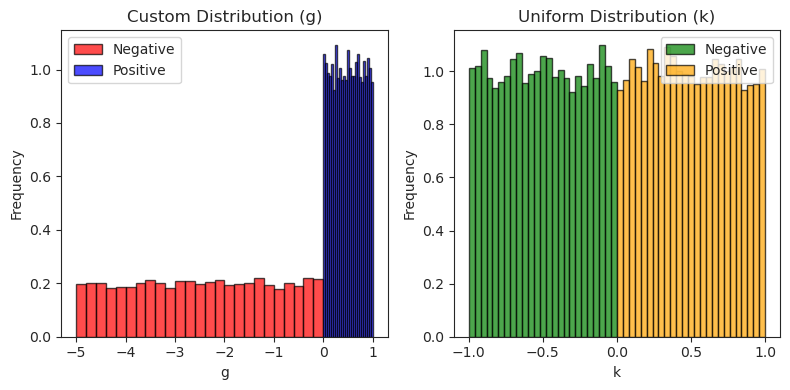

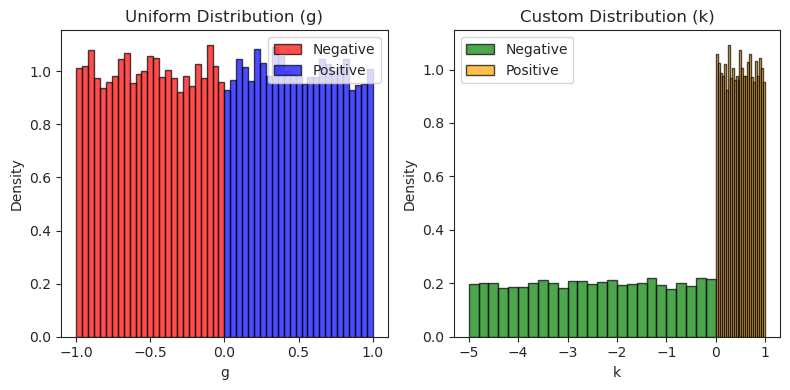

In [28]:
# Generate samples
num_samples = 20000
custom_samples = [custom_distribution(5, 1) for _ in range(num_samples)]
uniform_samples = np.random.uniform(-1, 1, num_samples)

# Create subplots
fig, axs = plt.subplots(1, 2, figsize=(8, 4))

# Custom distribution plot
custom_neg = [x for x in custom_samples if x < 0]
custom_pos = [x for x in custom_samples if x >= 0]

axs[0].hist(custom_neg, bins=25, color='red', edgecolor='black', alpha=0.7, label='Negative', density=True)
axs[0].hist(custom_pos, bins=25, color='blue', edgecolor='black', alpha=0.7, label='Positive', density=True)
axs[0].set_title('Custom Distribution (g)')
axs[0].set_xlabel('g')
axs[0].set_ylabel('Frequency')
axs[0].legend()

# Uniform distribution plot
uniform_neg = [x for x in uniform_samples if x < 0]
uniform_pos = [x for x in uniform_samples if x >= 0]

axs[1].hist(uniform_neg, bins=25, color='green', edgecolor='black', alpha=0.7, label='Negative', density=True)
axs[1].hist(uniform_pos, bins=25, color='orange', edgecolor='black', alpha=0.7, label='Positive', density=True)
axs[1].set_title('Uniform Distribution (k)')
axs[1].set_xlabel('k')
axs[1].set_ylabel('Frequency')
axs[1].legend()

# Show plots
plt.tight_layout()
plt.show()



# Create subplots
fig, axs = plt.subplots(1, 2, figsize=(8, 4))

# Uniform distribution plot (g)
uniform_neg = [x for x in uniform_samples if x < 0]
uniform_pos = [x for x in uniform_samples if x >= 0]

axs[0].hist(uniform_neg, bins=25, color='red', edgecolor='black', alpha=0.7, label='Negative', density=True)
axs[0].hist(uniform_pos, bins=25, color='blue', edgecolor='black', alpha=0.7, label='Positive', density=True)
axs[0].set_title('Uniform Distribution (g)')
axs[0].set_xlabel('g')
axs[0].set_ylabel('Density')
axs[0].legend()

# Custom distribution plot (k)
custom_neg = [x for x in custom_samples if x < 0]
custom_pos = [x for x in custom_samples if x >= 0]

axs[1].hist(custom_neg, bins=25, color='green', edgecolor='black', alpha=0.7, label='Negative', density=True)
axs[1].hist(custom_pos, bins=25, color='orange', edgecolor='black', alpha=0.7, label='Positive', density=True)
axs[1].set_title('Custom Distribution (k)')
axs[1].set_xlabel('k')
axs[1].set_ylabel('Density')
axs[1].legend()

# Show plots
plt.tight_layout()
plt.show()

In [29]:
def plot_states_from_cfg(system_config):
    for i in range(12):
        y_out_list=[]
        y0_species=one_hot_vector(12,i)
        y0_env=[0]
        t=np.linspace(0, 2000, 10000)

        y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=True)

        y_out_list.append(y_out)
    #print(np.sum(y_out['species']), np.sum(y_out['env']) )
    num_datasets = len(y_out_list)

    # Prepare subplots
    fig, axs = plt.subplots(2, 1, figsize=(8, 8))

    # Data for plots
    species_matrix = np.array([y_out['species'] for y_out in y_out_list])
    env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

    # Normalize species data
    species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
    species_sums = np.sum(species_matrix, axis=1, keepdims=True)
    normalized_species = species_matrix / species_sums

    # Bar width
    bar_width = 0.8 / num_datasets  # Adjust bar width based on the number of datasets

    # Plotting species composition
    for i in range(normalized_species.shape[1]):  # Loop through each species
        axs[0].bar(np.arange(num_datasets) + i * bar_width, normalized_species[:, i], bar_width, label=f'Species {i+1}')

    axs[0].set_title('Normalized Species Composition')
    axs[0].set_xlabel('Dataset Index')
    axs[0].set_ylabel('Proportion')
    axs[0].legend()

    # Plotting environmental factors
    axs[1].bar(np.arange(num_datasets), env_data, color='red', width=0.8)
    axs[1].set_title('Environmental Variable')
    axs[1].set_xlabel('Dataset Index')
    axs[1].set_ylabel('Environmental Value')

    plt.tight_layout()
    plt.show()

In [30]:
session_path='Results_qtailed/Session_Test1'
to_save={}
description=''
simulated_result={}

for seed_num in range(100):
    if not os.path.isdir(session_path):
        os.mkdir(session_path)
    # functions for uniform 

    f_I = lambda : uniform_distribution(0.5,0.5)
    f_g = lambda : np.ones(1)
    f_k = lambda : np.ones(1)
    f_p = lambda : uniform_distribution(0.5,0.5)
    f_q = lambda : custom_distribution(-2,1)
    f_beta = lambda : np.ones(1)
    seed_num=seed_num
    to_plot=True

    np.random.seed(seed_num)

    N=12
    N_env=1


    I = np.zeros((N, N))
    for i in range(N):
        for j in range(N):
            I[i,j] = f_I()
    for i in range(N):
        I[i,i] =1

    g = np.zeros((N))
    for i in range(N):
        g[i] = f_g()

    k = np.zeros((N))
    for i in range(N):
        k[i] = f_k()   

    p = np.zeros((N_env, N))
    for i in range(N_env):
        for j in range(N):
            p[i,j] = f_p()

    #p[0,2]=-10

    q = np.zeros((N, N_env))
    for i in range(N):
        for j in range(N_env):
            q[i,j] = f_q()

    #q[2,0]=0.2



    beta = np.zeros(N_env)
    for i in range(N_env):
        beta[i]=f_beta()

    delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
    migration_rate=0#1e-7
    system_config = {
        'I': I,
        'g': g,
        'k': k,
        'p': p,
        'q': q,
        'beta': beta,
        'delta': delta,
        'migration_rate' : migration_rate,
        'N': N,
        'N_env': N_env,
        'seed_num':seed_num,
    } 

    file_path = f'{session_path}/system_config.json'

    label="test"
    sys
    ##

    y_out_list=[]
    system_config['beta'] = np.array([0.5])*delta

    for i in range(24):

        species_index=np.arange(0,24)
        env_index=np.array([0])
        y0_species=one_hot_vector(24,i)
        y0_env=[0]
        t=np.linspace(0, 2000, 10000)

        y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False)

        y_out_list.append(y_out)

    num_datasets = len(y_out_list)

    # Prepare subplots
    fig, axs = plt.subplots(3, 1, figsize=(6, 6))

    # Data for plots
    species_matrix = np.array([y_out['species'] for y_out in y_out_list])
    env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

    # Normalize species data
    species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
    species_sums = np.sum(species_matrix, axis=1, keepdims=True)
    normalized_species = species_matrix / species_sums

    # Absolute sums of species data (sum across all species for each dataset)
    absolute_sums = np.sum(species_matrix, axis=1)
    simulated_result[seed_num]={'species':species_matrix, 'env' : env_data}

    if to_plot:
        plt.suptitle(f'seed={seed_num}')

        # Plotting species composition as stacked bars
        bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
        for i in range(normalized_species.shape[1]):  # Loop through each species
            axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
            bottom_values += normalized_species[:, i]  # Update bottom values for stacking

        axs[0].set_title('Normalized Species Composition')
        axs[0].set_xlabel('Community Index')
        axs[0].set_ylabel('Relative abundance')
        #axs[0].legend()

        # Plotting environmental factors
        colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
        axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
        axs[1].set_title('Environmental Variable')
        axs[1].set_xlabel('Community Index')
        axs[1].set_ylabel('Env value(pH)')

        # Plotting absolute sums of species data
        axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
        axs[2].set_title('Absolute Sum of Species Populations')
        axs[2].set_xlabel('Community Index')
        axs[2].set_ylabel('Total abundance')

        plt.tight_layout()
        plt.savefig(session_path+f'/diagram_{seed_num}.png')

        #if to_plot:
        #    plt.savefig()


        plt.show()
#simulated_result = {'a': 1, 'b': 2, 'c': 3}  # Your existing dictionary
#description = "This is a description of the simulated result."

# Combine both into a new dictionary
data_to_save = {
    'result': simulated_result,
    'description': description
}
# Serialize the combined data to a pickle file
with open(session_path+'/result_and_description.pkl', 'wb') as file:
    pickle.dump(data_to_save, file)


IndexError: index 12 is out of bounds for axis 0 with size 12

{'species': array([-3.10308224e-68,  3.76477087e+00,  8.10265498e-27, -6.18700361e-85,
       -1.28999727e-77, -1.72003903e-61, -1.59240438e-82, -7.69790679e-74,
       -1.40196256e-56,  2.53319211e+00,  1.65498851e+00, -1.20177020e-91,
       -4.96897211e-60, -4.51939117e-83,  1.61200023e-38, -1.55945492e-39,
        4.81591431e-89,  9.32824252e+00, -1.63814963e-86, -3.11025542e-74,
       -3.14589641e-71, -2.26844791e-69,  3.38849626e+00, -4.24433302e-63]), 'env': array([10.14329635])}
{'species': array([-1.29420154e-71,  3.76477087e+00, -5.86776221e-25, -1.24852140e-85,
       -1.12289873e-75, -1.36979926e-58, -5.24562735e-79,  3.49895487e-70,
        8.88445367e-54,  2.53319211e+00,  1.65498851e+00,  3.19459658e-86,
       -3.85318374e-56, -1.31268597e-82,  9.54079853e-39,  1.16036465e-41,
       -3.05128601e-87,  9.32824252e+00, -8.62346901e-81, -1.46656570e-70,
       -6.54863124e-71,  3.74738222e-68,  3.38849626e+00, -1.03879625e-60]), 'env': array([10.14329635])}
{'species': ar

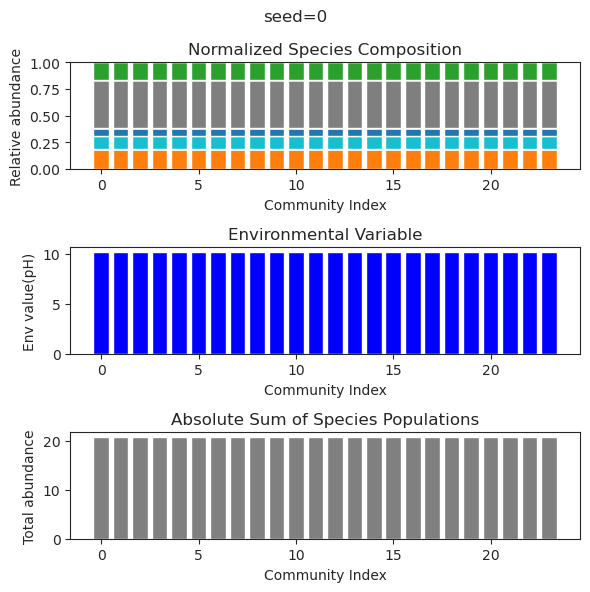

{'species': array([ 2.22199539e+000, -3.22208936e-034,  3.94684102e-001,
        1.29737089e+000,  1.06016199e-154,  2.12544483e+000,
       -8.81734799e-031,  9.23472706e-103,  1.06780086e-078,
        8.87621033e-001,  1.79324959e-031,  3.44718148e-030,
        5.25276750e-001, -8.72593804e-036,  6.88932358e-155,
        2.77624761e-154, -5.15136221e-121,  2.69927271e+000,
        1.38156369e-003,  1.23057490e-150,  7.21640978e-148,
       -1.04423292e-149,  2.98305772e-132,  1.24028461e-143]), 'env': array([5.1762125])}
{'species': array([ 2.22330452e+00, -1.55469508e-28,  3.95604687e-01,  1.29762650e+00,
        7.45545281e-88,  2.12776832e+00,  5.24521131e-24,  2.10957747e-59,
       -1.29115493e-52,  8.87956986e-01,  5.06408615e-23, -6.19496322e-20,
        5.24723859e-01, -8.40048845e-29,  4.94136175e-90, -1.34557318e-92,
        3.01362989e-73,  2.69858611e+00,  1.34756484e-04, -2.54153068e-82,
        7.56755403e-81, -3.56300802e-88,  1.12100648e-80,  4.10139167e-87]), 'env': 

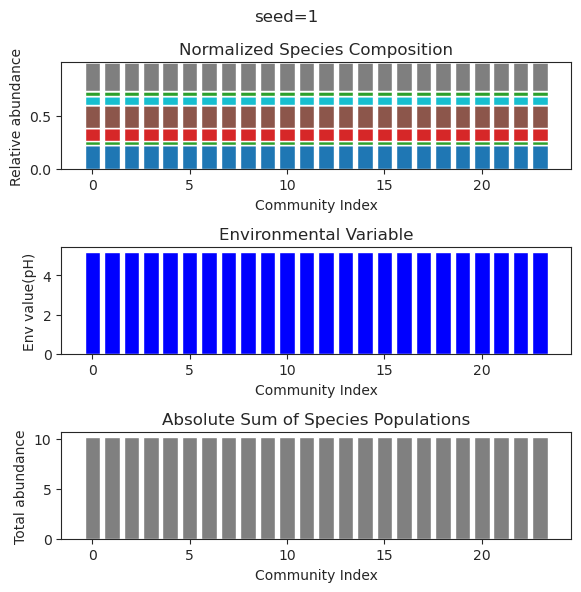

{'species': array([ 1.73049931e-056,  4.59067000e-078,  3.07439485e+000,
       -1.23193307e-094,  1.88402256e+000,  1.79730004e+000,
        3.42018960e-022,  4.54941244e-101,  1.37611155e-119,
       -3.87213284e-096,  3.33969061e-106,  1.70448554e-107,
        7.98514188e-086,  1.48485597e+000,  6.88424405e-062,
       -6.71357441e-089,  7.82835516e-107, -2.14629687e-107,
        6.86553876e-001,  1.03257991e+000,  7.08861677e-119,
        1.59012677e-049, -4.18569097e-112, -6.38455143e-096]), 'env': array([5.54183406])}
{'species': array([-6.68711346e-075, -1.56232353e-116,  3.07439485e+000,
       -3.51517017e-131,  1.88402256e+000,  1.79730004e+000,
       -1.61988030e-023,  2.52789375e-140,  4.43732630e-145,
       -8.96225359e-133, -9.80541683e-133, -2.08095829e-129,
       -5.81143782e-121,  1.48485597e+000,  2.11859866e-084,
        7.47167104e-105, -1.16609295e-141,  2.62404049e-144,
        6.86553876e-001,  1.03257991e+000,  5.93364195e-147,
        4.69649935e-056, -1.479

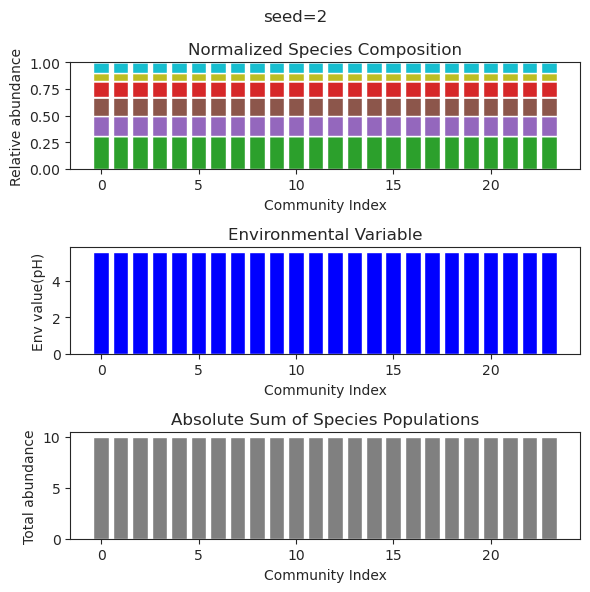

{'species': array([ 6.88555937e-077,  7.11021790e-001,  1.44086466e-001,
       -2.74527482e-133, -5.87260292e-138, -1.56407276e-022,
       -4.55197127e-109, -7.73353254e-085, -1.28850574e-129,
       -5.26904709e-089, -4.86945400e-098, -1.66083210e-030,
       -5.54881093e-124,  8.22457653e-001,  2.35743495e+000,
        4.48399314e-001,  6.59816361e-001,  3.94149352e-088,
        1.33967785e-139,  2.71483658e-122,  6.30150383e-070,
        1.63376821e-001,  1.31401062e+000,  5.92044826e-124]), 'env': array([3.26861305])}
{'species': array([ 1.43314060e-078,  7.11021790e-001,  1.44086466e-001,
       -5.15936390e-133, -1.30998710e-134,  1.00979677e-018,
       -2.36956173e-114, -5.83239831e-084, -3.44373993e-131,
       -5.19626606e-089, -7.58070091e-102,  1.75778815e-025,
        1.51850303e-125,  8.22457653e-001,  2.35743495e+000,
        4.48399314e-001,  6.59816361e-001,  7.38287123e-090,
       -5.42587999e-138, -7.53483014e-129, -3.76707374e-069,
        1.63376821e-001,  1.314

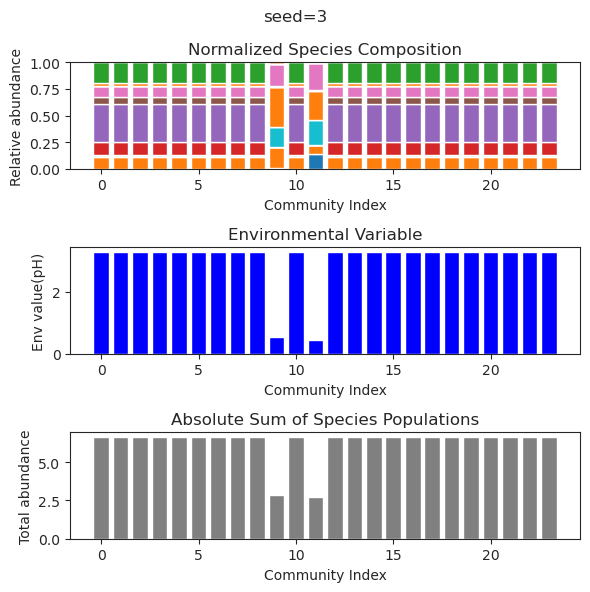

{'species': array([-8.03840376e-057, -5.17260394e-114, -3.53096000e-055,
       -4.76550915e-078, -1.36942275e-115,  4.46392217e+000,
        2.56434874e-095,  1.96211381e+000,  1.14172625e+000,
       -1.01133260e-097,  2.85104915e-001,  8.11748963e-001,
       -4.03271230e-100, -6.70322786e-063,  6.82945314e-118,
       -5.85370440e-058,  3.72183855e-065, -1.49969229e-079,
       -7.85877650e-057, -4.09009560e-109,  9.88503938e-001,
       -8.04935427e-109, -1.64032693e-116,  2.25960881e-001]), 'env': array([5.93049655])}
{'species': array([ 3.07334238e-073,  1.40208674e-135,  2.09658948e-069,
       -3.39452842e-109, -4.80350995e-141,  4.46392217e+000,
       -6.13970736e-126,  1.96211381e+000,  1.14172625e+000,
        1.51990606e-121,  2.85104915e-001,  8.11748963e-001,
        1.01365302e-136,  5.52895663e-082,  8.92706933e-144,
       -3.55557102e-067, -1.75285721e-087, -3.31398117e-111,
        4.31094215e-072,  1.54247948e-146,  9.88503938e-001,
       -2.84023944e-134, -7.682

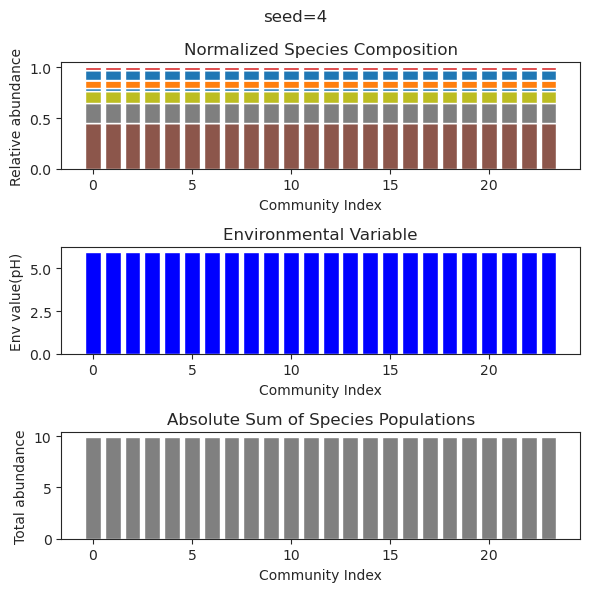

{'species': array([-3.47728603e-79, -3.09290961e-68, -1.07596188e-31,  7.89181024e+00,
        4.36898701e-01,  4.10661093e-52, -5.42023605e-71,  2.04938831e-69,
       -5.59646963e-74, -1.51959594e-48, -1.88031338e-76,  2.67142633e-26,
       -7.46092146e-22,  3.32212304e-42, -1.44074361e-82, -8.28966572e-61,
        2.72914990e-71,  7.51152054e+00, -3.80061978e-33, -2.50917807e-70,
        5.21162899e+00, -3.69624731e-82, -1.08411632e-78, -5.87927172e-66]), 'env': array([10.02756458])}
{'species': array([-1.37099458e-80,  1.24422923e-62,  5.96619815e-31,  7.89181024e+00,
        4.36898701e-01, -1.31006156e-49,  1.59324134e-73,  2.61364008e-63,
        6.65023854e-76, -1.14751834e-49,  1.13642109e-77, -5.51052881e-26,
       -4.74473853e-22, -3.94775291e-44,  1.00073030e-78,  1.18028259e-58,
        2.51864110e-66,  7.51152054e+00, -1.10102921e-32,  3.30725167e-73,
        5.21162899e+00,  1.56335733e-79,  3.51727976e-77, -2.44569107e-67]), 'env': array([10.02756458])}
{'species': ar

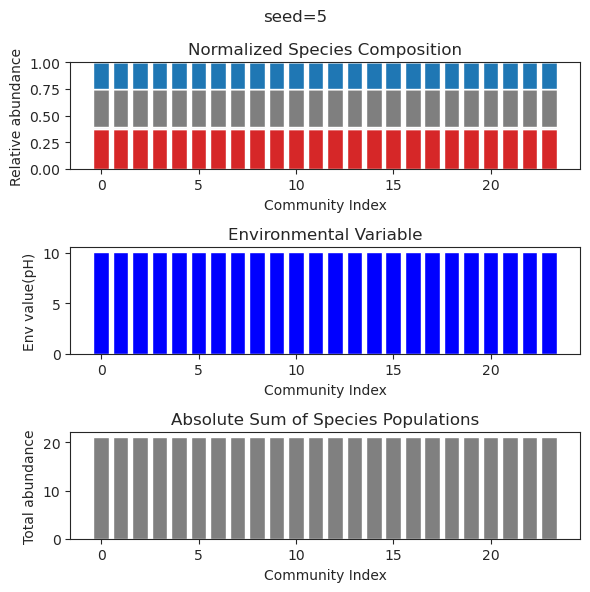

{'species': array([-9.60122474e-57,  8.00450298e-70, -2.04574674e-17,  6.69787325e-94,
       -1.06246198e-97, -6.82039578e-86, -2.57740573e-39,  9.22977309e+00,
       -4.20468646e-65, -1.62681109e-94, -1.05284906e-40, -5.27213323e-75,
        2.14026596e-58,  9.78399800e-98, -3.99756285e-53,  9.61348018e+00,
        3.52564427e-90, -4.86792866e-96, -2.66842477e-83,  1.28566851e-79,
       -9.44343662e-89, -2.26259543e-81,  2.05817497e+00,  7.65324864e-93]), 'env': array([10.09820137])}
{'species': array([-8.60880112e-051,  2.43563299e-064,  3.32090998e-020,
        3.26798811e-093, -1.00697697e-097,  8.28808063e-084,
       -5.16599646e-049,  9.22977309e+000,  3.95045825e-052,
        1.04196756e-098,  1.98648266e-039, -3.90714320e-067,
       -4.24087537e-055, -3.07949114e-101, -9.75301782e-052,
        9.61348018e+000,  4.89775551e-089, -3.57190251e-098,
       -1.59310525e-086, -1.20781900e-084,  1.74396024e-088,
       -2.46326001e-083,  2.05817497e+000,  9.15261171e-093]), 'env'

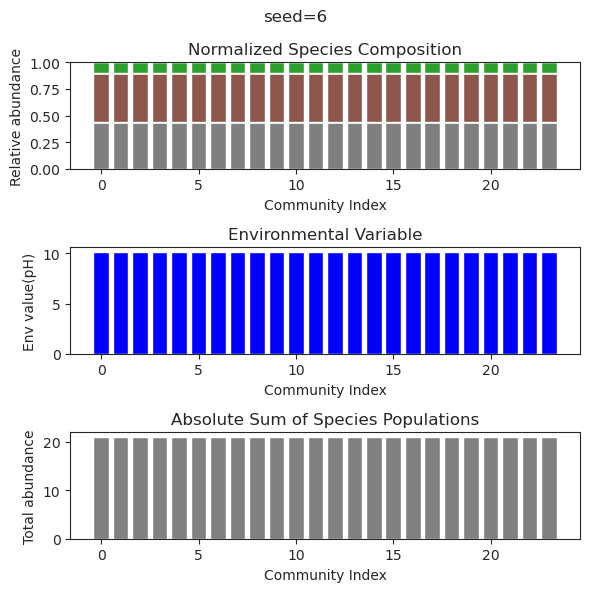

{'species': array([ 2.37578329e+000, -1.99805807e-097,  4.93720633e+000,
        2.95528227e-075,  3.77259623e-091,  4.26796037e-001,
       -3.36261235e-124,  3.37044525e+000, -8.41717552e-040,
       -3.74017736e-059, -4.63502480e-131, -6.07064371e-107,
       -1.36997173e-065,  1.27676969e-033, -7.67859102e-047,
       -2.43486463e-087, -7.45221572e-127, -1.01771856e-100,
       -7.56542084e-127,  1.18549064e+000,  1.47569057e-001,
        6.14053056e-064,  1.05709898e-100,  1.29717109e+000]), 'env': array([7.22346733])}
{'species': array([ 2.37578329e+000, -1.85821715e-118,  4.93720633e+000,
        3.24544801e-094, -1.13597864e-099,  4.26796037e-001,
        3.89619137e-135,  3.37044525e+000, -2.64451729e-044,
       -4.07976293e-060, -1.74434181e-139,  2.22809097e-116,
        2.83734228e-072,  5.48210665e-035, -8.01608176e-054,
       -2.32403791e-111, -2.37775043e-138, -1.38245339e-124,
       -9.24380568e-144,  1.18549064e+000,  1.47569057e-001,
        6.15304430e-070, -6.364

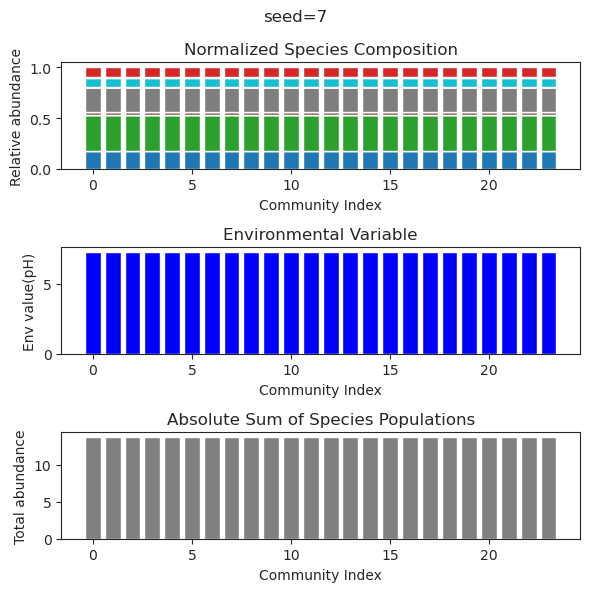

{'species': array([ 7.82560800e+000,  1.04063877e+000,  3.20489641e-031,
       -1.60343124e-122,  2.73934579e-021,  9.34539506e-061,
        4.69803403e-024, -4.24344053e-072,  1.51498681e-123,
        6.59113727e-084,  9.37915169e-001,  3.85583512e-001,
        1.36035923e-123, -2.10550370e-122,  5.27006548e-041,
        4.39547051e-037,  2.78017055e-085,  2.39142747e-001,
       -1.08917323e-131, -3.83682813e-111, -1.24370136e-076,
       -5.12382814e-107,  6.17123931e+000, -7.76799109e-123]), 'env': array([10.04599616])}
{'species': array([ 7.82560800e+00,  1.04063877e+00,  3.78141879e-33,  4.58029882e-82,
       -3.78903647e-25, -1.49901401e-52,  5.32145200e-26, -3.51620320e-57,
        4.85589215e-82,  3.40882775e-73,  9.37915169e-01,  3.85583512e-01,
        2.15923973e-88,  6.36277667e-78, -2.66677972e-41, -5.23889103e-43,
       -6.81476643e-54,  2.39142747e-01, -1.60865137e-51, -2.16797873e-72,
       -1.84011228e-59, -2.23928010e-72,  6.17123931e+00,  7.36100087e-81]), 'env'

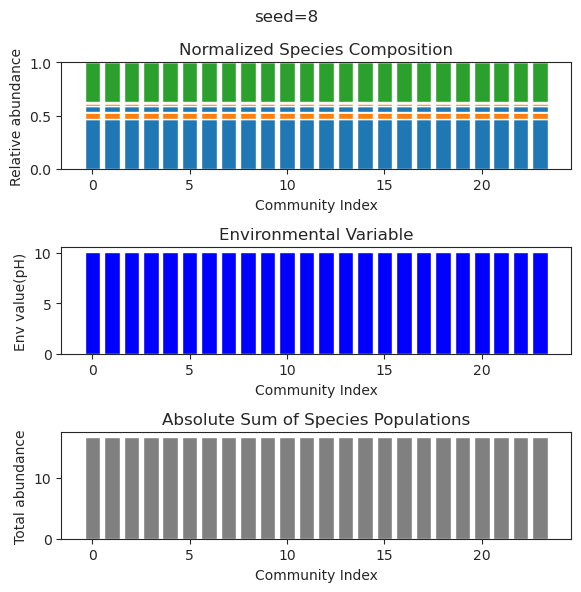

{'species': array([ 1.42937395e-068,  1.16026379e-062, -3.13620737e-073,
       -1.04024116e-083,  5.27950183e-074,  1.13207638e-020,
       -8.16172705e-096,  9.31065963e-078,  2.80048168e+000,
        1.82465626e+000, -7.67139732e-054,  3.60602126e-001,
        1.79992354e-066, -8.53467824e-100,  2.99008329e-032,
        4.74535942e+000,  1.31252862e+000, -6.65533679e-054,
       -1.83727889e-051,  1.02861223e+000,  5.59458010e-088,
       -1.48758940e-097,  4.09782823e+000,  3.83016459e-001]), 'env': array([9.49638161])}
{'species': array([-3.41171930e-096,  1.59330425e-081,  7.42538564e-076,
        7.29525661e-115,  9.36196106e-075, -7.13899924e-021,
        2.25236760e-121, -1.26985933e-105,  2.80048168e+000,
        1.82465626e+000,  1.24755698e-067,  3.60602126e-001,
        4.26364267e-089,  1.34270168e-123,  6.32618010e-034,
        4.74535942e+000,  1.31252862e+000,  2.83347358e-068,
        2.81577209e-069,  1.02861223e+000, -1.06315232e-099,
        3.43559185e-123,  4.097

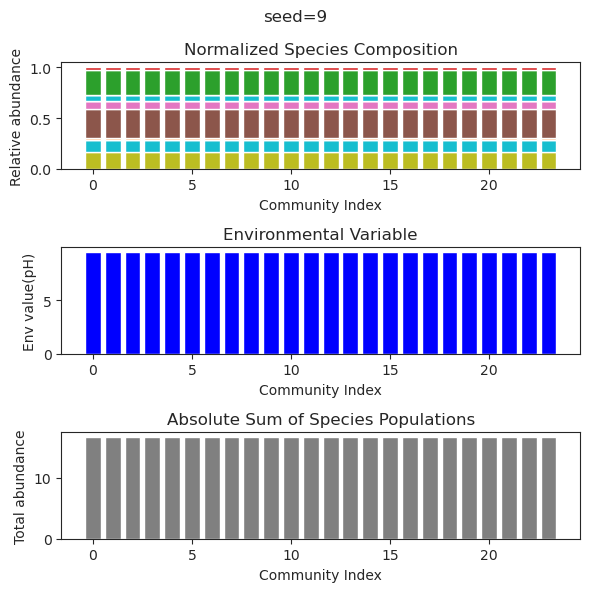

{'species': array([ 9.40686889e-01,  4.11539510e-01,  6.12636185e-90, -1.43803327e-42,
       -7.76995396e-91,  1.29378896e-30, -1.63821074e-57,  2.27181756e-84,
       -1.04746536e-40, -2.28090959e-41,  4.44052290e-01,  5.54098590e-01,
        1.25446739e+00,  7.07847721e-01, -1.00702659e-90,  2.75375312e-01,
       -2.57264117e-90, -1.12165172e-86,  2.29076160e-64,  3.10119194e-50,
        1.42990850e+00, -6.43652536e-69, -4.41958614e-74,  5.39303346e-61]), 'env': array([2.11295736])}
{'species': array([ 9.40686889e-01,  4.11539510e-01, -2.33145835e-90, -4.74767127e-46,
       -6.41153735e-91, -8.70369630e-31, -1.87259321e-54, -8.41423223e-84,
       -1.33152345e-91, -3.93467800e-67,  4.44052290e-01,  5.54098590e-01,
        1.25446739e+00,  7.07847721e-01, -6.98310552e-89,  2.75375312e-01,
        4.00081273e-85, -6.91912357e-83,  2.63408558e-65,  9.79108032e-49,
        1.42990850e+00,  8.22155941e-70, -1.71496281e-69,  4.76492347e-61]), 'env': array([2.11295736])}
{'species': arra

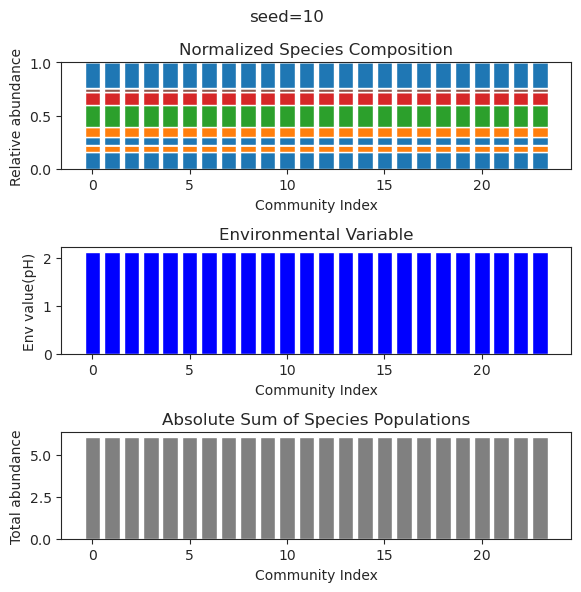

{'species': array([-4.02808090e-46, -6.72955473e-96, -4.38995783e-47, -1.15528015e-32,
       -6.06249066e-94, -2.56649339e-80, -5.55623554e-71,  8.67399866e-01,
       -1.48615029e-17, -1.80558021e-75,  3.09486213e-01, -8.28072795e-53,
       -9.88819983e-89, -6.20196046e-77, -6.01847534e-88,  8.49728270e-01,
       -3.04288717e-51, -1.64340202e-89,  5.72555010e-01, -1.36478405e-60,
        5.27893030e-01,  2.07061223e-01,  1.34572550e+00,  2.90868279e-01]), 'env': array([2.10283416])}
{'species': array([-7.90628974e-047,  2.42081724e-114, -9.89482163e-044,
        6.25226871e-037, -9.49391769e-110,  9.08972936e-101,
        2.00939031e-080,  8.67399866e-001, -2.40507715e-017,
        3.91762558e-088,  3.09486213e-001, -3.99337901e-071,
        2.21071816e-097,  4.36989178e-093, -6.28339154e-107,
        8.49728270e-001, -3.42436535e-064,  5.14801518e-097,
        5.72555010e-001, -4.03818139e-076,  5.27893030e-001,
        2.07061223e-001,  1.34572550e+000,  2.90868279e-001]), 'env':

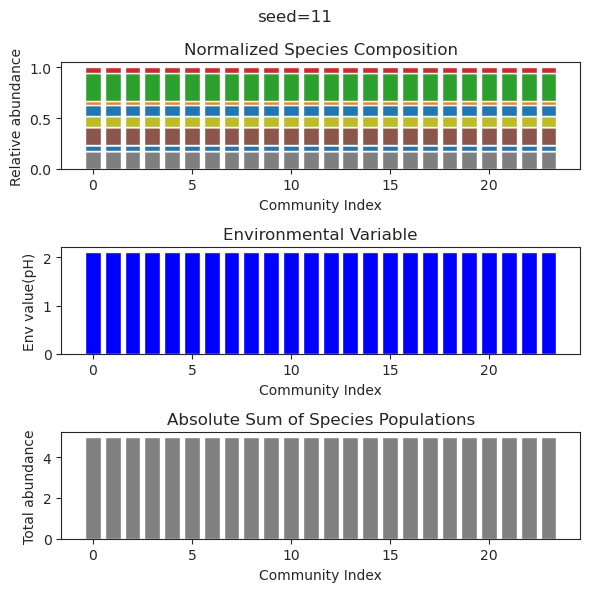

{'species': array([ 5.93737247e-31,  2.53896619e-39,  1.25765121e-01, -2.82715073e-55,
        5.64701067e-43, -2.18923008e-35, -2.67845821e-53,  2.83093185e-31,
       -1.75065728e-15,  1.06288764e+00,  1.53942689e-01,  7.82666414e-01,
       -8.56419263e-57,  3.72122560e-31,  2.32613289e-01, -1.41700807e-46,
       -3.89124993e-68, -3.15573945e-49,  3.50698924e-71, -5.54114520e-59,
        6.32415034e-01,  5.95767060e-02, -5.03170260e-49,  3.92365837e-44]), 'env': array([0.83628463])}
{'species': array([-7.86777025e-36, -5.14717775e-52,  1.25765121e-01, -5.79868093e-74,
       -8.87484640e-53, -4.99310906e-42, -2.73073343e-71,  8.05235633e-37,
       -1.69293266e-17,  1.06288764e+00,  1.53942689e-01,  7.82666414e-01,
       -8.09032994e-74, -3.90668297e-34,  2.32613289e-01, -1.21194460e-62,
        1.88598601e-91, -2.53138588e-64, -7.58186699e-92,  9.58960906e-85,
        6.32415034e-01,  5.95767060e-02, -2.20484591e-63, -1.84664626e-57]), 'env': array([0.83628463])}
{'species': arra

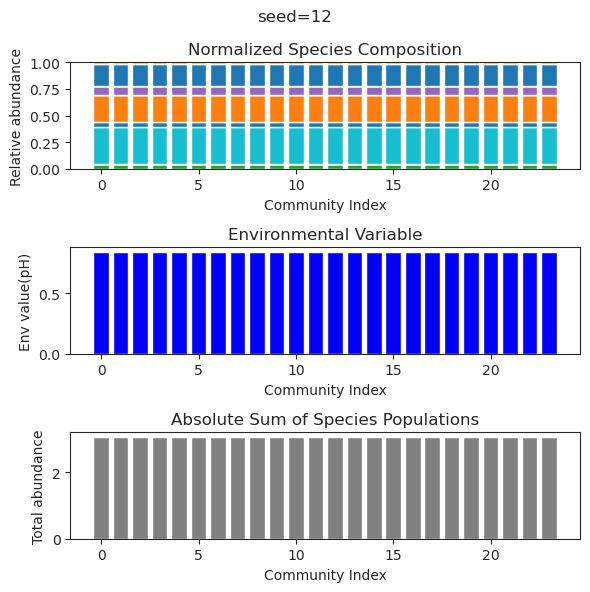

{'species': array([ 2.35483038e-01,  1.88126718e-37,  8.88488610e-38,  3.97554388e-38,
        9.49329249e-51,  5.43602807e-01, -2.31233011e-38,  1.87567058e-01,
       -1.11020610e-35,  2.42610191e-36, -4.18635959e-36,  8.06627069e-01,
        1.24745640e+00,  2.25959846e-01,  1.06248466e-13,  2.83597787e-48,
        7.93224736e-01,  8.86574138e-89,  1.88997331e-35,  2.22330783e-62,
       -3.45128083e-74,  9.08757335e-01,  6.80762679e-01,  5.22826824e-73]), 'env': array([2.19838089])}
{'species': array([ 2.35483038e-001,  5.82549101e-123, -8.10783983e-126,
        1.25245578e-065, -7.16360997e-067,  5.43602807e-001,
        3.84913480e-127,  1.87567058e-001,  1.88188140e-138,
        2.13900076e-136,  7.54489789e-138,  8.06627069e-001,
        1.24745640e+000,  2.25959846e-001, -6.15954239e-015,
       -1.01971955e-028,  7.93224736e-001, -3.53034198e-147,
        4.07775942e-138,  2.37452216e-088,  4.43665776e-122,
        9.08757335e-001,  6.80762679e-001,  3.55390283e-118]), 'env':

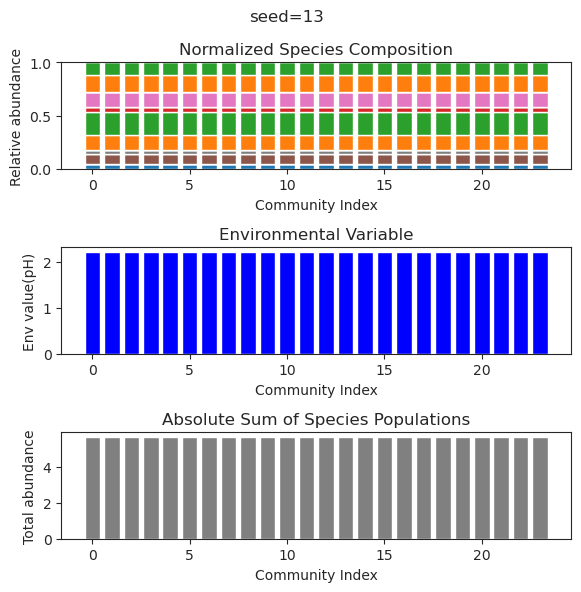

{'species': array([ 6.32129975e+00, -1.10587218e-50, -3.59522509e-39, -2.99332673e-36,
       -8.20743707e-36, -1.79614267e-39,  1.72553872e-46,  8.62024915e-46,
       -4.17284100e-35,  3.90750925e-50,  2.01845688e+00, -1.92083446e-59,
        1.55853163e+00,  1.73705030e-61, -1.92618443e-60, -1.10752423e-40,
        3.26094036e-62,  3.65358498e-37,  6.16607588e-34,  1.31640360e-54,
        8.00152089e-47,  6.44312974e+00, -3.57200186e-51, -1.44345340e-62]), 'env': array([9.88645645])}
{'species': array([ 6.32129975e+000,  2.76238811e-048, -1.71500660e-078,
       -9.13824593e-073,  2.60056648e-034, -7.70591800e-039,
        7.13598426e-101,  5.68710931e-045,  4.74945124e-034,
       -7.73011789e-137,  2.01845688e+000,  7.71144015e-155,
        1.55853163e+000,  7.79967347e-177, -1.97966713e-125,
       -1.05531487e-148,  5.18544962e-107, -3.02683932e-134,
        1.29323475e-130,  7.84446333e-120, -1.70936637e-166,
        6.44312974e+000,  3.56982035e-090, -4.61602912e-117]), 'env':

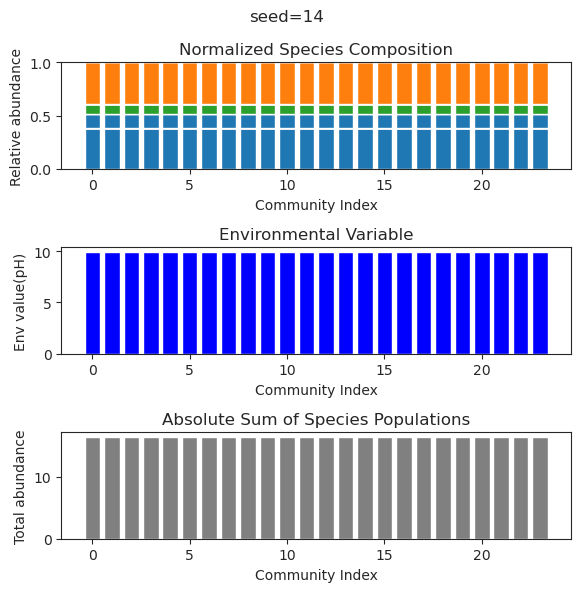

{'species': array([-2.53377029e-090,  3.58979414e+000,  1.31410814e+000,
       -1.02553595e-074,  5.41942342e-001, -9.78038745e-100,
        1.32116350e-094,  7.39051099e-098, -5.01706798e-049,
       -4.51542786e-070,  3.61360620e-052,  1.34224916e-032,
       -1.58334091e-098,  3.71488588e+000, -2.16785161e-051,
       -3.63928389e-079,  5.90349562e-040, -8.57348267e-099,
        9.15536748e-001,  1.59065423e-030,  1.00993020e+000,
        1.25095594e-049, -3.57571959e-084, -3.54322872e-074]), 'env': array([6.53818136])}
{'species': array([-1.33136163e-87,  3.58979414e+00,  1.31410814e+00,  3.25831788e-48,
        5.41942342e-01,  1.86741178e-47, -3.41899717e-91,  3.24332135e-95,
       -1.25723483e-50, -6.38539223e-69,  9.90093752e-49, -1.38048042e-35,
       -1.18156093e-92,  3.71488588e+00, -1.24796431e-51,  2.98476110e-78,
        1.28413387e-42, -2.99037088e-93,  9.15536748e-01,  1.52834834e-33,
        1.00993020e+00, -5.10351472e-50,  6.41612450e-80,  1.19685590e-74]), 'env':

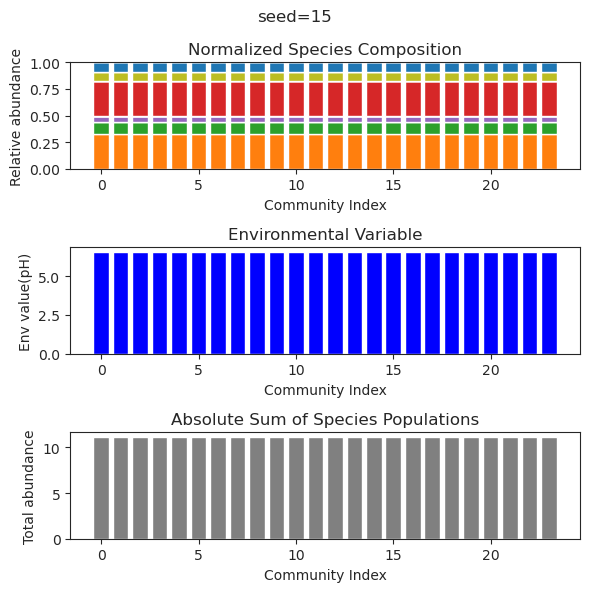

{'species': array([ 7.43313301e-054,  6.39731754e-091, -1.23411155e-100,
        3.42091092e-107,  4.81443011e-068,  1.44450645e-092,
       -2.18232166e-032, -7.88162323e-056, -7.47811257e-106,
        2.35879399e-001,  6.32559451e+000, -4.08116652e-104,
        1.46117970e-083,  3.62015598e-111, -2.54796515e-027,
        2.02535951e-064, -3.01878798e-094,  1.65117429e-103,
        1.26708263e-091,  8.19452785e-081,  5.81606947e+000,
        1.47247857e+000,  7.59200980e+000,  9.62350189e-108]), 'env': array([9.84001321])}
{'species': array([ 3.22818109e-62, -1.45408131e-83,  4.81351897e-76, -1.91120625e-84,
        1.05746126e-53,  3.96087997e-83,  7.18149107e-31, -6.83712229e-56,
        7.40044377e-52,  2.35879399e-01,  6.32559451e+00, -3.00819764e-73,
       -7.51715045e-48,  7.25505667e-97,  8.01569248e-27,  2.98613661e-68,
        3.27116638e-71, -1.37193565e-78, -1.10158589e-91,  6.19276488e-69,
        5.81606947e+00,  1.47247857e+00,  7.59200980e+00,  5.27167621e-87]), 'env':

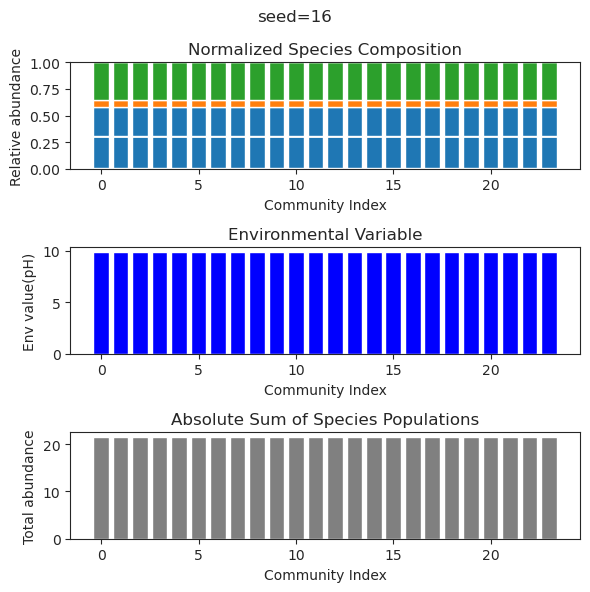

{'species': array([-8.70404359e-107, -8.20387097e-093,  2.68323461e+000,
        4.31679760e-026, -3.84007763e-050,  3.60301268e-056,
        5.38218279e-062, -1.09679063e-076,  1.38135107e-132,
        8.38237232e-069,  6.81000096e-118, -3.38121728e-126,
       -1.39457317e-126,  3.82737305e+000, -8.68077915e-116,
        2.40066518e+000, -2.10661380e-109, -1.53129594e-089,
        1.13375154e+000, -7.05724259e-019, -4.54047598e-033,
       -2.04649224e-070, -9.55984815e-034,  2.04187903e+000]), 'env': array([7.24805])}
{'species': array([ 6.28632983e-051, -3.72740259e-077,  2.68323461e+000,
        1.68508536e-024,  2.53780843e-046,  4.61830299e-051,
        3.54957910e-052,  2.41240613e-067,  5.08698840e-104,
        1.56057096e-062, -4.47580405e-091,  1.58922041e-093,
        1.21275189e-045,  3.82737305e+000,  2.09211743e-091,
        2.40066518e+000,  1.84994701e-081, -2.06558453e-073,
        1.13375154e+000,  1.03117792e-016, -1.88450560e-035,
       -2.60446715e-063, -6.364987

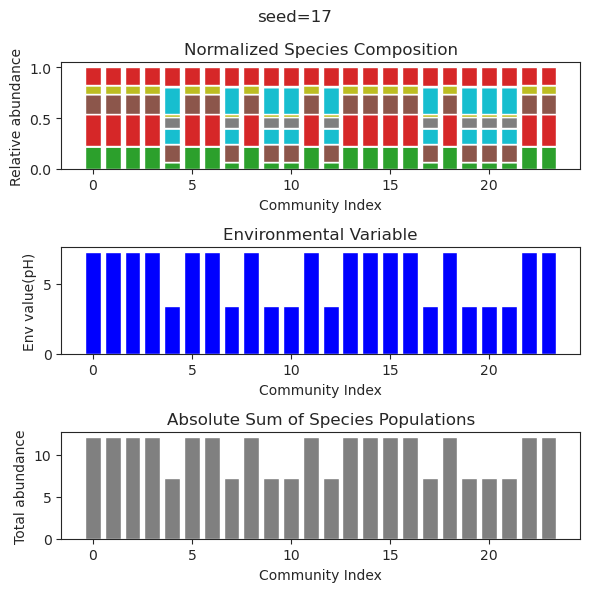

{'species': array([ 7.87280202e-60,  3.73641107e-36, -3.71587612e-28,  7.00042772e+00,
        3.43355979e-65, -5.01275962e-73,  1.40791543e-65,  1.62414764e-27,
       -2.45179034e-63, -1.38237571e-33, -1.78593652e-59, -2.61152024e-28,
       -4.83001121e-36,  2.02308565e-72,  2.68646382e-49,  2.45687715e+00,
        2.78849202e-54,  7.50827808e+00, -9.36055065e-68, -2.12613041e-35,
       -4.34644760e-29,  5.12786546e-56,  1.19130168e-33, -5.10242642e-36]), 'env': array([9.88970761])}
{'species': array([ 9.64126081e-76, -6.73488547e-39,  1.34096255e-35,  7.00042772e+00,
       -1.37626249e-59,  1.47800921e-73, -4.67804056e-83,  1.61740915e-34,
       -3.44895570e-72, -8.29222409e-46,  4.96462609e-52,  6.21775056e-21,
       -3.48563384e-30, -2.41347922e-77,  7.09034890e-66,  2.45687715e+00,
       -2.08037385e-61,  7.50827808e+00, -4.16857040e-75,  1.93573118e-50,
        2.32338628e-31, -7.05092776e-56,  2.79883302e-33,  2.47820374e-51]), 'env': array([9.88970761])}
{'species': arra

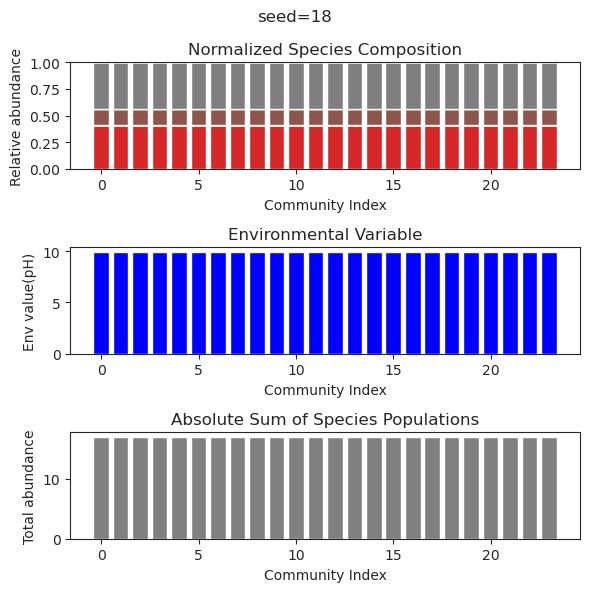

{'species': array([ 4.20193361e-73,  3.68766829e-66, -2.02073010e-51,  1.42359073e+00,
       -3.05627089e-57, -7.08758808e-75, -1.80328228e-82,  1.05578900e-35,
        1.57575374e-47,  2.43326200e-65,  5.68045523e-82,  7.51504118e-17,
        6.23268692e-87,  6.75155735e-81,  8.96412288e-01, -7.51683416e-49,
       -2.25544881e-48,  6.47287980e-79,  4.56832314e+00, -3.49029645e-52,
        4.25121795e+00, -1.04187026e-54,  5.48965517e+00,  8.76914624e-01]), 'env': array([8.43127875])}
{'species': array([-3.44080688e-59,  4.61169970e-64, -8.72587482e-84,  1.42359073e+00,
       -1.67451882e-55,  8.37848190e-75,  5.05969897e-79, -3.07528770e-37,
       -7.53358129e-48,  1.74879280e-65, -1.41422064e-81, -4.79635176e-17,
       -9.00701964e-82, -3.05215786e-81,  8.96412288e-01, -1.77936050e-44,
        2.61133932e-69, -6.43835458e-79,  4.56832314e+00, -1.62569586e-59,
        4.25121795e+00,  4.71453016e-50,  5.48965517e+00,  8.76914624e-01]), 'env': array([8.43127875])}
{'species': arra

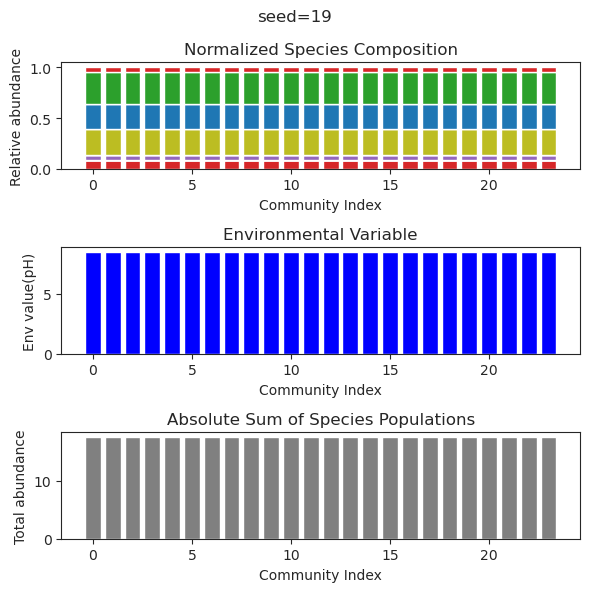

{'species': array([ 5.01232758e-57,  2.35181927e-66,  5.47071391e-65,  5.57225349e+00,
        2.46449305e+00, -6.33922005e-47,  3.02406457e-68,  4.60556583e-66,
        4.70521317e-50, -6.11998983e-20,  3.72063015e+00,  3.26592896e+00,
        7.34818627e-59,  1.09953570e+00, -5.10344207e-63,  5.26995117e-47,
        4.83065221e-68, -2.99364163e-61,  4.81316624e-62,  6.90406780e-60,
       -2.69476846e-39,  5.77684759e-47,  4.08342884e-30, -1.86225301e-55]), 'env': array([9.43901681])}
{'species': array([ 3.86979156e-035, -1.08393740e-046,  5.19858780e-059,
       -2.13725457e-030,  1.83723681e+000, -2.69317121e-067,
        1.57401895e-104,  5.22226520e-115,  8.08169986e-001,
        3.71851358e+000,  1.11738146e+001, -3.55903957e-034,
        3.59862973e-056, -1.19613871e-033,  2.31519652e-099,
        1.07131565e-034, -9.08707946e-040,  7.01017770e-057,
        8.51696056e-007,  7.15611203e-002, -3.38415813e-106,
        8.64415475e-043,  5.24608013e+000,  7.13330272e-113]), 'env':

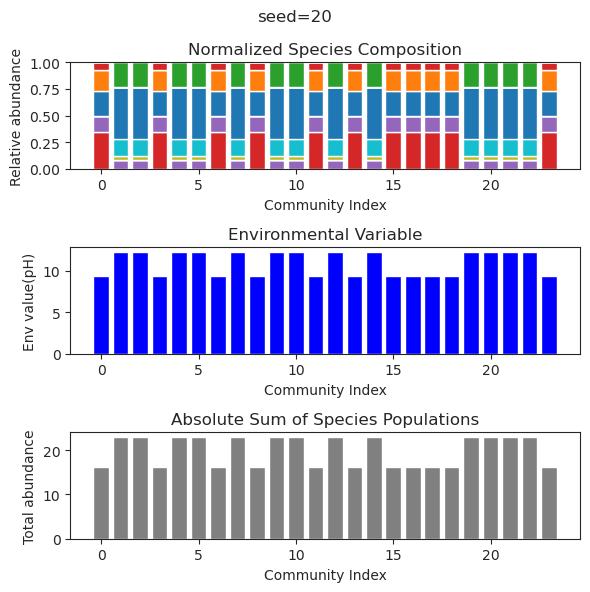

{'species': array([ 3.11609006e-040, -1.84560353e-031, -4.40239448e-062,
       -7.37095529e-091, -1.92733976e-097,  1.65910790e-056,
       -5.09221863e-077, -1.18972524e-100,  7.82450719e+000,
        8.25430259e-069, -4.39816840e-045, -8.79417323e-063,
        3.30530377e-099,  7.58925095e-037,  4.89910588e+000,
       -5.82107766e-097,  5.55915689e-001, -1.35577618e-068,
        2.24543996e-044,  3.83703709e+000,  2.59885476e-095,
        9.41835601e-035, -2.35018263e-079,  3.63532085e-096]), 'env': array([8.73681502])}
{'species': array([-6.06302563e-39, -9.01555863e-31,  5.10932961e-50, -2.25828015e-72,
       -6.42875529e-79, -2.79142854e-56,  1.47332028e-67, -1.19256036e-79,
        7.82450719e+00,  2.21769822e-63,  1.14960951e-50,  3.35084270e-59,
       -1.64708125e-79, -1.77714492e-40,  4.89910588e+00,  1.58007775e-81,
        5.55915689e-01, -7.06288111e-69, -2.90869857e-48,  3.83703709e+00,
       -2.83550687e-72,  5.14827416e-33, -1.01115385e-67, -6.82694550e-80]), 'env':

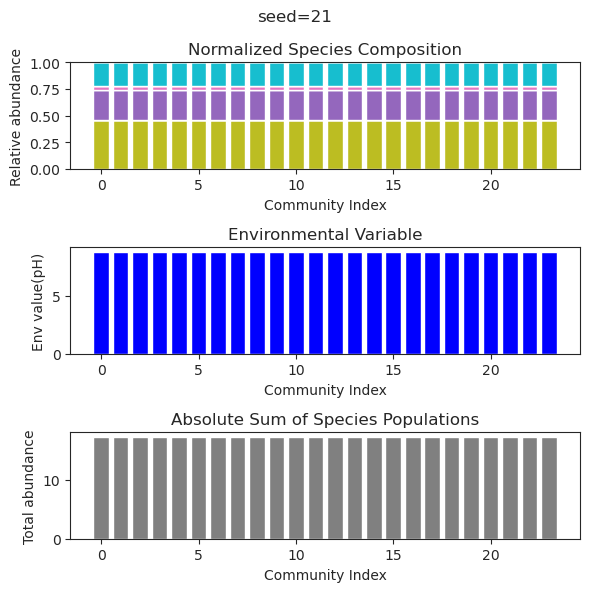

{'species': array([-1.99932405e-26, -1.41225591e-49,  7.50791653e-45,  8.21634419e-01,
        2.68164375e-70, -3.78780749e-68,  1.31735247e-44,  7.08887161e-01,
        4.57714166e-01, -2.21896751e-86,  1.70712799e-47,  1.92987199e+00,
       -3.05086641e-77,  2.08832202e+00, -1.26216897e-57,  9.21323436e-58,
       -3.80900515e-62,  7.19318930e-01,  4.27375978e-37, -4.18326689e-35,
        1.04886112e-58, -3.06239101e-41,  1.13290074e-79,  5.62757115e-02]), 'env': array([2.77990537])}
{'species': array([ 5.90870396e-090,  2.09286621e-114, -2.07701995e-104,
       -1.15282875e-039,  1.56210518e-117,  1.49259796e-117,
        1.49666110e-116,  1.10872227e-025,  7.41098088e-001,
        2.29521811e-070,  8.64496307e-092,  1.94946695e+000,
       -4.97638404e-078,  1.18340321e-001, -3.08640049e-043,
       -8.00364777e-120, -9.64034457e-107,  2.04827990e-028,
        1.54596407e+000,  3.09049280e-025,  2.90187074e-048,
       -6.19316359e-043,  2.03910714e-085,  9.41083826e-001]), 'env':

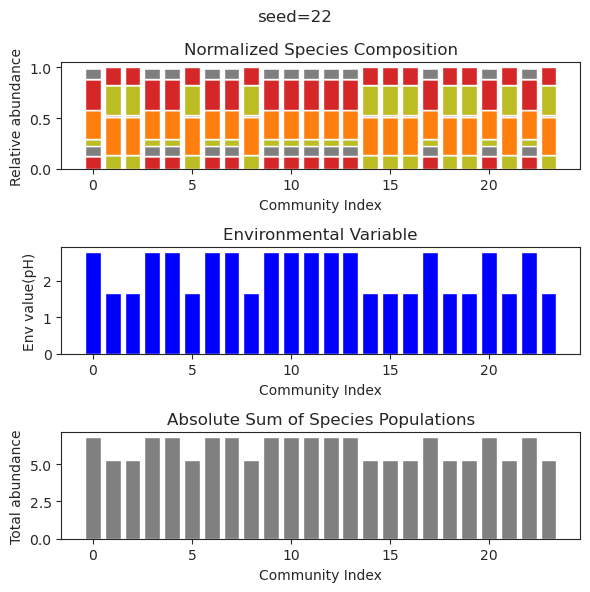

{'species': array([ 2.08004458e-112,  7.35198051e-083,  1.04349794e-084,
       -3.46771035e-048,  3.23078415e-078,  3.00060090e-080,
        5.90554441e-110,  8.03972934e+000, -2.21838880e-127,
        1.12118083e-103, -1.33083034e-050,  4.64953753e+000,
        6.54593457e-001, -1.13308657e-038,  1.42677398e-113,
       -3.60404002e-050,  2.09409980e-118,  2.29865979e-038,
        2.26149899e-036,  5.83942417e-122,  2.39368190e+000,
        5.19322344e+000,  7.57644941e+000,  1.52310500e+000]), 'env': array([12.73431841])}
{'species': array([-2.31617100e-101,  2.19905539e-071,  5.48376142e-077,
       -8.23203013e-041, -6.87251156e-068, -3.40507671e-071,
       -1.93739772e-096,  8.03972934e+000,  2.57274438e-118,
       -1.08951928e-088,  2.57045874e-044,  4.64953753e+000,
        6.54593457e-001,  2.36926207e-035, -2.38441634e-104,
        5.00748409e-042, -2.95710940e-108,  2.44827450e-032,
       -9.98053227e-032, -3.56112942e-114,  2.39368190e+000,
        5.19322344e+000,  7.57

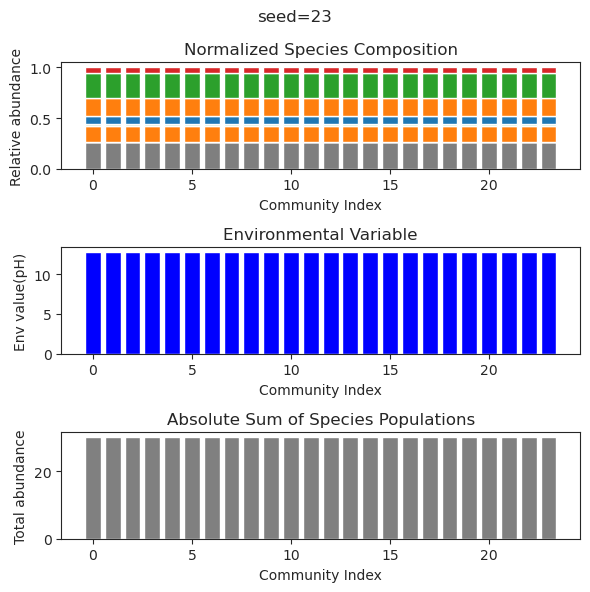

{'species': array([-4.02039537e-104,  8.45363195e-073, -3.08039728e-092,
       -8.62937211e-053,  6.83776385e-114, -1.05337258e-098,
        1.98524673e+000,  1.29221662e-118, -2.64730365e-102,
        2.85128158e-001, -1.50351692e-110, -1.84270140e-100,
        1.66861857e+000,  2.27175095e-069,  7.13940417e-106,
        5.09401441e-001,  2.89823166e-040, -2.02844332e-116,
        3.32909975e-109, -4.44800403e-103,  2.02165969e-001,
       -1.29732316e-066,  6.63598181e-001,  3.51591176e-111]), 'env': array([1.78910962])}
{'species': array([-3.35295954e-63,  1.34203603e-47,  3.23006235e-52,  1.94277945e-30,
        2.84451724e-61,  5.14242889e-51,  1.98524673e+00,  4.93104806e-61,
       -1.70650901e-63,  2.85128158e-01, -1.81956920e-58, -5.51419555e-61,
        1.66861857e+00, -1.13381909e-39,  5.63159338e-52,  5.09401441e-01,
        2.70510573e-35, -1.23010991e-57,  1.07467454e-54,  2.66844630e-53,
        2.02165969e-01,  1.57531543e-43,  6.63598181e-01,  1.39918972e-62]), 'env':

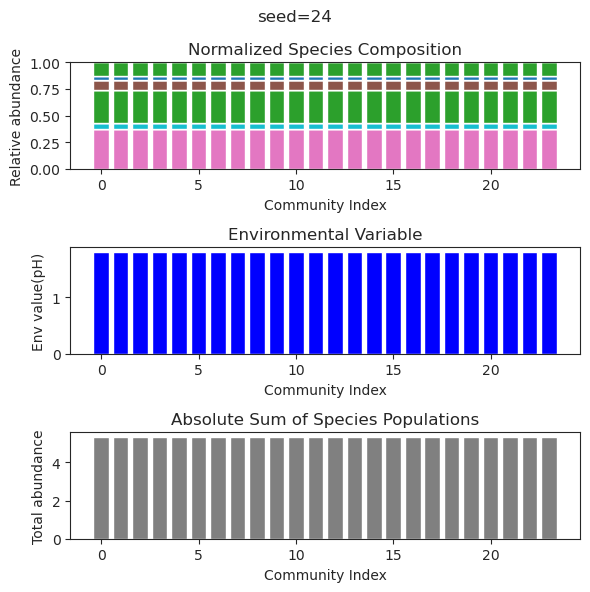

{'species': array([-3.51117033e-138, -7.07825693e-132,  1.12211118e-069,
        1.07138968e-130,  3.54713452e-001, -2.21366299e-130,
        3.78524031e-015,  1.02793523e+000,  1.01616919e-131,
       -6.33187698e-138, -2.79874779e-140, -7.12217406e-099,
        4.42692873e+000, -8.56861668e-132,  1.24277703e-133,
        3.05909057e-001,  1.15247659e-136, -4.25911111e-126,
       -1.70018883e-054, -1.60930778e-138,  1.88813630e+000,
        3.53354704e+000,  2.10097442e-001,  1.03566883e-092]), 'env': array([6.22498396])}
{'species': array([-2.41317207e-088,  2.72254844e-059,  1.24928040e-075,
        1.49895239e-116,  6.13176452e+000,  4.54471002e+000,
        1.34822565e+000,  1.77833351e+000,  1.97980867e-102,
        1.01561025e-115, -2.58126634e-136, -6.73741114e-074,
       -5.55564765e-060,  4.77794828e-135, -3.36634824e-113,
        6.63112932e-001,  6.52987384e-106, -4.35203983e-124,
       -8.09968297e-117, -3.52661224e-113,  8.68847668e-018,
       -1.13722229e-106, -1.655

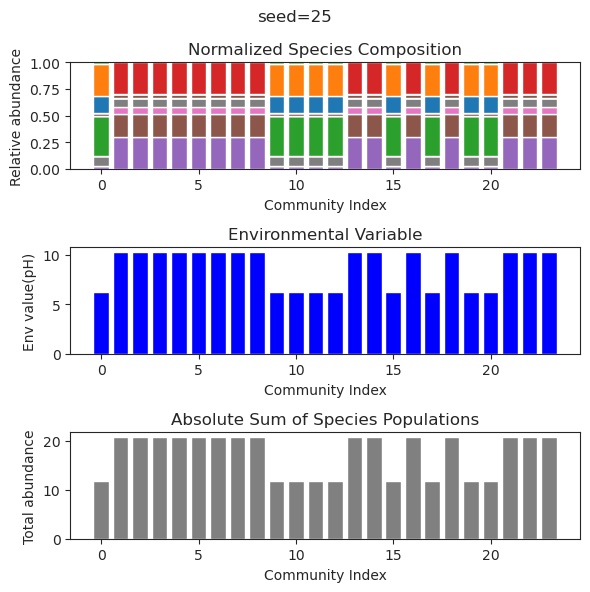

{'species': array([ 6.60981031e+000,  1.35314382e-127,  2.09490452e-071,
       -2.46828587e-024, -1.81063209e-054,  3.68693574e+000,
        2.62555786e-035,  1.12782724e-034, -1.23258815e-115,
        1.11234009e-082,  2.14633155e+000, -1.98502898e-136,
        1.32155105e+000, -6.21356076e-138,  4.75796514e-001,
        3.13480468e-083,  1.49345807e-126,  3.25865983e-140,
       -6.44119892e-036,  6.60268973e+000, -3.01071668e-099,
        1.00831495e-056, -7.61709796e-135, -5.86427777e-021]), 'env': array([11.47887242])}
{'species': array([ 6.60981031e+000,  6.25165226e-138, -1.60482957e-077,
        9.74110091e-024,  6.57239984e-055,  3.68693574e+000,
        1.78267670e-042,  3.15943715e-037, -6.96287476e-128,
        3.07159397e-096,  2.14633155e+000,  1.44233823e-142,
        1.32155105e+000, -3.16439548e-141,  4.75796514e-001,
        5.74502017e-084, -5.44103502e-144,  2.59211595e-142,
        3.07847778e-047,  6.60268973e+000,  1.60128547e-109,
       -1.17219029e-073,  2.32

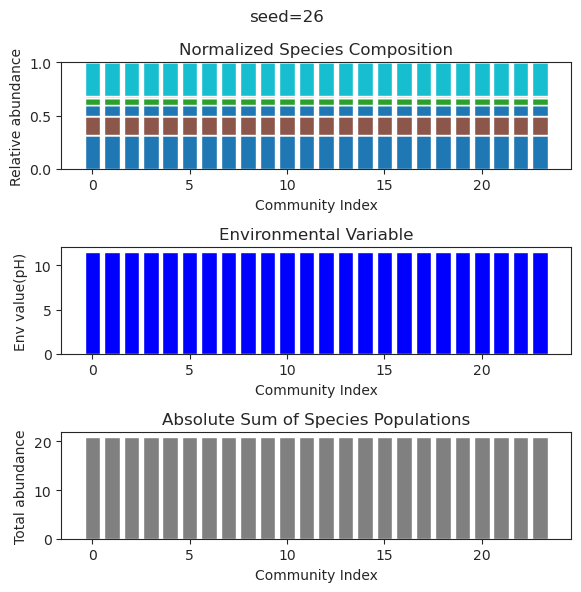

{'species': array([-7.50524728e-67, -1.36235636e-57,  1.95070955e+00, -3.82589093e-32,
        8.43572457e-55, -9.44071506e-68,  4.69886661e-58,  6.56082114e-56,
       -8.07923674e-58, -1.48956746e-40,  8.31587892e+00,  2.33073672e+00,
       -5.63202789e-62, -4.13471661e-67, -2.25589237e-70, -8.24291603e-29,
        6.06266438e-36,  1.50571918e-52,  1.82365700e-36,  1.31471047e+01,
       -2.28609295e-69, -1.96411485e-48, -2.63325231e-58, -1.68973160e-65]), 'env': array([12.96329604])}
{'species': array([-1.49725685e-85,  4.93880422e-75,  1.95070955e+00, -1.14151074e-36,
        2.02969813e-62, -3.35581241e-87, -3.78622954e-69,  1.44126100e-70,
        2.26527457e-70,  6.91076512e-43,  8.31587892e+00,  2.33073672e+00,
        1.16583316e-72, -2.48307286e-82, -5.28874327e-87, -9.82424495e-26,
       -6.33175805e-35, -7.40212097e-59, -2.18636236e-33,  1.31471047e+01,
       -1.01897296e-86,  1.19998040e-57,  5.15498298e-73,  1.31367973e-75]), 'env': array([12.96329604])}
{'species': ar

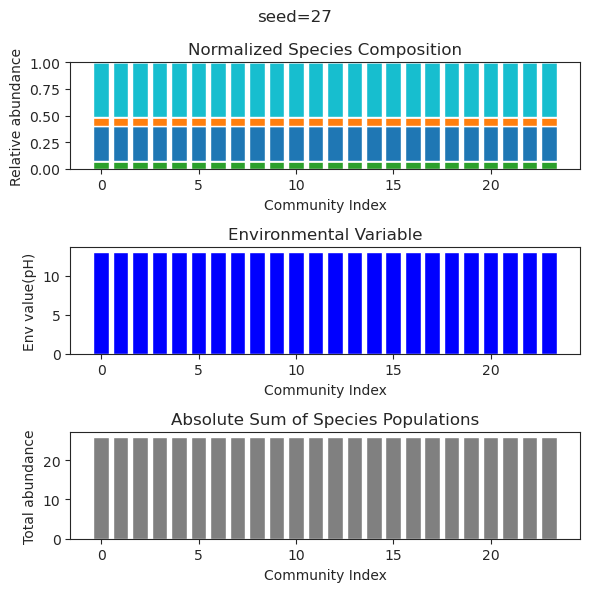

{'species': array([-1.05958362e-52,  3.19691169e-65,  5.38890982e-66,  6.45008499e-37,
        9.32553026e-69,  2.80201706e-67,  1.09869249e+00,  1.32065030e-71,
       -1.01302875e-50,  1.13806541e-29,  1.32963523e-68,  6.13877204e-38,
        1.01159723e+01,  9.11480511e+00,  6.78397141e+00, -1.03762209e-62,
       -3.23016646e-60, -1.17269986e-47, -1.20890082e-37, -2.23087645e-34,
       -3.12277481e-44,  1.25878007e-56, -1.74993115e-64,  1.96180879e-65]), 'env': array([11.94904471])}
{'species': array([-1.01930968e-69, -1.85148697e-87,  3.87054003e-92,  6.31911930e-39,
       -7.92604913e-93, -1.18992698e-94,  1.09869249e+00, -2.51729363e-96,
        3.97363494e-64,  3.15845307e-28, -2.85372393e-89,  4.63956412e-42,
        1.01159723e+01,  9.11480511e+00,  6.78397141e+00,  8.30548098e-94,
        5.16458340e-74,  7.50617999e-58,  5.50885359e-37,  2.23098837e-35,
        4.10144108e-52,  1.35904131e-86,  1.78158576e-81, -1.15467820e-87]), 'env': array([11.94904471])}
{'species': ar

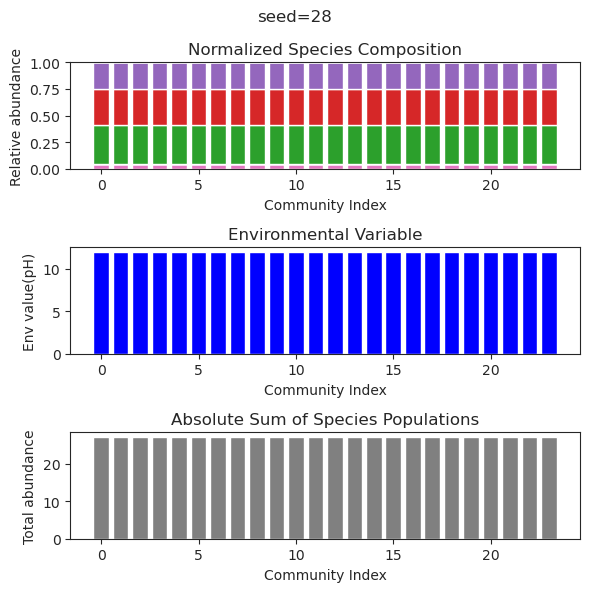

{'species': array([-1.64343666e-38,  1.54726435e-31,  7.52086027e-31,  7.69295522e-01,
        1.31042710e-36,  8.19377446e-95,  2.37367511e-01,  8.84172396e-01,
       -1.46635669e-73,  4.32852927e-44,  2.23303316e-69,  1.18291945e-40,
        4.91172721e-38,  8.38100902e-51,  4.92577996e-01, -1.97046686e-89,
        7.28445753e-89,  2.11624134e-43,  5.02611285e-01,  2.69916268e-96,
       -2.45552405e-40,  1.02500760e+00, -4.09808920e-75, -2.16729896e-17]), 'env': array([1.64442647])}
{'species': array([-1.18245209e-43,  4.63419150e-29,  6.36338890e-30,  7.69295522e-01,
        7.17741975e-33, -4.45859976e-39,  2.37367511e-01,  8.84172396e-01,
       -9.24981075e-46,  8.56246704e-39,  1.68035160e-57,  9.65530951e-39,
       -1.16438323e-64,  2.10596877e-57,  4.92577996e-01, -1.11188279e-65,
        2.46679266e-42, -1.64374812e-39,  5.02611285e-01,  7.43736617e-70,
        3.05474545e-66,  1.02500760e+00,  1.42034024e-59, -4.62920942e-15]), 'env': array([1.64442647])}
{'species': arra

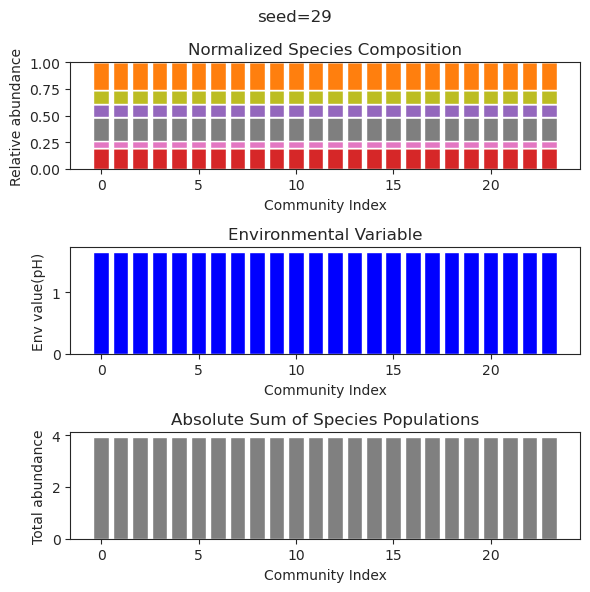

{'species': array([-4.01975199e-052,  1.37562206e-070,  3.42304906e-078,
       -1.59709415e-072,  2.01521581e-001,  1.13135603e-165,
       -7.36048010e-057, -5.06277802e-127,  1.85977987e-063,
        1.73388662e+000,  1.72155805e-063,  2.21752494e-126,
        1.42383822e+000,  4.83742620e-001,  1.26598440e-040,
        1.65567747e-070,  2.20474593e-116,  7.69891172e-162,
       -1.23477303e-056,  1.50091571e-167,  2.61262282e-001,
        8.85403059e-001, -5.21923527e-049,  8.20768873e-001]), 'env': array([2.05238896])}
{'species': array([-1.57085584e-050,  4.09211930e-065,  5.85730608e-071,
        4.16401778e-070,  2.01521581e-001, -2.69437132e-144,
       -2.55599252e-052, -5.14907945e-116, -3.05319482e-060,
        1.73388662e+000, -6.09528726e-061, -3.50098921e-109,
        1.42383822e+000,  4.83742620e-001,  8.42453161e-044,
        6.56086316e-066, -4.55619660e-104,  1.14622044e-141,
       -2.05409577e-054, -4.10881247e-140,  2.61262282e-001,
        8.85403059e-001, -1.429

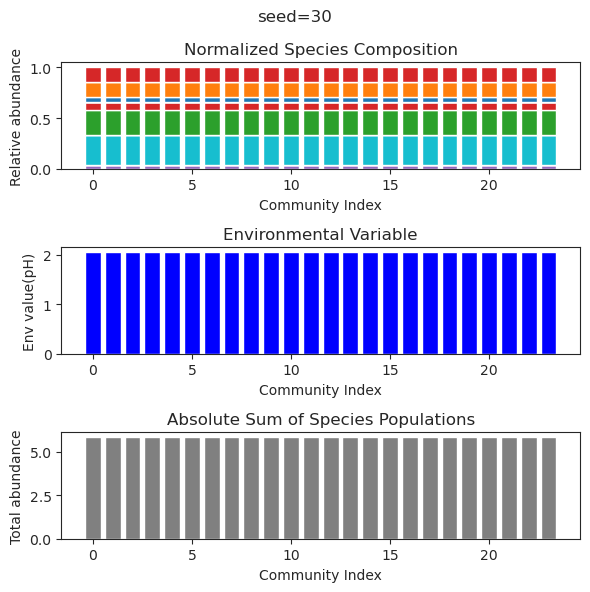

{'species': array([ 3.10967280e-052, -1.26606092e-052,  7.99323956e-210,
        1.24297179e+000, -6.75680757e-112,  1.67274929e-016,
        2.38000794e+000, -1.15871203e-066, -1.95010542e-091,
        1.08862413e-001,  1.75026861e-081, -9.69453934e-046,
       -2.06618689e-053,  1.30473051e-185,  1.23576910e-195,
        4.11255750e-001,  1.97470212e+000,  1.94611198e+000,
       -2.28492192e-167,  1.37272187e-154, -4.51010862e-176,
        1.86020086e+000, -7.68544891e-140,  3.79673032e-200]), 'env': array([5.40035647])}
{'species': array([ 4.14069210e-094,  4.95613278e-096, -2.25199729e-156,
        1.24297179e+000,  2.69932084e-056,  4.08712724e-017,
        2.38000794e+000, -2.72376919e-053,  1.44582022e-128,
        1.08862413e-001,  1.80615590e-048, -9.69488538e-042,
       -2.05312295e-052,  1.57379005e-144,  1.97645210e-150,
        4.11255750e-001,  1.97470212e+000,  1.94611198e+000,
       -2.53788494e-123, -1.82445557e-060, -3.11158041e-124,
        1.86020086e+000, -4.704

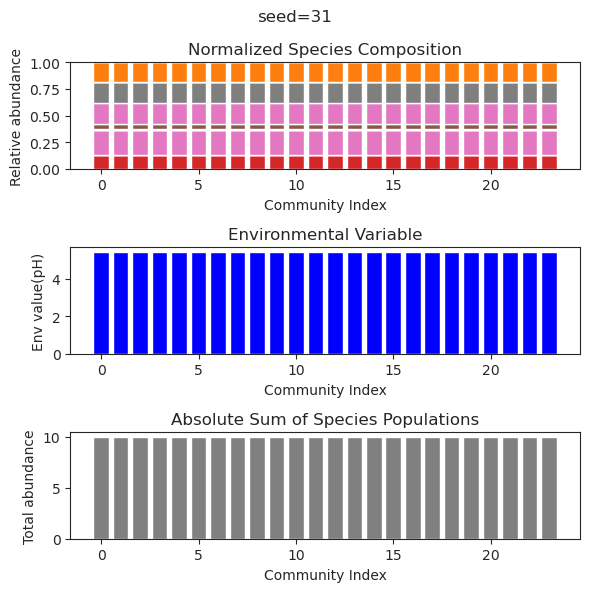

{'species': array([ 1.27056973e-34, -2.30974388e-44, -9.26946501e-25,  2.12336701e-52,
       -6.04064775e-72, -1.62779430e-67,  1.60828447e+00, -2.37551953e-42,
        6.40921147e-78, -7.08893719e-65,  2.53595920e+00,  7.52141280e+00,
       -3.61701402e-42,  2.83587285e-91,  2.48088297e-32, -1.60111747e-98,
        3.08159152e-94, -1.21697407e-32,  4.46039381e+00, -6.84792583e-63,
       -3.51961166e-23,  2.55716181e-60, -4.33112938e-65, -1.61166707e-92]), 'env': array([9.01581815])}
{'species': array([ 6.67259287e-041, -1.78571548e-050,  4.37441765e-022,
        1.15181989e-063,  6.65784246e-097,  4.93244801e-088,
        1.60828447e+000, -8.85075896e-045, -3.96079575e-103,
        3.36418732e-087,  2.53595920e+000,  7.52141280e+000,
        8.75608290e-047,  4.05414688e-110,  4.70230154e-034,
       -1.41120286e-128,  3.28253138e-110,  1.71003700e-034,
        4.46039381e+000, -1.63040688e-083,  6.71265144e-021,
        3.69174998e-065,  4.26631448e-084,  1.83508583e-115]), 'env':

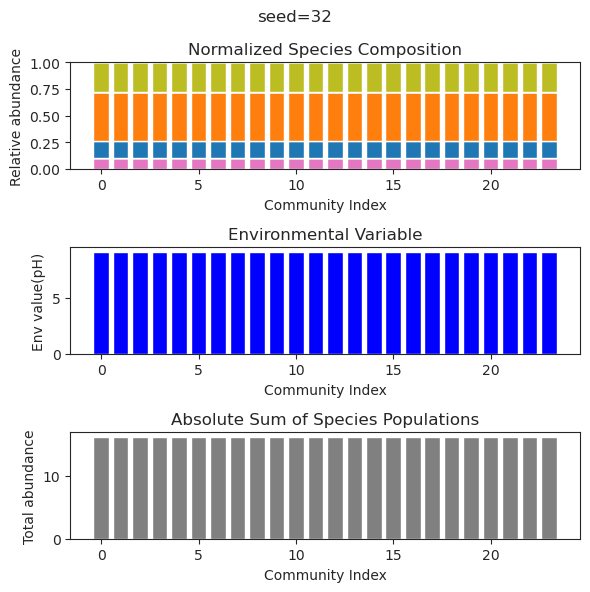

{'species': array([ 5.23299542e+000, -1.60842713e-020, -7.86067089e-100,
        4.98051806e-089, -1.56346151e-032,  1.61080757e+000,
       -1.46898399e-044, -1.07705883e-062, -2.12149050e-098,
       -6.19211706e-066, -4.27869458e-048,  4.73101935e+000,
        2.05357800e+000, -1.25623760e-101,  7.13350290e-022,
        3.22644735e-073,  8.80514179e-045,  4.62262366e-073,
       -1.33657004e-046,  1.57881667e+000,  2.14247151e-061,
        1.35806320e-094,  5.84956584e-001,  4.52271998e+000]), 'env': array([9.30597222])}
{'species': array([ 5.23299542e+00,  1.20788695e-17, -7.85593185e-84,  3.22709474e-86,
        4.12224510e-37,  1.61080757e+00, -1.38994075e-39,  3.71156990e-51,
        4.18340275e-85,  1.32791846e-55, -3.20561572e-55,  4.73101935e+00,
        2.05357800e+00,  4.89765233e-90,  1.98794553e-18, -3.44032782e-68,
        4.36101834e-47, -3.01003405e-61,  9.57979414e-48,  1.57881667e+00,
       -3.77264633e-53, -8.08574555e-81,  5.84956584e-01,  4.52271998e+00]), 'env':

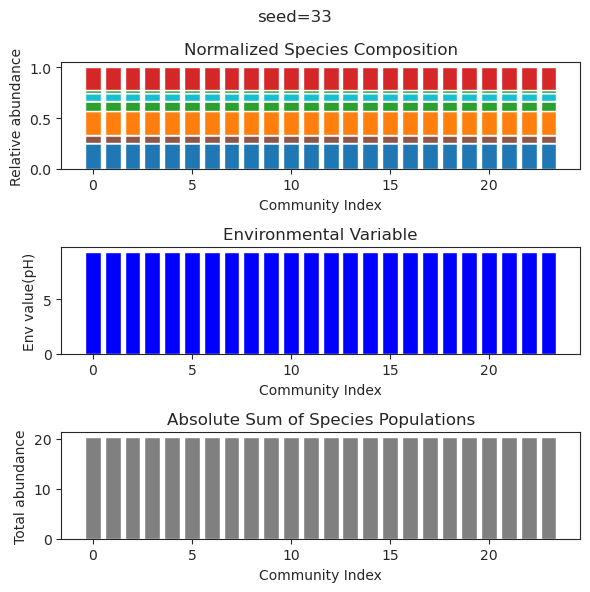

{'species': array([ 9.61693202e-046,  5.50762128e-001,  1.48688103e+000,
       -1.55360239e-050, -3.75728224e-130,  1.88488304e-017,
        1.41845428e+000, -2.15477054e-051, -2.23703258e-049,
        1.03563041e+000,  1.76175709e-054, -4.02499167e-043,
       -6.73912627e-039, -1.07636510e-049, -2.96112814e-037,
       -4.46269448e-056, -3.82328674e-106,  2.24517333e+000,
        1.24514137e-111,  6.84313579e-083, -9.58953277e-103,
        8.77642708e-001, -1.81266041e-085,  7.58339296e-001]), 'env': array([4.18039525])}
{'species': array([-1.88988462e-048,  5.50762128e-001,  1.48688103e+000,
       -1.13901992e-051,  6.03628658e-049, -1.52227170e-015,
        1.41845428e+000, -1.94058257e-058,  2.14374827e-065,
        1.03563041e+000,  4.87612121e-063, -9.55134231e-049,
       -2.55027971e-101,  2.45513125e-055,  5.09359564e-036,
       -6.55609434e-090, -2.57560324e-119,  2.24517333e+000,
        7.34122922e-128,  3.47247286e-084, -1.23655756e-105,
        8.77642708e-001,  1.157

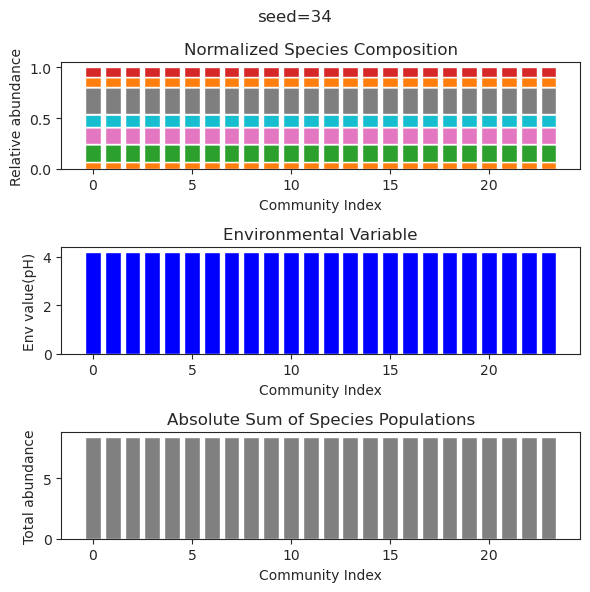

{'species': array([ 1.84925917e+000,  1.74211236e-051, -7.51346291e-057,
        1.15955924e-124, -1.07639290e-085,  9.78692105e-052,
        3.52166000e-086,  2.65206478e-064, -2.39994462e-058,
       -9.58074519e-034, -1.20366600e-128,  3.50396005e+000,
        1.80424922e-098,  5.41351812e+000,  3.59398567e-090,
        1.12288161e-068,  8.91114592e-001,  2.19958784e-001,
        2.90133409e+000,  3.91768090e-039, -3.65055221e-102,
        5.27583681e+000,  3.99423436e-092, -5.97464345e-117]), 'env': array([9.08931122])}
{'species': array([ 1.84925917e+00, -3.24870965e-48, -1.58613417e-44,  2.87913957e-95,
        4.70482444e-46,  8.37167121e-49, -8.20854634e-72,  8.64541608e-48,
        1.36554181e-50, -2.49895261e-33,  3.80920672e-99,  3.50396005e+00,
        2.56396376e-73,  5.41351812e+00, -1.87220964e-72,  5.82046079e-61,
        8.91114592e-01,  2.19958784e-01,  2.90133409e+00,  3.72648677e-37,
        8.02078464e-83,  5.27583681e+00, -5.39346289e-72,  1.09903784e-93]), 'env':

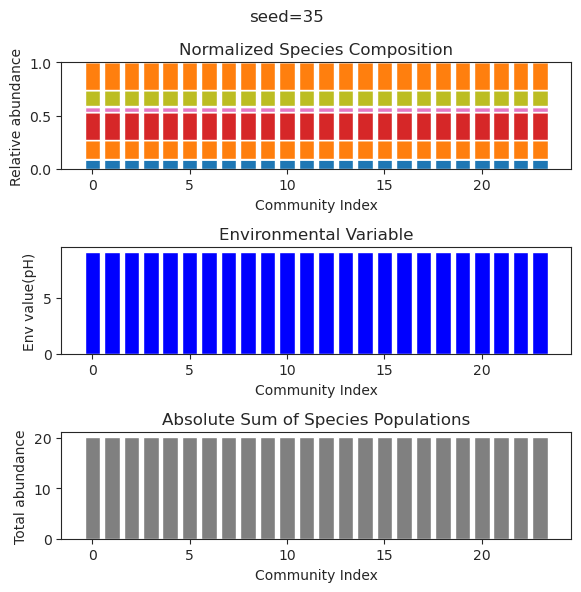

{'species': array([ 3.16691069e-037,  1.89615979e-053, -1.66012043e-098,
       -1.69077129e-087,  3.37044536e-040, -2.02446828e-044,
       -4.91700154e-082, -4.00344940e-085, -5.48596431e-109,
        4.58872346e+000,  1.29913524e-109, -6.39848338e-027,
        1.52827140e-106,  5.06661365e-051,  4.26859619e+000,
        4.10000459e+000,  3.86654702e-107,  6.81510728e-057,
       -2.80689136e-092,  7.48207902e-001,  8.05601159e+000,
       -6.19347660e-035,  8.45366569e-107, -5.60585397e-042]), 'env': array([10.77244119])}
{'species': array([ 3.91487359e-37,  2.40758145e-44,  2.46160027e-85, -8.38788651e-71,
        2.60079951e-34,  1.19601393e-42,  3.51054452e-68,  1.03873858e-70,
       -2.57846630e-86,  4.58872346e+00,  7.60228395e-90, -8.60433182e-27,
        9.26770573e-88,  5.16408546e-46,  4.26859619e+00,  4.10000459e+00,
       -1.75375195e-87,  7.54567541e-50, -1.97294200e-76,  7.48207902e-01,
        8.05601159e+00,  2.82107099e-34,  8.96491420e-85, -1.53809256e-39]), 'env'

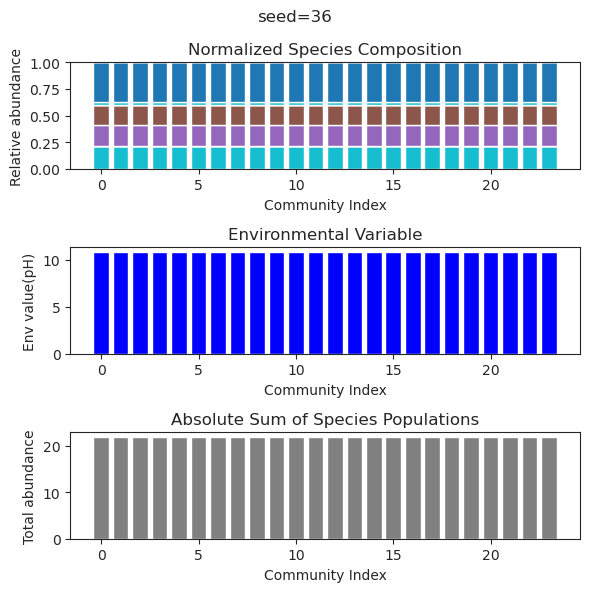

{'species': array([ 8.60811609e-51,  7.65396647e-40, -1.37993976e-49, -3.68522133e-71,
        9.50284185e-52,  3.07262383e-37, -1.04820184e-72, -5.93713398e-72,
        3.52234910e+00,  2.96702825e-37,  4.34551974e-02, -5.10602594e-52,
        5.78483037e-56, -1.76485724e-76,  1.45858731e+00,  1.42355785e+00,
       -3.52350162e-40, -7.12161628e-40,  3.30359046e+00,  7.26577978e-75,
       -8.58505408e-46,  3.07021914e+00, -3.47815274e-35,  3.85597735e-73]), 'env': array([5.92436495])}
{'species': array([ 5.66039276e-44, -7.62429280e-41,  1.05496640e-42, -1.98178011e-44,
       -7.15833430e-48,  5.49430229e-33, -1.19103096e-42,  2.79504081e-46,
        3.52234910e+00,  3.83194516e-73,  4.34551974e-02,  1.77954586e-54,
        1.12835977e-59,  9.50387674e-47,  1.45858731e+00,  1.42355785e+00,
        1.25032676e-66,  3.89167924e-80,  3.30359046e+00,  5.07179829e-81,
        3.57236600e-81,  3.07021914e+00,  4.04357654e-41,  8.37921404e-85]), 'env': array([5.92436495])}
{'species': arra

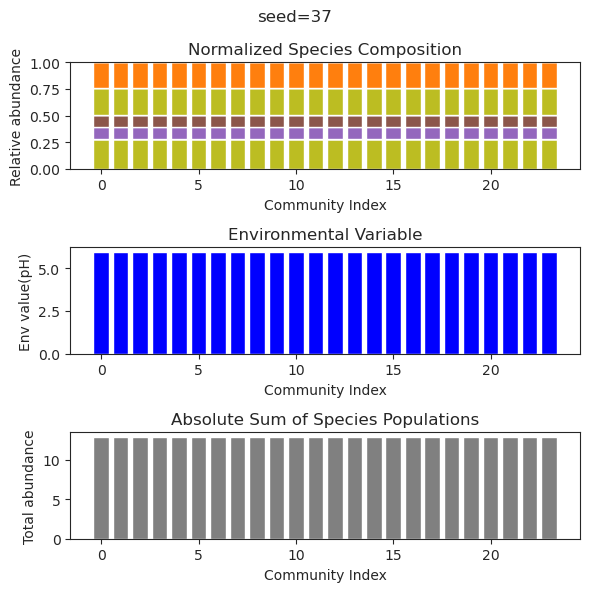

{'species': array([ 5.73802377e-001,  8.38862744e-175,  1.44421858e-098,
        1.42888998e+000, -8.38731725e-132,  1.23192015e-001,
        9.02714752e-001,  7.68274080e-176,  4.74826711e+000,
       -2.50450682e-180,  6.80404267e-001,  4.65395016e-117,
        3.33658846e-122,  2.72481740e-098,  8.63202907e-114,
        2.06657455e-029,  7.78621938e-115,  1.64793420e+000,
       -2.37529838e-058, -5.25343320e-178,  6.29000167e-174,
        1.29413510e-001, -5.55888222e-173, -4.41783201e-173]), 'env': array([5.54376914])}
{'species': array([ 5.73802377e-001,  1.15462623e-104,  5.54914224e-115,
        1.42888998e+000,  1.72952923e-065,  1.23192015e-001,
        9.02714752e-001, -1.04102718e-135,  4.74826711e+000,
        6.23918452e-145,  6.80404267e-001, -4.75341816e-123,
        8.95695660e-119,  6.41783658e-102, -2.35462662e-123,
       -1.70505914e-031,  1.43498413e-127,  1.64793420e+000,
        7.20052720e-067,  1.11797317e-131, -9.49949673e-136,
        1.29413510e-001, -1.496

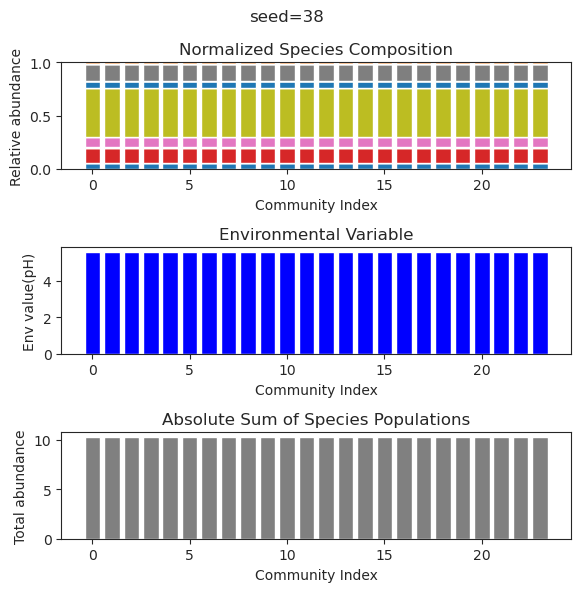

{'species': array([ 7.49728918e-35,  1.43623668e+00,  3.87695367e+00, -1.52377716e-63,
        1.52268582e-63, -7.30148497e-46,  1.99804389e-48,  2.05850920e-55,
        3.27690313e+00,  5.84212385e-59,  2.36937716e-62,  2.20853547e-52,
        2.37923838e+00, -7.54268342e-65,  3.54359779e-69,  2.76869501e-49,
       -7.92547877e-34, -4.16437116e-67,  2.96040819e+00, -1.43834387e-47,
        3.61946014e-70, -1.78212597e-54, -1.95017891e-41,  2.73874503e+00]), 'env': array([9.57599969])}
{'species': array([ 4.00998697e-39,  1.43623668e+00,  3.87695367e+00,  2.19797596e-60,
       -1.96952009e-64, -2.82975925e-42, -6.75297962e-48,  3.26270711e-53,
        3.27690313e+00, -2.92740221e-59, -4.99513511e-62,  3.33878789e-48,
        2.37923838e+00,  1.88166648e-60,  1.31264493e-66,  2.77261182e-47,
       -9.01896404e-31, -2.19064377e-63,  2.96040819e+00, -1.00446087e-42,
        3.23819959e-67,  4.27588532e-52, -1.40363529e-37,  2.73874503e+00]), 'env': array([9.57599969])}
{'species': arra

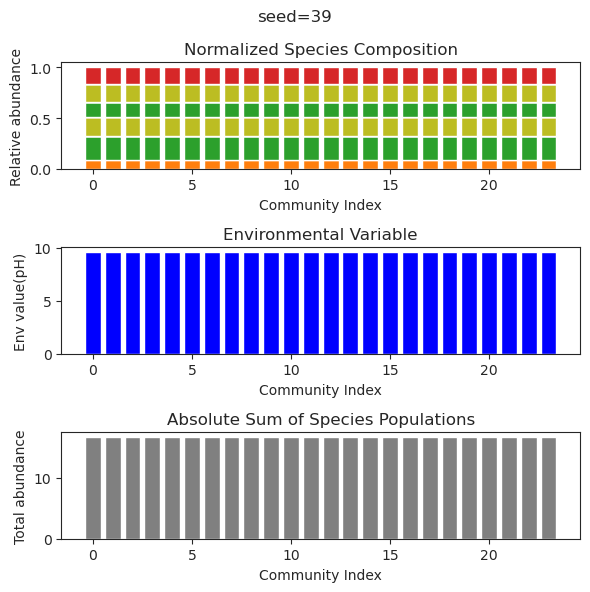

{'species': array([-1.55508872e-112, -4.32920061e-076,  5.61735948e+000,
       -1.19784981e-068,  1.24855259e-064,  1.66635887e-019,
       -2.39439091e-073,  2.57597674e+000,  1.95606641e-092,
       -1.14155102e-091, -9.64796361e-109, -8.38536919e-125,
        2.24703625e+000,  1.15964764e-107, -2.27656943e-135,
       -2.21342102e-108, -6.86597742e-106, -5.96351780e-132,
       -2.30792580e-111, -8.17047081e-087,  1.53513827e-051,
       -3.89862164e-112,  4.71924674e+000, -3.39882721e-039]), 'env': array([7.61755228])}
{'species': array([ 1.50120893e-103,  1.27875160e-065,  5.61735948e+000,
        2.00710823e-069,  3.26390619e-058, -2.17231177e-019,
        1.71504834e-072,  2.57597674e+000, -1.01572606e-087,
        1.90102052e-085,  2.51236659e-101,  1.35524947e-106,
        2.24703625e+000,  6.82695545e-104,  6.33900704e-116,
        1.67401480e-099,  2.55169450e-094,  6.67610054e-114,
        6.55187487e-097, -7.74912444e-074, -1.92045970e-102,
       -2.53792538e-101,  4.719

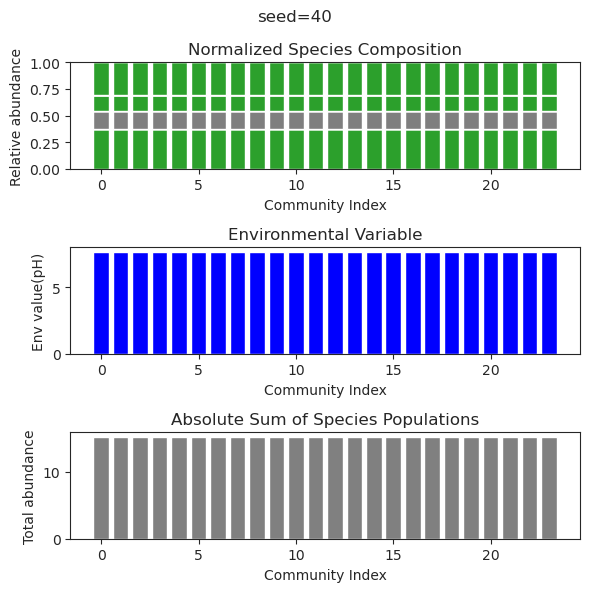

{'species': array([ 3.80243364e+000,  4.86917454e+000,  2.65934298e+000,
        2.24947371e-116,  3.20529977e+000, -8.44835140e-067,
        1.32648518e-078, -1.70506506e-079,  9.48571973e-001,
       -2.84020892e-030, -4.16845375e-030, -5.90817698e-086,
        1.83006792e-050,  2.17150717e-040, -5.77589655e-079,
        8.16620388e-092,  5.48995048e-001, -2.15789524e-096,
       -1.85450491e-080, -2.43732677e-102,  1.59665041e-109,
       -5.92051733e-094, -1.28337327e-075,  9.53749902e-108]), 'env': array([8.08627495])}
{'species': array([ 3.80243364e+000,  4.86917454e+000,  2.65934298e+000,
       -3.45803801e-107,  3.20529977e+000,  2.27180156e-063,
        2.71156082e-072, -1.77382458e-075,  9.48571973e-001,
        2.56610397e-025,  1.95236787e-029, -2.80475909e-079,
       -4.06470446e-050,  1.08531227e-035, -1.89603782e-074,
       -4.84228605e-087,  5.48995048e-001,  1.10849529e-088,
       -3.63911410e-074, -5.09493486e-095, -1.26939103e-104,
        6.85354027e-090, -2.260

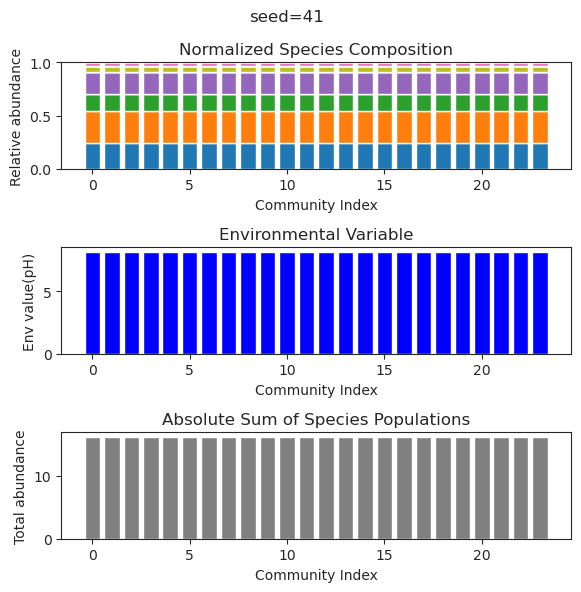

{'species': array([-1.37617386e-82, -4.91566314e-44, -5.87151281e-55,  6.90745180e+00,
       -1.54592652e-81, -7.60799280e-82,  2.09385169e+00,  8.78195357e+00,
       -4.79350940e-84,  2.07015327e-79, -1.15720719e-33, -5.23988534e-58,
        1.74582767e+00, -3.13379116e-82, -6.81544501e-41,  1.31408977e-61,
        5.48214603e-79,  1.57105733e-64, -4.77911092e-84, -3.25400956e-66,
       -1.76286916e-83, -1.02713193e-22, -2.17555144e-37, -9.59140872e-48]), 'env': array([10.99508181])}
{'species': array([ 1.15003580e-95, -7.48592141e-45,  7.17360464e-53,  6.90745180e+00,
       -1.46261380e-93,  6.26050158e-92,  2.09385169e+00,  8.78195357e+00,
        2.54303334e-95, -1.23912436e-80, -7.71624595e-30, -9.67210987e-56,
        1.74582767e+00, -2.45423508e-98, -9.77563132e-42, -2.65982085e-60,
       -2.27228425e-87, -8.35042475e-59,  8.66977462e-99, -1.17008065e-71,
       -8.52643079e-99,  2.38517673e-22, -3.81190671e-31, -5.23585436e-48]), 'env': array([10.99508181])}
{'species': ar

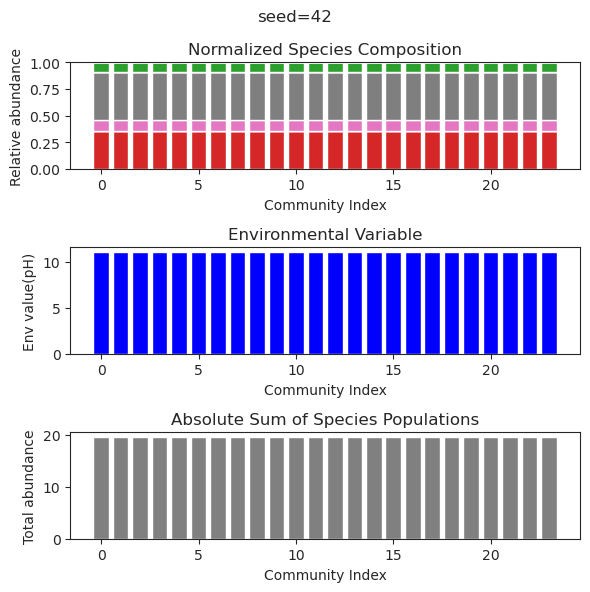

{'species': array([ 4.17484274e-50, -1.21110167e-57,  4.07173217e-67,  1.59027945e+00,
        2.28450556e-69, -1.10266719e-48,  2.70428247e-50, -3.39146477e-17,
       -3.62225529e-38, -4.51840855e-50,  7.21825688e-01, -7.57056152e-48,
       -1.11411172e-81,  3.14040000e-49,  4.75102354e+00,  3.31034152e+00,
        3.32840378e-79,  1.82429238e-79, -1.25822010e-76, -2.13225629e-82,
        1.66389723e-66,  8.22460976e-01,  3.89894403e+00, -1.05514956e-80]), 'env': array([8.91095676])}
{'species': array([-1.08729891e-050,  4.26591209e-055,  2.17864913e-054,
        1.59027945e+000, -3.44441969e-075,  2.72204906e-089,
       -1.64537936e-050,  7.30018616e-018, -6.57377744e-027,
        8.21242025e-098,  7.21825688e-001,  2.28474340e-037,
        3.82974720e-106,  1.91772230e-056,  4.75102354e+000,
        3.31034152e+000,  5.07572582e-100,  3.55131551e-087,
        3.30363413e-073,  9.70489619e-109, -1.37915201e-057,
        8.22460976e-001,  3.89894403e+000, -3.24791368e-105]), 'env':

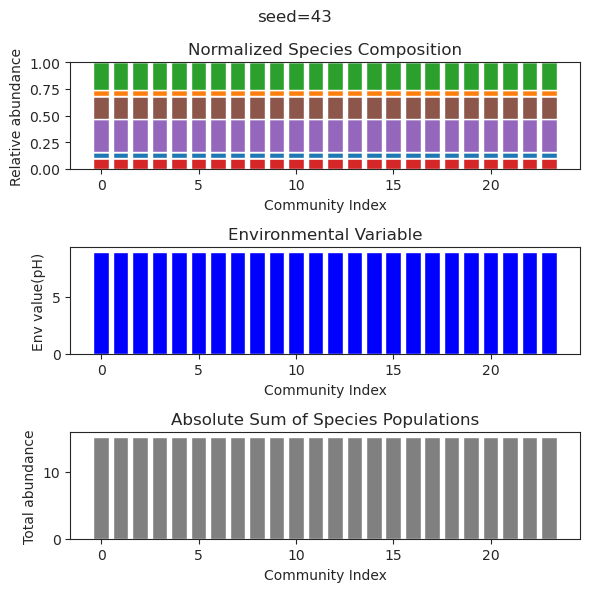

{'species': array([ 3.61773919e-43,  2.54408062e-74,  5.05624573e+00,  4.49832240e-52,
        6.06681579e+00,  4.65255005e-42, -2.94115894e-34,  5.66264131e-26,
        6.99754601e-31,  3.08604946e-74,  6.83260648e-32, -1.66557266e-77,
        1.53173487e-76,  7.67890550e+00,  1.76265605e+00, -1.66269028e-35,
       -4.54240653e-63, -6.86253493e-67,  8.97941356e-45, -5.50517696e-69,
       -1.60992627e-74,  4.47024052e-47, -4.58083536e-68, -5.47115041e-41]), 'env': array([10.98720292])}
{'species': array([ 2.61951166e-38,  4.91495204e-58,  5.05624573e+00, -2.91732709e-40,
        6.06681579e+00,  1.63768937e-38,  2.25135011e-40,  1.43191074e-27,
        4.76845217e-36,  1.62324186e-53,  6.96162749e-33,  1.96192639e-54,
        1.40955675e-56,  7.67890550e+00,  1.76265605e+00,  3.04728872e-43,
       -7.91666420e-60,  4.60528657e-60, -5.09369061e-51,  1.38416446e-52,
        2.35538235e-60, -4.06493215e-42,  1.49793381e-62, -3.60503045e-48]), 'env': array([10.98720292])}
{'species': ar

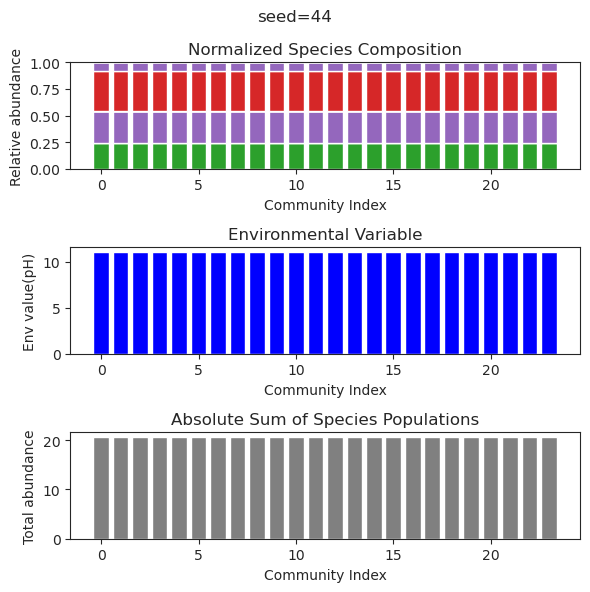

{'species': array([ 7.98963222e-001, -6.04563583e-155,  1.58125700e-136,
        6.14104236e-175,  3.55527554e-050,  2.21511787e-135,
       -6.87477168e-163,  3.59509106e+000,  1.60639335e-157,
        3.82247468e-154,  1.92020146e-157,  2.31257369e-135,
       -3.91749516e-171, -3.93453066e-055, -6.66023318e-049,
        4.07134035e+000, -3.53426683e-153,  2.06275133e-033,
        3.32486548e+000, -7.27076428e-149,  4.47169656e-139,
       -1.23376375e-147,  3.35445243e+000,  6.25183623e+000]), 'env': array([10.09672389])}
{'species': array([ 7.98963222e-001,  2.15242445e-110,  3.73969034e-093,
       -2.38310260e-110, -2.37717591e-088, -2.56245337e-094,
       -1.51558547e-108,  3.59509106e+000,  8.99124243e-115,
       -1.00297144e-110, -9.00805768e-102, -5.40498397e-106,
       -2.21718816e-122,  1.75212293e-034,  3.88447475e-063,
        4.07134035e+000,  8.87199932e-118,  1.02624119e-020,
        3.32486548e+000, -1.54164956e-086, -2.54406299e-091,
        2.05651899e-111,  3.35

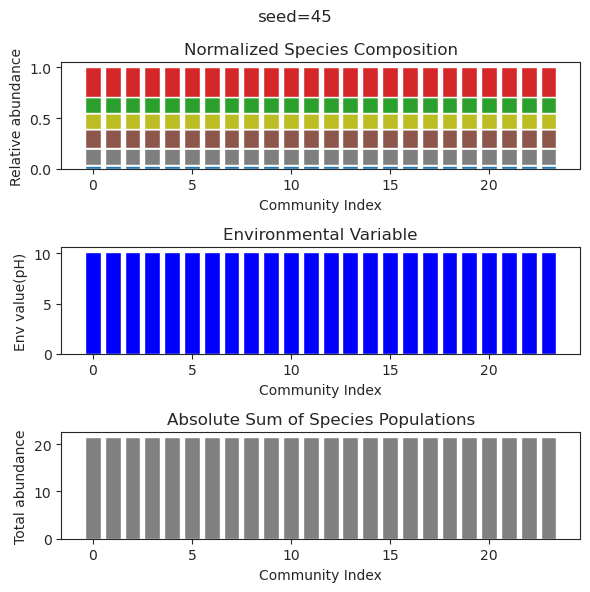

{'species': array([ 3.87576585e-42,  9.07484549e-01, -1.65896637e-38, -5.84477492e-39,
       -7.39356281e-38,  1.78343372e+00, -2.31331999e-46,  4.87729021e+00,
        2.79125164e-43,  3.65214266e-57, -6.84990803e-47,  2.54136603e+00,
        2.26829256e+00, -1.07941013e-56, -1.48272343e-55, -5.33040519e-38,
        1.08651067e-56,  2.62514394e+00, -1.67623457e-55, -3.14960096e-58,
       -7.83124546e-57,  2.57319897e-39,  1.05134886e-56, -2.52633230e-48]), 'env': array([7.37882559])}
{'species': array([-6.23701032e-44,  9.07484549e-01,  2.87834503e-39, -2.56409095e-36,
        1.48607837e-35,  1.78343372e+00, -4.10754671e-46,  4.87729021e+00,
        1.54178976e-67,  4.66838397e-63,  9.33134471e-50,  2.54136603e+00,
        2.26829256e+00,  7.22007228e-63, -7.70563141e-68, -1.10207651e-35,
        2.83022306e-68,  2.62514394e+00, -9.41290245e-60, -1.81270480e-65,
        3.31850916e-66,  9.02681279e-37,  2.34939075e-62, -2.86684153e-52]), 'env': array([7.37882559])}
{'species': arra

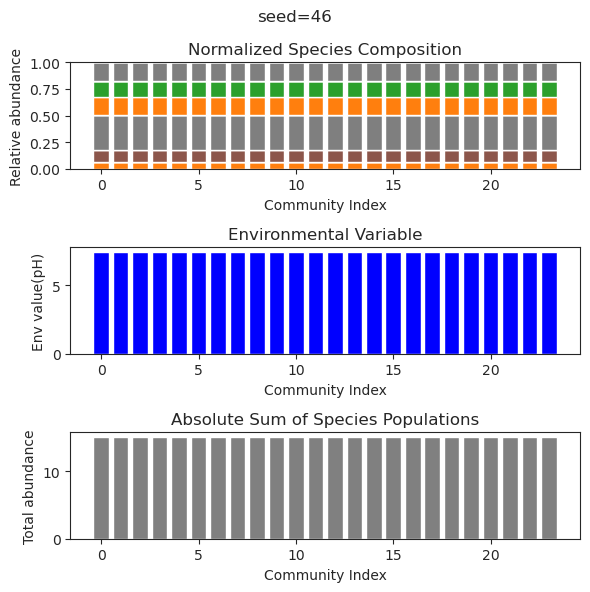

{'species': array([6.02491215e-276, 1.65085480e-001, 4.90517698e-001, 4.16764044e-305,
       1.25227107e-001, 0.00000000e+000, 7.47098124e-258, 0.00000000e+000,
       1.20470576e-001, 0.00000000e+000, 0.00000000e+000, 2.82847458e-001,
       0.00000000e+000, 3.03263000e-001, 0.00000000e+000, 1.00346221e+000,
       1.19605302e+000, 8.66481648e-255, 5.00450311e-016, 6.67312353e-206,
       0.00000000e+000, 4.94065646e-324, 0.00000000e+000, 2.23071198e-299]), 'env': array([1.10274833])}
{'species': array([ 2.68182166e-287,  1.65804627e-001,  4.83578407e-001,
        5.65259030e-309,  1.22249735e-001,  0.00000000e+000,
        2.29302719e-263,  0.00000000e+000,  1.17469976e-001,
        0.00000000e+000,  0.00000000e+000,  2.85723268e-001,
        0.00000000e+000,  3.08478814e-001,  0.00000000e+000,
        1.00560479e+000,  1.20443586e+000,  2.44601340e-257,
        4.54213183e-017,  6.62687682e-205,  0.00000000e+000,
       -4.94065646e-324,  0.00000000e+000,  4.21012015e-299]), 'env':

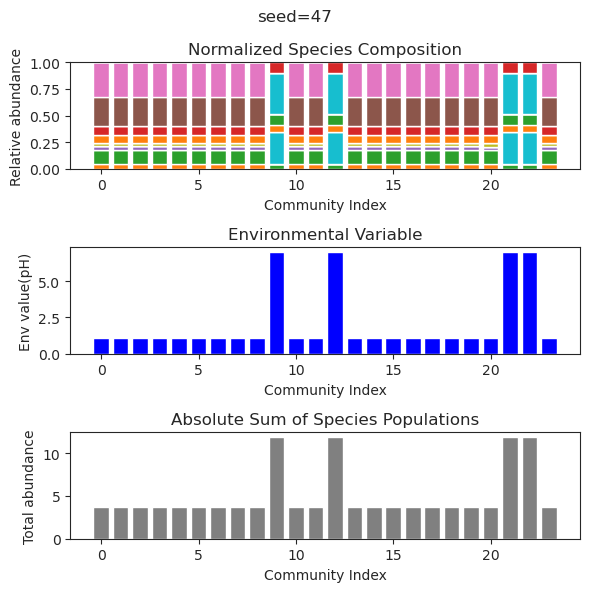

{'species': array([ 2.86420756e+000, -5.06108980e-040,  5.99894022e-048,
        1.50158950e-056,  1.39341804e+000,  2.11550724e-001,
       -4.69016593e-053, -1.64532270e-107, -1.27958026e-095,
        1.74634638e+000, -5.33505114e-098, -1.08051766e-091,
       -7.84959001e-048, -4.57894862e-100, -3.62129298e-102,
        7.30318695e-043, -2.51957618e-103,  2.50619809e+000,
       -1.41009793e-048,  1.98740008e+000,  2.13221673e-110,
       -7.06314297e-016, -3.99675594e-071,  4.38074117e-089]), 'env': array([6.09556877])}
{'species': array([ 2.86420756e+000,  6.42028076e-050, -2.48437210e-057,
        2.20026556e-057,  1.39341804e+000,  2.11550724e-001,
        1.37386807e-067, -9.62465491e-148, -1.53864641e-136,
        1.74634638e+000,  3.88052970e-054,  6.16984107e-130,
        3.09673911e-063,  2.62855697e-143,  9.37303771e-143,
        2.60871786e-107,  9.43451404e-140,  2.50619809e+000,
       -9.68272156e-134,  1.98740008e+000, -7.11165789e-142,
       -1.79651279e-015,  5.514

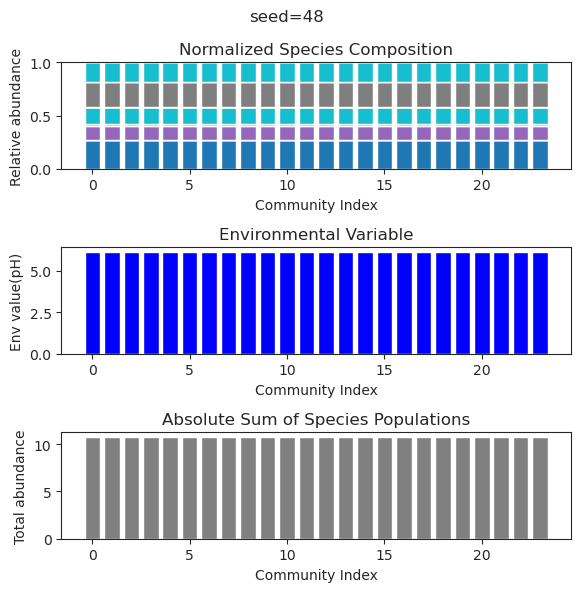

{'species': array([-1.17811378e-094,  6.36901526e-077, -2.81875067e-087,
       -1.09059784e-051,  1.66385856e-103,  1.53534183e-001,
       -5.49772094e-098,  6.32285780e-097,  2.83422400e-032,
        2.36194599e-081, -1.44919839e-070,  2.48661550e+000,
        4.89075667e+000, -1.83338308e-080,  5.75697795e+000,
        2.69290655e+000,  5.95061957e+000,  2.64655499e-080,
        1.70957931e-114, -5.87472502e-091,  2.09259643e-043,
       -1.20685218e-086,  1.93468745e-073,  1.28552825e-030]), 'env': array([10.68148736])}
{'species': array([ 6.50764592e-102, -6.80538427e-078, -8.66947335e-087,
       -1.86944664e-067, -3.69974940e-107,  1.53534183e-001,
        2.44107541e-110, -2.54667829e-103,  4.45516369e-030,
       -8.81922239e-083, -1.15638883e-076,  2.48661550e+000,
        4.89075667e+000,  3.92849098e-088,  5.75697795e+000,
        2.69290655e+000,  5.95061957e+000, -9.20053711e-075,
        3.20297310e-127, -2.06872919e-105, -1.87665856e-046,
        3.89670809e-098,  8.02

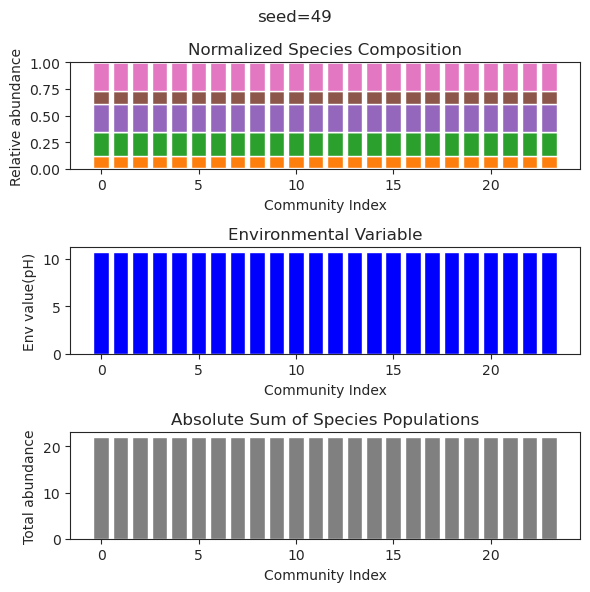

{'species': array([-6.15195934e-58,  9.12802451e-66,  1.73387751e+00,  1.00789252e-89,
       -7.68695274e-30,  8.83881552e-46,  1.91169920e-50,  5.36117298e+00,
       -4.37024626e-92,  6.96373542e-27, -1.34194556e-85,  9.02516275e-01,
        1.46041734e-48, -8.57802666e-71, -1.32568764e-41, -3.27164984e-92,
        1.95980080e-52,  2.85452354e+00, -1.05672293e-43,  5.98818744e-01,
       -8.89807595e-44, -2.01933326e-94,  1.00397869e-48,  2.69927139e+00]), 'env': array([7.69685282])}
{'species': array([ 4.84898723e-065,  4.37919385e-075,  1.73387751e+000,
       -6.22295555e-101, -2.46517658e-037,  4.30781989e-047,
        8.94001816e-060,  5.36117298e+000, -3.14510915e-107,
       -3.06668637e-031, -1.03481455e-087,  9.02516275e-001,
       -1.24557035e-062,  3.89531721e-083, -3.45073458e-049,
       -4.29717023e-108, -2.97526431e-059,  2.85452354e+000,
       -2.77041755e-048,  5.98818744e-001, -4.57435342e-053,
        2.65069695e-108, -1.96733732e-058,  2.69927139e+000]), 'env':

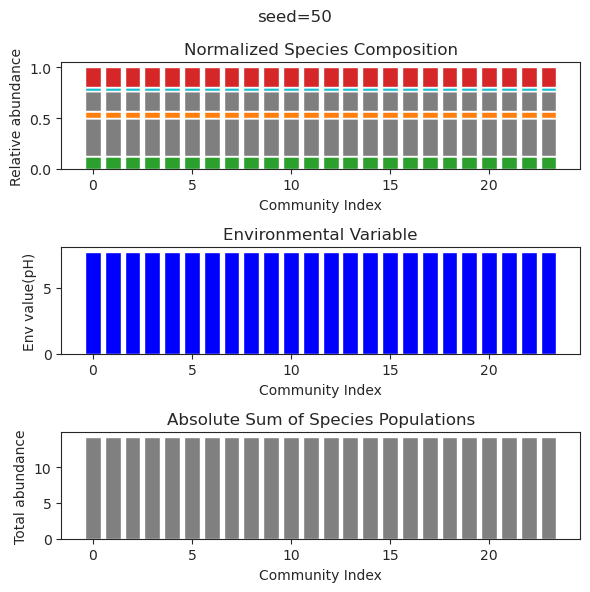

{'species': array([ 1.08400711e-036,  1.90008194e-064,  5.92208942e+000,
        1.09843102e-056, -2.49227367e-040, -1.06830554e-040,
       -1.76399439e-041,  1.40749604e+000, -2.43422300e-041,
        3.74964799e-054, -5.68654041e-041, -9.15268030e-040,
        6.35691290e+000,  6.54934144e-040,  6.63011815e-088,
        1.13833965e-073,  1.11599988e-061, -3.24391361e-101,
       -1.34852090e-057, -3.79456428e-075,  4.53570427e+000,
        7.57751992e-045,  3.17957985e-002,  3.04726114e-052]), 'env': array([11.60318179])}
{'species': array([ 1.33872141e-047, -3.42352033e-058,  5.92208942e+000,
        1.70446765e-038, -2.31166929e-040, -9.46551347e-039,
       -1.00269624e-051,  1.40749604e+000,  5.00222683e-116,
        6.19373800e-054, -2.07656285e-030,  2.61498946e-114,
        6.35691290e+000, -6.10608571e-073, -1.62246885e-102,
       -2.50679544e-082, -5.76330522e-052,  5.41044205e-117,
        7.93028335e-054, -1.84409345e-086,  4.53570427e+000,
        3.48482489e-031,  3.17

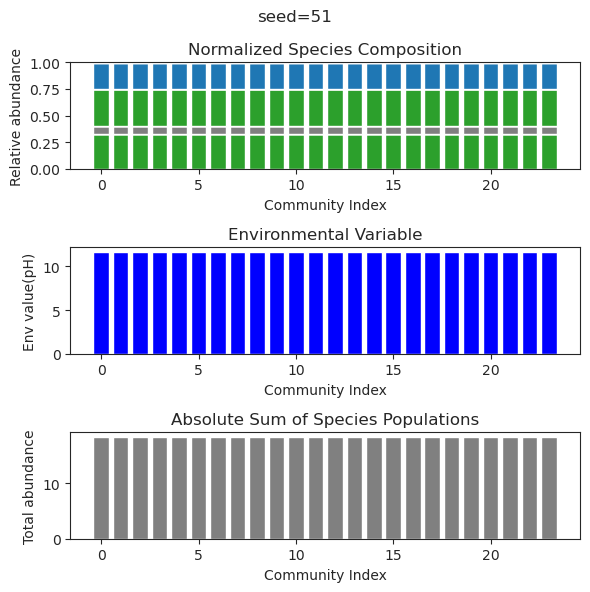

{'species': array([-5.75605465e-036,  1.01170562e-019,  3.87635078e-045,
        3.90799301e-042,  1.63313204e+000,  1.17176828e+000,
        4.77278670e-001, -5.82378293e-088,  4.14219456e-001,
        2.16528254e-157,  1.29209106e-158,  1.02716660e-001,
       -1.20686924e-150,  1.70262302e-158,  2.51834010e-001,
        1.62579424e+000,  6.41929934e-001,  1.04863945e-160,
       -1.38955984e-148, -1.57539772e-151,  8.29591609e-001,
        1.33889832e-082, -2.54795806e-148,  4.78456237e-159]), 'env': array([3.33513956])}
{'species': array([ 2.61268648e-036, -8.29927360e-015,  6.62124673e-126,
       -3.00362474e-053,  1.63313204e+000,  1.17176828e+000,
        4.77278670e-001, -5.41507526e-074,  4.14219456e-001,
        1.60287538e-042, -5.51935960e-139,  1.02716660e-001,
        5.32724257e-128,  2.65382676e-130,  2.51834010e-001,
        1.62579424e+000,  6.41929934e-001, -8.17090141e-136,
       -2.22359326e-120, -1.84242434e-123,  8.29591609e-001,
       -6.05040883e-072,  1.167

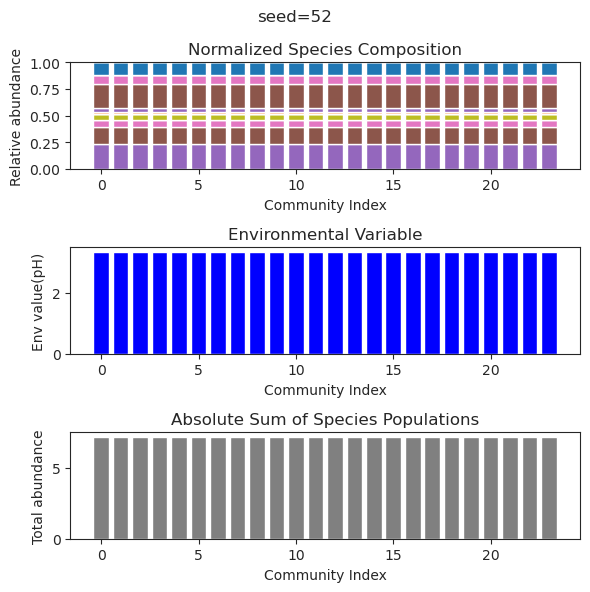

{'species': array([ 3.61542380e+000,  1.86384763e+000,  1.34336279e+000,
        1.60909474e-053,  6.62280085e-098,  8.05799491e-093,
        1.33518635e-111,  7.31293233e-022, -8.46304398e-104,
       -9.54470712e-044, -3.29533053e-064,  3.85968757e+000,
       -4.05509775e-043,  1.63063491e-094,  1.54040953e+000,
       -5.19162899e-068,  5.92121277e-092, -2.18190865e-079,
        1.30798059e-108,  1.61946164e-092, -2.50537527e-040,
        1.34803473e-021, -4.41719836e-028,  1.95156895e+000]), 'env': array([9.0569497])}
{'species': array([ 3.61542380e+000,  1.86384763e+000,  1.34336279e+000,
       -7.82216584e-059, -4.69934399e-109, -2.01034936e-105,
       -4.95457016e-115, -6.74380662e-021,  5.87713898e-111,
        5.71870677e-049,  2.81228134e-076,  3.85968757e+000,
        2.05746330e-049,  1.36355071e-103,  1.54040953e+000,
        6.53609564e-080,  2.82434348e-103,  8.44847274e-091,
       -4.72811303e-118, -2.11238325e-104,  7.53463667e-045,
       -2.62453663e-020, -7.8233

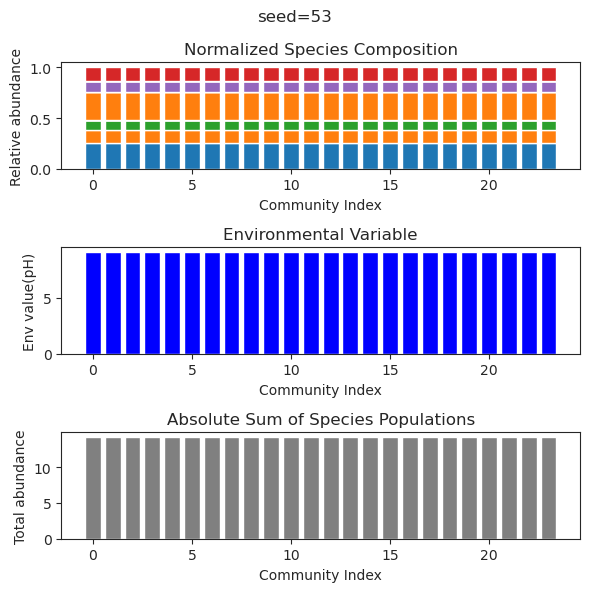

{'species': array([ 9.76422924e-01, -8.57302908e-55, -7.69549125e-60,  2.26153714e-49,
        1.58825316e-46, -3.69977341e-51,  2.22454404e-47, -1.16318051e-43,
       -8.97265992e-52, -5.01458265e-55,  6.90288147e+00,  3.92094115e+00,
       -9.08772954e-56,  6.91872114e-56, -3.37785351e-54,  2.58386282e-61,
       -1.67925496e-55,  5.01541192e-34,  2.65381725e+00,  4.94104540e+00,
        3.45606370e-40,  4.41702519e-44,  2.47170140e-56, -6.67834912e-53]), 'env': array([11.22445519])}
{'species': array([ 9.76422924e-01,  1.66482177e-54,  2.72590807e-61,  1.87887938e-43,
        1.95863486e-46, -8.61153814e-54,  1.16957689e-44, -1.68378673e-41,
       -2.93009019e-53,  3.80683252e-60,  6.90288147e+00,  3.92094115e+00,
       -9.84543929e-59, -5.53133184e-60,  8.80830489e-56,  5.59886427e-63,
       -3.31977760e-55,  1.73932445e-33,  2.65381725e+00,  4.94104540e+00,
        1.17104730e-40,  1.00051077e-42, -6.96455711e-59, -1.79460061e-53]), 'env': array([11.22445519])}
{'species': ar

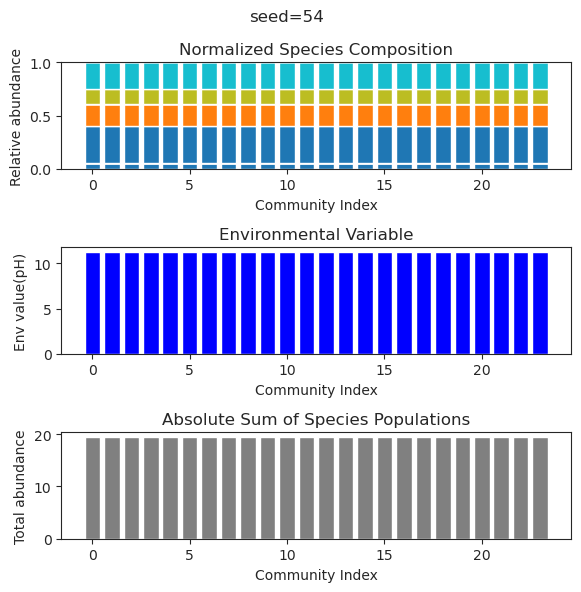

{'species': array([ 1.86308602e-44, -6.46201127e-63, -3.71572589e-56,  2.67386194e-62,
       -1.64935125e-40,  2.80049160e-02,  1.30567626e-38,  7.31635534e+00,
        5.15989446e+00,  4.40621166e+00, -6.95999568e-70,  2.85720913e-69,
        7.02368821e-75,  1.89215187e-81,  5.67354988e-82, -7.26179676e-77,
        2.51996786e-43, -4.50396972e-54, -3.30110404e-29, -9.32938922e-39,
       -5.98151907e-78,  3.63721017e+00,  3.58356291e-71,  1.65546752e+00]), 'env': array([11.20058347])}
{'species': array([ 1.39222618e-173,  1.14249226e-126, -3.27681960e-062,
       -3.25003264e-116, -4.52957723e-048,  2.80049160e-002,
        3.98953567e-046,  7.31635534e+000,  5.15989446e+000,
        4.40621166e+000, -5.52516143e-136, -1.92988102e-090,
        2.35142911e-139, -2.14147840e-170, -5.85012343e-177,
       -6.18393588e-155, -2.36203247e-035, -1.98722947e-070,
       -2.25100992e-032, -2.04713940e-047, -1.45607827e-155,
        3.63721017e+000,  3.56557923e-099,  1.65546752e+000]), 'env'

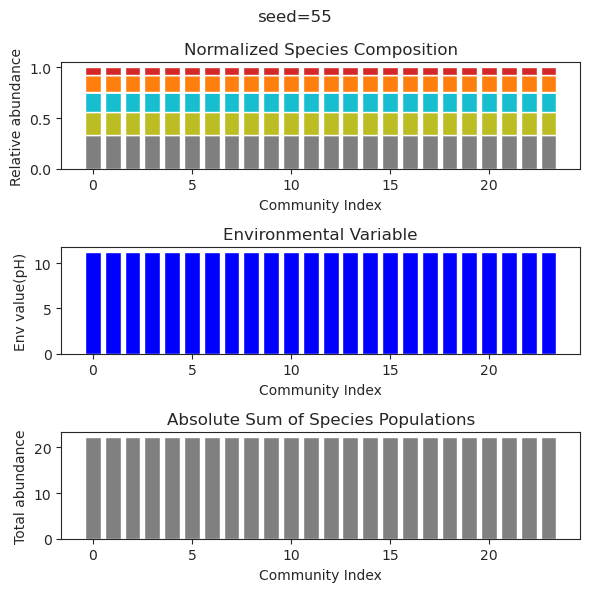

{'species': array([-6.86960089e-44,  9.51863974e-39,  3.22780422e-53,  1.51744973e-28,
        8.47390220e-77,  3.42277405e+00,  5.11317535e-52,  1.97249089e+00,
       -2.44703871e-53,  5.59544687e-01, -5.57174964e-79,  9.08361567e-83,
        4.87609791e-74,  1.18094876e+00, -3.00693317e-55,  3.87620075e+00,
        1.30552525e-60,  2.18300580e+00,  4.94735394e-62, -9.27049889e-79,
        3.31122708e+00,  1.00746184e-73,  6.95457014e-75, -1.12904010e-47]), 'env': array([7.58186261])}
{'species': array([-4.95402529e-48,  1.07794725e-39, -8.16151160e-57,  1.78578920e-28,
        1.57389851e-83,  3.42277405e+00, -7.88468776e-55,  1.97249089e+00,
        1.17920396e-57,  5.59544687e-01,  9.88538064e-84,  1.34698334e-85,
        3.64823755e-80,  1.18094876e+00, -3.91667795e-62,  3.87620075e+00,
       -1.19232924e-69,  2.18300580e+00,  4.09720785e-66, -8.74124531e-85,
        3.31122708e+00,  1.50096071e-81,  1.32033272e-82,  4.57816901e-52]), 'env': array([7.58186261])}
{'species': arra

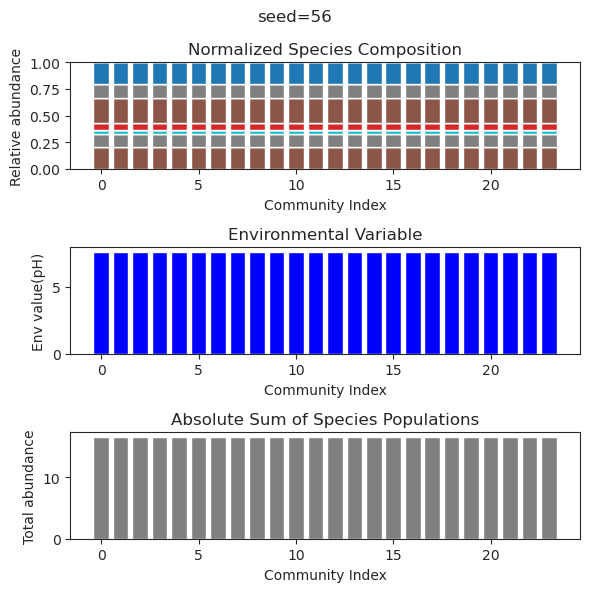

{'species': array([ 1.85895635e+00,  3.45526980e-42,  1.16117328e-54,  4.44159400e-45,
       -5.12844518e-36, -2.86696750e-47,  9.93272990e-01,  7.77449587e-69,
        8.70389924e-49, -8.03497439e-72,  3.00985727e+00,  1.91360023e-67,
       -1.81767119e-40,  8.66523196e-01,  2.38399983e-46,  4.33165155e-44,
        3.13390226e-49,  5.08549249e-65, -1.80897427e-54, -2.98066041e-37,
        8.56915573e-01,  5.48698559e+00, -3.85564549e-65,  6.19598686e-64]), 'env': array([6.41877])}
{'species': array([ 1.85895635e+000,  1.10479660e-091, -7.73142923e-062,
        4.09260139e-056, -3.78733419e-030, -1.38629807e-069,
        9.93272990e-001, -2.83046072e-100, -3.86721979e-062,
        4.13839767e-093,  3.00985727e+000, -2.10230101e-089,
        3.35378508e-045,  8.66523196e-001, -1.40470164e-056,
        3.18663958e-043, -1.22136017e-063, -2.59765339e-098,
        6.88322796e-075, -2.92236513e-039,  8.56915573e-001,
        5.48698559e+000, -1.13538034e-089, -1.03039401e-087]), 'env': ar

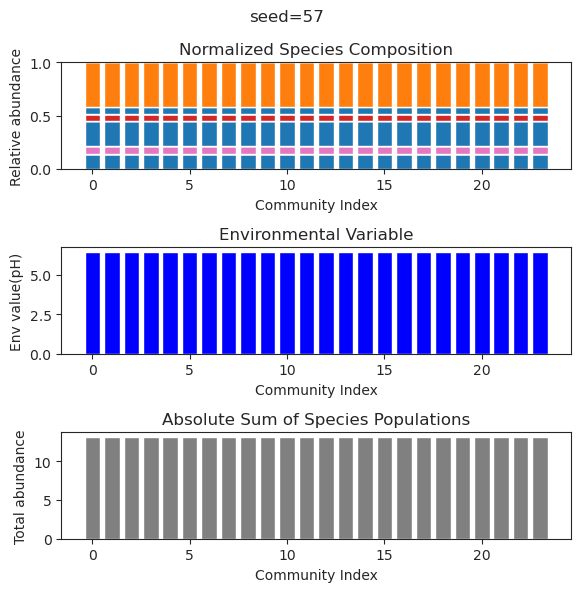

{'species': array([-1.49149805e-092, -1.27994965e-042,  1.72430689e-047,
       -2.33543688e-039,  8.76970086e-054,  3.14012517e-076,
        7.81478873e-067, -7.92214079e-080, -2.39813014e-103,
       -5.76558356e-093,  2.38284732e+000,  2.10256443e-067,
        1.94973834e-001, -7.39232691e-101,  5.25240880e+000,
        6.60296552e+000, -1.15926339e-031,  5.90736182e+000,
        1.10234856e-094, -5.02489893e-086, -3.45801653e-049,
       -1.93163289e-101,  2.99844418e-089, -5.49346107e-050]), 'env': array([10.31862477])}
{'species': array([ 5.59812383e-153,  1.67498716e-057, -5.92303799e-063,
       -2.53942272e-042, -1.20727651e-076, -1.24379800e-112,
        7.60272402e-081,  1.48238632e-122,  5.66316471e-162,
       -3.28511145e-153,  2.38284732e+000, -1.11737621e-102,
        1.94973834e-001, -3.84820029e-151,  5.25240880e+000,
        6.60296552e+000,  3.46776959e-028,  5.90736182e+000,
       -1.91728095e-152,  2.13814350e-131, -1.58431394e-068,
       -1.64460927e-159, -1.32

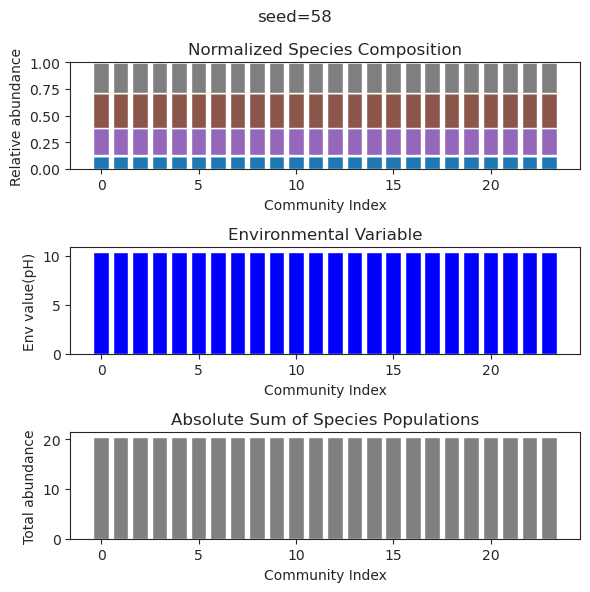

{'species': array([ 2.76894622e-026, -3.80479732e-096, -1.59621479e-084,
       -7.59632102e-075, -1.27904394e-061, -2.30652961e-056,
       -3.08763871e-076, -4.58582672e-038,  1.61571877e-054,
        5.71603933e+000, -2.84335246e-089, -3.55005788e-077,
        1.35777139e+000,  3.63186993e-026, -2.67405261e-024,
        1.76861773e-079, -2.74924060e-080,  6.73933556e-031,
        2.09664754e+000, -1.92923123e-034,  4.75830451e+000,
        1.07413393e-032,  5.06056274e+000, -1.42903446e-102]), 'env': array([10.17647])}
{'species': array([-4.17962787e-27, -7.95318206e-77,  3.40506817e-68,  1.15862592e-62,
        2.24218839e-50,  3.49143799e-46,  1.20679345e-62,  1.35417184e-33,
       -1.58844951e-46,  5.71603933e+00,  7.53173635e-70,  6.51511808e-62,
        1.35777139e+00,  3.89240510e-24,  2.21200932e-22, -1.64693253e-66,
        3.66856209e-69, -5.29603562e-31,  2.09664754e+00, -1.69244876e-32,
        4.75830451e+00,  6.74729216e-29,  5.06056274e+00, -9.49927149e-82]), 'env': a

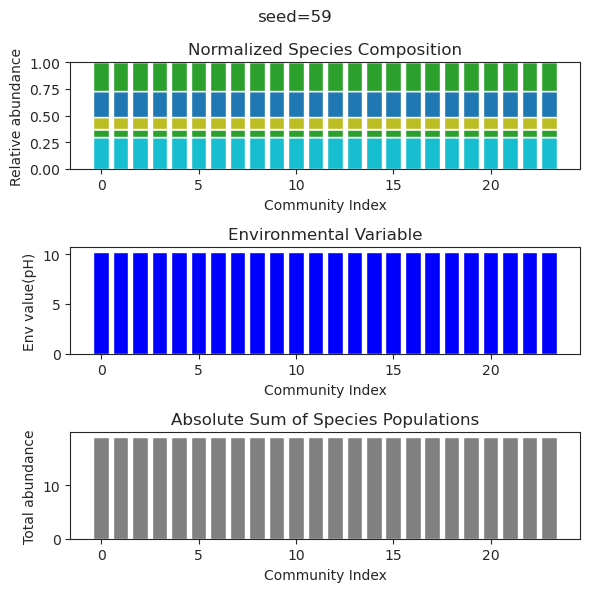

{'species': array([ 1.64684378e+000,  2.84107649e+000,  3.25020078e+000,
       -2.57293682e-130, -3.71407234e-144,  4.75914510e-056,
        6.40854682e-066,  2.02741159e-126,  8.72492586e-002,
        3.17984708e+000, -2.60389303e-117,  6.44608848e-091,
       -4.26995653e-090, -1.64187989e-057,  4.80799128e-130,
       -6.50531674e-015, -2.17542581e-134,  4.43853198e-119,
       -4.66112324e-128,  1.67906146e-046,  7.04161058e-043,
        5.27563020e-042,  1.26572519e+000, -1.50303645e-100]), 'env': array([6.20449977])}
{'species': array([ 1.64684378e+000,  2.84107649e+000,  3.25020078e+000,
       -3.02707298e-124, -8.17790776e-136, -8.37578875e-056,
       -5.43101627e-065,  3.48731525e-115,  8.72492586e-002,
        3.17984708e+000, -2.15399580e-106, -1.01188586e-085,
       -3.15229931e-085,  1.89528300e-060, -3.73530639e-123,
        3.38507204e-018,  2.30577718e-124,  5.08965098e-115,
       -2.60783849e-118, -9.39960777e-046,  4.36308468e-051,
       -2.37758311e-054,  1.265

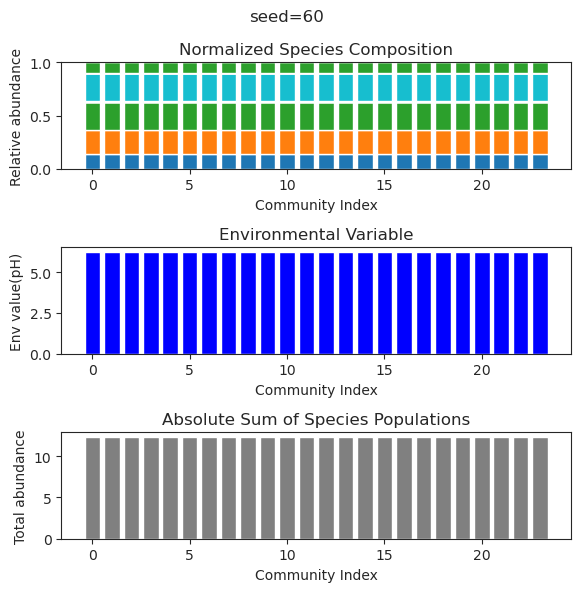

{'species': array([ 2.24853314e-173,  8.30804647e-121,  2.02843572e+000,
       -1.56890511e-138,  3.79842015e-124, -7.51976468e-125,
        2.89080558e+000,  1.53841124e+000,  9.49626859e-181,
        3.42330487e+000, -1.03740850e-131, -5.71435348e-178,
       -3.01872078e-076,  1.79466709e+000,  3.42913713e-170,
       -7.53538176e-101, -2.31610450e-131,  9.90172362e-116,
        1.43493519e+000, -2.69173458e-217, -2.41304878e-142,
       -5.51085111e-047, -6.58405830e-201,  2.88261674e+000]), 'env': array([8.66140613])}
{'species': array([-5.40952519e-226,  5.84646343e-142,  2.02843572e+000,
        1.31583907e-180, -4.09538029e-157,  4.49627655e-143,
        2.89080558e+000,  1.53841124e+000,  1.54133485e-230,
        3.42330487e+000,  1.24503069e-171, -4.55700422e-209,
        1.86632150e-094,  1.79466709e+000,  1.02641572e-199,
       -6.64372709e-124,  1.27473495e-172,  9.20300820e-148,
        1.43493519e+000, -5.16792590e-255,  9.03404058e-186,
       -1.20550375e-056,  2.718

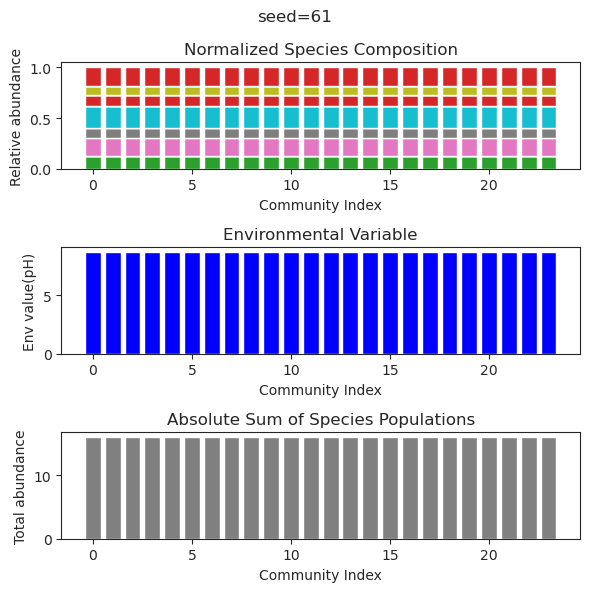

{'species': array([ 3.20910612e+000,  1.65401418e-167, -3.25346076e-027,
        4.05732176e-139,  3.14062696e-148, -2.40422278e-161,
        1.37141607e+000,  1.91084100e+000, -2.71031890e-063,
       -3.74264046e-088,  1.67296657e-001,  1.14664501e+000,
       -4.22849067e-121, -7.20359256e-050,  4.53287208e-150,
       -1.57062549e-048,  3.12152678e+000, -5.63860223e-164,
        2.23572787e+000, -6.99703530e-120, -1.64241549e-149,
        1.63054669e-143,  4.75226949e-121, -2.94253124e-136]), 'env': array([6.61022839])}
{'species': array([ 3.20910612e+00, -5.30785094e-61, -9.68970848e-25, -2.17464359e-36,
        3.99365147e-62, -1.85913326e-60,  1.37141607e+00,  1.91084100e+00,
        1.27813224e-42,  9.85035790e-51,  1.67296657e-01,  1.14664501e+00,
       -2.36230325e-45,  6.82504574e-40,  1.12872166e-55,  8.86296279e-40,
        3.12152678e+00, -6.64373701e-44,  2.23572787e+00,  2.61030797e-57,
        5.89299921e-61,  7.03777083e-60,  1.12818625e-54,  1.12035270e-59]), 'env':

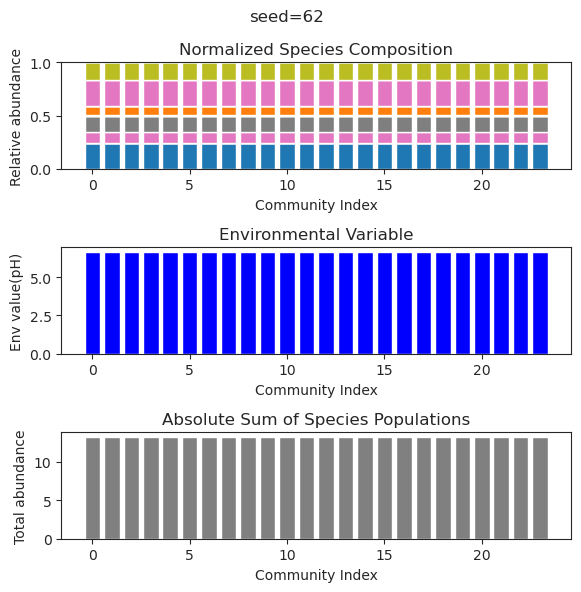

{'species': array([-4.25011649e-061, -5.08364804e-090, -5.92849193e-050,
        3.70202519e+000,  1.74604166e-080,  2.83577890e-001,
        1.41808309e-086,  3.19501337e+000,  2.09578418e-188,
        7.19562115e-087,  4.60993843e-062,  1.67092544e-188,
        2.20563033e-001, -2.33997699e-193,  7.60750755e-020,
       -3.20155348e-055,  4.48374574e-104,  4.06310388e-112,
        7.89298341e-001, -6.06330372e-091,  9.30183051e-035,
       -2.23573364e-056,  9.44532164e+000,  1.18987818e-191]), 'env': array([10.44077127])}
{'species': array([ 5.27414698e-060,  4.55793195e-094, -4.63427976e-048,
        3.70202519e+000, -7.16650938e-105,  2.83577890e-001,
       -5.52892750e-132,  3.19501337e+000,  2.63765891e-181,
        8.83024613e-120, -4.41076654e-097,  2.66352672e-181,
        2.20563033e-001,  1.08714810e-052, -4.08333606e-020,
       -5.34394643e-054,  1.28157418e-185,  1.34155871e-184,
        7.89298341e-001, -8.20248240e-095,  8.19453070e-037,
        3.39421605e-123,  9.44

/state/partition1/llgrid/pkg/anaconda/anaconda3-2023a-pytorch/lib/python3.9/site-packages/scipy/integrate/_odepack_py.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


{'species': array([ 2.70305649e-069, -1.36154905e-100,  2.33418971e-079,
        3.70202519e+000,  6.06973913e-107,  2.83577890e-001,
       -1.04376884e-089,  3.19501337e+000, -4.14575411e-136,
       -8.64167780e-085,  4.10937123e-066, -9.18763037e-138,
        2.20563033e-001,  3.97734133e-054,  3.36196242e-019,
       -4.62181293e-057, -1.02148965e-140,  1.54665929e-137,
        7.89298341e-001,  1.51135333e-078, -1.06760069e-027,
       -8.03422501e-089,  9.44532164e+000, -7.23734046e-138]), 'env': array([10.44077127])}
{'species': array([-1.09556770e-068,  3.87956549e-048,  4.66067063e-044,
        3.70202519e+000, -3.52884121e-066,  2.83577890e-001,
        1.09055880e-064,  3.19501337e+000, -1.68746837e-208,
       -1.68715505e-088, -1.22463302e-062, -2.94018245e-185,
        2.20563033e-001, -1.59262946e-187,  7.67417831e-019,
        1.16115846e-056, -7.81557640e-198,  9.18009796e-067,
        7.89298341e-001, -3.38825985e-055,  2.78907619e-029,
        1.40219782e-107,  9.44

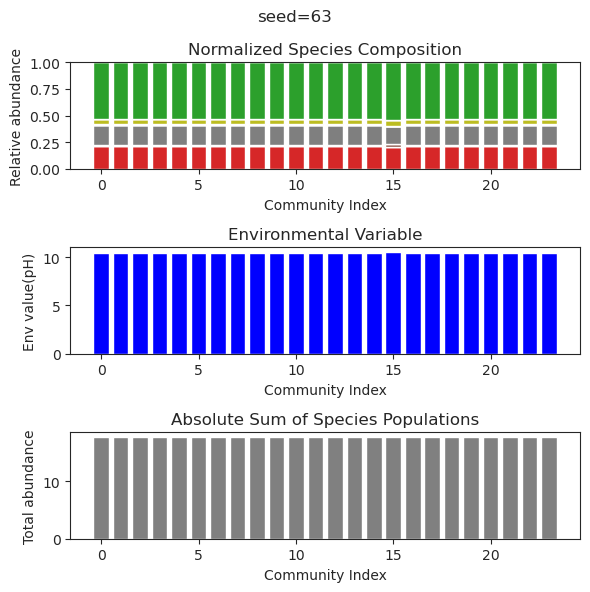

{'species': array([ 3.03364270e+000, -9.41091463e-062, -1.03475767e-020,
        1.95710238e-101,  2.32661712e-089,  1.43835155e+000,
        4.71880486e-088,  7.59360672e-046,  3.62534733e-076,
        8.76452946e-072,  1.14101618e-092, -1.14075707e-088,
        2.66465680e+000,  8.25305006e-034,  6.27268509e-001,
       -3.59147480e-063,  3.63397019e+000,  6.81605575e+000,
        3.69818057e-073,  1.48630086e-048,  2.43202706e+000,
        1.85215735e-076, -2.89713434e-099, -3.03821868e-054]), 'env': array([10.8641404])}
{'species': array([ 3.03364270e+00,  2.47765221e-55,  2.39460188e-20,  9.15625771e-75,
       -5.18980359e-70,  1.43835155e+00, -9.33954768e-69, -1.24461071e-48,
       -2.37965802e-63, -1.31697876e-60, -1.13829297e-70,  7.99033135e-67,
        2.66465680e+00,  1.26457516e-29,  6.27268509e-01,  1.10906435e-56,
        3.63397019e+00,  6.81605575e+00, -1.13284820e-62,  3.41821517e-51,
        2.43202706e+00, -6.45275947e-64, -1.45751063e-75, -1.76930598e-50]), 'env':

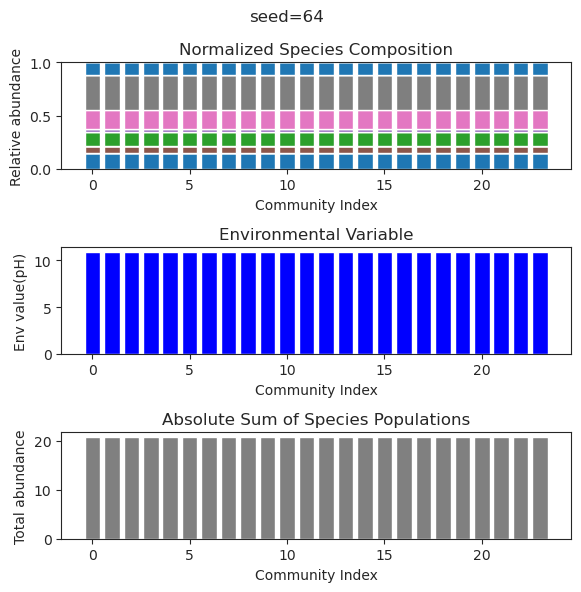

{'species': array([ 2.15242161e-049,  1.18408770e-037,  4.09828671e-043,
        5.78918411e+000,  1.52796564e-040,  2.50507184e-114,
       -4.27506227e-041,  3.67641194e-002,  4.36486590e-056,
        1.52984141e-107,  3.51937247e+000,  2.47670037e-102,
        4.85941387e-001,  8.98744124e-036, -2.43095355e-066,
        2.22545366e-103,  1.78050516e-139, -5.00668165e-135,
        1.27432274e+000, -7.89136551e-125,  6.29916387e+000,
        2.78185777e+000, -2.10763958e-114,  4.80116873e-093]), 'env': array([10.24783865])}
{'species': array([-1.11915806e-044, -1.89970860e-041,  1.06562068e-056,
        5.78918411e+000, -1.56325703e-224, -1.09421724e-085,
       -3.89448716e-206,  3.67641194e-002, -4.68465765e-051,
        4.85678088e-046,  3.51937247e+000, -6.87833692e-062,
        4.85941387e-001,  2.68719684e-214,  6.51507423e-048,
        4.58450147e-051,  3.51765238e-232, -1.73096036e-174,
        1.27432274e+000, -4.32389630e-212,  6.29916387e+000,
        2.78185777e+000, -7.68

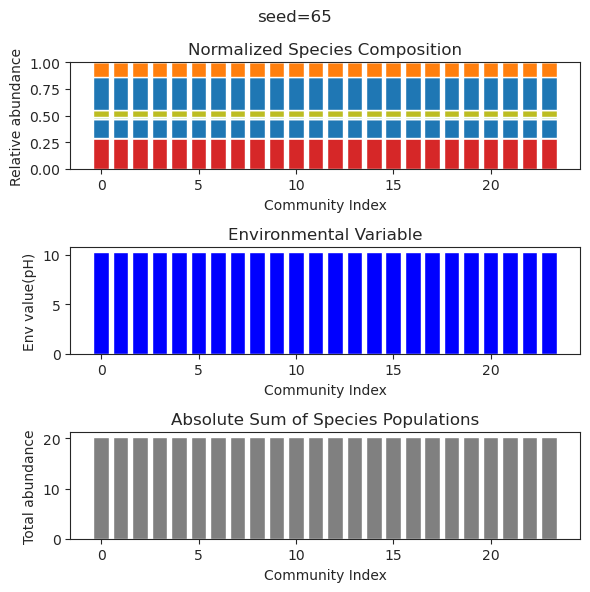

{'species': array([ 5.08235634e-28,  1.95107231e+00,  7.20166762e-28,  4.43073624e-27,
        1.49839195e-34,  2.84297195e+00,  6.63583138e-52,  2.18104157e-02,
        2.44306018e-30,  1.02706001e+00, -2.10913049e-57,  5.80995810e-41,
       -9.18290873e-38, -2.90491028e-32, -4.51777148e-38,  7.79351349e-01,
       -5.41001307e-74, -1.42816843e-70,  2.09962010e-71,  2.37026808e+00,
       -1.42535430e-56, -1.10551531e-75, -5.27937763e-63,  3.56173429e-67]), 'env': array([3.56429958])}
{'species': array([-1.77244575e-28,  1.95857287e+00, -4.11536457e-55,  7.04011939e-30,
       -4.54430668e-27,  2.84166034e+00, -9.01681430e-49,  6.06440993e-03,
       -2.37483592e-37,  1.03737498e+00,  1.09526880e-36,  4.54820842e-66,
        4.96131748e-33,  1.07667662e-34, -1.67657061e-29,  7.84665320e-01,
       -1.11661621e-36,  1.71062570e-36, -2.38429204e-59,  2.36757425e+00,
       -1.01781958e-64,  5.18548088e-60, -7.25809099e-52, -1.58617262e-43]), 'env': array([3.56602069])}
{'species': arra

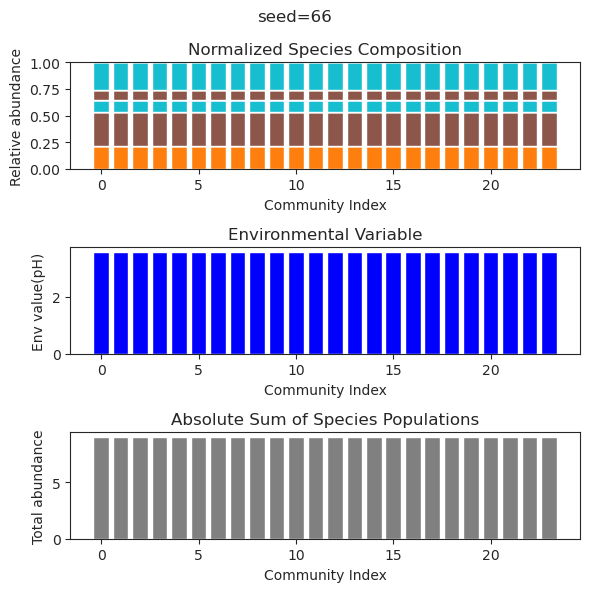

{'species': array([ 6.63630236e-01, -4.93983416e-36,  8.21856005e-42,  2.30365298e-01,
        4.11449570e-01,  2.05765829e-01, -4.20655044e-35,  4.40503101e-03,
        4.37025334e-01, -1.68780978e-40,  7.46406202e-44,  2.29599533e-44,
        7.39650067e-35,  2.56611410e-99,  1.38870659e-01,  1.16606772e-01,
       -3.01370158e-88, -9.50457882e-95,  1.23545001e+00,  5.27375262e-61,
        7.94796855e-02, -1.08213552e-28,  6.77142669e-47,  1.72399547e-82]), 'env': array([1.0409865])}
{'species': array([ 6.63569981e-001,  1.78007874e-030,  1.40007641e-026,
        2.30740376e-001,  4.10966665e-001,  2.05718875e-001,
        1.72525557e-028,  3.79213759e-003,  4.37360521e-001,
        2.39806787e-032,  9.72105767e-027,  2.05350965e-037,
       -2.03160667e-042,  2.23372529e-034,  1.38624345e-001,
        1.16127560e-001,  1.96438033e-031, -4.72262042e-124,
        1.23483665e+000, -1.32352378e-066,  7.97615582e-002,
        2.62189046e-134,  9.38671394e-045, -6.67146417e-103]), 'env': 

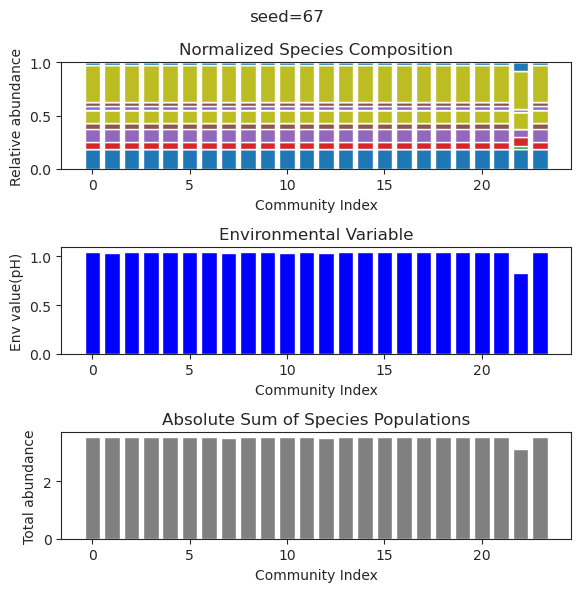

{'species': array([-2.20634646e-59, -3.77059311e-59,  8.79237685e-62,  7.05992337e-47,
        2.77409027e+00,  1.30500284e-82, -7.14237248e-79, -2.99232736e-43,
        3.66998763e-68, -1.36189362e-78,  6.81801912e-89,  2.34565933e-60,
        8.78115635e+00,  2.95185739e-60,  2.55219363e-02,  1.60402706e+00,
        4.81562209e-77,  2.71524032e-67,  4.48713731e-33,  8.67934086e+00,
        9.59850506e-78,  5.29097703e-53,  4.98834642e-74, -4.28302791e-29]), 'env': array([12.42531909])}
{'species': array([-5.02198307e-059,  1.14957695e-080,  2.22798323e-062,
       -1.31609860e-047,  2.77409027e+000, -3.57566943e-042,
        1.16252695e-085, -8.35950881e-092, -4.26409286e-074,
       -5.72218921e-084,  6.56513889e-101, -1.59359186e-058,
        8.78115635e+000, -8.36425771e-060,  2.55219363e-002,
        1.60402706e+000, -1.87847720e-090,  1.01427619e-075,
       -1.81733088e-034,  8.67934086e+000,  1.68609767e-080,
       -1.51954709e-057, -1.46913496e-078, -5.13074947e-027]), 'env'

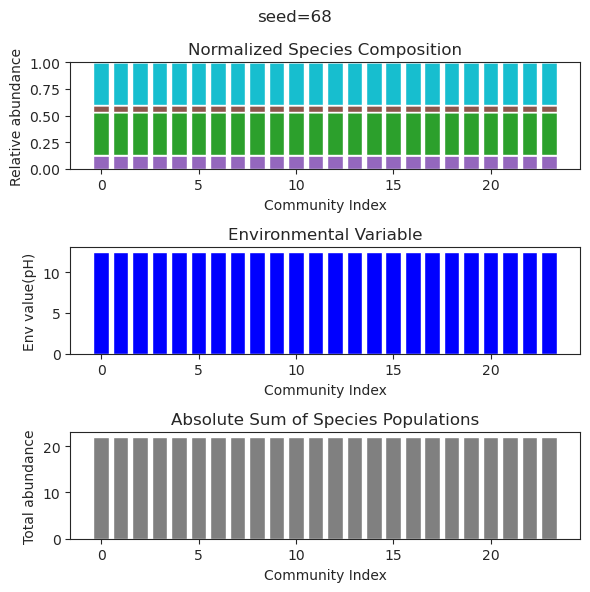

{'species': array([-1.14912062e-064, -2.37660567e-116, -2.22504144e-132,
        3.52178901e+000, -9.07722076e-125,  2.75074515e-131,
        2.50245014e-001,  1.70331189e-098,  4.84660262e+000,
       -3.21639879e-120,  4.11262663e+000, -4.56544131e-072,
       -1.45795850e-074, -4.33471470e-133,  4.61574845e-001,
        8.79660446e-055,  2.23553048e-053,  1.80967242e-029,
        2.98001172e+000, -2.36088684e-112,  1.64268616e-086,
        9.26120991e-103, -2.96807460e-123, -4.25235486e-027]), 'env': array([8.00694812])}
{'species': array([ 9.91042244e-52,  1.48599325e-73,  6.09872291e-83,  3.52178901e+00,
        1.00404160e-87, -2.23094223e-87,  2.50245014e-01,  2.57444941e-64,
        4.84660262e+00,  4.98668422e-82,  4.11262663e+00,  1.65985978e-59,
       -1.59291570e-56,  7.20494614e-89,  4.61574845e-01,  7.74303011e-49,
        5.68693522e-48, -1.17738463e-31,  2.98001172e+00, -2.11318898e-79,
       -7.98833005e-58, -3.73461803e-71,  1.94902683e-75,  1.06500861e-33]), 'env':

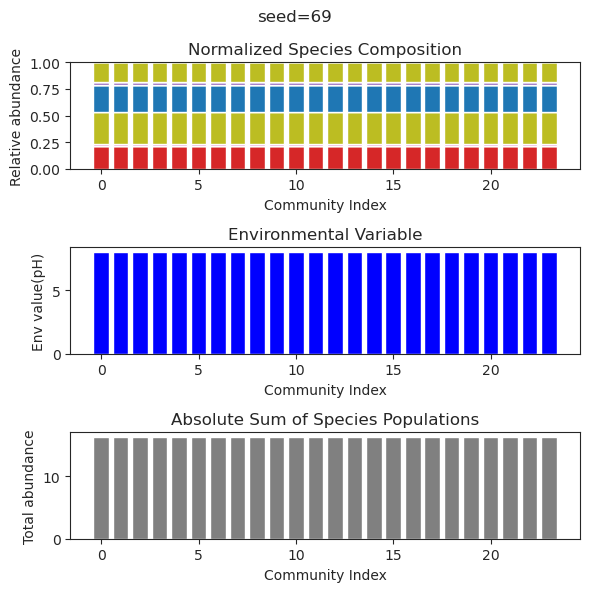

{'species': array([ 1.92583641e-90, -1.05499185e-93, -3.21219125e-89,  1.06300548e+00,
        2.15999980e-59, -2.44579060e-83, -8.69825586e-82,  4.41234628e-36,
       -2.06733535e-48,  6.08175111e-01,  2.53676883e-18,  1.52315666e-54,
       -1.05561278e-65, -4.39760376e-70,  4.39900326e+00, -9.11757558e-74,
        7.82233690e+00,  4.89439133e+00, -1.56728611e-86, -3.67722005e-46,
        2.53990717e-96,  5.39394551e-93,  3.23759105e-50,  5.65787418e+00]), 'env': array([11.7363158])}
{'species': array([-6.92895835e-050, -9.86271862e-050,  7.48113680e-060,
        1.06300548e+000,  8.06419394e-059, -3.95089771e-106,
       -2.55571140e-066, -1.45167753e-081,  7.66805416e-053,
        6.08175111e-001,  1.93204090e-019, -1.04722546e-085,
        4.54113172e-089,  1.11703806e-104,  4.39900326e+000,
       -6.39620804e-106,  7.82233690e+000,  4.89439133e+000,
       -7.02144433e-105,  1.55419922e-073,  5.61326529e-112,
       -3.23458562e-112, -2.05712403e-101,  5.65787418e+000]), 'env':

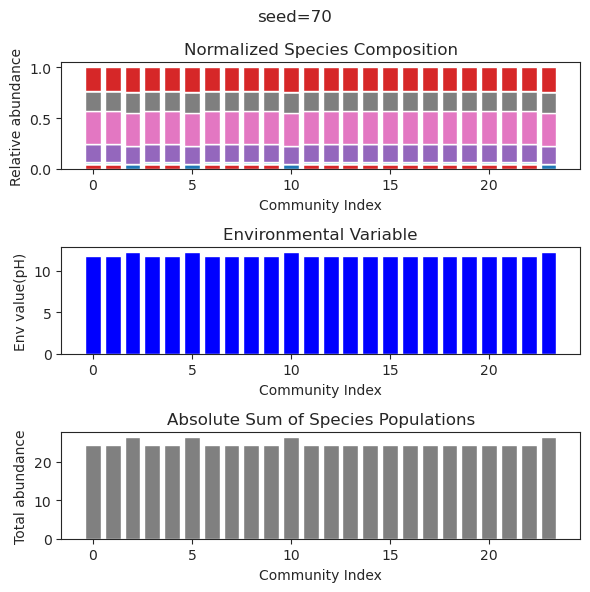

{'species': array([ 1.96412378e-61,  3.78493383e+00,  2.14053119e+00, -1.49304248e-69,
       -6.82971908e-48,  3.83219396e-58,  1.18935112e+00,  5.60918436e-45,
        4.90257300e+00, -6.09228864e-43, -2.14903783e-40,  2.35991025e-47,
        2.49404607e+00,  8.84545359e-49, -8.23386953e-46,  1.55502231e-57,
       -3.21666243e-47, -1.31813143e-38,  9.35126416e-01, -7.38608816e-67,
        8.29562649e-39,  4.22067628e-57,  6.33413141e-56,  2.31322741e-46]), 'env': array([8.85130074])}
{'species': array([-2.26284975e-82,  3.78493383e+00,  2.14053119e+00, -4.90560770e-79,
       -3.56789422e-62,  7.73795073e-78,  1.18935112e+00,  2.69113312e-52,
        4.90257300e+00, -6.13640694e-41,  4.55380090e-49,  9.27051826e-52,
        2.49404607e+00,  1.76684618e-52,  3.81532385e-44,  1.87352023e-83,
       -2.22586842e-56, -8.03628382e-47,  9.35126416e-01, -5.37221815e-82,
       -1.08511665e-34, -7.61640585e-70, -1.05431304e-66,  1.08661893e-54]), 'env': array([8.85130074])}
{'species': arra

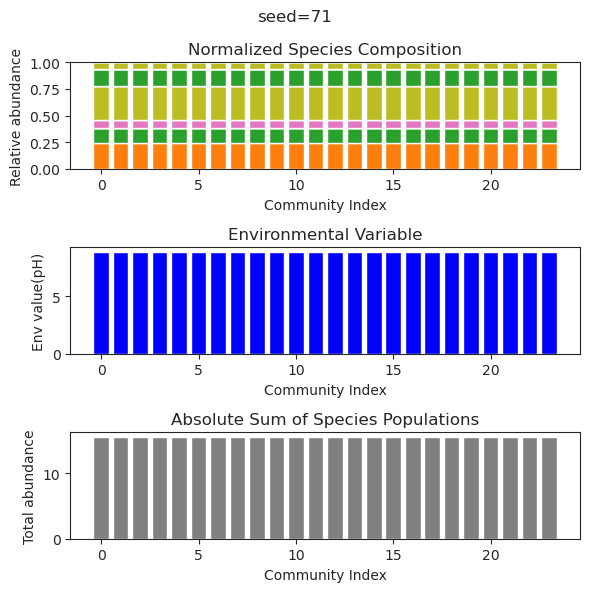

{'species': array([ 1.11177374e-155,  3.87167246e-001,  3.14648407e-121,
       -4.04572402e-042, -1.87647143e-095,  6.97248855e-001,
        3.14923660e+000,  1.83590194e-080,  4.67898169e-164,
        1.26226998e-041, -5.35739614e-112,  2.87400236e-028,
        2.73374319e-047,  2.86513823e-001,  1.78927207e-152,
        1.86629924e+000,  2.73386588e-148,  1.26784643e-001,
        2.77493413e+000, -1.57120395e-108,  1.92057405e+000,
        1.69349303e-157,  4.42279528e-001, -2.09711161e-136]), 'env': array([5.83328836])}
{'species': array([ 1.43187430e-117,  3.87167246e-001,  8.05954263e-048,
        1.52728601e-052, -4.06963551e-072,  6.97248855e-001,
        3.14923660e+000,  7.26212558e-071,  6.23226935e-122,
       -3.09729358e-045, -6.91417186e-049, -2.44919968e-034,
       -1.27476699e-052,  2.86513823e-001, -3.94327094e-116,
        1.86629924e+000, -4.23162910e-115,  1.26784643e-001,
        2.77493413e+000,  8.13634258e-093,  1.92057405e+000,
        8.61822838e-118,  4.422

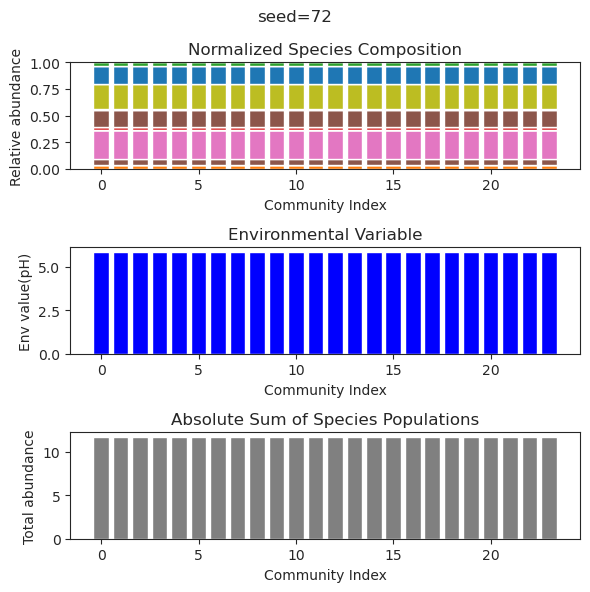

{'species': array([ 4.40471017e+000, -1.38483448e-087, -9.33199579e-108,
       -2.17958428e-094,  1.09291595e-109,  3.40175568e+000,
        2.99924051e-103,  5.28691521e+000, -3.26868013e-105,
       -1.18645555e-088, -7.24247740e-087, -2.58582818e-084,
       -1.70953825e-087,  5.90260957e-078,  2.96940387e-075,
        2.28779945e-001,  6.46157587e-104,  3.74186260e-073,
       -1.45397629e-094,  6.41776057e+000, -2.46048889e-063,
        1.75414069e-075, -3.73106080e-064,  4.07885284e-001]), 'env': array([10.57784214])}
{'species': array([ 4.40471017e+000,  3.05262087e-064,  4.18198933e-139,
       -5.01403950e-134, -7.46295011e-065,  3.40175568e+000,
       -1.65518003e-067,  5.28691521e+000, -5.69641015e-134,
        3.89767690e-127, -2.40373028e-130, -1.13412350e-074,
       -5.06656607e-125, -7.78097662e-117, -1.01969024e-076,
        2.28779945e-001, -7.06351174e-048,  3.86736881e-053,
        3.79546717e-137,  6.41776057e+000,  1.53566903e-107,
       -1.32989281e-102,  5.76

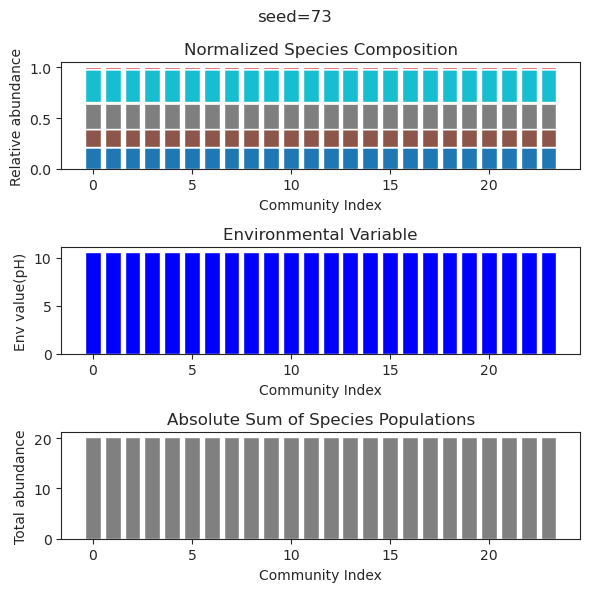

{'species': array([-2.16086363e-173,  2.86007874e+000,  1.48124635e+000,
        2.57148226e-161,  3.90274661e+000,  3.17310710e+000,
       -1.88191703e-192, -7.68411631e-111, -2.13135189e-044,
        3.91149657e-091,  9.72303859e-001,  4.54650199e-001,
        1.09327254e-184,  8.75403667e-189,  2.79972506e-184,
        1.89089401e+000,  1.00539898e-001,  2.46890549e-001,
        9.33677446e-002,  1.84541223e-171,  2.99980283e-179,
       -2.77798623e-194,  5.73106559e-191,  1.28575841e-114]), 'env': array([8.47223161])}
{'species': array([-3.24024325e-146,  2.86007874e+000,  1.48124635e+000,
       -8.07226972e-133,  3.90274661e+000,  3.17310710e+000,
       -1.81935407e-150, -1.29382814e-089, -2.06896395e-045,
       -8.13532678e-080,  9.72303859e-001,  4.54650199e-001,
       -8.26357105e-153, -2.79256009e-151, -1.79647735e-151,
        1.89089401e+000,  1.00539898e-001,  2.46890549e-001,
        9.33677446e-002, -7.54130054e-145,  3.94519121e-137,
       -2.88977481e-150, -1.363

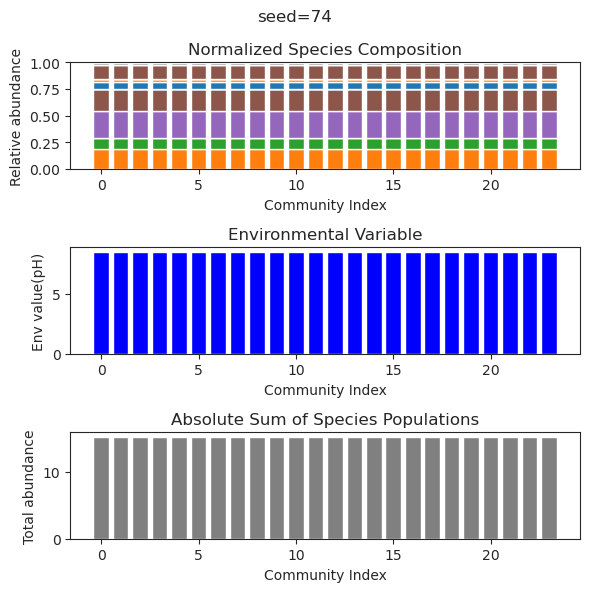

{'species': array([ 9.33120673e-002,  3.52517650e-026,  4.80671997e-001,
        2.41898372e+000, -2.60362621e-027,  1.73255857e+000,
        1.76836589e+000, -3.20566141e-125, -2.10933060e-100,
        3.65562227e-140,  1.28419501e-043, -1.40252225e-139,
       -9.81319188e-033,  9.85645551e-017,  2.31517027e-029,
        1.43310468e+000, -1.15851532e-139,  3.08544426e-034,
        1.24299038e-101,  1.58759487e-003,  3.29733131e-126,
       -1.35358174e-146, -1.06995089e-097,  5.11415748e-131]), 'env': array([3.7096989])}
{'species': array([ 9.33376312e-002, -2.41547550e-026,  4.80723586e-001,
        2.41918613e+000,  2.39441378e-027,  1.73269580e+000,
        1.76850331e+000, -9.31039106e-119,  9.45845543e-082,
       -3.70083381e-137,  9.07429797e-108, -1.34606912e-136,
       -2.08629274e-027,  6.65697159e-019,  8.99253824e-133,
        1.43316376e+000, -8.74163683e-136, -4.81567523e-037,
        2.59954271e-102,  1.37857225e-003,  5.82429689e-101,
       -1.55521602e-138,  6.3940

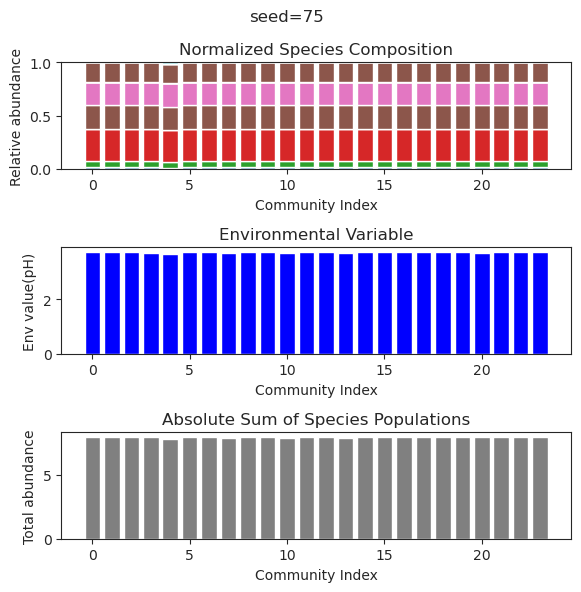

{'species': array([-2.06953663e-81,  1.19979821e-90,  6.72362223e-55,  1.80000418e-86,
        5.10823909e-01,  1.80025617e-44, -9.33783234e-68, -3.54508648e-77,
       -8.98497670e-39, -6.55576613e-51,  1.27990857e-66,  1.57635584e+00,
        3.98898325e+00,  5.91921118e-93,  8.33475619e-64, -2.94549714e-85,
       -1.79033656e-76,  3.16198041e-20, -2.19557731e-68,  6.41933419e-66,
        5.32050657e+00,  6.81828011e+00,  2.57264431e-79, -7.72873974e-78]), 'env': array([10.01720943])}
{'species': array([-6.62009478e-50,  4.43506980e-52, -3.88376923e-54, -1.25410290e-92,
        5.10823909e-01, -1.72421458e-41,  4.76665190e-63, -9.91067279e-77,
       -1.24053864e-34, -7.99265481e-49,  1.24178474e-61,  1.57635584e+00,
        3.98898325e+00, -1.86693354e-96,  2.76688495e-61,  1.09590928e-86,
       -3.12394815e-78,  2.51454132e-17,  4.22785722e-67,  6.13474973e-63,
        5.32050657e+00,  6.81828011e+00, -2.18640484e-80, -5.09368845e-80]), 'env': array([10.01720943])}
{'species': ar

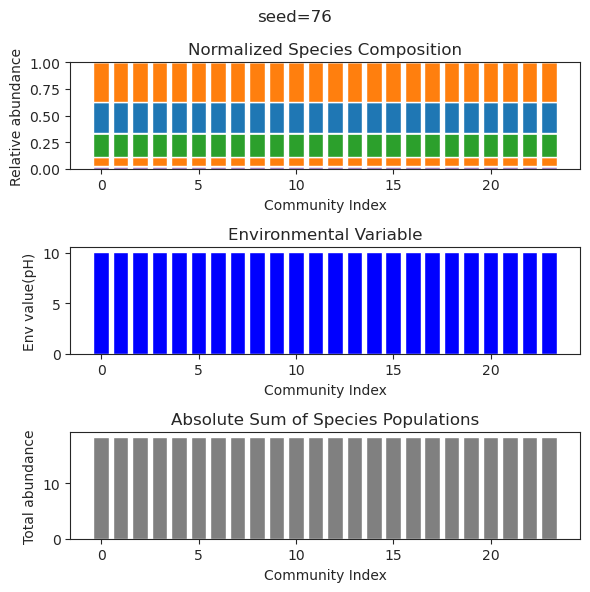

{'species': array([ 7.79581432e-46,  2.31412162e-67,  2.08434389e+00,  8.74694098e-01,
        1.02522792e+00,  1.30143001e-69,  5.16088855e-02, -2.45329752e-48,
       -8.54423941e-61, -1.67343768e-53, -1.43125288e-70, -3.08422966e-49,
        9.01187180e-65,  2.51189205e-01,  9.16398342e-37,  3.42576963e+00,
       -3.18817450e-66, -1.84839778e-55, -1.50317608e-65,  1.06866921e-72,
        1.40975039e-48,  1.99820416e+00, -1.62729900e-74, -4.89002791e-76]), 'env': array([5.49323666])}
{'species': array([ 5.87817152e-105,  4.09693596e-127,  2.08434389e+000,
        8.74694098e-001,  1.02522792e+000,  6.84632859e-136,
        5.16088855e-002, -1.10134563e-075,  2.88336371e-106,
       -1.60683535e-084,  9.34630381e-135,  2.27282336e-075,
        2.56065283e-111,  2.51189205e-001, -1.42748415e-135,
        3.42576963e+000,  9.40700737e-114,  2.12809430e-103,
       -4.45310208e-122, -3.21688213e-137, -1.28846732e-062,
        1.99820416e+000, -1.57104283e-140, -5.88505111e-134]), 'env':

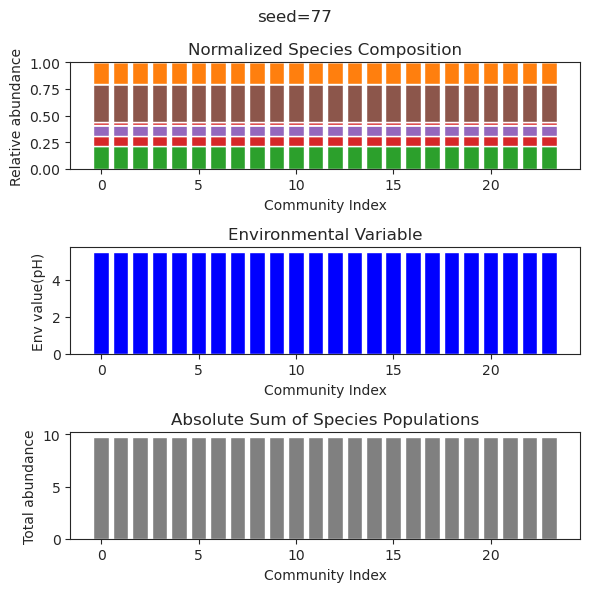

{'species': array([ 2.93841663e-080,  2.38989227e+000, -1.00751901e-106,
        4.61092992e+000,  3.59551485e-086,  5.60466903e+000,
        4.14473773e-098, -3.19705904e-094,  7.61037103e-067,
       -3.08171040e-085,  6.80111086e-057,  4.07883377e-082,
        3.97572313e+000,  2.51490985e-102,  2.19344542e-001,
       -2.80895217e-100, -1.44295418e-066, -2.10051678e-084,
       -1.83493322e-095, -2.43994287e-108, -7.59138024e-108,
       -2.22716387e-096,  3.86647490e+000,  1.34486155e-029]), 'env': array([11.24839551])}
{'species': array([-3.92249537e-116,  2.38989227e+000, -9.90611038e-143,
        4.61092992e+000,  8.54465379e-119,  5.60466903e+000,
       -1.87552601e-139, -1.55886512e-133, -7.00303920e-075,
       -3.33792615e-142,  3.12154064e-084,  2.16395802e-097,
        3.97572313e+000, -9.73380269e-127,  2.19344542e-001,
        1.37929140e-138,  9.45466753e-095, -8.25241917e-117,
        6.55439932e-132, -5.92455670e-136, -1.79533628e-153,
       -9.01629881e-141,  3.86

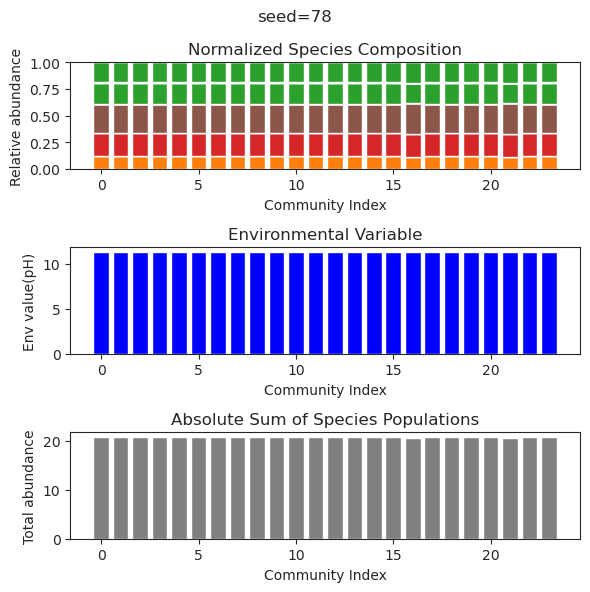

{'species': array([ 3.53971923e+000, -2.73667346e-125,  6.30513332e-109,
        2.07521131e-055, -2.98551433e-118, -9.47388024e-101,
        4.75263095e-087,  1.29522297e-081,  3.98792503e-048,
        2.79115518e+000,  3.53005622e-121,  7.19659107e-087,
        8.18310701e-046,  8.46378900e-001,  2.85108004e-061,
        1.24646859e-028,  2.13880315e+000,  2.32751120e-108,
        1.65011063e-129,  3.53826741e+000, -3.88818407e-125,
        1.39625064e-093,  2.41202287e+000, -1.78968836e-036]), 'env': array([6.77475754])}
{'species': array([ 3.53971923e+00, -1.49937673e-51,  5.64813036e-83,  1.42335390e-46,
        1.39018148e-74, -7.66027843e-72, -7.58438478e-70, -2.31053871e-54,
        3.62362453e-46,  2.79115518e+00, -1.71523200e-84, -7.98295045e-52,
        3.87936767e-44,  8.46378900e-01,  9.96777786e-51,  4.77824377e-30,
        2.13880315e+00,  1.15055182e-75,  1.91009081e-79,  3.53826741e+00,
       -1.92125315e-82,  5.16338240e-65,  2.41202287e+00, -1.72607504e-41]), 'env':

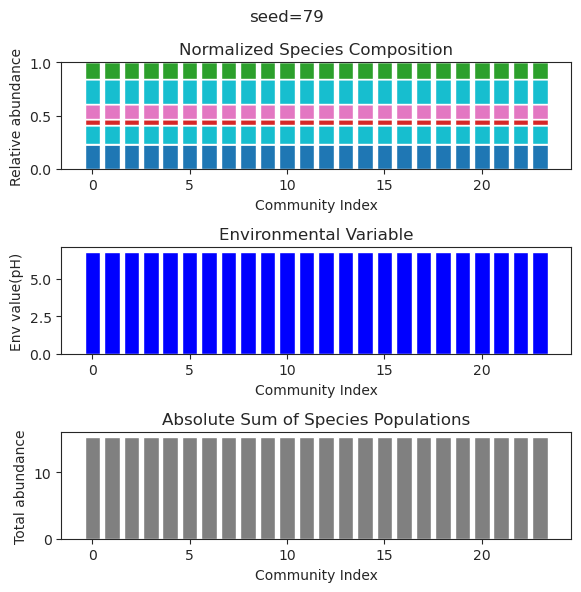

{'species': array([ 9.07186284e-001,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  8.22325006e-001,  2.00792979e-151,
        5.58669690e-113,  1.48396561e+000,  0.00000000e+000,
        2.47118105e-001, -1.01894255e-186, -6.51123302e-284,
        0.00000000e+000,  6.32195984e-246,  3.58719269e-001,
        6.03580247e-218,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  3.89358312e-001,  1.62761708e-001,
        1.90981459e-102,  0.00000000e+000, -2.13165566e-248]), 'env': array([1.96026775])}
{'species': array([ 9.07186284e-001,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  8.22325006e-001, -6.17431514e-137,
        5.52761403e-105,  1.48396561e+000,  1.78021734e-319,
        2.47118105e-001,  4.04628017e-175, -7.17307783e-268,
        0.00000000e+000, -1.91657347e-233,  3.58719270e-001,
        7.09704691e-203,  0.00000000e+000,  0.00000000e+000,
        0.00000000e+000,  3.89358312e-001,  1.62761708e-001,
       -1.11329983e-098, -4.940

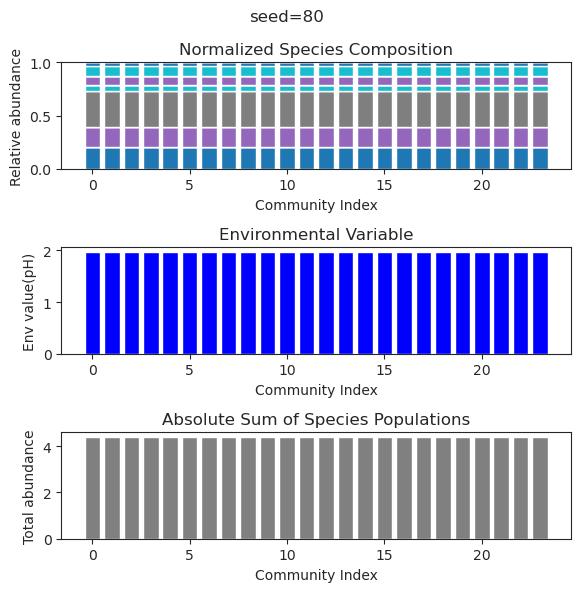

{'species': array([ 7.90485935e-001,  1.12153414e+000, -1.52672384e-073,
       -1.02902481e-117,  3.19346480e-105,  1.86466999e+000,
       -2.64318913e-106, -1.33897218e-081, -9.78397742e-121,
       -2.66743505e-102,  2.34051370e+000,  3.44406159e-124,
        1.12719328e-123,  4.72468034e+000,  1.70429860e-114,
        3.13223239e-049, -7.39879274e-034,  2.20920103e-086,
       -2.35253514e-082,  9.58650251e-102,  2.14280678e-114,
        5.19368103e+000,  6.90149141e-110, -6.57178655e-091]), 'env': array([8.04897656])}
{'species': array([ 7.90485935e-01,  1.12153414e+00, -6.91245258e-53,  2.02191751e-83,
       -2.52209911e-75,  1.86466999e+00,  1.34463784e-71, -1.22130673e-58,
       -2.41724877e-85,  8.36014642e-68,  2.34051370e+00, -1.78652313e-83,
       -2.68822066e-85,  4.72468034e+00,  9.44604940e-83,  2.75092262e-36,
        3.39911078e-27,  4.91336581e-60, -7.78993029e-58,  5.58431010e-70,
        4.07516105e-81,  5.19368103e+00,  3.93940553e-79, -3.52519805e-64]), 'env':

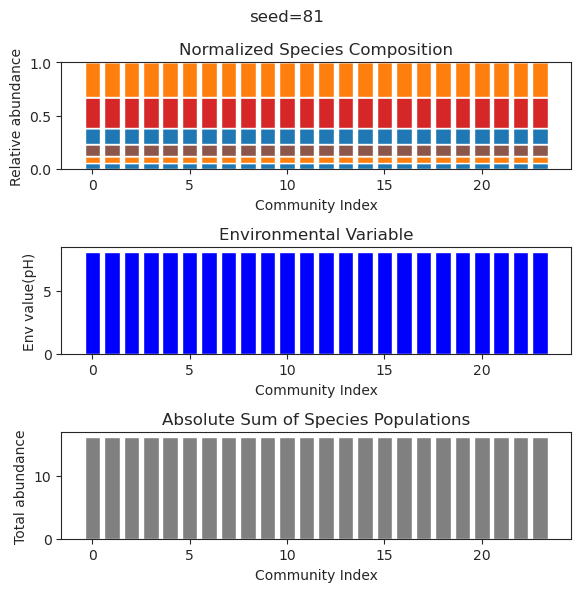

{'species': array([-2.38397640e-053,  7.46194001e-093,  6.13200185e-068,
       -2.66308937e-038,  1.36686514e-127,  4.31067304e-103,
        8.91416384e-102, -1.33003784e-028,  2.46670871e-118,
        9.60719937e-077,  2.72663608e-022, -2.49600430e-118,
       -2.10591054e-096,  1.10990009e-116,  5.06062395e+000,
        5.79679713e-109,  4.83471282e+000, -1.65807513e-047,
       -5.92867478e-028,  2.57140869e-106,  5.03682432e+000,
       -6.47467684e-047,  3.72458982e-082,  3.68906658e+000]), 'env': array([8.76046324])}
{'species': array([ 5.91156110e-046, -1.54963991e-077, -9.89603148e-056,
        7.64119381e-041, -1.13124912e-101,  1.06395986e-091,
        1.82358705e-081,  1.54385335e-025, -1.17812007e-096,
        1.40652422e-065, -9.70515332e-019, -7.75867277e-104,
       -2.32201102e-088, -4.41833427e-094,  5.06062395e+000,
       -2.05977769e-097,  4.83471282e+000,  1.96265830e-042,
       -9.73533136e-031, -1.91271426e-096,  5.03682432e+000,
        7.41137365e-041,  4.904

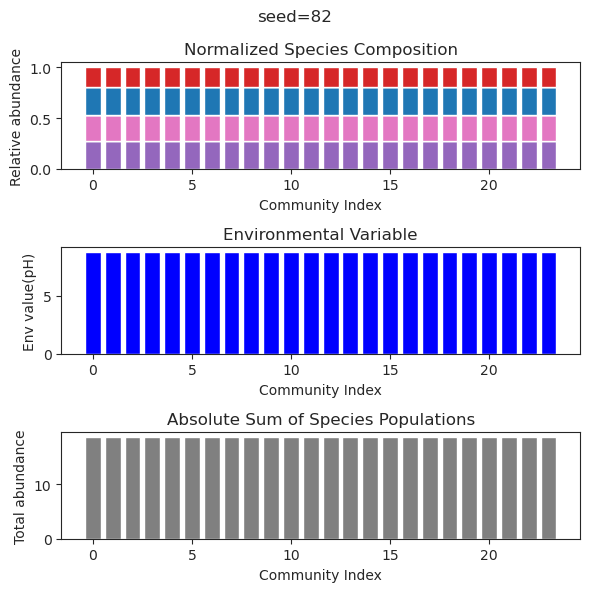

{'species': array([-2.65459465e-049, -6.60930674e-074,  3.95588600e+000,
       -5.73827708e-152,  2.97957434e+000,  3.18081786e-045,
        7.06129845e-162,  1.68432752e-062,  3.22890889e-172,
       -3.61772623e-139,  3.04420561e-145, -1.63065064e-065,
        4.12755567e-046, -6.37310925e-056,  1.21627702e+000,
        1.02910011e-145,  9.79299725e-001,  5.38205197e+000,
        6.65542813e-171, -8.30355226e-081, -3.59419247e-059,
       -1.55183720e-033,  2.67901250e-002,  1.06175721e-137]), 'env': array([8.04906146])}
{'species': array([-4.70461659e-041,  9.57687660e-070,  3.95588600e+000,
        2.26404549e-128,  2.97957434e+000, -1.14744993e-065,
       -4.37035222e-122,  2.58037618e-053,  1.33936039e-130,
       -9.88767010e-098,  1.09839863e-107,  7.96896797e-053,
        1.17210730e-039, -1.68025158e-044,  1.21627702e+000,
       -1.76374260e-118,  9.79299725e-001,  5.38205197e+000,
        1.35723304e-128,  1.02497308e-055,  6.09009085e-051,
        3.83379314e-027,  2.679

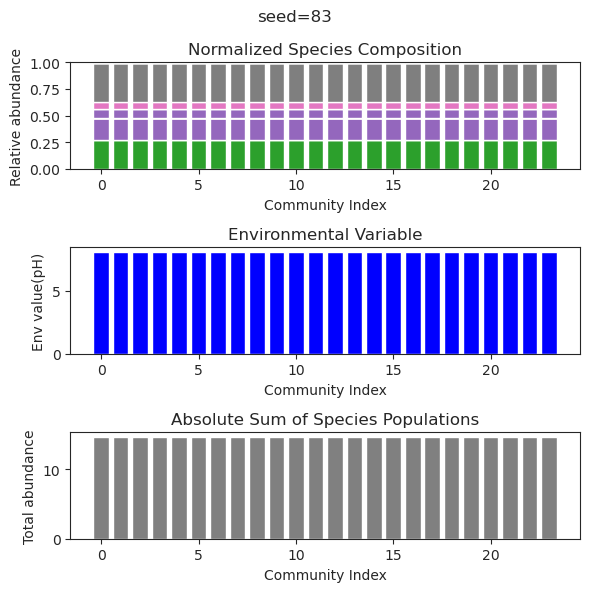

{'species': array([-5.70532038e-56,  2.06339007e-79,  1.60980910e+00,  1.06101318e-85,
        4.75903604e-36,  5.22487638e+00,  4.65635165e+00, -8.63190572e-30,
        4.68327240e-42,  5.03062948e-70, -3.99786837e-63,  1.58513955e+00,
        2.18919639e-82,  5.05646801e-44, -2.05221416e-81,  1.33039939e+00,
        3.10942025e-72, -1.96084757e-69, -2.28615572e-69, -4.40607898e-84,
        7.74982504e-79,  1.36448943e-76,  2.01739401e+00, -8.23505811e-19]), 'env': array([7.95169032])}
{'species': array([-1.95461882e-51,  2.25403253e-82,  1.60980910e+00,  7.22328675e-92,
       -7.55933280e-39,  5.22487638e+00,  4.65635165e+00,  2.01941373e-31,
       -3.31003472e-46,  1.59368111e-77, -2.79716622e-68,  1.58513955e+00,
        8.45551680e-92, -1.12288774e-46, -4.20388797e-87,  1.33039939e+00,
       -7.60607509e-75,  8.86616877e-75, -1.72812383e-74,  9.24330099e-92,
        2.21579677e-83,  4.12261267e-86,  2.01739401e+00,  7.21471399e-21]), 'env': array([7.95169032])}
{'species': arra

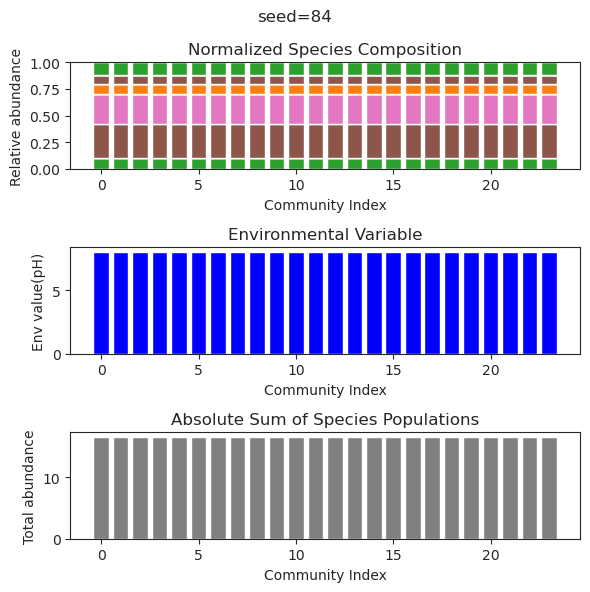

{'species': array([-4.21487476e-58, -4.91253841e-52,  6.13588860e-39, -2.21187325e-51,
        2.05929389e-47,  4.12963690e+00, -6.32695851e-50,  2.72676960e+00,
        3.02564458e-46, -9.65240656e-43,  3.44559395e-43,  2.48116069e+00,
        5.24122202e-60,  2.73149237e+00,  3.89773418e-44, -6.60694046e-61,
        2.55810964e+00,  2.32551338e-43,  5.38669956e-45,  1.31009281e-34,
        1.69799663e-47,  1.46575370e-59, -3.43183624e-33, -6.98814436e-60]), 'env': array([6.73071123])}
{'species': array([-2.40263711e-45,  8.68385277e-65,  6.38797664e-40, -3.79013363e-68,
       -1.90214090e-56,  4.12963690e+00, -1.46669397e-61,  2.72676960e+00,
        2.41094862e-65,  1.15253712e-80, -1.50805326e-48,  2.48116069e+00,
        7.11812248e-75,  2.73149237e+00,  3.70339959e-69, -2.38191661e-81,
        2.55810964e+00, -3.68351708e-51, -2.88594223e-48,  1.03435181e-31,
        6.47467386e-55,  1.54771702e-78,  8.06124729e-34, -4.46266272e-81]), 'env': array([6.73071123])}
{'species': arra

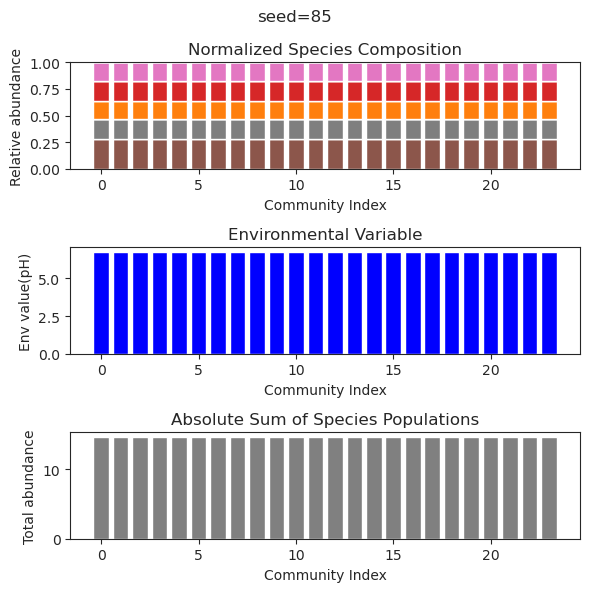

{'species': array([ 8.81984752e-01, -4.02499950e-86,  1.44516353e+00, -6.55662036e-68,
       -2.24825123e-84,  1.48253564e+00, -1.33485327e-46,  3.08661349e+00,
        2.36165595e+00, -2.96157970e-22, -1.70752800e-69,  1.17842365e-42,
        5.82438777e-26, -1.56379908e-82,  1.63173701e+00, -1.21363462e-73,
       -7.11757052e-72,  7.18846200e-82,  7.45221193e-58,  3.02899077e-86,
       -5.50740902e-77,  3.14079720e-86, -2.21957293e-40,  2.42950379e+00]), 'env': array([7.05039927])}
{'species': array([ 8.81984752e-001, -1.36342750e-132,  1.44516353e+000,
        9.97291223e-105,  5.10744190e-131,  1.48253564e+000,
       -1.53249669e-067,  3.08661349e+000,  2.36165595e+000,
       -6.27003128e-028,  9.58488188e-101,  6.32589495e-062,
       -9.90588705e-033, -1.46913024e-129,  1.63173701e+000,
        2.14109652e-109, -7.26951665e-116,  8.48187162e-133,
       -1.64185011e-086,  6.70825783e-134,  2.35065619e-123,
       -1.16295367e-136, -4.73841660e-060,  2.42950379e+000]), 'env':

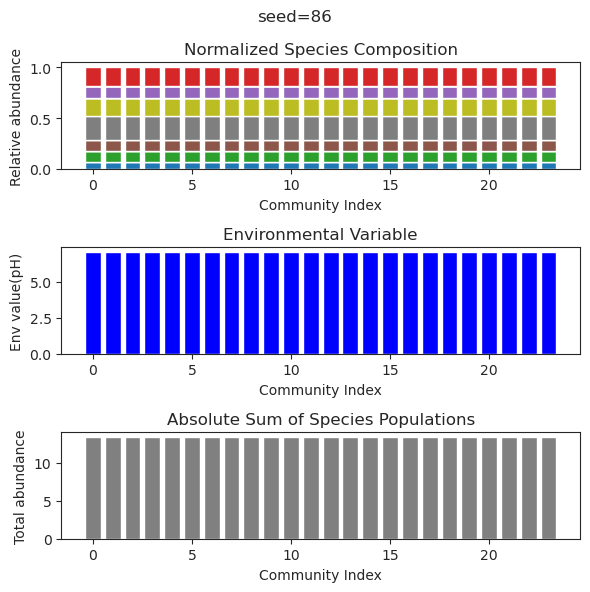

{'species': array([ 1.96728554e+00, -2.56005257e-77,  4.16982581e-20,  3.15902872e-53,
       -1.06337053e-45, -5.59632557e-32, -1.05578940e-62,  9.10354895e-01,
        4.62099895e-50,  1.20626049e-71,  2.39240506e-01,  1.45119236e-57,
        7.95089528e-46, -1.29663941e-47,  3.19214445e+00, -1.80186077e-83,
        3.18805592e+00, -2.77139068e-87,  6.03741435e-71, -4.16381288e-34,
       -1.07777241e-60, -3.03232302e-59,  1.27361552e+00, -4.34295269e-36]), 'env': array([6.10780337])}
{'species': array([ 1.96728554e+00,  2.77012223e-47,  1.56688878e-19,  1.69778729e-67,
        4.23382124e-70, -5.03841266e-42,  3.51982133e-61,  9.10354895e-01,
        1.14829479e-50, -6.72495396e-49,  2.39240506e-01,  1.06266826e-67,
       -3.50616338e-83, -1.30400244e-54,  3.19214445e+00, -1.04114905e-88,
        3.18805592e+00,  8.07224476e-90, -3.21397270e-82, -1.27943196e-41,
        2.81138392e-72,  8.29265398e-59,  1.27361552e+00, -4.39501876e-45]), 'env': array([6.10780337])}
{'species': arra

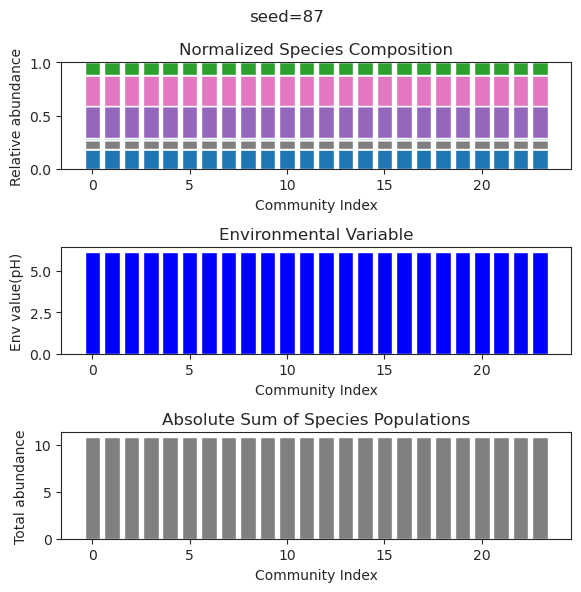

{'species': array([-1.04019628e-039, -2.11328019e-109,  6.76786382e-002,
        4.78268344e-022, -1.17359675e-110,  3.36305838e+000,
        2.94430995e-001, -3.91990488e-045,  1.07125853e+000,
        1.36813345e-044,  2.19634463e-110,  4.28409734e-008,
       -1.73288712e-128,  1.55586410e+000,  5.16577011e-122,
       -3.02353902e-092, -1.16250386e-123, -1.10183642e-056,
        2.87026574e-041,  1.06865385e+000,  7.05592047e-001,
        2.61890671e-039,  7.20842932e-109, -2.31461522e-113]), 'env': array([3.76021332])}
{'species': array([ 9.07653732e-082, -2.01279584e-095,  1.43339380e+000,
        1.16033092e+000,  2.12748210e-079,  4.74616224e+000,
       -9.94746442e-023, -2.66110033e-071,  1.23016108e+000,
        1.60411849e-029,  1.80026218e-094,  3.70368550e-060,
       -2.18728970e-096,  1.55785413e+000,  2.66420131e-099,
        5.54540543e-078, -2.42916038e-119,  2.26509670e-036,
       -1.47319591e-039,  8.72178565e-001,  1.90341025e-028,
       -2.47458971e-065,  2.017

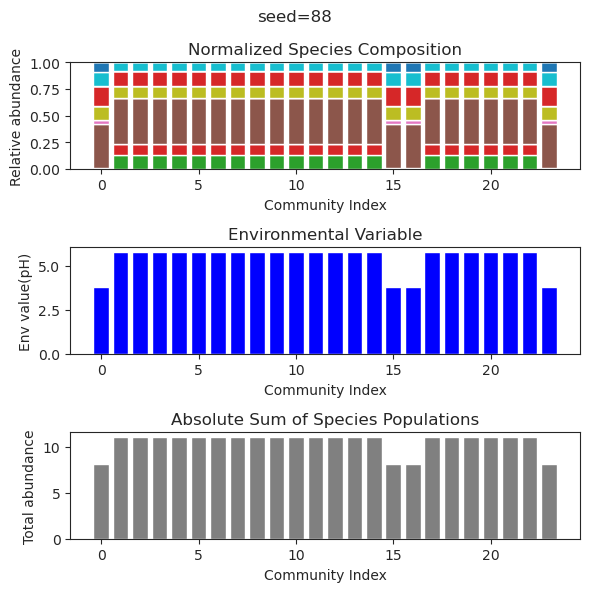

{'species': array([ 1.49703513e-44, -1.11845566e-14, -4.61843523e-42, -2.18797688e-59,
        2.90096191e-43, -1.22794195e-48,  7.37473571e+00, -1.99307209e-47,
       -1.00023046e-36,  4.67990052e-59,  8.76946700e-42, -1.27476188e-65,
       -1.55634749e-40,  9.37702080e-63,  4.65747914e-35, -2.94014047e-52,
        9.13616891e-49, -4.50548776e-62,  5.84273722e+00,  1.50644224e+00,
       -1.33146288e-39,  4.02868759e-47,  1.54724383e-53,  4.38502441e+00]), 'env': array([10.68310215])}
{'species': array([ 8.35040648e-40,  4.32858399e+00,  8.30567278e-58, -3.18251537e-54,
       -3.09365227e-44, -9.96130534e-51,  6.19811164e-32,  1.32329200e+00,
       -3.92379887e-46, -1.78121823e-52,  9.47434420e-01, -9.93274016e-45,
       -8.74489553e-51, -3.21311091e-55,  3.90203731e-59, -5.65190630e-42,
       -1.80168329e-52,  3.71434228e-56,  2.43991419e-27,  2.60786989e+00,
        6.03675576e-01, -1.49305940e-56,  1.73316623e-36,  6.62568307e+00]), 'env': array([9.27443419])}
{'species': arr

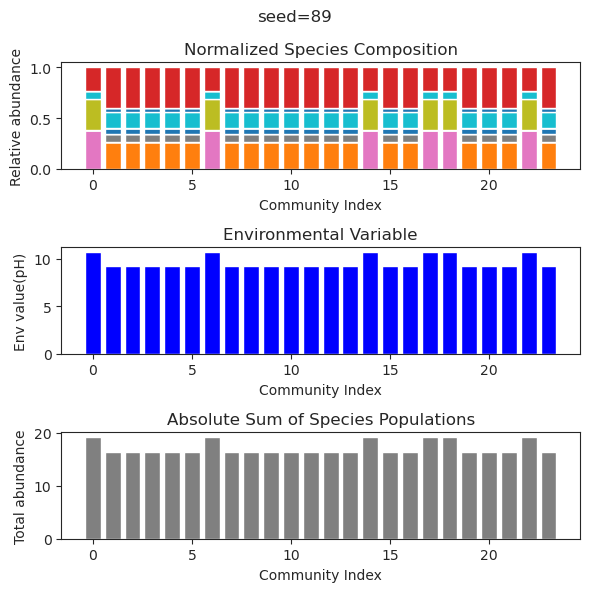

{'species': array([ 2.58021265e-79, -7.16203510e-18,  3.47983638e-40, -8.45248846e-96,
       -7.13347767e-85,  2.80658860e-69, -9.76673360e-93, -3.62021757e-48,
        4.01748963e-31, -8.11294160e-95,  4.86295252e-71, -6.50187042e-47,
       -8.43085615e-93,  1.81909952e+00,  4.51166808e+00,  1.32180970e-70,
        3.20210317e+00,  2.32853956e-36,  6.79448783e+00, -5.94935344e-94,
        1.75876429e-43,  6.88310192e-28, -1.93536887e-41,  3.18685315e-94]), 'env': array([10.53635559])}
{'species': array([ 1.56055675e-040,  1.01427077e-017, -3.27773552e-054,
        1.24972973e-127, -3.77577654e-049,  1.18289845e-092,
        7.11565009e-122,  3.51747298e-069, -1.05208826e-049,
       -3.81927789e-121, -2.79007114e-048,  9.24288172e-068,
       -6.29901936e-123,  1.81909952e+000,  4.51166808e+000,
        5.93226152e-092,  3.20210317e+000, -5.94788646e-053,
        6.79448783e+000, -7.87923216e-125,  2.80789596e-044,
        6.02292405e-047, -8.39727931e-062,  3.47997482e-128]), 'env'

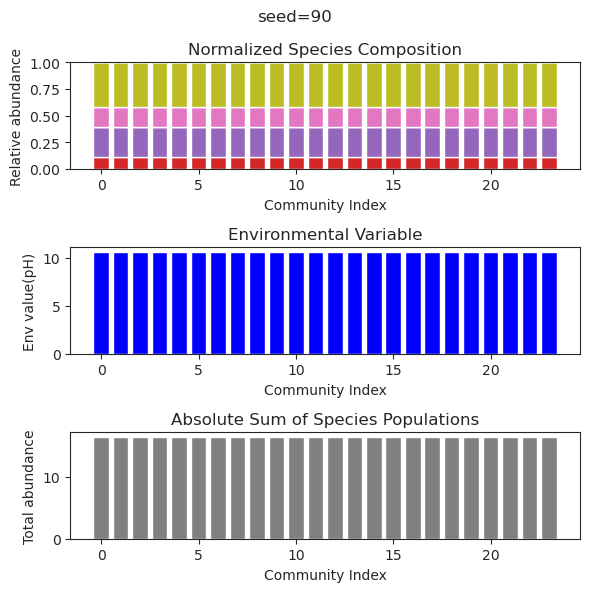

{'species': array([-5.23167648e-045,  4.95230519e-050,  1.38425627e-067,
       -1.41234772e-050,  1.38536821e-124,  6.83798914e-131,
        3.26118307e+000, -5.30461073e-084,  8.84198319e-001,
        1.41348586e-055,  2.71357739e+000, -4.22262819e-104,
        1.83543403e-064, -1.14290609e-111,  6.10824983e-001,
       -2.81317324e-082,  1.54188673e-016, -7.05629518e-107,
       -4.56853806e-070,  9.85671092e-001,  1.21395202e-043,
        5.58208240e+000,  1.10751768e-083,  8.85514247e-129]), 'env': array([6.96496114])}
{'species': array([ 3.56875999e-037,  1.00156719e-125, -4.40016159e-037,
       -4.08845204e-042, -7.08146968e-046, -5.54425958e-124,
        3.26118307e+000,  2.01895819e-073,  8.84198319e-001,
        3.64267858e-045,  2.71357739e+000, -2.86974487e-117,
       -6.26605695e-048,  1.80374997e-106,  6.10824983e-001,
        3.27226740e-090,  4.27493568e-018, -1.34107667e-039,
       -2.92667304e-048,  9.85671092e-001, -9.69465841e-041,
        5.58208240e+000, -5.153

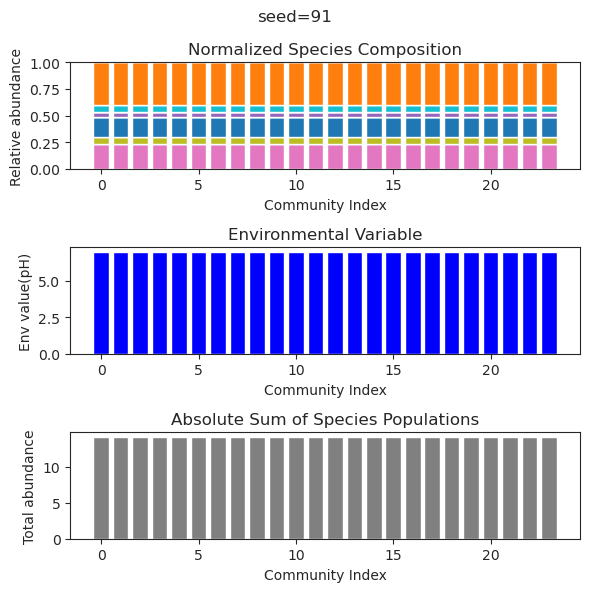

{'species': array([ 2.03013698e-01,  2.67891814e-41,  2.07943214e-93, -7.49117835e-30,
       -1.62798296e-46,  1.11401621e+00,  1.17378056e+00,  5.04747931e+00,
        4.30071161e+00,  8.19395221e-49, -1.83716306e-65, -1.49490489e-78,
        1.98204381e+00,  4.76152892e-88,  1.69849843e-64,  2.56155435e-73,
        1.17289476e-37,  1.19201972e-38, -2.40865130e-40,  3.13017424e-42,
       -1.32834944e-66, -3.06639020e-46,  3.60528440e+00, -2.70295710e-86]), 'env': array([8.42637105])}
{'species': array([ 2.03013698e-01,  1.88645956e-40,  2.58961473e-99, -2.44794768e-31,
       -2.12748336e-56,  1.11401621e+00,  1.17378056e+00,  5.04747931e+00,
        4.30071161e+00,  1.48008353e-55,  2.85066436e-46,  1.61141587e-91,
        1.98204381e+00, -1.06163799e-49, -1.23881046e-75,  2.99346282e-85,
        1.03176943e-37,  3.17023064e-47,  6.52684286e-80,  8.85054046e-75,
       -6.84428701e-68,  2.73054571e-62,  3.60528440e+00, -8.23400021e-93]), 'env': array([8.42637105])}
{'species': arra

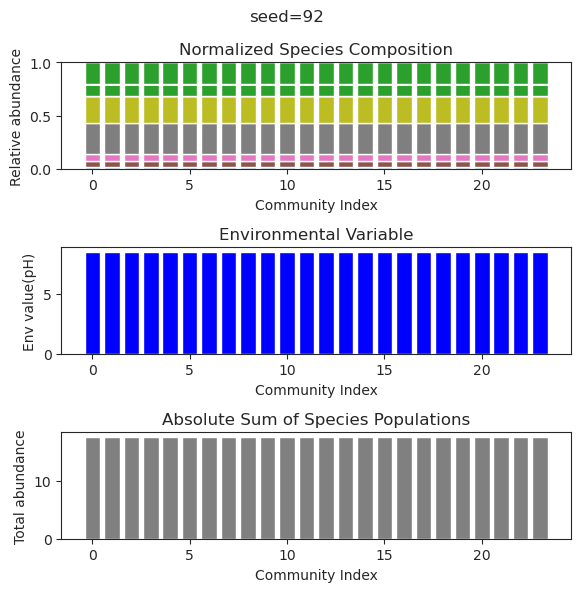

{'species': array([ 1.78046861e-247,  2.15363318e+000,  5.60588636e-039,
        4.93216060e-243, -1.85995760e-229,  1.94468314e+000,
        9.16565232e-276, -2.51431356e-098, -1.63717081e-226,
        3.06173179e-021,  5.57010018e+000, -2.65523733e-092,
       -6.70881474e-145,  3.89403232e-214,  1.90647950e+000,
       -1.78803888e-256, -3.84549340e-157, -7.19858349e-106,
        5.85270250e-079,  1.07589653e-107,  5.10053974e+000,
       -3.76532169e-040,  2.63509290e+000, -4.93920357e-274]), 'env': array([10.67949012])}
{'species': array([ 4.90720448e-209,  2.15363318e+000,  8.56206210e-044,
       -9.49371931e-197, -8.07433247e-192,  1.94468314e+000,
       -2.14440928e-243, -7.91107370e-085,  2.69768914e-215,
        6.09684460e-020,  5.57010018e+000,  1.54629333e-092,
        4.70916957e-137, -4.87545414e-184,  1.90647950e+000,
       -2.55632771e-217,  3.67725438e-144, -1.00361520e-089,
       -2.04622314e-064, -4.66341437e-107,  5.10053974e+000,
        1.64489026e-051,  2.63

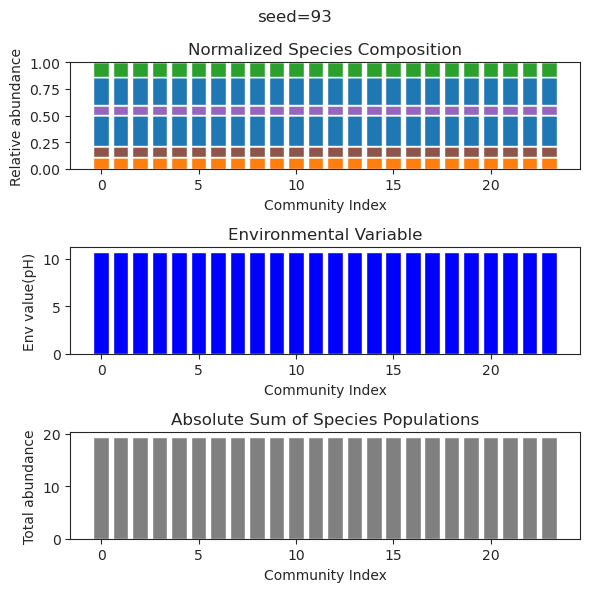

{'species': array([ 1.38759454e+000,  1.99960337e-084, -2.64384684e-116,
        4.81969144e-109,  3.68864132e+000,  1.83697955e-055,
        3.23755418e-113,  4.85553130e-071,  5.66433739e-080,
        1.71720224e+000,  4.18619069e-001, -4.58603520e-086,
       -9.72561652e-036, -4.35176241e-118,  2.63540854e-073,
        2.05808006e+000,  1.78339024e-108,  2.33886127e-104,
       -3.80738943e-086,  5.48804531e-120,  8.76210598e+000,
        3.33692188e-055,  4.01034084e+000, -3.81113060e-023]), 'env': array([11.70568633])}
{'species': array([ 1.38759454e+000,  1.34930749e-090, -7.47035016e-135,
       -1.07714916e-124,  3.68864132e+000, -6.61060992e-048,
       -3.81260705e-128, -7.80722756e-079,  8.08834433e-088,
        1.71720224e+000,  4.18619069e-001, -9.19873122e-091,
       -5.70920565e-030, -5.71255136e-136, -3.58938058e-090,
        2.05808006e+000, -5.80749871e-124, -5.91597729e-125,
        2.00883131e-095,  1.91200857e-135,  8.76210598e+000,
        1.02057005e-042,  4.01

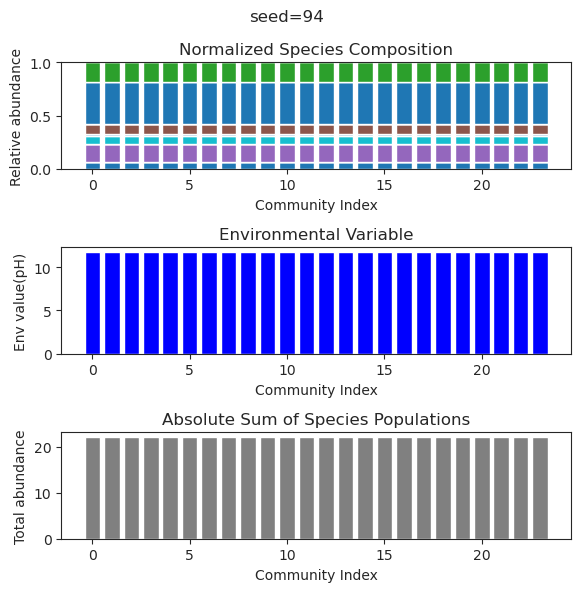

{'species': array([ 1.38759454e+00,  1.79042346e-68,  1.25252611e-93,  9.44194548e-83,
        3.68864132e+00, -3.47369494e-50,  7.21408526e-92,  9.89072017e-58,
        2.82554915e-63,  1.71720224e+00,  4.18619069e-01, -1.54689512e-72,
       -3.67362531e-33,  1.11371073e-93,  2.21963278e-58,  2.05808006e+00,
        1.09895453e-83,  1.20596759e-89, -5.12811393e-71,  7.36917920e-97,
        8.76210598e+00,  2.11793092e-49,  4.01034084e+00, -1.21323357e-20]), 'env': array([11.70568633])}
{'species': array([ 3.63049160e-43,  8.32435925e-01,  3.27177319e-01,  7.38748714e-01,
       -2.03922502e-47, -7.13958334e-70,  3.16405452e-01,  1.12747894e-46,
        6.79896028e-49, -8.54864431e-39,  2.83239096e-41, -5.23904300e-39,
        6.82239801e-70, -9.97582721e-54,  2.02226489e-69, -1.53340038e-61,
       -3.00201151e-15, -7.65064337e-54,  1.29804479e-47,  4.98376988e-02,
       -4.74367451e-36, -4.90425447e-37,  7.13637352e-01, -3.71242323e-57]), 'env': array([0.68025263])}
{'species': arr

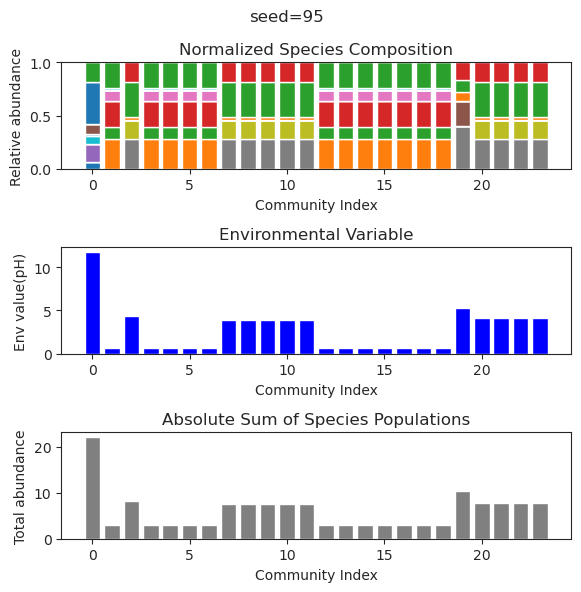

{'species': array([-3.98767569e-038,  5.61231889e-046,  3.70930358e-045,
       -6.55309873e-042,  3.53844438e-046,  1.08078145e-134,
       -1.00544009e-053,  2.85314928e-114,  3.72857898e+000,
       -6.28401009e-045,  1.93918194e-137, -1.59885538e-056,
        8.25333435e-036,  1.64357529e-048,  1.89725514e-065,
        3.75283134e+000,  2.22688242e-001,  1.51358747e+000,
        1.85337060e+000,  3.72949903e-098,  1.13614650e-035,
        6.27944722e+000, -5.33144584e-139,  4.69783443e-001]), 'env': array([9.51182178])}
{'species': array([-1.41252873e-024, -1.25846618e-040, -6.87425030e-117,
       -6.73147201e-034,  5.31277558e-045,  2.55163318e-111,
       -6.45758690e-118, -8.30044362e-094,  3.72857898e+000,
        1.30339367e-030, -3.49739672e-110,  3.38576276e-052,
       -1.53005667e-034,  7.43839327e-108, -2.54887374e-050,
        3.75283134e+000,  2.22688242e-001,  1.51358747e+000,
        1.85337060e+000,  1.04628735e-084,  5.25066635e-109,
        6.27944722e+000,  2.635

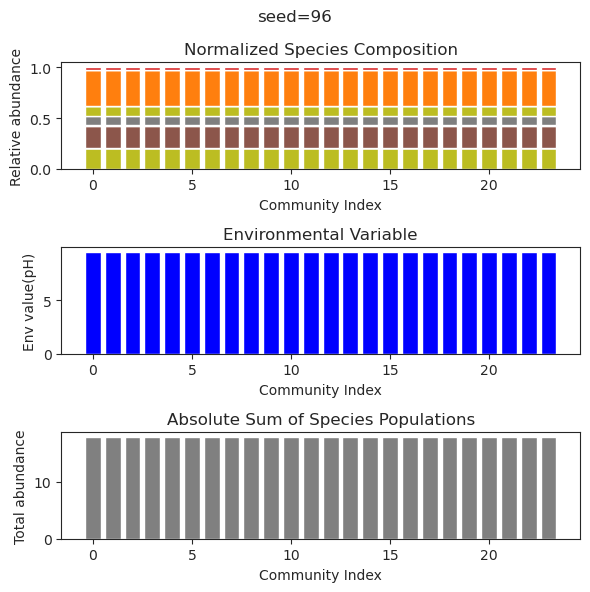

{'species': array([ 5.48685067e-001,  1.16015091e+000,  1.41916054e-017,
        8.66783267e-046, -4.14663870e-043, -3.37934163e-064,
        8.06359340e-018,  1.13643262e-114,  1.12307502e-094,
       -2.90710146e-089,  1.99939967e-047,  8.07680465e-001,
       -4.55778192e-047, -2.53451193e-117,  4.01200824e-001,
        2.09083495e+000, -2.04463047e-085,  2.78140416e-079,
       -1.55399008e-122, -1.41677589e-114, -3.97993367e-114,
        2.08762660e-031,  4.29915474e-001,  4.30551521e-001]), 'env': array([2.52178461])}
{'species': array([ 5.48685067e-01,  1.16015091e+00,  4.30674835e-17,  3.96849644e-49,
        9.91045704e-89,  2.11288110e-36,  2.14268259e-18,  1.14630872e-86,
       -1.17472962e-50, -1.63446256e-66, -6.70423416e-72,  8.07680465e-01,
       -1.11219420e-53,  9.67641660e-92,  4.01200824e-01,  2.09083495e+00,
       -1.30544626e-77, -4.70775135e-75,  2.29266460e-87, -3.79068285e-87,
       -7.61342605e-90,  2.41205904e-23,  4.29915474e-01,  4.30551521e-01]), 'env':

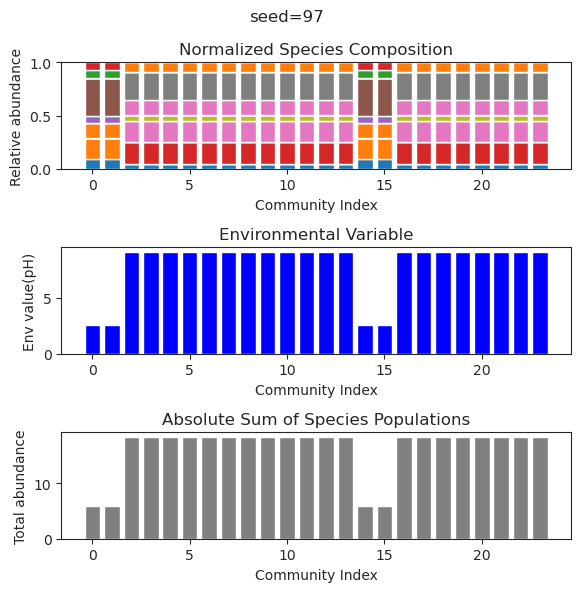

{'species': array([-2.31107381e-30,  3.66248117e-46,  4.85155584e-40,  5.72887372e-90,
        1.14577202e-95,  7.07993628e-75, -1.07628564e-80,  5.37189691e+00,
        2.15897033e-95,  1.12293600e-40, -1.44352930e-74,  1.31484954e-60,
        3.85238703e-87,  1.20277310e-98,  1.72533784e-94,  4.80336776e-63,
        8.44661527e-57,  4.96916516e-60,  1.80264115e-84, -4.67658196e-49,
        7.66895504e+00,  8.17650874e-24,  8.00446941e+00,  3.27247543e+00]), 'env': array([10.89854305])}
{'species': array([-3.36246758e-038,  1.35938229e-051,  4.90817873e-047,
       -2.63927096e-098, -2.40879466e-098,  7.06134064e-083,
       -6.36720368e-094,  5.37189691e+000, -4.07516680e-099,
        6.55260998e-049,  1.40749941e-091, -3.47373218e-074,
        6.96940020e-088,  1.57601481e-103,  1.92798359e-099,
       -6.01957654e-076, -4.67474083e-071, -6.34737470e-074,
        1.63710735e-094,  1.18638825e-053,  7.66895504e+000,
       -8.16269823e-028,  8.00446941e+000,  3.27247543e+000]), 'env'

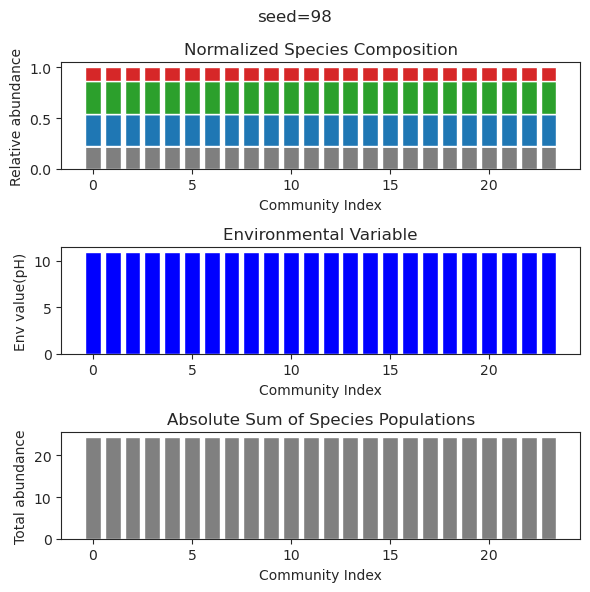

{'species': array([ 1.13074625e-032, -4.27926003e-084,  6.88700880e-002,
        2.75871561e+000,  1.27185018e-111,  4.64033129e-161,
        7.91394585e-002,  2.16491193e-001,  1.55777028e-031,
        1.70053339e-104,  9.32026368e-121, -4.03694279e-155,
        3.88125549e-081, -5.55759654e-154, -1.30929050e-133,
        9.88673982e-001,  1.41170982e+000,  8.55244825e-137,
        5.44346454e-001,  6.51881479e-001, -6.53818411e-158,
        3.83819599e+000, -3.45274693e-162,  2.26619281e-112]), 'env': array([5.74927606])}
{'species': array([ 1.25171834e-049,  1.26869093e-062,  6.88700880e-002,
        2.75871561e+000,  5.66702297e-046, -1.18913286e-193,
        7.91394585e-002,  2.16491193e-001,  1.34387023e-063,
       -5.01184944e-148,  6.61682787e-159, -1.97611945e-181,
       -1.60436409e-064, -1.48407973e-183,  3.17337429e-179,
        9.88673982e-001,  1.41170982e+000,  7.70635312e-156,
        5.44346454e-001,  6.51881479e-001, -1.10078069e-187,
        3.83819599e+000,  8.406

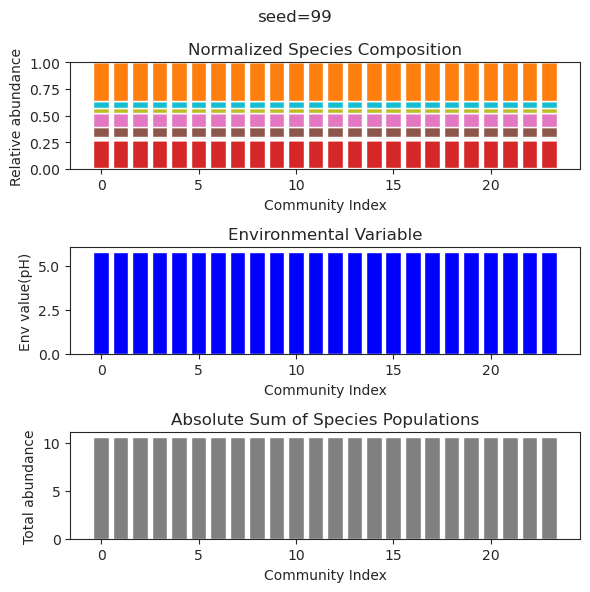

In [ ]:
session_path='Results_qtailed/Session_Test2'
to_save={}
description=''
simulated_result={}

for seed_num in range(100):
    if not os.path.isdir(session_path):
        os.mkdir(session_path)
    # functions for uniform 

    f_I = lambda : uniform_distribution(0.5,0.5)
    f_g = lambda : np.ones(1)
    f_k = lambda : np.ones(1)
    f_p = lambda : uniform_distribution(0.5,0.5)
    f_q = lambda : custom_distribution(-2,1)
    f_beta = lambda : np.ones(1)
    seed_num=seed_num
    to_plot=True

    np.random.seed(seed_num)

    N=24
    N_env=1


    I = np.zeros((N, N))
    for i in range(N):
        for j in range(N):
            I[i,j] = f_I()
    for i in range(N):
        I[i,i] =1

    g = np.zeros((N))
    for i in range(N):
        g[i] = f_g()

    k = np.zeros((N))
    for i in range(N):
        k[i] = f_k()   

    p = np.zeros((N_env, N))
    for i in range(N_env):
        for j in range(N):
            p[i,j] = f_p()

    #p[0,2]=-10

    q = np.zeros((N, N_env))
    for i in range(N):
        for j in range(N_env):
            q[i,j] = f_q()

    #q[2,0]=0.2



    beta = np.zeros(N_env)
    for i in range(N_env):
        beta[i]=f_beta()

    delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
    migration_rate=0#1e-7
    system_config = {
        'I': I,
        'g': g,
        'k': k,
        'p': p,
        'q': q,
        'beta': beta,
        'delta': delta,
        'migration_rate' : migration_rate,
        'N': N,
        'N_env': N_env,
        'seed_num':seed_num,
    } 

    file_path = f'{session_path}/system_config.json'

    label="test"
    sys
    ##

    y_out_list=[]
    system_config['beta'] = np.array([0.5])*delta

    for i in range(24):

        species_index=np.arange(0,24)
        env_index=np.array([0])
        y0_species=one_hot_vector(24,i)
        y0_env=[0]
        t=np.linspace(0, 2000, 10000)

        y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False)

        y_out_list.append(y_out)

    num_datasets = len(y_out_list)

    # Prepare subplots
    fig, axs = plt.subplots(3, 1, figsize=(6, 6))

    # Data for plots
    species_matrix = np.array([y_out['species'] for y_out in y_out_list])
    env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

    # Normalize species data
    species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
    species_sums = np.sum(species_matrix, axis=1, keepdims=True)
    normalized_species = species_matrix / species_sums

    # Absolute sums of species data (sum across all species for each dataset)
    absolute_sums = np.sum(species_matrix, axis=1)
    simulated_result[seed_num]={'species':species_matrix, 'env' : env_data}

    if to_plot:
        plt.suptitle(f'seed={seed_num}')

        # Plotting species composition as stacked bars
        bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
        for i in range(normalized_species.shape[1]):  # Loop through each species
            axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
            bottom_values += normalized_species[:, i]  # Update bottom values for stacking

        axs[0].set_title('Normalized Species Composition')
        axs[0].set_xlabel('Community Index')
        axs[0].set_ylabel('Relative abundance')
        #axs[0].legend()

        # Plotting environmental factors
        colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
        axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
        axs[1].set_title('Environmental Variable')
        axs[1].set_xlabel('Community Index')
        axs[1].set_ylabel('Env value(pH)')

        # Plotting absolute sums of species data
        axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
        axs[2].set_title('Absolute Sum of Species Populations')
        axs[2].set_xlabel('Community Index')
        axs[2].set_ylabel('Total abundance')

        plt.tight_layout()
        plt.savefig(session_path+f'/diagram_{seed_num}.png')

        #if to_plot:
        #    plt.savefig()


        plt.show()
#simulated_result = {'a': 1, 'b': 2, 'c': 3}  # Your existing dictionary
#description = "This is a description of the simulated result."

# Combine both into a new dictionary
data_to_save = {
    'result': simulated_result,
    'description': description
}
# Serialize the combined data to a pickle file
with open(session_path+'/result_and_description.pkl', 'wb') as file:
    pickle.dump(data_to_save, file)

{'species': array([ 0.00000000e+000, -1.25224679e-030,  3.23130098e-001,
        3.12778717e-001,  1.18536245e-209,  3.59662393e-172,
        3.53043308e-048, -2.29094469e-033,  1.84847777e-001,
        5.86199742e-134,  2.41470256e-001,  3.30485137e-070,
        9.94574750e-055,  4.66433215e-001,  3.40862636e-163,
        9.88131292e-324,  1.79930442e-001,  5.00869601e-020,
       -4.67153535e-062, -9.22037084e-145,  2.43617146e-001,
        1.59912640e-001, -8.33005373e-014, -2.30636684e-280]), 'env': array([0.])}
{'species': array([ 0.00000000e+000,  1.12795496e-027,  3.29718054e-001,
        3.80299537e-001, -1.40824707e-201, -1.26549315e-161,
        1.54361768e-036,  2.96152792e-020,  2.01351179e-001,
       -3.85265145e-131,  1.64877989e-001,  1.26185542e-089,
        1.07886400e-055,  5.46404635e-001, -5.90020433e-172,
        4.94065646e-324,  2.19048633e-001,  2.83023037e-022,
        6.49441301e-072, -4.44792104e-147,  2.28795406e-001,
        4.18034063e-005,  1.04031083e-0

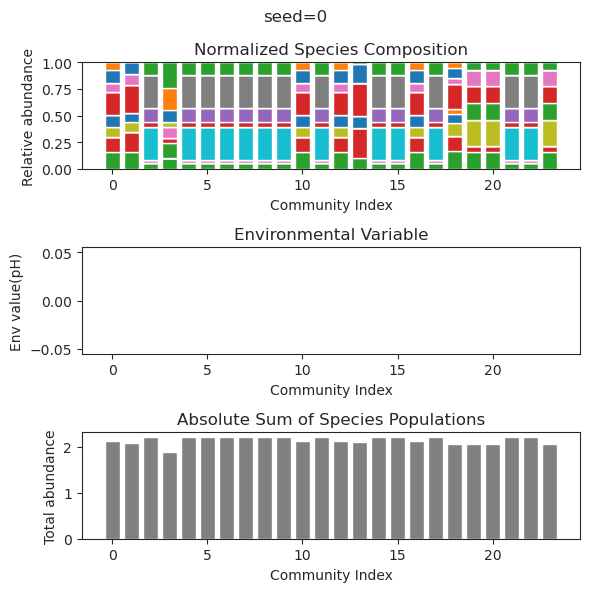

{'species': array([ 2.99917599e-073,  3.46062984e-036,  3.79791573e-037,
        1.06936222e-193, -1.39482494e-170,  3.64175020e-001,
        6.14023820e-001,  1.94094540e-031,  1.26565428e-001,
        2.84393634e-001, -3.68990167e-173, -1.13889011e-016,
        8.80455003e-014,  3.47229864e-001,  2.48648752e-185,
       -7.78114091e-211,  1.39214390e-012, -2.33070210e-095,
       -1.01593100e-181,  4.10745909e-039,  2.87457846e-001,
        2.55721185e-001, -5.44986085e-222,  1.66222915e-221]), 'env': array([0.])}
{'species': array([ 7.44652470e-052,  3.72409190e-037,  8.33933415e-035,
       -1.22932445e-135,  1.45416023e-087,  3.64174907e-001,
        6.14023824e-001,  5.77882872e-033,  1.26565271e-001,
        2.84393538e-001,  2.01274568e-123,  5.38735295e-020,
        1.47453536e-017,  3.47229961e-001, -1.30100116e-136,
       -1.70171042e-150,  2.27840422e-007,  1.86641807e-078,
       -2.66147167e-133,  3.92777325e-042,  2.87457830e-001,
        2.55721048e-001,  8.08162756e-1

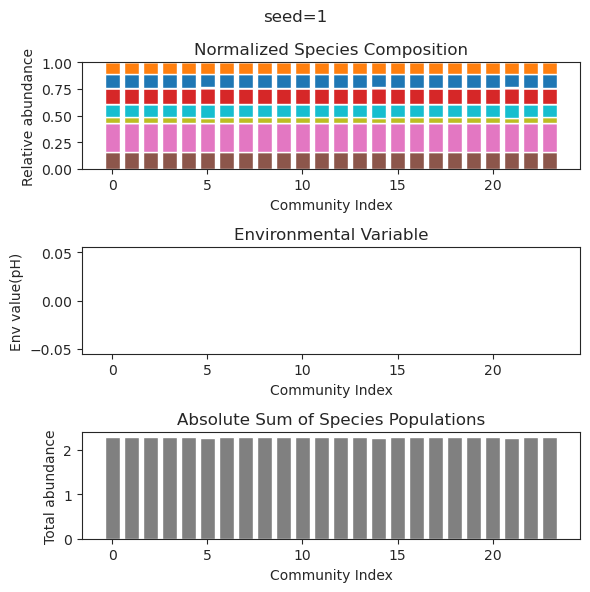

{'species': array([ 6.29930158e-01,  1.29843517e-13, -8.07362039e-30,  1.78370378e-01,
        1.43932848e-30,  1.47804581e-01, -1.39931416e-36,  6.38198822e-08,
        1.10635636e-27, -3.62673192e-27,  5.90825335e-02,  7.52310562e-28,
        3.30025602e-01,  2.15285557e-26,  5.58083466e-01,  6.94491705e-47,
       -1.41938906e-39, -1.64925863e-50, -1.30157004e-45, -3.09459809e-51,
        3.90848568e-44, -1.79646522e-47,  6.31967986e-35,  6.16904490e-01]), 'env': array([0.])}
{'species': array([ 6.29930154e-001,  3.09986070e-013,  1.78391115e-026,
        1.78370374e-001, -5.35383922e-032,  1.47804578e-001,
       -5.42014881e-034,  7.09153753e-008,  1.81737681e-027,
        3.58206095e-042,  5.90825354e-002,  3.09611365e-027,
        3.30025607e-001, -4.35653173e-031,  5.58083465e-001,
       -6.79171304e-103,  1.80199924e-032, -6.46088682e-100,
        6.28903510e-069, -1.71269146e-109,  1.20877650e-093,
       -2.43308401e-032, -3.99809489e-030,  6.16904489e-001]), 'env': array([

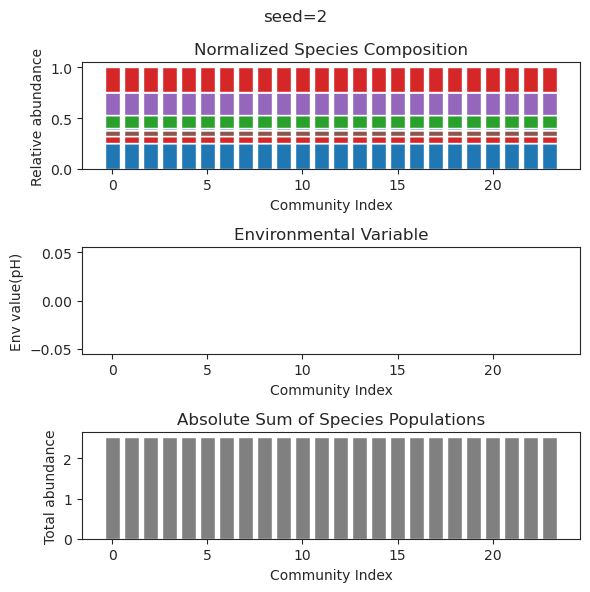

{'species': array([ 1.91321001e-001,  4.54730464e-183,  8.64128211e-003,
        3.74309401e-029,  3.32168465e-025,  1.50666105e-001,
       -1.25396809e-172,  2.11303982e-027,  2.49508596e-001,
        3.56877955e-001,  8.04843646e-104,  2.59954374e-001,
        3.26682228e-167, -1.33164285e-154,  1.21796029e-001,
        1.35569102e-057,  2.88742180e-001,  2.64109878e-001,
       -3.97496629e-167,  1.80794866e-002,  6.40216042e-029,
        1.98797081e-001,  2.90329442e-225,  3.32093019e-150]), 'env': array([0.])}
{'species': array([ 3.25346314e-001, -4.87557647e-229,  3.03203568e-004,
       -2.10764469e-265,  6.43887817e-007,  2.16268436e-001,
       -4.92011667e-275,  1.11095551e-098,  3.02734511e-001,
        4.27368613e-001,  3.58394059e-082,  2.64979714e-001,
       -5.81119076e-185,  4.46017913e-136,  5.28493276e-002,
        2.50437798e-049,  3.60713684e-001,  1.89854416e-001,
        2.18784033e-164,  2.63575361e-013,  5.94997183e-042,
        3.01046505e-006,  0.00000000e+0

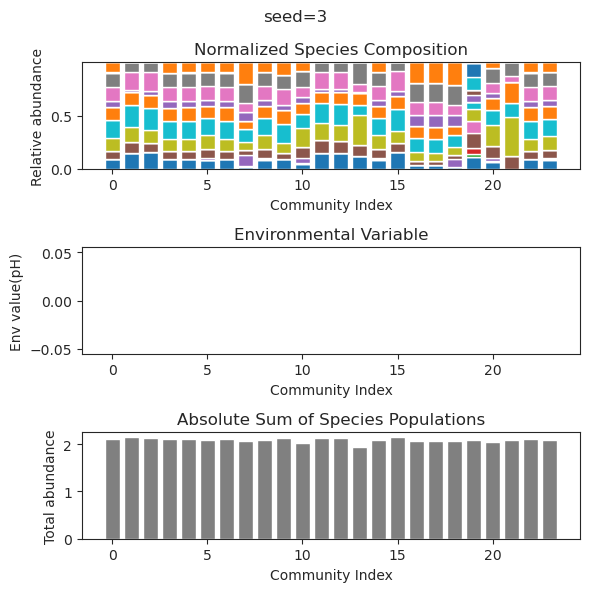

{'species': array([3.23992124e-085, 1.45914661e-001, 1.90699175e-194, 5.18666339e-133,
       2.54280269e-085, 2.07626139e-115, 5.53459316e-115, 3.48368928e-001,
       8.73428309e-003, 6.79866791e-002, 4.23272356e-001, 1.07069174e-001,
       3.18957730e-001, 2.17512223e-004, 3.97813980e-002, 8.28617853e-139,
       7.75185445e-219, 2.50122054e-002, 3.17747752e-075, 5.12923952e-255,
       3.54750615e-001, 4.63503853e-002, 2.42696886e-002, 9.69521235e-002]), 'env': array([0.])}
{'species': array([1.46388723e-083, 1.26995027e-001, 3.34918683e-193, 3.24386390e-132,
       2.58706137e-085, 1.07643740e-112, 1.38772060e-115, 3.61636735e-001,
       6.63676524e-003, 8.85805498e-002, 3.93167355e-001, 1.69905147e-001,
       3.55165408e-001, 1.13460893e-003, 1.97996224e-002, 2.01751259e-138,
       7.82821012e-218, 1.45488359e-002, 3.91333239e-076, 3.92210273e-252,
       3.40198336e-001, 3.64579807e-002, 2.56091738e-002, 7.39269255e-002]), 'env': array([0.])}
{'species': array([1.07321603e-0

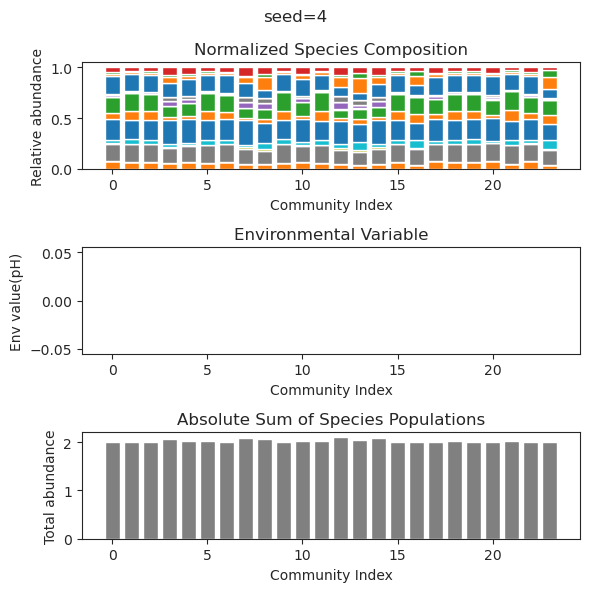

{'species': array([-8.16276403e-37,  8.22590801e-48,  4.58631986e-01,  2.36314810e-01,
        4.79664135e-62, -1.47758011e-29,  8.29250046e-02, -1.88449495e-62,
       -4.37242340e-41,  3.03574047e-54,  1.61752815e-27,  1.13655531e-01,
        3.89635357e-01,  2.13029121e-59,  1.69532814e-71,  5.73847928e-71,
        1.02286212e-71,  5.20846086e-25,  2.16648990e-01,  7.71999222e-01,
       -2.41759056e-37,  1.29567378e-50, -5.32301212e-59,  3.63598873e-27]), 'env': array([0.])}
{'species': array([ 1.10109730e-45,  7.05732976e-55,  4.58631986e-01,  2.36314810e-01,
        2.67489054e-70, -1.19040631e-35,  8.29250046e-02,  1.83430927e-67,
        2.05644664e-49,  1.76279763e-52, -8.14209252e-33,  1.13655531e-01,
        3.89635357e-01,  4.71563637e-73,  5.03564262e-76,  5.84718917e-77,
        3.93632441e-78, -2.83277143e-29,  2.16648990e-01,  7.71999222e-01,
        2.12311665e-45,  1.44723840e-52, -1.19131570e-66, -5.84731239e-33]), 'env': array([0.])}
{'species': array([ 3.17385203e-

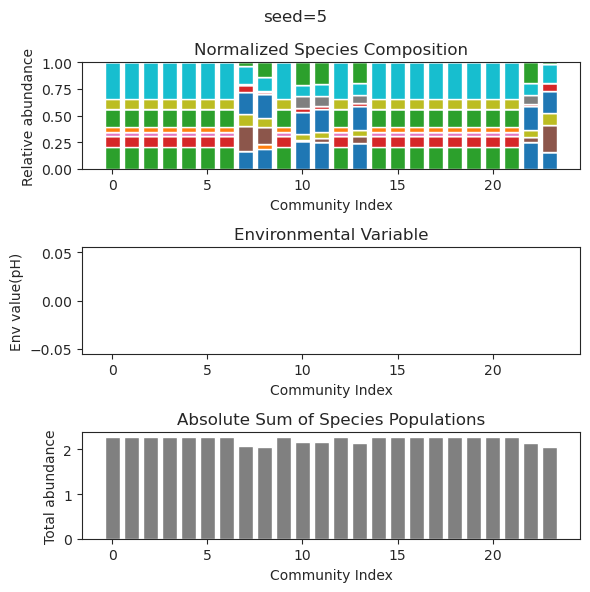

{'species': array([0.00000000e+000, 2.12025812e-203, 6.22622063e-082, 4.97522218e-112,
       1.12210755e-194, 3.98387707e-002, 2.15530896e-001, 6.84081382e-001,
       3.91095890e-230, 5.47458459e-101, 2.14891876e-318, 4.06406250e-002,
       6.70151980e-002, 8.99412393e-274, 1.17397174e-227, 6.69700465e-001,
       8.06411076e-002, 1.75380311e-141, 1.63759495e-002, 6.30584883e-063,
       1.15573842e-056, 1.57507936e-001, 1.41236950e-001, 4.93831364e-002]), 'env': array([0.])}
{'species': array([4.94065646e-324, 3.70536510e-206, 4.10987362e-081, 9.93099606e-115,
       3.83484747e-196, 1.48292724e-001, 2.22897854e-003, 4.63186458e-001,
       7.40998443e-233, 8.88038349e-098, 0.00000000e+000, 1.58254349e-001,
       2.40164701e-001, 4.88065877e-277, 2.50160182e-231, 4.28276584e-001,
       1.34598670e-002, 4.90918937e-140, 6.28653014e-002, 1.37148075e-063,
       8.38293320e-059, 1.91382798e-001, 8.09379400e-002, 2.19780404e-001]), 'env': array([0.])}
{'species': array([9.88131292e-3

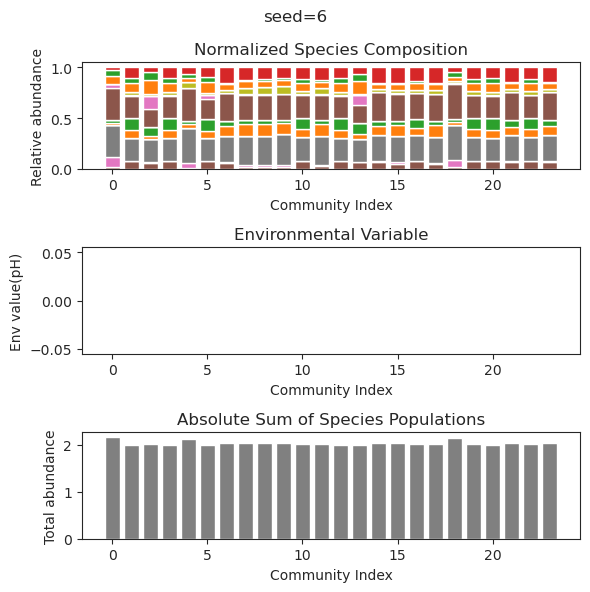

{'species': array([ 3.78479347e-002, -9.88131292e-324,  6.46807187e-029,
        0.00000000e+000,  9.26929682e-311,  6.32099267e-246,
        0.00000000e+000,  9.19093909e-002, -9.88131292e-324,
        9.90369627e-002,  2.82130766e-001,  4.42060437e-001,
        3.39218867e-213,  4.94065646e-324,  2.31279477e-001,
        3.44254603e-246,  0.00000000e+000,  0.00000000e+000,
        8.30819757e-022,  5.27165799e-001,  0.00000000e+000,
        0.00000000e+000,  6.18727495e-018,  5.35034270e-001]), 'env': array([0.])}
{'species': array([ 2.45492035e-001,  0.00000000e+000,  1.54903084e-028,
        4.66496783e-320,  8.21536286e-309,  1.64316234e-246,
        0.00000000e+000,  3.22624598e-001, -1.48219694e-323,
        2.46405864e-001,  1.75982272e-005,  3.06643106e-001,
        7.27346536e-216,  0.00000000e+000,  1.61833232e-001,
        1.01668877e-243, -4.94065646e-324,  0.00000000e+000,
        6.91747258e-031,  4.30956285e-001,  0.00000000e+000,
        0.00000000e+000,  8.80489524e-0

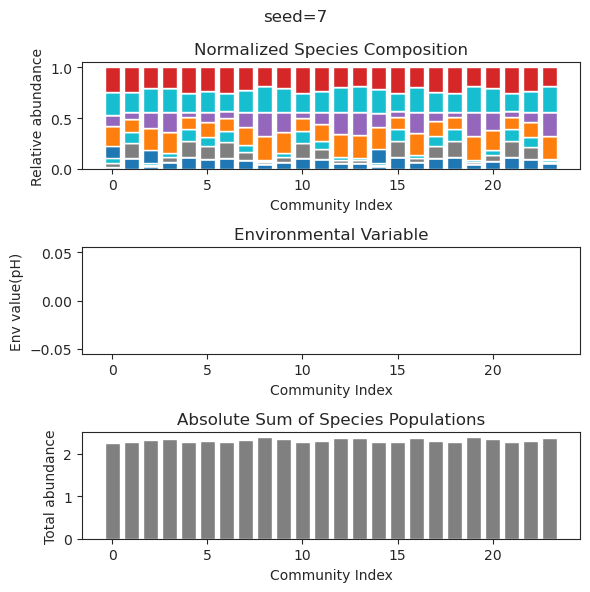

{'species': array([ 1.26794984e-028,  4.34531701e-001,  3.01315633e-001,
       -5.09704029e-029,  9.49809871e-032,  3.90146799e-002,
        2.98797874e-002, -4.06166224e-032, -8.17199380e-049,
       -9.57860422e-044,  5.12818886e-141,  1.40839364e-001,
        5.85418780e-002,  8.77150585e-002, -3.84126094e-034,
        6.54018351e-033,  3.92833939e-001, -5.63340230e-040,
       -2.79626921e-028,  3.45052895e-001, -2.30036992e-089,
        3.48676736e-001,  8.20842824e-069,  3.02319496e-068]), 'env': array([0.])}
{'species': array([ 1.08173550e-27,  4.34518509e-01,  3.01319779e-01, -2.00246890e-27,
       -1.87831366e-27,  3.90281925e-02,  2.98869405e-02,  1.16093409e-29,
        1.22304223e-32,  1.20679135e-33,  2.83832564e-73,  1.40831050e-01,
        5.85356071e-02,  8.77230736e-02,  1.32038453e-28,  5.15477764e-32,
        3.92830918e-01, -2.06481713e-35,  6.75940600e-68,  3.45044624e-01,
        2.15231519e-55,  3.48678753e-01, -3.79231583e-46, -1.01838144e-47]), 'env': array([

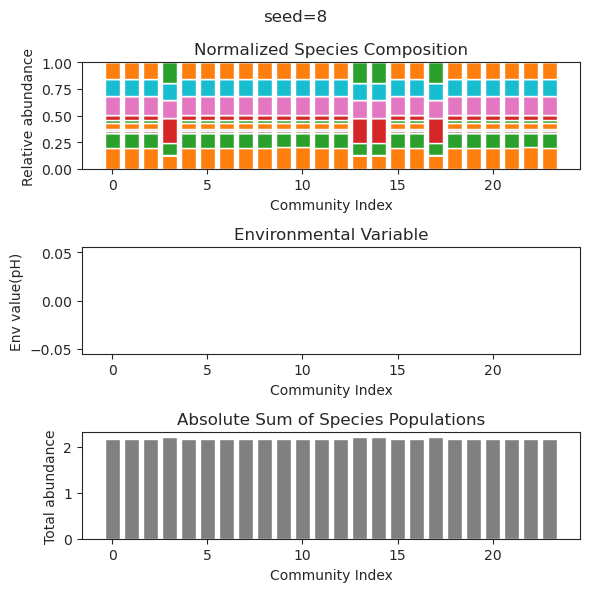

{'species': array([5.04347670e-220, 2.89320434e-236, 3.01457442e-002, 6.48123556e-009,
       3.25079326e-075, 4.52367320e-098, 2.24032558e-111, 1.46540696e-164,
       2.83801852e-001, 8.62119904e-004, 1.28898858e-002, 2.30586388e-001,
       1.50637258e-161, 1.37357621e-149, 9.90749891e-174, 8.35525694e-091,
       2.98265004e-001, 1.36937759e-001, 5.04196135e-002, 3.97093418e-001,
       1.33956599e-002, 3.07028559e-001, 2.75494891e-001, 9.23025742e-185]), 'env': array([0.])}
{'species': array([1.51211496e-194, 2.87029996e-220, 4.87861100e-002, 5.46504552e-018,
       2.16638320e-086, 2.47331390e-098, 4.21126216e-132, 2.04939641e-160,
       2.89034425e-001, 6.90353010e-002, 1.64371786e-001, 3.37912446e-001,
       1.52657285e-176, 3.37492958e-171, 7.64116525e-175, 3.51151999e-097,
       3.86204571e-001, 1.42963646e-002, 8.88560556e-002, 1.67686408e-001,
       5.91100398e-002, 1.98843021e-001, 1.67534459e-001, 3.12020355e-181]), 'env': array([0.])}
{'species': array([7.41162247e-2

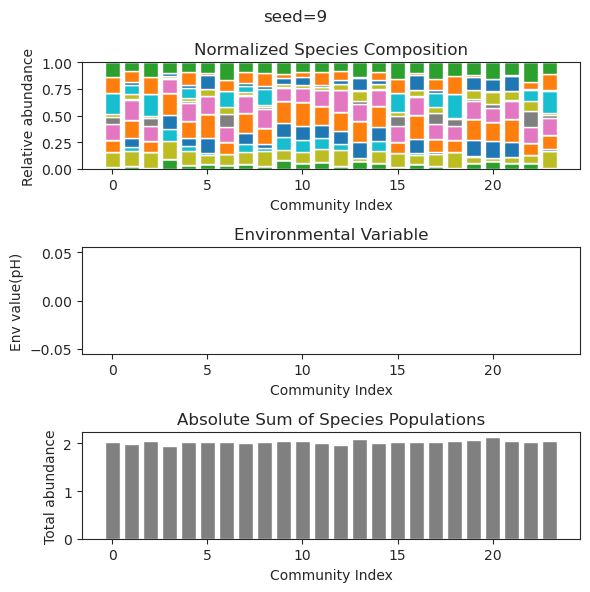

{'species': array([ 3.21008615e-32, -1.50429077e-49,  7.46039144e-01,  5.95553225e-42,
        9.90113883e-51,  1.94391852e-01,  4.64248725e-01,  4.08697688e-54,
       -3.05750884e-55,  2.15887504e-38, -2.25691736e-54,  1.85641527e-53,
       -1.16076844e-18, -2.33235885e-45,  4.69541072e-55,  1.60122986e-44,
        4.97981322e-01,  4.65378826e-45,  8.78150138e-34, -1.11199988e-52,
       -1.12161318e-28,  1.17094878e-32,  6.67978835e-01, -1.84325909e-52]), 'env': array([0.])}
{'species': array([-2.15887314e-41, -2.35004305e-50,  7.46039144e-01, -1.40400524e-42,
        2.90784962e-61,  1.94391852e-01,  4.64248725e-01, -1.38844211e-58,
       -5.34748002e-75, -2.98658975e-41,  2.69172931e-64, -5.75370555e-63,
       -3.34553310e-19,  9.95593089e-57, -1.53634384e-72,  3.68124440e-61,
        4.97981322e-01,  5.65525850e-63, -9.54871884e-50, -4.30526880e-66,
       -3.28793038e-28,  6.77422391e-44,  6.67978835e-01, -3.18367743e-58]), 'env': array([0.])}
{'species': array([ 1.08266077e-

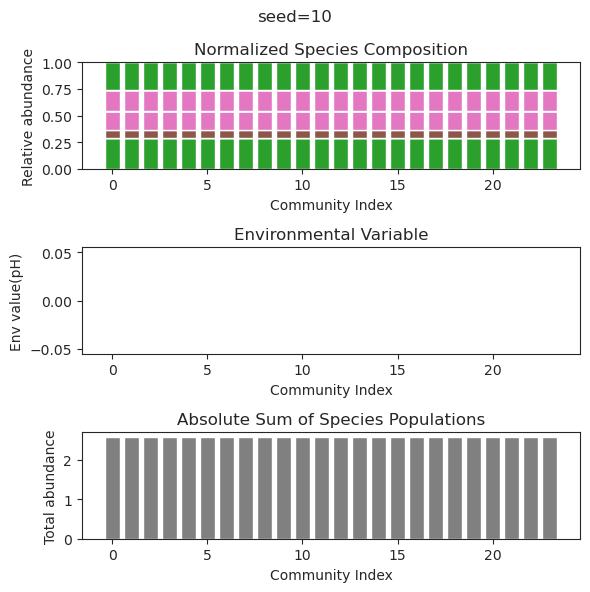

{'species': array([5.79273849e-197, 4.66905149e-002, 5.38697104e-177, 4.24776776e-085,
       1.75402761e-053, 3.75047779e-177, 1.43331846e-282, 2.47172726e-001,
       4.91903119e-002, 6.71425094e-151, 4.32583950e-148, 3.60078667e-002,
       3.39693126e-001, 1.27323612e-039, 1.06165795e-096, 1.66047388e-001,
       7.53011791e-002, 6.42094960e-037, 3.02652370e-001, 1.42828851e-089,
       3.49687062e-001, 3.17106217e-001, 4.23676889e-002, 3.38493215e-002]), 'env': array([0.])}
{'species': array([4.95648967e-199, 4.69359611e-002, 2.22794838e-175, 4.95818810e-085,
       7.40010825e-053, 3.81378369e-173, 3.30959933e-282, 2.47180857e-001,
       4.93952915e-002, 4.83143172e-153, 1.33519515e-150, 3.59932761e-002,
       3.39876110e-001, 8.27776554e-043, 1.38577429e-096, 1.65991958e-001,
       7.51610982e-002, 3.82823225e-039, 3.02647593e-001, 5.55669458e-092,
       3.49428418e-001, 3.16903911e-001, 4.23618126e-002, 3.38079253e-002]), 'env': array([0.])}
{'species': array([9.32567385e-1

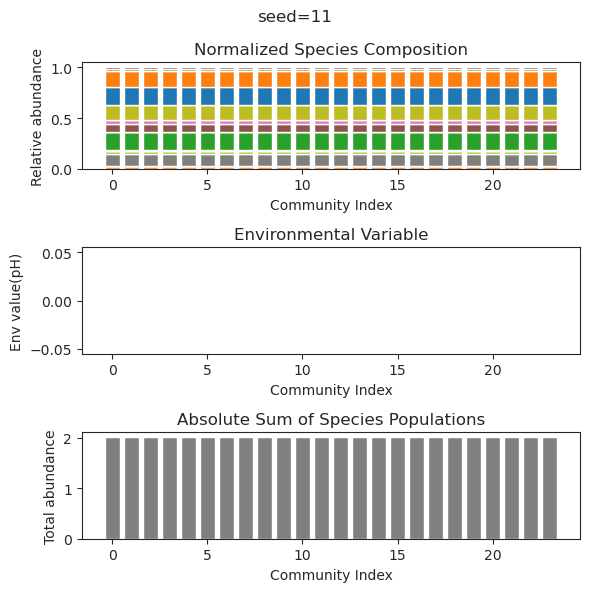

{'species': array([ 2.29574491e-001,  9.80634525e-061,  1.76209437e-001,
        8.88041600e-060, -1.33650536e-099,  2.63026688e-001,
       -5.20563442e-082,  2.87609001e-001,  1.92421785e-042,
       -1.47039409e-064,  3.73716711e-001, -1.00982210e-068,
        1.75496026e-050,  1.34006669e-001,  9.78678037e-044,
        1.27401975e-016,  3.73619606e-001, -1.73698219e-073,
        5.23435459e-110,  2.18236910e-001, -9.04429130e-025,
       -2.46180936e-070, -1.71450932e-071,  9.53752976e-002]), 'env': array([0.])}
{'species': array([ 1.89180995e-01, -5.03449185e-78,  2.18731763e-01, -1.06134463e-78,
        2.30039039e-32, -3.63452168e-16,  2.27405975e-46, -2.60298678e-56,
        1.62601243e-18,  5.55655669e-01,  5.17583946e-02,  6.30836990e-01,
        1.72852605e-26,  3.41515453e-16,  2.06108759e-01,  1.55083828e-70,
        1.02628714e-76, -2.37405239e-75, -1.49676813e-73, -2.20370972e-61,
        3.65552090e-01,  2.94758979e-35,  5.07251127e-24, -9.69838002e-64]), 'env': array([

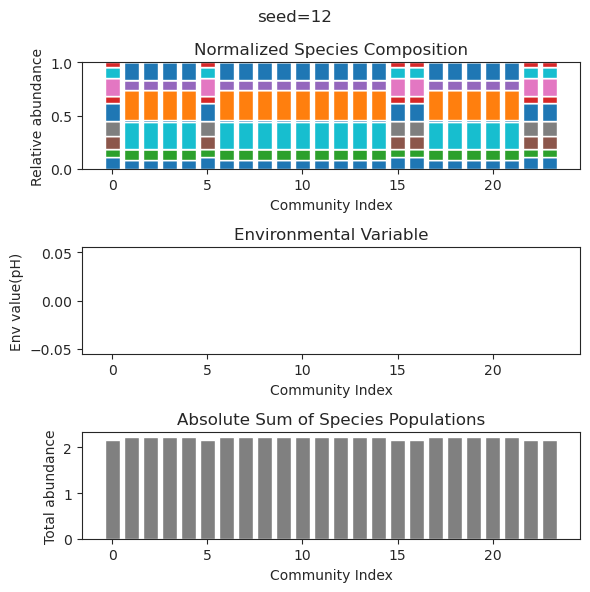

{'species': array([ 5.10668418e-066,  1.31128273e-001,  3.99694051e-002,
       -6.60909451e-062, -3.49207361e-019, -7.86493399e-030,
        3.07957386e-001,  4.93060358e-001,  4.67693410e-001,
        5.16664909e-055,  7.14569182e-076,  1.37012381e-062,
        8.29767376e-002, -3.64755165e-074, -2.93724989e-104,
        2.86503917e-001,  1.46019729e-085,  1.07522009e-095,
       -6.60663855e-070, -3.25162702e-051,  1.12186632e-050,
       -3.57165161e-046,  4.11324989e-001,  2.88611808e-058]), 'env': array([0.])}
{'species': array([-3.32205621e-51,  1.31128273e-01,  3.99694051e-02,  3.04318594e-65,
       -8.46638701e-16, -1.07419306e-18,  3.07957386e-01,  4.93060358e-01,
        4.67693410e-01,  2.46514636e-34, -3.76628395e-54,  2.69402803e-46,
        8.29767376e-02, -1.56239639e-49, -7.97255652e-78,  2.86503917e-01,
       -6.28622155e-67, -3.62599857e-70,  4.08914832e-43, -2.50702963e-38,
       -7.52471096e-46,  3.62518636e-35,  4.11324989e-01, -2.83424469e-49]), 'env': array([

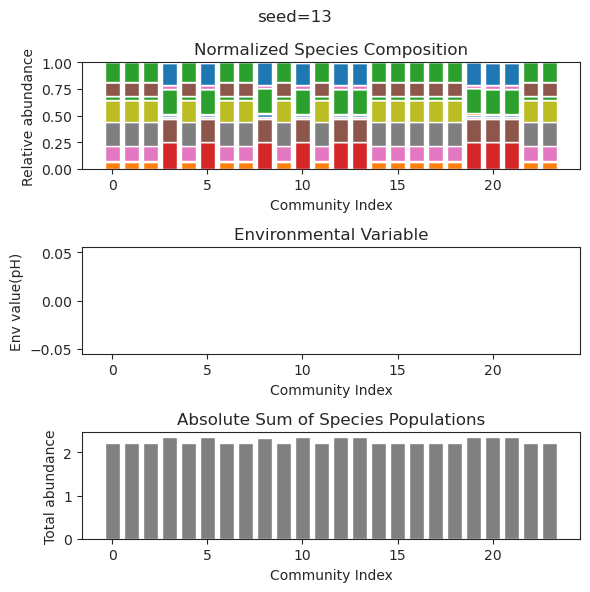

{'species': array([-9.90108021e-104,  6.18743252e-105,  6.41420445e-001,
       -2.35515513e-051, -1.79015770e-052, -1.04925527e-091,
       -9.79693455e-100, -2.95538984e-087,  4.39908255e-001,
        1.02524826e-068,  2.79536477e-001,  2.85792601e-029,
       -1.01476859e-094, -1.29509323e-106,  3.40889396e-001,
       -1.39391943e-104, -4.17748474e-044,  4.14704047e-001,
        1.51075643e-001, -3.94708064e-055, -1.46830881e-092,
       -4.37970879e-060,  3.61104341e-017, -9.44677141e-046]), 'env': array([0.])}
{'species': array([ 7.69113721e-76,  9.66743144e-78,  6.41420445e-01,  8.55293666e-37,
        1.11214675e-37,  4.61666781e-61,  5.68599038e-63,  5.24547545e-62,
        4.39908255e-01, -3.91519005e-48,  2.79536477e-01,  2.55968768e-25,
        2.43975699e-67,  2.60495095e-84,  3.40889396e-01,  7.15220232e-84,
        4.58423571e-38,  4.14704047e-01,  1.51075643e-01,  1.01243372e-39,
       -1.12046373e-78,  1.29971967e-56,  9.40050524e-16,  3.31297016e-33]), 'env': array([

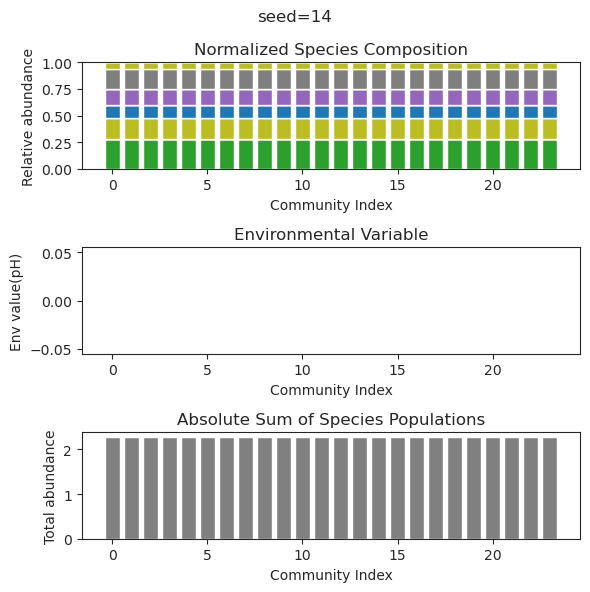

{'species': array([ 1.55261856e-001,  1.34248116e-001,  3.32381629e-001,
        2.82955624e-001,  7.25512315e-177, -4.50398254e-128,
        4.99493699e-002,  3.67660728e-043, -8.76082883e-120,
        1.39977240e-203,  3.15971743e-001, -2.18896928e-237,
        9.51241587e-089,  3.39353986e-001,  1.72865878e-119,
        2.42629551e-001,  4.97378120e-097,  3.92588258e-054,
        5.40194599e-002,  2.40363831e-001,  3.37328316e-154,
       -4.00865854e-062,  2.33129605e-102,  2.87184020e-042]), 'env': array([0.])}
{'species': array([ 1.55261856e-001,  1.34248115e-001,  3.32381629e-001,
        2.82955624e-001, -1.02117514e-186, -2.98627572e-127,
        4.99493699e-002,  7.20575976e-037, -1.08844954e-118,
        1.30996585e-212,  3.15971743e-001,  7.90744138e-250,
        1.37577906e-081,  3.39353986e-001, -2.53674504e-117,
        2.42629551e-001,  1.83649739e-094,  5.21493037e-046,
        5.40194598e-002,  2.40363831e-001, -4.82401242e-157,
        3.36117089e-055,  8.49654177e-1

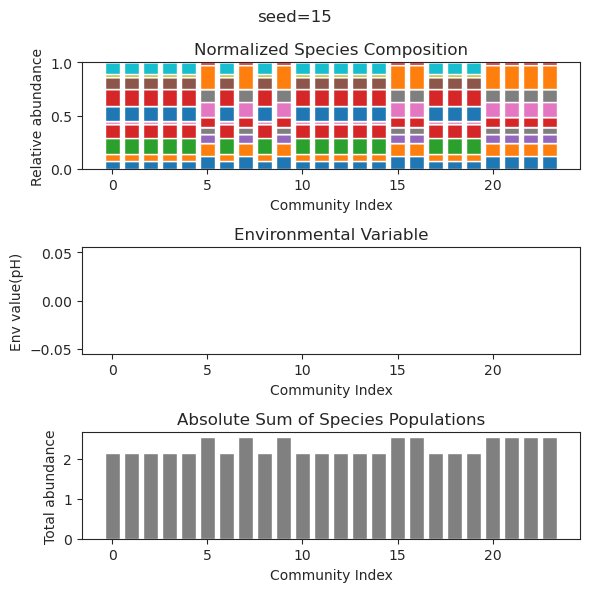

{'species': array([7.97280466e-002, 3.55375026e-002, 2.15247454e-180, 8.93657655e-002,
       0.00000000e+000, 3.18653653e-059, 2.85558192e-001, 1.90606928e-166,
       2.96439388e-323, 3.52622487e-001, 4.75103406e-319, 4.02392872e-001,
       1.64665441e-001, 2.02144760e-004, 7.04239727e-175, 1.28062719e-117,
       1.48183593e-001, 2.31873933e-121, 2.13591412e-024, 1.53736535e-001,
       9.91611104e-002, 1.17437802e-284, 7.31309188e-047, 1.68052095e-001]), 'env': array([0.])}
{'species': array([ 1.07275322e-001,  1.24701612e-002,  4.45336709e-179,
        2.87070888e-001, -9.88131292e-324,  1.90698389e-062,
        2.02102882e-001,  6.79713418e-168, -1.48219694e-323,
        2.02793717e-001,  9.53546696e-322,  3.53021289e-001,
        3.94512214e-001,  2.26106412e-006,  2.46256287e-175,
        2.24413673e-120,  9.02778874e-002,  2.85952460e-122,
        3.85963812e-024,  1.65565308e-001,  5.52571635e-002,
        8.85844765e-288,  6.31195494e-048,  1.21344777e-001]), 'env': array([

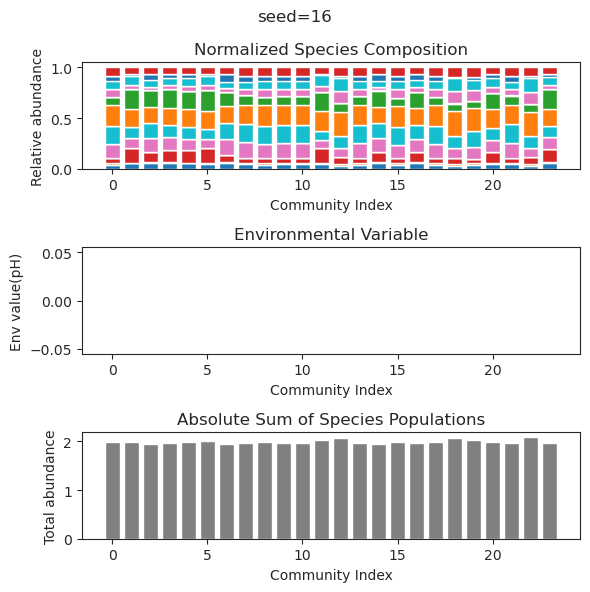

{'species': array([ 7.03830900e-002, -1.71875217e-200, -5.06203451e-193,
       -6.40624859e-081, -3.37597467e-137,  6.69878377e-034,
        2.85316185e-184,  2.62091683e-001,  4.65118516e-087,
       -1.37819986e-059,  1.64730517e-217, -7.05861757e-043,
        1.56280891e-241,  1.79688314e-001,  2.29496691e-001,
       -4.05930618e-073,  1.42159636e-001, -1.66514449e-134,
        4.27207127e-001,  3.54361999e-001, -4.33568360e-170,
        3.99075858e-001, -4.60538718e-061,  2.85599845e-036]), 'env': array([0.])}
{'species': array([ 1.85555419e-001, -1.12275708e-030, -9.77919287e-029,
        4.49527488e-001,  4.36146107e-238,  8.09867179e-029,
       -1.91439301e-032,  5.42631964e-001,  1.58762803e-142,
        2.06241794e-003, -1.90379452e-178,  4.25058606e-001,
       -8.71109290e-110,  5.22123927e-028, -1.49322971e-054,
        3.31381158e-001,  4.15278040e-001,  1.42178676e-243,
        3.01869694e-192,  3.93552069e-061, -3.61771063e-190,
       -1.89610009e-057, -4.76212118e-1

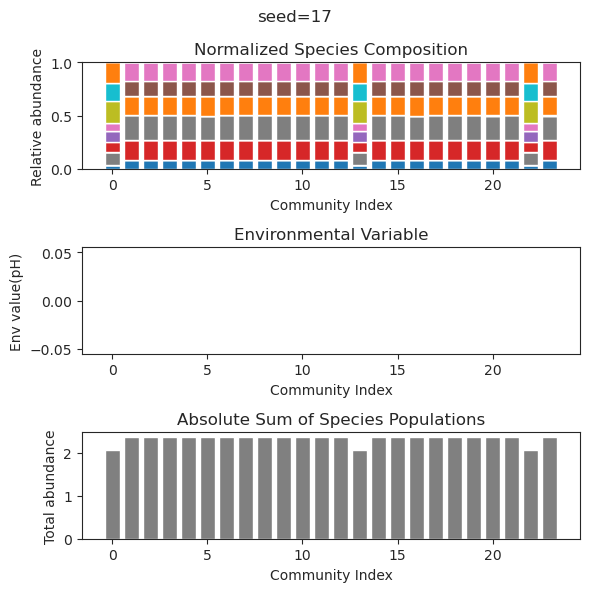

{'species': array([-2.67159700e-098,  9.22463293e-002,  2.25375070e-078,
        5.18411688e-001,  1.21365210e-001, -3.74935394e-092,
       -3.75466468e-133,  5.49698771e-194,  1.08002730e-173,
       -1.62907200e-126,  1.47678870e-001,  2.61620533e-001,
        1.41363943e-001, -8.82402729e-094,  4.82727858e-002,
       -2.13667597e-051,  4.16019693e-001,  1.56407513e-001,
        2.43086730e-171,  8.09476035e-040,  7.74714097e-054,
        2.44607197e-026,  1.64640116e-001,  2.15295346e-090]), 'env': array([0.])}
{'species': array([-2.78960723e-090,  9.22463293e-002, -1.09389179e-069,
        5.18411688e-001,  1.21365210e-001, -4.44299939e-078,
        4.40686717e-111, -2.48896499e-171, -7.06660918e-147,
        6.63345841e-107,  1.47678870e-001,  2.61620533e-001,
        1.41363943e-001, -2.54341747e-084,  4.82727858e-002,
        3.05019622e-045,  4.16019693e-001,  1.56407513e-001,
        9.54607448e-152, -7.96833399e-040, -1.02626715e-055,
       -9.35914877e-028,  1.64640116e-0

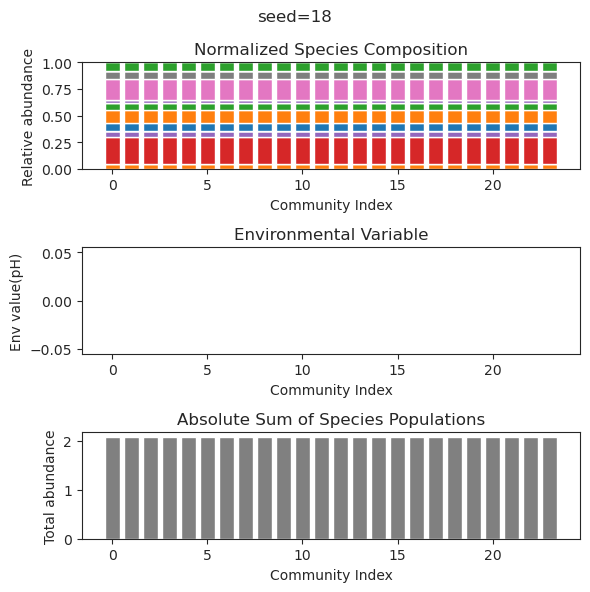

{'species': array([ 2.32831572e-001,  1.49414262e-029, -6.25504304e-028,
        4.84588582e-001,  3.25469544e-020,  4.17575658e-001,
        2.22475915e-007,  3.68190440e-001,  4.01322714e-002,
        1.62118041e-029,  6.57879556e-033, -4.45465730e-102,
        1.21296147e-001, -9.31894727e-036,  2.36079233e-001,
        1.59454681e-036, -1.82814683e-095,  2.61206076e-029,
        1.11636388e-001,  3.05913924e-095,  2.27930782e-001,
        5.44010560e-027,  1.38835151e-001, -1.87863268e-061]), 'env': array([0.])}
{'species': array([ 4.45596408e-255,  4.43046929e-001, -3.14412408e-259,
       -1.94992058e-099,  1.64526809e-285, -1.41834707e-092,
        2.50718134e-001, -1.11312932e-142,  9.31190512e-002,
        2.35502319e-001, -9.31572228e-112,  1.85607938e-001,
        7.72118771e-002,  6.02617537e-272,  3.18546091e-002,
        9.82842375e-002,  1.69264421e-001,  6.55238866e-002,
        2.26859366e-001,  1.69107677e-002,  9.07841389e-002,
        5.48188770e-036,  2.81922984e-0

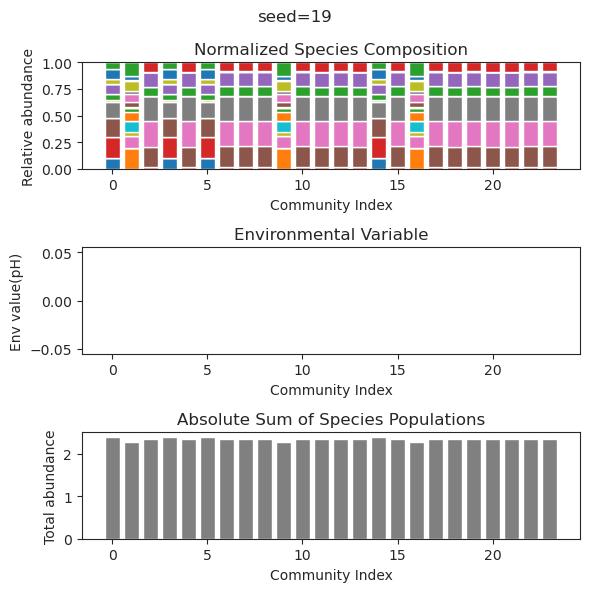

{'species': array([ 9.86170595e-039,  4.49858872e-001,  5.14658444e-035,
        3.83131831e-056,  2.66365809e-055,  1.10960588e-229,
       -5.14625170e-202, -3.51074000e-297, -1.13296620e-216,
        2.11741743e-170,  3.62670808e-057,  2.95473230e-041,
        1.88422020e-124,  4.05635677e-001,  2.49417165e-001,
        4.20914308e-001, -6.54053228e-265, -6.83570814e-314,
        1.55389155e-001,  1.17360690e-005,  3.76188364e-001,
        4.98384626e-009,  4.24160243e-087,  3.32467359e-021]), 'env': array([0.])}
{'species': array([ 5.67492566e-001,  3.08570221e-049,  1.60107002e-054,
        6.01471790e-063,  3.71573972e-029,  4.94065646e-324,
       -1.86341265e-289,  0.00000000e+000,  1.01636468e-241,
        4.25230993e-079,  1.56581187e-020, -4.89086961e-214,
        4.38844055e-141,  2.51486674e-001,  1.90160730e-157,
        4.91144490e-001,  1.96317779e-233,  1.16289823e-288,
        4.48984404e-001,  3.45236432e-001,  2.49025454e-076,
        5.49742412e-003,  7.68035405e-1

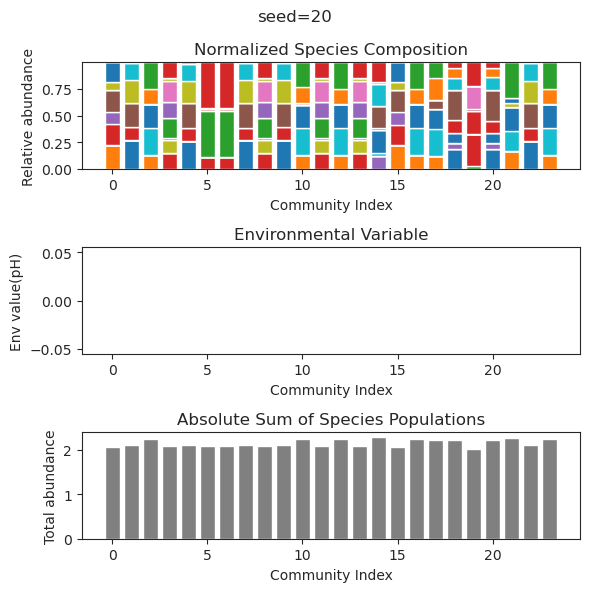

{'species': array([ 4.18128922e-001,  4.47841544e-034,  2.82243417e-038,
        6.38995729e-147,  2.10073273e-033,  1.72840283e-001,
       -5.75452455e-034, -4.00016417e-122,  1.58441471e-001,
        1.52696800e-093,  6.88419632e-127, -6.77041100e-106,
        1.72025767e-001,  8.87971546e-077,  2.43425016e-018,
        8.19835954e-002,  1.75185556e-001,  3.61262329e-003,
        1.63187949e-035,  5.39856243e-001,  5.00860824e-034,
        2.55782620e-036,  3.20115312e-001, -5.84954374e-131]), 'env': array([0.])}
{'species': array([ 4.18128868e-01, -3.93077577e-38, -1.93786392e-43, -1.21211412e-36,
        1.13598720e-33,  1.72840397e-01, -7.08866816e-34, -2.08167236e-74,
        1.58441234e-01, -1.65628806e-30, -1.64357461e-71,  2.75085254e-68,
        1.72025993e-01,  5.65083907e-41,  5.81641695e-16,  8.19837557e-02,
        1.75185762e-01,  3.61252535e-03, -3.92962786e-34,  5.39856026e-01,
        8.61415038e-66, -3.60776980e-48,  3.20115214e-01, -1.68832488e-79]), 'env': array([

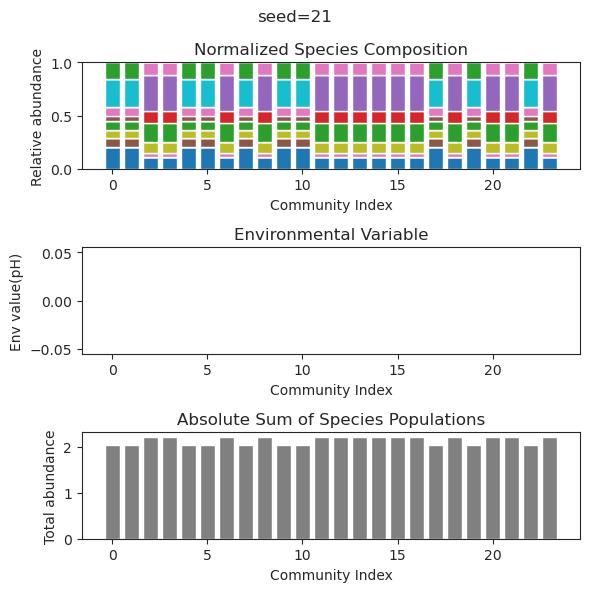

{'species': array([-1.34267674e-57,  3.13487126e-01, -1.53220415e-56,  2.23000494e-01,
        2.61802063e-61,  5.19713300e-46,  2.38413308e-01,  3.50468808e-01,
        1.91716910e-01,  5.62418264e-03,  4.63203461e-60,  1.01452863e-32,
        1.48180625e-01,  3.38761223e-01,  1.86092914e-01,  5.39795368e-63,
       -1.03313856e-67, -3.14161690e-44,  3.10279292e-72, -7.86018226e-68,
        1.30862108e-01,  9.35064559e-71,  2.02512977e-51, -1.22111924e-69]), 'env': array([0.])}
{'species': array([ 2.08996940e-54,  3.13487126e-01,  2.08198231e-51,  2.23000494e-01,
       -6.44620878e-35,  5.44440510e-36,  2.38413308e-01,  3.50468808e-01,
        1.91716910e-01,  5.62418267e-03,  1.17684258e-55, -4.49890430e-23,
        1.48180625e-01,  3.38761223e-01,  1.86092914e-01,  4.51547072e-56,
       -1.63904455e-72,  4.13215219e-32,  2.29747557e-72,  3.08592016e-66,
        1.30862108e-01,  1.16134375e-71,  4.93290398e-38,  1.42290051e-68]), 'env': array([0.])}
{'species': array([-9.27866773e-

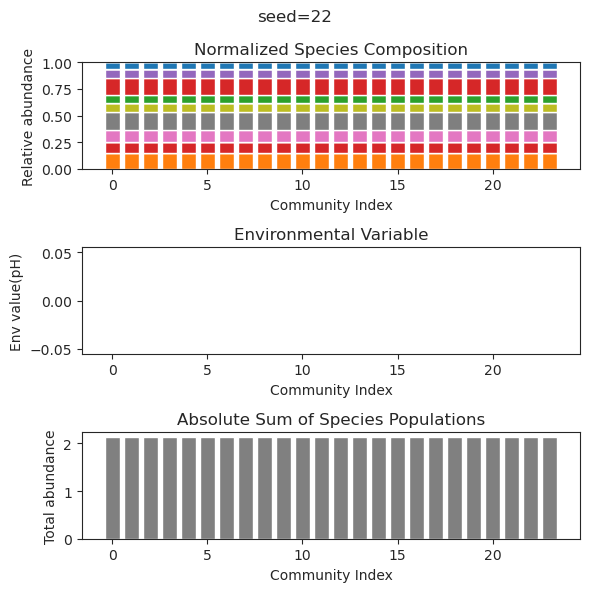

{'species': array([ 1.19932098e-41,  4.72965402e-02, -3.02824158e-35,  3.30667650e-01,
       -1.35123492e-36,  4.63182914e-14,  1.67156359e-01,  5.28497258e-13,
       -6.44707831e-40,  2.19292447e-01,  4.29070359e-01,  1.64747498e-01,
        4.84637896e-01, -4.50639626e-63,  1.28204647e-01, -9.27167272e-63,
       -4.15610595e-74,  4.92201339e-47, -5.36386583e-32, -4.83114621e-37,
        1.89725291e-01,  1.78509821e-01,  3.05183261e-38, -4.86509034e-56]), 'env': array([0.])}
{'species': array([-1.95995104e-071,  4.72965402e-002, -4.75485318e-115,
        3.30667650e-001,  1.39297726e-043,  3.62352710e-022,
        1.67156359e-001,  8.82635287e-014, -5.35536429e-082,
        2.19292447e-001,  4.29070359e-001,  1.64747498e-001,
        4.84637896e-001, -9.09082070e-095,  1.28204647e-001,
       -5.28912039e-102,  1.11755862e-129, -1.02185368e-064,
        1.78516929e-034,  3.45089588e-044,  1.89725291e-001,
        1.78509821e-001,  4.93652131e-041, -3.58548246e-091]), 'env': array([

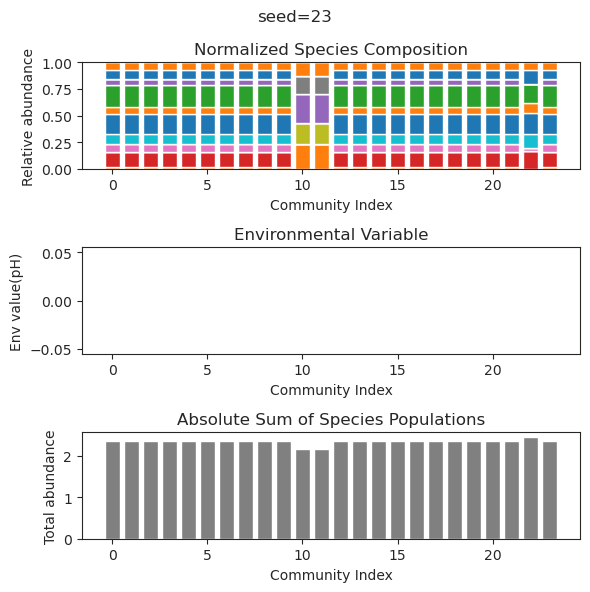

{'species': array([-1.24108254e-207, -7.76316214e-139,  1.63447693e-092,
       -3.67179966e-121,  3.46910863e-019,  1.19090542e-169,
        5.31658312e-001,  3.59917482e-103, -1.27827423e-156,
        6.02758603e-002, -5.08600339e-158,  3.39034450e-002,
        4.69311190e-001,  6.65417617e-002,  2.18739169e-147,
        3.16386186e-001,  2.03261941e-001, -1.22410659e-036,
        5.66425739e-155, -1.88900838e-038,  1.98061233e-001,
        7.95191391e-155,  2.90553422e-001,  6.06342590e-133]), 'env': array([0.])}
{'species': array([-1.25876367e-105,  3.48907752e-120,  1.41494563e-071,
       -3.28126326e-131,  2.24601723e-032, -1.71084671e-071,
        4.69408004e-001, -4.25269274e-139, -8.20254227e-138,
        1.00542840e-002,  4.60615008e-142, -4.35997223e-083,
        4.94322134e-001,  1.30340867e-001,  2.94457312e-075,
        3.19110780e-001,  2.69256314e-001, -2.54919527e-140,
        1.63807852e-134,  1.30891650e-019,  1.75518058e-001,
        1.22684669e-115,  2.77011583e-0

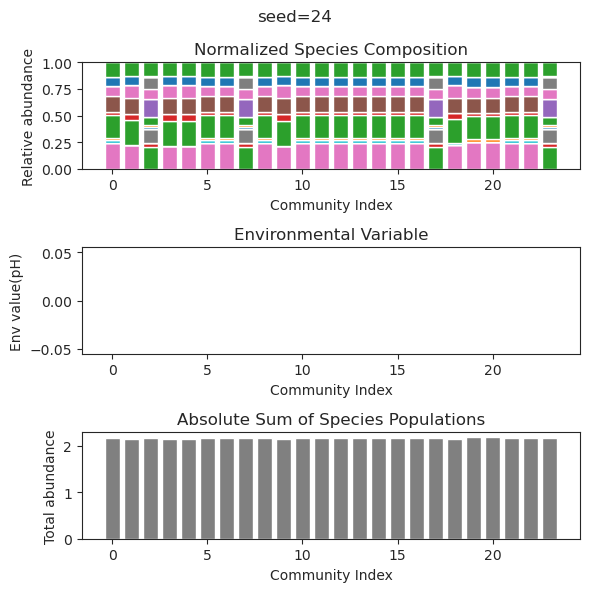

{'species': array([ 3.52982607e-258,  5.05194577e-237,  4.52931498e-001,
        6.33415687e-002,  3.67004969e-038, -2.69269509e-037,
       -9.79810599e-030,  2.94557813e-001,  1.13825892e-154,
        6.67704436e-072,  3.94475900e-002,  4.41373561e-002,
        1.58032722e-001,  5.71328434e-003,  3.74769713e-001,
       -5.40118865e-155,  1.97583348e-001,  2.44938424e-001,
        6.89534883e-067,  1.13158694e-080,  1.89716012e-029,
        1.52188924e-002,  2.82825480e-001,  3.15523903e-304]), 'env': array([0.])}
{'species': array([ 1.31347955e-001,  9.19412160e-046, -5.35108871e-034,
        2.68698095e-001,  3.50971736e-001,  2.82343005e-091,
        4.82952113e-001,  2.81695363e-001, -2.58549081e-027,
       -2.40212764e-071,  1.58646402e-001, -4.25226360e-066,
        1.21226842e-053, -2.97896989e-084,  1.76613317e-001,
       -1.29618234e-024,  8.95284902e-002, -1.12153644e-067,
       -3.97251395e-108, -2.06322222e-031, -1.36873352e-074,
        1.91092955e-001,  1.51233332e-0

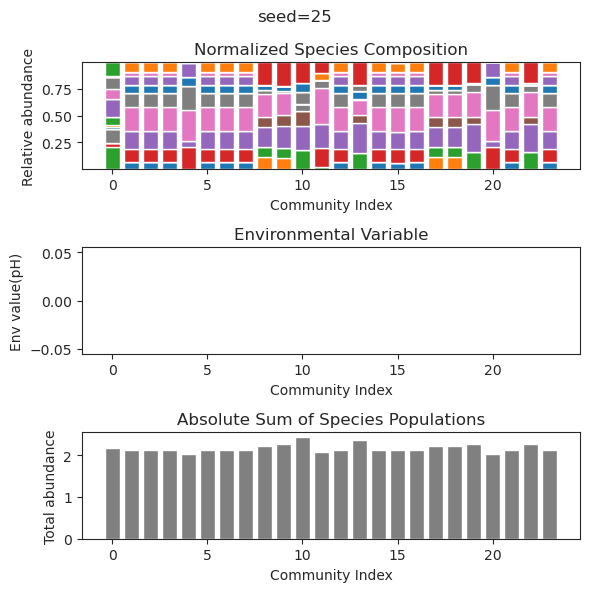

{'species': array([4.39630224e-222, 8.28364771e-170, 1.45303657e-041, 1.51809365e-001,
       3.12163974e-002, 2.95102171e-001, 3.46857729e-001, 1.40424496e-114,
       3.76850588e-001, 3.78680861e-158, 1.89695844e-003, 1.51898694e-001,
       7.46909154e-185, 1.05872320e-028, 3.16139631e-052, 1.85466983e-007,
       1.64804170e-001, 8.39399261e-096, 1.03592726e-019, 6.59129860e-048,
       1.67842602e-265, 3.96375421e-001, 5.08937132e-165, 3.71618073e-001]), 'env': array([0.])}
{'species': array([ 4.40403957e-029,  6.73997392e-030, -3.16118675e-057,
        1.56019373e-001,  3.22608514e-002,  2.92219587e-001,
        3.40567620e-001, -4.18084356e-104,  3.77829211e-001,
       -8.31185945e-028,  3.75263735e-005,  1.50522552e-001,
       -1.59276297e-030,  7.99480486e-039,  8.68384479e-040,
       -5.05993452e-028,  1.75520780e-001, -2.95059213e-094,
        3.18393578e-047, -1.59038207e-070,  7.00085787e-181,
        3.95118501e-001,  1.52608514e-031,  3.62428211e-001]), 'env': array([

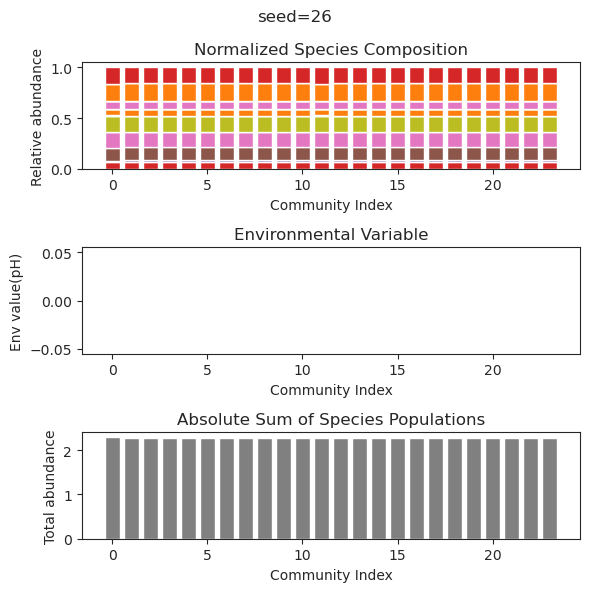

{'species': array([1.08750243e-001, 2.16667825e-001, 4.94065646e-324, 2.73443936e-115,
       1.39779181e-190, 2.98415650e-321, 3.89112691e-211, 4.53890711e-140,
       1.89220396e-002, 2.64967905e-301, 4.94939756e-001, 7.43044687e-058,
       1.45902916e-073, 7.48032477e-237, 8.09658529e-004, 2.04965914e-001,
       2.30977115e-075, 7.90944824e-002, 2.05071715e-001, 3.43931754e-001,
       3.07010767e-001, 1.16018911e-002, 4.53151924e-002, 1.05404335e-053]), 'env': array([0.])}
{'species': array([ 1.07905035e-001,  2.16690995e-001,  9.88131292e-324,
        8.00324309e-131,  4.17041177e-178, -1.97626258e-323,
        1.82524029e-228,  1.23060887e-141,  1.90712396e-002,
        1.11430042e-310,  4.94502709e-001,  8.76945563e-067,
        1.00428048e-066,  2.06373915e-257,  8.03351634e-004,
        2.05938377e-001,  5.03334970e-087,  8.14004022e-002,
        2.03626003e-001,  3.43762041e-001,  3.05582840e-001,
        1.16082824e-002,  4.54403336e-002,  3.48954948e-060]), 'env': array([

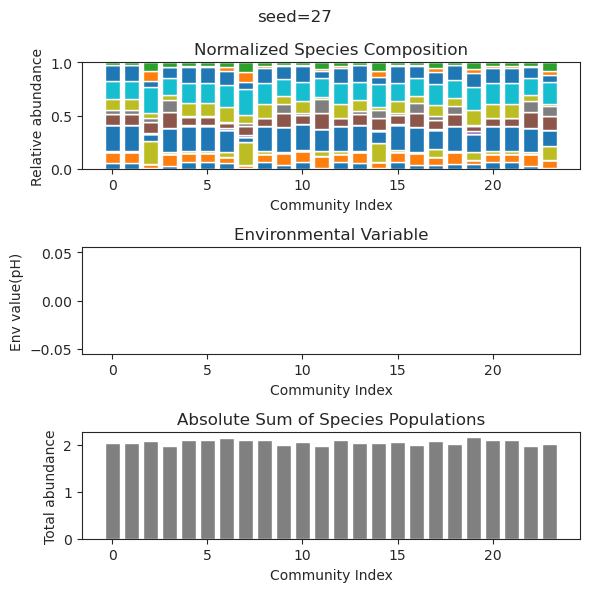

{'species': array([-1.69017005e-049, -1.55285086e-025,  4.28550108e-001,
       -3.46861651e-042,  1.78457761e-002,  3.68142013e-001,
        6.90675566e-002, -4.06777979e-096,  2.58526250e-069,
       -5.07102244e-028,  2.71508891e-001,  4.58511844e-001,
       -4.31175094e-051, -9.07274905e-106,  1.94856448e-079,
        5.47002153e-115, -3.39446676e-100,  1.58920847e-001,
        3.37471287e-109,  1.66659764e-097,  2.94460159e-002,
       -6.61106877e-089,  3.55296936e-121,  5.59689932e-001]), 'env': array([0.])}
{'species': array([ 2.78679543e-048, -1.38157615e-028,  4.28550108e-001,
       -1.08005280e-040,  1.78457761e-002,  3.68142013e-001,
        6.90675566e-002, -4.15658405e-107, -8.16728880e-071,
        1.78104712e-033,  2.71508891e-001,  4.58511844e-001,
       -5.90941905e-052,  6.36279866e-116, -1.40502858e-090,
        1.08029141e-129, -1.00062843e-105,  1.58920847e-001,
       -5.24810384e-122, -1.30016949e-103,  2.94460159e-002,
       -3.57663298e-096,  1.07650898e-1

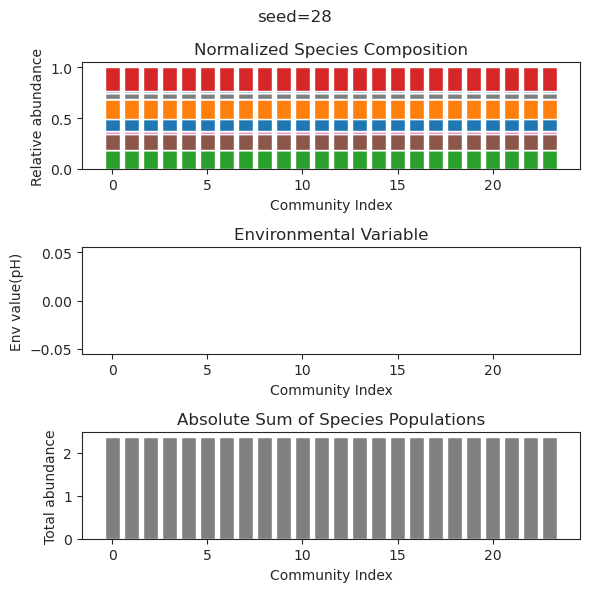

{'species': array([2.45537301e-001, 5.29329483e-139, 1.39018951e-001, 2.18510508e-115,
       4.94065646e-324, 1.44589469e-044, 2.63945439e-001, 3.76156805e-006,
       9.92394029e-004, 0.00000000e+000, 3.37037696e-077, 2.72936962e-001,
       3.39362068e-001, 1.55174182e-001, 6.33701471e-003, 6.01350146e-002,
       2.90865639e-291, 1.37344754e-001, 2.20264292e-240, 0.00000000e+000,
       3.66142662e-001, 5.09867126e-179, 1.03676504e-124, 1.84995129e-001]), 'env': array([0.])}
{'species': array([ 1.59054369e-201,  1.23901962e-075,  1.86714085e-031,
        6.63911873e-002,  9.60529232e-144,  1.39395630e-001,
        2.47336380e-002,  4.03943623e-003,  5.43995508e-003,
        8.82460985e-002,  5.08343353e-001,  3.15470327e-002,
        6.37356485e-014,  1.07557422e-001,  2.37876605e-001,
        2.86504007e-065,  4.34685909e-222,  1.02626622e-002,
        3.59722555e-047, -9.88131292e-324,  2.03224850e-001,
        1.77582366e-001,  1.22283633e-087,  4.06022533e-001]), 'env': array([

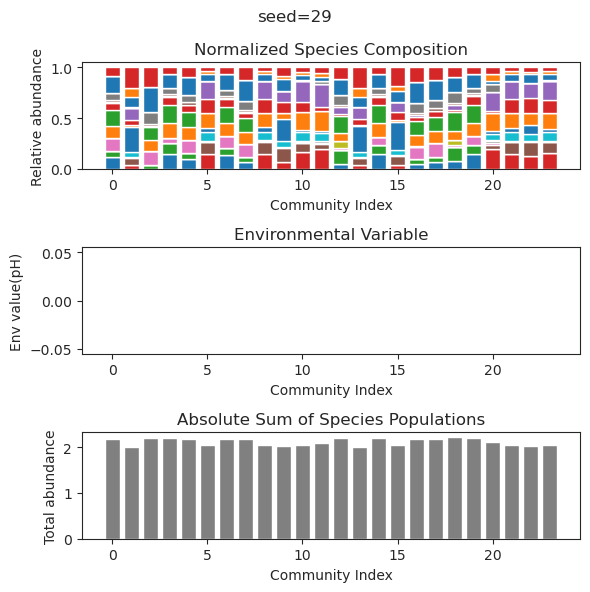

{'species': array([ 8.20255818e-055, -1.05770992e-149,  1.86535314e-002,
        1.14996311e-180,  5.63167996e-002,  2.24404093e-055,
       -7.50261499e-202, -6.90730469e-232,  9.62120203e-038,
        3.57361437e-001,  1.31354344e-001,  1.38367268e-001,
        5.02659539e-001,  7.32459283e-002, -1.00323053e-220,
        7.29992480e-087,  8.47887234e-094,  1.93802574e-118,
       -1.67331625e-221,  3.17101117e-002,  2.20520600e-002,
        3.84624786e-001,  2.06530631e-001,  3.47610343e-001]), 'env': array([0.])}
{'species': array([-2.60974132e-049, -5.04376390e-092,  1.86535314e-002,
        1.76941711e-033,  5.63167998e-002, -1.64544983e-049,
       -2.65687258e-117, -7.97006520e-129,  1.67474991e-040,
        3.57361437e-001,  1.31354344e-001,  1.38367267e-001,
        5.02659539e-001,  7.32459278e-002, -1.11311828e-127,
       -6.16567284e-068, -1.92348292e-049, -3.76112678e-077,
        2.94391563e-127,  3.17101116e-002,  2.20520597e-002,
        3.84624786e-001,  2.06530631e-0

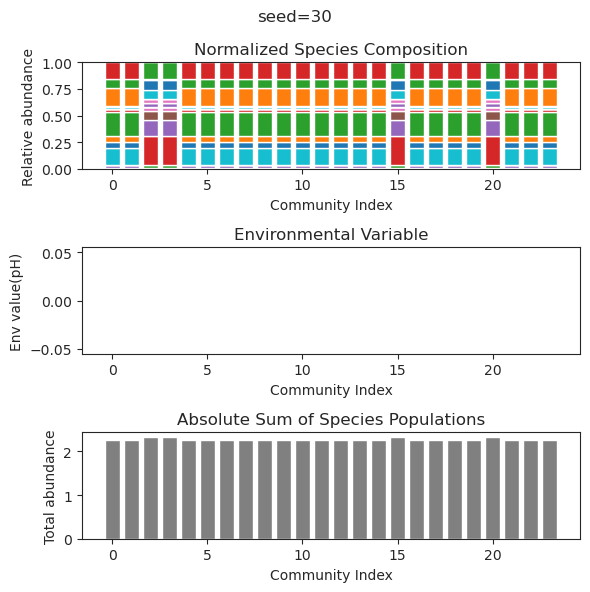

{'species': array([ 6.95591387e-001,  4.36988673e-031, -3.36155293e-031,
        2.11840343e-149,  0.00000000e+000,  2.34432517e-001,
        5.30255049e-222,  3.84645651e-001,  2.58726285e-002,
       -1.74064939e-272,  3.10106269e-001,  4.23474902e-031,
        1.23995529e-001, -2.61228169e-167,  4.74794799e-027,
        4.72539798e-244, -6.02586337e-115,  3.89704588e-001,
        1.52294532e-175,  1.25469842e-003,  1.78610574e-295,
        4.02692966e-001,  4.09252210e-169, -5.56851348e-284]), 'env': array([0.])}
{'species': array([ 6.66785106e-001,  7.16828972e-045, -1.40110426e-080,
        1.21678976e-155,  0.00000000e+000,  2.31618134e-001,
        5.05124642e-214,  3.75859772e-001,  4.24678963e-002,
        3.79640493e-046,  2.98250223e-001, -9.70619177e-043,
        1.30272222e-001,  2.89373748e-161, -1.33762154e-027,
       -2.51326150e-238,  2.90990118e-118,  3.70423806e-001,
        5.57487258e-041,  3.46416177e-002,  1.85543175e-295,
        3.87875454e-001,  5.09440030e-1

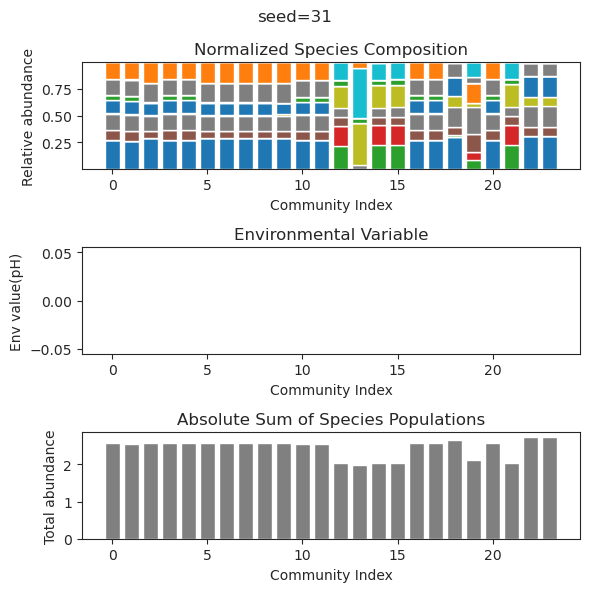

{'species': array([ 8.15818168e-38,  3.45062109e-02,  1.27476793e-26, -1.52615344e-37,
        2.77976463e-01,  1.36049134e-36,  4.26825496e-01,  2.12268999e-01,
        3.06632113e-52, -1.50970601e-51, -1.53960960e-53,  3.84683002e-22,
        1.83004508e-38,  7.55340398e-36,  3.84347315e-62, -1.15120564e-54,
        2.15668370e-50,  8.57694551e-38,  5.21284093e-01, -1.90111036e-44,
        3.71608140e-01,  3.77991012e-01, -4.18909329e-54,  1.11689441e-01]), 'env': array([0.])}
{'species': array([-4.32018046e-050,  3.45062109e-002, -5.95858091e-029,
        6.38456510e-071,  2.77976463e-001, -7.16212365e-048,
        4.26825496e-001,  2.12268999e-001, -3.16058414e-080,
       -6.10888004e-069, -1.18525795e-070,  1.40205161e-022,
       -4.34693902e-048, -7.09660141e-049,  1.61385806e-104,
        6.89267075e-071,  3.35397620e-067, -1.42142940e-048,
        5.21284093e-001,  1.21568805e-065,  3.71608140e-001,
        3.77991012e-001,  6.40805782e-079,  1.11689441e-001]), 'env': array([

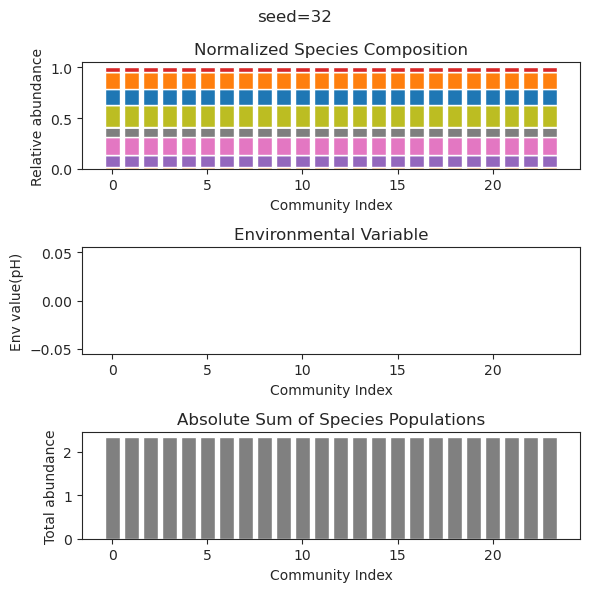

{'species': array([ 1.93075001e-083,  1.78267914e-073,  3.29411280e-015,
        3.50494427e-073,  6.54457984e-130,  7.29710238e-002,
       -2.36227741e-050,  5.69928439e-001,  1.36329861e-001,
        1.28299325e-071,  7.95311979e-099, -2.72039059e-039,
       -2.62341940e-141,  1.17137548e-001,  6.52396541e-073,
        7.95332368e-066,  2.43669685e-021,  1.27667989e-051,
        1.18819388e-062,  2.57263195e-001, -1.37039810e-123,
        1.59053943e-001,  4.90265594e-001,  2.01703306e-001]), 'env': array([0.])}
{'species': array([ 5.53428922e-01,  2.56522862e-01,  2.51656533e-01,  3.28849217e-61,
        2.05813806e-51,  7.73835608e-53,  1.69539427e-01, -1.45715668e-19,
        1.21239235e-23,  1.49129605e-30,  4.64937699e-27,  5.15989705e-27,
       -2.06858997e-40,  2.90792414e-50,  2.58909797e-01, -3.53067047e-37,
        4.05954324e-60, -7.02280881e-21,  6.27065833e-59,  1.96492433e-01,
       -2.22026240e-42,  1.74961655e-27,  4.64456070e-02,  4.52269632e-01]), 'env': array([

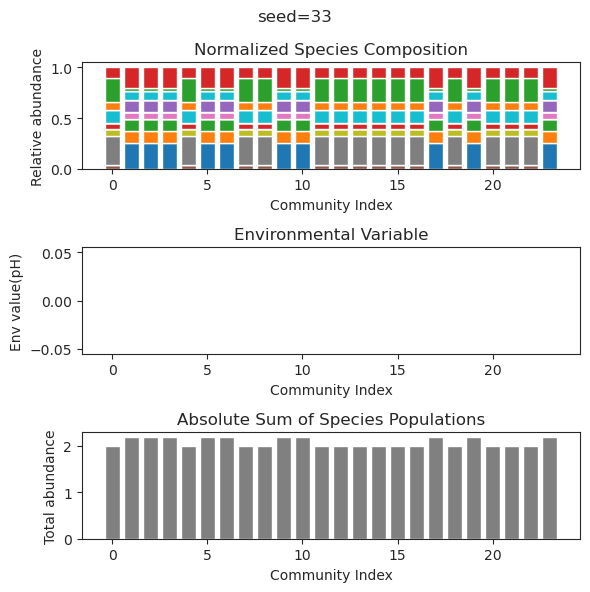

{'species': array([ 3.90769320e-167, -7.37793845e-076,  1.81661741e-015,
        2.03631598e-256,  2.44055552e-242,  4.01058349e-001,
        3.80893956e-001,  4.25963316e-001, -3.08141377e-128,
       -1.33947353e-184, -1.92693062e-189, -9.48211987e-077,
        3.96749015e-165,  1.52085870e-001,  2.40338513e-034,
        2.94226217e-225,  1.55151787e-001,  1.16427066e-001,
        2.89017244e-172,  4.88103643e-022,  2.33542877e-114,
        3.73007050e-001,  3.46140270e-001,  9.42706486e-002]), 'env': array([0.])}
{'species': array([-8.07439396e-254,  2.34422574e-073,  3.40738619e-021,
        0.00000000e+000,  0.00000000e+000,  4.01058347e-001,
        3.80893957e-001,  4.25963315e-001,  2.47154727e-181,
        5.38579988e-274, -5.40491914e-291,  2.32566316e-084,
       -2.75301732e-239,  1.52085869e-001,  2.43566411e-031,
        0.00000000e+000,  1.55151789e-001,  1.16427066e-001,
       -2.44008284e-272,  6.02448319e-021,  2.57851142e-149,
        3.73007049e-001,  3.46140270e-0

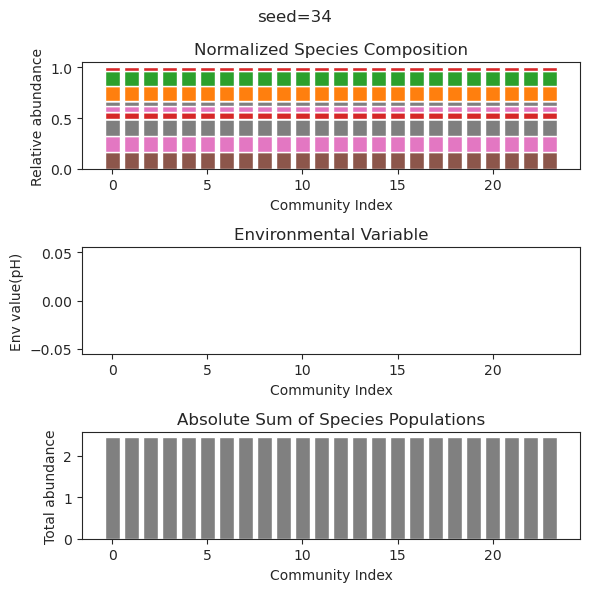

{'species': array([-2.49114973e-058, -1.18445150e-088,  5.69013628e-001,
       -3.97344440e-133,  2.06671715e-090, -2.20238308e-072,
        4.13834856e-088,  2.65377588e-042,  6.44770002e-002,
        1.80151162e-127,  7.61269053e-069, -7.43183323e-072,
        4.96211918e-001,  6.89054988e-067,  2.00540578e-040,
       -4.52121550e-021,  3.42661029e-001,  7.88227473e-059,
        6.38526222e-001,  7.48487543e-116,  9.54921198e-011,
        2.52676660e-001,  6.43357285e-120,  1.30139498e-115]), 'env': array([0.])}
{'species': array([ 4.23378898e-57,  1.32954127e-67,  5.69013628e-01, -4.60175853e-71,
       -7.52415361e-61,  1.53252173e-61, -2.14582799e-57, -2.26489871e-42,
        6.44770002e-02,  5.50329625e-32, -2.35961016e-56,  6.95708910e-38,
        4.96211918e-01,  5.74821192e-49, -2.00473410e-40, -4.01112448e-24,
        3.42661029e-01, -4.54210622e-56,  6.38526222e-01, -1.61837322e-66,
        9.39550060e-11,  2.52676660e-01, -8.10874980e-71, -1.99166570e-72]), 'env': array([

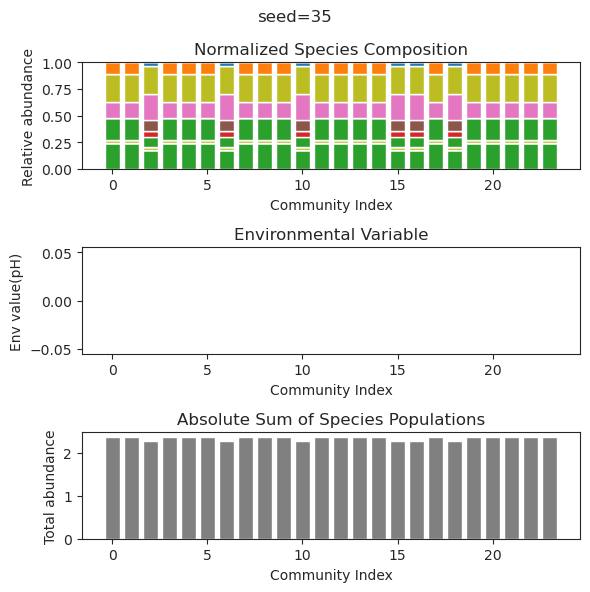

{'species': array([ 1.62244363e-44,  4.35641778e-01, -2.65213809e-43,  3.24738500e-47,
        4.24622753e-01,  1.75875860e-49, -1.98770306e-43,  2.09868960e-50,
        6.51575679e-01, -2.09590461e-40, -8.77411410e-48,  3.40976058e-01,
        8.75303966e-23,  6.07494305e-24,  6.19876234e-01,  1.44303250e-20,
        3.80448480e-28, -7.66564670e-46, -1.43057373e-41,  4.78099974e-01,
        1.61282729e-30,  9.34684110e-49, -3.95175377e-40,  6.28246070e-20]), 'env': array([0.])}
{'species': array([ 4.42567777e-40,  4.35641778e-01,  7.25652114e-38, -3.16787727e-35,
        4.24622753e-01, -4.52686768e-40, -4.28654075e-34,  1.47860240e-43,
        6.51575679e-01,  3.85711872e-38,  1.30933380e-37,  3.40976058e-01,
        4.81161260e-22,  1.14547517e-22,  6.19876234e-01,  5.19276353e-20,
        1.59796193e-26,  1.68289109e-37,  2.45021919e-36,  4.78099974e-01,
        5.31562901e-27,  1.84940242e-41,  9.45187833e-36,  2.58463239e-19]), 'env': array([0.])}
{'species': array([-6.24891740e-

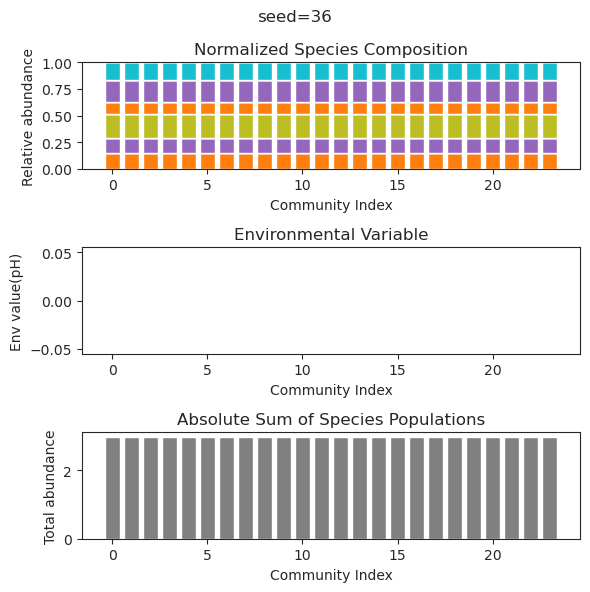

{'species': array([ 6.65854853e-056,  7.61822066e-002, -4.94065646e-324,
        1.37127362e-001,  1.97202455e-159,  1.73357590e-001,
        2.94211658e-108,  3.24516791e-001,  2.73654114e-001,
        4.09473424e-002,  3.57974712e-002,  2.09828518e-046,
        1.41982201e-001,  5.47706313e-119,  1.46880042e-001,
        3.63160289e-001,  5.42143934e-002,  2.43853455e-001,
        1.45270710e-021, -4.94065646e-324,  4.37396766e-156,
        4.71631356e-002,  2.24766791e-114,  9.71261585e-116]), 'env': array([0.])}
{'species': array([ 5.03047795e-050,  7.61822002e-002, -1.33983277e-257,
        1.37127368e-001,  5.76947950e-141,  1.73357591e-001,
        5.23615547e-100,  3.24516790e-001,  2.73654116e-001,
        4.09473434e-002,  3.57974725e-002,  5.28676281e-028,
        1.41982204e-001,  9.77053539e-119,  1.46880044e-001,
        3.63160287e-001,  5.42143947e-002,  2.43853451e-001,
        1.40378025e-017, -1.04411192e-234,  6.17650305e-139,
        4.71631336e-002,  1.46351472e-1

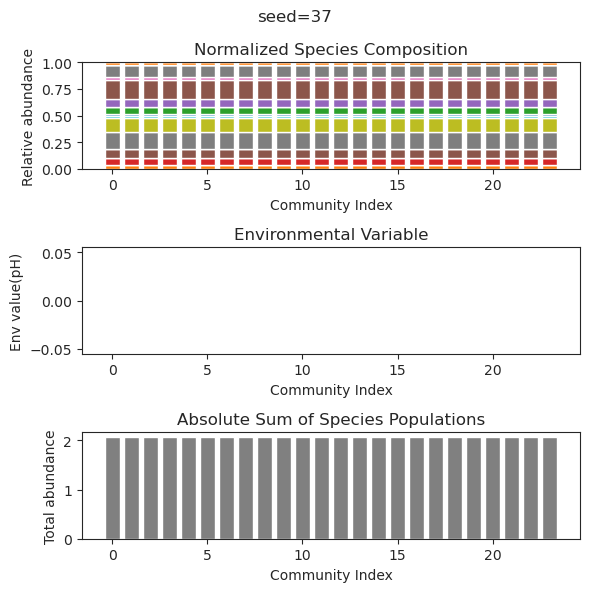

{'species': array([ 3.99107071e-030,  7.16305133e-002,  1.31754713e-001,
        2.17975089e-002,  2.09344135e-001, -3.30055496e-035,
        3.85261995e-001,  3.41779492e-001,  1.90739717e-033,
        5.01287753e-164,  4.45003612e-001,  2.05695654e-001,
       -1.57215655e-113,  2.38001515e-204,  1.78708067e-001,
       -2.00025932e-064, -2.68524163e-029,  4.04090654e-029,
        1.26653248e-008,  2.11413559e-001, -9.54988822e-215,
        6.38260963e-172, -2.75682545e-129, -1.28604189e-196]), 'env': array([0.])}
{'species': array([ 1.46827060e-030,  7.16305036e-002,  1.31754713e-001,
        2.17975240e-002,  2.09344135e-001,  1.35068497e-094,
        3.85261995e-001,  3.41779493e-001, -3.21122321e-035,
        5.11678393e-150,  4.45003605e-001,  2.05695649e-001,
        4.27387939e-033, -7.44116956e-182,  1.78708065e-001,
       -8.82831006e-038, -1.08460230e-078, -3.35937500e-031,
        1.82859401e-008,  2.11413560e-001, -2.82480455e-197,
        2.96778197e-153,  7.59169151e-1

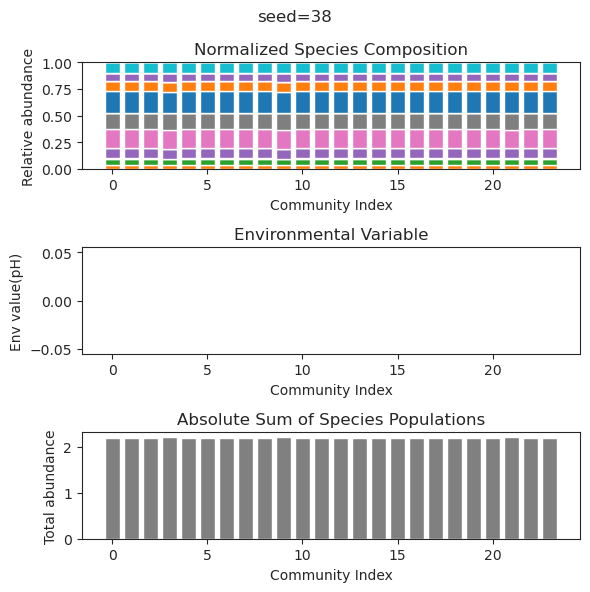

{'species': array([ 2.65889579e-87,  5.64911941e-01, -1.65646712e-37, -7.21120016e-35,
       -5.02943655e-51,  6.06998160e-01, -1.74842678e-93, -3.30652764e-14,
       -1.01195610e-83,  3.76947944e-46,  1.16969863e-97, -4.75700735e-83,
        1.65784430e-18,  2.44057053e-72,  3.98984471e-01, -2.92733453e-91,
       -2.99048080e-50,  3.35807546e-01,  3.01953591e-43,  1.80365076e-01,
       -6.23719864e-98,  6.06601770e-55,  6.64004110e-66,  9.89934055e-02]), 'env': array([0.])}
{'species': array([-1.40540386e-63,  5.64911941e-01,  7.55170147e-36,  3.87033978e-32,
       -1.23465956e-44,  6.06998160e-01, -9.14006486e-66,  8.82139182e-17,
       -3.95144415e-58, -2.61152313e-40, -9.68369670e-68, -1.75967591e-58,
        4.46845886e-22, -4.74629735e-39,  3.98984471e-01, -1.28869633e-64,
       -5.70738209e-44,  3.35807546e-01, -2.49999834e-38,  1.80365076e-01,
       -5.26749266e-67,  1.03817658e-43,  8.70109391e-49,  9.89934055e-02]), 'env': array([0.])}
{'species': array([ 9.69381756e-

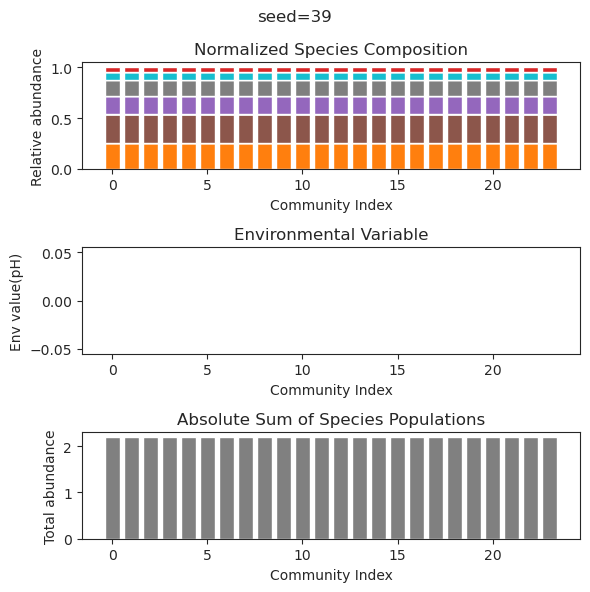

{'species': array([2.80872520e-192, 1.19017061e-001, 2.51641403e-236, 3.90525730e-001,
       6.66866668e-002, 5.58270202e-002, 2.40541702e-001, 1.21502778e-001,
       5.87439323e-001, 6.37237965e-318, 1.35108409e-001, 4.15682607e-066,
       2.99626160e-001, 1.44893415e-308, 3.10519297e-050, 5.38529571e-016,
       2.52839984e-206, 2.43514228e-315, 1.00533773e-039, 1.02807613e-080,
       9.84838982e-002, 2.25756851e-084, 3.82656694e-197, 4.17299702e-278]), 'env': array([0.])}
{'species': array([ 5.67579302e-192,  1.19006413e-001,  2.18807749e-236,
        3.90537588e-001,  6.67022417e-002,  5.58220635e-002,
        2.40549110e-001,  1.21505909e-001,  5.87426445e-001,
        8.14344689e-318,  1.35092733e-001,  1.86699602e-068,
        2.99603554e-001,  1.19903634e-028, -3.68543462e-028,
        1.30426990e-018,  1.42455184e-202,  4.06259306e-316,
        2.73911988e-043,  9.82535045e-079,  9.85040977e-002,
        5.83247698e-089,  6.73610150e-196,  6.26674890e-279]), 'env': array([

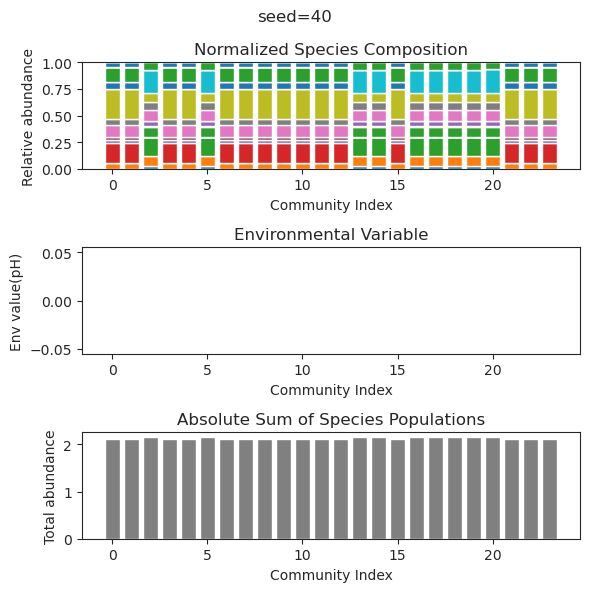

{'species': array([ 5.32926481e-40,  5.86738741e-61, -6.74669595e-57,  8.53090880e-36,
        2.38201146e-01,  6.24055646e-01,  2.10869230e-15,  4.50406973e-46,
       -1.02853016e-32,  1.83923905e-01,  1.84018313e-39, -6.44694995e-18,
        1.41865558e-53,  3.42704043e-01,  4.50294158e-34, -1.84362277e-58,
       -2.00102031e-49,  4.78024263e-56,  6.05716021e-01, -5.92109836e-27,
       -3.18405123e-47,  1.71988392e-39,  5.06775100e-01, -3.93095449e-26]), 'env': array([0.])}
{'species': array([-1.64196386e-41,  9.34011624e-41,  1.78741551e-63, -1.67447062e-47,
        2.38201146e-01,  6.24055646e-01,  6.56939520e-24, -3.56659495e-67,
       -1.35705264e-41,  1.83923905e-01, -4.62315593e-42,  3.04328275e-16,
        9.89255242e-68,  3.42704043e-01, -3.79527629e-43,  2.13034868e-69,
       -5.98099753e-59,  2.11938186e-74,  6.05716021e-01, -2.16922743e-34,
        6.85078149e-62,  1.92542801e-41,  5.06775100e-01,  5.19312983e-39]), 'env': array([0.])}
{'species': array([-1.00130605e-

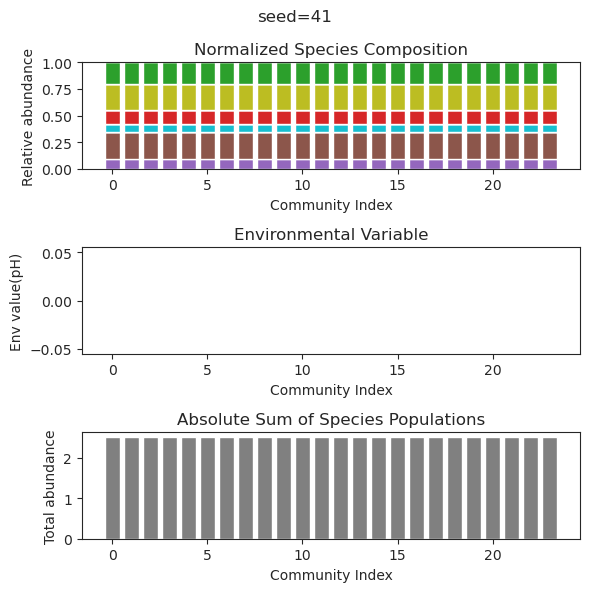

{'species': array([ 1.65215286e-001, -1.58841146e-054,  1.59109231e-123,
        2.02158934e-001,  1.81902465e-001,  1.05426167e-067,
        1.19142385e-001,  2.30089761e-001,  3.62624078e-123,
        7.06300145e-112,  4.51899375e-002, -1.08351740e-081,
        3.66650279e-001, -3.24178798e-082,  1.93353053e-002,
        1.54260427e-001,  1.24580769e-135,  1.66121762e-155,
       -5.16585346e-060,  4.84871321e-001, -1.71298943e-051,
       -1.14793073e-105,  1.44387767e-153,  5.32540590e-021]), 'env': array([0.])}
{'species': array([ 1.65215286e-001,  9.33898621e-061, -5.22155972e-200,
        2.02158934e-001,  1.81902465e-001, -2.24964560e-093,
        1.19142385e-001,  2.30089761e-001, -3.58746114e-199,
       -1.33670435e-162,  4.51899375e-002,  1.80788898e-106,
        3.66650279e-001, -4.26129099e-102,  1.93353053e-002,
        1.54260427e-001,  1.97906262e-247, -8.22168809e-254,
       -4.68406228e-076,  4.84871321e-001,  1.09656801e-054,
        2.47958085e-165, -1.03339168e-2

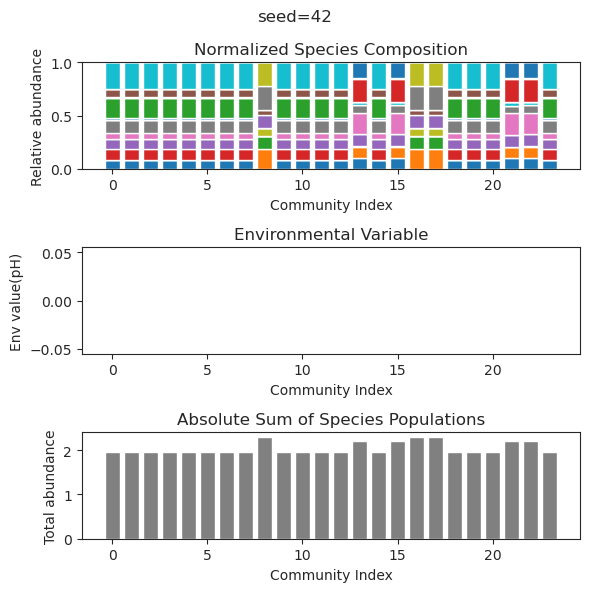

{'species': array([-4.44109633e-094,  7.72083765e-001,  1.99424170e-135,
       -1.86146652e-083,  5.44339617e-045,  5.65434934e-138,
        7.16137694e-001,  6.61523781e-128,  1.36293330e-063,
       -1.10829053e-103,  1.01268054e-127,  3.85938987e-026,
       -2.02546338e-096,  5.21949249e-019,  1.28779140e-014,
        8.50823697e-001, -7.56458069e-188,  3.03095890e-002,
       -1.94972363e-139, -5.08088543e-040,  2.31826979e-159,
        1.26531975e-082,  1.77396577e-015,  2.79519734e-001]), 'env': array([0.])}
{'species': array([ 5.95101310e-030,  6.95687444e-001, -3.63967449e-186,
       -1.15066341e-121, -3.38800167e-036, -2.24611873e-182,
        6.25480052e-001, -3.86478043e-162, -2.00482547e-028,
        2.69272933e-172, -8.47508125e-031,  2.28533872e-008,
        4.91258892e-030,  6.57406348e-002,  3.44391641e-006,
        8.39196898e-001,  1.24761132e-028,  6.88428313e-002,
        6.84001080e-126,  1.28015262e-040, -5.11782427e-168,
        8.74087974e-030,  3.62602904e-0

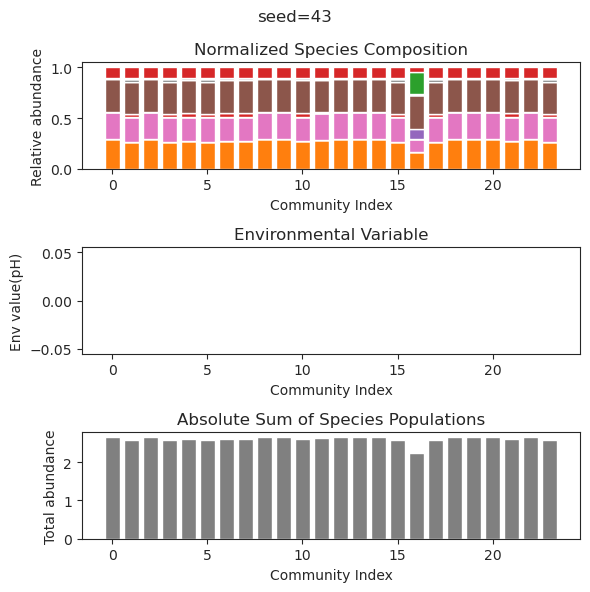

{'species': array([ 4.08832369e-01,  5.90659510e-01,  5.74760473e-28,  5.66623538e-01,
        6.90678332e-23, -1.27707644e-37,  1.08086213e-41, -3.56160160e-17,
       -1.37850703e-17,  4.60630118e-50,  2.34818623e-27,  9.36943668e-41,
        6.58603920e-69,  4.39049001e-01,  6.22834353e-02,  1.40357394e-66,
        2.93803158e-67,  2.96672418e-01,  2.79707899e-69, -2.64093073e-65,
        1.67619882e-67,  2.10979895e-45,  1.85240630e-48,  1.18815930e-67]), 'env': array([0.])}
{'species': array([ 4.08832369e-01,  5.90659510e-01,  1.22010490e-32,  5.66623538e-01,
        5.01279809e-27, -9.83714301e-40, -7.32097949e-48, -5.48467304e-24,
       -4.00031978e-23, -8.07074251e-57,  2.37191929e-33,  2.49159433e-48,
       -1.73184014e-74,  4.39049001e-01,  6.22834353e-02,  3.51234648e-77,
        2.88929451e-73,  2.96672418e-01, -2.65961323e-77, -1.31865347e-77,
        2.07447725e-76,  2.11991204e-53, -4.81966221e-58, -1.02047884e-72]), 'env': array([0.])}
{'species': array([ 4.08832369e-

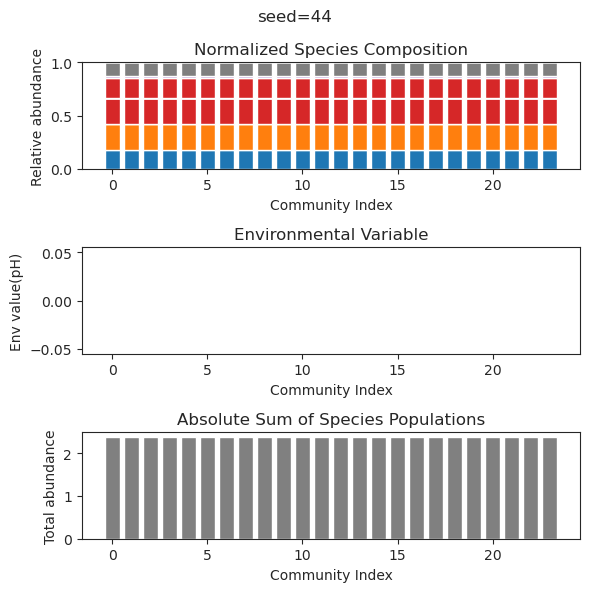

{'species': array([ 2.91373371e-083,  3.40513126e-001,  3.12200617e-001,
        2.25364603e-101,  4.31244121e-066, -1.97478746e-039,
       -9.88172980e-032,  1.39206012e-031,  2.25894744e-112,
        2.42144220e-093,  1.05466986e-001,  4.96381955e-071,
        1.93261247e-115,  3.31157039e-065,  5.43045336e-001,
       -2.73756592e-087, -1.03624192e-032,  2.84753308e-001,
       -9.15803741e-115, -3.82320475e-031,  6.73915400e-001,
       -1.79321044e-018,  1.31589541e-091,  2.21594908e-001]), 'env': array([0.])}
{'species': array([ 4.11239647e-66,  3.40513126e-01,  3.12200617e-01, -1.02283604e-76,
       -6.83630891e-58, -3.48990179e-41, -4.66108856e-31, -1.54168817e-16,
        4.44086792e-86, -4.36934701e-63,  1.05466986e-01, -1.22983433e-58,
        7.09217769e-85,  1.54371042e-51,  5.43045336e-01,  1.58655690e-65,
       -1.56382737e-39,  2.84753308e-01, -1.93624426e-86, -1.85627611e-33,
        6.73915400e-01,  2.75323090e-28,  2.61919091e-66,  2.21594908e-01]), 'env': array([

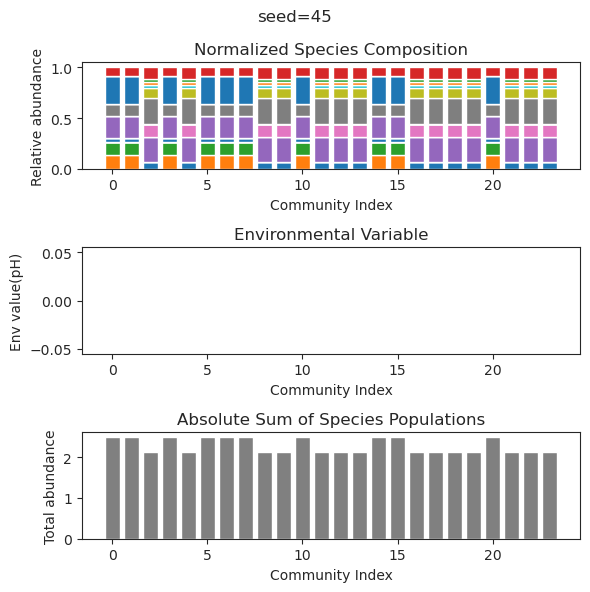

{'species': array([ 5.17432181e-003,  3.70153778e-001,  2.52860317e-001,
        1.62412648e-049,  2.04543006e-001,  2.66074658e-027,
       -1.67830515e-026,  1.91292529e-001, -7.65240879e-038,
        7.88641901e-089, -1.11290836e-039,  2.17055961e-002,
        2.41876321e-001,  4.56116442e-146,  2.49399028e-001,
       -1.81309239e-087,  2.69956190e-001,  1.76505834e-001,
       -1.02390408e-111,  2.13650088e-018,  2.22397886e-001,
        1.29425074e-001, -1.26898994e-158,  2.93235299e-002]), 'env': array([0.])}
{'species': array([-6.14015677e-065,  5.42821319e-001,  5.17332133e-067,
       -1.19233180e-051,  2.24873183e-032,  2.85256361e-001,
        2.02949722e-001,  4.40196452e-136,  1.93862176e-028,
        3.86321800e-033, -1.37368945e-150,  4.55229942e-002,
        2.49414638e-001,  5.11532539e-001,  1.03510925e-001,
        2.90684844e-022,  1.60449650e-002,  7.77918058e-023,
        6.53958414e-084,  2.22732699e-026,  8.67485383e-103,
        3.77614838e-001,  1.89736496e-0

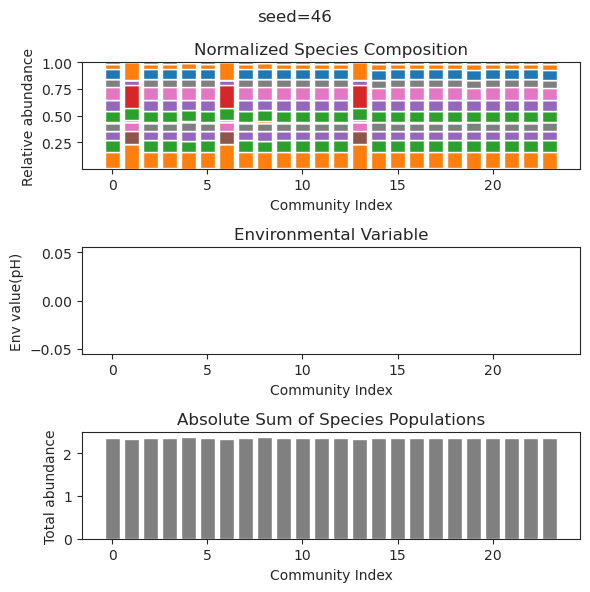

{'species': array([ 3.63591514e-001,  2.86108722e-027,  3.85076865e-001,
        3.49792508e-003, -7.78856145e-028, -1.25833182e-027,
        1.05867602e-026, -2.43687876e-029,  7.60740946e-002,
       -1.14115496e-153,  9.91339316e-095,  3.38845945e-001,
        5.60331938e-028,  2.36432887e-001,  4.43282665e-029,
        3.77304449e-001,  2.49797136e-001, -1.06862961e-130,
        4.77789386e-094, -8.50474992e-118,  5.63421876e-002,
        3.22787586e-063, -6.36595048e-041,  5.97799119e-044]), 'env': array([0.])}
{'species': array([ 4.13343819e-001,  1.49522979e-245,  4.50375176e-001,
        1.70143318e-001, -7.83989020e-248,  5.85181906e-184,
       -8.34729233e-049,  5.14772677e-088,  3.39273826e-019,
       -2.13879027e-300, -3.51873205e-204,  4.26429104e-001,
        4.34232536e-032,  1.36688530e-001, -1.22237183e-080,
        3.65960605e-001,  1.25948306e-001, -3.45838039e-256,
       -7.64000978e-268, -1.90072990e-228,  6.35182814e-003,
       -2.49780116e-086,  1.62635603e-0

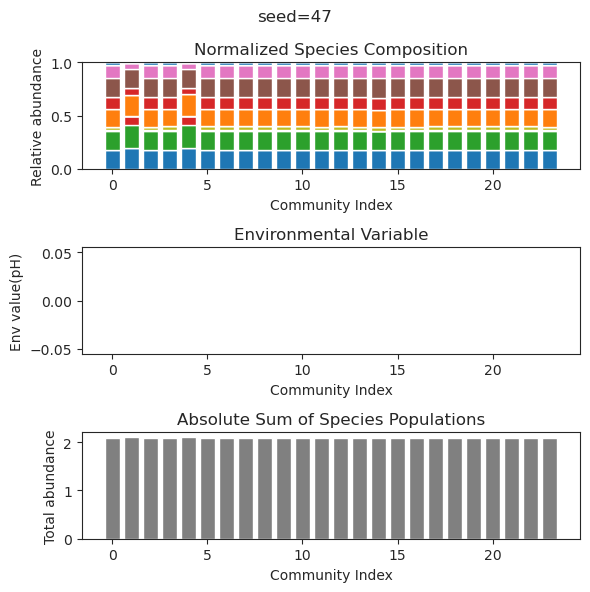

{'species': array([ 3.72437933e-01,  2.25575846e-61,  3.05873381e-01, -3.54329489e-26,
        1.27156545e-01, -5.79493887e-65,  3.66734428e-02,  6.55329049e-55,
        1.14806927e-01,  1.98786525e-64,  7.27858309e-03,  3.93912387e-01,
        1.83393643e-05,  8.60539448e-22, -1.91966689e-62, -3.38677173e-63,
        6.16644992e-28,  1.90398718e-01, -7.41850692e-28,  3.86030519e-01,
        6.44122298e-68,  1.39977035e-57, -3.35440342e-64,  2.06317265e-01]), 'env': array([0.])}
{'species': array([ 4.08283567e-001,  3.43301809e-027,  3.11455588e-001,
       -2.27229600e-026,  1.18890944e-001, -6.48903087e-033,
        6.97584355e-009, -2.69037693e-028,  1.00209057e-001,
        6.23260356e-084,  2.65395490e-002,  3.99493753e-001,
        2.06327869e-004,  1.86523825e-018, -5.21281853e-092,
        7.54880052e-079, -6.69831444e-032,  1.93638524e-001,
        1.24119349e-031,  3.94796250e-001,  3.06671356e-103,
       -1.18180277e-032, -2.31771218e-096,  2.09569436e-001]), 'env': array([

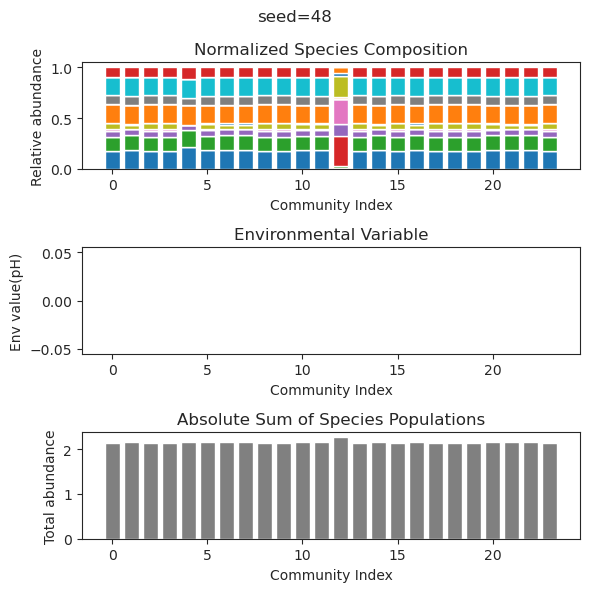

{'species': array([-1.03684020e-26,  3.93540611e-41,  1.09353459e-48, -5.68910635e-50,
        6.18001904e-54,  1.18516260e-16,  6.90337709e-49,  1.34085057e-49,
        2.06729731e-51,  6.87763149e-01,  1.57966878e-01,  1.70341343e-42,
        3.20842771e-24,  1.73927139e-39,  4.67990631e-01, -9.83591264e-29,
       -2.85883051e-40,  1.59318097e-40,  7.51718125e-49, -8.24009802e-32,
        1.96911842e-51,  5.46915845e-01,  3.91406859e-01,  4.02122814e-01]), 'env': array([0.])}
{'species': array([-2.75082614e-28, -4.90484898e-37, -1.10386957e-43,  1.02443079e-44,
        7.03532719e-42,  3.01731905e-16,  1.60674609e-41, -4.79192081e-46,
        6.01502054e-45,  6.87763149e-01,  1.57966878e-01, -3.60603291e-38,
        9.63020616e-25, -5.55401348e-34,  4.67990631e-01, -1.93241743e-28,
       -6.07131992e-35, -7.16266334e-38, -5.64858754e-43, -4.21105614e-32,
        1.98120125e-46,  5.46915845e-01,  3.91406859e-01,  4.02122814e-01]), 'env': array([0.])}
{'species': array([ 8.85267982e-

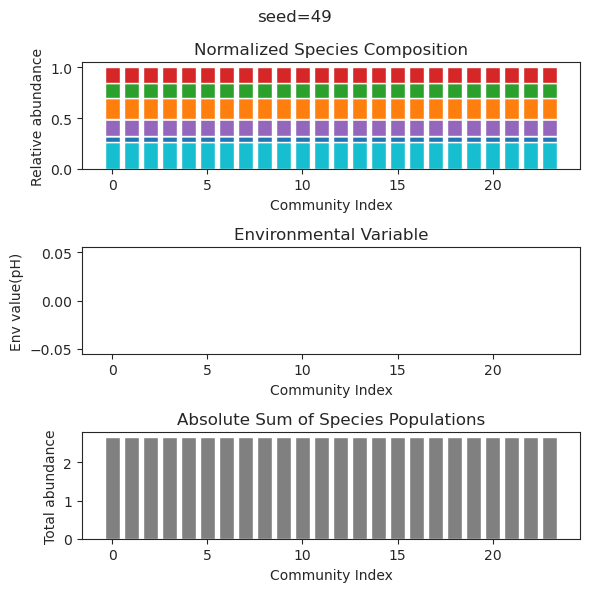

{'species': array([-6.91691904e-323, -3.95252517e-323,  2.39998267e-182,
        2.05403426e-001,  2.21919441e-001,  2.18634494e-069,
        1.17648389e-085,  5.61651705e-001,  1.54081081e-090,
        9.05581584e-002,  1.10608445e-150,  9.90397039e-159,
        5.98641905e-100,  1.06258617e-121,  2.77271747e-004,
        2.41437807e-257,  6.70129898e-002,  2.30726981e-001,
        3.80678319e-001,  2.22905953e-269,  4.41418907e-003,
        1.24128198e-007,  3.89452850e-001,  1.94063140e-074]), 'env': array([0.])}
{'species': array([ 1.63715778e-262,  1.18514417e-180,  1.48458612e-240,
        2.82328999e-001,  3.56678293e-058,  6.56015345e-017,
        5.68226266e-002,  6.19247115e-001,  7.66776930e-015,
        1.34442640e-009,  1.84840751e-025,  4.50803328e-082,
        4.98551429e-073, -9.33697064e-074,  1.29589820e-044,
       -6.07760071e-144, -1.81572047e-220,  3.70622861e-001,
       -6.93737584e-150,  1.70831760e-131,  6.93727110e-035,
        1.79222979e-099, -1.77394712e-0

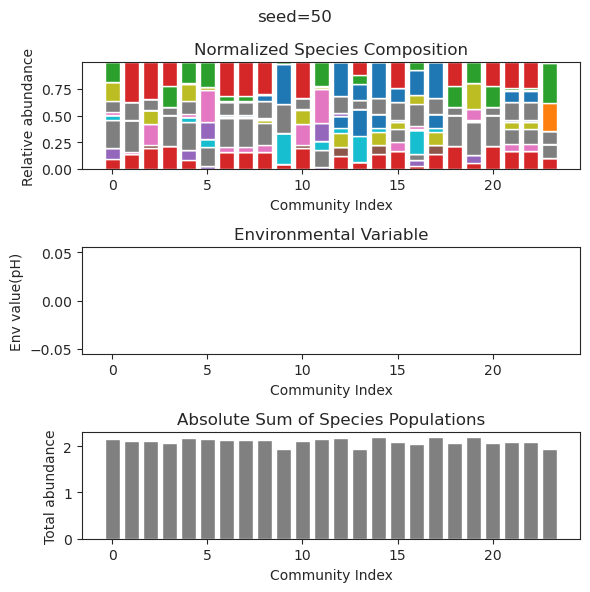

{'species': array([-8.25913838e-109,  1.56091374e-090,  1.88101070e-001,
        2.89690053e-001,  1.23796766e-002,  4.27022538e-002,
       -2.66274416e-183,  2.23446651e-001, -3.21402681e-152,
        2.43767513e-102,  6.01878569e-038,  9.97767466e-002,
        1.23098134e-001,  2.06680323e-001,  2.33560910e-001,
        3.84021040e-124,  1.27541746e-001,  7.39622252e-003,
        2.22091636e-102, -2.85546518e-027,  2.27181274e-181,
        2.34562432e-001,  3.91983458e-092,  4.16314285e-001]), 'env': array([0.])}
{'species': array([ 3.05656885e-121,  3.95135067e-091,  1.88862136e-001,
        2.88187758e-001,  1.09161458e-002,  5.54610125e-002,
        2.50959006e-241,  2.37300562e-001, -1.20358480e-203,
        3.59025108e-110,  1.09430397e-038,  9.30094854e-002,
        1.21552434e-001,  2.01996316e-001,  2.30102353e-001,
       -2.60817515e-149,  1.29274414e-001,  5.46760733e-003,
        2.27067906e-107,  6.88801905e-054,  1.07915125e-238,
        2.29079281e-001,  8.46669471e-0

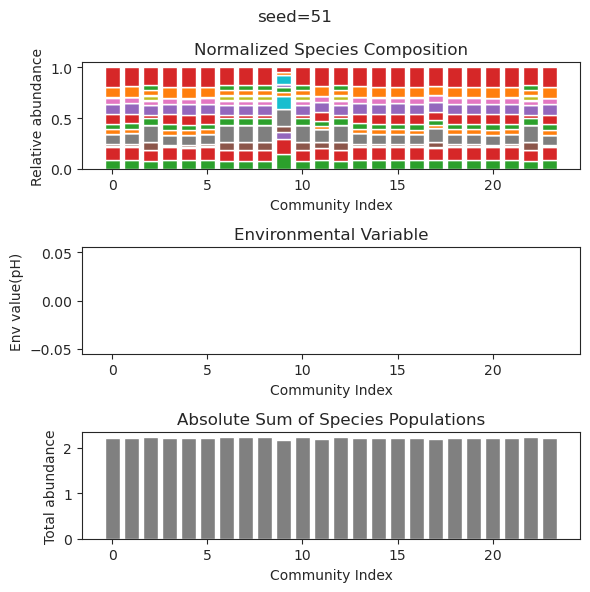

{'species': array([ 7.59204570e-054,  6.14852424e-034, -1.50467740e-033,
        8.40131800e-081,  4.30267363e-001,  3.60634535e-033,
       -2.96835240e-106,  4.14115313e-001,  4.68408298e-034,
       -2.66980972e-115,  3.65907796e-003,  3.30300192e-001,
       -8.49046317e-066,  3.80080201e-112,  2.57797845e-001,
        5.35912914e-002,  1.59242918e-065,  5.94591413e-080,
        4.45590358e-111, -8.57655878e-107,  5.23045934e-033,
       -7.20758356e-111,  6.63265755e-001,  2.80957771e-102]), 'env': array([0.])}
{'species': array([-8.04068100e-29, -8.25002234e-34,  4.11660953e-27,  3.75745492e-30,
        4.30126950e-01,  4.32842431e-28, -1.54922939e-28,  4.14600276e-01,
        6.38189016e-33, -2.55649074e-90,  2.39185386e-03,  3.30529525e-01,
        1.25199083e-33, -1.12316059e-85,  2.57457555e-01,  5.32681392e-02,
        3.38665832e-52,  3.70059138e-30, -1.68333813e-84, -3.21943146e-99,
        6.04930761e-34, -7.81312095e-29,  6.63991337e-01,  1.79305005e-77]), 'env': array([

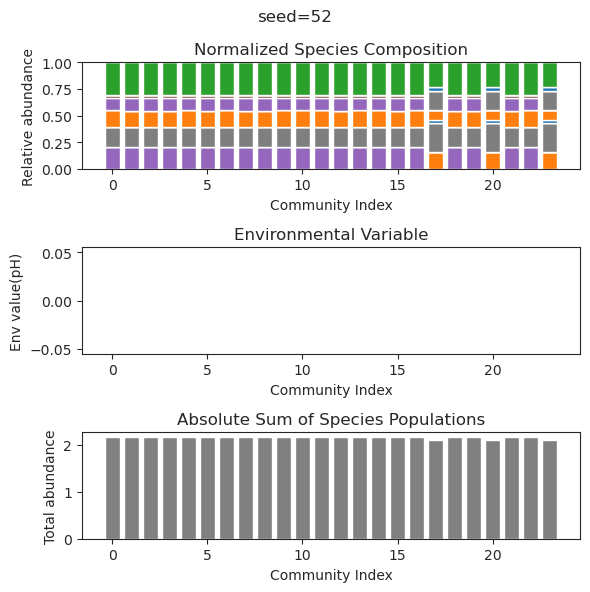

{'species': array([ 2.01453419e-39, -2.63800161e-27,  4.00301437e-75,  3.59757562e-02,
        2.39252993e-01,  1.35170049e-39,  4.28345672e-01,  1.80281785e-74,
        4.23527683e-01, -7.73057387e-52,  3.05703735e-01, -2.99295055e-44,
       -1.82111374e-47, -9.52535982e-50, -1.29402186e-65, -3.90663582e-36,
       -8.77509497e-36,  3.84345401e-34,  5.00916039e-01, -1.73599641e-45,
        2.80634471e-02,  1.62860482e-35,  3.36839329e-01, -7.22053681e-52]), 'env': array([0.])}
{'species': array([ 1.90360986e-42, -1.07689303e-24,  1.26836466e-36,  3.59757562e-02,
        2.39252993e-01,  1.99638067e-39,  4.28345672e-01,  1.26181930e-36,
        4.23527683e-01, -1.01296936e-50,  3.05703735e-01,  1.62337087e-38,
       -3.14684199e-45,  3.05816072e-47,  3.31732353e-56, -9.16082135e-38,
       -4.99632627e-56,  2.61061038e-52,  5.00916039e-01, -2.20047671e-41,
        2.80634471e-02,  7.91305906e-39,  3.36839329e-01,  5.76290425e-51]), 'env': array([0.])}
{'species': array([ 3.36843583e-

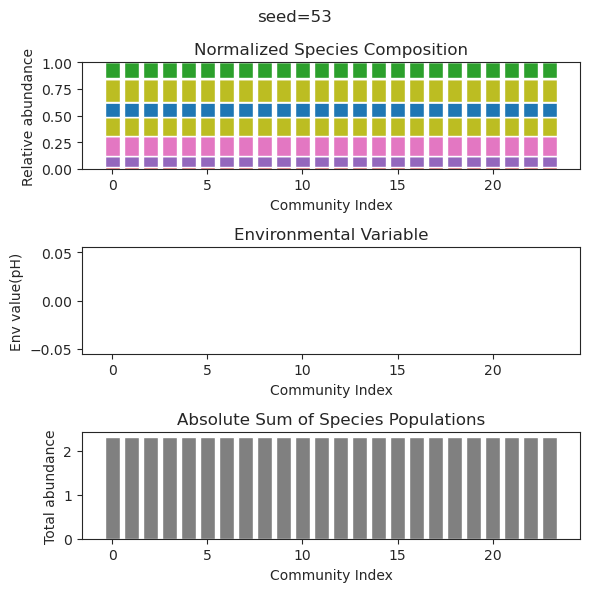

{'species': array([ 1.33610413e-19,  2.48205671e-35, -5.47919667e-40,  9.01052412e-02,
       -7.04301837e-62, -6.16902463e-50,  1.89053712e-79, -5.09150442e-78,
        2.71007190e-09,  3.94924470e-01,  1.43410410e-42,  3.63341427e-01,
        3.80996534e-50,  5.56474874e-01,  4.39222307e-02, -1.58489471e-48,
        2.67742155e-01,  1.65874782e-92,  9.02570363e-53,  2.02376368e-01,
       -1.38565214e-71,  1.44358451e-41, -2.20621129e-76,  4.33748424e-01]), 'env': array([0.])}
{'species': array([ 1.39040099e-019, -3.13701299e-074, -4.94155810e-088,
        9.01052403e-002, -1.00580241e-099, -2.31273899e-077,
        7.05279009e-144,  1.13734268e-141,  4.25419623e-010,
        3.94924470e-001, -1.61677794e-045,  3.63341429e-001,
        1.07790777e-091,  5.56474875e-001,  4.39222306e-002,
       -7.92008608e-055,  2.67742155e-001,  5.27985490e-177,
       -9.24935811e-069,  2.02376368e-001,  1.22669056e-136,
       -2.01501804e-039, -7.26503908e-123,  4.33748424e-001]), 'env': array([

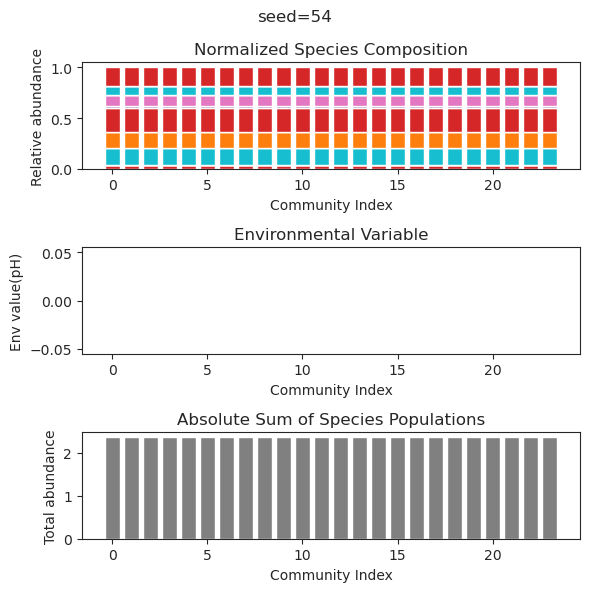

{'species': array([-5.83024676e-039,  1.07931851e-098,  1.47333363e-001,
       -4.77515846e-087, -2.71798566e-104,  2.10015722e-098,
        6.66628663e-039,  6.52518320e-001,  2.72425878e-001,
        4.00853411e-001,  3.61075206e-095,  2.93690498e-014,
       -4.17145701e-098, -1.00448578e-106, -7.41763088e-084,
        3.89055947e-001, -1.17351263e-101, -1.24745390e-049,
        1.22338213e-001,  2.14023867e-001,  6.33824799e-084,
       -5.83899250e-048, -1.27494720e-036,  1.10440125e-001]), 'env': array([0.])}
{'species': array([ 6.03105908e-057, -4.99362050e-145,  1.47333363e-001,
        4.90024647e-125, -8.22262290e-155, -1.33021675e-148,
        1.95247015e-046,  6.52518320e-001,  2.72425878e-001,
        4.00853411e-001, -6.11931479e-142, -4.23652674e-015,
       -5.97128411e-152, -2.88497894e-160,  1.61087538e-125,
        3.89055947e-001, -9.79165306e-145, -3.36025555e-067,
        1.22338213e-001,  2.14023867e-001, -2.12890135e-139,
       -3.74891554e-061, -1.83422001e-0

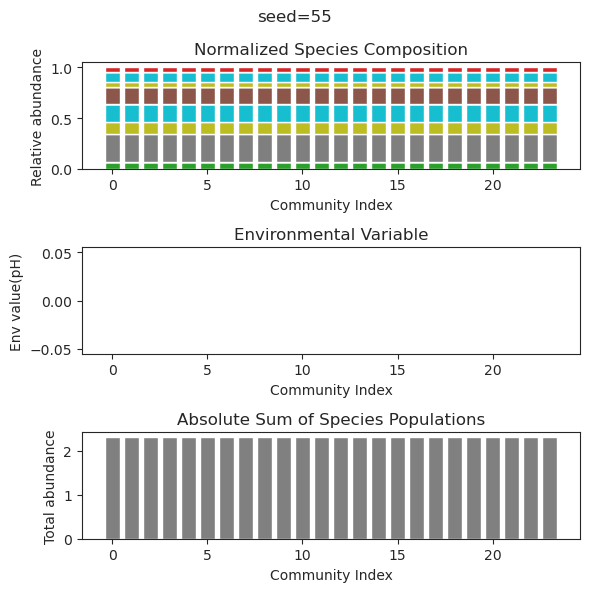

{'species': array([ 2.77686033e-030, -6.87081500e-031,  1.89464731e-001,
        1.66137435e-001,  1.95254404e-002,  9.02215682e-002,
       -1.42703603e-027,  2.37417671e-001, -3.16007735e-171,
        7.92782584e-002,  7.84688370e-002, -3.45058241e-180,
        1.67783069e-011,  8.71117832e-082,  3.96551461e-001,
        2.16932761e-001,  3.35259967e-001,  1.10186512e-003,
       -1.55013454e-147,  7.22960348e-002,  3.91900622e-108,
        1.28096700e-001, -1.80557105e-156,  5.73851150e-003]), 'env': array([0.])}
{'species': array([ 1.38590272e-032,  1.15406168e-030,  1.89338749e-001,
        1.66232050e-001,  1.95917990e-002,  9.01708559e-002,
        4.23010471e-034,  2.37316312e-001,  3.39290209e-042,
        7.92008182e-002,  7.84490117e-002, -7.24651410e-029,
        7.98569401e-012,  2.37266373e-078,  3.96401825e-001,
        2.16930544e-001,  3.35161173e-001,  1.37421687e-003,
        8.79561298e-142,  7.24022685e-002,  9.51415388e-111,
        1.28065080e-001, -2.13561339e-1

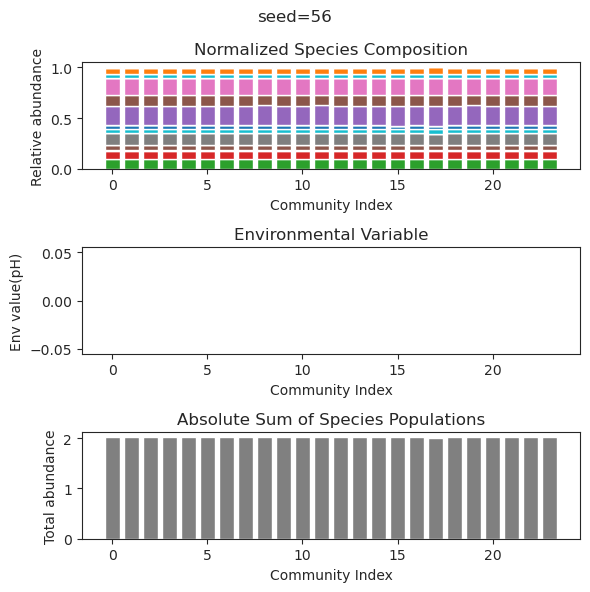

{'species': array([-2.41874142e-33, -2.43880483e-38,  8.43871346e-32,  6.30711981e-03,
        1.22191132e-01,  1.61107992e-01,  3.65910721e-30,  7.15708647e-01,
       -2.20058352e-32,  3.64259951e-97,  1.04525709e-32,  2.72400908e-01,
       -5.12137644e-35,  4.40079915e-35, -3.32214057e-82,  9.14630775e-02,
        4.48189041e-01,  5.91561407e-67,  4.71751677e-35,  5.13260116e-01,
        8.35281066e-45, -6.04228026e-81,  2.14527040e-92, -1.27343583e-74]), 'env': array([0.])}
{'species': array([-2.88733304e-120,  5.15423254e-068, -4.19491175e-123,
        1.07220314e-005,  1.27303486e-001,  1.67826012e-001,
       -6.63219669e-137,  7.17833327e-001, -1.82206113e-102,
       -2.13709626e-155, -1.03787670e-060,  2.75671228e-001,
        1.98015414e-055, -1.39752830e-075, -2.74323927e-116,
        9.27968924e-002,  4.39997763e-001,  4.29880132e-104,
       -7.82553173e-079,  5.04926211e-001, -1.39605686e-041,
       -1.45079366e-115,  8.39004347e-136,  3.66900102e-119]), 'env': array([

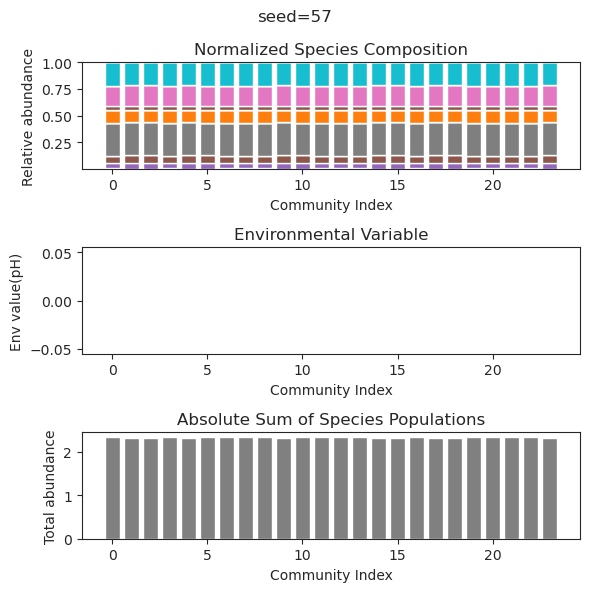

{'species': array([ 4.52014044e-001,  2.11498569e-001,  8.91483871e-053,
        6.30141647e-139,  1.03215618e-087, -1.11646221e-099,
        8.13923938e-036,  4.66898896e-001,  3.59259336e-014,
       -8.58799795e-055, -4.49104044e-081,  1.10872864e-035,
        2.43419878e-001,  3.51280178e-001,  1.22025933e-002,
        5.38913572e-091,  3.12634004e-144,  4.31530221e-053,
        3.86803982e-001, -2.59297180e-132,  5.67438032e-138,
        1.07957102e-092,  4.08942229e-002, -1.37346047e-044]), 'env': array([0.])}
{'species': array([-1.43142586e-30,  5.53334746e-67,  3.44450996e-01,  2.47633209e-02,
        1.35231056e-01,  9.59827302e-02,  1.52552103e-75,  3.05762991e-01,
        2.99672033e-14,  1.03052603e-01,  2.68655754e-01, -2.57622693e-87,
        2.51152014e-01, -6.59767284e-67,  2.50477187e-40,  4.41561848e-01,
       -4.11073205e-83,  1.04811874e-01, -1.15049438e-86, -1.10688711e-33,
        2.62580775e-72,  1.61118616e-75, -2.04557808e-59,  2.24918385e-01]), 'env': array([

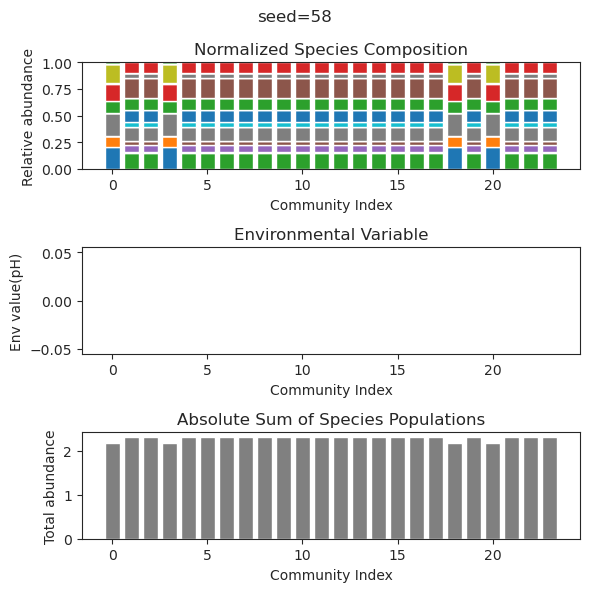

{'species': array([-3.15813642e-21,  1.07342666e-64,  5.97582076e-30,  3.31772947e-26,
        2.57910555e-01, -1.36777347e-24,  7.24679784e-53, -1.03022808e-17,
        5.55449792e-02, -9.33452901e-73,  4.28411649e-77, -7.75199018e-38,
        1.75259578e-01,  2.35632278e-66, -5.72475294e-84,  2.32038015e-01,
        9.02850527e-02,  4.41077212e-01,  2.35715154e-01, -1.19636004e-77,
        6.63794528e-01,  9.88329585e-20, -4.54076088e-42,  2.25325007e-57]), 'env': array([0.])}
{'species': array([-7.40077350e-027, -4.57246759e-092,  6.92501473e-047,
        1.06506649e-039,  2.57910555e-001, -1.40909184e-031,
        2.51945137e-074, -2.41259610e-022,  5.55449792e-002,
       -1.26066738e-104,  5.53651523e-116, -4.86213044e-056,
        1.75259578e-001,  6.56081229e-102, -2.17945845e-118,
        2.32038015e-001,  9.02850527e-002,  4.41077212e-001,
        2.35715154e-001, -5.31502284e-116,  6.63794528e-001,
       -2.57063487e-023, -2.17051351e-064, -1.13939905e-087]), 'env': array([

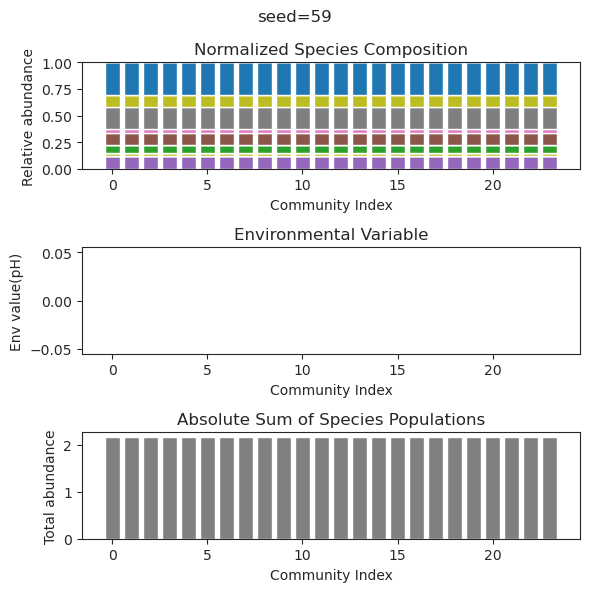

{'species': array([ 2.80452808e-072, -1.70283218e-080,  1.11580653e-026,
        2.74298340e-069,  1.32055183e-031,  1.47668592e-026,
       -7.54527813e-078, -4.96733667e-084,  4.04539592e-001,
        3.21535742e-001,  2.31729744e-026,  1.73160370e-001,
        3.80708096e-039,  3.50076491e-001,  2.73872321e-023,
        5.15814657e-001, -4.10591310e-078,  5.31092381e-098,
       -2.07200479e-050,  4.08310948e-091, -4.52393470e-106,
       -1.20056313e-126,  2.62638807e-001,  3.10792235e-001]), 'env': array([0.])}
{'species': array([-1.40134140e-061, -4.23771020e-065,  2.91660083e-024,
       -5.52728808e-061,  8.67565296e-027,  4.70096963e-021,
       -1.06195698e-063, -4.45457678e-075,  4.04539592e-001,
        3.21535742e-001,  4.70245937e-023,  1.73160370e-001,
       -1.20702112e-034,  3.50076491e-001,  3.17740524e-020,
        5.15814657e-001, -2.32681968e-071, -5.52637838e-078,
       -3.26740792e-046, -6.66059517e-075, -1.68318413e-095,
       -2.80292075e-110,  2.62638807e-0

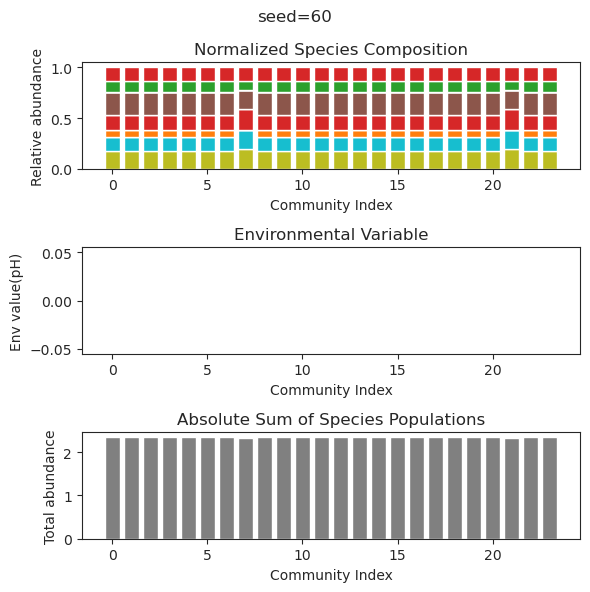

{'species': array([ 3.42565538e-25, -2.90783429e-32,  4.06926926e-01,  6.79913300e-30,
        9.47343898e-72,  1.40799902e-72,  1.59608382e-01, -1.54063410e-79,
        4.11498942e-01,  3.14445996e-01,  3.56464750e-01,  5.17232384e-70,
        7.79252938e-63,  2.33563510e-01,  2.08898712e-49,  6.25862280e-51,
        6.40971144e-02,  1.03113428e-35, -1.24585565e-19,  1.97585731e-43,
       -4.23913787e-28, -1.95122297e-76,  1.21519938e-01,  2.16527253e-01]), 'env': array([0.])}
{'species': array([-2.00705329e-23, -1.91662931e-41,  4.06926926e-01, -1.43213592e-27,
       -1.39967099e-77, -4.11509618e-83,  1.59608382e-01, -4.05027433e-82,
        4.11498942e-01,  3.14445996e-01,  3.56464750e-01,  1.72805771e-80,
       -3.28697834e-73,  2.33563510e-01, -6.63802289e-59, -1.65118858e-54,
        6.40971144e-02,  7.07855541e-41, -1.02821821e-18, -7.04033494e-50,
       -1.27587304e-28, -1.96347293e-79,  1.21519938e-01,  2.16527253e-01]), 'env': array([0.])}
{'species': array([-1.10929482e-

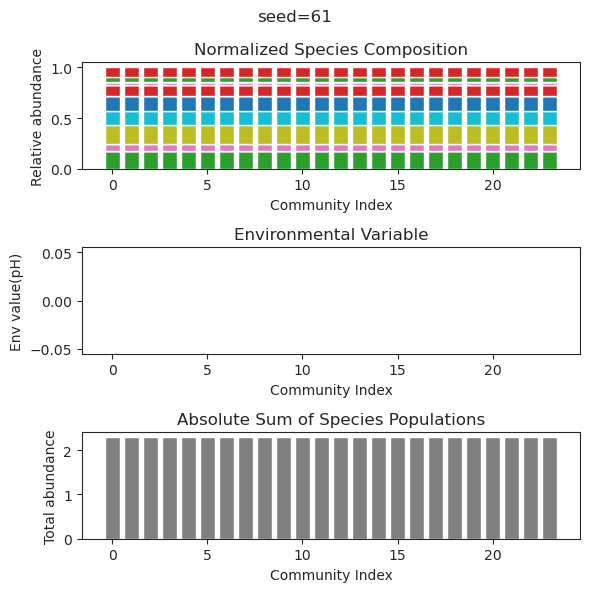

{'species': array([ 1.23384485e-031,  8.07112988e-152,  2.17388884e-322,
        5.75355513e-099,  6.03870743e-002,  7.67280797e-056,
        7.84036664e-110,  6.31079632e-001,  1.66667719e-035,
        4.94065646e-324,  9.15781277e-003,  4.95839907e-027,
        3.22680606e-157,  1.45444169e-005,  2.03490840e-142,
        2.65426070e-005,  4.81182430e-001, -9.31896468e-266,
        7.39123186e-001,  5.05160856e-015,  4.31205663e-152,
        2.30248752e-086, -1.04181512e-301,  2.61319206e-004]), 'env': array([0.])}
{'species': array([ 1.95630696e-001,  1.32779282e-026,  5.71271594e-241,
        0.00000000e+000, -6.60909915e-310,  5.33778034e-002,
        1.96888294e-001,  4.13108313e-001,  6.93647350e-037,
        3.18119445e-273,  6.17784734e-135,  2.43306160e-001,
        4.96299669e-281,  3.23523025e-002,  4.40755211e-001,
        2.22974982e-010,  3.41812752e-001,  1.59003576e-001,
        4.39776533e-040,  4.44841281e-002,  1.73124752e-135,
        4.55845232e-043,  1.73034894e-0

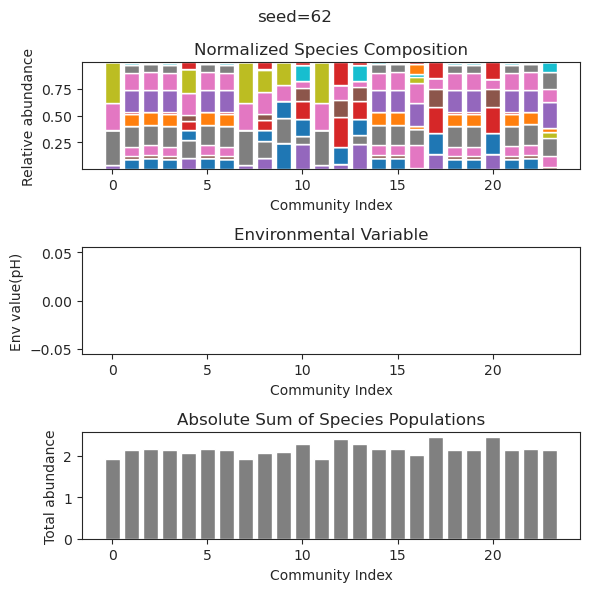

{'species': array([ 5.01822272e-46,  2.32385584e-52, -3.05358803e-26, -3.54178466e-48,
       -1.88682439e-51, -2.31268757e-47,  5.85922254e-01,  8.76000452e-43,
        3.29873842e-01, -3.20806108e-27,  4.47978712e-01,  4.72381902e-01,
       -1.63931120e-41, -3.43926786e-48,  3.94461374e-01, -1.50050295e-57,
        2.31625809e-57,  1.02002017e-49, -6.98591256e-52, -3.20921517e-47,
        7.87444797e-10, -8.94753405e-37,  3.10341614e-01, -6.00758224e-52]), 'env': array([0.])}
{'species': array([ 1.53378844e-36, -3.28669452e-52,  2.82491078e-29,  3.27746875e-37,
       -1.23660347e-40, -7.82084594e-38,  5.85922254e-01,  2.30458428e-42,
        3.29873842e-01, -1.03463951e-53,  4.47978712e-01,  4.72381902e-01,
       -3.56653073e-41, -8.78549317e-40,  3.94461374e-01, -1.63060778e-57,
       -8.90536900e-57, -1.45606556e-52, -5.49160990e-51, -1.54603074e-51,
        7.23142814e-10, -8.26976284e-38,  3.10341614e-01, -4.95837796e-59]), 'env': array([0.])}
{'species': array([-2.57608390e-

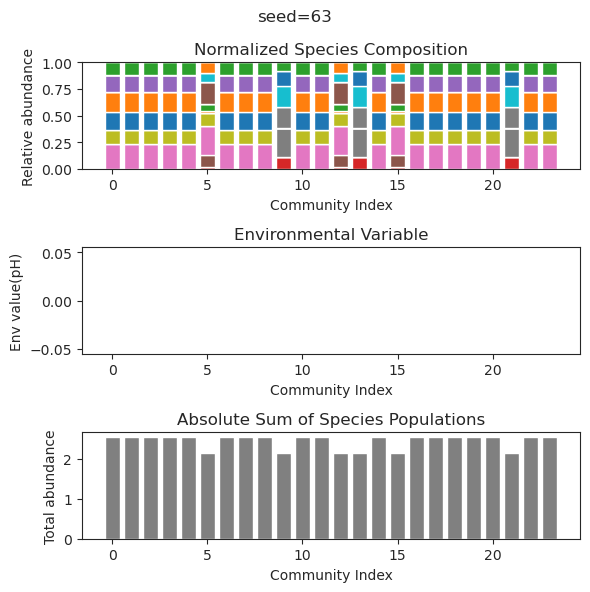

{'species': array([ 2.00738479e-01,  1.64033561e-01,  1.00812954e-75, -1.44726860e-41,
        7.82265293e-29, -1.07939125e-28,  3.57130030e-01, -1.70474540e-57,
       -2.05200276e-36,  3.13451418e-17,  9.87938262e-43,  1.58500331e-01,
        1.30620028e-01,  9.92432516e-47,  3.06975279e-29, -5.92912087e-35,
        3.00975134e-01,  5.72897165e-01,  2.67152791e-01, -2.14698934e-45,
       -1.01711722e-52,  8.56150018e-79, -5.52454843e-47,  2.85221637e-03]), 'env': array([0.])}
{'species': array([ 2.00739612e-001,  1.64033382e-001,  4.82364226e-115,
        2.05620104e-049, -5.54694935e-121,  6.31821925e-053,
        3.57129660e-001, -1.88785998e-075,  1.03288746e-125,
        5.10555904e-018, -5.85025330e-048,  1.58500657e-001,
        1.30618641e-001,  1.30867176e-088,  2.73105147e-108,
       -7.31365281e-062,  3.00974827e-001,  5.72895913e-001,
        2.67153185e-001, -2.05216898e-044, -9.04779587e-061,
        3.15668270e-121,  2.66677467e-040,  2.85340673e-003]), 'env': array([

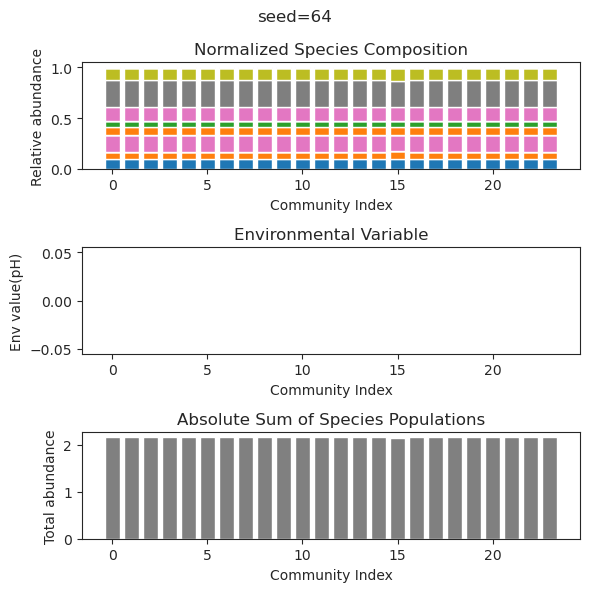

{'species': array([ 2.82899458e-001,  4.60684828e-065,  1.20968135e-181,
        1.65131914e-001,  7.61379977e-250,  7.00654056e-002,
        2.21962584e-001,  3.18601784e-095,  3.62834019e-055,
        1.53766945e-038,  9.54155206e-002,  8.56263954e-217,
       -2.44303110e-318,  2.05219297e-001,  3.68376490e-001,
        5.48889639e-227, -1.18591211e-279,  2.98485068e-001,
        2.72206049e-001,  1.40710716e-001,  3.18568895e-026,
        1.44334297e-065, -5.55610728e-314,  8.96824899e-098]), 'env': array([0.])}
{'species': array([ 2.82899519e-001,  2.31575086e-064,  3.65677369e-176,
        1.65131957e-001,  3.62280514e-262,  7.00654177e-002,
        2.21962506e-001,  2.71432136e-093,  1.68808529e-061,
        1.22205580e-036,  9.54155838e-002,  2.45741873e-225,
       -4.94065646e-324,  2.05219258e-001,  3.68376472e-001,
        3.10075482e-232, -3.66080061e-299,  2.98485076e-001,
        2.72206042e-001,  1.40710693e-001,  3.23727196e-028,
        9.79848724e-070, -4.94065646e-3

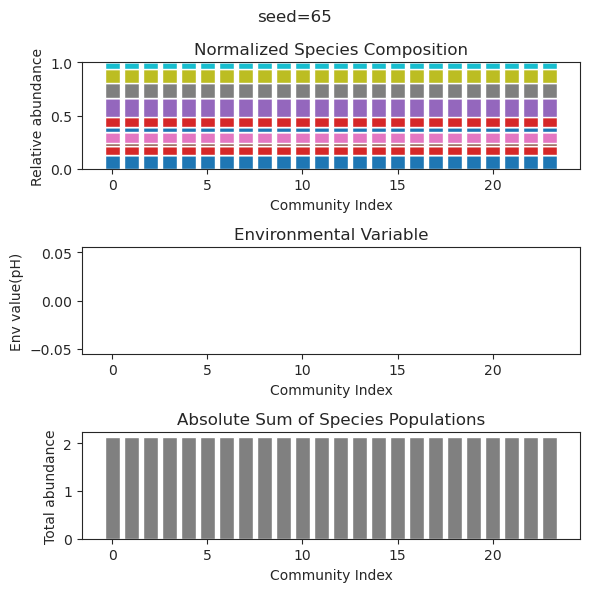

{'species': array([ 2.22390334e-001,  7.91069658e-001,  4.41326289e-001,
        1.72212297e-072, -1.79280457e-049,  7.01628525e-066,
        1.04133704e-001, -1.44390067e-054, -2.62765851e-067,
        4.35577174e-060,  4.31160909e-120,  8.35077895e-121,
        1.08359466e-107, -3.25170716e-076,  1.30665616e-085,
       -2.84109107e-089,  3.81823876e-001, -2.07271109e-049,
       -3.92881792e-097,  3.81351883e-002,  5.72492646e-002,
        1.89652806e-084,  4.78060178e-066,  2.18387166e-001]), 'env': array([0.])}
{'species': array([ 2.19644662e-001,  7.72044683e-001,  4.37352247e-001,
        4.21377236e-069,  2.81619088e-127, -1.88559243e-093,
        9.35777725e-002,  2.54222202e-033, -4.64485437e-075,
        2.82746102e-046,  1.32160090e-150,  4.42217507e-151,
        1.20314351e-145, -3.07811014e-117,  1.19093913e-069,
       -4.91204482e-109,  3.85454926e-001,  7.55699010e-078,
       -4.32270606e-109,  4.14893376e-002,  7.65309655e-002,
       -3.84754306e-030, -1.72606379e-0

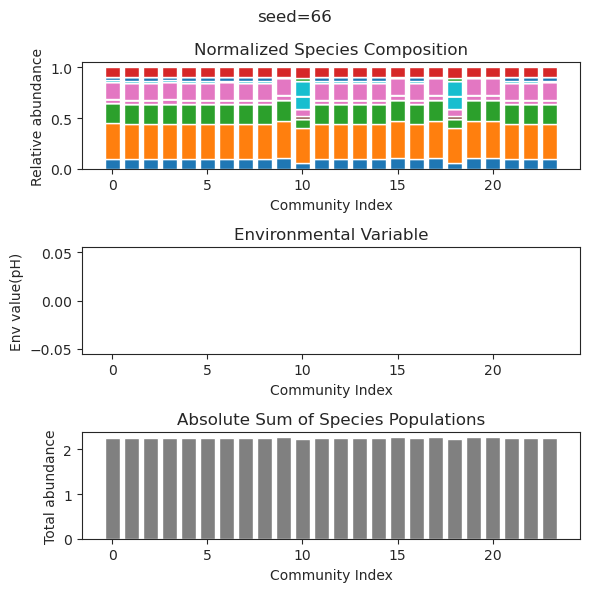

{'species': array([ 2.87507688e-001, -2.19138387e-068, -1.34827350e-137,
        4.67507095e-001,  1.23891579e-128,  2.18523422e-001,
       -9.01528057e-154,  4.56626804e-002,  1.29550543e-001,
        2.33744788e-018, -6.06576979e-036, -1.16083784e-068,
        3.08441256e-017, -1.03048551e-059, -1.06208875e-037,
        4.18271558e-001,  2.79164242e-001, -7.07612550e-176,
        2.89304834e-001, -2.29093108e-045,  5.41837659e-009,
        3.13675802e-176,  4.12103771e-167, -1.32471172e-038]), 'env': array([0.])}
{'species': array([ 2.87507680e-001,  5.84185248e-035,  9.25488055e-120,
        4.67507090e-001,  3.57731679e-120,  2.18523415e-001,
       -3.30071332e-032,  4.56627000e-002,  1.29550543e-001,
        6.93728242e-014, -1.21140841e-035, -7.09241710e-073,
        7.76403741e-017,  1.22869908e-061,  7.99830935e-038,
        4.18271536e-001,  2.79164231e-001, -1.77872971e-153,
        2.89304843e-001,  8.02535797e-048,  3.34706628e-008,
       -3.34074914e-156,  7.74248676e-1

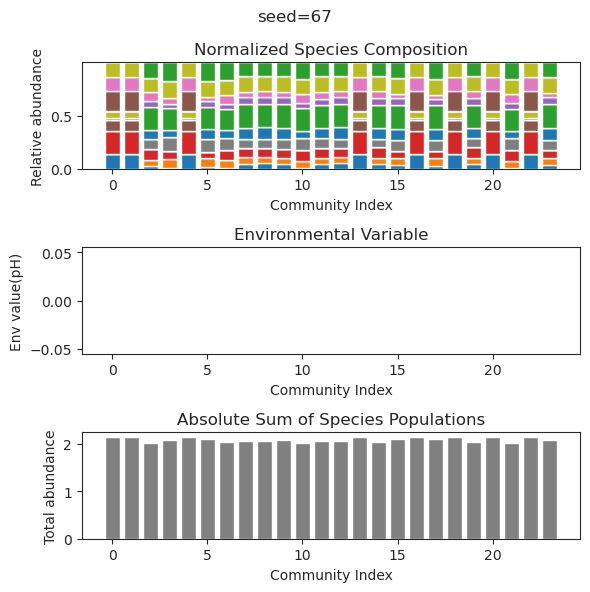

{'species': array([-2.89442452e-038,  6.21237855e-103,  7.59128693e-001,
        3.67655892e-001, -1.90552858e-039,  1.93916433e-039,
        1.66969430e-082,  1.77522899e-070,  1.00013529e-033,
        9.31498704e-002, -5.23341647e-090, -4.66459878e-103,
        1.12516529e-088, -1.74944745e-070,  5.67161315e-088,
       -2.64621374e-100,  5.88038227e-001,  1.15265503e-001,
        4.52972085e-104,  3.63228746e-084,  2.46062241e-001,
        1.53235730e-008, -1.85278290e-079, -4.11304663e-087]), 'env': array([0.])}
{'species': array([-6.05705766e-035,  5.41647264e-059,  7.59131357e-001,
        3.67691057e-001, -4.69274693e-058,  1.41816892e-066,
       -2.15258674e-085, -2.48491049e-079,  1.64743740e-100,
        9.30239538e-002, -1.23599011e-095, -4.40089429e-028,
        1.17502913e-088, -4.55234846e-085, -1.45428325e-101,
       -1.72818821e-113,  5.88025725e-001,  1.15363769e-001,
        8.78711174e-110, -2.87273562e-087,  2.46108947e-001,
        1.74642171e-045, -1.13498237e-0

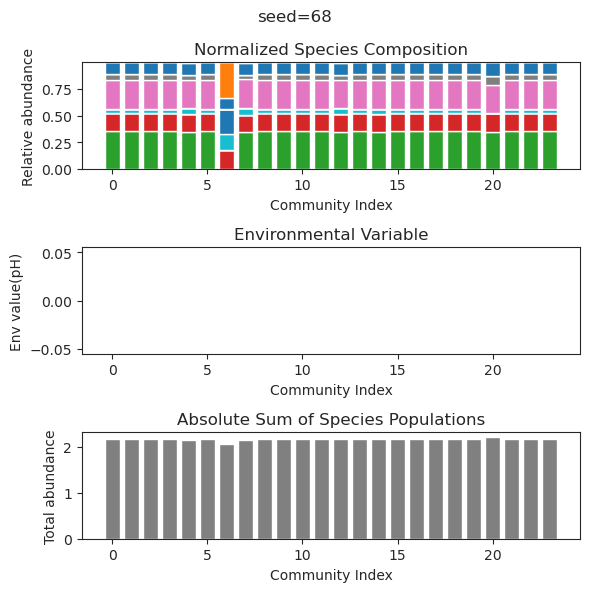

{'species': array([-1.99504947e-23, -2.39961866e-26,  1.39211424e-46, -1.67315656e-31,
       -5.14971247e-22,  2.86343600e-01, -1.90846977e-30, -1.78010662e-20,
        8.48890501e-01,  7.95981116e-47, -3.50948526e-42, -5.52743638e-34,
        3.59789387e-48, -3.92676223e-35,  2.94294646e-51, -7.51562536e-26,
       -1.04601375e-35, -6.60217463e-38,  4.10567688e-01,  7.90715306e-01,
       -1.15847526e-25, -3.90318057e-37, -5.17142702e-46,  5.37576557e-41]), 'env': array([0.])}
{'species': array([ 1.82716349e-26,  5.54583401e-01,  9.76456563e-02,  3.81658722e-02,
       -2.86878092e-97, -5.20736348e-27,  3.47399134e-19, -1.73852746e-26,
        7.83513619e-90, -1.08135000e-26,  2.63510390e-01,  2.20061950e-96,
        1.03376772e-26, -2.80469668e-58,  2.91514962e-01,  1.38405485e-02,
       -2.77981784e-32,  2.29758644e-01, -1.76389699e-37, -1.52177101e-27,
        3.16060840e-01,  1.05694337e-26,  4.42034800e-01,  3.82112090e-65]), 'env': array([0.])}
{'species': array([-3.89531392e-

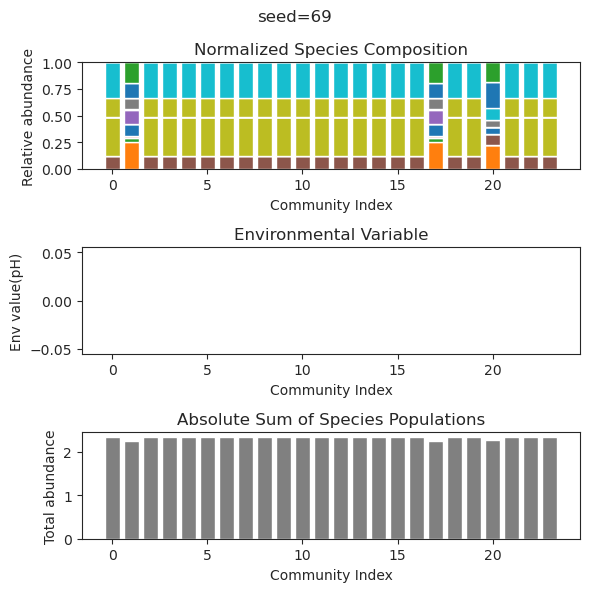

{'species': array([ 3.97735986e-002,  1.05145657e-045,  1.70442042e-037,
        7.54149186e-002,  2.50160823e-101,  4.52140849e-041,
       -1.72481364e-018, -5.55746528e-070,  2.71678265e-001,
        6.21764831e-001, -1.18146878e-066,  3.59336441e-001,
        6.23286162e-001,  1.77873321e-084,  3.13027859e-001,
       -1.54689015e-090, -2.49633260e-065,  3.42317382e-039,
        1.56398408e-022, -2.99349399e-086, -5.22737462e-101,
        1.19951471e-023, -1.99902208e-092,  2.54776957e-046]), 'env': array([0.])}
{'species': array([ 3.97735986e-02, -1.62861244e-39,  7.29210546e-35,  7.54149186e-02,
        2.14332463e-80,  3.09339851e-36, -5.33397852e-23, -1.11170960e-49,
        2.71678265e-01,  6.21764831e-01,  7.50772734e-48,  3.59336441e-01,
        6.23286162e-01, -5.88007398e-59,  3.13027859e-01, -2.33122378e-66,
        1.11906807e-49,  2.54065942e-33,  3.29301325e-20, -1.48090752e-57,
        4.09038388e-82,  1.79948732e-23, -1.80363180e-65, -2.81443300e-41]), 'env': array([

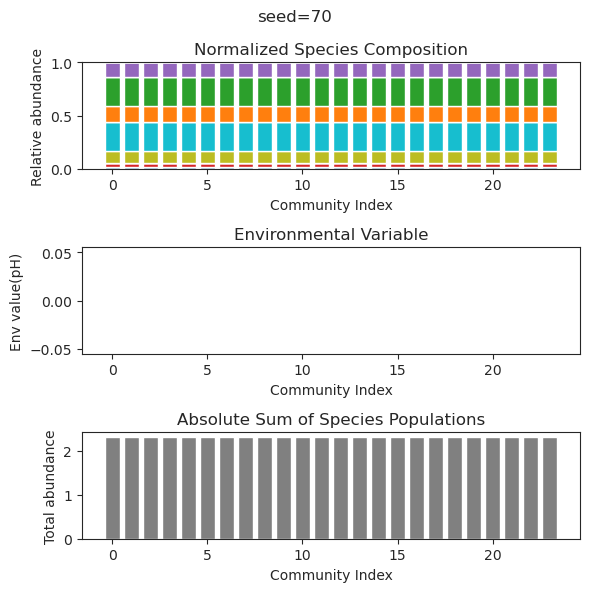

{'species': array([5.50466182e-283, 7.75519068e-053, 9.15364266e-002, 0.00000000e+000,
       4.47934305e-002, 2.20335565e-001, 1.18633862e-001, 1.84859242e-188,
       3.93454895e-001, 7.66913719e-003, 2.87069597e-119, 3.01755199e-162,
       1.42981247e-001, 6.54713486e-106, 2.81526136e-056, 9.47059960e-002,
       1.05885302e-268, 7.22517152e-124, 4.36572530e-001, 2.43911960e-060,
       1.67908535e-001, 2.44921638e-083, 1.49642800e-001, 1.64107364e-001]), 'env': array([0.])}
{'species': array([-4.74346581e-222,  9.34694303e-037,  8.98167544e-002,
       -4.94065646e-324,  4.59017516e-002,  2.19749792e-001,
        1.18699230e-001,  3.75245434e-187,  3.96071693e-001,
        7.57501380e-003,  6.49928293e-062,  4.18524778e-077,
        1.43620576e-001,  2.49229703e-059,  2.78936401e-096,
        9.45160845e-002,  2.81091944e-180,  5.11964458e-070,
        4.38757189e-001,  1.38883057e-045,  1.65326461e-001,
        5.02663279e-105,  1.48161116e-001,  1.66060830e-001]), 'env': array([

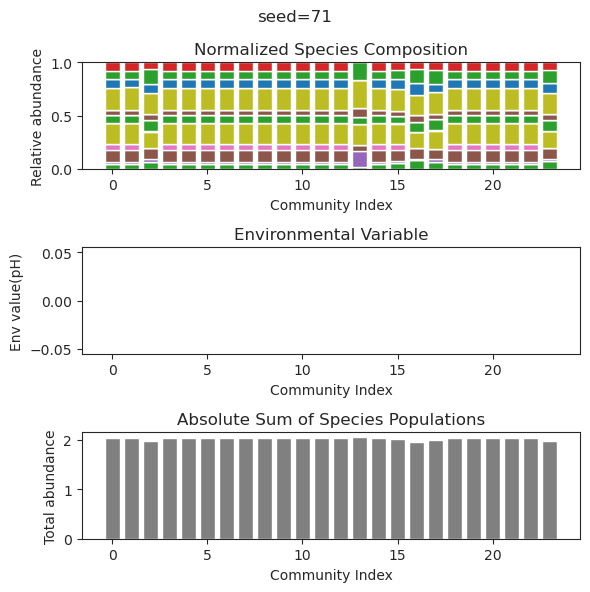

{'species': array([ 4.14186412e-31,  5.16531781e-01,  1.84383504e-01,  2.46212675e-01,
        2.58067628e-31,  3.49794864e-36,  2.47028833e-03,  7.18506510e-35,
        1.42680317e-36,  2.81497983e-36,  4.41710527e-32,  3.66585136e-02,
       -5.59096250e-65,  4.69932798e-01,  1.21638682e-75,  2.34390850e-01,
       -2.26826905e-33,  1.87921374e-01,  5.04229564e-38, -1.53002981e-28,
        2.78119640e-01,  1.69968903e-78,  6.24701770e-39,  1.59471908e-81]), 'env': array([0.])}
{'species': array([ 2.90997184e-037,  5.16430006e-001,  1.84336010e-001,
        2.46210889e-001, -2.25879986e-042, -4.18290062e-033,
        2.61365394e-003,  4.87064545e-034,  1.60307440e-099,
       -3.17872334e-093, -7.18573314e-057,  3.67033448e-002,
        1.21217965e-083,  4.69892521e-001, -1.49165612e-035,
        2.34455203e-001,  3.78907261e-080,  1.87917207e-001,
        4.50511998e-049, -2.06933122e-035,  2.78041186e-001,
       -8.21142080e-100,  2.72754889e-047,  5.27261938e-106]), 'env': array([

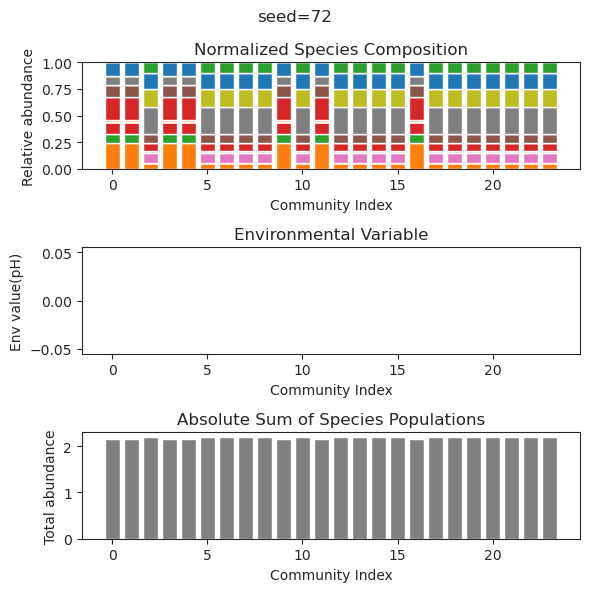

{'species': array([ 9.67510795e-48,  3.32289339e-02, -8.18133989e-69, -5.82362416e-81,
        7.04304976e-01,  8.68748226e-36, -7.42358417e-64,  1.60156665e-75,
        1.64934501e-01, -9.07683506e-36,  1.78410912e-81,  2.32999021e-11,
       -1.61412234e-77,  4.63998976e-01, -1.52878959e-66, -4.78139191e-33,
        1.25928879e-01,  2.08894742e-02,  1.83294573e-01, -5.10736983e-78,
       -1.66113150e-28,  4.45014306e-01, -2.47116945e-79, -2.75778078e-33]), 'env': array([0.])}
{'species': array([-1.14940720e-056,  3.32289339e-002,  7.05408067e-098,
       -7.22157727e-134,  7.04304976e-001, -1.60781527e-137,
        8.57455473e-089,  5.60011529e-118,  1.64934501e-001,
        4.98006105e-035,  3.08487415e-134,  1.70953244e-011,
        1.26029556e-125,  4.63998976e-001,  1.76968941e-100,
        4.22902936e-029,  1.25928879e-001,  2.08894742e-002,
        1.83294573e-001,  1.34463879e-128, -5.85642801e-023,
        4.45014306e-001,  3.93667159e-127,  1.30177348e-027]), 'env': array([

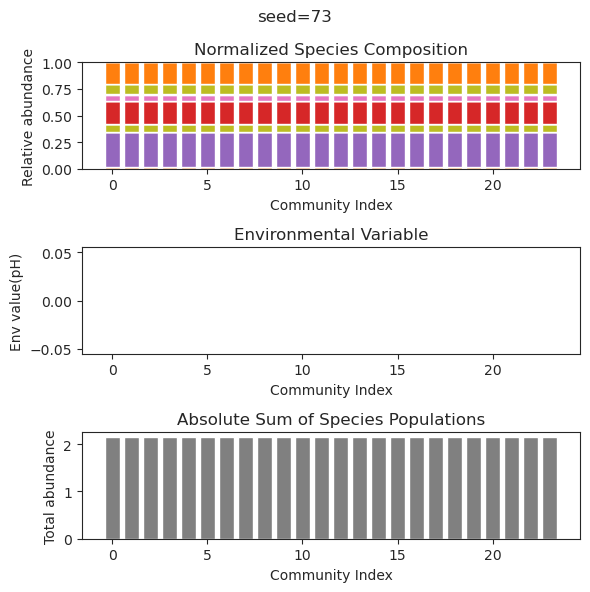

{'species': array([ 3.30503029e-028,  3.52662519e-002,  9.08645285e-004,
       -7.53417239e-028,  4.57172886e-029,  4.40151161e-002,
        7.78061999e-008,  3.97719310e-030,  6.76771176e-030,
        5.23796940e-200,  6.99884499e-001,  8.74716056e-161,
       -3.40604497e-029,  5.68953781e-001, -4.17619034e-028,
        2.96427280e-001, -2.43786237e-029,  2.49984960e-223,
       -1.77119081e-281,  1.93899729e-018,  4.81617951e-044,
        1.44263064e-001, -1.26127657e-176,  4.88873438e-001]), 'env': array([0.])}
{'species': array([ 1.07252519e-203,  3.53816843e-002,  1.75861978e-007,
        1.38366255e-241,  7.26656583e-191,  4.38341693e-002,
        9.12691171e-006,  4.51574695e-119,  1.94915183e-048,
        1.01038333e-190,  7.00487847e-001, -3.55619230e-128,
        8.62058772e-190,  5.69297564e-001,  2.32568875e-025,
        2.96499060e-001,  3.38974410e-047,  6.62756391e-228,
        8.66297022e-279,  3.60854342e-012,  8.73598797e-044,
        1.44581813e-001, -6.39172947e-1

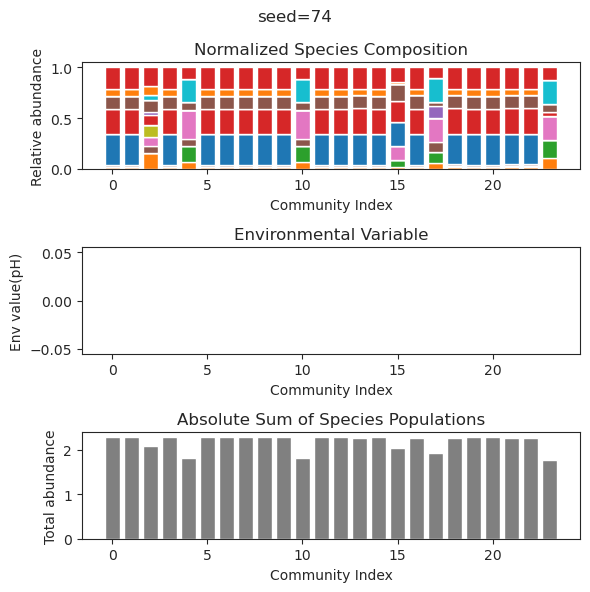

{'species': array([ 1.75613660e-001,  1.06044697e-121, -3.65085525e-101,
        4.49818563e-017,  2.69276780e-057,  4.62621712e-110,
        5.25191369e-084,  6.53823322e-090,  6.44949832e-001,
        5.08536434e-134,  1.36655655e-019,  2.89646881e-001,
       -8.31097262e-097,  6.91112239e-021,  1.75712174e-001,
        6.12075022e-001,  3.08027354e-054,  6.68252482e-002,
        1.44140526e-077,  1.74017634e-095,  1.85939557e-001,
        9.88222127e-098,  6.89578859e-067,  4.15922431e-083]), 'env': array([0.])}
{'species': array([ 2.96967976e-28, -6.11383141e-15,  3.82061812e-28,  6.51720073e-01,
        9.01318672e-01, -6.01448241e-28,  2.33357077e-31,  9.51087151e-63,
        1.06062947e-29,  3.83285702e-68,  7.13201361e-10, -1.19879380e-29,
       -5.17766232e-50,  2.48249991e-01,  7.69926583e-02,  6.39249940e-01,
        6.82431217e-02, -1.14743977e-57, -8.77486115e-51,  1.12171189e-48,
        1.59532322e-36,  8.21297455e-36,  3.59224981e-63,  3.80584336e-03]), 'env': array([

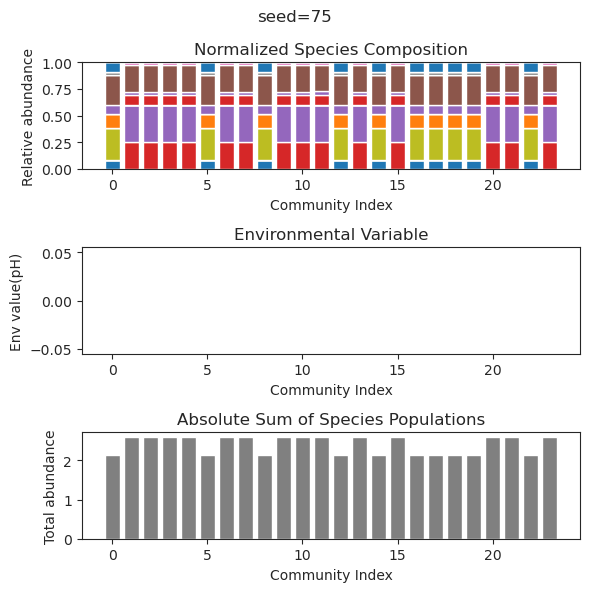

{'species': array([-2.13210915e-40, -9.08273899e-43,  1.04640372e-01,  1.40174123e-01,
        7.18132906e-01,  8.32010600e-02, -1.40048649e-52,  4.04587866e-01,
       -4.12583800e-64, -1.11609082e-58, -6.12123717e-67,  2.78863469e-01,
        1.32967101e-01, -2.24928680e-19, -4.32927051e-63,  1.20743063e-38,
        7.50397369e-02,  1.82784298e-01, -7.96478772e-76,  2.57976590e-01,
       -7.49207130e-18,  8.51569122e-02,  2.03424875e-31, -2.21093950e-16]), 'env': array([0.])}
{'species': array([ 2.04465864e-47, -5.66416478e-42,  1.04640372e-01,  1.40174123e-01,
        7.18132906e-01,  8.32010600e-02,  9.00705504e-66,  4.04587866e-01,
       -2.66085657e-40,  2.67084353e-38, -2.62168074e-72,  2.78863469e-01,
        1.32967101e-01, -2.79325370e-20,  7.54689315e-84, -3.65911910e-36,
        7.50397369e-02,  1.82784298e-01,  3.79249871e-92,  2.57976590e-01,
       -9.26408218e-20,  8.51569122e-02, -4.62502465e-31,  2.24195557e-17]), 'env': array([0.])}
{'species': array([ 4.52556834e-

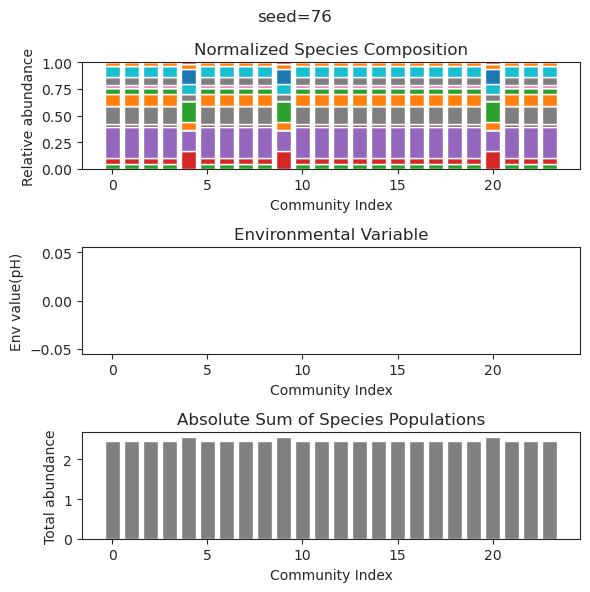

{'species': array([-9.07447099e-065,  5.25373782e-001,  2.42927334e-001,
       -2.20618329e-050, -1.65137721e-068,  4.77773869e-032,
        1.78916361e-001,  2.03850724e-136, -3.13173761e-085,
       -7.36423847e-075,  3.76739169e-001,  4.23769682e-001,
        3.92402566e-124,  4.11996117e-029,  3.27937711e-001,
        1.72423025e-001,  9.87866042e-003, -1.24592470e-067,
        1.18572828e-035, -2.86328839e-064, -1.06214731e-073,
       -4.07309018e-049, -3.58965009e-047, -2.41844872e-067]), 'env': array([0.])}
{'species': array([ 1.80171643e-062,  5.25373782e-001,  2.42927334e-001,
        8.41322840e-052,  1.64995922e-053,  1.84889594e-016,
        1.78916361e-001, -5.61713245e-115, -3.02909382e-071,
       -2.23585002e-073,  3.76739169e-001,  4.23769682e-001,
       -1.37833620e-115, -2.14628469e-030,  3.27937711e-001,
        1.72423025e-001,  9.87866033e-003, -2.36211137e-067,
       -7.68836794e-035,  1.73176725e-044, -2.09856875e-071,
        4.01300259e-048,  4.88234368e-0

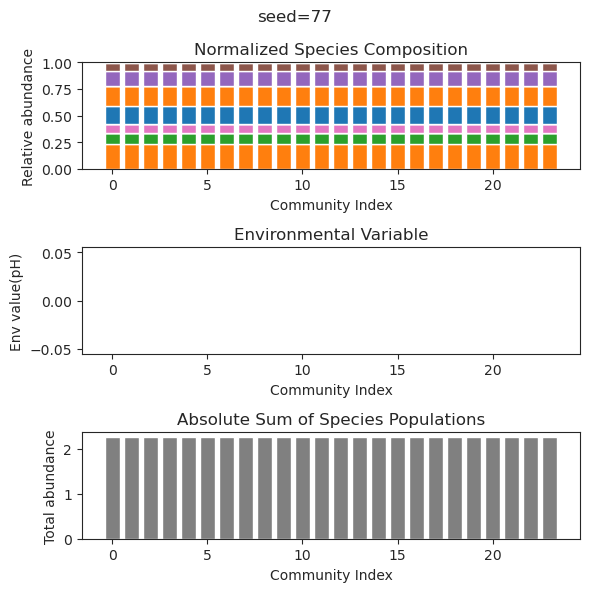

{'species': array([-1.25747094e-34,  8.71732960e-01, -1.81949126e-42,  3.05696884e-01,
        3.63366261e-01, -1.93999611e-28,  2.51927663e-31,  1.46715415e-31,
       -2.88224730e-17,  4.04209876e-66,  1.21116725e-50,  1.57104966e-66,
        3.36815703e-01,  2.43600941e-31,  2.42814581e-66,  8.28442506e-35,
        5.56380851e-01,  3.72845592e-24,  2.66678624e-03, -3.10058453e-60,
       -7.25813509e-55,  1.00907427e-17,  5.45600613e-49,  1.21148974e-01]), 'env': array([0.])}
{'species': array([ 1.00846765e-124,  8.71734131e-001,  8.58929084e-117,
        3.05697637e-001,  3.63365996e-001, -6.55701984e-030,
       -5.16684897e-033,  1.90126272e-035,  1.22550194e-016,
       -1.45620397e-029, -3.92901470e-033, -7.64226237e-131,
        3.36816317e-001, -2.40805739e-110, -4.71658399e-144,
       -5.00128037e-038,  5.56380711e-001,  5.57092690e-023,
        2.66328534e-003, -7.22054117e-130,  2.14525922e-093,
        8.72210943e-018, -3.15358288e-065,  1.21150458e-001]), 'env': array([

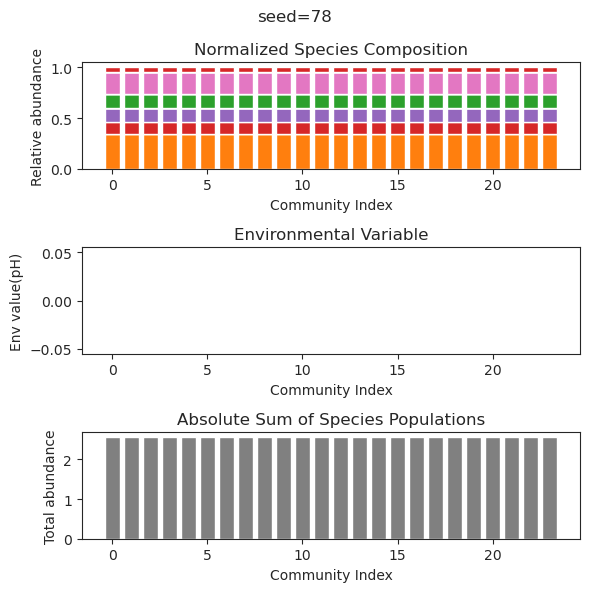

{'species': array([ 4.56495484e-001,  4.11770609e-189, -2.30367335e-032,
        1.41231248e-184,  8.23720279e-002,  6.57715482e-178,
       -6.02145010e-142,  4.42028873e-001,  6.74960628e-001,
        1.07590136e-031,  1.20182872e-007,  1.64042295e-159,
       -2.89533311e-148,  2.44974473e-140, -1.18207510e-076,
        2.31116600e-141,  1.53283198e-002, -4.46002585e-098,
       -2.92233000e-115,  1.11640047e-001,  7.50333230e-002,
        1.31707429e-001, -5.72764925e-163,  3.09481079e-001]), 'env': array([0.])}
{'species': array([ 4.56495447e-001,  1.67645564e-257,  2.79355469e-151,
       -8.02433087e-262,  8.23720162e-002,  4.31302864e-249,
       -1.20815805e-216,  4.42028938e-001,  6.74960628e-001,
        1.06302565e-118,  2.81315454e-017,  2.61423509e-193,
        4.47647897e-210,  7.13813039e-224,  3.49063123e-114,
        7.27211786e-218,  1.53286582e-002, -1.17020262e-144,
       -8.96976824e-150,  1.11640139e-001,  7.50332489e-002,
        1.31707362e-001, -7.43679456e-2

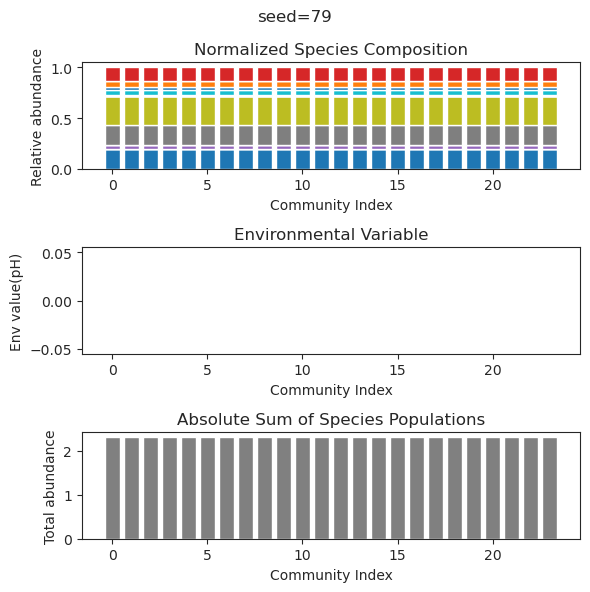

{'species': array([1.28895039e-002, 1.97530215e-013, 7.29013614e-084, 5.14122469e-146,
       8.73510325e-113, 2.42669316e-008, 2.12702640e-001, 4.83770745e-009,
       8.04194226e-199, 2.56131952e-229, 1.56757301e-129, 1.66170133e-111,
       2.40239646e-008, 6.35631020e-258, 1.26257055e-166, 4.46540013e-001,
       5.51200731e-001, 5.56875065e-001, 4.60264203e-014, 4.76566504e-126,
       3.20442165e-001, 4.98458823e-085, 2.57264406e-004, 5.39440027e-008]), 'env': array([0.])}
{'species': array([ 6.58436181e-003, -2.68716491e-029, -4.56809221e-033,
       -7.09213961e-180, -7.78400721e-030,  3.58932024e-024,
        3.25946059e-001,  1.08163205e-001,  1.46671064e-170,
        3.32856970e-160,  2.04550757e-108, -6.38383370e-166,
        1.56194228e-047, -1.84405233e-032,  2.39774723e-022,
        3.41159116e-001,  5.14839726e-001,  4.21814219e-001,
        7.93736512e-044, -8.21132021e-178,  3.66209827e-001,
        1.15057419e-092,  1.75937732e-004,  4.15621975e-034]), 'env': array([

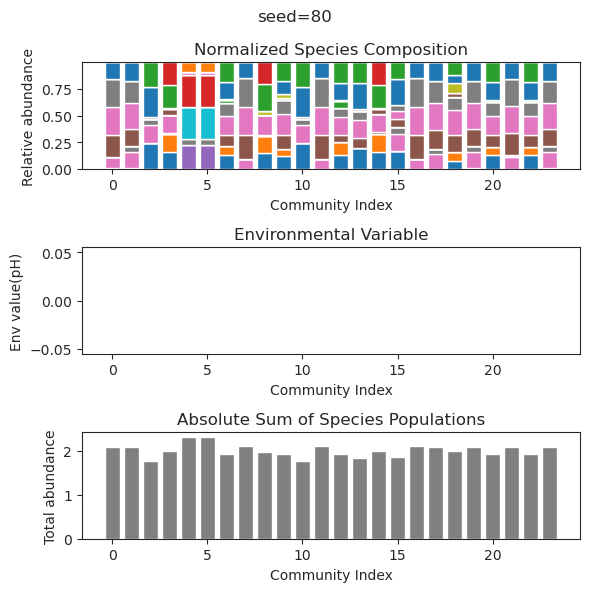

{'species': array([ 3.29642968e-001,  3.37628750e-001, -3.08421223e-059,
        1.71702554e-002, -2.75951485e-029,  2.40120201e-001,
       -6.49722728e-057, -8.90262964e-040,  2.30226503e-001,
        3.55504975e-002,  3.08726540e-001,  1.13918572e-027,
       -2.25043206e-029,  1.80372963e-001,  3.80648728e-014,
        2.31777449e-001, -1.35536181e-124,  3.99096349e-002,
        1.96974840e-078,  3.68895680e-071, -1.50081525e-033,
        1.71588331e-001, -1.36360312e-074,  7.08526591e-090]), 'env': array([0.])}
{'species': array([ 3.29630536e-001,  3.37643749e-001,  6.65424266e-035,
        1.71391404e-002,  2.34220608e-035,  2.40125502e-001,
        6.45544276e-035,  2.47897034e-057,  2.30211436e-001,
        3.55686296e-002,  3.08721605e-001,  4.12463053e-019,
       -1.48839575e-034,  1.80397975e-001,  2.91241086e-017,
        2.31786273e-001,  2.96761234e-174,  3.99020212e-002,
       -2.63990127e-095,  1.08845621e-082, -7.98546985e-094,
        1.71602265e-001,  1.12509871e-0

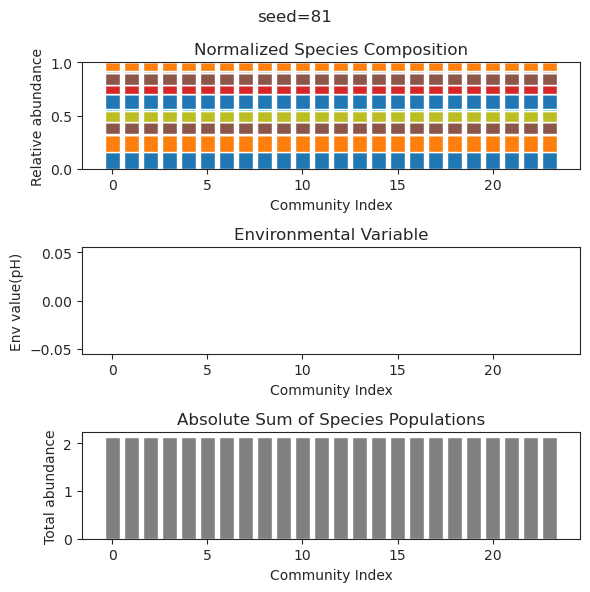

{'species': array([ 4.07072306e-01, -3.17289119e-31,  3.99047281e-01,  1.48834137e-86,
        7.83290930e-66,  1.28652651e-01, -3.16496761e-16,  6.39695548e-87,
       -2.83235391e-97, -7.27105301e-41,  1.92171707e-79,  9.48855962e-90,
        1.70820681e-01, -4.72301557e-64, -2.10450634e-44, -1.63148576e-22,
        4.70638007e-02, -2.02157320e-17,  5.40091008e-01,  1.90416108e-01,
       -1.27401830e-38, -1.05683058e-17,  3.16932407e-01, -5.84292290e-89]), 'env': array([0.])}
{'species': array([ 4.07072306e-001, -4.49029015e-037,  3.99047281e-001,
       -1.16113289e-169,  7.13389942e-117,  1.28652651e-001,
       -8.54157868e-020, -2.06095307e-168,  3.42893771e-179,
       -1.05522198e-053, -2.65830462e-156, -1.80626093e-172,
        1.70820681e-001, -5.22377365e-120, -4.28789041e-132,
       -6.27415386e-028,  4.70638007e-002,  7.47508858e-016,
        5.40091008e-001,  1.90416108e-001, -1.14838117e-054,
       -3.32028176e-019,  3.16932407e-001,  9.97329089e-173]), 'env': array([

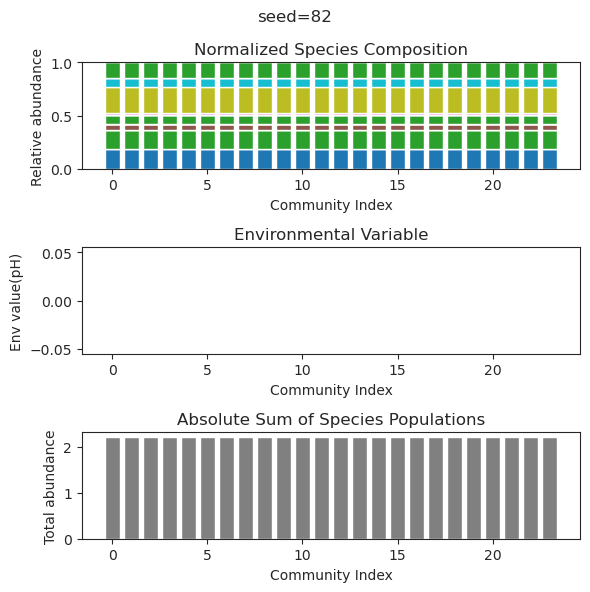

{'species': array([ 5.14496797e-01, -1.10181828e-52, -1.24191291e-29,  1.43415645e-59,
       -3.91637088e-62,  1.47726092e-61, -3.29901866e-30, -8.75600883e-56,
       -4.37040741e-64,  5.69579993e-02,  2.47788859e-01, -7.34326227e-28,
        1.17955109e-35, -3.37823124e-50,  1.00195999e-33,  6.75444515e-01,
       -1.28769206e-67, -1.01736078e-30,  3.32063036e-45, -1.77992968e-61,
        4.85562230e-01,  4.22107626e-41,  4.80150753e-01,  4.93054019e-02]), 'env': array([0.])}
{'species': array([ 5.14496797e-001,  2.48011429e-094, -2.30417274e-039,
        7.74988729e-103, -9.56853832e-103,  3.15192192e-104,
       -1.05534359e-042,  2.32774132e-088, -1.86735796e-107,
        5.69579993e-002,  2.47788859e-001, -4.14659459e-034,
        2.80237019e-049,  2.06692949e-087, -1.94516840e-044,
        6.75444515e-001,  8.51605438e-107, -1.67052068e-038,
       -8.33665177e-074, -1.29800888e-104,  4.85562230e-001,
        4.33184184e-067,  4.80150753e-001,  4.93054019e-002]), 'env': array([

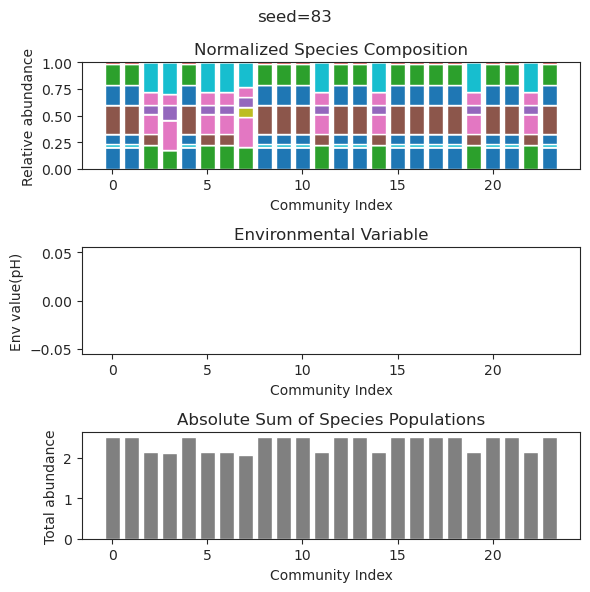

{'species': array([ 2.36518181e-01,  4.72196636e-01,  8.55938706e-02,  4.84496323e-02,
        1.91574553e-56,  5.00365240e-01,  1.00899493e-01,  5.44459962e-39,
       -3.17813366e-34,  3.97298026e-67,  3.67748900e-25,  8.05475516e-39,
        6.99618583e-28,  1.15964266e-36,  2.09647381e-47,  1.67410960e-23,
        2.95500564e-50, -1.87860538e-32,  2.77280123e-62,  1.27191257e-47,
        3.56013867e-01,  1.71443311e-40,  4.64059306e-01,  2.02693483e-01]), 'env': array([0.])}
{'species': array([ 2.36518190e-001,  4.72196624e-001,  8.55938848e-002,
        4.84496000e-002, -6.99657408e-034,  5.00365246e-001,
        1.00899499e-001, -4.63049416e-037, -1.75770901e-033,
       -2.68381450e-114,  7.98837401e-032, -1.15488979e-038,
       -3.91043731e-109, -5.07738072e-038,  2.30634109e-081,
        4.98776401e-026,  2.09664572e-085,  2.46264712e-101,
       -1.90851826e-099, -1.36051026e-070,  3.56013867e-001,
        9.12346658e-030,  4.64059323e-001,  2.02693492e-001]), 'env': array([

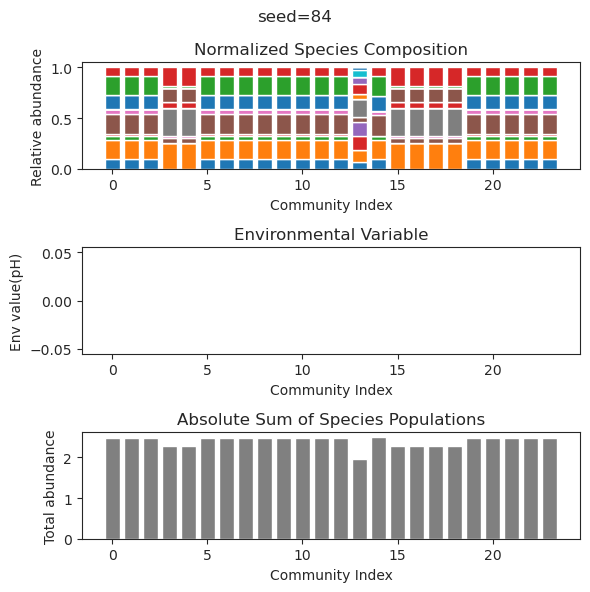

{'species': array([-6.49751713e-25,  2.76161712e-01,  1.26669077e-14, -1.72664650e-24,
        1.16767041e-38,  6.53766415e-01,  3.83349725e-36,  4.68493587e-01,
        7.58617935e-02,  1.69349087e-34,  1.85801746e-21,  2.79555045e-01,
       -1.37886167e-93,  2.94206488e-01,  2.26812664e-01, -1.42125815e-32,
       -9.14811247e-62, -4.53412740e-59,  5.61938086e-35,  2.64935067e-56,
        2.20997102e-82, -6.38530012e-82,  1.07737927e-81,  2.23990534e-46]), 'env': array([0.])}
{'species': array([-2.45874568e-032,  2.76161712e-001,  3.23631360e-032,
       -2.74017055e-029,  3.31896532e-059,  6.53766415e-001,
        2.54275995e-070,  4.68493587e-001,  7.58617935e-002,
        1.11962901e-041, -3.93133041e-022,  2.79555045e-001,
        8.00192299e-162,  2.94206488e-001,  2.26812664e-001,
        2.57641320e-045, -1.56379588e-092, -6.26700070e-084,
        1.45407892e-047,  2.06463484e-089, -4.57260534e-132,
        5.38371327e-146, -2.29301996e-117,  2.37571708e-056]), 'env': array([

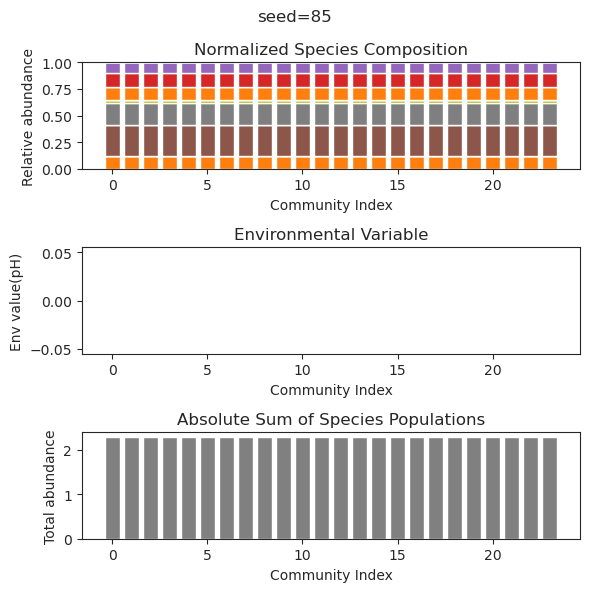

{'species': array([-6.38135463e-037,  1.44615107e-022, -6.09825674e-032,
        6.77125707e-001,  3.86618206e-002,  1.71624166e-062,
       -2.03491106e-113,  2.34277040e-036,  5.48361798e-001,
       -1.15390001e-094,  6.21710185e-130,  3.92739389e-001,
       -5.97557338e-072, -2.28933786e-113,  6.69414284e-062,
        1.52169435e-001,  2.47443447e-001,  8.11840207e-037,
        8.40164692e-003,  1.91706909e-131, -2.90945956e-108,
        2.90303462e-001, -6.66385529e-062, -9.03502057e-111]), 'env': array([0.])}
{'species': array([-2.11555631e-114,  2.95968170e-018, -1.04546058e-027,
        6.60689141e-001,  4.15044178e-002,  1.08846771e-049,
       -8.72073633e-165, -8.74157709e-062,  5.45425157e-001,
       -1.19268765e-097,  1.35398722e-173,  3.80699163e-001,
        2.78187729e-067,  2.06085913e-176, -4.86583758e-043,
        1.54454929e-001,  2.51044720e-001,  1.52310971e-056,
        2.97411211e-002,  8.87682887e-150,  2.45541753e-120,
        2.84744883e-001, -2.27281078e-0

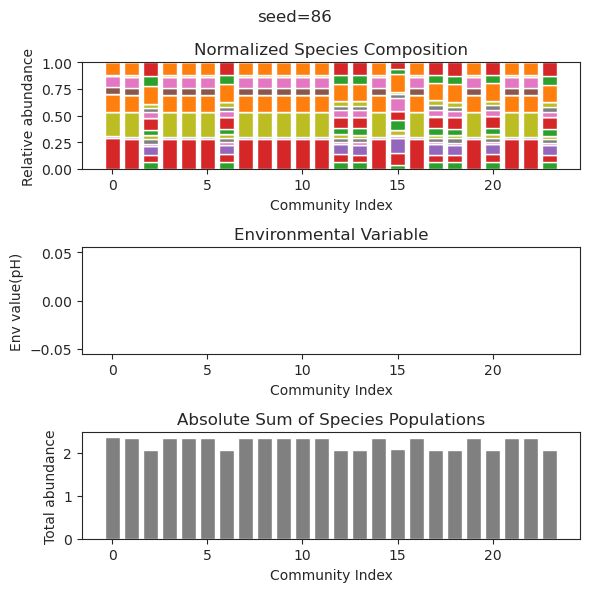

{'species': array([ 1.75006700e-01, -8.68495367e-30, -5.06406331e-39,  4.35464329e-29,
       -7.16168628e-32, -4.03672171e-45,  1.84317302e-01,  4.21213335e-01,
        6.09947615e-17, -8.27790128e-34,  3.75900612e-01,  4.41280381e-54,
        6.58604832e-01,  5.99776533e-39,  1.83442502e-48, -6.38468766e-55,
        1.62018310e-07, -1.72997405e-32,  1.63908154e-56,  3.38998426e-52,
       -7.65792006e-49, -8.84489831e-54,  5.59107775e-01,  5.90931310e-55]), 'env': array([0.])}
{'species': array([ 1.75006584e-001,  3.19192199e-027, -3.30486932e-032,
       -1.39300368e-120, -2.19753960e-030, -7.20892775e-030,
        1.84316267e-001,  4.21213658e-001,  3.01997161e-015,
        4.41781852e-028,  3.75900983e-001, -6.89011693e-029,
        6.58604212e-001, -4.54146206e-033, -1.88775775e-083,
        1.21511161e-126,  1.37801331e-006, -4.09491177e-088,
        3.18727777e-122,  4.42260029e-108, -8.23395754e-097,
        8.45345668e-116,  5.59107645e-001, -3.10987903e-128]), 'env': array([

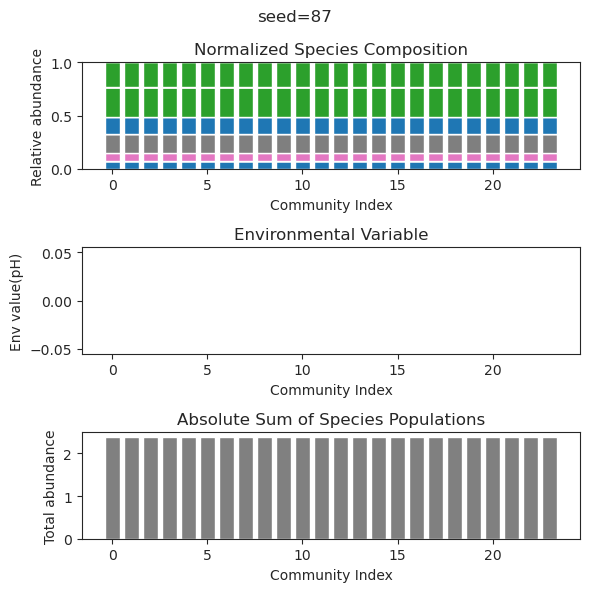

{'species': array([-5.51951189e-095,  1.37019920e-257,  9.61048444e-002,
        7.42340398e-002,  5.44050879e-012,  3.42812818e-001,
        3.28029886e-083, -1.90864064e-037,  1.55927791e-001,
        2.63727468e-001,  1.27313445e-001,  6.22324351e-008,
        1.01720404e-001,  2.23032123e-001,  1.80214697e-001,
       -2.62929011e-115, -9.09759939e-230, -6.71472870e-271,
        4.58667277e-001,  9.57231823e-075,  3.34609887e-066,
       -4.83267046e-159,  5.54612567e-228,  1.08023284e-023]), 'env': array([0.])}
{'species': array([ 4.75412380e-167, -4.94065646e-324,  2.14407721e-001,
        2.02668058e-001,  1.02137740e-007,  3.14350959e-001,
        2.27330126e-131,  3.26464208e-041,  1.87246610e-002,
        1.56657507e-001,  1.02847959e-001,  1.03238707e-001,
        1.54679630e-001,  4.49293569e-002,  1.48500455e-001,
        6.18880536e-149,  0.00000000e+000,  0.00000000e+000,
        5.43458011e-001,  3.92468840e-086,  1.15300215e-075,
        3.71606121e-198, -4.00763907e-2

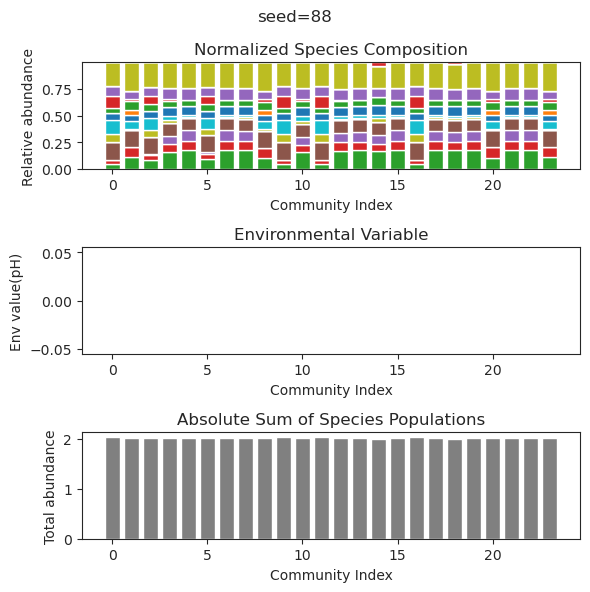

{'species': array([ 1.07082045e-33,  4.74563982e-01, -4.71662346e-53,  2.95497962e-52,
        1.50485506e-01,  6.44510014e-59,  1.07258215e-55,  5.08921828e-01,
        7.38924368e-01,  1.77450782e-01,  6.41734445e-01, -5.47996014e-66,
       -1.56200984e-44, -3.53955576e-14, -8.38153150e-51,  5.31453727e-36,
       -6.06802981e-66, -2.52386077e-38, -3.61560070e-49, -1.14688220e-49,
        3.25549764e-21,  1.50538272e-62, -3.09665512e-20,  9.70197323e-40]), 'env': array([0.])}
{'species': array([ 7.58993514e-39,  4.74563982e-01, -3.27116202e-53, -2.57488129e-53,
        1.50485506e-01,  1.84939528e-55, -1.76181573e-61,  5.08921828e-01,
        7.38924368e-01,  1.77450782e-01,  6.41734445e-01,  1.57222038e-62,
       -2.48828752e-47, -1.52394878e-16,  1.64563255e-49,  9.55276169e-41,
       -2.09783150e-64,  5.17233696e-30,  3.70348235e-51, -3.05033380e-48,
        1.95008479e-17,  5.41005518e-63, -6.10577338e-29, -7.85497439e-43]), 'env': array([0.])}
{'species': array([-1.53348389e-

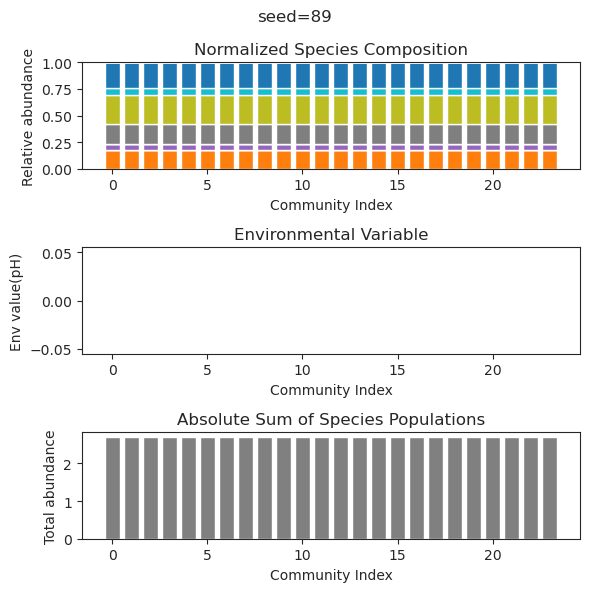

{'species': array([ 2.19778623e-001,  5.06499279e-087,  4.53221214e-119,
        1.08007414e-040, -7.90510734e-069,  3.28643744e-001,
       -2.42184103e-048, -2.70978480e-033,  3.01725944e-001,
       -2.05582376e-067,  3.63433866e-001,  1.17645816e-001,
       -4.86724267e-067,  5.41571428e-001, -1.06514885e-032,
        2.49461851e-085, -3.19143046e-052,  1.77713431e-041,
        1.20272943e-001,  4.67524425e-002, -3.24233293e-092,
        1.64991531e-001,  1.41334404e-001,  5.53040740e-037]), 'env': array([0.])}
{'species': array([ 2.19778623e-001,  6.42189556e-093,  2.92848328e-129,
       -9.59126526e-041,  2.28774684e-080,  3.28643744e-001,
        1.84825568e-056, -2.05520365e-038,  3.01725944e-001,
       -4.78663252e-077,  3.63433866e-001,  1.17645816e-001,
       -4.40354966e-079,  5.41571428e-001, -4.76668647e-032,
       -6.74832441e-097,  6.25076592e-059, -5.73082836e-046,
        1.20272943e-001,  4.67524425e-002, -3.90147405e-105,
        1.64991531e-001,  1.41334404e-0

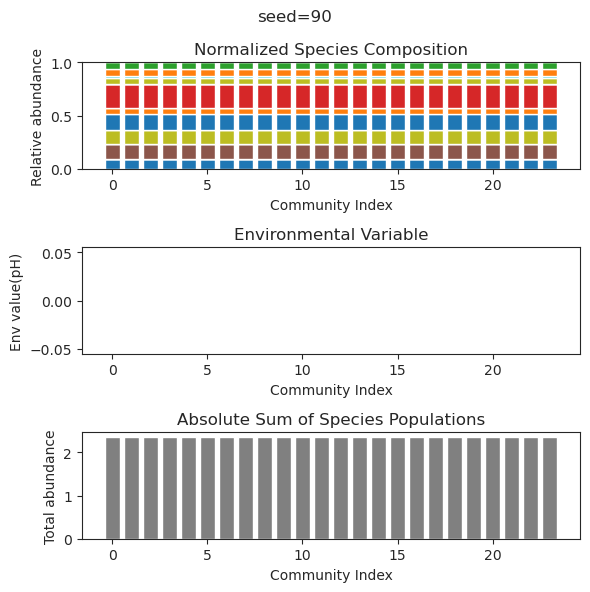

{'species': array([-2.21757033e-246,  2.16680573e-033, -1.51702042e-314,
       -1.24566079e-173, -7.20039355e-209,  0.00000000e+000,
        4.14354109e-001,  1.00630454e-049,  5.17121347e-001,
        1.68950718e-001,  2.32899056e-001,  2.33576714e-047,
        9.43104293e-013,  5.11411701e-182, -9.41834299e-134,
        3.51277165e-001,  1.08585961e-108, -6.69465778e-175,
        5.84691869e-003,  5.87165621e-086, -1.77158117e-135,
        4.56460298e-001,  1.03484370e-001,  3.49695519e-220]), 'env': array([0.])}
{'species': array([-2.21757033e-246,  2.16680573e-033, -1.51702042e-314,
       -1.24566079e-173, -7.20039355e-209,  0.00000000e+000,
        4.14354109e-001,  1.00630454e-049,  5.17121347e-001,
        1.68950718e-001,  2.32899056e-001,  2.33576714e-047,
        9.43104293e-013,  5.11411701e-182, -9.41834299e-134,
        3.51277165e-001,  1.08585961e-108, -6.69465778e-175,
        5.84691869e-003,  5.87165621e-086, -1.77158117e-135,
        4.56460298e-001,  1.03484370e-0

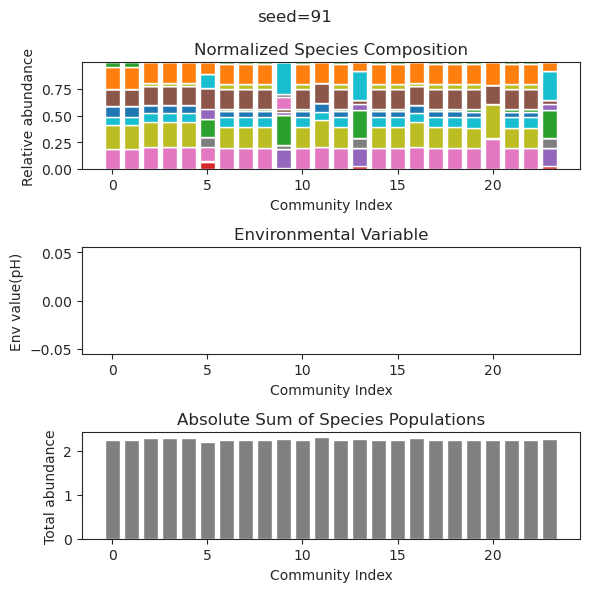

{'species': array([ 2.54482717e-01,  7.39504826e-46, -2.08256241e-15,  2.18926342e-47,
        5.18965026e-01, -3.52681298e-38, -5.57548054e-42,  3.91648729e-01,
        2.97196411e-01, -4.06603175e-42,  1.54841786e-55,  7.32940653e-51,
        1.74014636e-46,  2.38705901e-01, -4.21328942e-19, -1.05982411e-42,
       -3.84791747e-42,  8.20173284e-57,  2.41397583e-50,  2.29313719e-01,
        1.02278826e-56, -5.18009816e-62,  3.50819685e-01, -3.46175367e-42]), 'env': array([0.])}
{'species': array([ 2.54482717e-01, -6.46474000e-57,  2.38834453e-16,  3.99309426e-54,
        5.18965026e-01,  1.22682920e-32,  1.92717377e-52,  3.91648729e-01,
        2.97196411e-01,  3.95139186e-39, -1.03175631e-67, -2.52015069e-64,
        4.47651498e-60,  2.38705901e-01, -1.83339320e-19,  2.30174882e-40,
        3.22018562e-34,  2.19575832e-80, -1.13102613e-56,  2.29313719e-01,
       -9.00799785e-76,  1.31611429e-86,  3.50819685e-01,  1.03539718e-42]), 'env': array([0.])}
{'species': array([ 2.54482717e-

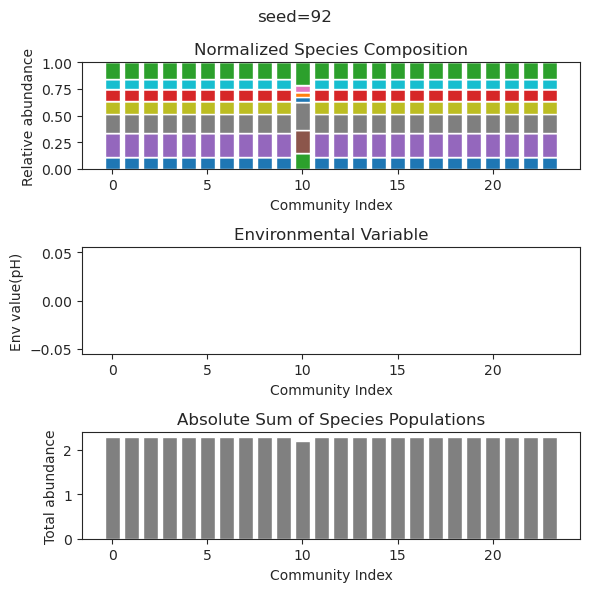

{'species': array([ 4.94065646e-324,  0.00000000e+000, -2.77293232e-044,
        1.22330309e-001,  5.88763407e-001,  3.65487848e-001,
        4.94065646e-324,  3.14614364e-001,  1.69697090e-001,
        3.20832986e-001, -4.94065646e-324,  2.46747552e-001,
        5.68840026e-011,  5.20742525e-002,  0.00000000e+000,
        1.90486639e-311,  4.94065646e-324,  2.86252690e-096,
        3.08207881e-244,  5.04355587e-002,  3.23922346e-268,
        1.80312604e-025,  2.54019070e-288,  4.05153056e-138]), 'env': array([0.])}
{'species': array([-5.74557581e-310,  0.00000000e+000,  3.70558093e-018,
        9.12778821e-013,  5.53154532e-001,  2.22045733e-001,
       -2.08930184e-317,  2.29174408e-001,  1.90280686e-001,
        3.30494047e-001,  0.00000000e+000,  2.60939716e-001,
        1.23944805e-001,  9.89337689e-033, -4.94065646e-324,
        9.45326520e-310,  0.00000000e+000,  8.83238379e-052,
        1.10047695e-159,  1.78109976e-001,  2.08021254e-240,
        7.36346405e-002,  1.49020754e-3

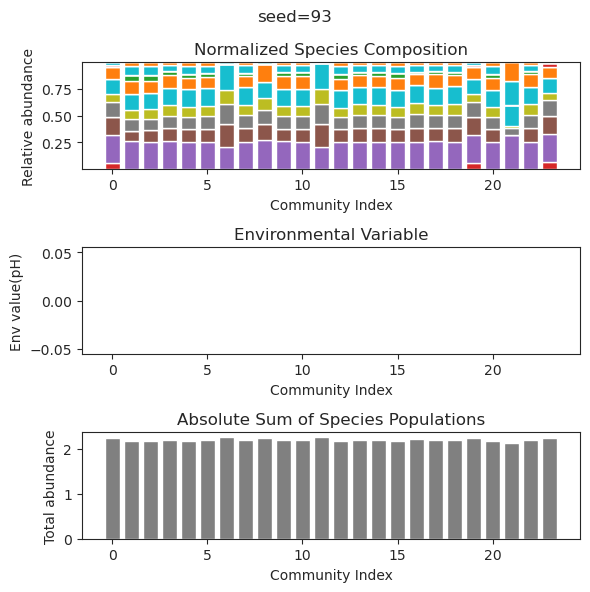

{'species': array([-9.79798617e-036,  2.54123870e-001,  1.69221679e-039,
        6.31268840e-001,  4.04665282e-003, -7.55740505e-035,
        1.65001751e-222, -1.08573690e-033, -1.03021076e-027,
       -1.64233895e-156,  6.28306754e-001, -1.72294133e-152,
        2.93908873e-002,  6.00066847e-001, -1.87369966e-191,
       -1.55556775e-188,  7.95276215e-002, -2.15114435e-067,
       -6.66700178e-088,  1.73693731e-018,  6.93691904e-262,
        3.12556552e-142, -8.11048427e-131,  5.06788226e-015]), 'env': array([0.])}
{'species': array([ 2.47672989e-030,  2.56839782e-001, -2.04633014e-029,
        6.36083510e-001,  1.45622273e-024, -1.63170208e-122,
        2.83102520e-166, -5.62695738e-033, -2.17686991e-028,
        2.99842411e-034,  6.21755503e-001, -1.84007783e-126,
        3.55164268e-002,  5.99728761e-001, -9.89178579e-137,
       -3.57261135e-190,  7.62448884e-002, -1.42278622e-123,
       -1.43747489e-069,  5.00499351e-024,  2.61375938e-219,
       -8.32443968e-133, -2.01484611e-0

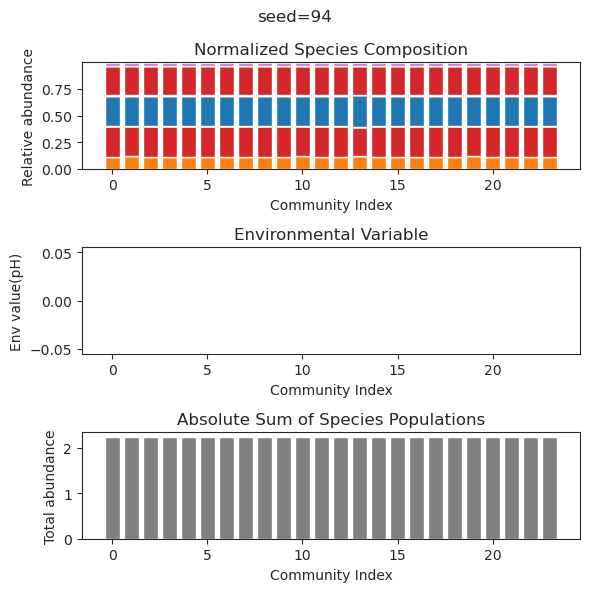

{'species': array([ 9.78444292e-032,  1.39946956e-001, -5.68239761e-032,
        4.58719870e-001,  4.55840254e-001, -1.42523623e-033,
        4.45310829e-001,  4.67773731e-032,  2.72436694e-111,
        2.38362886e-002,  6.53936072e-002,  8.78178580e-005,
       -7.72163927e-117,  2.76122819e-091, -1.63883742e-038,
       -4.34668974e-101,  3.27701381e-001,  3.54104958e-010,
        2.79261141e-001, -1.39356843e-068,  2.72044218e-061,
       -1.07710358e-106, -6.25325234e-073,  1.99002002e-120]), 'env': array([0.])}
{'species': array([-1.06549136e-135,  1.72161959e-001, -1.08596612e-063,
        4.69789954e-001,  4.22132302e-001, -1.21266626e-175,
        4.34516692e-001,  3.80855721e-112, -3.63203452e-162,
        2.40272108e-002,  5.90284150e-002,  1.57540870e-002,
       -1.52212484e-140,  3.69589326e-116,  4.95867772e-032,
       -7.34060176e-154,  3.12995937e-001,  1.62547832e-008,
        2.80197917e-001,  9.27527888e-099,  6.56946940e-075,
       -4.84099523e-142, -9.11070521e-1

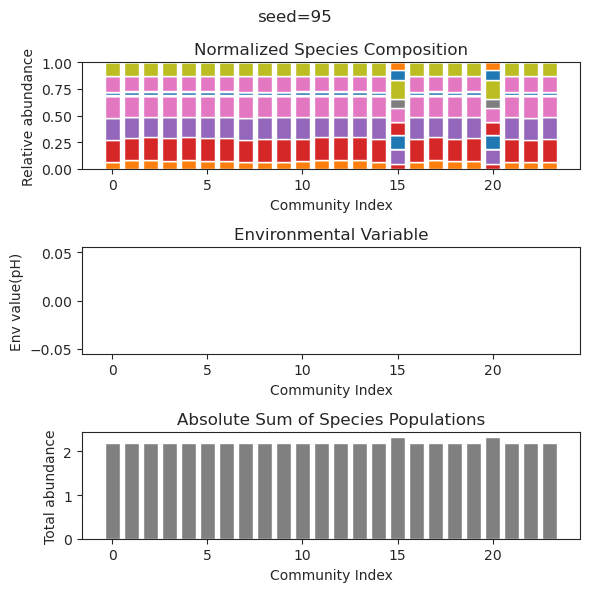

{'species': array([ 1.42292343e-59,  7.38141524e-40, -1.85646458e-17,  3.51955402e-01,
        2.83190969e-01,  3.57032221e-01,  2.11993343e-46,  1.56677297e-39,
        7.36093527e-39,  3.80257027e-01,  3.15259795e-54, -2.36515075e-67,
        1.69207427e-59, -2.32732632e-56,  2.24180623e-41,  8.21598961e-38,
        9.63386040e-47,  1.63841791e-49,  5.84323581e-01,  4.03855137e-01,
        4.57115364e-53,  2.02813930e-60, -1.04006303e-57,  1.27561027e-43]), 'env': array([0.])}
{'species': array([ 1.53486386e-45, -3.60855199e-31, -1.75867270e-15,  3.51955402e-01,
        2.83190969e-01,  3.57032221e-01, -9.27776390e-37, -3.27343971e-33,
       -5.13402095e-37,  3.80257027e-01, -5.96632026e-39, -6.23503107e-45,
        6.39858299e-46, -5.79472571e-41,  6.07624348e-33,  5.32033896e-33,
       -9.56502149e-36, -1.04930032e-38,  5.84323581e-01,  4.03855137e-01,
       -1.33969892e-39,  8.61436633e-46, -6.01387874e-51, -1.27194602e-36]), 'env': array([0.])}
{'species': array([ 2.30014544e-

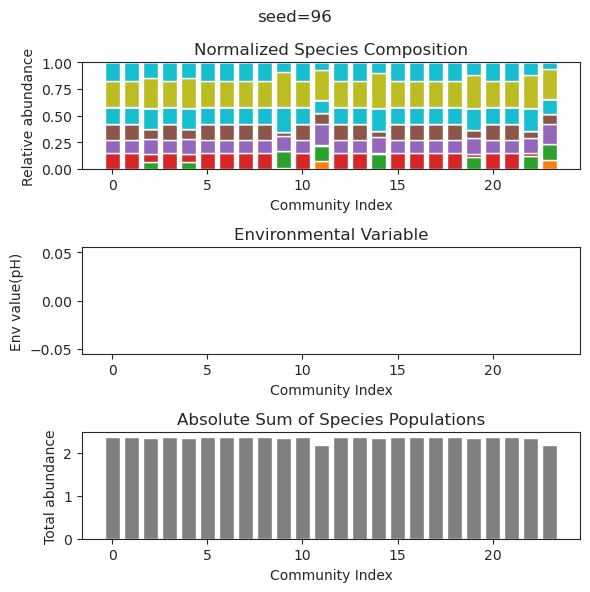

{'species': array([ 3.43183953e-01,  2.62583577e-01,  3.35390591e-01,  9.63368446e-49,
        2.43922667e-02, -3.57127069e-87,  9.73843572e-54,  7.68601569e-50,
        2.25296056e-37,  2.21582440e-81,  1.99475563e-92,  9.68414135e-02,
       -7.62147401e-26,  8.25204119e-57,  2.78331851e-01,  6.06351756e-01,
       -1.25298179e-24, -2.88622121e-80,  8.59755117e-22,  7.73855760e-02,
       -1.33714536e-81,  8.43710948e-38,  5.96334112e-39,  4.07241222e-02]), 'env': array([0.])}
{'species': array([ 3.43183953e-001,  2.62583577e-001,  3.35390591e-001,
       -1.28178468e-043,  2.43922667e-002, -6.53788137e-110,
       -3.39608661e-048, -3.22256504e-045,  4.50181800e-088,
        4.19211748e-103, -2.92149072e-099,  9.68414135e-002,
       -1.30305213e-017,  5.41538466e-053,  2.78331851e-001,
        6.06351756e-001, -9.58956067e-024, -1.73567512e-088,
       -8.06994268e-018,  7.73855760e-002, -4.37941683e-084,
        1.66098570e-031, -6.36189071e-031,  4.07241222e-002]), 'env': array([

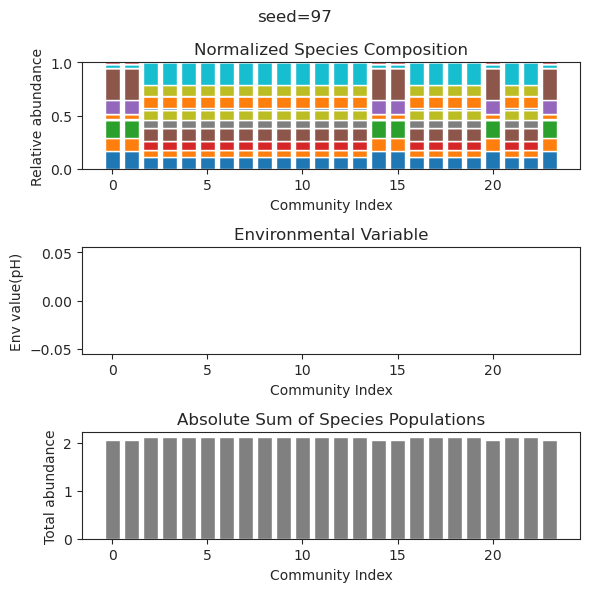

{'species': array([9.73530352e-133, 1.64592303e-045, 3.70262061e-001, 4.71512281e-001,
       1.97962246e-124, 0.00000000e+000, 5.91100325e-169, 3.17495979e-001,
       0.00000000e+000, 1.79278777e-176, 2.84872136e-001, 7.21382149e-095,
       1.97032819e-119, 2.15917063e-162, 2.35845039e-062, 1.73369133e-002,
       8.65528088e-002, 1.94273195e-001, 8.41841530e-192, 3.26207650e-001,
       1.21990588e-130, 0.00000000e+000, 1.14652253e-001, 5.37655902e-103]), 'env': array([0.])}
{'species': array([5.88850934e-138, 5.03638061e-039, 3.70256318e-001, 4.71440021e-001,
       2.40988012e-125, 0.00000000e+000, 4.15514429e-173, 3.17385560e-001,
       0.00000000e+000, 2.44341024e-185, 2.84951900e-001, 2.00125728e-102,
       4.34913329e-113, 5.79429540e-167, 2.29126381e-067, 1.73631984e-002,
       8.66632964e-002, 1.94266840e-001, 4.53894811e-182, 3.26183198e-001,
       4.41432858e-130, 0.00000000e+000, 1.14631417e-001, 7.26086480e-108]), 'env': array([0.])}
{'species': array([ 1.12241166e-

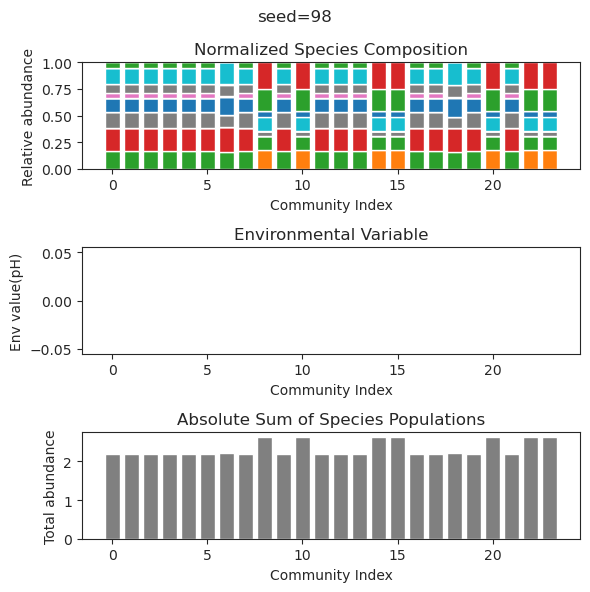

{'species': array([-4.38694384e-097,  2.91418990e-026,  3.89413231e-001,
        1.46682899e-001,  7.15723680e-045, -5.48756481e-056,
        5.49279868e-002,  3.89459612e-074,  1.99127988e-047,
        1.58683263e-002,  1.61088852e-044,  2.15624264e-001,
       -8.32863003e-218,  4.10671562e-001,  1.52064304e-174,
       -7.50173175e-017,  2.37004775e-001,  9.00815965e-040,
       -1.76617431e-219,  1.27491515e-143,  1.87875466e-001,
        4.81033319e-052,  2.22796129e-192,  2.55236616e-001]), 'env': array([0.])}
{'species': array([ 7.58308859e-108,  6.93771282e-029,  4.63173630e-001,
        1.19027573e-001,  2.62940414e-047,  2.16602404e-092,
        4.46514514e-011,  2.75598059e-079,  8.97372984e-158,
        9.32296184e-003,  8.85190084e-134,  2.69975504e-001,
        6.03912613e-232,  4.59369606e-001,  6.74106305e-173,
       -3.49700857e-032,  1.44834979e-001,  1.92700242e-043,
        2.53951670e-236,  1.69176883e-130,  2.40822730e-001,
        3.69992077e-058,  4.43204232e-1

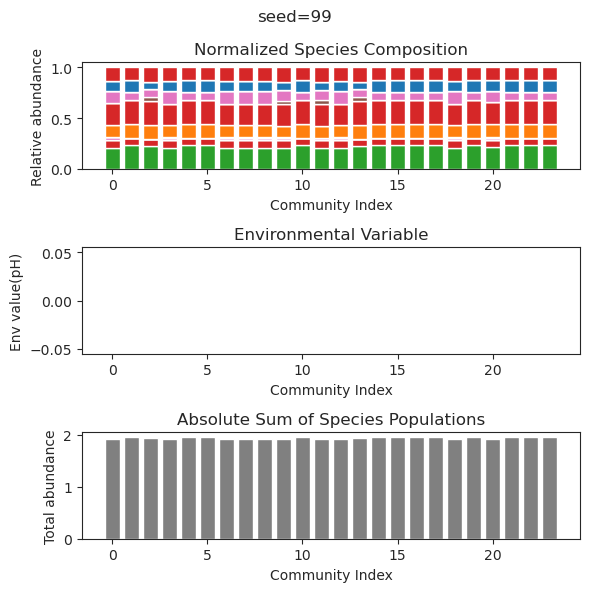

In [ ]:
session_path='Results_ptailed/Session_Test3'
to_save={}
description=''
simulated_result={}

for seed_num in range(100):
    if not os.path.isdir(session_path):
        os.mkdir(session_path)
    # functions for uniform 

    f_I = lambda : uniform_distribution(0.5,0.5)
    f_g = lambda : np.ones(1)
    f_k = lambda : np.ones(1)
    f_p = lambda : custom_distribution(-2,1)
    f_q = lambda : uniform_distribution(0.5,0.5)
    f_beta = lambda : np.ones(1)
    seed_num=seed_num
    to_plot=True

    np.random.seed(seed_num)

    N=24
    N_env=1


    I = np.zeros((N, N))
    for i in range(N):
        for j in range(N):
            I[i,j] = f_I()
    for i in range(N):
        I[i,i] =1

    g = np.zeros((N))
    for i in range(N):
        g[i] = f_g()

    k = np.zeros((N))
    for i in range(N):
        k[i] = f_k()   

    p = np.zeros((N_env, N))
    for i in range(N_env):
        for j in range(N):
            p[i,j] = f_p()

    #p[0,2]=-10

    q = np.zeros((N, N_env))
    for i in range(N):
        for j in range(N_env):
            q[i,j] = f_q()

    #q[2,0]=0.2



    beta = np.zeros(N_env)
    for i in range(N_env):
        beta[i]=f_beta()

    delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
    migration_rate=0#1e-7
    system_config = {
        'I': I,
        'g': g,
        'k': k,
        'p': p,
        'q': q,
        'beta': beta,
        'delta': delta,
        'migration_rate' : migration_rate,
        'N': N,
        'N_env': N_env,
        'seed_num':seed_num,
    } 

    file_path = f'{session_path}/system_config.json'

    label="test"
    sys
    ##

    y_out_list=[]
    system_config['beta'] = np.array([0])*delta

    for i in range(24):

        species_index=np.arange(0,24)
        env_index=np.array([0])
        y0_species=one_hot_vector(24,i)
        y0_env=[0]
        t=np.linspace(0, 2000, 10000)

        y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False)

        y_out_list.append(y_out)

    num_datasets = len(y_out_list)

    # Prepare subplots
    fig, axs = plt.subplots(3, 1, figsize=(6, 6))

    # Data for plots
    species_matrix = np.array([y_out['species'] for y_out in y_out_list])
    env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

    # Normalize species data
    species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
    species_sums = np.sum(species_matrix, axis=1, keepdims=True)
    normalized_species = species_matrix / species_sums

    # Absolute sums of species data (sum across all species for each dataset)
    absolute_sums = np.sum(species_matrix, axis=1)
    simulated_result[seed_num]={'species':species_matrix, 'env' : env_data}

    if to_plot:
        plt.suptitle(f'seed={seed_num}')

        # Plotting species composition as stacked bars
        bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
        for i in range(normalized_species.shape[1]):  # Loop through each species
            axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
            bottom_values += normalized_species[:, i]  # Update bottom values for stacking

        axs[0].set_title('Normalized Species Composition')
        axs[0].set_xlabel('Community Index')
        axs[0].set_ylabel('Relative abundance')
        #axs[0].legend()

        # Plotting environmental factors
        colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
        axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
        axs[1].set_title('Environmental Variable')
        axs[1].set_xlabel('Community Index')
        axs[1].set_ylabel('Env value(pH)')

        # Plotting absolute sums of species data
        axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
        axs[2].set_title('Absolute Sum of Species Populations')
        axs[2].set_xlabel('Community Index')
        axs[2].set_ylabel('Total abundance')

        plt.tight_layout()
        plt.savefig(session_path+f'/diagram_{seed_num}.png')

        #if to_plot:
        #    plt.savefig()


        plt.show()
#simulated_result = {'a': 1, 'b': 2, 'c': 3}  # Your existing dictionary
#description = "This is a description of the simulated result."

# Combine both into a new dictionary
data_to_save = {
    'result': simulated_result,
    'description': description
}
# Serialize the combined data to a pickle file
with open(session_path+'/result_and_description.pkl', 'wb') as file:
    pickle.dump(data_to_save, file)

{'species': array([-2.12160092e-48,  2.66642290e-01, -1.72609676e-51,  9.21782534e-01,
        1.60004583e-68, -1.53384869e-39, -2.98686343e-46,  9.13944303e-68,
       -3.59189579e-74, -5.16350317e-34,  6.15692094e-01, -1.47435706e-34]), 'env': array([-1.84457124])}
{'species': array([-1.44169713e-50,  2.66642290e-01, -2.00901225e-52,  9.21782534e-01,
       -1.93918154e-73,  4.06512381e-40,  2.86331476e-47,  1.52953130e-71,
       -1.90767302e-71, -2.46680411e-33,  6.15692094e-01,  3.41245747e-34]), 'env': array([-1.84457124])}
{'species': array([ 8.39408688e-43,  2.66642290e-01,  3.11798028e-43,  9.21782534e-01,
        2.61242454e-60, -1.78315193e-36, -4.06004788e-43,  1.80032610e-59,
       -9.14204723e-68,  1.01378836e-33,  6.15692094e-01, -1.12791108e-32]), 'env': array([-1.84457124])}
{'species': array([-4.32808797e-64, -5.23325359e-58,  1.41137532e-44, -1.72102811e-60,
        1.78094896e+00, -4.59533557e-28,  1.75642470e+00,  1.17856054e+00,
        2.45730742e-47,  1.3603415

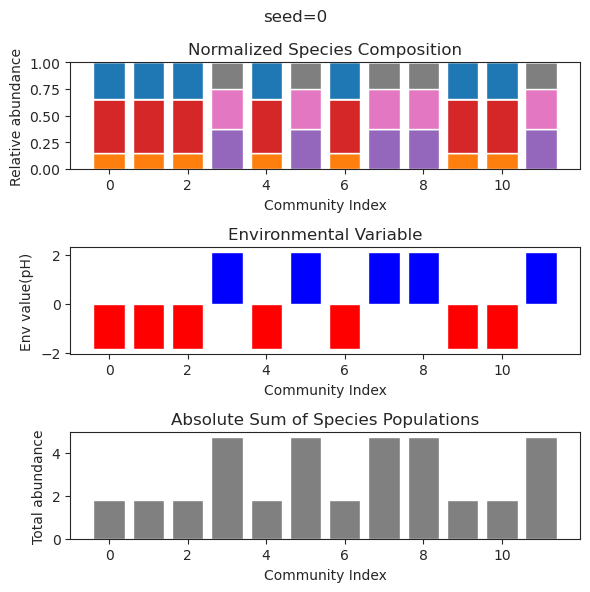

{'species': array([-1.48190309e-77,  8.64079092e-71,  4.13030645e-57, -3.60935060e-75,
        1.78094896e+00,  1.29477064e-32,  1.75642470e+00,  1.17856054e+00,
       -1.60527216e-54, -1.01224153e-46, -5.36198844e-46, -7.21363587e-77]), 'env': array([2.10065594])}
{'species': array([-1.48190309e-77,  8.64079092e-71,  4.13030645e-57, -3.60935060e-75,
        1.78094896e+00,  1.29477064e-32,  1.75642470e+00,  1.17856054e+00,
       -1.60527216e-54, -1.01224153e-46, -5.36198844e-46, -7.21363587e-77]), 'env': array([2.10065594])}


{'species': array([-1.48190309e-77,  8.64079092e-71,  4.13030645e-57, -3.60935060e-75,
        1.78094896e+00,  1.29477064e-32,  1.75642470e+00,  1.17856054e+00,
       -1.60527216e-54, -1.01224153e-46, -5.36198844e-46, -7.21363587e-77]), 'env': array([2.10065594])}
{'species': array([-1.48190309e-77,  8.64079092e-71,  4.13030645e-57, -3.60935060e-75,
        1.78094896e+00,  1.29477064e-32,  1.75642470e+00,  1.17856054e+00,
       -1.60527216e-54, -1.01224153e-46, -5.36198844e-46, -7.21363587e-77]), 'env': array([2.10065594])}
{'species': array([-1.48190309e-77,  8.64079092e-71,  4.13030645e-57, -3.60935060e-75,
        1.78094896e+00,  1.29477064e-32,  1.75642470e+00,  1.17856054e+00,
       -1.60527216e-54, -1.01224153e-46, -5.36198844e-46, -7.21363587e-77]), 'env': array([2.10065594])}
{'species': array([ 1.24136714e-001,  4.09815374e-101,  1.12130915e-032,
        2.43684682e-184,  5.35371603e-041,  6.23551266e-198,
       -6.71247840e-250, -7.51463269e-139,  6.13119612e-001,
    

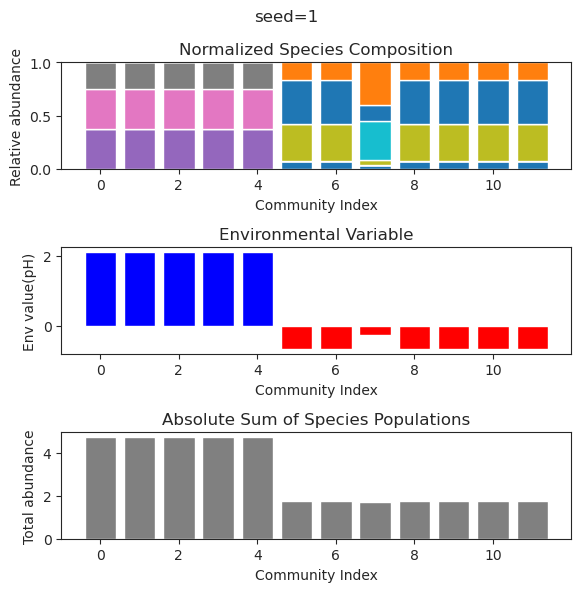

{'species': array([ 3.00268323e-17,  2.50383092e-01, -1.10232108e-68,  1.98458696e-01,
       -2.07998923e-24,  1.04162376e-40, -5.16162314e-67,  1.23790998e-01,
        4.38717362e-62, -5.08674291e-24,  8.01769218e-46,  6.64773062e-01]), 'env': array([-2.59864887])}
{'species': array([-5.25243770e-17,  2.50383092e-01, -9.66191013e-74,  1.98458696e-01,
       -1.06050653e-30,  9.80016799e-46,  2.26364456e-70,  1.23790998e-01,
        3.25834967e-63,  1.15962264e-27, -4.51452086e-51,  6.64773062e-01]), 'env': array([-2.59864887])}
{'species': array([-6.48751915e-18,  2.50383092e-01, -3.43712952e-81,  1.98458696e-01,
       -1.95135126e-34, -8.47514279e-44,  6.62229005e-82,  1.23790998e-01,
        8.93423277e-72, -1.71454037e-31,  5.59894079e-53,  6.64773062e-01]), 'env': array([-2.59864887])}
{'species': array([-1.66647013e-17,  2.50383092e-01,  1.38124898e-97,  1.98458696e-01,
        1.63732754e-33, -1.05876371e-40,  1.38520584e-99,  1.23790998e-01,
       -2.33706453e-88, -3.5161059

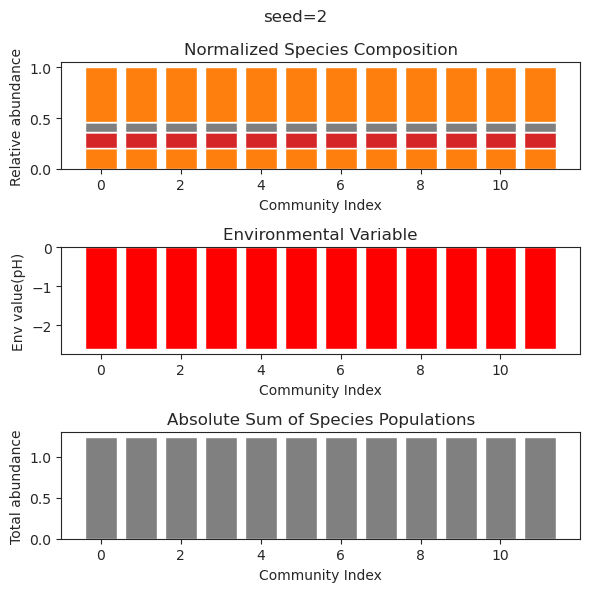

{'species': array([ 1.62398404e-001, -7.83953625e-032,  7.38362574e-001,
        3.76948519e-001,  1.97619174e-063, -3.97275891e-107,
       -3.72525660e-101, -7.49839581e-098,  1.10418324e-013,
        3.87502198e-057, -3.05695115e-065,  7.31471632e-001]), 'env': array([-0.48046086])}
{'species': array([ 1.62398404e-01,  4.58386445e-27,  7.38362574e-01,  3.76948519e-01,
        1.66033066e-43,  1.22890915e-89,  3.13872572e-81, -1.82663009e-79,
        1.14711448e-12,  1.07639656e-45,  2.61945547e-58,  7.31471632e-01]), 'env': array([-0.48046086])}
{'species': array([ 1.62398404e-01,  1.29468759e-26,  7.38362574e-01,  3.76948519e-01,
        9.21423758e-51, -2.21423157e-71, -1.98055464e-70, -2.66922018e-72,
        8.24454174e-13, -2.13119731e-47, -1.00357420e-47,  7.31471632e-01]), 'env': array([-0.48046086])}
{'species': array([ 1.62398404e-01,  1.58521622e-28,  7.38362574e-01,  3.76948519e-01,
       -1.43024434e-54,  1.16701225e-38,  2.08796099e-75,  1.95394221e-76,
        8.24550

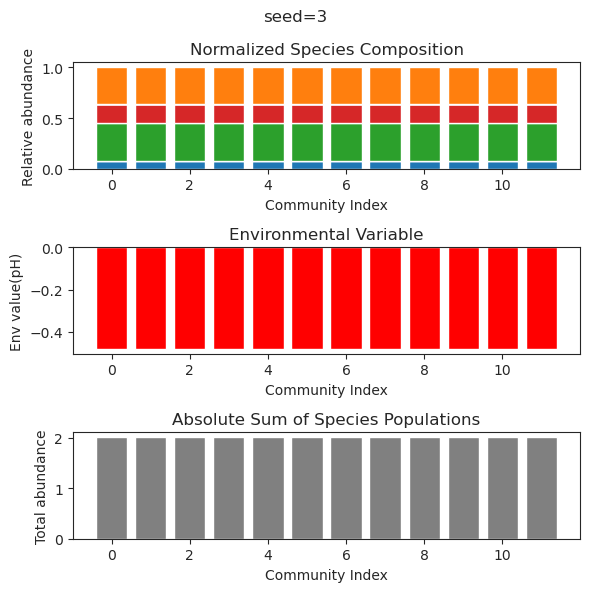

{'species': array([-5.26635266e-28,  3.21738869e-01,  2.23841399e-01,  1.83830082e-46,
        1.95110081e-31,  1.06791488e-58,  1.76509850e-01,  1.40212443e-18,
        9.67900642e-34,  1.11641672e-30, -4.29010261e-25,  2.93522477e-58]), 'env': array([-3.16895885])}
{'species': array([ 7.97712214e-29,  3.21738869e-01,  2.23841399e-01,  1.97175132e-54,
        2.15207340e-33,  8.12624263e-69,  1.76509850e-01, -2.13694547e-20,
       -7.02573677e-42,  6.14210551e-37,  5.76114897e-31,  2.05427573e-69]), 'env': array([-3.16895885])}
{'species': array([-9.21377056e-26,  3.21738869e-01,  2.23841399e-01, -3.02348170e-34,
        3.88795942e-28,  1.53015607e-37,  1.76509850e-01, -4.11437985e-17,
       -6.49549011e-32, -2.09634418e-31,  1.80839520e-31,  5.94590213e-40]), 'env': array([-3.16895885])}
{'species': array([ 4.20264532e-25,  3.21738869e-01,  2.23841399e-01, -4.17890529e-35,
        1.98457092e-24, -9.25261374e-42,  1.76509850e-01,  7.84094809e-19,
        1.42239195e-29, -5.6787157

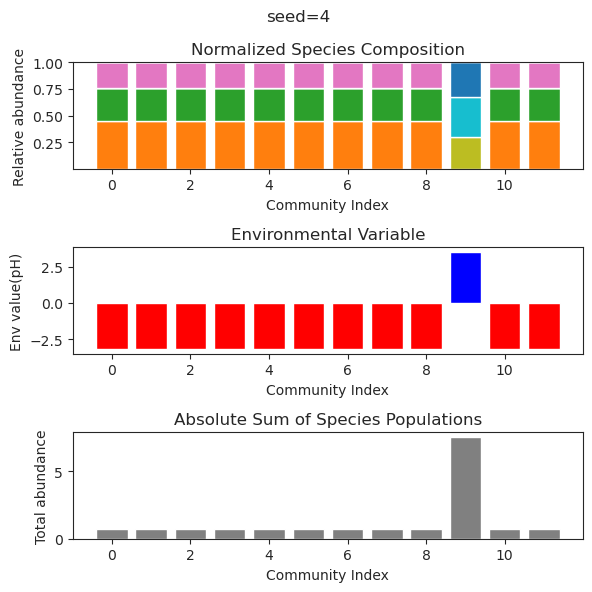

{'species': array([ 9.78759304e-30,  2.74153434e-01, -4.70017836e-18,  9.95002942e-34,
        6.54637053e-40,  2.74177741e-22,  2.57688887e-52, -5.76649934e-42,
       -6.40378788e-30, -6.10653072e-32, -5.05166881e-43,  7.87133417e-01]), 'env': array([-2.63119407])}
{'species': array([-9.12674913e-38,  2.74153434e-01,  6.14290098e-20, -1.04174635e-32,
       -4.56535312e-51, -1.18149765e-25,  2.33625746e-61,  4.97935751e-57,
       -2.90623993e-28, -4.35710600e-29, -1.89543057e-56,  7.87133417e-01]), 'env': array([-2.63119407])}
{'species': array([-3.36762551e-34,  2.74153434e-01,  9.41040566e-21, -2.88911116e-33,
       -9.85657271e-46, -9.34384970e-25,  2.79664599e-57,  4.92368760e-47,
       -1.40698341e-31, -8.94583119e-30,  1.38966192e-48,  7.87133417e-01]), 'env': array([-2.63119407])}
{'species': array([ 3.35704717e-35,  2.74153434e-01,  1.09770126e-19, -1.26919341e-28,
        2.45953620e-43, -3.78194095e-24, -2.48871370e-58,  1.74065380e-48,
        2.17095174e-26,  3.2821007

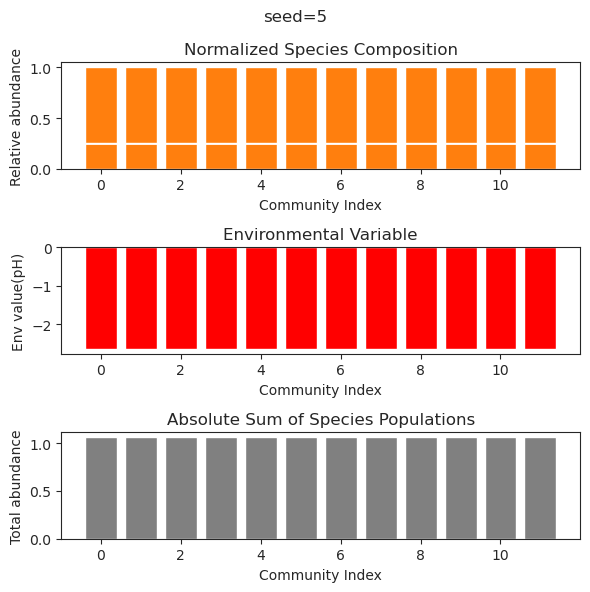

{'species': array([ 5.51199751e-002, -1.05554162e-113,  3.95854445e-102,
       -5.78526364e-087, -2.37784894e-057,  2.79648943e-017,
        5.29297795e-037,  6.09846999e-001,  8.46206294e-020,
        6.72401557e-001,  5.64222687e-001,  6.80444943e-117]), 'env': array([-0.11839601])}
{'species': array([ 5.51199751e-002, -3.82896076e-110, -6.15555229e-099,
        1.75914688e-084, -4.17453070e-056,  5.98732963e-018,
       -2.57005622e-033,  6.09846999e-001, -1.42367543e-019,
        6.72401557e-001,  5.64222687e-001, -4.10771659e-114]), 'env': array([-0.11839601])}
{'species': array([ 5.51199751e-02, -8.80125501e-98,  1.86484294e-93,  1.01034328e-76,
        5.51787835e-51, -4.71239481e-17, -3.51148800e-29,  6.09846999e-01,
       -2.55250331e-17,  6.72401557e-01,  5.64222687e-01, -5.30692021e-95]), 'env': array([-0.11839601])}
{'species': array([ 5.51199751e-002, -9.30028866e-117,  6.19259588e-104,
       -2.39000640e-085,  2.85746865e-058,  1.27995434e-016,
       -2.81863768e-036,

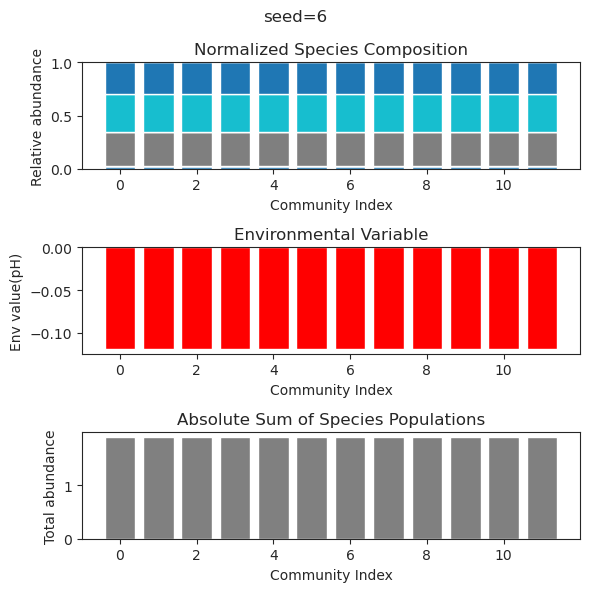

{'species': array([ 4.37828511e-74,  1.54003841e-01,  3.60867169e-31,  3.41994033e-01,
        1.03429178e+00,  6.04805061e-69, -1.03277534e-82, -6.35970305e-79,
       -4.41208106e-74, -4.18095521e-74, -7.24471927e-70,  1.12768475e-36]), 'env': array([-1.57108942])}
{'species': array([-1.78378023e-72,  1.54003841e-01, -1.13954866e-26,  3.41994033e-01,
        1.03429178e+00,  3.40548732e-66,  8.83803435e-80,  7.51032138e-74,
        2.81879071e-69, -2.41252031e-73,  5.86993239e-66, -2.56106137e-31]), 'env': array([-1.57108942])}
{'species': array([1.26432293e-68, 1.54003841e-01, 4.32055203e-31, 3.41994033e-01,
       1.03429178e+00, 3.61714678e-61, 1.56929736e-74, 9.63340749e-72,
       6.06058959e-66, 2.88502663e-65, 5.70807859e-60, 1.74973564e-32]), 'env': array([-1.57108942])}
{'species': array([ 8.93365651e-89,  6.21779525e-87, -6.35525313e-46,  3.73737486e-89,
       -6.97356517e-87,  8.22297720e-01,  6.87166715e-18,  1.60834295e-87,
       -1.27452176e-68,  6.57534156e-01,  4.90

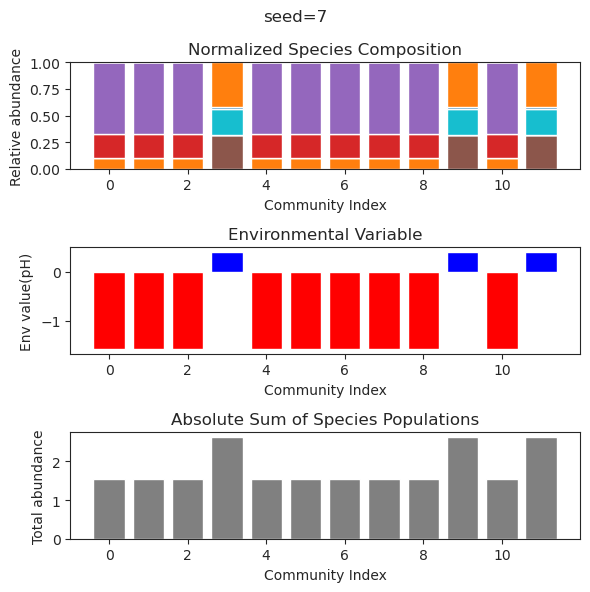

{'species': array([ 1.15060307e-01, -5.82506019e-21,  4.15116685e-75,  1.09908791e-35,
       -9.60187365e-57,  2.05714309e-02, -2.29612290e-49,  5.83743020e-02,
        6.11414391e-01,  6.52070182e-01, -3.59590256e-49, -3.49409100e-26]), 'env': array([-1.14851191])}
{'species': array([1.15060307e-01, 2.14981448e-17, 3.24805889e-75, 4.67044123e-32,
       8.19120197e-58, 2.05714309e-02, 1.23750468e-78, 5.83743020e-02,
       6.11414391e-01, 6.52070182e-01, 7.87286932e-48, 2.54548039e-19]), 'env': array([-1.14851191])}
{'species': array([ 3.19183644e-31,  3.16592110e-32,  1.66937817e+00, -1.47687066e-76,
        6.18610940e-06, -1.98078310e-50,  2.31193494e-23,  2.06941808e-74,
       -1.09381103e-46,  6.64423430e-01,  5.87839705e-34,  6.79481607e-01]), 'env': array([1.51977392])}
{'species': array([ 1.15060307e-001, -9.26624921e-017, -2.11566308e-082,
        1.23904343e-029,  3.70316465e-071,  2.05714309e-002,
        2.44088733e-102,  5.83743020e-002,  6.11414391e-001,
        6.5207

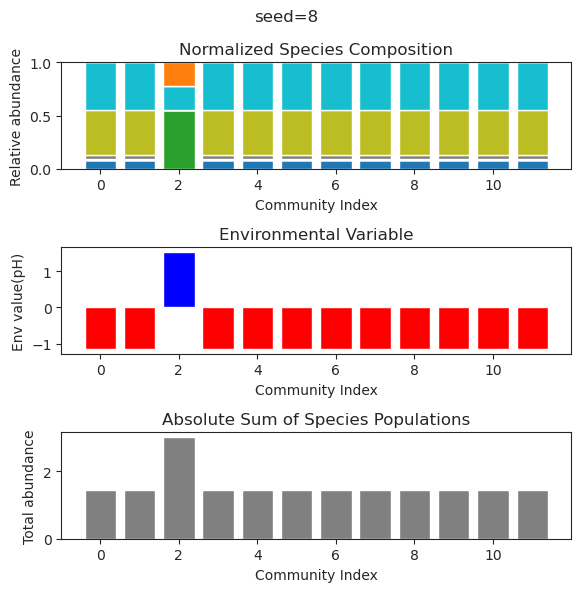

{'species': array([ 2.63462916e-01, -4.14287083e-49, -1.34012912e-31, -1.36519260e-54,
       -2.30473218e-45,  1.36627861e-58, -4.06196545e-44,  1.25790610e+00,
        2.42160327e-01, -7.15252312e-59,  6.08738101e-37, -1.72320405e-44]), 'env': array([-2.02046599])}
{'species': array([ 2.63462916e-01, -1.03000524e-40, -6.10935590e-29, -2.13238390e-46,
        2.61891640e-37, -3.25615651e-51,  1.66574609e-37,  1.25790610e+00,
        2.42160327e-01,  2.57496985e-51, -2.61868423e-34,  4.16028581e-40]), 'env': array([-2.02046599])}
{'species': array([ 2.63462916e-01,  4.78183514e-47,  2.02649357e-31,  2.23491218e-49,
       -7.88305431e-44, -1.66493773e-55, -3.11327041e-43,  1.25790610e+00,
        2.42160327e-01, -1.13844085e-55,  2.48214211e-36, -4.03540070e-44]), 'env': array([-2.02046599])}
{'species': array([ 2.63462916e-01, -1.43493247e-49, -2.30555111e-30,  1.23448048e-51,
        5.94325921e-40, -7.56403655e-54,  1.57457171e-39,  1.25790610e+00,
        2.42160327e-01,  1.7885098

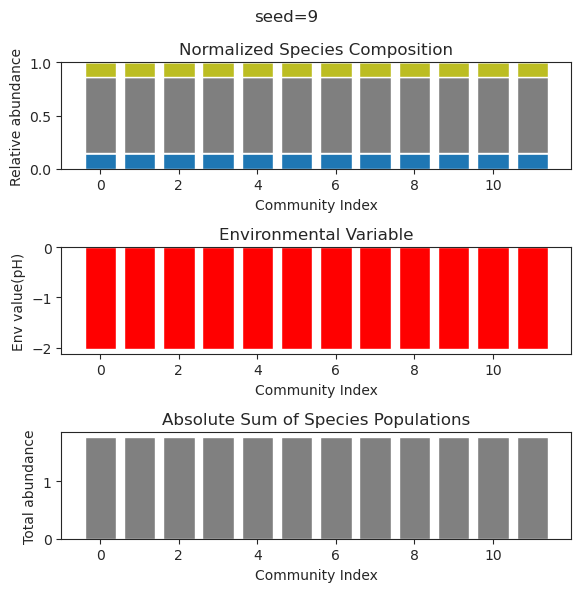

{'species': array([ 1.58133050e-01, -1.30644847e-14,  1.33801758e-35,  1.51583492e-76,
        5.83201343e-01,  1.03785805e+00,  6.48706684e-40, -4.26957620e-69,
        9.26090002e-23, -3.18719909e-44, -3.12740278e-53,  7.78883087e-02]), 'env': array([-1.21785894])}
{'species': array([ 1.58133050e-001,  5.25322136e-017, -3.68182016e-049,
        3.55853858e-107,  5.83201343e-001,  1.03785805e+000,
        3.47739701e-056,  2.67828556e-103,  4.16384451e-029,
        3.23232194e-063,  1.35786963e-079,  7.78883087e-002]), 'env': array([-1.21785894])}
{'species': array([ 1.58133050e-001,  7.21279361e-016, -4.14581171e-048,
        2.04284465e-126,  5.83201343e-001,  1.03785805e+000,
        2.25889933e-047, -1.16759679e-096,  5.71835186e-028,
       -5.40703960e-070, -1.03343155e-074,  7.78883087e-002]), 'env': array([-1.21785894])}
{'species': array([ 1.58133050e-01,  2.19812952e-15,  7.01055267e-42,  3.74806084e-77,
        5.83201343e-01,  1.03785805e+00,  3.04214211e-42, -8.86477526e-

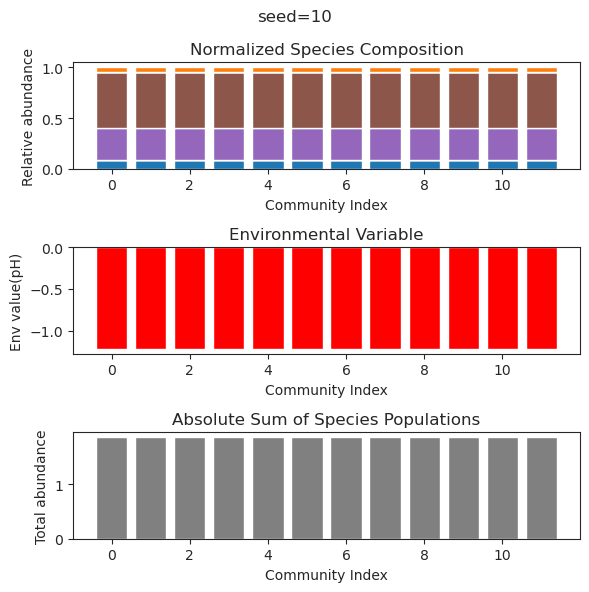

{'species': array([-2.14528618e-56,  1.81379999e-01,  4.11398320e-01, -1.67728087e-39,
        8.36810385e-01,  1.97475855e-32, -3.27665976e-48, -1.33482887e-37,
        5.65310251e-01, -1.33858050e-38, -5.06384292e-39,  2.44382125e-79]), 'env': array([-1.52251901])}
{'species': array([-6.58447945e-59,  1.81379999e-01,  4.11398320e-01, -5.50556276e-43,
        8.36810385e-01, -9.65601766e-35,  8.20460891e-47, -1.15131759e-38,
        5.65310251e-01,  8.64239838e-41, -7.24867662e-42, -1.26871367e-77]), 'env': array([-1.52251901])}
{'species': array([ 7.99070079e-57,  1.81379999e-01,  4.11398320e-01, -3.03584521e-41,
        8.36810385e-01,  1.70658724e-33, -2.36362811e-44, -7.68762574e-39,
        5.65310251e-01,  2.78993283e-36,  5.68516544e-38,  8.35063983e-74]), 'env': array([-1.52251901])}
{'species': array([ 1.25268592e-51,  1.81379999e-01,  4.11398320e-01, -7.74998508e-37,
        8.36810385e-01, -6.90475639e-30,  1.88193673e-39, -2.61582661e-37,
        5.65310251e-01,  2.4638424

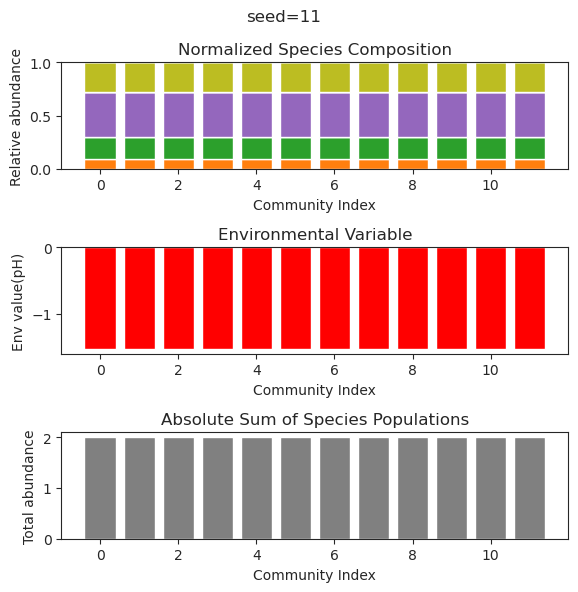

{'species': array([-1.65810444e-092,  1.69106474e-001,  1.35091067e-114,
        1.33219099e-001,  7.57034057e-002, -2.25398010e-105,
        4.88265993e-001,  1.02484510e-070, -2.08001050e-023,
        6.59815941e-112,  1.95230651e-002,  9.52402493e-001]), 'env': array([-1.15616461])}
{'species': array([-6.77311324e-042,  1.69106474e-001, -1.17015388e-134,
        1.33219099e-001,  7.57034057e-002,  3.30577377e-123,
        4.88265993e-001,  7.72033905e-079,  4.21324259e-026,
       -7.24958748e-132,  1.95230651e-002,  9.52402493e-001]), 'env': array([-1.15616461])}
{'species': array([ 2.44053858e-130,  1.69106474e-001, -1.79117262e-131,
        1.33219099e-001,  7.57034057e-002, -1.37761313e-139,
        4.88265993e-001,  1.43545883e-088,  3.85211428e-033,
       -1.95260664e-143,  1.95230651e-002,  9.52402493e-001]), 'env': array([-1.15616461])}
{'species': array([-5.60290160e-116,  1.69106474e-001,  1.20521236e-139,
        1.33219099e-001,  7.57034057e-002, -1.66481764e-128,
     

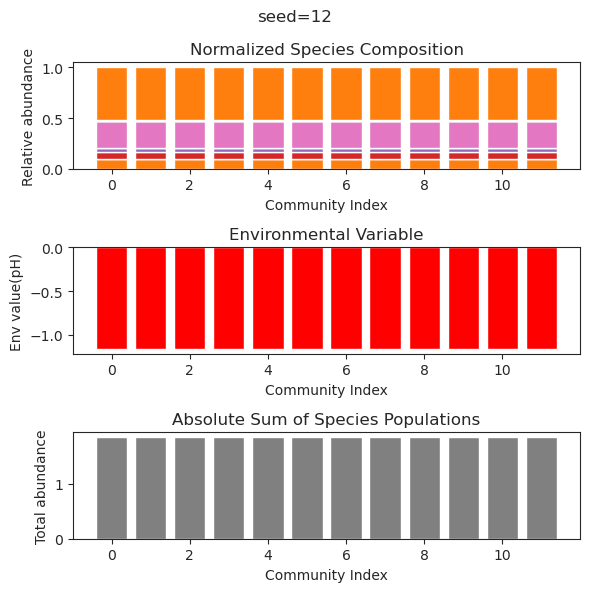

{'species': array([ 8.95730485e-02,  3.05233016e-02, -3.53561753e-41,  2.43737043e-01,
        1.67022363e-78,  4.24165608e-01,  2.15980596e-01, -1.20182848e-51,
       -5.72093457e-88, -2.88554209e-39,  9.61247404e-88,  4.92728140e-01]), 'env': array([-0.98427087])}
{'species': array([ 8.95730485e-002,  3.05233016e-002, -5.22289563e-042,
        2.43737043e-001,  1.79537776e-095,  4.24165608e-001,
        2.15980596e-001,  1.23669784e-060,  3.61444782e-103,
       -8.17786357e-042,  2.48551976e-105,  4.92728140e-001]), 'env': array([-0.98427087])}
{'species': array([ 8.95730485e-002,  3.05233016e-002,  5.35303037e-042,
        2.43737043e-001,  4.67674654e-094,  4.24165608e-001,
        2.15980596e-001,  6.66653933e-061, -6.33361561e-100,
        1.43853826e-042, -8.06466290e-104,  4.92728140e-001]), 'env': array([-0.98427087])}
{'species': array([ 8.95730485e-002,  3.05233016e-002,  1.99585492e-057,
        2.43737043e-001,  2.98043661e-130,  4.24165608e-001,
        2.15980596e-001,

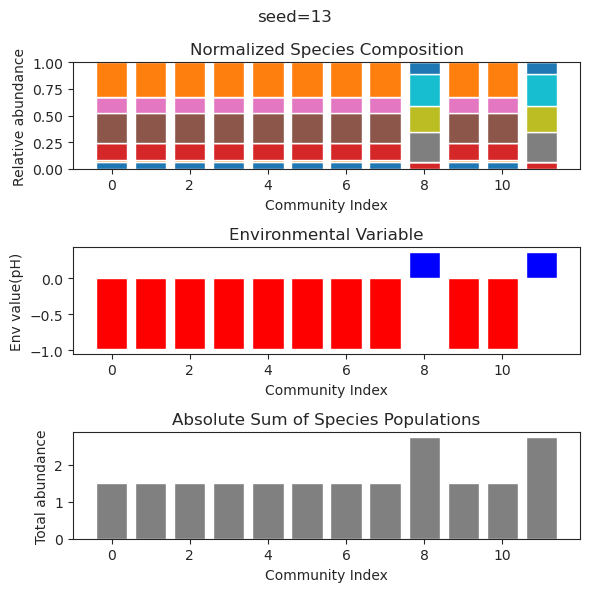

{'species': array([ 2.25554431e-01,  2.57694012e-18,  2.28521144e-58, -5.54578628e-32,
       -9.40036919e-36,  1.11730626e-44, -1.67992825e-59,  9.41282890e-58,
       -5.03059775e-33,  3.99869710e-20, -1.86771061e-55,  1.19694993e+00]), 'env': array([-1.82391959])}
{'species': array([ 2.25554431e-01, -2.06221596e-18,  3.00285134e-85, -3.93306601e-39,
       -2.84714447e-43, -4.83750501e-61, -2.40689070e-87,  9.37210946e-82,
       -8.79524914e-38,  1.73784467e-23, -9.65806493e-84,  1.19694993e+00]), 'env': array([-1.82391959])}
{'species': array([-2.24752196e-31,  6.32572560e-28,  3.71546644e-54, -2.17235736e-61,
        1.44499433e+00,  2.55132970e+00,  1.97845531e-05, -1.78221811e-57,
        4.96690417e-01,  6.29924851e-27,  1.13563960e+00, -9.53512188e-72]), 'env': array([2.61327257])}
{'species': array([ 2.25554431e-01,  7.27308046e-20, -6.44590529e-57, -1.91137516e-34,
       -2.88727242e-36,  2.12884909e-45, -5.04452883e-57, -1.15173073e-55,
       -2.27908712e-36,  1.63092800

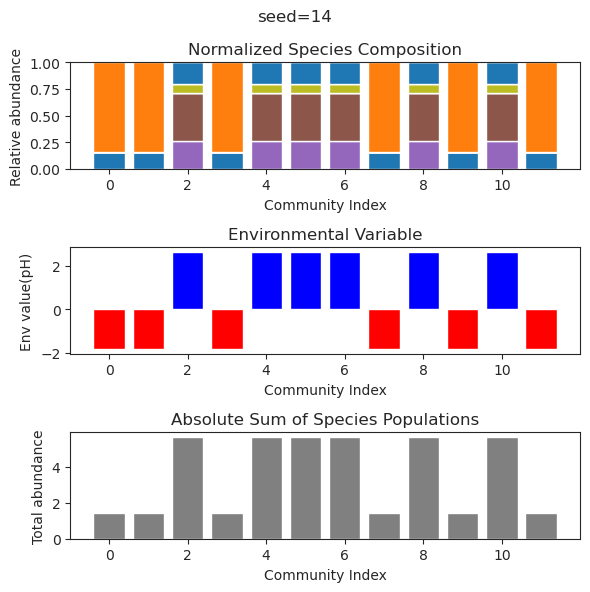

{'species': array([ 2.88208510e-01,  1.19050355e-47,  1.02868719e+00,  1.26479353e-68,
        1.68316606e-46, -3.49732478e-42, -6.71307416e-32,  4.35584237e-01,
        1.57892310e-38, -3.85970513e-73,  1.45682279e-65, -1.16552279e-23]), 'env': array([-2.61622258])}
{'species': array([ 2.88208510e-01,  2.27434301e-45,  1.02868719e+00,  1.79375828e-71,
        2.47211484e-41,  3.08413114e-38,  1.06345575e-26,  4.35584237e-01,
       -4.26255998e-38,  1.46029252e-71,  3.52970023e-59, -1.07454075e-21]), 'env': array([-2.61622258])}
{'species': array([ 2.88208510e-01, -9.34685026e-46,  1.02868719e+00, -9.29563617e-59,
        1.15249479e-43, -9.77000618e-38, -1.37317675e-32,  4.35584237e-01,
       -2.29005514e-38, -5.18173104e-65,  8.67210421e-61,  6.92055998e-23]), 'env': array([-2.61622258])}
{'species': array([ 2.88208510e-01, -1.58208062e-39,  1.02868719e+00, -3.17093304e-52,
       -1.23314583e-42, -8.60138984e-40, -3.58057264e-33,  4.35584237e-01,
        4.11911008e-32,  3.6117933

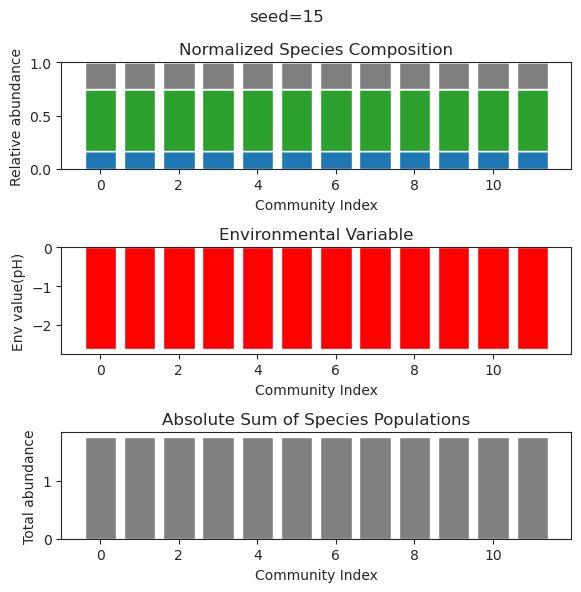

{'species': array([ 2.68390562e-01, -1.17083887e-34,  1.06822261e-27, -1.85744280e-18,
        1.59030748e-65,  8.88767192e-65, -5.12104731e-47,  1.08255029e+00,
        8.37110233e-55,  2.70706780e-63, -1.19966106e-56,  1.04647765e-52]), 'env': array([-2.77180968])}
{'species': array([ 2.68390562e-01,  6.14732009e-35,  7.34591226e-28, -3.84613992e-18,
       -2.32498548e-75, -5.85566609e-78,  3.60598363e-51,  1.08255029e+00,
       -3.59729501e-64,  7.47767109e-76,  5.48680266e-65, -1.39102735e-60]), 'env': array([-2.77180968])}
{'species': array([ 2.68390562e-01, -3.33719565e-34,  4.13016601e-25, -6.38927301e-18,
        2.49652047e-90,  3.32180946e-92, -4.42857019e-56,  1.08255029e+00,
        4.44311475e-81,  3.21772115e-86, -1.10565922e-76,  1.33304383e-72]), 'env': array([-2.77180968])}
{'species': array([ 2.68390562e-001,  4.47575849e-035, -5.08444614e-029,
        7.30422308e-017, -4.76508105e-116, -2.05780502e-119,
        1.15274465e-072,  1.08255029e+000,  8.46652697e-104,
 

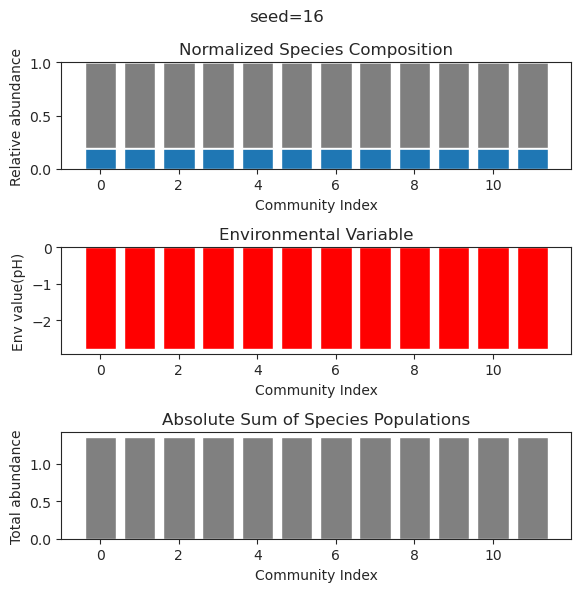

{'species': array([ 3.51382657e-01,  3.92792083e-19,  2.74229543e-52, -8.68149592e-48,
       -8.86336966e-48,  1.59056331e-35, -2.28263607e-43, -6.91405311e-67,
        5.41441773e-01,  1.66668948e-38,  3.22317748e-34,  2.26953977e-61]), 'env': array([-3.13733524])}
{'species': array([ 3.51382657e-01,  1.33937542e-20, -1.47239012e-57, -1.70051947e-44,
       -1.58021801e-44,  1.59434877e-31, -1.22397247e-47,  5.35808579e-77,
        5.41441773e-01, -9.38516935e-35, -3.89208716e-29,  3.50051482e-66]), 'env': array([-3.13733524])}
{'species': array([ 3.51382657e-01,  2.74286153e-19, -6.86931585e-56, -5.26115464e-46,
        1.53881676e-47,  8.46313619e-29, -1.31617006e-45, -9.66206510e-78,
        5.41441773e-01,  1.60474094e-35,  1.00119660e-27, -2.70002872e-63]), 'env': array([-3.13733524])}
{'species': array([ 3.51382657e-01,  4.75072035e-21, -3.95875068e-54,  9.56108984e-40,
       -4.11599565e-40,  6.51250545e-27,  4.71523120e-44,  7.26183714e-71,
        5.41441773e-01, -1.6733166

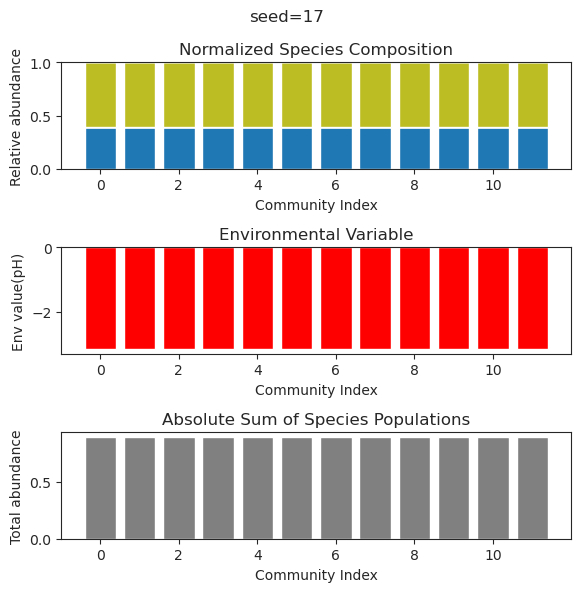

{'species': array([-1.54976302e-48,  3.47570886e-01,  8.34458421e-01,  3.82922286e-73,
       -1.56284428e-79, -1.47744146e-46,  3.34127897e-02, -8.50181538e-77,
       -1.16869488e-20,  1.08275326e-71, -7.26876639e-34, -3.35027112e-50]), 'env': array([-2.76332007])}
{'species': array([-1.90611643e-45,  3.47570886e-01,  8.34458421e-01,  1.00212391e-72,
        2.04285943e-73, -1.24039285e-43,  3.34127897e-02,  3.30556605e-73,
        1.96770379e-18, -2.94813820e-72,  5.60162691e-33, -7.17514131e-52]), 'env': array([-2.76332007])}
{'species': array([-6.58085197e-48,  3.47570886e-01,  8.34458421e-01,  6.25571780e-56,
       -3.44771507e-61, -1.04852577e-50,  3.34127897e-02, -4.79344740e-62,
        3.13972115e-23, -2.04192657e-36,  3.05662024e-33,  1.80451933e-44]), 'env': array([-2.76332007])}
{'species': array([ 1.75044713e-074,  3.47570886e-001,  8.34458421e-001,
       -1.03053852e-116, -3.42555697e-126,  4.15227034e-071,
        3.34127897e-002, -1.00549093e-125,  5.76334232e-024,
 

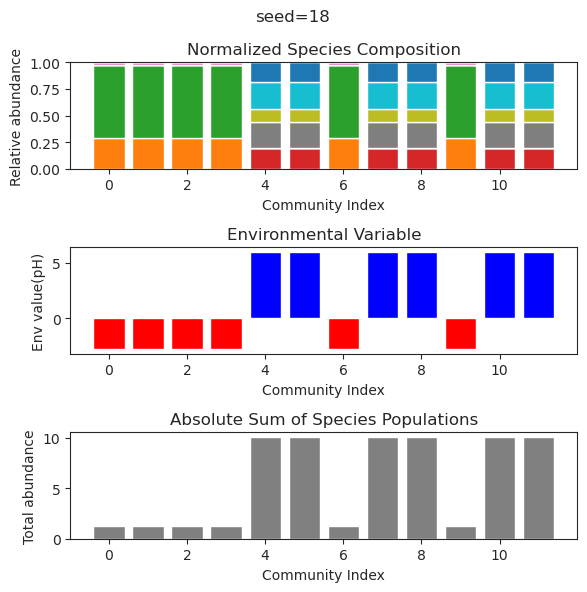

{'species': array([ 1.51054436e-01,  4.48687254e-17,  8.49807079e-01, -1.01448726e-37,
        1.19454558e-29,  1.55326834e-25, -2.69022236e-56, -8.24710570e-46,
       -9.67723098e-24,  3.93107312e-71,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([ 1.51054436e-01,  7.99439634e-18,  8.49807079e-01, -4.58342603e-41,
       -4.76009472e-33, -3.09402488e-29, -1.81624335e-64, -4.72966315e-47,
       -6.98248024e-29, -4.13808991e-78,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([ 1.51054436e-01,  2.22046588e-18,  8.49807079e-01, -1.07708226e-49,
       -1.87449966e-30, -2.12677578e-32, -2.45724293e-79, -2.01610654e-51,
        4.62186799e-28, -5.35239008e-88,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([ 1.51054436e-01,  3.04561142e-17,  8.49807079e-01,  3.16694246e-36,
        1.88336809e-28,  3.37609180e-28, -1.05989434e-53,  5.08547289e-39,
       -4.36429786e-29, -3.7169060

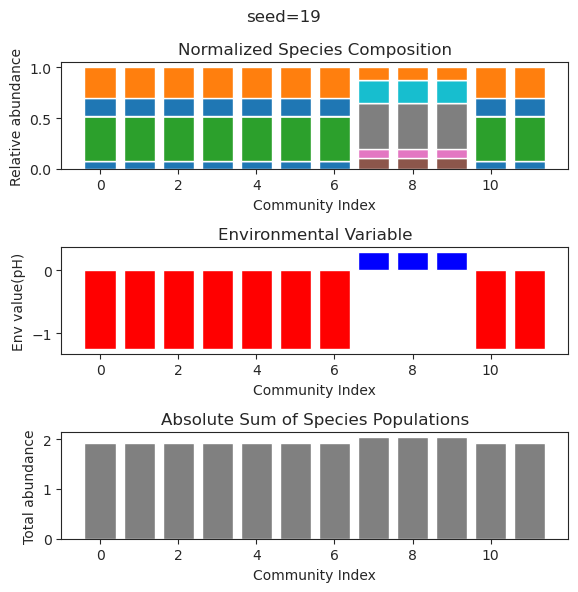

{'species': array([ 1.51054436e-01, -5.30264181e-17,  8.49807079e-01, -5.69202478e-54,
       -1.96782679e-30,  2.03342620e-37, -2.00000239e-76, -2.79876424e-53,
        8.47826085e-29, -2.01016939e-98,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([ 1.51054436e-01, -5.30264181e-17,  8.49807079e-01, -5.69202478e-54,
       -1.96782679e-30,  2.03342620e-37, -2.00000239e-76, -2.79876424e-53,
        8.47826085e-29, -2.01016939e-98,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([-4.70778918e-95, -1.40500331e-38,  7.45362939e-95,  1.02203276e-54,
       -2.34986712e-35,  2.15417685e-66,  1.76757132e+00,  1.64392799e+00,
        9.91183575e-01,  8.96788873e-54,  2.88531537e-73,  3.68411536e+00]), 'env': array([4.47617295])}
{'species': array([ 7.64192478e-119,  7.52927256e-064, -1.62591421e-138,
       -2.32448802e-086, -7.82690232e-043,  5.90306591e-108,
        1.76757132e+000,  1.64392799e+000,  9.91183575e-001,
  

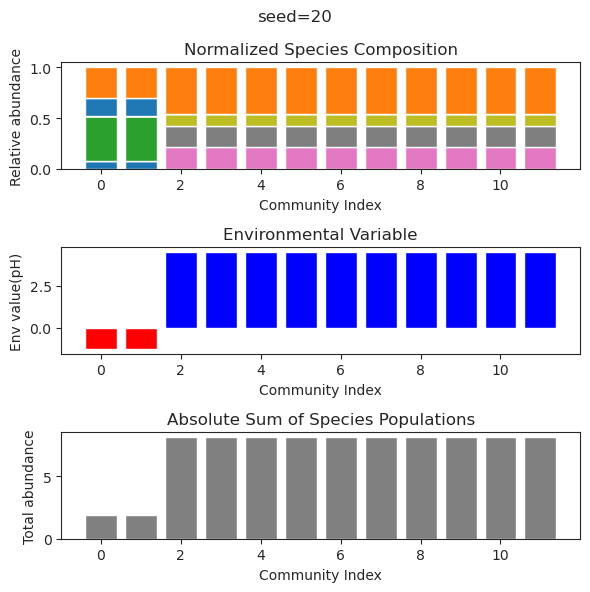

{'species': array([ 9.50010818e-002,  1.15833504e-193,  3.96548460e-001,
        1.78332143e-174,  3.13004570e-165,  2.80802831e-001,
        2.88868261e-001, -3.64102336e-002,  7.44004767e-089,
        0.00000000e+000,  1.55381839e-126,  4.60253403e-001]), 'env': array([-0.7123752])}
{'species': array([-1.39253015e-031,  2.93001070e-109,  4.61112064e-002,
        1.81727051e-138,  5.91639585e-001, -1.47647621e-026,
        1.57975810e-001,  3.54027399e-001,  1.59481192e-001,
        1.30691182e-129,  1.94216406e-083,  6.57886225e-001]), 'env': array([0.0666682])}
{'species': array([-1.42428895e-19,  4.30419317e-52,  4.61112064e-02,  2.87400427e-54,
        5.91639585e-01, -1.44175251e-18,  1.57975810e-01,  3.54027399e-01,
        1.59481192e-01,  4.35124497e-44, -2.13441642e-32,  6.57886225e-01]), 'env': array([0.0666682])}
{'species': array([-5.10001602e-25, -1.48842635e-79,  4.61112064e-02,  4.30371855e-93,
        5.91639585e-01, -4.72810023e-22,  1.57975810e-01,  3.54027399e-01,
 

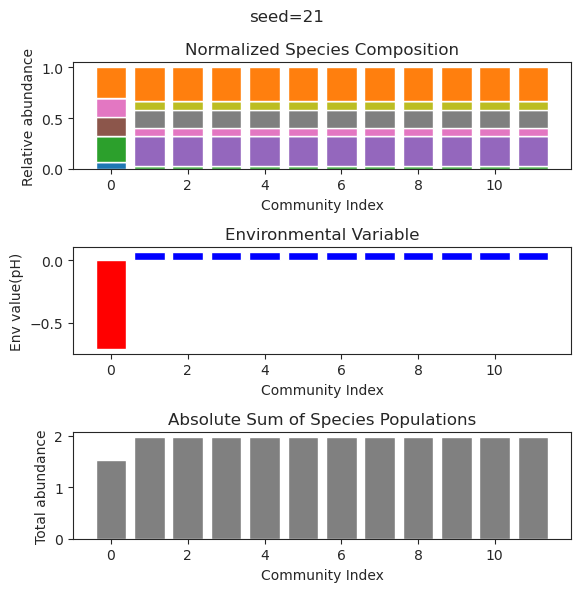

{'species': array([ 5.01830708e-02,  1.47158511e-01,  3.06395067e-51,  7.80500479e-88,
        1.28358894e-43, -3.53910725e-45,  4.12590072e-01,  6.22474388e-01,
       -2.14971709e-28, -7.85619266e-27, -8.13381714e-48,  3.84917051e-20]), 'env': array([-1.68579379])}
{'species': array([ 5.01830708e-02,  1.47158511e-01, -5.53832924e-45,  6.16522872e-68,
        7.21342817e-41,  3.72804476e-38,  4.12590072e-01,  6.22474388e-01,
       -5.06476154e-26, -2.84145347e-26,  1.55654935e-38,  2.67772726e-20]), 'env': array([-1.68579379])}
{'species': array([ 5.01830708e-02,  1.47158511e-01,  2.18163573e-54, -5.42940696e-91,
        3.91431539e-44,  6.60139192e-48,  4.12590072e-01,  6.22474388e-01,
       -3.64916252e-28, -5.31823063e-27,  2.80183262e-49,  2.01262199e-20]), 'env': array([-1.68579379])}
{'species': array([ 5.01830708e-02,  1.47158511e-01,  1.24097412e-45, -2.20720457e-69,
       -2.70939041e-42,  3.47188934e-39,  4.12590072e-01,  6.22474388e-01,
       -1.66594832e-25, -1.6843784

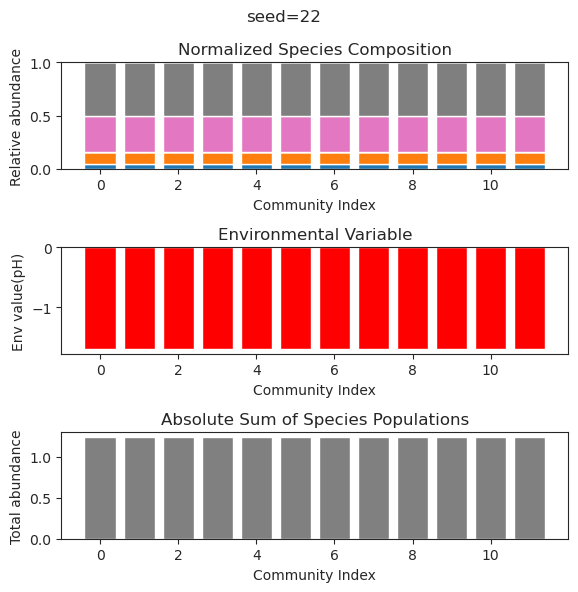

{'species': array([ 1.15069057e-01, -8.42879865e-38, -1.85837434e-56,  5.89464740e-23,
        4.62308461e-01,  2.16325239e-76,  5.44918965e-07,  5.73883555e-01,
        4.06734135e-01, -2.21293174e-73,  7.25002360e-25,  2.14525039e-01]), 'env': array([-0.58246701])}
{'species': array([ 1.15774090e-01,  3.16225419e-28,  3.18294242e-27,  6.58282113e-32,
        4.59688841e-01, -6.01024946e-27,  2.86361706e-03,  5.73321274e-01,
        4.10135744e-01,  5.04568768e-27, -7.64404703e-30,  2.11140442e-01]), 'env': array([-0.58499569])}
{'species': array([ 1.15777224e-01,  2.09815847e-39,  3.48563278e-34,  1.94958414e-29,
        4.59676872e-01,  4.26916227e-30,  2.87580178e-03,  5.73319390e-01,
        4.10151497e-01, -3.44956511e-35,  9.69752037e-31,  2.11124985e-01]), 'env': array([-0.58500712])}
{'species': array([ 1.15777178e-01, -7.18080917e-35,  1.74416894e-32,  5.47954661e-30,
        4.59677047e-01,  1.01086035e-33,  2.87562370e-03,  5.73319417e-01,
        4.10151267e-01,  3.5367287

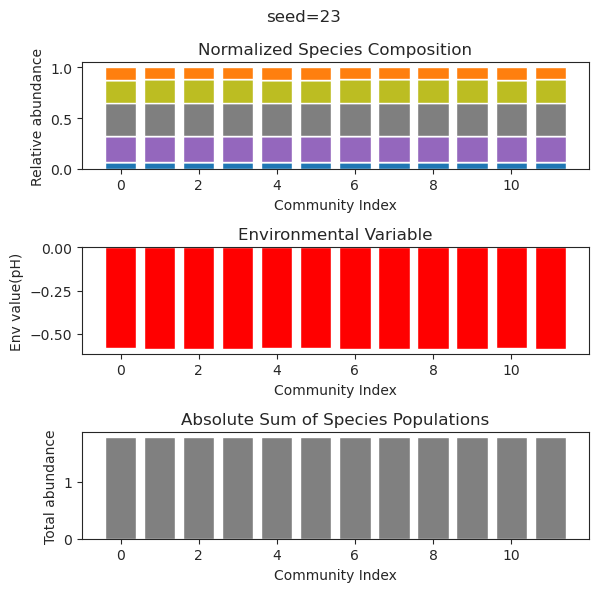

{'species': array([ 1.07390889e-01, -6.30186492e-49, -3.89855582e-73,  3.35934365e-01,
       -9.51502121e-64,  6.42241030e-01, -2.36131424e-68,  5.66868868e-01,
       -3.10840167e-41,  2.79565145e-01, -3.96760372e-31,  5.02373337e-95]), 'env': array([-0.28425011])}
{'species': array([ 1.07390889e-01,  2.71076342e-48,  1.22852953e-73,  3.35934365e-01,
        1.75928030e-64,  6.42241030e-01,  2.45324125e-67,  5.66868868e-01,
       -1.01706965e-40,  2.79565145e-01, -8.90508579e-29,  2.58700436e-98]), 'env': array([-0.28425011])}
{'species': array([ 1.07390889e-01,  7.27038722e-57,  1.34257974e-81,  3.35934365e-01,
        2.84906301e-67,  6.42241030e-01,  2.48591322e-85,  5.66868868e-01,
        2.28703147e-47,  2.79565145e-01, -4.99292025e-38,  3.41369661e-99]), 'env': array([-0.28425011])}
{'species': array([ 1.07390889e-01, -6.86569983e-46,  7.75596258e-69,  3.35934365e-01,
       -9.41920588e-61,  6.42241030e-01,  8.11660693e-64,  5.66868868e-01,
       -2.38875029e-38,  2.7956514

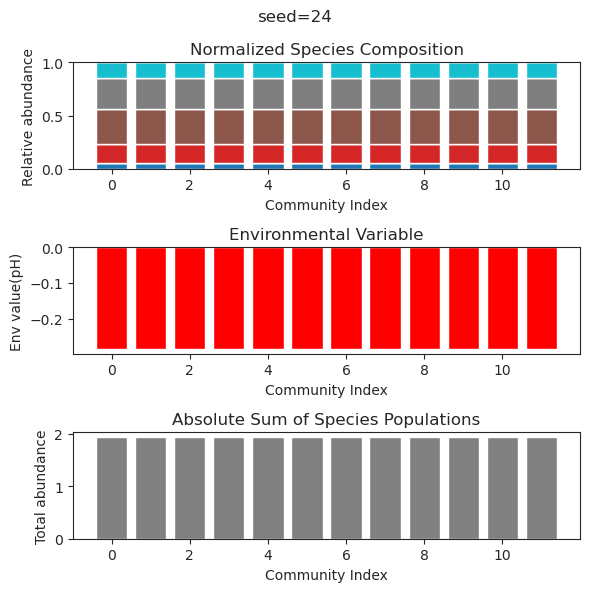

{'species': array([ 3.01207281e-01,  9.08418093e-31,  2.34070212e-24,  5.12947085e-30,
        3.57190002e-55,  1.64209143e-56,  1.01468199e-56, -4.97499719e-54,
        6.05779664e-59,  7.30655263e-01,  4.04116822e-61,  3.49376986e-01]), 'env': array([-1.95544865])}
{'species': array([ 3.01207281e-01, -6.30405686e-31, -4.22927216e-26, -1.67166634e-31,
        5.42528795e-52,  3.75717232e-52,  4.20946650e-54,  4.76251234e-55,
        1.32165391e-56,  7.30655263e-01,  9.63485902e-59,  3.49376986e-01]), 'env': array([-1.95544865])}
{'species': array([ 3.01207281e-01, -3.85240772e-29, -7.80569306e-24, -1.94123961e-32,
        1.29058276e-51,  1.61673752e-53,  1.03451293e-54, -4.09144393e-51,
        8.22849609e-54,  7.30655263e-01, -3.96495313e-54,  3.49376986e-01]), 'env': array([-1.95544865])}
{'species': array([ 3.01207281e-01, -2.85181592e-31,  8.71119113e-26, -8.09977416e-33,
        4.61965915e-53,  3.75599974e-53, -2.94156929e-56, -1.90148384e-57,
       -1.90826885e-57,  7.3065526

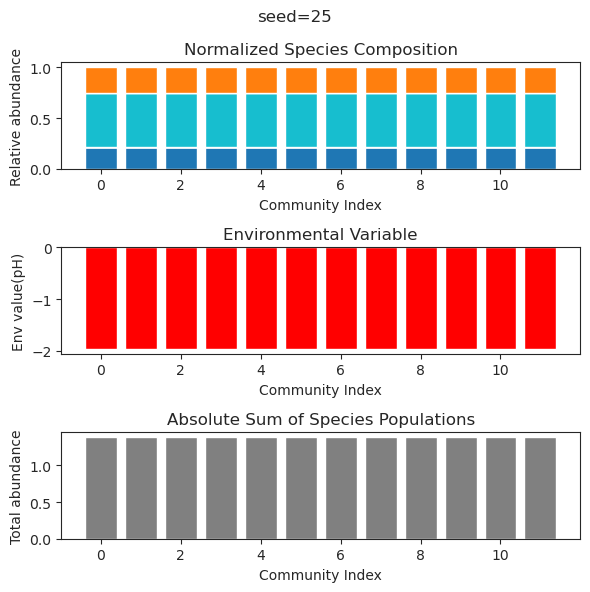

{'species': array([ 3.34311920e-01,  7.34711765e-19,  5.87411822e-35, -2.09714508e-27,
       -6.12900656e-42, -5.25653994e-54, -6.39874486e-57, -1.27345544e-53,
       -9.13339430e-51,  1.07667827e+00, -4.59405702e-44, -3.29929739e-46]), 'env': array([-2.27893754])}
{'species': array([ 3.34311920e-01, -5.21229232e-20, -7.86969594e-41, -2.61524817e-31,
        2.77469012e-47, -2.16555133e-61, -2.27403152e-62, -2.16318095e-62,
        8.97277808e-58,  1.07667827e+00,  6.51588748e-45,  2.67965621e-48]), 'env': array([-2.27893754])}
{'species': array([-5.11001636e-26, -4.19412095e-54,  7.66522086e-53,  6.14882071e-51,
        2.34077578e-01,  3.18016187e-57,  3.74777942e-01, -9.77259273e-27,
        6.14278325e-01, -1.77375685e-50,  6.54477501e-01,  5.28473558e-01]), 'env': array([0.04071568])}
{'species': array([ 3.34311920e-01,  1.70083379e-23,  7.88726489e-38,  2.31276273e-33,
       -1.10121989e-43,  1.80177569e-58,  1.56046352e-58,  1.91571849e-58,
       -4.57133692e-54,  1.07667827

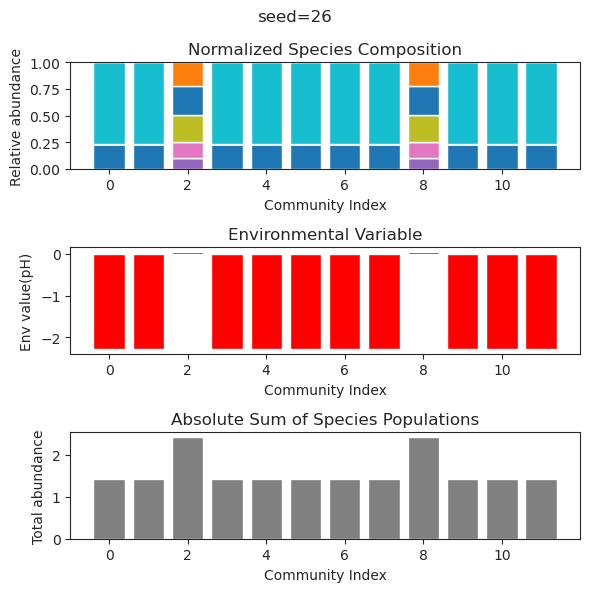

{'species': array([ 1.49354600e-01,  2.01971725e-01,  5.75945073e-62,  4.86892159e-54,
        1.32859101e-62, -5.52721247e-38,  1.45713371e-58, -1.49803775e-50,
        1.44025010e-51,  9.28410553e-25, -4.70951620e-27, -3.86618602e-48]), 'env': array([-3.43061259])}
{'species': array([ 1.49354600e-001,  2.01971725e-001,  8.30991838e-102,
        1.72678733e-089, -2.96886184e-106, -1.21697674e-041,
        3.10453751e-094,  9.00998935e-072,  7.51067016e-085,
        1.84697844e-026,  8.93933531e-029, -8.13996285e-070]), 'env': array([-3.43061259])}
{'species': array([ 1.49354600e-001,  2.01971725e-001,  1.79521489e-138,
        5.54551261e-116, -2.63363215e-150,  1.89921031e-044,
       -5.16875863e-126, -1.09698313e-091,  7.83847868e-112,
       -5.24330195e-026, -6.77226231e-029, -8.92044256e-090]), 'env': array([-3.43061259])}
{'species': array([ 1.49354600e-001,  2.01971725e-001, -1.82151461e-117,
       -1.08175340e-096,  1.46328128e-110, -1.03593255e-035,
        2.35318345e-110,

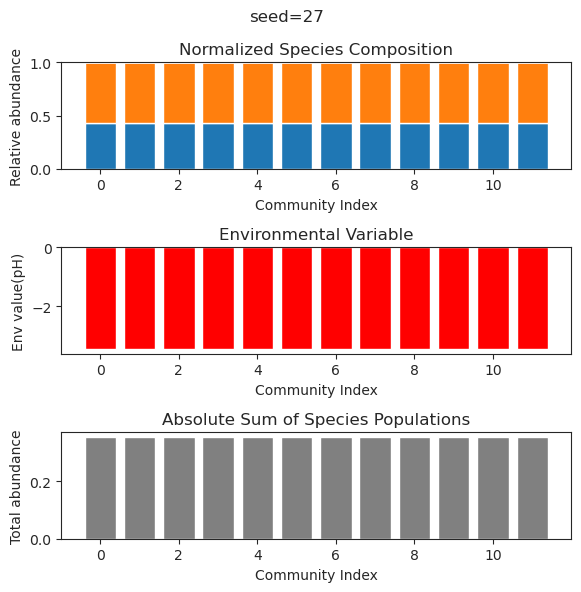

{'species': array([-3.50543397e-66,  1.91057934e-01, -1.15845289e-37, -7.25555002e-57,
        6.43860919e-01,  2.18244141e-01,  7.64760241e-57, -1.87387853e-72,
        7.90518815e-66,  5.36002735e-01,  8.08733987e-78,  3.14442530e-01]), 'env': array([-0.88141885])}
{'species': array([-1.53796020e-64,  1.91057934e-01,  1.29622831e-40, -2.07853565e-58,
        6.43860919e-01,  2.18244141e-01,  4.87941415e-51,  2.61034383e-70,
        3.53671104e-66,  5.36002735e-01,  1.24354150e-73,  3.14442530e-01]), 'env': array([-0.88141885])}
{'species': array([ 6.86089924e-002,  4.24199516e-146,  2.01095189e-001,
        1.13181104e+000,  1.36776569e-054,  8.34520086e-003,
        1.40225744e+000, -1.48219694e-323,  4.65927019e-136,
        2.53448419e-001,  2.33598676e-045,  2.72855453e-002]), 'env': array([0.93397648])}
{'species': array([ 1.58227814e-41, -8.49667427e-68,  1.59339906e-54,  4.50819279e+00,
       -3.33236829e-49,  5.10494433e-67,  5.48702255e+00,  2.33847290e-62,
       -1.313292

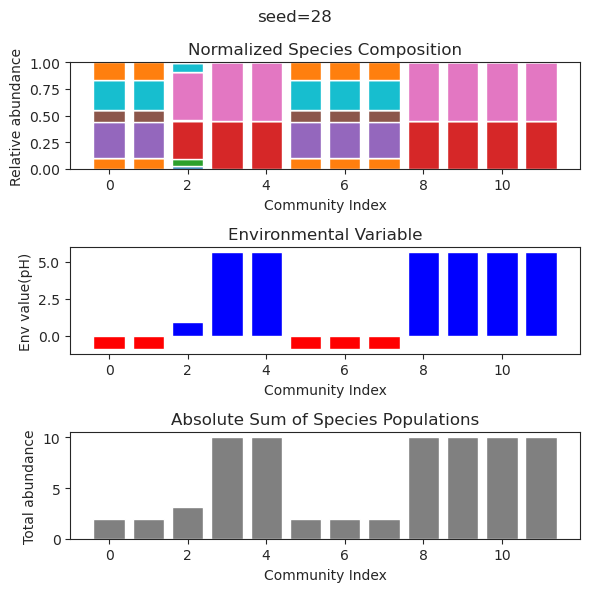

{'species': array([ 3.60112865e-074,  1.53754096e-116,  2.34787430e+000,
       -2.93709360e-077, -3.29688434e-109, -8.14443733e-058,
        1.95815651e+000,  3.44691820e-084,  9.45623716e-001,
       -1.55142394e-028,  3.99329241e-109,  2.59192770e-109]), 'env': array([2.09025217])}
{'species': array([-4.71412593e-70,  1.04815367e-98,  2.34787430e+00, -2.48869385e-69,
       -1.62570578e-98, -3.29650826e-60,  1.95815651e+00, -3.48271936e-76,
        9.45623716e-01,  2.70670635e-25, -7.68711876e-89, -1.20548685e-94]), 'env': array([2.09025217])}
{'species': array([-2.49995882e-080,  8.63909443e-116,  2.34787430e+000,
        1.14696626e-059,  2.64913975e-111,  4.35661727e-050,
        1.95815651e+000,  1.95095209e-085,  9.45623716e-001,
        7.04400916e-026,  2.07277981e-109, -9.39877063e-105]), 'env': array([2.09025217])}
{'species': array([-4.02893534e-72, -1.32594437e-98,  2.34787430e+00,  3.00305230e-46,
        8.80031373e-92,  2.43339486e-43,  1.95815651e+00,  4.57299424e-75,

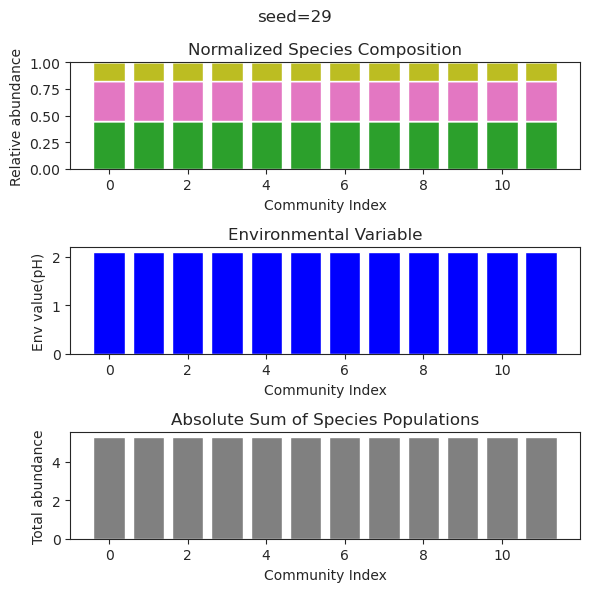

{'species': array([ 5.92400638e-81,  2.99794304e-01, -2.36731465e-86,  8.36479729e-63,
        2.50379792e-01, -1.91999094e-29,  8.02908786e-01,  1.51587248e-01,
       -7.12372423e-20,  1.29412677e-45, -1.41992188e-64, -1.38468741e-68]), 'env': array([-2.13066378])}
{'species': array([ 1.06301668e-57,  2.99794304e-01,  2.02101105e-59, -3.70287239e-46,
        2.50379792e-01,  1.30385429e-27,  8.02908786e-01,  1.51587248e-01,
       -2.65111859e-18,  4.20653718e-37,  1.50816448e-51,  1.44402031e-54]), 'env': array([-2.13066378])}
{'species': array([ 1.33862153e-77,  2.99794304e-01,  2.17265033e-81,  5.07812918e-62,
        2.50379792e-01,  2.75749704e-28,  8.02908786e-01,  1.51587248e-01,
       -1.03767837e-17,  4.60789805e-40,  1.07714159e-61,  1.66845032e-66]), 'env': array([-2.13066378])}
{'species': array([ 1.37669994e-48,  2.99794304e-01, -7.75381414e-48, -9.55448944e-39,
        2.50379792e-01, -2.12936601e-29,  8.02908786e-01,  1.51587248e-01,
       -6.35672604e-18, -1.2580576

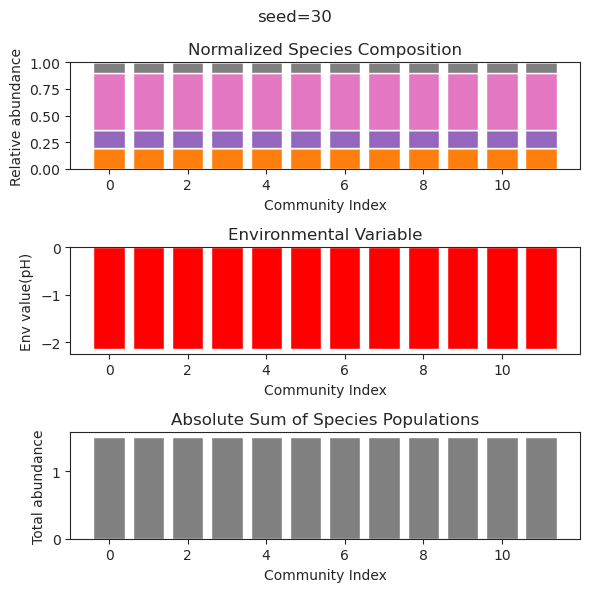

{'species': array([ 4.02541203e-50,  2.16641032e-01, -2.02253285e-28,  8.58459614e-01,
        6.73306924e-01,  2.89262159e-39,  9.66201801e-40,  1.81067446e-49,
        2.00067882e-41,  1.31601348e-01, -4.93821417e-48, -2.15632088e-47]), 'env': array([-1.40302269])}
{'species': array([-4.15551166e-52,  2.16641032e-01, -4.57666194e-31,  8.58459614e-01,
        6.73306924e-01, -9.36584910e-38,  2.40983420e-42, -7.10771593e-50,
        4.39169677e-41,  1.31601348e-01,  1.77257069e-47,  3.68776732e-50]), 'env': array([-1.40302269])}
{'species': array([ 5.69665601e-51,  2.16641032e-01,  7.98145584e-29,  8.58459614e-01,
        6.73306924e-01, -1.13818426e-40,  1.16458261e-38, -4.82037282e-47,
       -6.52093753e-45,  1.31601348e-01, -4.18121881e-45, -3.10714672e-46]), 'env': array([-1.40302269])}
{'species': array([-4.03765182e-52,  2.16641032e-01, -7.83696666e-29,  8.58459614e-01,
        6.73306924e-01,  8.93858478e-37,  3.12510118e-38, -2.83603861e-47,
        9.72077912e-40,  1.3160134

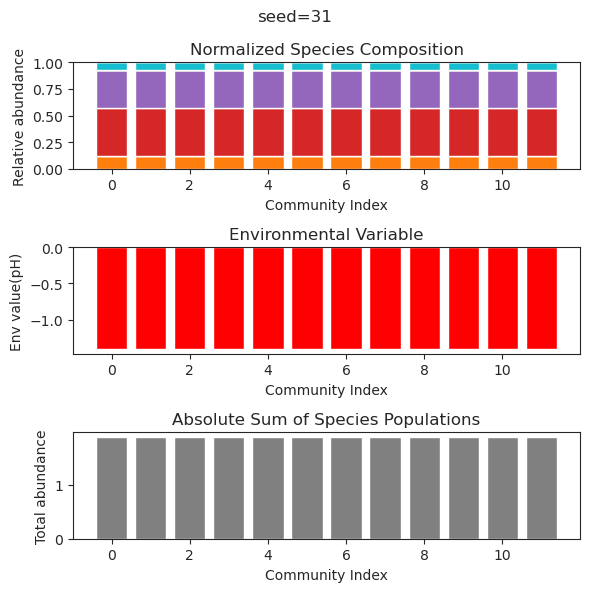

{'species': array([ 6.88979071e-084,  2.05939255e-001, -2.25410928e-131,
       -4.75179375e-132, -4.15559013e-027,  3.05588032e-070,
       -4.56316036e-072, -1.03882271e-035,  2.83786070e-001,
        1.11542333e+000, -7.87469280e-046,  8.40846343e-002]), 'env': array([-1.96582021])}
{'species': array([ 1.99633676e-083,  2.05939255e-001,  5.45626113e-132,
        7.77574987e-131, -4.15996626e-025, -1.72957768e-074,
       -2.44622451e-073, -6.16827181e-036,  2.83786070e-001,
        1.11542333e+000,  1.12421385e-044,  8.40846343e-002]), 'env': array([-1.96582021])}
{'species': array([-3.09634138e-023, -8.59450179e-098,  6.32792263e-083,
        1.04017502e-092,  8.00432138e-001,  1.90484560e+000,
       -2.83591981e-097,  2.23363159e+000,  1.39915674e-077,
       -5.00951154e-104,  1.44682028e-047,  1.37165608e-034]), 'env': array([2.27421335])}
{'species': array([ 9.12587671e-23,  3.05933222e-35,  1.01737646e-44, -2.69111730e-43,
        8.00432138e-01,  1.90484560e+00, -1.43180919e

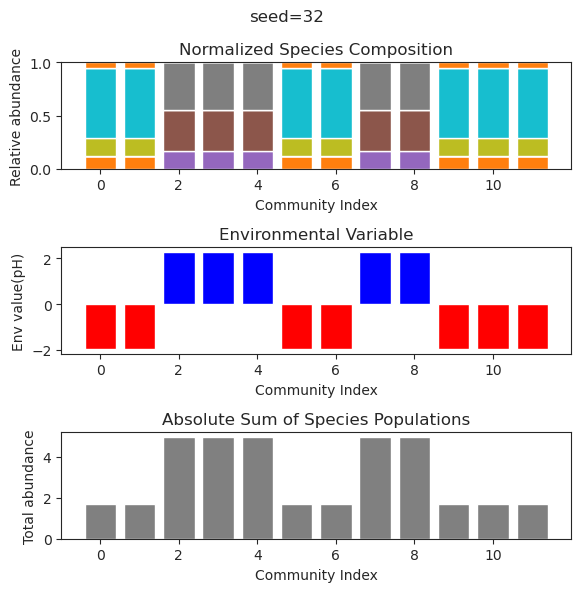

{'species': array([ 2.44050380e-002, -6.82280621e-067,  4.41729884e-001,
        4.99371022e-001,  4.82350812e-001,  2.19557203e-001,
        3.78664638e-121, -8.06418907e-112, -8.45223649e-099,
       -3.35787164e-041, -8.90573793e-122,  4.14571777e-001]), 'env': array([-0.20264538])}
{'species': array([ 2.44050380e-002, -1.30658094e-062,  4.41729884e-001,
        4.99371022e-001,  4.82350812e-001,  2.19557203e-001,
       -7.10542857e-111, -9.13928927e-099, -5.06931605e-091,
        2.23248109e-038, -2.52734998e-108,  4.14571777e-001]), 'env': array([-0.20264538])}
{'species': array([ 2.44050380e-02, -4.44243636e-53,  4.41729884e-01,  4.99371022e-01,
        4.82350812e-01,  2.19557203e-01, -6.19796053e-92,  8.09357822e-89,
       -3.54273289e-75,  4.00998842e-37, -1.11116191e-94,  4.14571777e-01]), 'env': array([-0.20264538])}
{'species': array([ 2.44050380e-002, -2.37175867e-057,  4.41729884e-001,
        4.99371022e-001,  4.82350812e-001,  2.19557203e-001,
        1.23494232e-106,

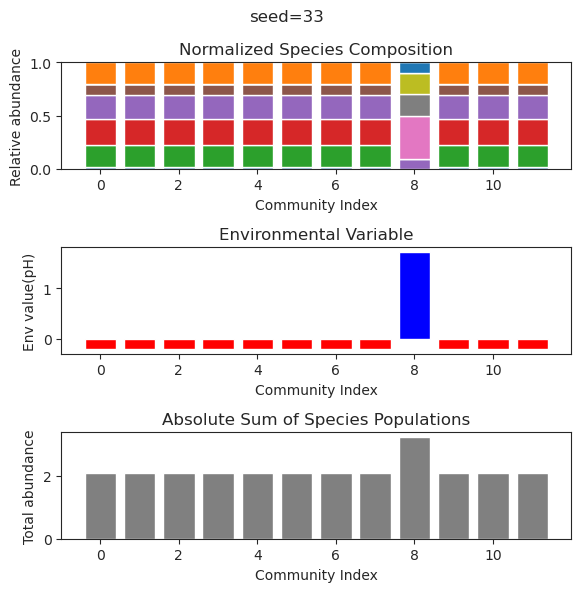

{'species': array([ 3.77933406e-01,  6.17508158e-44, -1.22190316e-39, -1.10744243e-83,
        9.27063194e-01, -1.54904686e-95, -4.62727828e-42,  3.66617330e-59,
        5.88798321e-02, -3.72687199e-51,  1.02125435e+00, -4.37619173e-21]), 'env': array([-2.92148959])}
{'species': array([ 3.77933406e-01,  1.32448444e-63, -1.29305349e-35,  4.96661034e-84,
        9.27063194e-01, -3.78563324e-90, -2.86762719e-38,  7.89222816e-60,
        5.88798321e-02, -2.35688767e-51,  1.02125435e+00, -8.02635910e-26]), 'env': array([-2.92148959])}
{'species': array([ 3.77933406e-01,  1.35609742e-49, -1.55177116e-39, -6.34562076e-60,
        9.27063194e-01, -2.18171707e-65, -8.80591314e-41, -6.12615511e-46,
        5.88798321e-02, -5.30619693e-44,  1.02125435e+00,  5.72040584e-29]), 'env': array([-2.92148959])}
{'species': array([ 3.77933406e-01,  1.91448052e-45, -7.29446200e-34, -2.33574679e-68,
        9.27063194e-01,  3.90909019e-68, -3.75765267e-36, -1.49854775e-58,
        5.88798321e-02,  6.1241519

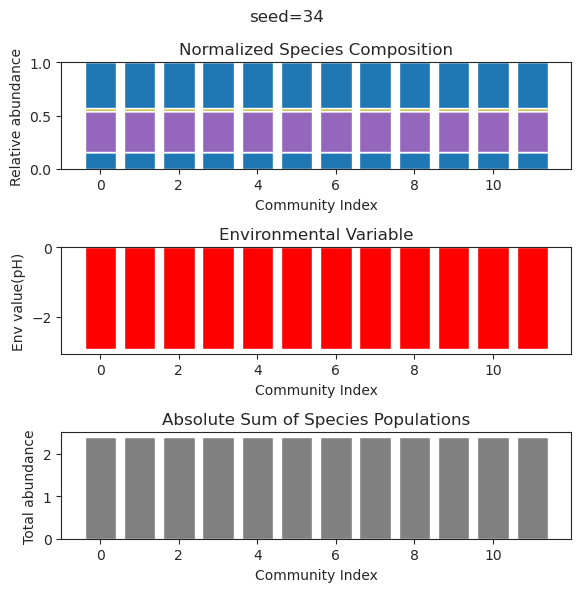

{'species': array([ 3.32868792e-01, -1.06120879e-50, -6.93529838e-94, -1.12700734e-58,
       -5.11862535e-82,  5.20201144e-01, -5.25705917e-83,  1.85427959e-01,
        1.38131241e-95,  2.72731939e-95, -1.82505458e-26,  1.51633671e-50]), 'env': array([-2.78942174])}
{'species': array([ 3.32868792e-01, -2.21360364e-50, -9.51015108e-99, -2.54465956e-58,
       -2.30328753e-85,  5.20201144e-01, -4.94720262e-85,  1.85427959e-01,
       -7.74084953e-99, -2.04144771e-99,  3.21300341e-25, -5.61488388e-58]), 'env': array([-2.78942174])}
{'species': array([ 3.32868792e-01,  6.67248389e-45,  7.73719462e-86,  5.11343240e-55,
       -9.02343019e-74,  5.20201144e-01, -1.75502346e-74,  1.85427959e-01,
        9.99717559e-83,  1.70989680e-83,  9.82891213e-24, -1.00610588e-44]), 'env': array([-2.78942174])}
{'species': array([ 3.32868792e-01,  3.56475270e-39, -5.44928462e-59,  2.83356613e-41,
        9.33560827e-57,  5.20201144e-01,  1.06863669e-55,  1.85427959e-01,
        8.28260817e-60,  5.9758479

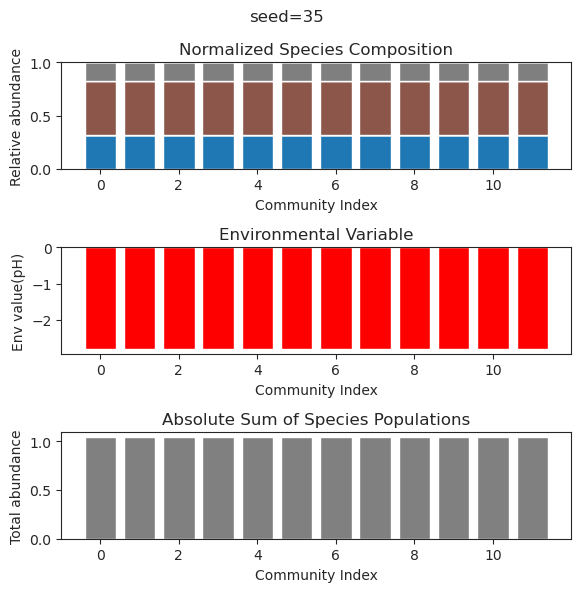

{'species': array([-6.38490710e-52,  1.84982773e-01,  7.85174612e-01,  2.47562990e-02,
        1.73303269e-38,  6.57032478e-01,  1.39106358e-29,  1.73592621e-63,
       -2.24764791e-53, -6.20176817e-49, -6.82102137e-61,  2.24024103e-60]), 'env': array([-1.93079834])}
{'species': array([ 9.16193383e-46,  1.84982773e-01,  7.85174612e-01,  2.47562990e-02,
       -1.52593927e-40,  6.57032478e-01, -7.44943640e-26, -1.12990862e-96,
       -8.99371821e-76,  1.80651348e-64, -1.24203199e-94, -3.34292740e-89]), 'env': array([-1.93079834])}
{'species': array([ 3.96257410e-62,  1.84982773e-01,  7.85174612e-01,  2.47562990e-02,
       -9.16896629e-37,  6.57032478e-01,  1.17257420e-27, -4.11152084e-73,
        3.05096893e-63, -1.00334376e-51,  4.77269995e-78, -3.59995770e-71]), 'env': array([-1.93079834])}
{'species': array([-1.13126266e-48,  1.84982773e-01,  7.85174612e-01,  2.47562990e-02,
       -2.85102356e-35,  6.57032478e-01,  1.35710602e-27, -4.89602752e-60,
       -2.58737414e-49,  3.9797403

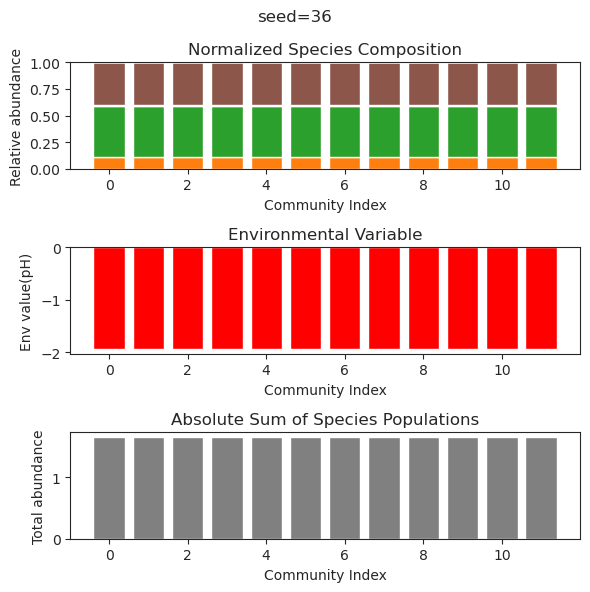

{'species': array([ 4.23181113e-02,  1.75804303e-01, -4.05664371e-52, -4.73306986e-38,
        4.12899143e-18,  6.37485000e-01,  1.87919567e-53, -3.53211028e-75,
       -1.43932315e-24,  1.08015108e-58, -1.60194766e-75,  4.64763158e-73]), 'env': array([-2.19954443])}
{'species': array([ 4.23181113e-02,  1.75804303e-01, -5.51094388e-63, -1.80933935e-40,
        3.10803321e-20,  6.37485000e-01, -2.16230606e-63,  9.30897994e-83,
        2.55354520e-28,  3.09742649e-64,  1.69810675e-80,  7.13799467e-79]), 'env': array([-2.19954443])}
{'species': array([ 4.23181113e-002,  1.75804303e-001, -1.86615350e-071,
        1.16990936e-038,  1.86271964e-019,  6.37485000e-001,
       -5.85789826e-075, -2.28522968e-099, -3.05787045e-025,
       -1.06552207e-081, -1.55873673e-099, -5.77139037e-101]), 'env': array([-2.19954443])}
{'species': array([ 4.23181113e-02,  1.75804303e-01,  2.70163653e-57, -7.68390113e-36,
        7.29615319e-20,  6.37485000e-01, -4.21681654e-58, -1.73288786e-77,
       -2.80091

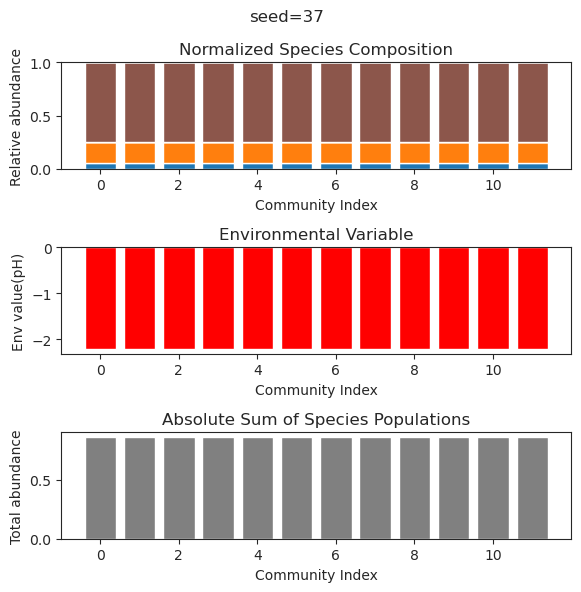

{'species': array([ 1.25842686e-001,  8.83420310e-044,  2.58308511e-001,
        5.25090936e-131,  1.27318268e-122,  2.07115644e-001,
       -3.40294616e-088,  2.17663830e-001,  1.62377018e-080,
        1.48206226e-001,  1.90919652e-003,  5.53587755e-001]), 'env': array([-0.83066344])}
{'species': array([ 1.25842456e-001,  1.62566885e-060,  2.58307540e-001,
        3.97973787e-126, -3.18028503e-122,  2.07117247e-001,
       -2.13526637e-087,  2.17666127e-001,  6.37792524e-078,
        1.48203791e-001,  1.90842835e-003,  5.53587868e-001]), 'env': array([-0.83066158])}
{'species': array([ 1.25471867e-001,  4.35492733e-027,  2.56640782e-001,
       -3.76597461e-131,  2.35854956e-027,  2.09794022e-001,
        1.71212495e-027,  2.21506617e-001, -1.12422673e-027,
        1.44196490e-001,  4.59996959e-004,  5.53862851e-001]), 'env': array([-0.82775213])}
{'species': array([ 1.25841111e-001, -1.45777036e-047,  2.58301856e-001,
       -5.94207313e-121,  4.73402387e-128,  2.07126633e-001,
     

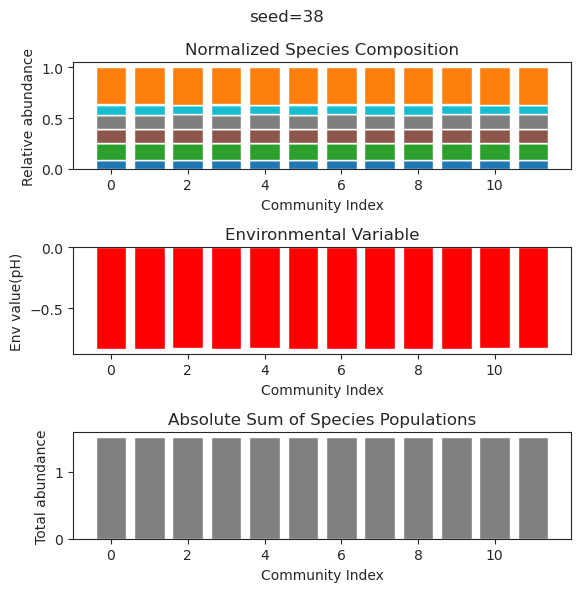

{'species': array([-1.15400924e-091, -4.84094085e-114,  7.86808840e-040,
        1.47479141e-061,  2.53191406e-116,  1.33810718e-088,
        5.23449859e+000,  1.12326453e-101,  1.84364010e-106,
        2.54281343e+000,  1.36756594e-121, -3.19151050e-070]), 'env': array([6.41922629])}
{'species': array([-1.34376583e-087, -9.08951542e-106, -4.53117455e-038,
       -7.15100167e-058,  3.21197873e-108, -4.99089241e-085,
        5.23449859e+000, -3.61171140e-096, -1.82899266e-099,
        2.54281343e+000,  9.80528705e-113,  3.39480077e-067]), 'env': array([6.41922629])}
{'species': array([-3.10513643e-42,  3.52869187e-95,  1.95871713e-35, -1.23116752e-59,
       -3.11170350e-92,  5.11916433e-78,  5.23449859e+00,  3.69172193e-83,
       -5.31199833e-89,  2.54281343e+00,  2.73393646e-94,  1.97858240e-58]), 'env': array([6.41922629])}
{'species': array([ 1.30440737e-080, -1.89386183e-099,  4.45841549e-032,
        4.00865551e-059,  3.25542984e-096, -1.06537054e-067,
        5.23449859e+000,  1

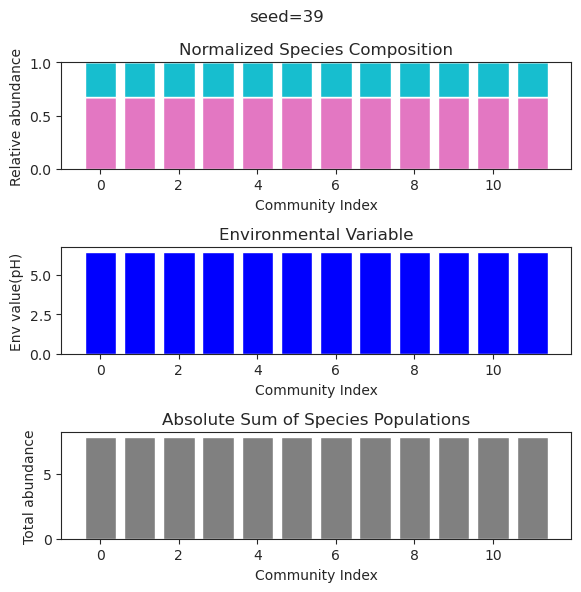

{'species': array([-4.38394115e-028,  3.18502689e-003,  5.39521332e-006,
        4.47739319e-001,  1.69363795e-001,  8.13372496e-001,
       -2.29588521e-101,  9.21251344e-075,  1.54973975e-097,
        2.48148274e-033,  6.69574968e-001,  6.54305350e-002]), 'env': array([0.46054571])}
{'species': array([-2.40717400e-28,  3.18483496e-03,  3.10965138e-06,  4.47740275e-01,
        1.69364775e-01,  8.13374564e-01, -2.25620692e-80, -1.62033140e-61,
       -1.16074675e-28, -2.05672434e-30,  6.69576107e-01,  6.54283127e-02]), 'env': array([0.46054666])}
{'species': array([ 2.09141849e-28,  3.18592777e-03,  1.61238894e-05,  4.47734835e-01,
        1.69359197e-01,  8.13362787e-01, -3.75179621e-35,  3.97308453e-42,
       -1.41717407e-30, -3.23239434e-33,  6.69569624e-01,  6.54409666e-02]), 'env': array([0.46054125])}
{'species': array([-1.18096613e-027,  3.18629309e-003,  2.04746018e-005,
        4.47733016e-001,  1.69357332e-001,  8.13358850e-001,
       -6.13866992e-033, -5.87526667e-070, -3.

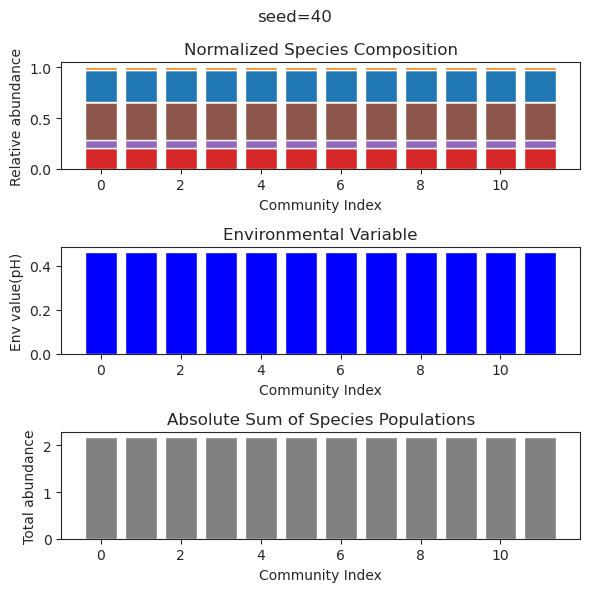

{'species': array([ 6.07914789e-002,  1.90923932e-002,  3.69041555e-001,
        1.68659802e-166, -1.78430582e-089, -1.49486473e-094,
        8.68825636e-036,  2.12693296e-001,  1.62965287e-001,
        4.55587429e-001, -5.36749699e-137,  6.33654466e-001]), 'env': array([-0.13358845])}
{'species': array([ 6.07914789e-002,  1.90923932e-002,  3.69041555e-001,
        3.25607662e-162,  5.99583936e-089,  2.05831234e-090,
       -5.12276880e-037,  2.12693296e-001,  1.62965287e-001,
        4.55587429e-001, -1.21563076e-132,  6.33654466e-001]), 'env': array([-0.13358845])}
{'species': array([ 6.07914789e-002,  1.90923932e-002,  3.69041555e-001,
       -4.65427624e-159,  1.89973884e-088,  3.03485141e-093,
        3.53125078e-035,  2.12693296e-001,  1.62965287e-001,
        4.55587429e-001, -3.25494747e-127,  6.33654466e-001]), 'env': array([-0.13358845])}
{'species': array([ 6.07914789e-002,  1.90923932e-002,  3.69041555e-001,
        2.26062960e-152,  8.69426407e-090,  1.51384677e-090,
     

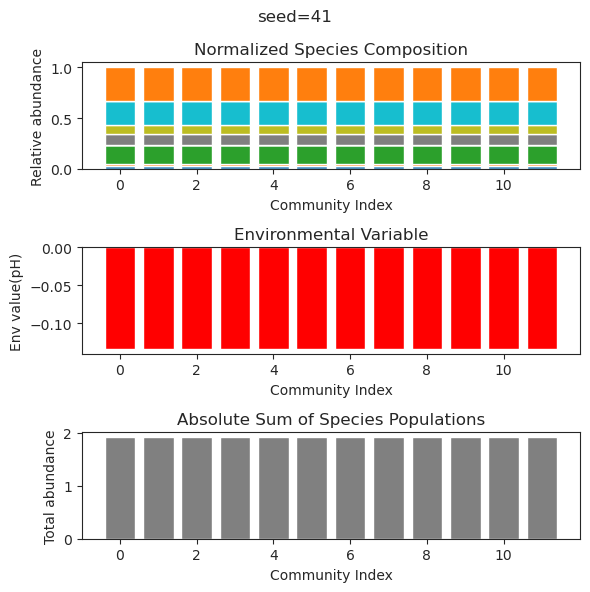

{'species': array([ 1.70219176e-01,  5.84291134e-47,  2.25332336e-16, -3.35532234e-65,
        5.03126153e-01, -8.99580062e-68,  6.83390083e-86, -1.21638839e-78,
        8.05585772e-01, -3.38909086e-32,  5.04967960e-01, -1.88960729e-64]), 'env': array([-1.28319777])}
{'species': array([ 1.70219176e-01,  2.72315667e-36,  3.96842763e-17,  1.00718809e-53,
        5.03126153e-01, -1.48085434e-58,  3.89856694e-94, -2.39752175e-79,
        8.05585772e-01, -1.30742056e-24,  5.04967960e-01,  2.02433831e-58]), 'env': array([-1.28319777])}
{'species': array([ 1.70219176e-001, -5.86548385e-047,  2.56247994e-017,
        1.54603760e-068,  5.03126153e-001,  7.44927152e-075,
        5.53238021e-111, -2.63863872e-102,  8.05585772e-001,
        1.36232737e-028,  5.04967960e-001,  4.54147125e-075]), 'env': array([-1.28319777])}
{'species': array([ 1.70219176e-01, -2.33280091e-35, -8.58162250e-17,  7.24901190e-46,
        5.03126153e-01,  3.72365161e-49,  3.51771870e-79,  6.67171213e-74,
        8.05585

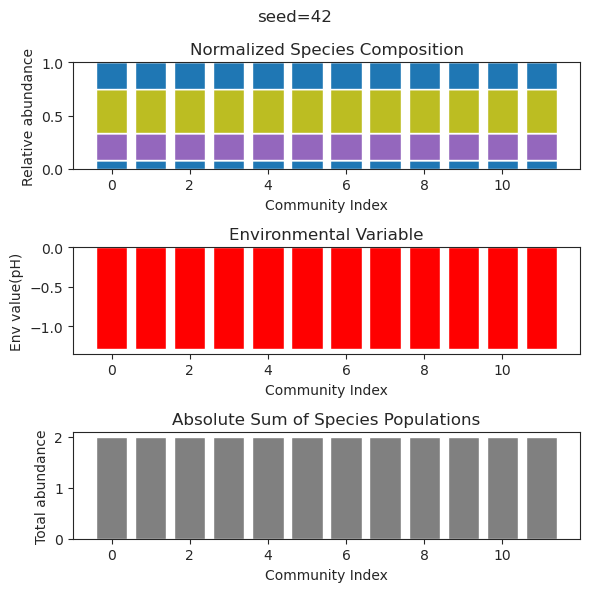

{'species': array([ 3.70637451e-002,  9.47019991e-002,  4.36769081e-052,
        3.21102669e-001, -3.47260257e-107,  7.31744777e-001,
        5.27867436e-011,  7.97500132e-040,  4.80848808e-001,
       -1.20367212e-043, -4.67233044e-103,  7.19333502e-007]), 'env': array([-0.92690604])}
{'species': array([ 2.59826346e-05,  1.16611760e-01, -3.07418721e-36,  2.75291989e-01,
       -3.85807584e-33,  7.28077791e-01,  7.35974985e-02,  1.57517932e-54,
        4.69280327e-01, -2.61426375e-72, -1.45923704e-62,  5.30774229e-02]), 'env': array([-0.68848081])}
{'species': array([ 3.70639361e-02,  9.47018694e-02,  2.59731518e-52,  3.21102434e-01,
        6.82575136e-83,  7.31744814e-01,  3.11975190e-10, -8.06052674e-25,
        4.80849085e-01, -7.06313791e-33,  4.92146743e-88,  4.47016598e-07]), 'env': array([-0.92690674])}
{'species': array([ 3.70560885e-02,  9.47071982e-02, -2.80073942e-42,  3.21112054e-01,
        1.78018624e-76,  7.31743328e-01,  7.61806206e-09, -4.73237036e-37,
        4.80837

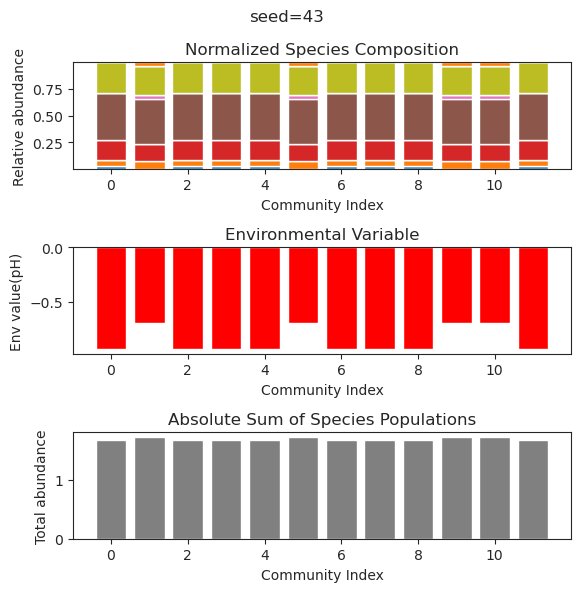

{'species': array([ 1.93721028e-01,  1.49296772e-21,  1.09751873e-24, -4.38828737e-52,
        5.52653737e-53, -1.23747289e-39,  1.07911411e+00, -2.66098236e-47,
       -5.61897820e-53, -5.15398754e-37, -6.62308507e-53,  1.65806917e-28]), 'env': array([-1.90672951])}
{'species': array([ 1.93721028e-01,  1.08639328e-21, -4.93944522e-27,  2.72888951e-57,
       -2.09826542e-53, -8.53533526e-42,  1.07911411e+00,  6.60466529e-51,
       -7.96304666e-59, -1.17091795e-37, -1.18110839e-58, -1.15907688e-30]), 'env': array([-1.90672951])}
{'species': array([ 1.93721028e-01, -2.97360861e-21, -2.09379099e-24, -5.94090541e-50,
        6.20699766e-47, -4.84241676e-37,  1.07911411e+00,  5.65432946e-44,
       -1.07112786e-49, -3.08783737e-33, -8.74128358e-50, -1.39512195e-28]), 'env': array([-1.90672951])}
{'species': array([ 1.97637350e-81, -6.45182690e-75, -2.06397594e-48,  1.93892134e-77,
        5.24859784e-01,  1.49082343e-01, -8.62367998e-82,  7.21941954e-02,
        8.02072037e-01,  1.1140900

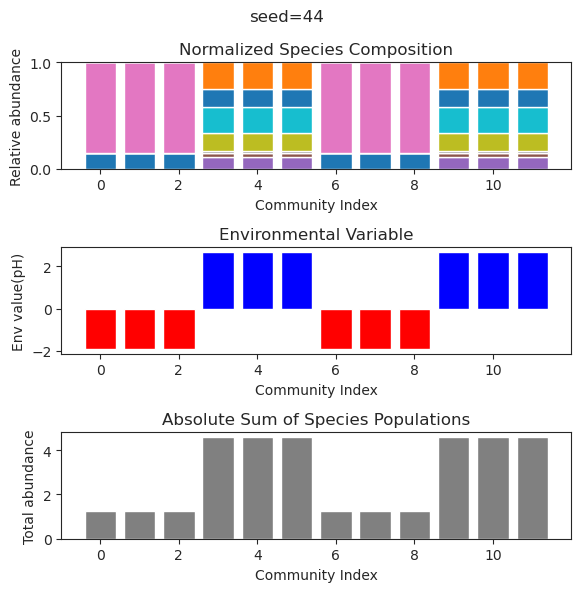

{'species': array([ 1.65415388e-001, -2.61444512e-030,  4.74858776e-100,
        1.36321722e-038,  1.43132933e-026,  4.23041579e-001,
        2.75380819e-019,  9.18862801e-056,  4.97670645e-001,
        3.32591798e-103,  3.57163847e-001,  6.74400436e-059]), 'env': array([-1.35532321])}
{'species': array([ 1.65415388e-001, -1.74342253e-027, -2.15084556e-132,
       -1.98478715e-044, -5.32947971e-029,  4.23041579e-001,
       -6.39398755e-017, -2.36245795e-075,  4.97670645e-001,
       -1.53987253e-136,  3.57163847e-001,  9.47724967e-070]), 'env': array([-1.35532321])}
{'species': array([ 1.65415388e-001,  2.15166058e-043, -1.37899161e-119,
        1.40935721e-051,  2.93640736e-040,  4.23041579e-001,
        2.22985612e-024,  8.97293939e-079,  4.97670645e-001,
       -1.28687072e-123,  3.57163847e-001, -1.63102655e-069]), 'env': array([-1.35532321])}
{'species': array([ 1.65415388e-001, -2.28701841e-026,  1.73139017e-129,
       -1.04292145e-039, -6.50175027e-023,  4.23041579e-001,
     

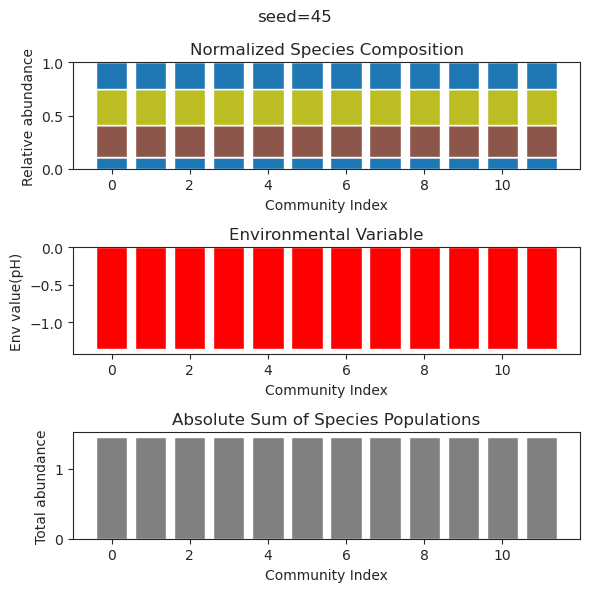

{'species': array([ 1.42735984e-01,  2.24228053e-01, -1.52584418e-24,  6.58798994e-59,
        3.71925201e-57,  2.11329452e-89, -8.05692881e-87, -5.01073246e-93,
        7.84352179e-44,  1.53395552e-62,  4.07810065e-62, -2.33842937e-81]), 'env': array([-3.57458245])}
{'species': array([ 1.42735984e-01,  2.24228053e-01,  3.92949282e-28, -1.34822244e-43,
       -1.55277063e-41,  8.28722865e-57,  2.38301635e-54,  1.51384606e-52,
        3.29362330e-37, -2.61053590e-43, -3.11514331e-45,  4.43825342e-51]), 'env': array([-3.57458245])}
{'species': array([ 1.42735984e-01,  2.24228053e-01, -4.67856504e-28,  5.99783275e-61,
       -4.41818236e-53, -9.40090028e-87, -1.63604229e-82, -1.06382214e-88,
        3.79367539e-42, -1.40118820e-59,  1.18042414e-64, -6.78113866e-78]), 'env': array([-3.57458245])}
{'species': array([ 1.42735984e-01,  2.24228053e-01,  2.36328576e-26, -1.28738910e-46,
        4.61473801e-44, -1.39814890e-60,  2.66283755e-61, -9.53754667e-55,
        3.80651654e-37, -2.7522696

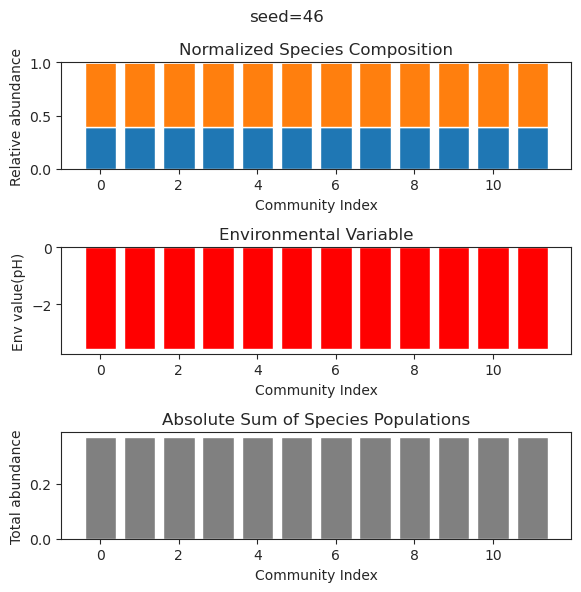

{'species': array([-2.70921514e-49,  2.66745012e-01,  8.56702059e-41,  1.24644904e-45,
        1.25604242e+00, -8.29023172e-51, -3.58830578e-20, -2.02981626e-30,
        2.98131620e-49,  2.10506749e-01,  8.91713419e-44,  1.37274074e-37]), 'env': array([-2.36754003])}
{'species': array([-1.83645196e-54,  2.66745012e-01, -1.28518465e-39,  7.65653129e-42,
        1.25604242e+00, -3.91782353e-51,  5.18162893e-20,  7.06547665e-27,
       -2.60425463e-49,  2.10506749e-01,  4.70852770e-46,  4.81039748e-36]), 'env': array([-2.36754003])}
{'species': array([ 3.65323377e-47,  2.66745012e-01,  2.65049927e-38, -8.15619284e-43,
        1.25604242e+00,  1.38054541e-49, -3.19820233e-19,  9.96187593e-28,
        1.93354164e-46,  2.10506749e-01, -8.47396445e-42,  3.13640898e-35]), 'env': array([-2.36754003])}
{'species': array([ 2.96907414e-48,  2.66745012e-01,  6.18547371e-41, -1.38742584e-39,
        1.25604242e+00, -4.80519190e-51, -1.37162309e-20, -1.21412898e-28,
        1.46903786e-48,  2.1050674

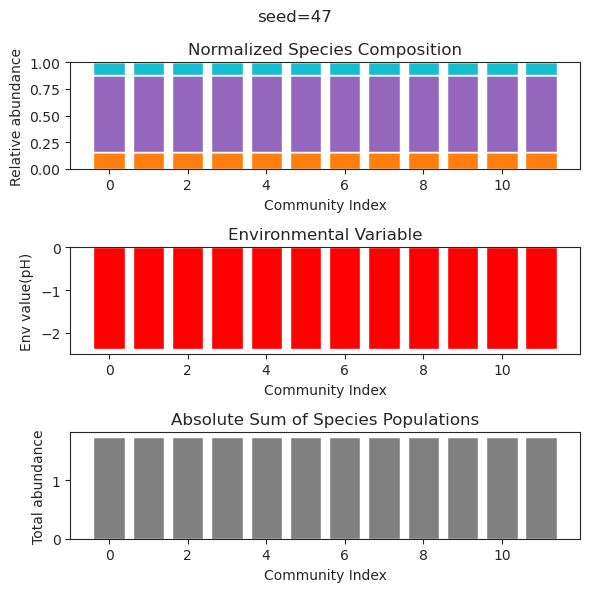

{'species': array([ 7.38946471e-22,  2.18727783e-01, -1.23591662e-45,  1.90655241e-35,
       -3.79960599e-42,  6.28043919e-01,  3.60472631e-01,  3.72134139e-01,
        3.06768169e-21,  9.79936038e-44, -4.25586613e-28,  3.88747026e-28]), 'env': array([-1.38137804])}
{'species': array([ 7.99762140e-22,  2.18727783e-01,  9.89333825e-51,  3.69184577e-38,
       -1.37052354e-45,  6.28043919e-01,  3.60472631e-01,  3.72134139e-01,
        2.60408540e-22,  8.42202109e-47, -6.43641190e-28, -1.14790721e-25]), 'env': array([-1.38137804])}
{'species': array([ 4.43359351e-19,  2.18727783e-01, -4.41475350e-48,  6.65971007e-36,
       -7.72741415e-42,  6.28043919e-01,  3.60472631e-01,  3.72134139e-01,
        8.92376809e-20, -2.76055913e-46, -7.52149694e-27,  2.69601920e-24]), 'env': array([-1.38137804])}
{'species': array([ 5.52469468e-20,  2.18727783e-01, -1.66520964e-48,  4.16804122e-38,
        1.88629535e-45,  6.28043919e-01,  3.60472631e-01,  3.72134139e-01,
        2.96418814e-21,  6.8420812

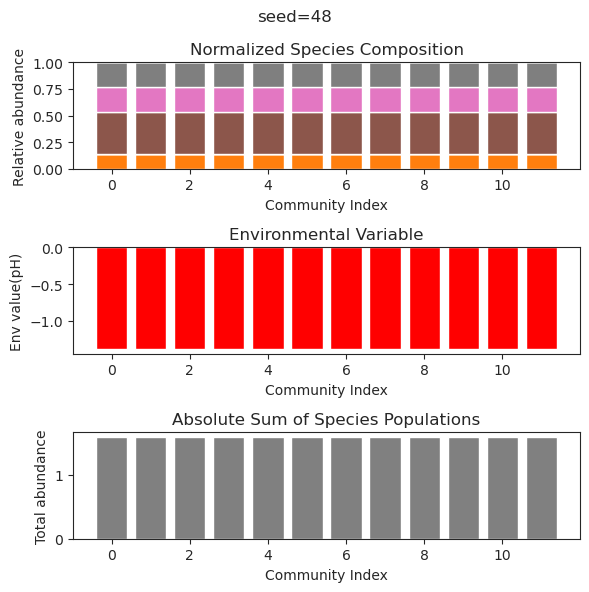

{'species': array([-5.70125622e-43, -3.91067811e-43,  6.94517771e-01,  8.46874185e-48,
        3.42961470e-01,  1.86898927e-01,  6.69659608e-01,  4.98834597e-01,
        5.53739002e-30,  2.65940084e-60,  8.40903658e-54, -1.81321960e-16]), 'env': array([0.4773813])}
{'species': array([ 2.05233327e-36,  1.20252187e-36,  6.94517771e-01,  5.74488921e-41,
        3.42961470e-01,  1.86898927e-01,  6.69659608e-01,  4.98834597e-01,
       -1.37998158e-23,  2.84532090e-55,  2.25875153e-42, -1.66686074e-13]), 'env': array([0.4773813])}
{'species': array([ 4.73729226e-40,  2.94800596e-37,  6.94517771e-01, -7.70534143e-37,
        3.42961470e-01,  1.86898927e-01,  6.69659608e-01,  4.98834597e-01,
       -2.98884285e-22, -4.80277575e-65, -4.53978283e-41,  9.98084826e-17]), 'env': array([0.4773813])}
{'species': array([ 2.51606185e-41,  9.43074933e-44,  6.94517771e-01,  4.04794977e-53,
        3.42961470e-01,  1.86898927e-01,  6.69659608e-01,  4.98834597e-01,
        3.39328130e-37, -1.18782677e-56,

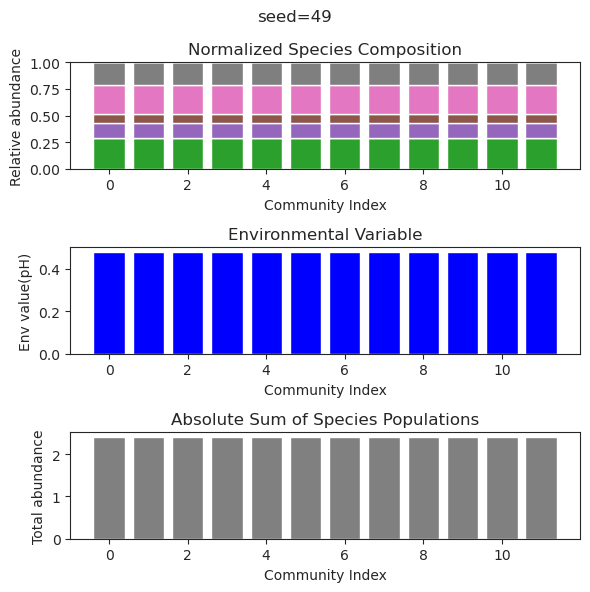

{'species': array([ 1.83611694e-01,  3.93639132e-32, -1.49797773e-72,  2.61670418e-33,
        1.22255632e-01,  1.56963311e-01,  3.75898622e-01, -9.05628398e-34,
        1.44716854e-02,  2.78487981e-01, -1.15001798e-56,  4.29274722e-01]), 'env': array([-1.06024593])}
{'species': array([ 1.83611694e-01,  2.40160802e-35,  8.28832719e-97, -1.01846748e-22,
        1.22255632e-01,  1.56963311e-01,  3.75898622e-01, -6.32662358e-41,
        1.44716854e-02,  2.78487981e-01,  2.35006241e-82,  4.29274722e-01]), 'env': array([-1.06024593])}
{'species': array([ 1.83611694e-01,  9.64224303e-34, -2.42598680e-78,  3.05819723e-24,
        1.22255632e-01,  1.56963311e-01,  3.75898622e-01, -2.96774367e-37,
        1.44716854e-02,  2.78487981e-01,  7.19992855e-61,  4.29274722e-01]), 'env': array([-1.06024593])}
{'species': array([ 1.83611694e-01, -4.03212473e-27,  1.93484639e-59, -1.06989729e-27,
        1.22255632e-01,  1.56963311e-01,  3.75898622e-01, -1.54160992e-30,
        1.44716854e-02,  2.7848798

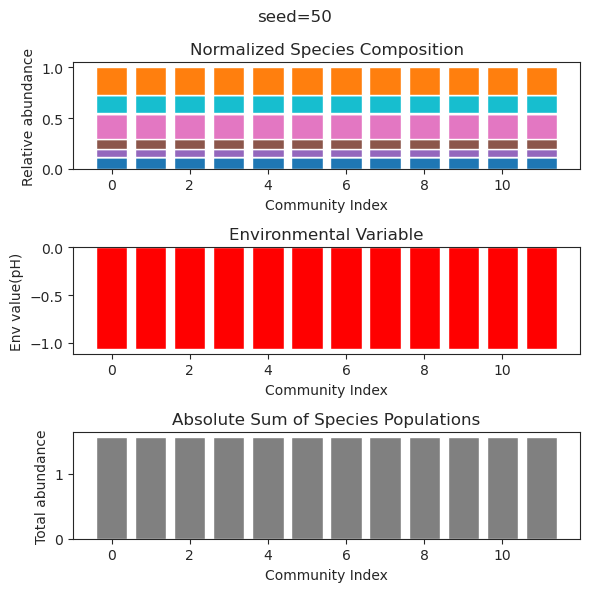

{'species': array([ 2.71522970e-01,  1.00406074e-01, -1.20131957e-92,  2.86437778e-30,
       -5.96755551e-46,  1.59066134e-59,  1.03971369e-59,  2.99520524e-56,
        1.98930571e-32,  7.02917821e-62, -2.16923882e-46,  1.43663179e-94]), 'env': array([-3.61993828])}
{'species': array([ 2.71522970e-01,  1.00406074e-01,  2.68420528e-59,  5.47457723e-27,
        1.37306325e-33,  6.31401556e-38,  2.51744039e-37,  4.77680182e-37,
       -2.21302420e-28,  7.21508350e-40,  7.85702427e-34,  2.91460767e-58]), 'env': array([-3.61993828])}
{'species': array([ 2.71522970e-01,  1.00406074e-01,  4.45034679e-78,  1.55562521e-28,
       -3.30937434e-39,  3.76963882e-51,  5.56683419e-51, -1.63534586e-47,
        2.04614554e-29,  8.32429168e-55, -1.22214676e-41,  2.04517031e-79]), 'env': array([-3.61993828])}
{'species': array([ 2.71522970e-01,  1.00406074e-01, -3.68916990e-75,  1.56515442e-29,
        1.94637222e-39,  3.50752235e-50,  1.30470712e-50,  1.41767261e-48,
       -5.14268265e-32,  9.1491389

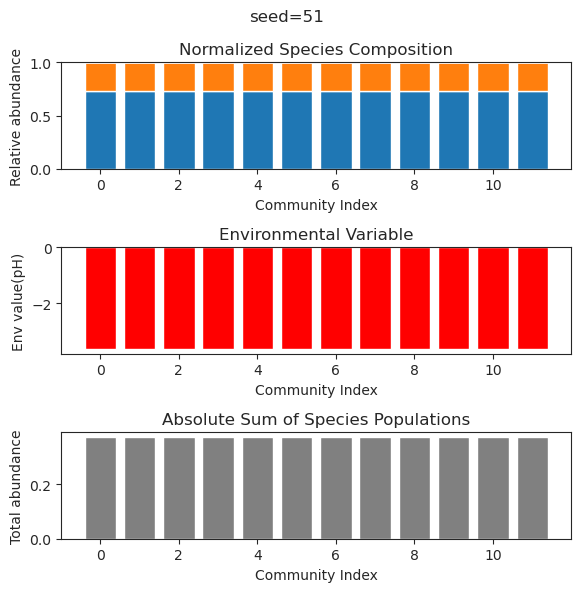

{'species': array([ 3.24313946e-01, -8.28550999e-39,  5.66663239e-54,  1.82702900e-01,
        8.12363503e-01, -7.25456882e-50,  3.26778020e-01, -1.09061561e-53,
        7.61363273e-27, -4.89325206e-36, -1.44341791e-44, -4.28030411e-43]), 'env': array([-2.32622876])}
{'species': array([ 3.24313946e-01, -4.23618028e-56, -3.74957531e-72,  1.82702900e-01,
        8.12363503e-01, -1.55505931e-73,  3.26778020e-01, -5.56714266e-76,
       -4.38135129e-29,  4.49435077e-51, -1.43207885e-52,  2.28860127e-66]), 'env': array([-2.32622876])}
{'species': array([ 3.24313946e-01, -1.77275301e-64,  2.84030422e-80,  1.82702900e-01,
        8.12363503e-01, -1.69248353e-81,  3.26778020e-01,  8.75243456e-84,
       -6.83687400e-30, -6.77330987e-57,  1.13292784e-53, -6.03192401e-73]), 'env': array([-2.32622876])}
{'species': array([ 3.24313946e-01,  1.10220887e-43,  4.70912431e-61,  1.82702900e-01,
        8.12363503e-01, -2.60784166e-59,  3.26778020e-01, -6.10225229e-57,
        4.55304300e-24,  1.1092327

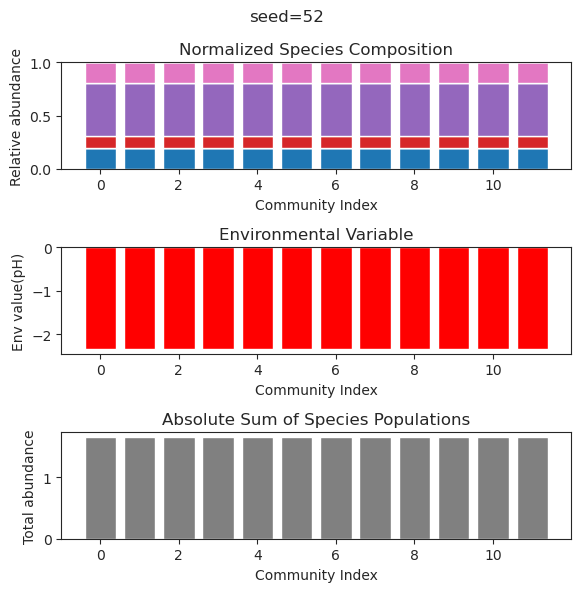

{'species': array([ 1.49434133e-01, -3.66561250e-46, -7.68725264e-47,  6.73742042e-01,
       -7.16715929e-22,  5.51643297e-73, -6.89139553e-22, -6.73507391e-78,
        6.78509122e-01,  7.94296740e-46,  5.90605525e-01, -7.04458552e-23]), 'env': array([-1.04641312])}
{'species': array([ 1.49434133e-01, -9.98072931e-39, -1.23140922e-40,  6.73742042e-01,
        1.67426735e-20,  4.09188209e-57, -8.18975089e-23, -2.99366616e-62,
        6.78509122e-01, -2.45714447e-42,  5.90605525e-01,  3.74301965e-29]), 'env': array([-1.04641312])}
{'species': array([ 1.49434133e-01,  4.51930422e-48,  2.00569617e-49,  6.73742042e-01,
        2.48470507e-19,  1.32576398e-68, -3.95714625e-26,  2.17926086e-76,
        6.78509122e-01, -1.45462442e-43,  5.90605525e-01,  2.59733045e-28]), 'env': array([-1.04641312])}
{'species': array([ 1.49434133e-01, -8.59254314e-42, -1.38162286e-44,  6.73742042e-01,
       -3.75005451e-18,  4.76400977e-62, -2.58383140e-20, -1.04074583e-64,
        6.78509122e-01,  6.5751347

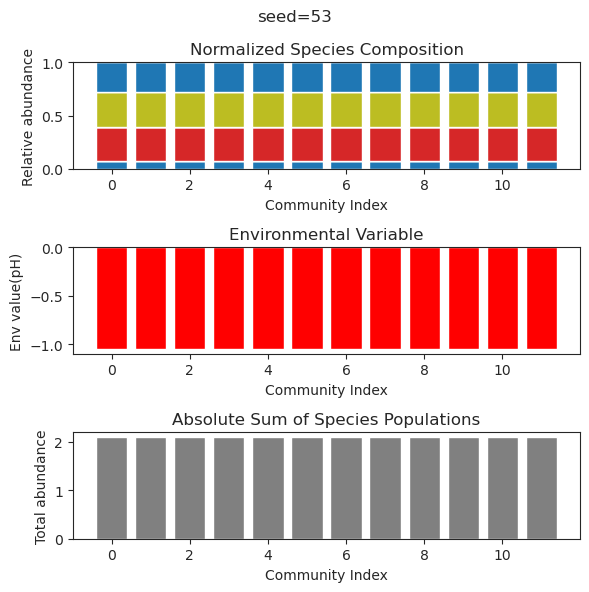

{'species': array([-4.68409762e-43,  2.79648916e-01, -8.99092628e-59, -3.55016982e-15,
       -1.69811967e-37,  4.55161611e-01, -1.24621300e-70, -1.03097112e-40,
       -8.04503656e-67,  1.29529608e-64,  1.15012755e-23,  3.85113997e-01]), 'env': array([-2.71016514])}
{'species': array([ 3.40865870e-54,  2.79648916e-01, -2.36212755e-67, -2.49237713e-16,
        1.36354163e-44,  4.55161611e-01, -3.70698114e-87, -1.97294638e-50,
       -3.79086286e-81,  3.87523761e-80,  5.74291805e-29,  3.85113997e-01]), 'env': array([-2.71016514])}
{'species': array([ 3.38824489e-41,  2.79648916e-01, -3.86105028e-53, -2.07066540e-14,
        6.52554066e-40,  4.55161611e-01,  1.27999720e-30, -2.85920644e-39,
       -4.82277419e-63,  2.79259819e-56, -2.15045946e-20,  3.85113997e-01]), 'env': array([-2.71016514])}
{'species': array([ 1.80534954e-37, -5.07383336e-39, -8.58983747e-85,  7.05570052e-11,
        4.91105759e-01,  1.85633435e-01,  4.21680989e-01,  8.12678826e-01,
        4.98987686e-01,  1.0325476

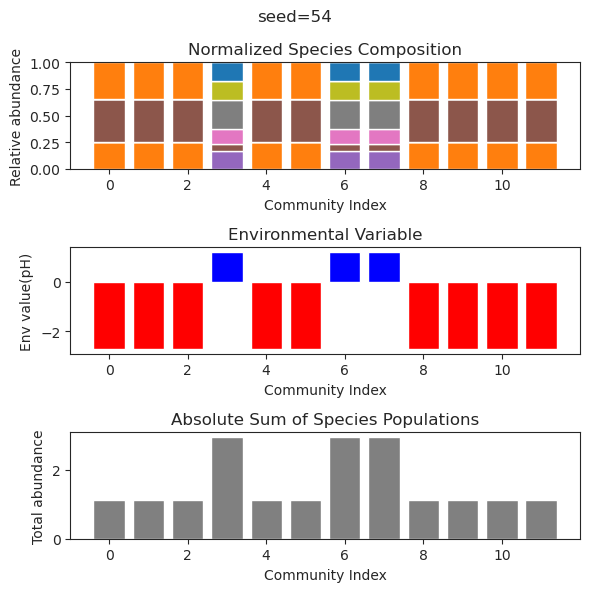

{'species': array([ 1.89845510e-01,  5.66280472e-56,  7.85624941e-01,  5.19391996e-01,
        6.60558185e-53,  3.60965262e-60,  6.36073784e-55, -5.19518826e-42,
        2.35601374e-01,  7.21281663e-32,  1.17624347e-59,  9.10761368e-49]), 'env': array([-1.39265398])}
{'species': array([ 1.89845510e-01, -1.12298625e-58,  7.85624941e-01,  5.19391996e-01,
       -3.98600321e-54,  4.11600551e-60, -2.41136592e-57, -4.41496974e-43,
        2.35601374e-01,  1.57457504e-32, -1.43058204e-58,  2.08255839e-52]), 'env': array([-1.39265398])}
{'species': array([ 1.89845510e-01,  1.02652681e-56,  7.85624941e-01,  5.19391996e-01,
       -1.23043749e-53,  2.40262451e-57, -3.25827571e-54, -3.24273919e-40,
        2.35601374e-01, -6.76721973e-32,  2.62481354e-58,  2.81859437e-44]), 'env': array([-1.39265398])}
{'species': array([ 1.89845510e-01, -1.82869818e-54,  7.85624941e-01,  5.19391996e-01,
        5.76861904e-50,  1.49878242e-56,  1.42184263e-53,  5.38147349e-42,
        2.35601374e-01,  4.7312796

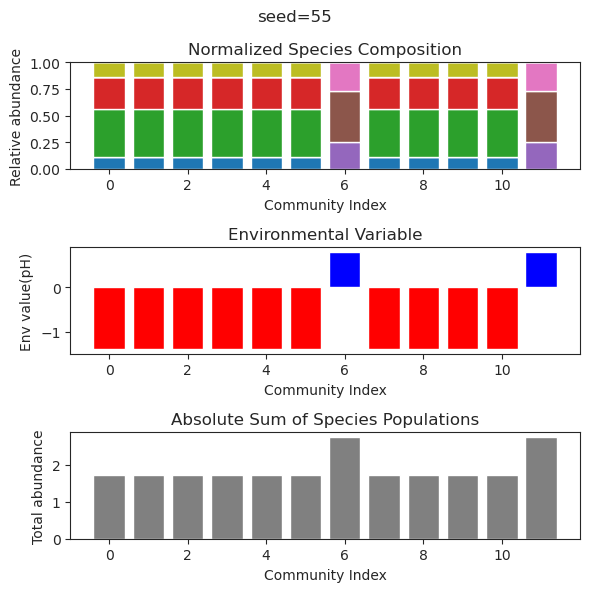

{'species': array([ 2.05647123e-01, -7.67229426e-44, -3.14572735e-24,  2.28088839e-19,
        6.17838615e-01, -4.43888333e-59,  8.37945295e-01,  8.86994899e-19,
        3.21417343e-24,  2.42727266e-44,  1.59225779e-50, -2.12798400e-30]), 'env': array([-1.83838899])}
{'species': array([ 2.05647123e-01, -1.30097092e-42, -6.98128978e-30, -2.80788785e-20,
        6.17838615e-01,  5.30339108e-61,  8.37945295e-01, -4.15954182e-20,
       -1.57178012e-23, -4.03834602e-48,  4.52997563e-52, -4.04587444e-30]), 'env': array([-1.83838899])}
{'species': array([ 2.05647123e-01,  1.97209948e-38,  2.92880186e-24, -8.51501981e-21,
        6.17838615e-01,  1.32464416e-53,  8.37945295e-01, -1.29850634e-19,
       -6.34097851e-21,  5.47681226e-36, -1.53500905e-42,  2.25168949e-27]), 'env': array([-1.83838899])}
{'species': array([ 2.05647123e-01,  6.62323705e-46,  1.31392120e-30, -1.60558008e-21,
        6.17838615e-01, -1.28637391e-64,  8.37945295e-01, -1.11330520e-20,
       -3.50151303e-24, -1.1565225

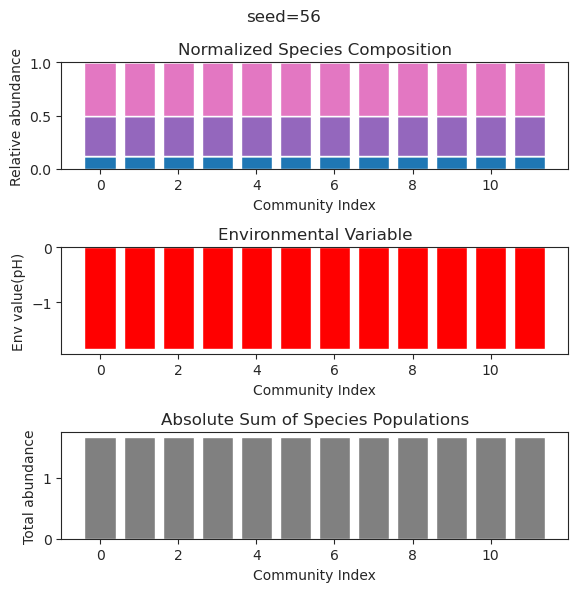

{'species': array([-2.40318279e-021,  3.63361845e-001, -3.11139587e-110,
        1.16150293e-001,  4.73166312e-036, -5.71365966e-115,
        1.60005646e-026, -7.12610855e-106,  1.26608549e-059,
        1.00710839e+000, -5.28235187e-068, -3.41613644e-112]), 'env': array([-2.66065866])}
{'species': array([-5.02975817e-29,  3.63361845e-01,  4.08834918e-67,  1.16150293e-01,
       -1.83899633e-38, -9.34789036e-71, -9.03837427e-32,  2.17921286e-71,
        1.95362015e-47,  1.00710839e+00, -7.83286995e-52,  1.14376972e-67]), 'env': array([-2.66065866])}
{'species': array([ 2.12252842e-23,  3.63361845e-01,  2.27122595e-74,  1.16150293e-01,
       -3.27389882e-35,  9.61080294e-73,  1.85137097e-22,  3.03706153e-83,
        3.49446441e-45,  1.00710839e+00,  3.31713431e-54,  2.00458483e-71]), 'env': array([-2.66065866])}
{'species': array([ 6.64377368e-21,  3.63361845e-01,  2.41226115e-85,  1.16150293e-01,
        3.31874958e-41,  1.01775370e-83, -1.18011889e-28, -1.45435794e-89,
       -6.94132

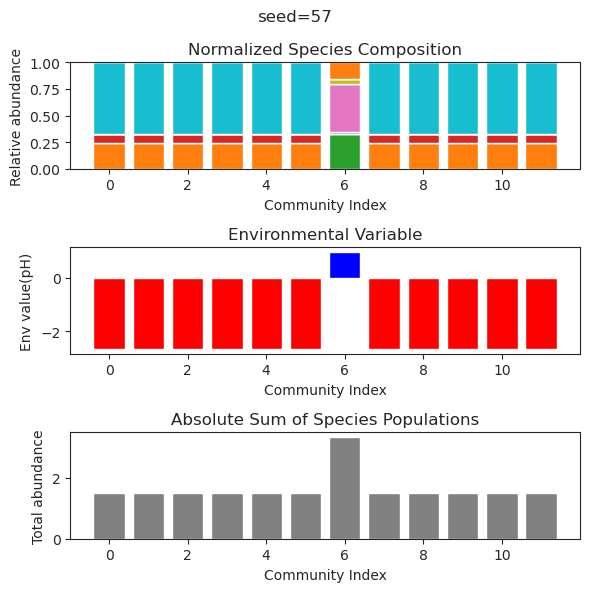

{'species': array([ 1.08581536e-25,  2.59634563e-01, -1.44356620e-47,  3.44924637e-35,
       -2.22887877e-45,  7.01260954e-27, -1.80178574e-43, -1.87358944e-40,
        7.86565487e-01,  8.49587982e-27,  1.64764166e-45,  4.03153186e-01]), 'env': array([-1.98461469])}
{'species': array([-3.83544010e-31,  2.59634563e-01, -6.45013780e-53,  2.15274137e-46,
        5.14836360e-56,  1.35637438e-24, -1.54017001e-54, -5.16788944e-48,
        7.86565487e-01, -2.86353832e-26, -2.56145393e-53,  4.03153186e-01]), 'env': array([-1.98461469])}
{'species': array([ 2.25981924e-85, -9.85731465e-85,  4.60259863e+00,  2.91146366e-68,
        4.91263588e-85,  2.95812250e+00,  6.60069441e-60, -1.92738986e-59,
        1.54742018e-58,  3.08589618e+00,  2.38901811e-01,  2.15993198e-82]), 'env': array([6.86816846])}
{'species': array([-4.82099234e-23,  2.59634563e-01,  1.53854243e-38, -2.58858669e-32,
       -1.89039205e-40,  2.90121833e-28, -7.22691266e-36,  4.17382380e-31,
        7.86565487e-01, -4.98798914

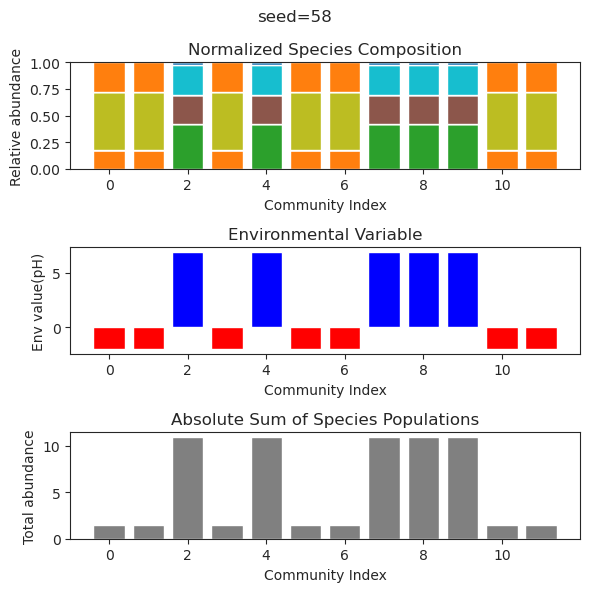

{'species': array([-1.55487565e-32,  2.50610839e-01,  6.88994671e-02,  8.09344565e-51,
        3.69640607e-48, -1.20323357e-56,  2.21425479e-45,  3.97678472e-01,
        5.00151071e-26,  6.76860949e-01, -3.13208392e-43, -2.34317834e-62]), 'env': array([-2.03466633])}
{'species': array([ 5.26031026e-32,  2.50610839e-01,  6.88994671e-02, -6.37049511e-48,
       -6.42347095e-38, -2.15124745e-54,  3.17074550e-43,  3.97678472e-01,
       -5.71317148e-24,  6.76860949e-01, -1.61235624e-35, -1.12889685e-58]), 'env': array([-2.03466633])}
{'species': array([-6.87513160e-036,  2.50610839e-001,  6.88994671e-002,
        4.15294878e-083, -1.52205944e-057, -1.49319353e-102,
       -3.39306023e-072,  3.97678472e-001, -4.77884722e-027,
        6.76860949e-001,  1.05816908e-054, -3.18647008e-089]), 'env': array([-2.03466633])}
{'species': array([-1.35305198e-29,  2.50610839e-01,  6.88994671e-02, -2.39135848e-47,
        4.50224794e-42, -6.80504320e-56,  1.57921437e-45,  3.97678472e-01,
        1.67081

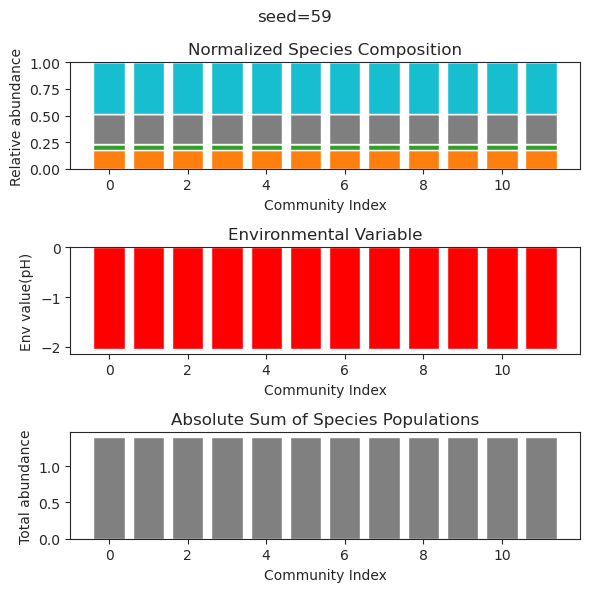

{'species': array([ 1.24652952e-01,  2.58714867e-01,  5.53900284e-01,  1.27314955e-28,
        3.91401255e-48, -2.09694400e-19,  4.26182769e-42,  6.08912939e-46,
       -1.84177942e-35,  5.02857012e-01,  3.05428950e-51,  4.06941544e-49]), 'env': array([-2.92960594])}
{'species': array([ 1.24652952e-01,  2.58714867e-01,  5.53900284e-01,  1.22277228e-27,
       -1.66061771e-44,  5.74636238e-19,  8.42396260e-39,  2.55279985e-43,
        3.35182461e-31,  5.02857012e-01, -1.05772914e-49, -3.38366971e-47]), 'env': array([-2.92960594])}
{'species': array([ 1.24652952e-01,  2.58714867e-01,  5.53900284e-01,  8.82152037e-28,
       -2.60137675e-44,  2.83799406e-19, -1.55427576e-37,  1.86504830e-42,
       -6.34730296e-32,  5.02857012e-01,  1.14764973e-50, -5.54212473e-46]), 'env': array([-2.92960594])}
{'species': array([ 1.24652952e-01,  2.58714867e-01,  5.53900284e-01, -4.61787209e-30,
        1.29747658e-47,  2.72111573e-22, -9.84174792e-42,  9.93150068e-45,
        5.29076049e-33,  5.0285701

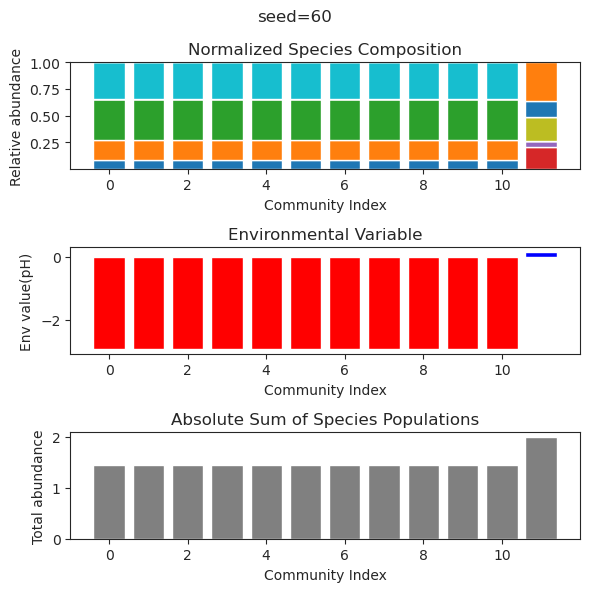

{'species': array([ 7.31579985e-02, -1.07240505e-59, -1.03488136e-25,  4.17369582e-01,
        4.34891241e-01,  7.58058592e-02, -4.82183120e-17, -4.81713997e-72,
        4.57216927e-01,  1.32902744e-01, -6.46391390e-60,  1.15002850e-01]), 'env': array([-0.28995595])}
{'species': array([ 7.31579985e-02,  5.71451025e-52,  4.18424627e-32,  4.17369582e-01,
        4.34891241e-01,  7.58058592e-02,  3.91541435e-22, -3.71471727e-67,
        4.57216927e-01,  1.32902744e-01,  4.18953954e-55,  1.15002850e-01]), 'env': array([-0.28995595])}
{'species': array([ 1.33907715e-089,  6.28210147e-033,  5.42264459e-001,
        1.11194987e-016,  7.93225033e-001,  4.99930126e-002,
        4.60080434e-062,  1.27853706e-001,  4.18937496e-001,
        1.55359911e-026, -5.19199123e-073, -1.36945949e-115]), 'env': array([0.46452164])}
{'species': array([ 7.31579985e-02, -1.47543560e-56, -2.44464743e-24,  4.17369582e-01,
        4.34891241e-01,  7.58058592e-02,  3.00470983e-17, -1.07928393e-66,
        4.572169

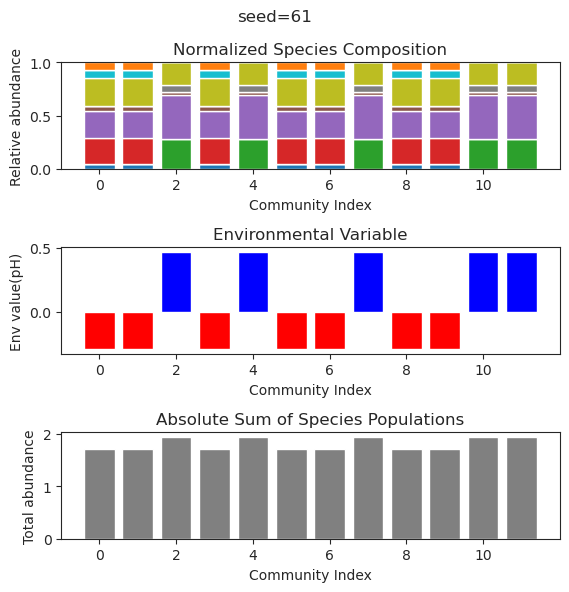

{'species': array([ 9.17053020e-32,  2.00656323e-01,  5.06644839e-01, -2.04866865e-41,
        5.11725003e-01,  6.23498393e-60,  2.19647967e-01, -8.67559025e-58,
       -2.26185341e-40, -4.87169905e-29,  9.09122633e-56,  1.39561452e-51]), 'env': array([-1.39995615])}
{'species': array([ 5.33310334e-34,  2.00656323e-01,  5.06644839e-01,  1.08572278e-39,
        5.11725003e-01, -1.05519829e-58,  2.19647967e-01,  5.21684230e-61,
       -4.44736745e-39, -1.25791817e-32, -5.35893018e-55, -3.34709638e-54]), 'env': array([-1.39995615])}
{'species': array([ 1.43898133e-64, -8.60800694e-31,  3.40237724e-77,  1.20463001e+00,
       -2.73052874e-44,  7.51650002e-01, -1.13876843e-54,  7.11307186e-49,
        1.48038319e+00, -7.92693502e-31,  2.40720931e+00,  7.21773591e-01]), 'env': array([2.90109328])}
{'species': array([-9.15045668e-30,  2.00656323e-01,  5.06644839e-01,  2.42452713e-34,
        5.11725003e-01,  5.74046502e-44,  2.19647967e-01, -1.19407739e-45,
       -1.19392929e-37,  2.26113811

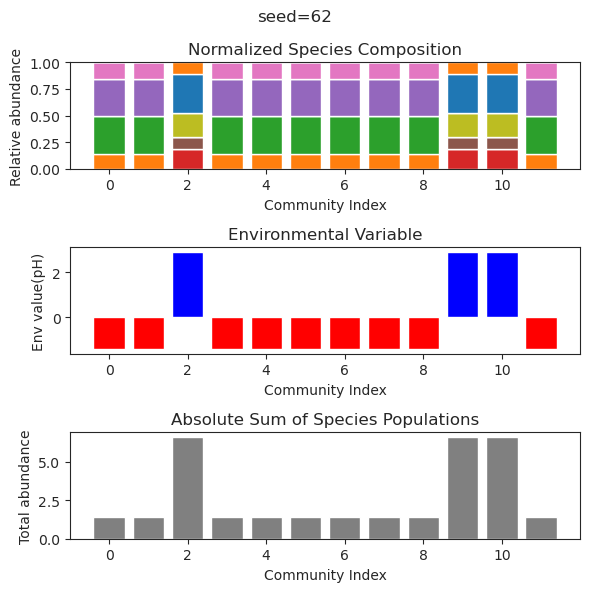

{'species': array([ 1.42025653e-01, -8.10862894e-70,  1.41481884e-63,  8.04843223e-01,
        2.40129056e-71,  1.63126232e-83,  3.24575655e-01, -2.65728430e-59,
       -3.44405534e-34,  3.19902540e-01, -1.76703139e-68,  1.84272450e-01]), 'env': array([-0.98136654])}
{'species': array([ 1.42025653e-01,  2.23826661e-61,  5.62615543e-58,  8.04843223e-01,
       -3.88041143e-61, -1.07888187e-72,  3.24575655e-01,  1.33416733e-54,
       -2.42791102e-29,  3.19902540e-01,  1.90420660e-60,  1.84272450e-01]), 'env': array([-0.98136654])}
{'species': array([ 1.42025653e-01, -2.51344453e-69,  4.20678332e-62,  8.04843223e-01,
        2.23944296e-67, -3.81843579e-94,  3.24575655e-01,  1.46036818e-61,
        2.62451786e-33,  3.19902540e-01,  1.25009077e-71,  1.84272450e-01]), 'env': array([-0.98136654])}
{'species': array([ 1.42025653e-01,  5.82992155e-35, -6.77012170e-31,  8.04843223e-01,
       -1.96174756e-35,  2.03136714e-39,  3.24575655e-01,  6.70878619e-27,
       -2.07460808e-19,  3.1990254

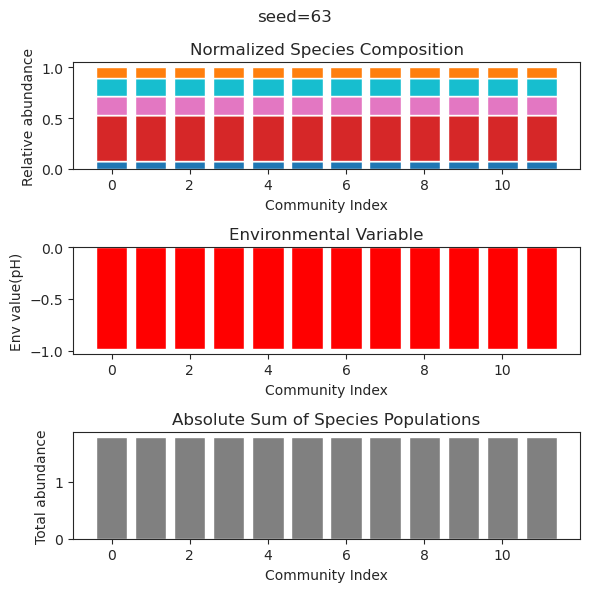

{'species': array([ 1.91595882e-01, -1.00743989e-24, -1.10240324e-70,  6.31565176e-21,
       -4.04052580e-47,  4.75372120e-01,  5.79578592e-01,  2.58930094e-72,
        3.20120327e-01,  2.21743661e-60,  2.47603972e-27, -1.46394378e-18]), 'env': array([-1.54369621])}
{'species': array([ 1.91595882e-01, -2.23044193e-23, -8.76156723e-71, -9.98744011e-19,
       -3.92366359e-68,  4.75372120e-01,  5.79578592e-01, -2.90590603e-66,
        3.20120327e-01, -1.24277087e-66, -2.36627803e-28, -1.16699442e-16]), 'env': array([-1.54369621])}
{'species': array([ 1.91595882e-01,  4.05927667e-19,  8.38018037e-63, -2.39790490e-16,
       -1.82028335e-63,  4.75372120e-01,  5.79578592e-01,  3.17660286e-59,
        3.20120327e-01,  5.33878165e-58, -1.30281270e-23, -1.01807194e-14]), 'env': array([-1.54369621])}
{'species': array([ 1.91595882e-001, -9.78201045e-021,  1.39917164e-106,
       -6.46785908e-017, -4.00035789e-109,  4.75372120e-001,
        5.79578592e-001, -7.76879569e-095,  3.20120327e-001,
 

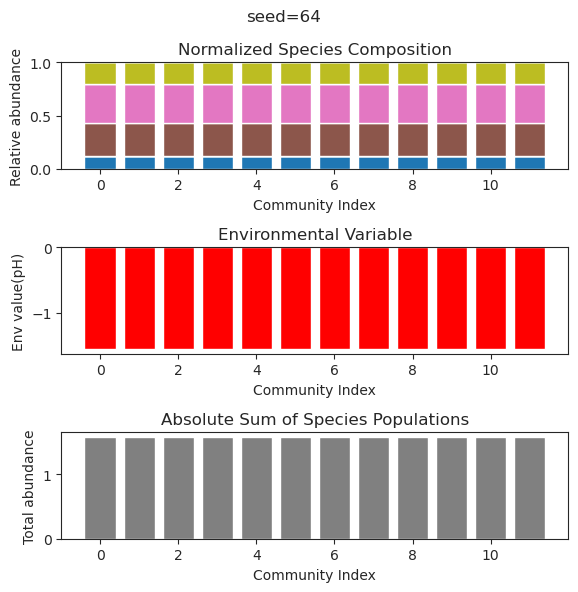

{'species': array([-1.34224116e-36,  2.16196025e-01, -1.81210804e-21,  3.50017936e-01,
       -5.82028759e-35,  7.46499102e-32,  1.21686783e+00,  3.97612131e-41,
        2.49494925e-33, -2.27004295e-52, -1.68320959e-53,  1.74670254e-40]), 'env': array([-2.11688393])}
{'species': array([ 6.95701205e-36,  2.16196025e-01, -1.13330931e-19,  3.50017936e-01,
       -3.27490819e-28,  8.43560146e-28,  1.21686783e+00,  1.56561470e-32,
       -2.58194091e-28,  7.64763792e-46,  8.60373009e-50, -7.47669919e-33]), 'env': array([-2.11688393])}
{'species': array([-3.70465243e-34,  2.16196025e-01, -2.93757538e-20,  3.50017936e-01,
        9.07509131e-27,  3.50058944e-25,  1.21686783e+00,  1.14397736e-31,
        2.10180520e-27, -1.94637442e-45, -4.92426770e-48, -3.61510749e-33]), 'env': array([-2.11688393])}
{'species': array([-6.01125956e-33,  2.16196025e-01,  2.03207741e-20,  3.50017936e-01,
        3.70238038e-36,  2.89159177e-30,  1.21686783e+00, -8.59492757e-35,
        5.34900789e-34,  2.2620443

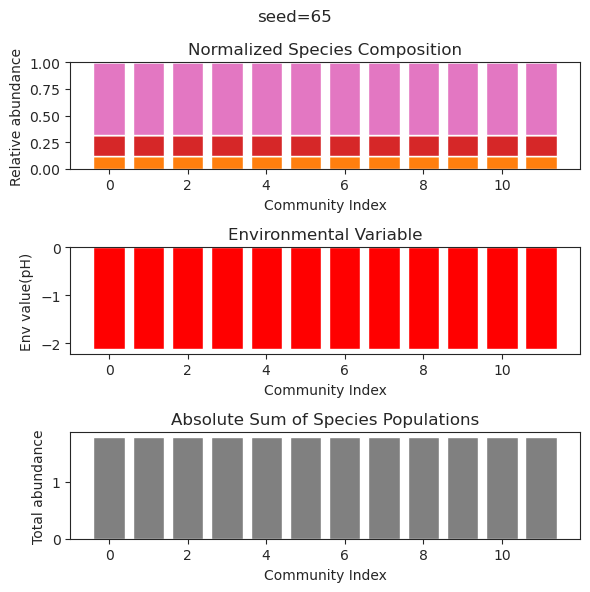

{'species': array([-2.70560417e-039,  0.00000000e+000,  3.31323314e+000,
        4.90107730e-076,  2.69957716e+000, -1.35991906e-281,
        5.75724079e-279, -5.90470986e-104,  2.82127590e-001,
        0.00000000e+000, -1.86329270e-059, -2.42913886e-089]), 'env': array([2.56084017])}
{'species': array([-2.70560417e-039,  0.00000000e+000,  3.31323314e+000,
        4.90107730e-076,  2.69957716e+000, -1.35991906e-281,
        5.75724079e-279, -5.90470986e-104,  2.82127590e-001,
        0.00000000e+000, -1.86329270e-059, -2.42913886e-089]), 'env': array([2.56084017])}
{'species': array([-2.70560417e-039,  0.00000000e+000,  3.31323314e+000,
        4.90107730e-076,  2.69957716e+000, -1.35991906e-281,
        5.75724079e-279, -5.90470986e-104,  2.82127590e-001,
        0.00000000e+000, -1.86329270e-059, -2.42913886e-089]), 'env': array([2.56084017])}
{'species': array([-2.70560417e-039,  0.00000000e+000,  3.31323314e+000,
        4.90107730e-076,  2.69957716e+000, -1.35991906e-281,
        

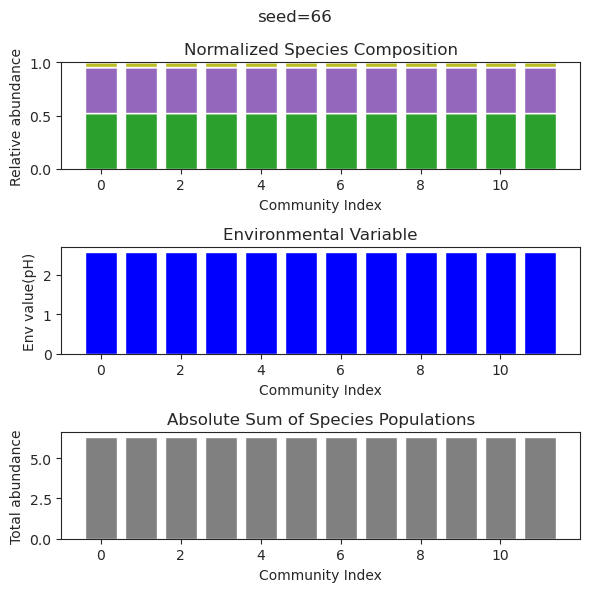

{'species': array([ 1.31416750e-056,  1.49881745e-001,  9.64459817e-058,
       -1.49632156e-196,  2.54420824e-003, -2.10426379e-098,
       -6.92073554e-059,  5.95152641e-001, -2.71822500e-047,
        7.63113429e-047,  1.65298345e-001,  7.37796168e-001]), 'env': array([-0.73797057])}
{'species': array([-4.23910290e-062,  1.49881899e-001, -7.93671912e-197,
       -5.64246851e-190,  2.53087983e-003,  3.07503515e-103,
        5.76468236e-078,  5.95154090e-001, -2.44723946e-067,
       -1.72423278e-104,  1.65301447e-001,  7.37797727e-001]), 'env': array([-0.73797367])}
{'species': array([-3.50017965e-047,  1.49881811e-001, -1.12565018e-181,
       -2.02166744e-171,  2.53851012e-003, -8.24233531e-061,
        4.78313325e-061,  5.95153260e-001,  6.58703858e-105,
       -6.09902637e-050,  1.65299671e-001,  7.37796834e-001]), 'env': array([-0.73797189])}
{'species': array([ 2.87883702e-070,  1.49881742e-001,  2.10312851e-181,
       -2.74148602e-176,  2.54453968e-003,  1.38161796e-069,
     

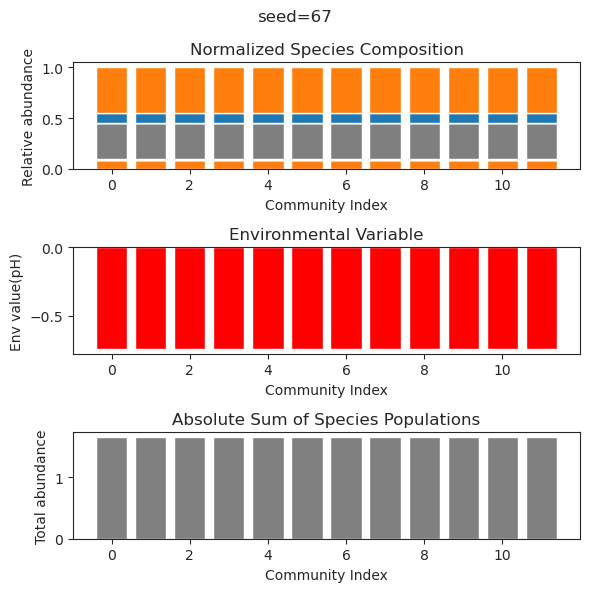

{'species': array([ 3.45451819e-062,  1.81557171e-001,  7.11007781e-002,
        3.82782940e-001, -5.53891234e-122,  2.70175013e-084,
        3.37615909e-001,  5.27482209e-023, -1.97509197e-051,
        7.02635036e-001,  4.35343086e-023, -1.64207912e-122]), 'env': array([-0.99263947])}
{'species': array([-2.27078707e-061,  1.81557171e-001,  7.11007781e-002,
        3.82782940e-001, -2.50315539e-126,  6.37982329e-086,
        3.37615909e-001,  2.50758729e-023, -1.96328044e-051,
        7.02635036e-001,  1.79874626e-024, -2.02493301e-126]), 'env': array([-0.99263947])}
{'species': array([-2.17085261e-060,  1.81557171e-001,  7.11007781e-002,
        3.82782940e-001,  4.93297101e-114, -6.68175020e-081,
        3.37615909e-001,  1.39373971e-021,  1.71401614e-049,
        7.02635036e-001,  1.50698408e-022,  4.91014238e-115]), 'env': array([-0.99263947])}
{'species': array([-9.31398169e-059,  1.81557171e-001,  7.11007781e-002,
        3.82782940e-001,  1.40061557e-110,  1.11102308e-081,
     

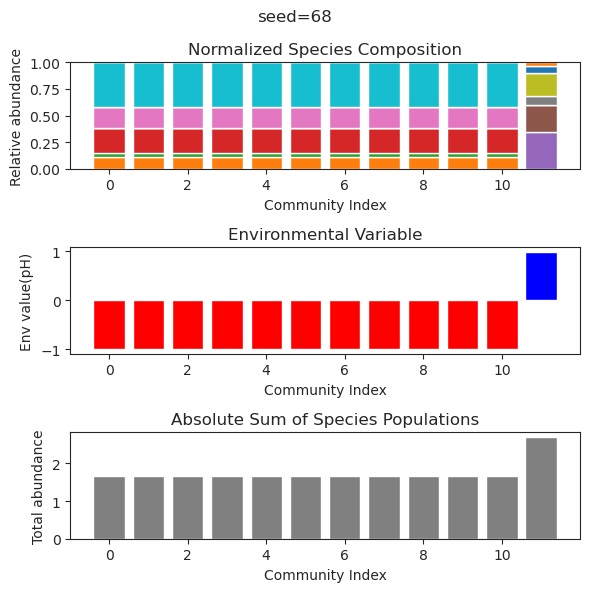

{'species': array([4.63205229e-002, 9.55941928e-002, 6.13410095e-001, 3.65329781e-001,
       6.10003514e-002, 1.71127145e-033, 7.16431768e-109, 2.02014306e-001,
       2.25753074e-002, 3.34802033e-152, 2.59027890e-001, 4.31955963e-166]), 'env': array([-0.61015344])}
{'species': array([ 4.63205251e-002,  9.55941859e-002,  6.13410111e-001,
        3.65329794e-001,  6.10003356e-002,  1.90966628e-029,
       -2.63778705e-084,  2.02014261e-001,  2.25753322e-002,
        7.18503037e-123,  2.59027875e-001,  5.86705626e-176]), 'env': array([-0.61015345])}
{'species': array([ 1.92132499e-01,  2.03027226e-29,  8.64779268e-01,  4.06395184e-32,
        1.62219476e-01,  5.22619559e-02,  5.84052938e-29,  7.16233935e-62,
        9.58090549e-04,  8.47282266e-30,  1.51182592e-01, -6.08732759e-27]), 'env': array([-1.44615817])}
{'species': array([-7.93571950e-42, -2.51760820e-62,  4.54103188e-82,  1.12386289e+00,
        4.43386655e-73, -9.67528822e-56,  1.06646459e+00,  1.71755071e+00,
        4.96234

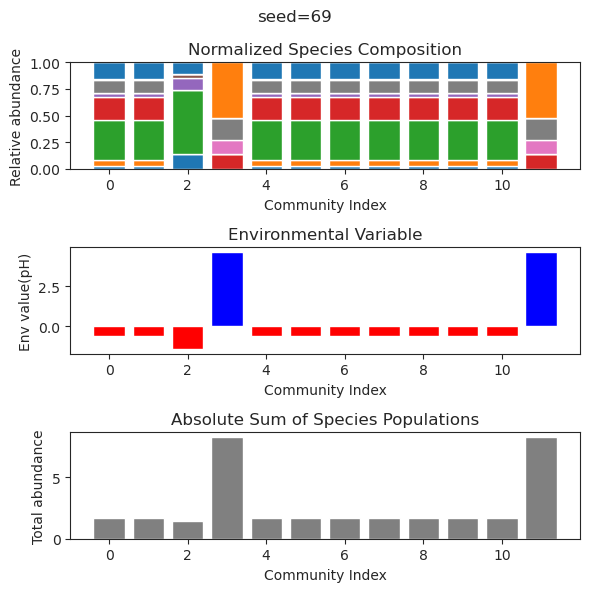

{'species': array([ 1.10512569e-39,  2.75404114e-01,  4.64327713e-59,  8.45639651e-42,
       -1.26982948e-31,  1.15084901e-01,  5.16109152e-64,  1.41815249e+00,
        3.22745341e-57,  3.57615832e-64, -8.57427250e-67, -5.14823683e-29]), 'env': array([-2.62018265])}
{'species': array([ 8.03007862e-35,  2.75404114e-01, -5.01086097e-45,  1.02208295e-34,
        6.51438601e-28,  1.15084901e-01, -8.30895764e-44,  1.41815249e+00,
       -1.05510113e-44, -1.74119710e-45, -1.85109085e-47,  1.65072895e-28]), 'env': array([-2.62018265])}
{'species': array([-3.59271309e-29,  2.75404114e-01, -1.13859831e-38, -6.79115118e-28,
       -6.15610826e-25,  1.15084901e-01,  1.53706094e-38,  1.41815249e+00,
       -4.32653340e-39, -3.65900869e-38, -6.26715089e-40, -5.37711703e-23]), 'env': array([-2.62018265])}
{'species': array([-9.43385454e-37,  2.75404114e-01, -2.17967476e-55, -1.88612745e-35,
       -7.43974554e-27,  1.15084901e-01, -1.03395392e-51,  1.41815249e+00,
       -8.10051597e-51, -5.3535299

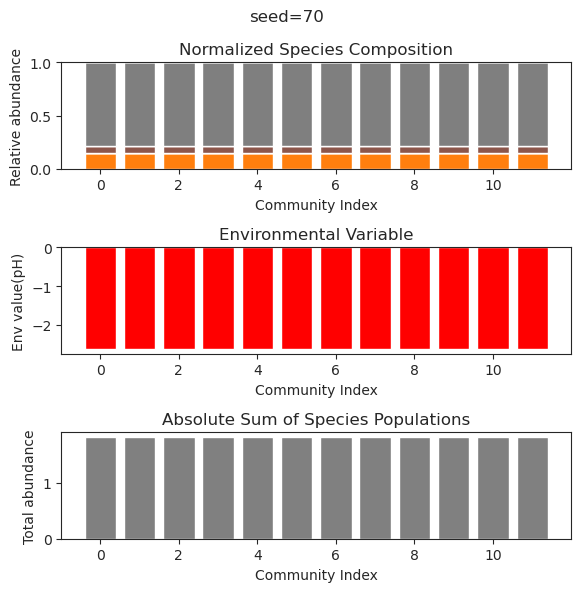

{'species': array([-8.76438681e-132,  1.36719415e-001,  2.28990281e-001,
        2.22530238e-133,  7.68295385e-043, -3.74069297e-110,
        3.96797926e-001,  3.99785176e-001, -1.48374659e-108,
       -5.99103994e-063, -3.76824622e-130,  5.18140256e-001]), 'env': array([-0.98371936])}
{'species': array([ 4.22006666e-134,  1.36719415e-001,  2.28990281e-001,
        6.28756571e-133,  6.94877219e-043, -7.07775823e-112,
        3.96797926e-001,  3.99785176e-001,  9.20492887e-107,
       -4.69384605e-064, -3.10645777e-130,  5.18140256e-001]), 'env': array([-0.98371936])}
{'species': array([-5.20176358e-135,  1.36719415e-001,  2.28990281e-001,
        6.45333293e-130, -1.07242033e-042, -2.69526772e-106,
        3.96797926e-001,  3.99785176e-001,  8.87401095e-105,
        1.61603836e-063, -2.71564479e-131,  5.18140256e-001]), 'env': array([-0.98371936])}
{'species': array([-2.69001497e-125,  1.36719415e-001,  2.28990281e-001,
       -3.46325207e-116,  1.73638039e-039, -6.11973083e-100,
     

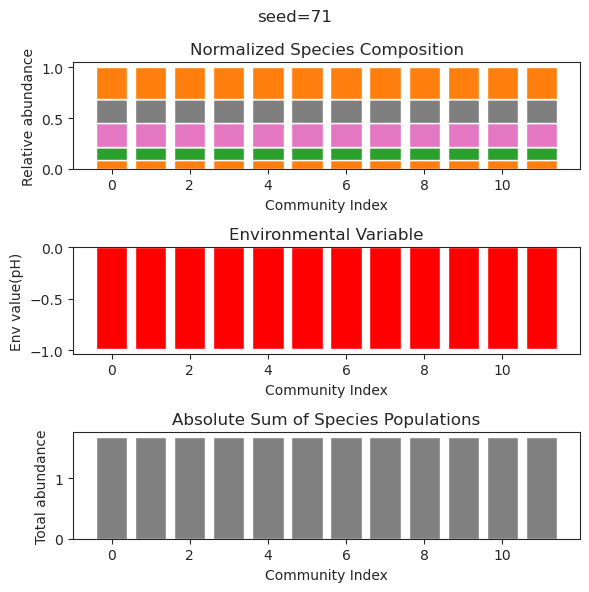

{'species': array([ 1.19652153e-01,  1.70921313e-03, -1.03888261e-22,  8.56776706e-38,
       -1.74913404e-83, -6.11870062e-28,  7.44855630e-01,  2.07150388e-46,
        6.47288546e-01,  1.59519968e-01, -3.17769852e-77, -2.00627358e-64]), 'env': array([-1.11368369])}
{'species': array([ 1.19652332e-01,  1.70893753e-03, -3.77504237e-15, -7.81396593e-30,
       -7.77385457e-26, -1.02141116e-34,  7.44855560e-01,  9.36254575e-39,
        6.47287992e-01,  1.59520606e-01,  1.09865118e-50,  1.13335227e-33]), 'env': array([-1.1136826])}
{'species': array([ 1.19652951e-01,  1.70798861e-03, -5.62316067e-26,  5.13427054e-80,
        1.09665231e-74, -8.82325555e-61,  7.44855318e-01,  5.16151894e-35,
        6.47286084e-01,  1.59522800e-01, -2.10309408e-64,  5.41566182e-53]), 'env': array([-1.11367886])}
{'species': array([ 1.19652932e-01,  1.70801680e-03,  4.26727306e-28,  3.25225448e-56,
        8.51620245e-57, -1.40764441e-45,  7.44855325e-01,  2.45282103e-34,
        6.47286140e-01,  1.59522735

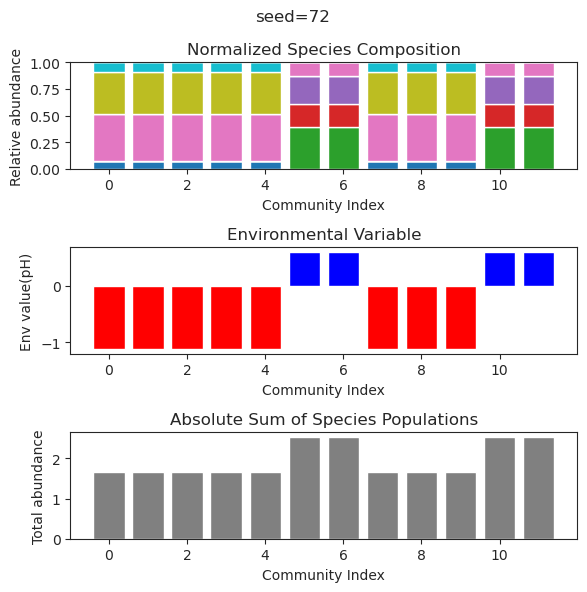

{'species': array([ 7.06399578e-002, -6.42243013e-092, -1.85637969e-057,
        6.21699179e-001, -6.28383225e-176,  5.46204639e-001,
       -1.44200616e-069,  3.30922000e-126,  2.42184216e-001,
        2.87528502e-001,  2.35954298e-001,  7.30238245e-100]), 'env': array([-0.30522734])}
{'species': array([ 7.06399578e-002, -6.09951096e-076, -2.10751686e-041,
        6.21699179e-001,  9.29642394e-155,  5.46204639e-001,
        4.58276919e-051, -3.78960575e-112,  2.42184216e-001,
        2.87528502e-001,  2.35954298e-001, -9.79139162e-086]), 'env': array([-0.30522734])}
{'species': array([ 7.06399578e-002,  1.01930179e-072, -2.53478869e-041,
        6.21699179e-001, -1.30227915e-149,  5.46204639e-001,
       -3.05826922e-051, -2.20529281e-109,  2.42184216e-001,
        2.87528502e-001,  2.35954298e-001,  2.17527339e-087]), 'env': array([-0.30522734])}
{'species': array([ 7.06399578e-002,  1.12686381e-075, -6.03134629e-039,
        6.21699179e-001,  1.59617478e-156,  5.46204639e-001,
     

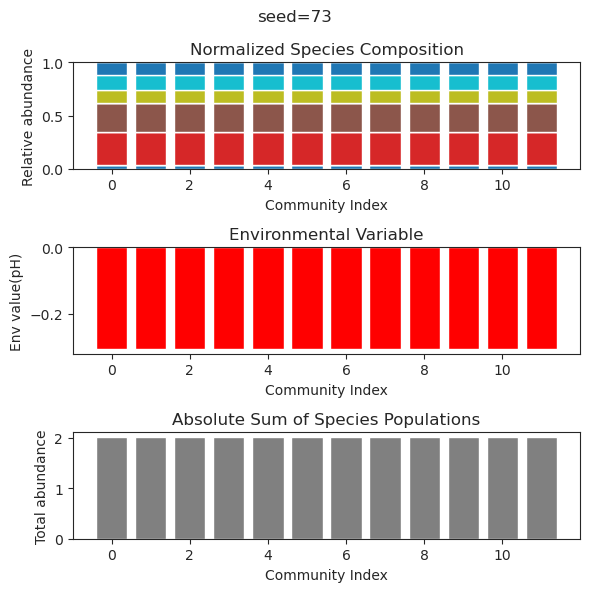

{'species': array([ 2.25448675e-22,  2.52574786e-01,  1.83807389e-01,  8.65403599e-01,
        2.68806484e-39, -3.68828684e-51,  2.13369031e-01, -6.96105686e-30,
       -4.12231981e-45,  5.64725350e-01,  7.71535432e-34, -2.43837556e-38]), 'env': array([-1.47334525])}
{'species': array([-1.70606531e-27,  2.52574786e-01,  1.83807389e-01,  8.65403599e-01,
        1.69079229e-40,  8.32606043e-48,  2.13369031e-01, -2.52180116e-29,
        5.28457758e-43,  5.64725350e-01,  2.64582372e-32,  1.42094543e-35]), 'env': array([-1.47334525])}
{'species': array([ 8.19111750e-25,  2.52574786e-01,  1.83807389e-01,  8.65403599e-01,
        3.41850637e-43, -2.10061056e-45,  2.13369031e-01,  7.07857074e-30,
        1.03333956e-43,  5.64725350e-01, -7.63804646e-35, -6.09865234e-35]), 'env': array([-1.47334525])}
{'species': array([ 3.83770207e-22,  2.52574786e-01,  1.83807389e-01,  8.65403599e-01,
        1.19236766e-40, -3.89682419e-50,  2.13369031e-01, -2.59567375e-29,
       -1.78163982e-46,  5.6472535

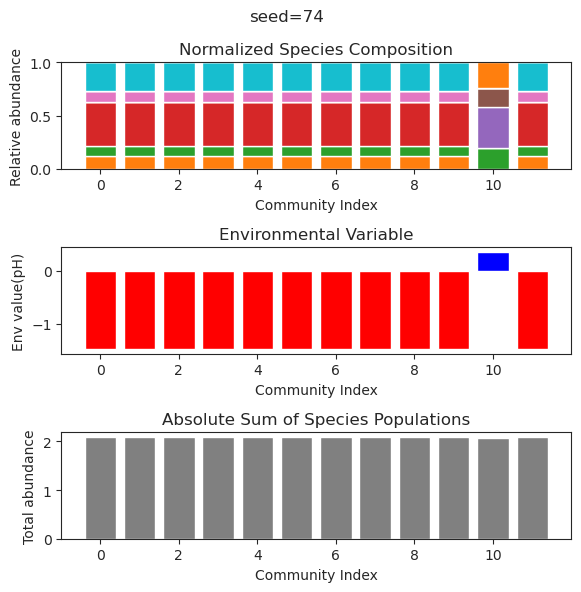

{'species': array([ 1.13742427e-51,  2.72406099e-01, -1.03549990e-27,  4.08552220e-01,
       -1.54027239e-19, -1.67912202e-69, -2.60064316e-68,  8.14840768e-62,
        1.29478366e-70,  6.50402058e-52,  7.91495737e-01, -2.63759727e-58]), 'env': array([-2.24186042])}
{'species': array([-2.94603304e-39,  2.72406099e-01, -2.69721799e-24,  4.08552220e-01,
        1.20514310e-18, -1.09121547e-50, -1.01998066e-50, -2.41609808e-47,
        5.39081173e-60,  1.14398602e-45,  7.91495737e-01,  1.24375217e-50]), 'env': array([-2.24186042])}
{'species': array([ 6.44511670e-40,  2.72406099e-01,  9.94443688e-27,  4.08552220e-01,
       -4.39721370e-18,  1.61158110e-52,  4.94484809e-50, -1.19816674e-47,
       -1.41293567e-58,  1.12609156e-46,  7.91495737e-01,  1.15138294e-52]), 'env': array([-2.24186042])}
{'species': array([ 1.16093454e-39,  2.72406099e-01, -2.46985812e-31,  4.08552220e-01,
        9.16284767e-17,  5.21664865e-46,  2.10247760e-42,  4.46343660e-42,
       -2.29746320e-45,  9.8234693

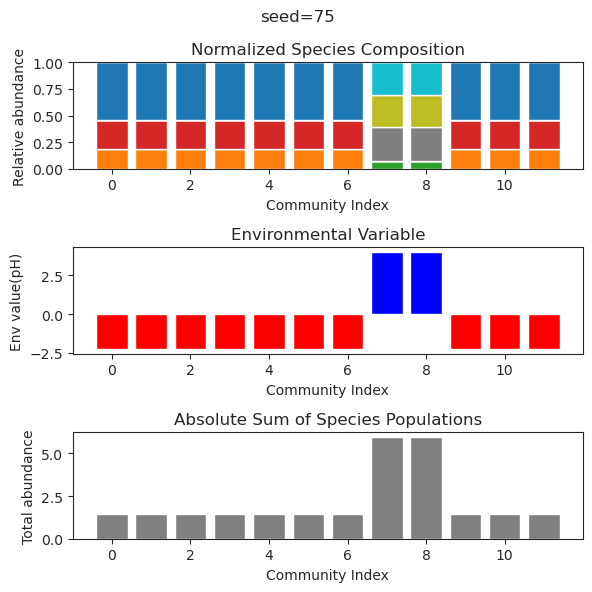

{'species': array([ 2.26038731e-70, -1.06552277e-55,  1.90282872e-35,  5.40681540e-01,
        5.01723933e-43,  2.09913884e-53,  7.24834386e-01,  1.74801117e+00,
        1.02633949e+00,  1.54382885e-59, -1.68663523e-66, -1.78949397e-63]), 'env': array([1.79631142])}
{'species': array([ 2.40096217e-38,  1.85097735e-54, -6.10954861e-37,  5.40681540e-01,
       -1.28165599e-44, -1.24733620e-53,  7.24834386e-01,  1.74801117e+00,
        1.02633949e+00, -8.52498207e-68,  4.42098719e-71, -3.46769489e-69]), 'env': array([1.79631142])}
{'species': array([ 1.49290406e-53, -1.05201149e-40,  9.32570223e-37,  5.40681540e-01,
        8.43206067e-41,  3.54904447e-44,  7.24834386e-01,  1.74801117e+00,
        1.02633949e+00,  3.33888822e-46,  4.12763250e-52,  2.35049972e-50]), 'env': array([1.79631142])}
{'species': array([ 3.11895292e-63,  3.91363693e-48, -6.30062503e-39,  5.40681540e-01,
       -2.99395334e-38, -2.40834706e-41,  7.24834386e-01,  1.74801117e+00,
        1.02633949e+00, -7.58582281e-

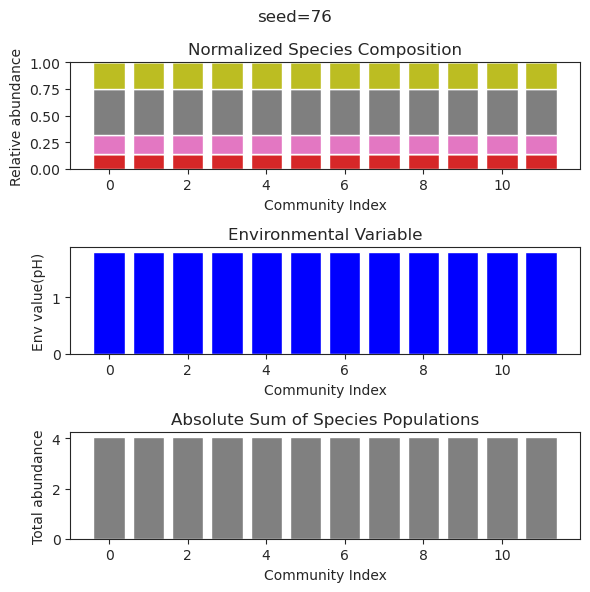

{'species': array([ 4.68997232e-20,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
        1.97909915e-51, -5.64596347e-25,  3.64542721e-39,  1.29757920e-01,
       -2.38658588e-48,  1.54274597e-58, -1.48349484e-58,  4.48744115e-59]), 'env': array([-1.3936028])}
{'species': array([ 2.46764198e-25,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
       -3.85266420e-63, -2.75103022e-32, -2.12263299e-38,  1.29757920e-01,
       -6.04869681e-54,  4.33154617e-69, -9.52749250e-63, -6.32871199e-65]), 'env': array([-1.3936028])}
{'species': array([-2.37130583e-23,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
        1.70594375e-45,  1.70991900e-24, -5.75840731e-27,  1.29757920e-01,
       -4.76296347e-36, -2.49246356e-51, -1.63663127e-44, -3.22171983e-49]), 'env': array([-1.3936028])}
{'species': array([-5.19264776e-26,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
       -1.20334206e-63, -4.55342950e-31, -1.54446434e-36,  1.29757920e-01,
       -6.78598990e-53, -2.30835035e-

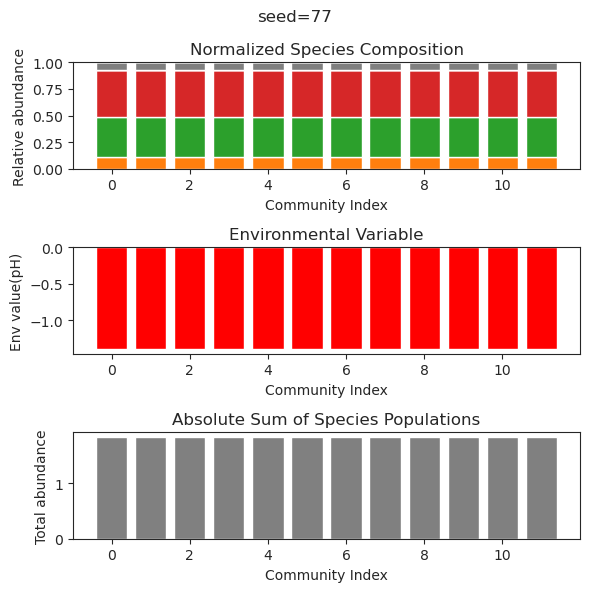

{'species': array([ 4.50975116e-25,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
       -5.63154558e-62, -8.52872449e-29,  1.82448615e-34,  1.29757920e-01,
        3.63114858e-47,  1.55704214e-64,  1.44631370e-57,  3.43940610e-59]), 'env': array([-1.3936028])}
{'species': array([ 4.50975116e-25,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
       -5.63154558e-62, -8.52872449e-29,  1.82448615e-34,  1.29757920e-01,
        3.63114858e-47,  1.55704214e-64,  1.44631370e-57,  3.43940610e-59]), 'env': array([-1.3936028])}
{'species': array([ 5.47896340e-47,  5.80676259e-37, -1.19573778e-70,  7.76812680e-77,
        6.22951076e-75,  4.90369765e+00,  3.67834960e-42, -2.24089001e-54,
       -5.57007846e-72,  6.50060265e+00, -1.70705729e-78,  2.77681450e-73]), 'env': array([6.96083421])}
{'species': array([-2.93735204e-79, -2.05857076e-33, -2.52690923e-79,  2.13266992e-85,
       -3.89938903e-85,  4.90369765e+00, -1.00614269e-46, -3.10803335e-58,
       -1.02422009e-76,  6.50060265e+

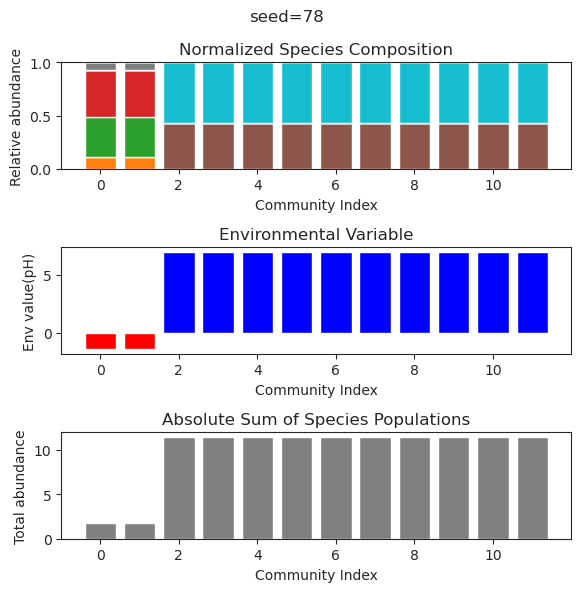

{'species': array([-1.37544366e-34,  2.41782295e-01, -9.88486892e-53,  6.34984580e-01,
       -2.17537228e-28,  1.27330215e-29,  1.56381723e-01,  2.28008734e-01,
        7.70505337e-40, -2.71763653e-30, -1.18566308e-42,  5.66015337e-01]), 'env': array([-1.56206125])}
{'species': array([-2.55376423e-36,  2.41782295e-01, -1.17089132e-56,  6.34984580e-01,
        1.47490417e-28,  3.60774017e-28,  1.56381723e-01,  2.28008734e-01,
       -1.69480785e-43,  9.60068611e-32, -2.18677702e-48,  5.66015337e-01]), 'env': array([-1.56206125])}
{'species': array([-4.07460327e-35,  2.41782295e-01,  2.00241290e-56,  6.34984580e-01,
       -9.26849997e-29,  8.17098872e-31,  1.56381723e-01,  2.28008734e-01,
        2.27464738e-44,  6.67090717e-34,  5.29860711e-49,  5.66015337e-01]), 'env': array([-1.56206125])}
{'species': array([-9.84420450e-34,  2.41782295e-01, -8.35871048e-50,  6.34984580e-01,
       -3.66173594e-27,  2.34135024e-30,  1.56381723e-01,  2.28008734e-01,
       -1.22435244e-40,  2.6981426

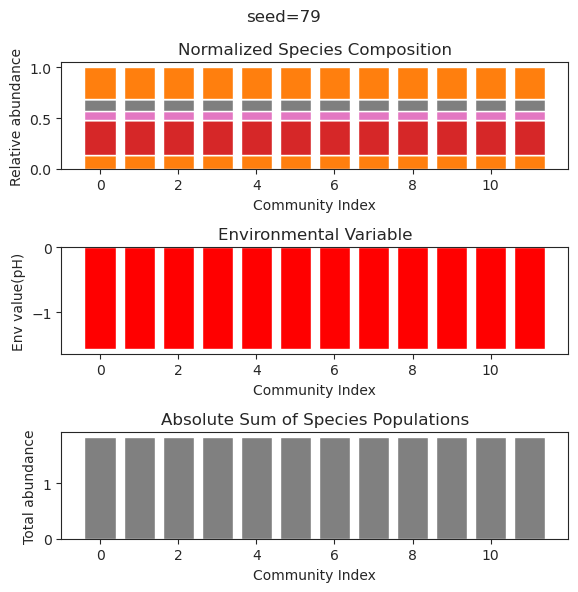

{'species': array([ 2.99685080e-01, -1.34434774e-33, -3.08765998e-35, -5.23703592e-49,
        2.77171412e-19,  2.33158665e-40,  3.01928058e-01,  2.21565009e-26,
        6.20341597e-01,  5.96300235e-26, -8.77329204e-44,  2.89302153e-01]), 'env': array([-2.23661261])}
{'species': array([ 2.99685080e-01, -1.82980978e-32,  1.28976077e-41, -3.39189792e-53,
       -7.07630073e-20, -1.16410504e-38,  3.01928058e-01, -5.08125162e-26,
        6.20341597e-01,  8.28073302e-30,  3.60195136e-46,  2.89302153e-01]), 'env': array([-2.23661261])}
{'species': array([ 2.99685080e-01, -1.29989498e-34,  3.52218670e-43,  8.08073020e-63,
       -3.26006959e-19, -8.70032850e-45,  3.01928058e-01,  7.37561075e-25,
        6.20341597e-01, -1.54383592e-29,  3.13098806e-53,  2.89302153e-01]), 'env': array([-2.23661261])}
{'species': array([ 2.99685080e-01, -1.97138103e-36,  6.49170876e-46,  4.26321489e-66,
        6.12854982e-21,  1.31791110e-45,  3.01928058e-01, -7.07927205e-26,
        6.20341597e-01,  5.2698100

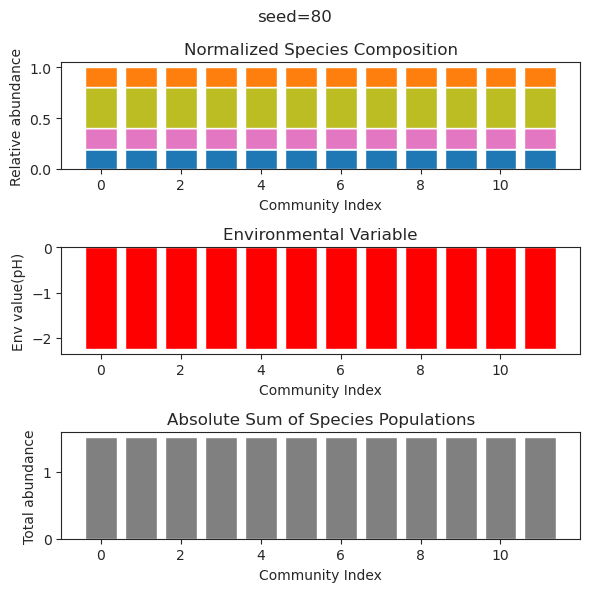

{'species': array([5.42490649e-002, 1.82622185e-063, 5.90776000e-090, 3.07921479e-092,
       2.20541251e-001, 6.69765962e-001, 1.20367293e-003, 4.02379873e-127,
       5.59638804e-006, 9.64276584e-028, 1.14958376e-001, 1.12677334e+000]), 'env': array([1.26421143])}
{'species': array([1.46785051e-001, 1.07607355e-061, 1.14522077e-089, 1.05690685e-089,
       1.49010790e-001, 6.28834689e-003, 1.59969134e-003, 4.85983372e-128,
       3.31487670e-001, 1.67035910e-025, 1.08132364e+000, 2.02786896e-002]), 'env': array([-1.68466702])}
{'species': array([-1.01683704e-62,  1.16779824e-70,  9.24580178e-01,  2.80892219e-02,
        9.62746083e-66,  1.29894928e+00,  5.29925295e-53,  2.65368857e+00,
       -1.31868846e-56,  6.66511117e-01, -2.71253070e-67, -5.08190597e-55]), 'env': array([3.71775164])}
{'species': array([-3.18537321e-42, -2.32409547e-45,  9.24580178e-01,  2.80892219e-02,
       -5.77290402e-62,  1.29894928e+00, -1.70087349e-42,  2.65368857e+00,
       -5.68533967e-57,  6.66511117e

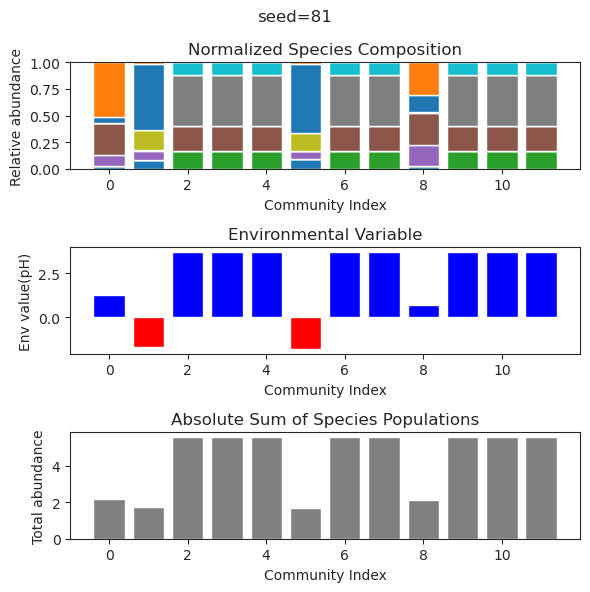

{'species': array([ 4.41758128e-27,  1.54246125e-01,  4.89807687e-01,  1.06880414e-02,
        1.37242256e-57,  7.61775605e-01,  1.55959799e-02,  3.99568889e-80,
       -1.17971294e-38,  1.10667262e-01,  3.10957583e-02,  4.83987012e-03]), 'env': array([-0.96400528])}
{'species': array([-3.38969240e-028,  1.53242644e-001,  4.91427105e-001,
        1.67955790e-002,  2.42586043e-074,  7.46229804e-001,
        1.60961399e-002,  9.39156531e-186,  1.66343950e-031,
        1.22677399e-001,  2.81753402e-002,  2.33259078e-003]), 'env': array([-0.95335834])}
{'species': array([-5.62785064e-028,  1.54261586e-001,  4.89797759e-001,
        1.06076021e-002,  9.05931003e-067,  7.61965190e-001,
        1.54937981e-002,  2.71559473e-122, -1.31761433e-031,
        1.10589443e-001,  3.11961240e-002,  4.72242428e-003]), 'env': array([-0.96419249])}
{'species': array([-3.61615927e-30,  1.54322726e-01,  4.89671748e-01,  1.02559921e-02,
       -1.00013711e-61,  7.63021583e-01,  1.57631092e-02,  2.91965174e-

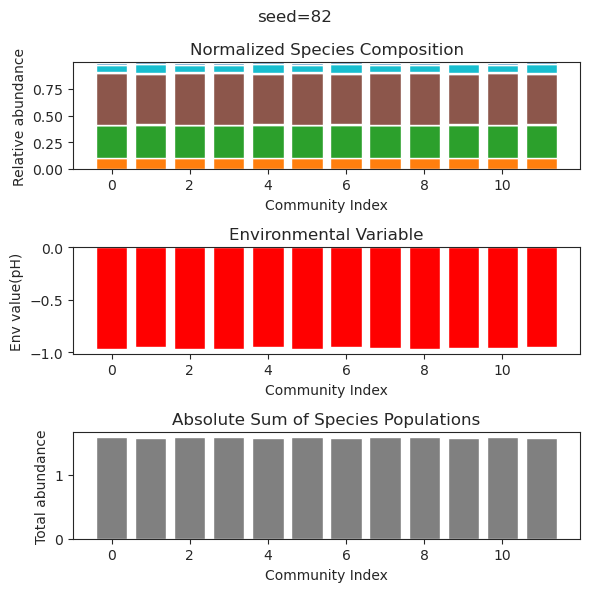

{'species': array([ 1.94432063e-65,  1.98466753e-01,  7.76387244e-01,  8.12678708e-01,
        2.04159902e-36,  2.59706190e-33,  1.60864293e-61,  5.14586840e-23,
       -1.35907525e-69,  3.08783621e-22, -8.15244237e-54, -6.35643629e-59]), 'env': array([-1.46673504])}
{'species': array([ 2.10212475e-61,  1.98466753e-01,  7.76387244e-01,  8.12678708e-01,
        4.05031956e-34, -4.64292712e-32, -1.64680733e-59, -2.00738876e-25,
        8.58535235e-65, -1.39283217e-24, -6.93804626e-57, -1.68534001e-60]), 'env': array([-1.46673504])}
{'species': array([7.26254522e-002, 3.92707256e-003, 5.66479155e-001, 5.39200696e-132,
       5.48551226e-208, 4.42358094e-005, 8.73426437e-002, 4.67337289e-001,
       1.52023614e-298, 3.54104448e-001, 0.00000000e+000, 2.10317976e-001]), 'env': array([-0.26745161])}
{'species': array([-1.89355974e-59,  1.98466753e-01,  7.76387244e-01,  8.12678708e-01,
        1.27726894e-32,  3.10214473e-30,  8.32920212e-56,  2.48293978e-23,
        8.58982271e-60,  2.1586938

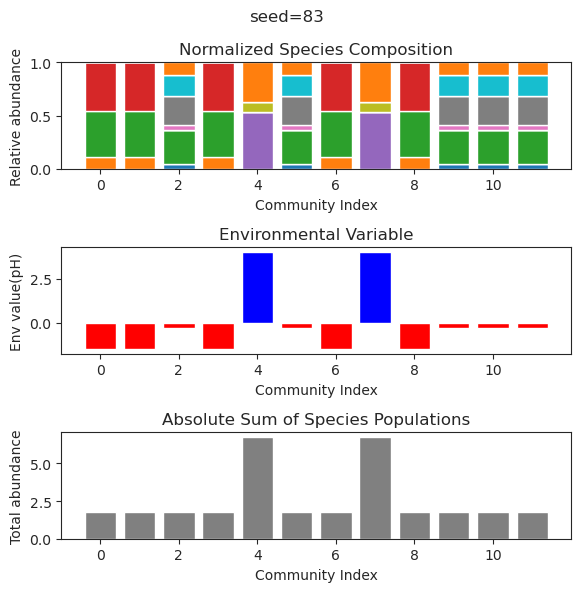

{'species': array([ 2.22294234e-01, -4.37890198e-43, -2.42955414e-49,  1.60210131e-68,
       -1.42239331e-57, -3.48801086e-56,  1.81205366e-01, -1.55835910e-21,
        4.60487053e-01,  1.35930699e-78,  5.29079559e-09,  3.68853353e-01]), 'env': array([-1.85443928])}
{'species': array([ 2.22294234e-01, -9.27520289e-38,  4.02034519e-41,  1.18833652e-57,
       -3.79725835e-49,  3.29336851e-48,  1.81205366e-01, -4.40584058e-21,
        4.60487053e-01, -2.78299399e-61,  6.01134720e-09,  3.68853353e-01]), 'env': array([-1.85443928])}
{'species': array([ 2.22294234e-01, -8.69235037e-45, -7.97384021e-55,  5.35166360e-69,
        1.41627830e-47, -2.64916735e-58,  1.81205366e-01,  8.34281464e-28,
        4.60487050e-01,  3.59513626e-78,  1.28511550e-08,  3.68853353e-01]), 'env': array([-1.85443927])}
{'species': array([ 2.22294234e-01,  4.00302887e-38, -9.12521785e-45,  1.73131256e-55,
       -2.91002079e-45, -5.07954875e-48,  1.81205366e-01, -6.61937356e-16,
        4.60487053e-01, -1.0761082

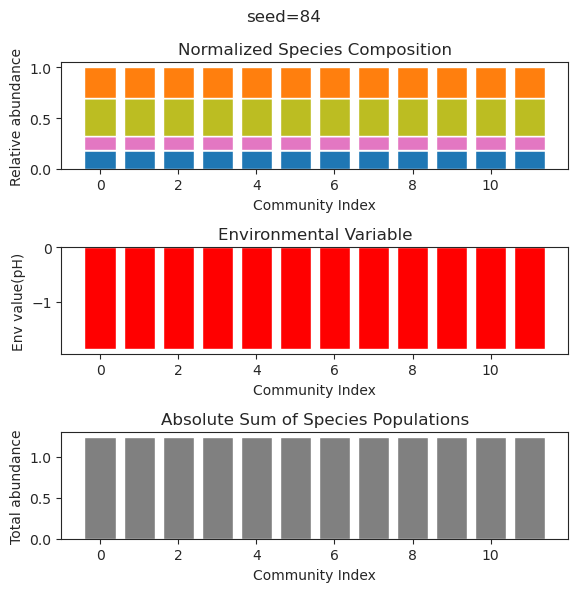

{'species': array([ 3.91155747e-08,  2.28258496e-01,  5.35453233e-01, -3.05801115e-30,
        4.44292942e-40, -3.41211629e-22,  1.81809639e-01,  3.38275377e-43,
        3.09721377e-01,  1.66507234e-61, -6.77959608e-47,  4.56679579e-01]), 'env': array([-1.65676946])}
{'species': array([ 1.49677557e-08,  2.28258512e-01,  5.35453227e-01,  3.76330300e-20,
        1.93456700e-35,  2.83299789e-17,  1.81809628e-01,  3.47049646e-39,
        3.09721406e-01,  2.75338635e-32, -1.31492968e-35,  4.56679595e-01]), 'env': array([-1.65676938])}
{'species': array([ 3.26806481e-08,  2.28258500e-01,  5.35453231e-01,  2.21069362e-15,
       -2.56355402e-37, -2.90239973e-15,  1.81809636e-01, -5.93662407e-41,
        3.09721385e-01,  1.94363063e-51,  1.02730112e-40,  4.56679584e-01]), 'env': array([-1.65676944])}
{'species': array([ 2.22049277e-08,  2.28258507e-01,  5.35453229e-01,  4.69266427e-19,
       -8.08875850e-36,  1.95626906e-19,  1.81809631e-01, -2.83897729e-41,
        3.09721397e-01, -4.1164384

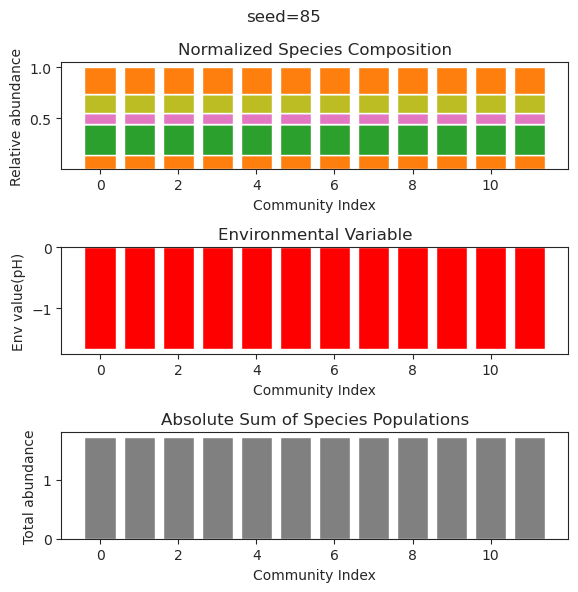

{'species': array([ 2.32487188e-01, -1.38060721e-31,  1.91919401e-01,  6.17616568e-32,
       -1.45136411e-39, -4.05365487e-45,  5.70420216e-57,  2.71370510e-74,
        5.00311009e-75,  6.92333258e-01,  1.13580757e-20,  7.83664183e-50]), 'env': array([-2.00611793])}
{'species': array([ 2.32487188e-01, -3.09257226e-31,  1.91919401e-01, -4.09699509e-31,
        3.66461964e-42,  8.82489723e-47,  1.75284010e-60, -2.70268546e-81,
        1.13482491e-78,  6.92333258e-01, -1.26770571e-20,  2.33110274e-48]), 'env': array([-2.00611793])}
{'species': array([ 2.32487188e-01, -1.18182708e-33,  1.91919401e-01, -7.11761462e-28,
       -1.98468914e-42, -3.60147132e-50, -4.43539008e-56,  1.25450051e-74,
       -1.18750451e-70,  6.92333258e-01,  2.02940664e-22,  4.52660142e-40]), 'env': array([-2.00611793])}
{'species': array([ 2.32487188e-01, -4.43472034e-33,  1.91919401e-01,  3.49724975e-32,
        1.68450439e-41,  8.40812090e-47, -1.83137538e-53,  3.06524962e-76,
        3.82663150e-75,  6.9233325

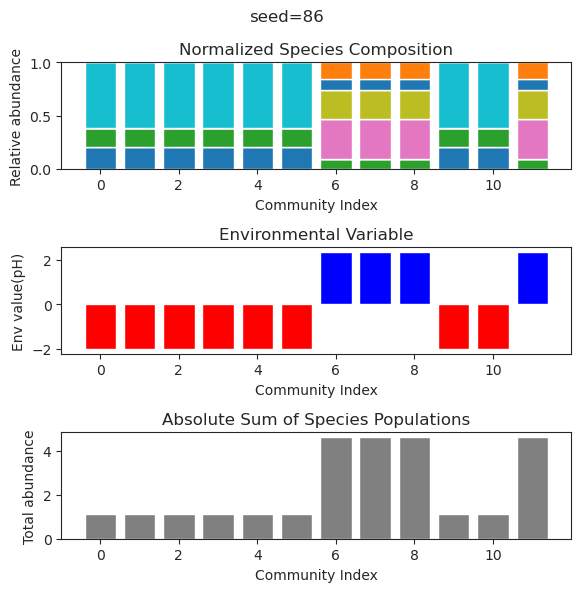

{'species': array([ 1.47227533e-02,  1.14621697e-01,  1.63181590e-89,  6.41465733e-01,
       -1.60939189e-90,  4.48713977e-01,  2.33778546e-02,  8.71704353e-02,
        2.01310788e-01, -1.08430357e-38,  1.44592988e-79, -1.64935555e-64]), 'env': array([-0.80729879])}
{'species': array([ 1.47227411e-02,  1.14621709e-01,  4.99851826e-36,  6.41465743e-01,
        1.93534590e-78,  4.48713980e-01,  2.33778384e-02,  8.71704451e-02,
        2.01310780e-01, -1.27254942e-37, -3.13627127e-70,  1.16387562e-60]), 'env': array([-0.8072988])}
{'species': array([ 1.47080719e-02,  1.14636032e-01,  8.87971165e-32,  6.41477899e-01,
        1.13582435e-31,  4.48717478e-01,  2.33583642e-02,  8.71822108e-02,
        2.01300579e-01,  1.27196172e-51, -3.63264961e-80, -7.33659881e-72]), 'env': array([-0.80730666])}
{'species': array([ 1.47227521e-02,  1.14621698e-01,  6.87588428e-95,  6.41465734e-01,
        2.11245081e-93,  4.48713977e-01,  2.33778529e-02,  8.71704363e-02,
        2.01310788e-01,  1.20716397

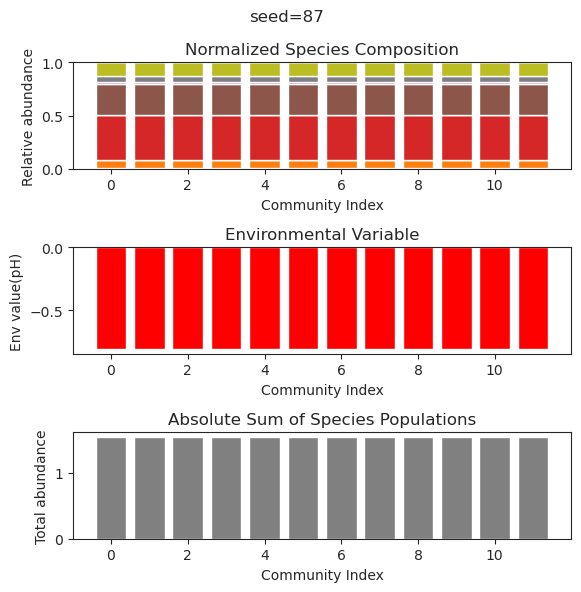

{'species': array([-4.25936744e-63,  8.24906829e-46, -9.20347199e-78,  6.35667479e-01,
        1.24933748e+00,  1.27752650e+00,  1.17151216e-54,  6.77402097e-45,
        3.37344512e-01,  3.50902662e-64,  2.01248078e-48, -1.12623592e-33]), 'env': array([0.71784227])}
{'species': array([-4.25936744e-63,  8.24906829e-46, -9.20347199e-78,  6.35667479e-01,
        1.24933748e+00,  1.27752650e+00,  1.17151216e-54,  6.77402097e-45,
        3.37344512e-01,  3.50902662e-64,  2.01248078e-48, -1.12623592e-33]), 'env': array([0.71784227])}
{'species': array([-2.02076347e-165, -8.35003654e-073,  2.34344572e-118,
        3.90169469e-001,  8.97712110e-001,  1.11015609e+000,
        1.72186240e-001,  3.64531887e-001,  1.95189408e-001,
       -4.27537260e-160, -1.02476121e-127,  4.36392963e-051]), 'env': array([0.59845328])}
{'species': array([-1.97194209e-87,  1.48791240e-41,  4.68588474e-72,  3.90169469e-01,
        8.97712110e-01,  1.11015609e+00,  1.72186240e-01,  3.64531887e-01,
        1.95189408

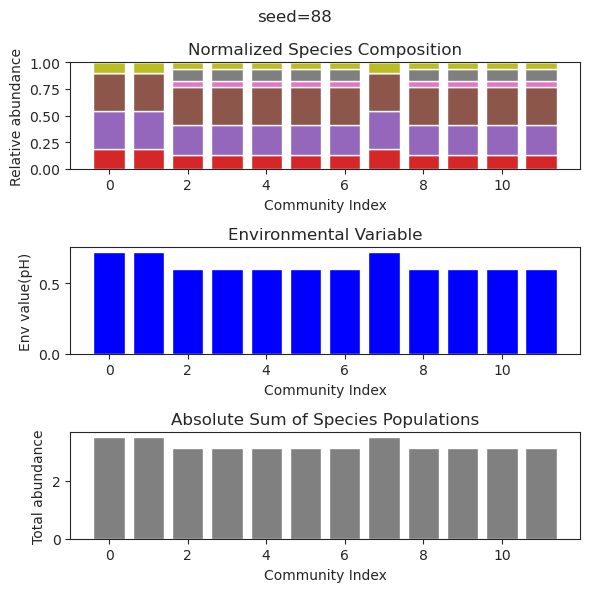

{'species': array([ 1.43445336e-01,  1.94395665e-13,  2.89765013e-01,  3.70880334e-96,
       -2.85890442e-48,  9.81561464e-64,  7.18910433e-01,  4.12768509e-01,
        1.74925856e-52, -1.45626689e-85,  3.78788243e-01, -6.20881235e-83]), 'env': array([-0.63876252])}
{'species': array([ 1.43445336e-001,  5.41008212e-012,  2.89765013e-001,
       -1.87044714e-120,  2.53328055e-053, -3.22942878e-071,
        7.18910433e-001,  4.12768509e-001,  2.70870821e-060,
        7.46786781e-093,  3.78788243e-001,  5.92213111e-101]), 'env': array([-0.63876252])}
{'species': array([ 1.43445336e-001,  1.57782297e-011,  2.89765013e-001,
       -2.59002112e-106, -7.88111915e-055, -3.86835386e-070,
        7.18910433e-001,  4.12768509e-001,  2.96777977e-047,
       -1.59912900e-085,  3.78788243e-001, -3.99308731e-092]), 'env': array([-0.63876252])}
{'species': array([ 1.43445336e-01, -7.01249187e-15,  2.89765013e-01,  4.29583555e-92,
        4.27458259e-46, -9.84176177e-60,  7.18910433e-01,  4.12768509e-

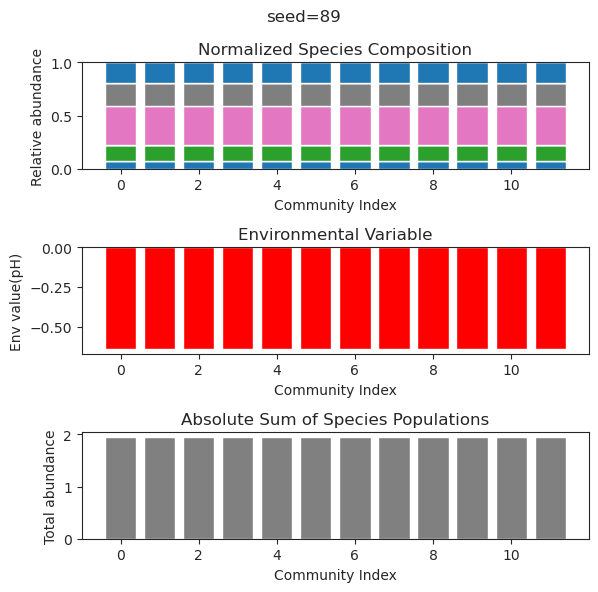

{'species': array([ 1.20237958e-01,  7.95641238e-30, -9.40002255e-34, -1.90574565e-37,
       -1.60710110e-23,  5.38545960e-40, -8.57556660e-40,  8.02038778e-01,
        8.39767469e-01,  1.04966534e-06,  2.22605863e-56,  1.28660326e-43]), 'env': array([-0.75825038])}
{'species': array([ 1.20237959e-01, -3.25753873e-35,  1.28971319e-33, -2.01097928e-39,
       -3.68156216e-41, -4.56382677e-42,  1.65657612e-37,  8.02038187e-01,
        8.39767349e-01,  1.75370901e-06, -3.71010008e-73,  2.97881395e-48]), 'env': array([-0.7582502])}
{'species': array([2.68064561e-065, 3.13813714e-001, 6.42783094e-124, 8.31601272e-003,
       4.44304767e-296, 2.78295315e-001, 1.76440299e-278, 3.11660977e-181,
       3.04393533e-067, 3.95893282e-001, 5.68468321e-001, 2.20702073e-001]), 'env': array([-0.1288903])}
{'species': array([ 2.82032277e-065,  4.26943555e-002,  4.07829782e-117,
        4.54437223e-001,  6.70121500e-308,  1.27814202e-002,
       -8.66595924e-302,  1.73661811e-177,  1.73356162e-063,
   

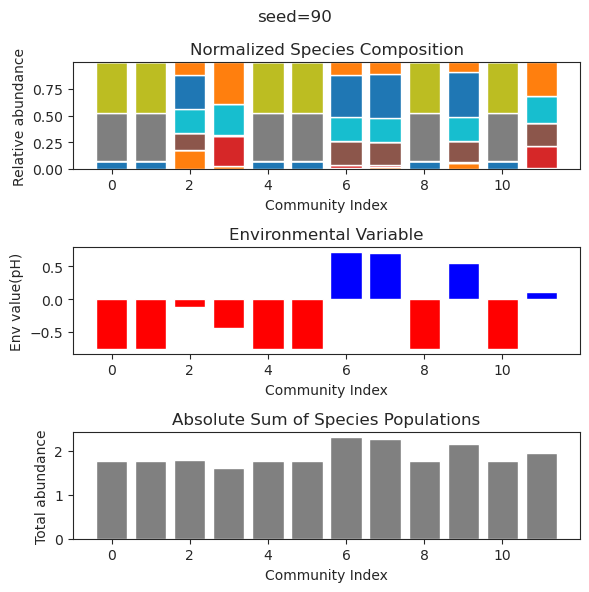

{'species': array([ 2.16655653e-01, -3.03299629e-21, -3.90290564e-35,  4.69260871e-01,
        2.48677395e-48,  5.54885970e-53,  1.22339070e-01, -7.23395331e-38,
       -6.32584535e-39,  6.28287996e-01,  2.83488368e-47,  1.62940163e-33]), 'env': array([-1.32774088])}
{'species': array([ 2.16655653e-01,  2.18890137e-20,  5.48579093e-35,  4.69260871e-01,
        5.85305043e-50,  7.47774286e-56,  1.22339070e-01, -1.20789546e-39,
       -2.42057543e-38,  6.28287996e-01,  1.15730204e-49, -6.37612562e-32]), 'env': array([-1.32774088])}
{'species': array([ 2.16655653e-01, -3.93378172e-20, -1.53826822e-33,  4.69260871e-01,
       -3.69531107e-47,  9.11348873e-54,  1.22339070e-01,  1.13906780e-38,
       -7.59297529e-37,  6.28287996e-01,  1.85419461e-48,  1.63088991e-32]), 'env': array([-1.32774088])}
{'species': array([ 2.16655653e-01, -4.81519869e-20,  1.01763771e-29,  4.69260871e-01,
        1.48490288e-44, -1.20411151e-50,  1.22339070e-01,  2.13654026e-33,
       -1.31695025e-30,  6.2828799

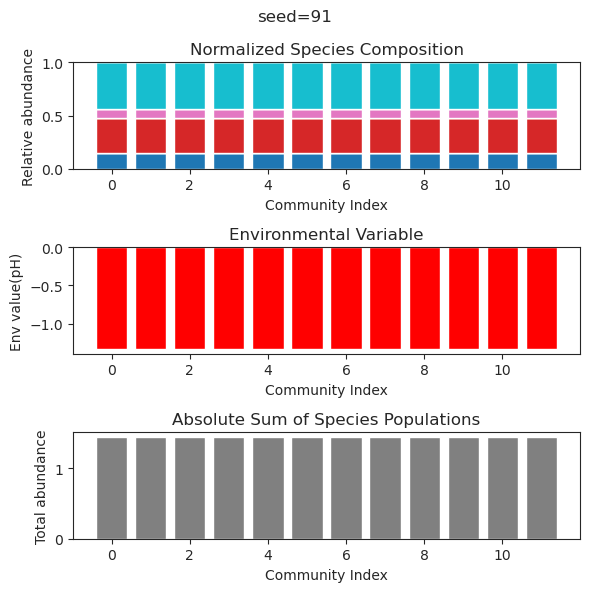

{'species': array([ 1.65574050e-01,  5.10121351e-34,  2.79638660e-55,  1.07561026e-60,
       -4.79022512e-27, -1.09663103e-33, -1.73159944e-60, -5.95411300e-18,
        1.11874149e+00,  1.28486090e-62,  1.83127727e-42, -8.78670906e-62]), 'env': array([-1.70377709])}
{'species': array([ 1.65574050e-01,  7.13959227e-43,  3.60596885e-75, -2.42817675e-73,
       -5.29534106e-27, -1.64632440e-37, -2.44437621e-70, -8.86607244e-19,
        1.11874149e+00, -1.01555982e-80,  6.62441221e-55, -4.81275575e-78]), 'env': array([-1.70377709])}
{'species': array([ 1.65574050e-01, -8.82707903e-42, -9.12153295e-71, -1.26965062e-63,
        1.83799315e-25, -7.76551511e-36, -9.08716077e-59, -8.99680399e-18,
        1.11874149e+00, -2.08656000e-66, -7.21278132e-52,  4.35010034e-66]), 'env': array([-1.70377709])}
{'species': array([ 1.65574050e-01,  8.66697780e-33,  5.14465219e-49,  4.06386256e-54,
       -3.98071959e-26,  9.89230239e-35,  2.42640419e-51, -8.92409047e-19,
        1.11874149e+00,  1.0215873

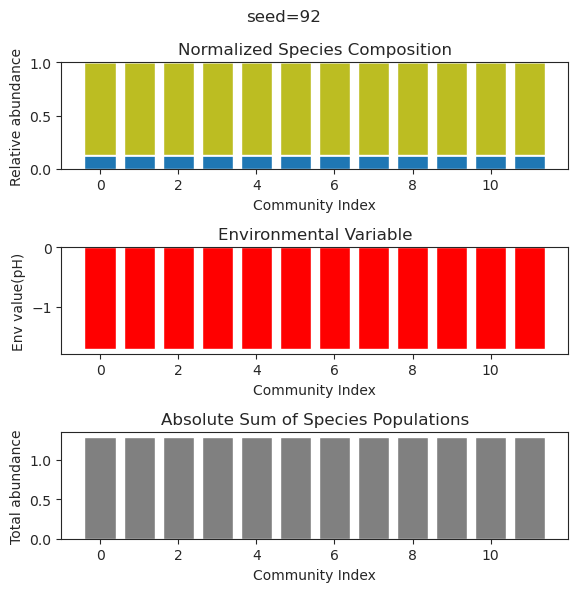

{'species': array([-2.88151043e-43,  3.75517669e-57, -2.15653421e-87,  1.18554075e-46,
        4.75207673e-67,  1.49012672e+00, -3.78992061e-17,  7.13665743e-88,
        2.36551071e+00,  1.28594482e+00, -1.15511779e-81,  6.02437439e-78]), 'env': array([2.73999692])}
{'species': array([ 1.46307112e-001,  3.94815494e-025,  2.37258553e-001,
        1.69149284e-001,  2.25798851e-001,  4.39178126e-137,
        1.05801885e-063,  1.85439741e-001,  2.84107027e-213,
       -4.94065646e-324,  4.91152683e-001,  1.82858230e-001]), 'env': array([-0.82977596])}
{'species': array([ 1.46307113e-001,  2.32233321e-024,  2.37258553e-001,
        1.69149284e-001,  2.25798851e-001, -9.23269450e-140,
        1.42323649e-059,  1.85439741e-001, -2.09021041e-211,
        4.94065646e-324,  4.91152683e-001,  1.82858230e-001]), 'env': array([-0.82977596])}
{'species': array([ 1.09699521e-81, -6.30216184e-57,  1.48337919e-76,  1.47198059e-56,
       -5.62645588e-63,  1.49012672e+00,  2.94687025e-21,  2.39583234e-7

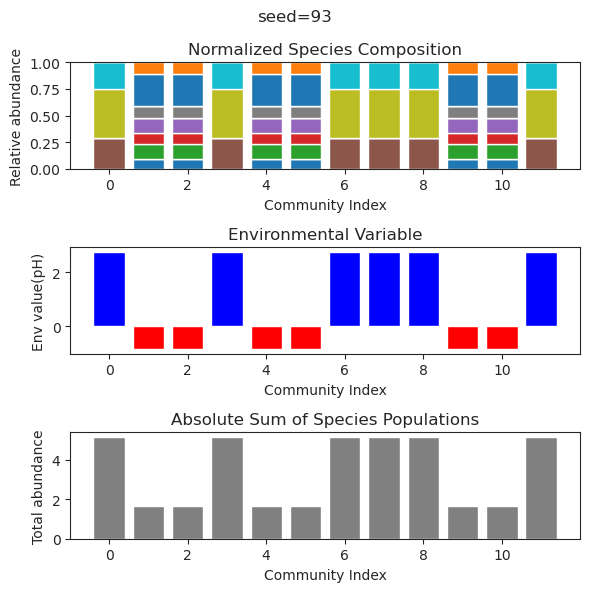

{'species': array([ 2.49671157e-031,  3.12730398e-001,  5.11702573e-001,
       -2.80068787e-032,  1.73624455e-074,  8.61918754e-041,
        7.21205170e-002,  1.75657475e-006,  3.94321790e-038,
        6.11871345e-024,  7.50548044e-001,  5.20661816e-120]), 'env': array([-2.42379038])}
{'species': array([-3.59031806e-42,  3.12731490e-01,  5.11697190e-01,  1.01402021e-50,
        3.67403434e-32, -8.45343568e-31,  7.21260907e-02,  3.45415871e-12,
        1.74387187e-29, -3.53636362e-16,  7.50550920e-01,  5.83148324e-48]), 'env': array([-2.42379619])}
{'species': array([ 1.41319223e-49,  2.92286457e-01,  5.75170367e-01,  1.37291706e-49,
        4.43563808e-40, -1.96830947e-62, -2.74288292e-14,  6.30336631e-02,
       -1.34850020e-40, -6.86986344e-23,  7.09902688e-01, -4.04083915e-63]), 'env': array([-2.28720231])}
{'species': array([-3.01095210e-32, -1.42117913e-21,  6.49814328e-01,  3.27502187e-01,
       -3.82826581e-38, -4.71338070e-17,  2.27876437e-65,  3.79145853e-01,
        4.28542

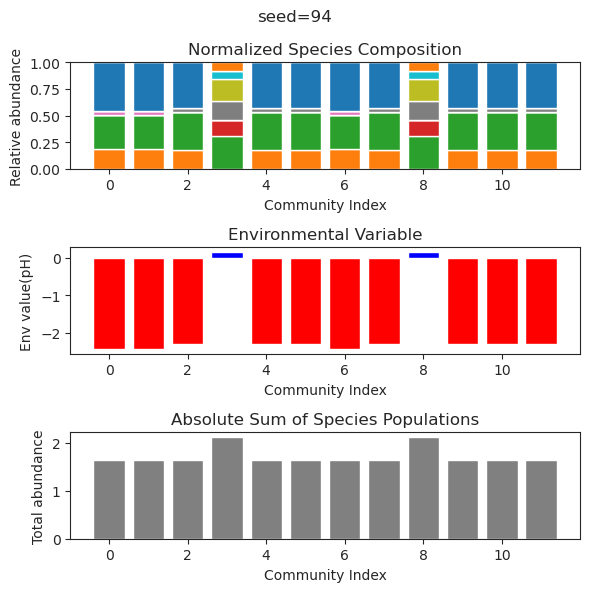

{'species': array([ 5.22326210e-34,  3.65173942e-01,  8.08292263e-32,  5.06558677e-40,
        2.85981726e-38,  1.16955550e-39,  2.74785063e-43,  9.15092389e-20,
       -4.27771840e-28,  1.09200265e-25,  4.99276595e-28,  1.00497743e+00]), 'env': array([-2.92173375])}
{'species': array([-7.71374064e-42,  3.65173942e-01,  1.63557447e-36,  4.46183049e-46,
        1.96067016e-46,  2.54155291e-46,  1.77248922e-49, -7.86329550e-21,
       -9.76518359e-31, -1.36255740e-28, -3.96387855e-32,  1.00497743e+00]), 'env': array([-2.92173375])}
{'species': array([ 7.05404272e-40,  3.65173942e-01, -2.79279597e-36,  1.49501306e-41,
        1.47877316e-42, -1.94593809e-44, -7.95876596e-45, -3.96646596e-22,
       -1.52569766e-31, -1.05127996e-28, -7.06312294e-30,  1.00497743e+00]), 'env': array([-2.92173375])}
{'species': array([ 9.68417803e-41,  3.65173942e-01,  5.77557599e-34,  5.10101045e-41,
        1.47692652e-40, -6.41229479e-42, -5.63066883e-43,  3.46500781e-21,
        1.86140017e-30,  1.1132482

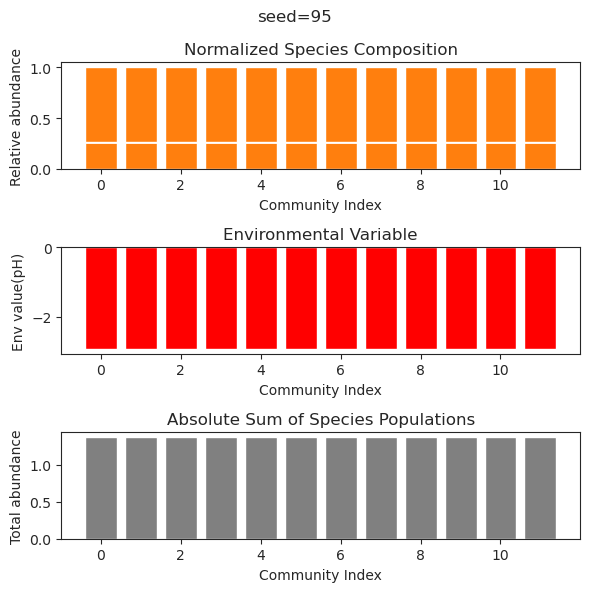

{'species': array([ 3.06206029e-01,  4.48969995e-18,  1.62680380e-38, -1.02539615e-46,
       -9.24094523e-53, -2.90948421e-51,  6.08377125e-29, -1.27438530e-40,
        2.19202924e-55,  7.90575606e-39,  5.81659185e-25,  5.65680693e-01]), 'env': array([-2.6464187])}
{'species': array([ 3.06206029e-01, -1.97489887e-20, -9.63813634e-56,  3.70452296e-77,
       -2.87723008e-84,  1.74754730e-80,  1.27352615e-40,  2.67424801e-58,
       -3.68086367e-92,  1.31438524e-53, -2.39689214e-29,  5.65680693e-01]), 'env': array([-2.6464187])}
{'species': array([ 3.06206029e-01,  1.13507811e-18,  7.54180536e-39,  4.23415796e-52,
       -1.89895931e-59,  7.32306707e-58, -1.05138575e-29,  9.82999184e-45,
        1.14686909e-59,  3.97230744e-40, -2.48331801e-28,  5.65680693e-01]), 'env': array([-2.6464187])}
{'species': array([ 3.06206029e-01, -2.23779237e-19,  5.75946988e-56,  4.10838674e-74,
        4.14952933e-75,  5.38387367e-72, -6.78950957e-38, -3.77517588e-57,
       -5.44970669e-83,  7.86456132e-

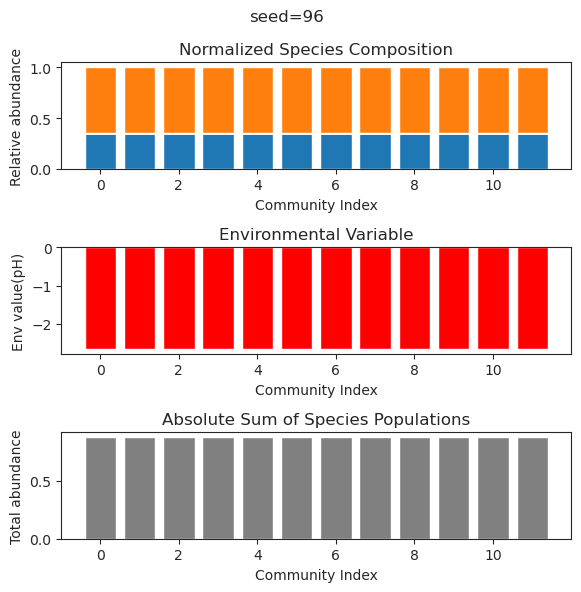

{'species': array([ 2.83758091e-43,  2.95137958e-01,  3.76034645e-59,  6.96242257e-01,
        2.27640624e-01,  2.21587543e-14,  6.53060285e-25, -3.48480743e-50,
        1.29288666e-54,  1.83673079e-59, -3.68898956e-20, -2.01676622e-50]), 'env': array([-2.66309159])}
{'species': array([-5.01984578e-47,  2.95137958e-01, -4.77873976e-73,  6.96242257e-01,
        2.27640624e-01, -8.33359172e-14,  2.24449599e-23, -3.51133821e-53,
        3.98543538e-58, -5.70405134e-74, -6.43100594e-19,  6.62178589e-59]), 'env': array([-2.66309159])}
{'species': array([-7.35049345e-47,  2.95137958e-01,  5.06283921e-58,  6.96242257e-01,
        2.27640624e-01,  2.99756971e-14,  2.51179444e-22,  4.09591841e-46,
        1.67940037e-51, -7.86444916e-61,  1.99711116e-19,  4.03848846e-48]), 'env': array([-2.66309159])}
{'species': array([ 1.90473032e-48,  2.95137958e-01,  1.21647371e-75,  6.96242257e-01,
        2.27640624e-01,  2.66267816e-14, -2.38994991e-24,  4.09064556e-56,
       -9.38585902e-64,  1.0805564

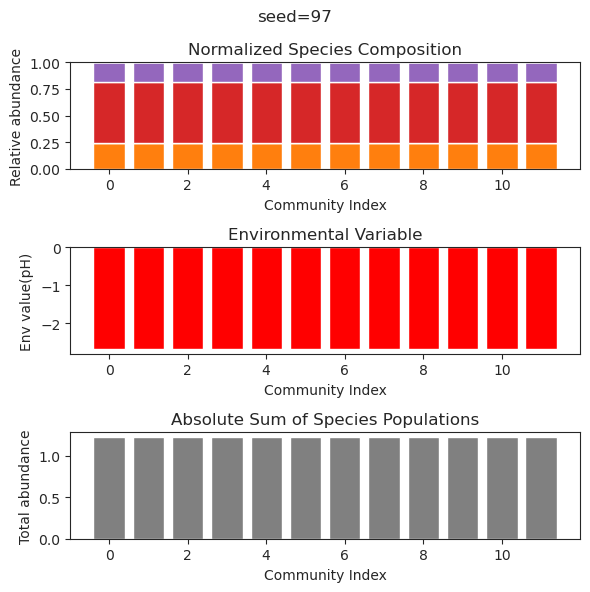

{'species': array([ 1.74438963e-001, -9.88131292e-324,  9.88131292e-324,
        1.58161700e-001,  5.40978511e-001,  5.15933485e-001,
        9.88131292e-324,  8.57578567e-222,  3.43193670e-001,
        3.38285268e-168,  7.60861095e-322,  1.49416971e-001]), 'env': array([0.04680571])}
{'species': array([ 1.49653958e-002, -9.88131292e-324, -1.48219694e-323,
        8.60828325e-001,  1.52885608e-002,  5.45866693e-002,
        2.02566915e-322,  1.07353533e-220,  5.13300321e-001,
        4.48654152e-168,  1.20057952e-321,  4.12905898e-001]), 'env': array([-0.06143089])}
{'species': array([ 1.41980341e-002,  7.90505033e-323, -1.67982320e-322,
        8.33609811e-001,  1.91308776e-002,  7.83080930e-002,
        2.86558075e-322,  1.06811835e-222,  5.36002551e-001,
        1.21487264e-167,  2.47032823e-323,  3.94526214e-001]), 'env': array([0.05454416])}
{'species': array([ 3.02027012e-001, -9.88131292e-324,  4.94065646e-324,
        1.93600951e-001,  3.64148737e-001,  2.68634553e-001,
       

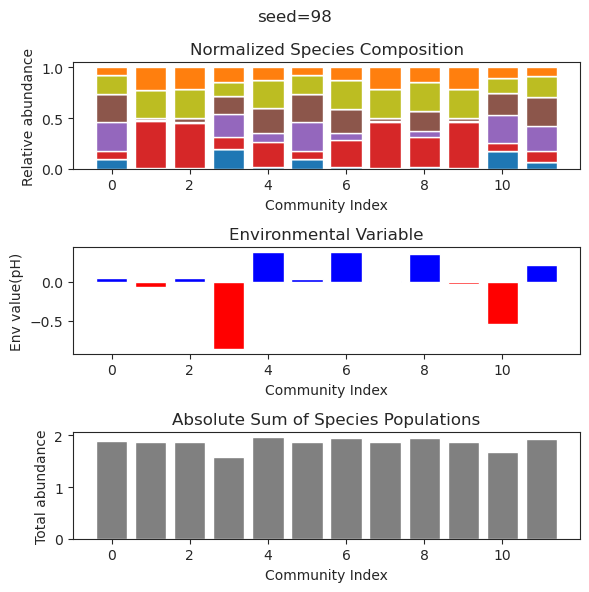

{'species': array([ 1.19675197e-001, -9.88131292e-324,  9.88131292e-324,
        2.10818191e-001,  4.85495835e-001,  5.58120752e-001,
       -6.91691904e-323,  2.37752812e-217,  4.05547644e-001,
        2.29479305e-168, -1.53654416e-321,  1.58297556e-001]), 'env': array([0.21728699])}
{'species': array([ 1.19675197e-001, -9.88131292e-324,  9.88131292e-324,
        2.10818191e-001,  4.85495835e-001,  5.58120752e-001,
       -6.91691904e-323,  2.37752812e-217,  4.05547644e-001,
        2.29479305e-168, -1.53654416e-321,  1.58297556e-001]), 'env': array([0.21728699])}
{'species': array([-1.25433292e-89, -8.32443699e-33,  1.07772932e+00, -5.46639327e-22,
       -8.37608218e-31,  9.56910470e-01, -1.39574892e-92,  7.44185743e-01,
       -2.50085257e-81,  1.43735074e-61, -5.77503677e-63,  1.58403814e+00]), 'env': array([1.85416692])}
{'species': array([-3.36523103e-035, -1.24540557e-039,  1.07772932e+000,
        5.77280484e-026,  1.54104710e-026,  9.56910470e-001,
       -1.53784134e-101,  7

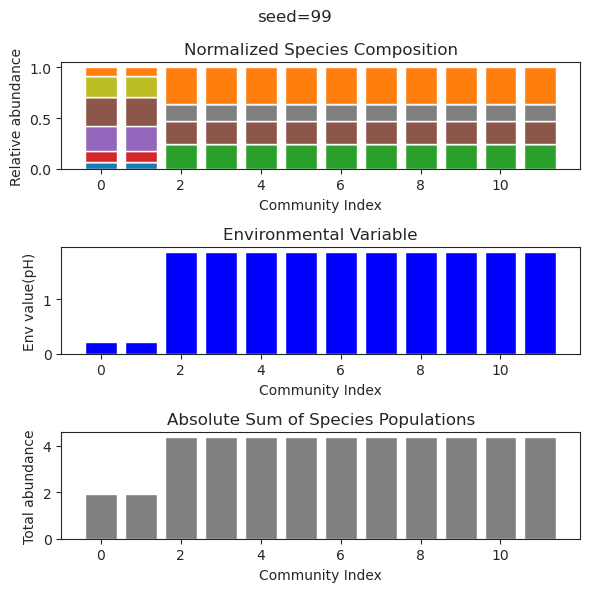

In [ ]:
    session_path='Results_ptailed/Session_Test4'
    to_save={}
    description=''
    simulated_result={}
    
    for seed_num in range(100):
        if not os.path.isdir(session_path):
            os.mkdir(session_path)
        # functions for uniform 

        f_I = lambda : uniform_distribution(0.5,0.5)
        f_g = lambda : np.ones(1)
        f_k = lambda : np.ones(1)
        f_p = lambda : custom_distribution(-2,1)
        f_q = lambda : uniform_distribution(0.5,0.5)
        f_beta = lambda : np.ones(1)
        seed_num=seed_num
        to_plot=True

        np.random.seed(seed_num)

        N=12
        N_env=1


        I = np.zeros((N, N))
        for i in range(N):
            for j in range(N):
                I[i,j] = f_I()
        for i in range(N):
            I[i,i] =1

        g = np.zeros((N))
        for i in range(N):
            g[i] = f_g()

        k = np.zeros((N))
        for i in range(N):
            k[i] = f_k()   

        p = np.zeros((N_env, N))
        for i in range(N_env):
            for j in range(N):
                p[i,j] = f_p()

        p[0,0]=-10
        p[0,1]=-10
        #p[0,2]=-10

        q = np.zeros((N, N_env))
        for i in range(N):
            for j in range(N_env):
                q[i,j] = f_q()

        q[0,0]=0.2
        q[1,0]=0.2
        #q[2,0]=0.2



        beta = np.zeros(N_env)
        for i in range(N_env):
            beta[i]=f_beta()

        delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
        migration_rate=0#1e-7
        system_config = {
            'I': I,
            'g': g,
            'k': k,
            'p': p,
            'q': q,
            'beta': beta,
            'delta': delta,
            'migration_rate' : migration_rate,
            'N': N,
            'N_env': N_env,
            'seed_num':seed_num,
        } 

        file_path = f'{session_path}/system_config.json'

        label="test"
        sys
        ##

        y_out_list=[]
        system_config['beta'] = np.array([0.99])*delta

        for i in range(N):

            species_index=np.arange(0,N)
            env_index=np.array([0])
            y0_species=one_hot_vector(N,i)
            y0_env=[0]
            t=np.linspace(0, 2000, 10000)

            y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False)

            y_out_list.append(y_out)

        num_datasets = len(y_out_list)

        # Prepare subplots
        fig, axs = plt.subplots(3, 1, figsize=(6, 6))

        # Data for plots
        species_matrix = np.array([y_out['species'] for y_out in y_out_list])
        env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

        # Normalize species data
        species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
        species_sums = np.sum(species_matrix, axis=1, keepdims=True)
        normalized_species = species_matrix / species_sums

        # Absolute sums of species data (sum across all species for each dataset)
        absolute_sums = np.sum(species_matrix, axis=1)
        simulated_result[seed_num]={'species':species_matrix, 'env' : env_data}

        if to_plot:
            plt.suptitle(f'seed={seed_num}')

            # Plotting species composition as stacked bars
            bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
            for i in range(normalized_species.shape[1]):  # Loop through each species
                axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
                bottom_values += normalized_species[:, i]  # Update bottom values for stacking

            axs[0].set_title('Normalized Species Composition')
            axs[0].set_xlabel('Community Index')
            axs[0].set_ylabel('Relative abundance')
            #axs[0].legend()

            # Plotting environmental factors
            colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
            axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
            axs[1].set_title('Environmental Variable')
            axs[1].set_xlabel('Community Index')
            axs[1].set_ylabel('Env value(pH)')

            # Plotting absolute sums of species data
            axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
            axs[2].set_title('Absolute Sum of Species Populations')
            axs[2].set_xlabel('Community Index')
            axs[2].set_ylabel('Total abundance')

            plt.tight_layout()
            plt.savefig(session_path+f'/diagram_{seed_num}.png')

            #if to_plot:
            #    plt.savefig()


            plt.show()
    #simulated_result = {'a': 1, 'b': 2, 'c': 3}  # Your existing dictionary
    #description = "This is a description of the simulated result."

    # Combine both into a new dictionary
    data_to_save = {
        'result': simulated_result,
        'description': description
    }
    # Serialize the combined data to a pickle file
    with open(session_path+'/result_and_description.pkl', 'wb') as file:
        pickle.dump(data_to_save, file)

{'species': array([-2.12160092e-48,  2.66642290e-01, -1.72609676e-51,  9.21782534e-01,
        1.60004583e-68, -1.53384869e-39, -2.98686343e-46,  9.13944303e-68,
       -3.59189579e-74, -5.16350317e-34,  6.15692094e-01, -1.47435706e-34]), 'env': array([-1.84457124])}
{'species': array([-1.44169713e-50,  2.66642290e-01, -2.00901225e-52,  9.21782534e-01,
       -1.93918154e-73,  4.06512381e-40,  2.86331476e-47,  1.52953130e-71,
       -1.90767302e-71, -2.46680411e-33,  6.15692094e-01,  3.41245747e-34]), 'env': array([-1.84457124])}
{'species': array([ 8.39408688e-43,  2.66642290e-01,  3.11798028e-43,  9.21782534e-01,
        2.61242454e-60, -1.78315193e-36, -4.06004788e-43,  1.80032610e-59,
       -9.14204723e-68,  1.01378836e-33,  6.15692094e-01, -1.12791108e-32]), 'env': array([-1.84457124])}
{'species': array([-4.32808797e-64, -5.23325359e-58,  1.41137532e-44, -1.72102811e-60,
        1.78094896e+00, -4.59533557e-28,  1.75642470e+00,  1.17856054e+00,
        2.45730742e-47,  1.3603415

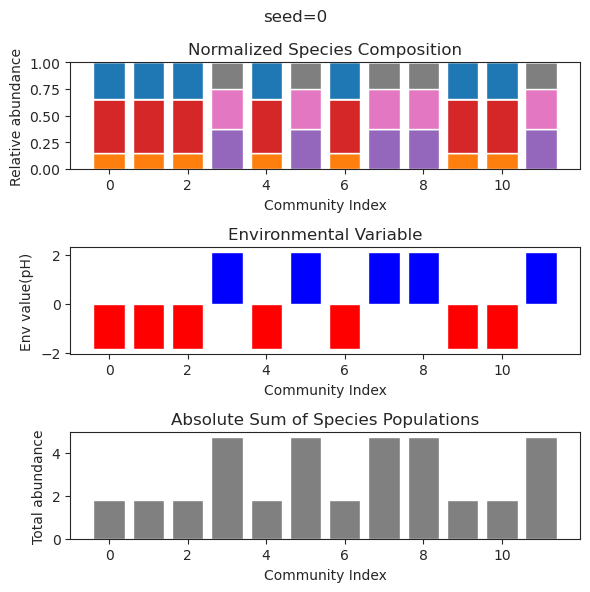

{'species': array([-1.48190309e-77,  8.64079092e-71,  4.13030645e-57, -3.60935060e-75,
        1.78094896e+00,  1.29477064e-32,  1.75642470e+00,  1.17856054e+00,
       -1.60527216e-54, -1.01224153e-46, -5.36198844e-46, -7.21363587e-77]), 'env': array([2.10065594])}
{'species': array([-1.48190309e-77,  8.64079092e-71,  4.13030645e-57, -3.60935060e-75,
        1.78094896e+00,  1.29477064e-32,  1.75642470e+00,  1.17856054e+00,
       -1.60527216e-54, -1.01224153e-46, -5.36198844e-46, -7.21363587e-77]), 'env': array([2.10065594])}


{'species': array([-1.48190309e-77,  8.64079092e-71,  4.13030645e-57, -3.60935060e-75,
        1.78094896e+00,  1.29477064e-32,  1.75642470e+00,  1.17856054e+00,
       -1.60527216e-54, -1.01224153e-46, -5.36198844e-46, -7.21363587e-77]), 'env': array([2.10065594])}
{'species': array([-1.48190309e-77,  8.64079092e-71,  4.13030645e-57, -3.60935060e-75,
        1.78094896e+00,  1.29477064e-32,  1.75642470e+00,  1.17856054e+00,
       -1.60527216e-54, -1.01224153e-46, -5.36198844e-46, -7.21363587e-77]), 'env': array([2.10065594])}
{'species': array([-1.48190309e-77,  8.64079092e-71,  4.13030645e-57, -3.60935060e-75,
        1.78094896e+00,  1.29477064e-32,  1.75642470e+00,  1.17856054e+00,
       -1.60527216e-54, -1.01224153e-46, -5.36198844e-46, -7.21363587e-77]), 'env': array([2.10065594])}
{'species': array([ 1.24136714e-001,  4.09815374e-101,  1.12130915e-032,
        2.43684682e-184,  5.35371603e-041,  6.23551266e-198,
       -6.71247840e-250, -7.51463269e-139,  6.13119612e-001,
    

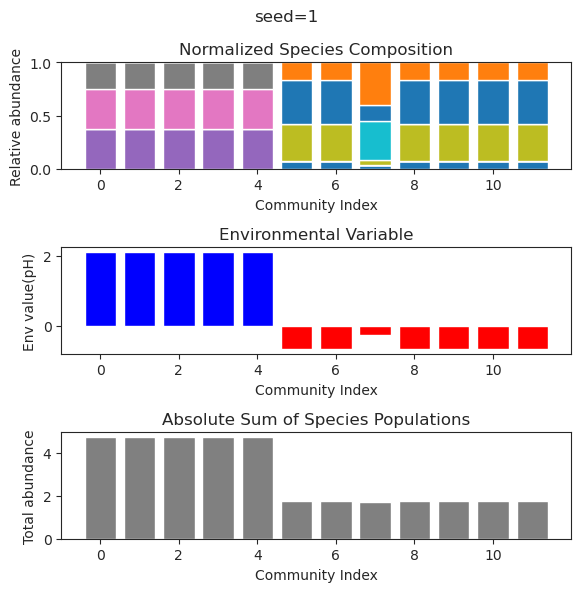

{'species': array([ 3.00268323e-17,  2.50383092e-01, -1.10232108e-68,  1.98458696e-01,
       -2.07998923e-24,  1.04162376e-40, -5.16162314e-67,  1.23790998e-01,
        4.38717362e-62, -5.08674291e-24,  8.01769218e-46,  6.64773062e-01]), 'env': array([-2.59864887])}
{'species': array([-5.25243770e-17,  2.50383092e-01, -9.66191013e-74,  1.98458696e-01,
       -1.06050653e-30,  9.80016799e-46,  2.26364456e-70,  1.23790998e-01,
        3.25834967e-63,  1.15962264e-27, -4.51452086e-51,  6.64773062e-01]), 'env': array([-2.59864887])}
{'species': array([-6.48751915e-18,  2.50383092e-01, -3.43712952e-81,  1.98458696e-01,
       -1.95135126e-34, -8.47514279e-44,  6.62229005e-82,  1.23790998e-01,
        8.93423277e-72, -1.71454037e-31,  5.59894079e-53,  6.64773062e-01]), 'env': array([-2.59864887])}
{'species': array([-1.66647013e-17,  2.50383092e-01,  1.38124898e-97,  1.98458696e-01,
        1.63732754e-33, -1.05876371e-40,  1.38520584e-99,  1.23790998e-01,
       -2.33706453e-88, -3.5161059

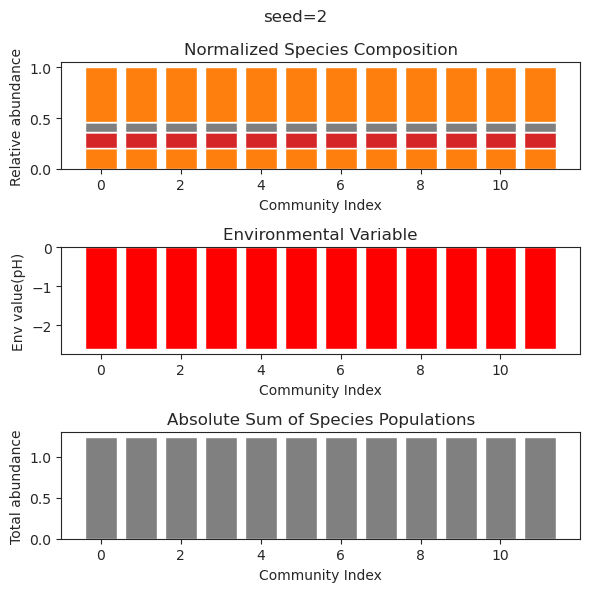

{'species': array([ 1.62398404e-001, -7.83953625e-032,  7.38362574e-001,
        3.76948519e-001,  1.97619174e-063, -3.97275891e-107,
       -3.72525660e-101, -7.49839581e-098,  1.10418324e-013,
        3.87502198e-057, -3.05695115e-065,  7.31471632e-001]), 'env': array([-0.48046086])}
{'species': array([ 1.62398404e-01,  4.58386445e-27,  7.38362574e-01,  3.76948519e-01,
        1.66033066e-43,  1.22890915e-89,  3.13872572e-81, -1.82663009e-79,
        1.14711448e-12,  1.07639656e-45,  2.61945547e-58,  7.31471632e-01]), 'env': array([-0.48046086])}
{'species': array([ 1.62398404e-01,  1.29468759e-26,  7.38362574e-01,  3.76948519e-01,
        9.21423758e-51, -2.21423157e-71, -1.98055464e-70, -2.66922018e-72,
        8.24454174e-13, -2.13119731e-47, -1.00357420e-47,  7.31471632e-01]), 'env': array([-0.48046086])}
{'species': array([ 1.62398404e-01,  1.58521622e-28,  7.38362574e-01,  3.76948519e-01,
       -1.43024434e-54,  1.16701225e-38,  2.08796099e-75,  1.95394221e-76,
        8.24550

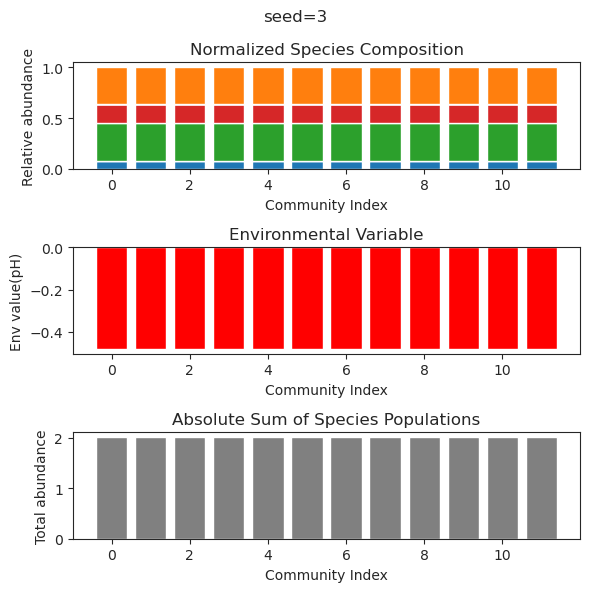

{'species': array([-5.26635266e-28,  3.21738869e-01,  2.23841399e-01,  1.83830082e-46,
        1.95110081e-31,  1.06791488e-58,  1.76509850e-01,  1.40212443e-18,
        9.67900642e-34,  1.11641672e-30, -4.29010261e-25,  2.93522477e-58]), 'env': array([-3.16895885])}
{'species': array([ 7.97712214e-29,  3.21738869e-01,  2.23841399e-01,  1.97175132e-54,
        2.15207340e-33,  8.12624263e-69,  1.76509850e-01, -2.13694547e-20,
       -7.02573677e-42,  6.14210551e-37,  5.76114897e-31,  2.05427573e-69]), 'env': array([-3.16895885])}
{'species': array([-9.21377056e-26,  3.21738869e-01,  2.23841399e-01, -3.02348170e-34,
        3.88795942e-28,  1.53015607e-37,  1.76509850e-01, -4.11437985e-17,
       -6.49549011e-32, -2.09634418e-31,  1.80839520e-31,  5.94590213e-40]), 'env': array([-3.16895885])}
{'species': array([ 4.20264532e-25,  3.21738869e-01,  2.23841399e-01, -4.17890529e-35,
        1.98457092e-24, -9.25261374e-42,  1.76509850e-01,  7.84094809e-19,
        1.42239195e-29, -5.6787157

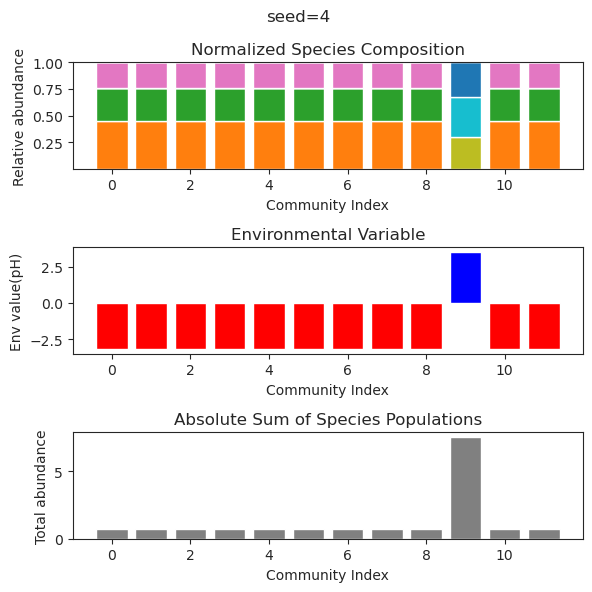

{'species': array([ 9.78759304e-30,  2.74153434e-01, -4.70017836e-18,  9.95002942e-34,
        6.54637053e-40,  2.74177741e-22,  2.57688887e-52, -5.76649934e-42,
       -6.40378788e-30, -6.10653072e-32, -5.05166881e-43,  7.87133417e-01]), 'env': array([-2.63119407])}
{'species': array([-9.12674913e-38,  2.74153434e-01,  6.14290098e-20, -1.04174635e-32,
       -4.56535312e-51, -1.18149765e-25,  2.33625746e-61,  4.97935751e-57,
       -2.90623993e-28, -4.35710600e-29, -1.89543057e-56,  7.87133417e-01]), 'env': array([-2.63119407])}
{'species': array([-3.36762551e-34,  2.74153434e-01,  9.41040566e-21, -2.88911116e-33,
       -9.85657271e-46, -9.34384970e-25,  2.79664599e-57,  4.92368760e-47,
       -1.40698341e-31, -8.94583119e-30,  1.38966192e-48,  7.87133417e-01]), 'env': array([-2.63119407])}
{'species': array([ 3.35704717e-35,  2.74153434e-01,  1.09770126e-19, -1.26919341e-28,
        2.45953620e-43, -3.78194095e-24, -2.48871370e-58,  1.74065380e-48,
        2.17095174e-26,  3.2821007

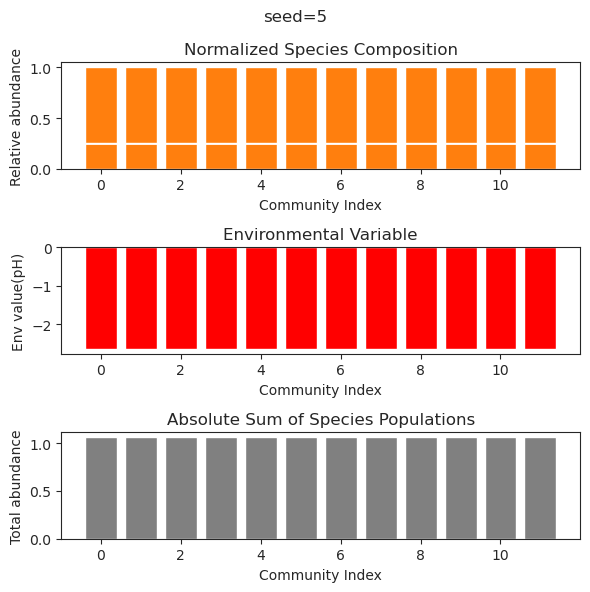

{'species': array([ 5.51199751e-002, -1.05554162e-113,  3.95854445e-102,
       -5.78526364e-087, -2.37784894e-057,  2.79648943e-017,
        5.29297795e-037,  6.09846999e-001,  8.46206294e-020,
        6.72401557e-001,  5.64222687e-001,  6.80444943e-117]), 'env': array([-0.11839601])}
{'species': array([ 5.51199751e-002, -3.82896076e-110, -6.15555229e-099,
        1.75914688e-084, -4.17453070e-056,  5.98732963e-018,
       -2.57005622e-033,  6.09846999e-001, -1.42367543e-019,
        6.72401557e-001,  5.64222687e-001, -4.10771659e-114]), 'env': array([-0.11839601])}
{'species': array([ 5.51199751e-02, -8.80125501e-98,  1.86484294e-93,  1.01034328e-76,
        5.51787835e-51, -4.71239481e-17, -3.51148800e-29,  6.09846999e-01,
       -2.55250331e-17,  6.72401557e-01,  5.64222687e-01, -5.30692021e-95]), 'env': array([-0.11839601])}
{'species': array([ 5.51199751e-002, -9.30028866e-117,  6.19259588e-104,
       -2.39000640e-085,  2.85746865e-058,  1.27995434e-016,
       -2.81863768e-036,

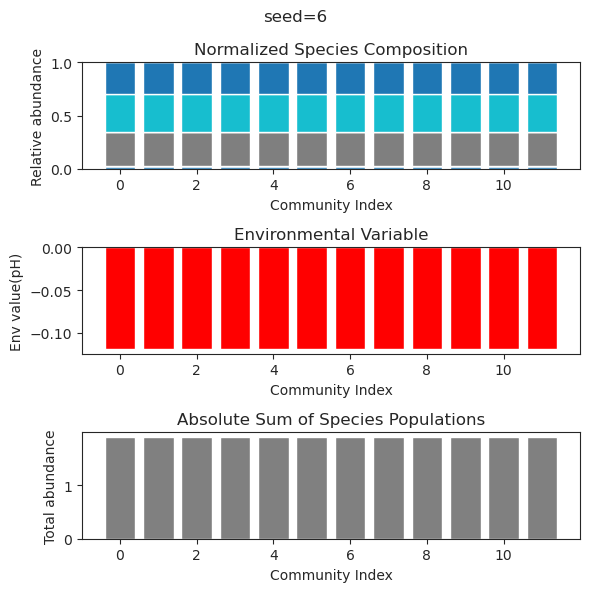

{'species': array([ 4.37828511e-74,  1.54003841e-01,  3.60867169e-31,  3.41994033e-01,
        1.03429178e+00,  6.04805061e-69, -1.03277534e-82, -6.35970305e-79,
       -4.41208106e-74, -4.18095521e-74, -7.24471927e-70,  1.12768475e-36]), 'env': array([-1.57108942])}
{'species': array([-1.78378023e-72,  1.54003841e-01, -1.13954866e-26,  3.41994033e-01,
        1.03429178e+00,  3.40548732e-66,  8.83803435e-80,  7.51032138e-74,
        2.81879071e-69, -2.41252031e-73,  5.86993239e-66, -2.56106137e-31]), 'env': array([-1.57108942])}
{'species': array([1.26432293e-68, 1.54003841e-01, 4.32055203e-31, 3.41994033e-01,
       1.03429178e+00, 3.61714678e-61, 1.56929736e-74, 9.63340749e-72,
       6.06058959e-66, 2.88502663e-65, 5.70807859e-60, 1.74973564e-32]), 'env': array([-1.57108942])}
{'species': array([ 8.93365651e-89,  6.21779525e-87, -6.35525313e-46,  3.73737486e-89,
       -6.97356517e-87,  8.22297720e-01,  6.87166715e-18,  1.60834295e-87,
       -1.27452176e-68,  6.57534156e-01,  4.90

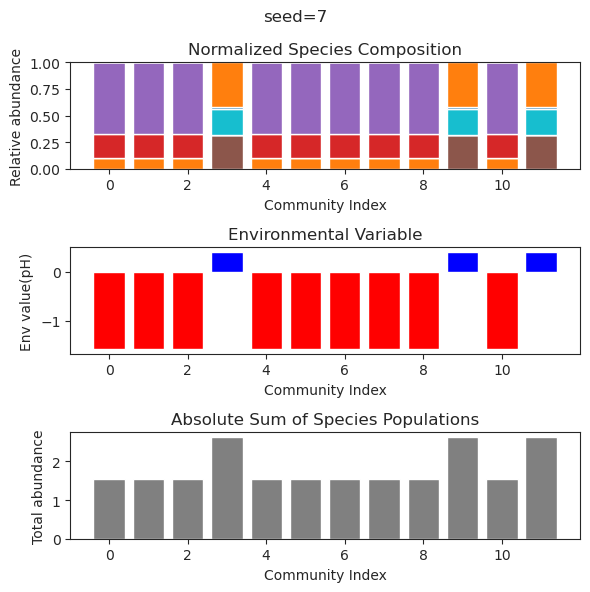

{'species': array([ 1.15060307e-01, -5.82506019e-21,  4.15116685e-75,  1.09908791e-35,
       -9.60187365e-57,  2.05714309e-02, -2.29612290e-49,  5.83743020e-02,
        6.11414391e-01,  6.52070182e-01, -3.59590256e-49, -3.49409100e-26]), 'env': array([-1.14851191])}
{'species': array([1.15060307e-01, 2.14981448e-17, 3.24805889e-75, 4.67044123e-32,
       8.19120197e-58, 2.05714309e-02, 1.23750468e-78, 5.83743020e-02,
       6.11414391e-01, 6.52070182e-01, 7.87286932e-48, 2.54548039e-19]), 'env': array([-1.14851191])}
{'species': array([ 3.19183644e-31,  3.16592110e-32,  1.66937817e+00, -1.47687066e-76,
        6.18610940e-06, -1.98078310e-50,  2.31193494e-23,  2.06941808e-74,
       -1.09381103e-46,  6.64423430e-01,  5.87839705e-34,  6.79481607e-01]), 'env': array([1.51977392])}
{'species': array([ 1.15060307e-001, -9.26624921e-017, -2.11566308e-082,
        1.23904343e-029,  3.70316465e-071,  2.05714309e-002,
        2.44088733e-102,  5.83743020e-002,  6.11414391e-001,
        6.5207

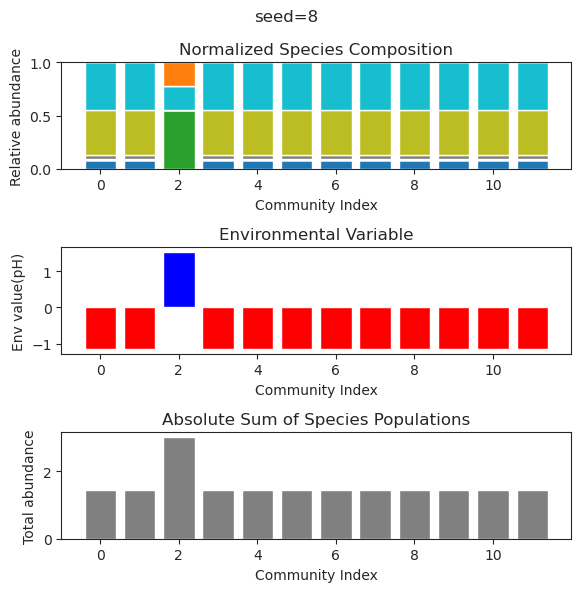

{'species': array([ 2.63462916e-01, -4.14287083e-49, -1.34012912e-31, -1.36519260e-54,
       -2.30473218e-45,  1.36627861e-58, -4.06196545e-44,  1.25790610e+00,
        2.42160327e-01, -7.15252312e-59,  6.08738101e-37, -1.72320405e-44]), 'env': array([-2.02046599])}
{'species': array([ 2.63462916e-01, -1.03000524e-40, -6.10935590e-29, -2.13238390e-46,
        2.61891640e-37, -3.25615651e-51,  1.66574609e-37,  1.25790610e+00,
        2.42160327e-01,  2.57496985e-51, -2.61868423e-34,  4.16028581e-40]), 'env': array([-2.02046599])}
{'species': array([ 2.63462916e-01,  4.78183514e-47,  2.02649357e-31,  2.23491218e-49,
       -7.88305431e-44, -1.66493773e-55, -3.11327041e-43,  1.25790610e+00,
        2.42160327e-01, -1.13844085e-55,  2.48214211e-36, -4.03540070e-44]), 'env': array([-2.02046599])}
{'species': array([ 2.63462916e-01, -1.43493247e-49, -2.30555111e-30,  1.23448048e-51,
        5.94325921e-40, -7.56403655e-54,  1.57457171e-39,  1.25790610e+00,
        2.42160327e-01,  1.7885098

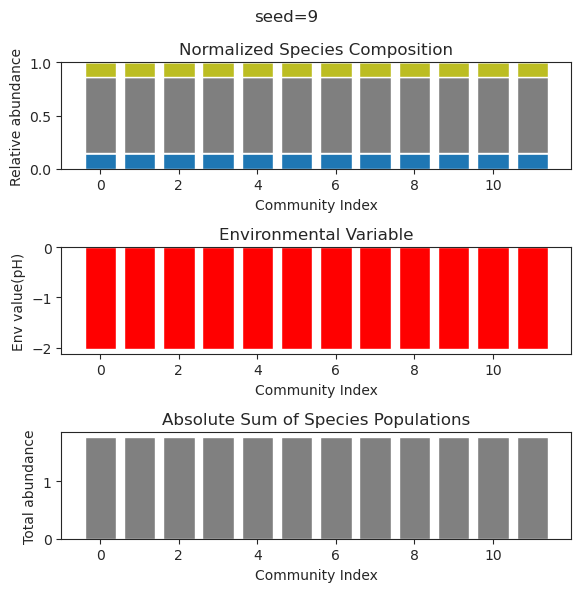

{'species': array([ 1.58133050e-01, -1.30644847e-14,  1.33801758e-35,  1.51583492e-76,
        5.83201343e-01,  1.03785805e+00,  6.48706684e-40, -4.26957620e-69,
        9.26090002e-23, -3.18719909e-44, -3.12740278e-53,  7.78883087e-02]), 'env': array([-1.21785894])}
{'species': array([ 1.58133050e-001,  5.25322136e-017, -3.68182016e-049,
        3.55853858e-107,  5.83201343e-001,  1.03785805e+000,
        3.47739701e-056,  2.67828556e-103,  4.16384451e-029,
        3.23232194e-063,  1.35786963e-079,  7.78883087e-002]), 'env': array([-1.21785894])}
{'species': array([ 1.58133050e-001,  7.21279361e-016, -4.14581171e-048,
        2.04284465e-126,  5.83201343e-001,  1.03785805e+000,
        2.25889933e-047, -1.16759679e-096,  5.71835186e-028,
       -5.40703960e-070, -1.03343155e-074,  7.78883087e-002]), 'env': array([-1.21785894])}
{'species': array([ 1.58133050e-01,  2.19812952e-15,  7.01055267e-42,  3.74806084e-77,
        5.83201343e-01,  1.03785805e+00,  3.04214211e-42, -8.86477526e-

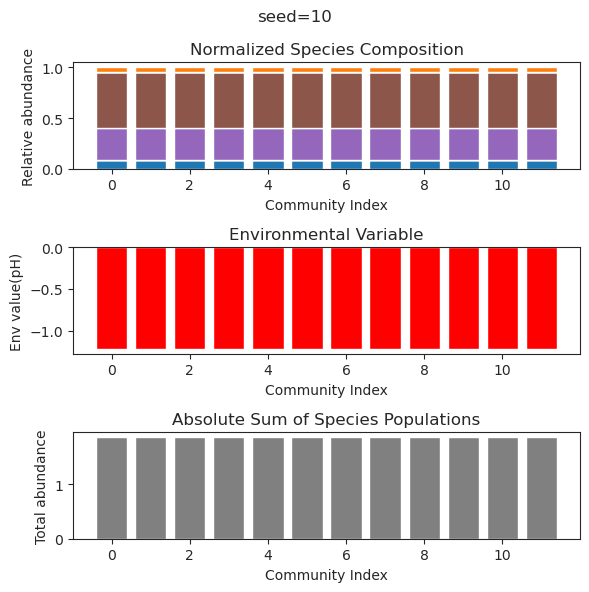

{'species': array([-2.14528618e-56,  1.81379999e-01,  4.11398320e-01, -1.67728087e-39,
        8.36810385e-01,  1.97475855e-32, -3.27665976e-48, -1.33482887e-37,
        5.65310251e-01, -1.33858050e-38, -5.06384292e-39,  2.44382125e-79]), 'env': array([-1.52251901])}
{'species': array([-6.58447945e-59,  1.81379999e-01,  4.11398320e-01, -5.50556276e-43,
        8.36810385e-01, -9.65601766e-35,  8.20460891e-47, -1.15131759e-38,
        5.65310251e-01,  8.64239838e-41, -7.24867662e-42, -1.26871367e-77]), 'env': array([-1.52251901])}
{'species': array([ 7.99070079e-57,  1.81379999e-01,  4.11398320e-01, -3.03584521e-41,
        8.36810385e-01,  1.70658724e-33, -2.36362811e-44, -7.68762574e-39,
        5.65310251e-01,  2.78993283e-36,  5.68516544e-38,  8.35063983e-74]), 'env': array([-1.52251901])}
{'species': array([ 1.25268592e-51,  1.81379999e-01,  4.11398320e-01, -7.74998508e-37,
        8.36810385e-01, -6.90475639e-30,  1.88193673e-39, -2.61582661e-37,
        5.65310251e-01,  2.4638424

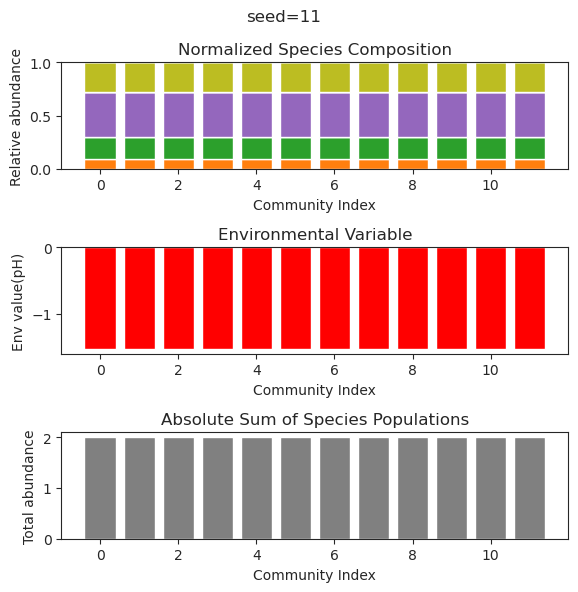

{'species': array([-1.65810444e-092,  1.69106474e-001,  1.35091067e-114,
        1.33219099e-001,  7.57034057e-002, -2.25398010e-105,
        4.88265993e-001,  1.02484510e-070, -2.08001050e-023,
        6.59815941e-112,  1.95230651e-002,  9.52402493e-001]), 'env': array([-1.15616461])}
{'species': array([-6.77311324e-042,  1.69106474e-001, -1.17015388e-134,
        1.33219099e-001,  7.57034057e-002,  3.30577377e-123,
        4.88265993e-001,  7.72033905e-079,  4.21324259e-026,
       -7.24958748e-132,  1.95230651e-002,  9.52402493e-001]), 'env': array([-1.15616461])}
{'species': array([ 2.44053858e-130,  1.69106474e-001, -1.79117262e-131,
        1.33219099e-001,  7.57034057e-002, -1.37761313e-139,
        4.88265993e-001,  1.43545883e-088,  3.85211428e-033,
       -1.95260664e-143,  1.95230651e-002,  9.52402493e-001]), 'env': array([-1.15616461])}
{'species': array([-5.60290160e-116,  1.69106474e-001,  1.20521236e-139,
        1.33219099e-001,  7.57034057e-002, -1.66481764e-128,
     

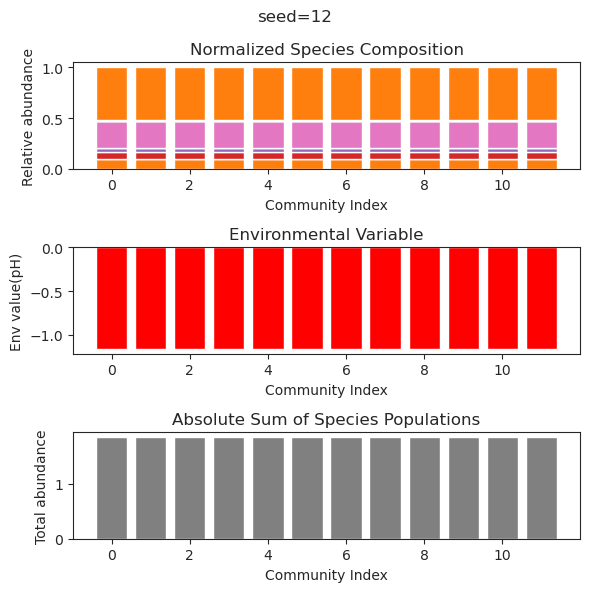

{'species': array([ 8.95730485e-02,  3.05233016e-02, -3.53561753e-41,  2.43737043e-01,
        1.67022363e-78,  4.24165608e-01,  2.15980596e-01, -1.20182848e-51,
       -5.72093457e-88, -2.88554209e-39,  9.61247404e-88,  4.92728140e-01]), 'env': array([-0.98427087])}
{'species': array([ 8.95730485e-002,  3.05233016e-002, -5.22289563e-042,
        2.43737043e-001,  1.79537776e-095,  4.24165608e-001,
        2.15980596e-001,  1.23669784e-060,  3.61444782e-103,
       -8.17786357e-042,  2.48551976e-105,  4.92728140e-001]), 'env': array([-0.98427087])}
{'species': array([ 8.95730485e-002,  3.05233016e-002,  5.35303037e-042,
        2.43737043e-001,  4.67674654e-094,  4.24165608e-001,
        2.15980596e-001,  6.66653933e-061, -6.33361561e-100,
        1.43853826e-042, -8.06466290e-104,  4.92728140e-001]), 'env': array([-0.98427087])}
{'species': array([ 8.95730485e-002,  3.05233016e-002,  1.99585492e-057,
        2.43737043e-001,  2.98043661e-130,  4.24165608e-001,
        2.15980596e-001,

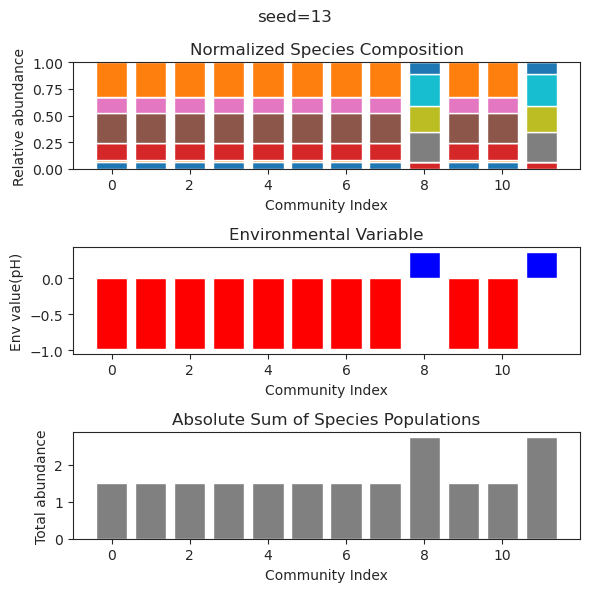

{'species': array([ 2.25554431e-01,  2.57694012e-18,  2.28521144e-58, -5.54578628e-32,
       -9.40036919e-36,  1.11730626e-44, -1.67992825e-59,  9.41282890e-58,
       -5.03059775e-33,  3.99869710e-20, -1.86771061e-55,  1.19694993e+00]), 'env': array([-1.82391959])}
{'species': array([ 2.25554431e-01, -2.06221596e-18,  3.00285134e-85, -3.93306601e-39,
       -2.84714447e-43, -4.83750501e-61, -2.40689070e-87,  9.37210946e-82,
       -8.79524914e-38,  1.73784467e-23, -9.65806493e-84,  1.19694993e+00]), 'env': array([-1.82391959])}
{'species': array([-2.24752196e-31,  6.32572560e-28,  3.71546644e-54, -2.17235736e-61,
        1.44499433e+00,  2.55132970e+00,  1.97845531e-05, -1.78221811e-57,
        4.96690417e-01,  6.29924851e-27,  1.13563960e+00, -9.53512188e-72]), 'env': array([2.61327257])}
{'species': array([ 2.25554431e-01,  7.27308046e-20, -6.44590529e-57, -1.91137516e-34,
       -2.88727242e-36,  2.12884909e-45, -5.04452883e-57, -1.15173073e-55,
       -2.27908712e-36,  1.63092800

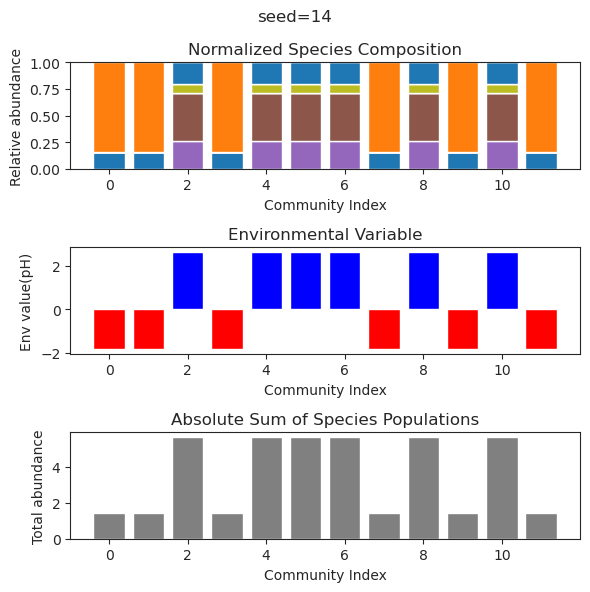

{'species': array([ 2.88208510e-01,  1.19050355e-47,  1.02868719e+00,  1.26479353e-68,
        1.68316606e-46, -3.49732478e-42, -6.71307416e-32,  4.35584237e-01,
        1.57892310e-38, -3.85970513e-73,  1.45682279e-65, -1.16552279e-23]), 'env': array([-2.61622258])}
{'species': array([ 2.88208510e-01,  2.27434301e-45,  1.02868719e+00,  1.79375828e-71,
        2.47211484e-41,  3.08413114e-38,  1.06345575e-26,  4.35584237e-01,
       -4.26255998e-38,  1.46029252e-71,  3.52970023e-59, -1.07454075e-21]), 'env': array([-2.61622258])}
{'species': array([ 2.88208510e-01, -9.34685026e-46,  1.02868719e+00, -9.29563617e-59,
        1.15249479e-43, -9.77000618e-38, -1.37317675e-32,  4.35584237e-01,
       -2.29005514e-38, -5.18173104e-65,  8.67210421e-61,  6.92055998e-23]), 'env': array([-2.61622258])}
{'species': array([ 2.88208510e-01, -1.58208062e-39,  1.02868719e+00, -3.17093304e-52,
       -1.23314583e-42, -8.60138984e-40, -3.58057264e-33,  4.35584237e-01,
        4.11911008e-32,  3.6117933

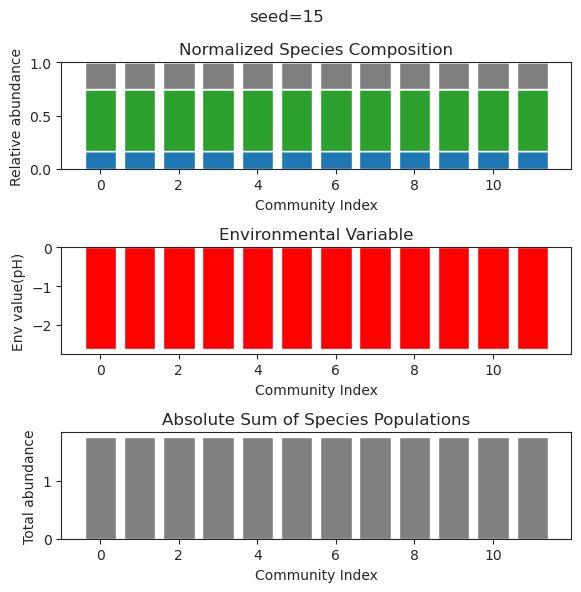

{'species': array([ 2.68390562e-01, -1.17083887e-34,  1.06822261e-27, -1.85744280e-18,
        1.59030748e-65,  8.88767192e-65, -5.12104731e-47,  1.08255029e+00,
        8.37110233e-55,  2.70706780e-63, -1.19966106e-56,  1.04647765e-52]), 'env': array([-2.77180968])}
{'species': array([ 2.68390562e-01,  6.14732009e-35,  7.34591226e-28, -3.84613992e-18,
       -2.32498548e-75, -5.85566609e-78,  3.60598363e-51,  1.08255029e+00,
       -3.59729501e-64,  7.47767109e-76,  5.48680266e-65, -1.39102735e-60]), 'env': array([-2.77180968])}
{'species': array([ 2.68390562e-01, -3.33719565e-34,  4.13016601e-25, -6.38927301e-18,
        2.49652047e-90,  3.32180946e-92, -4.42857019e-56,  1.08255029e+00,
        4.44311475e-81,  3.21772115e-86, -1.10565922e-76,  1.33304383e-72]), 'env': array([-2.77180968])}
{'species': array([ 2.68390562e-001,  4.47575849e-035, -5.08444614e-029,
        7.30422308e-017, -4.76508105e-116, -2.05780502e-119,
        1.15274465e-072,  1.08255029e+000,  8.46652697e-104,
 

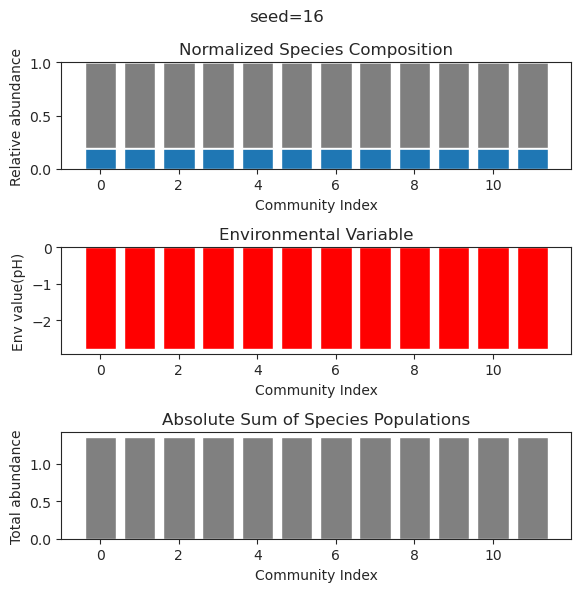

{'species': array([ 3.51382657e-01,  3.92792083e-19,  2.74229543e-52, -8.68149592e-48,
       -8.86336966e-48,  1.59056331e-35, -2.28263607e-43, -6.91405311e-67,
        5.41441773e-01,  1.66668948e-38,  3.22317748e-34,  2.26953977e-61]), 'env': array([-3.13733524])}
{'species': array([ 3.51382657e-01,  1.33937542e-20, -1.47239012e-57, -1.70051947e-44,
       -1.58021801e-44,  1.59434877e-31, -1.22397247e-47,  5.35808579e-77,
        5.41441773e-01, -9.38516935e-35, -3.89208716e-29,  3.50051482e-66]), 'env': array([-3.13733524])}
{'species': array([ 3.51382657e-01,  2.74286153e-19, -6.86931585e-56, -5.26115464e-46,
        1.53881676e-47,  8.46313619e-29, -1.31617006e-45, -9.66206510e-78,
        5.41441773e-01,  1.60474094e-35,  1.00119660e-27, -2.70002872e-63]), 'env': array([-3.13733524])}
{'species': array([ 3.51382657e-01,  4.75072035e-21, -3.95875068e-54,  9.56108984e-40,
       -4.11599565e-40,  6.51250545e-27,  4.71523120e-44,  7.26183714e-71,
        5.41441773e-01, -1.6733166

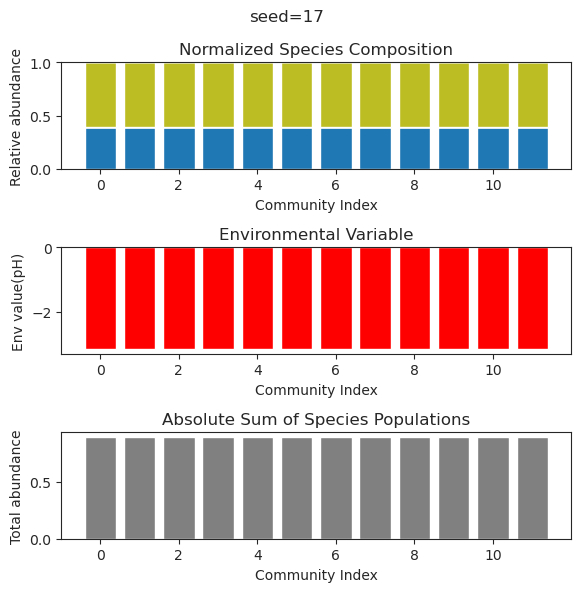

{'species': array([-1.54976302e-48,  3.47570886e-01,  8.34458421e-01,  3.82922286e-73,
       -1.56284428e-79, -1.47744146e-46,  3.34127897e-02, -8.50181538e-77,
       -1.16869488e-20,  1.08275326e-71, -7.26876639e-34, -3.35027112e-50]), 'env': array([-2.76332007])}
{'species': array([-1.90611643e-45,  3.47570886e-01,  8.34458421e-01,  1.00212391e-72,
        2.04285943e-73, -1.24039285e-43,  3.34127897e-02,  3.30556605e-73,
        1.96770379e-18, -2.94813820e-72,  5.60162691e-33, -7.17514131e-52]), 'env': array([-2.76332007])}
{'species': array([-6.58085197e-48,  3.47570886e-01,  8.34458421e-01,  6.25571780e-56,
       -3.44771507e-61, -1.04852577e-50,  3.34127897e-02, -4.79344740e-62,
        3.13972115e-23, -2.04192657e-36,  3.05662024e-33,  1.80451933e-44]), 'env': array([-2.76332007])}
{'species': array([ 1.75044713e-074,  3.47570886e-001,  8.34458421e-001,
       -1.03053852e-116, -3.42555697e-126,  4.15227034e-071,
        3.34127897e-002, -1.00549093e-125,  5.76334232e-024,
 

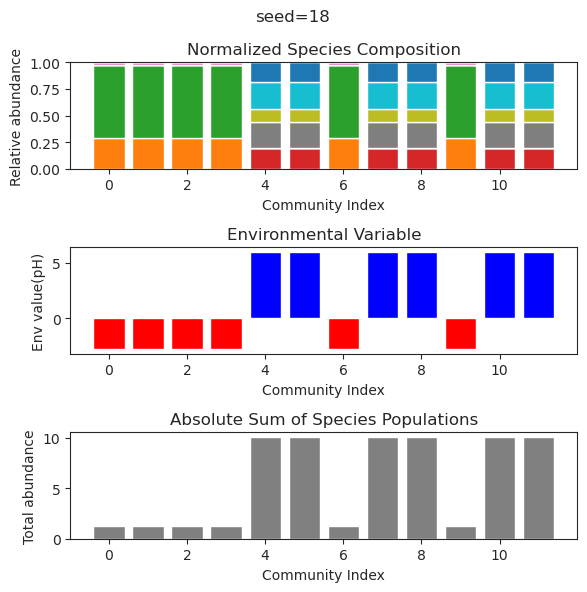

{'species': array([ 1.51054436e-01,  4.48687254e-17,  8.49807079e-01, -1.01448726e-37,
        1.19454558e-29,  1.55326834e-25, -2.69022236e-56, -8.24710570e-46,
       -9.67723098e-24,  3.93107312e-71,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([ 1.51054436e-01,  7.99439634e-18,  8.49807079e-01, -4.58342603e-41,
       -4.76009472e-33, -3.09402488e-29, -1.81624335e-64, -4.72966315e-47,
       -6.98248024e-29, -4.13808991e-78,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([ 1.51054436e-01,  2.22046588e-18,  8.49807079e-01, -1.07708226e-49,
       -1.87449966e-30, -2.12677578e-32, -2.45724293e-79, -2.01610654e-51,
        4.62186799e-28, -5.35239008e-88,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([ 1.51054436e-01,  3.04561142e-17,  8.49807079e-01,  3.16694246e-36,
        1.88336809e-28,  3.37609180e-28, -1.05989434e-53,  5.08547289e-39,
       -4.36429786e-29, -3.7169060

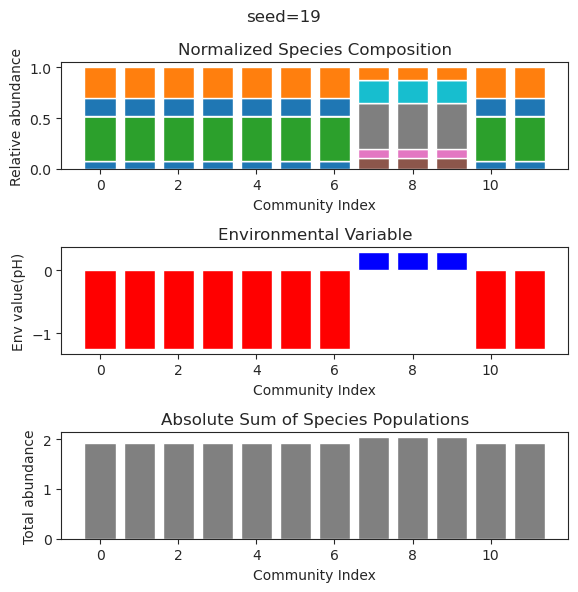

{'species': array([ 1.51054436e-01, -5.30264181e-17,  8.49807079e-01, -5.69202478e-54,
       -1.96782679e-30,  2.03342620e-37, -2.00000239e-76, -2.79876424e-53,
        8.47826085e-29, -2.01016939e-98,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([ 1.51054436e-01, -5.30264181e-17,  8.49807079e-01, -5.69202478e-54,
       -1.96782679e-30,  2.03342620e-37, -2.00000239e-76, -2.79876424e-53,
        8.47826085e-29, -2.01016939e-98,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([-4.70778918e-95, -1.40500331e-38,  7.45362939e-95,  1.02203276e-54,
       -2.34986712e-35,  2.15417685e-66,  1.76757132e+00,  1.64392799e+00,
        9.91183575e-01,  8.96788873e-54,  2.88531537e-73,  3.68411536e+00]), 'env': array([4.47617295])}
{'species': array([ 7.64192478e-119,  7.52927256e-064, -1.62591421e-138,
       -2.32448802e-086, -7.82690232e-043,  5.90306591e-108,
        1.76757132e+000,  1.64392799e+000,  9.91183575e-001,
  

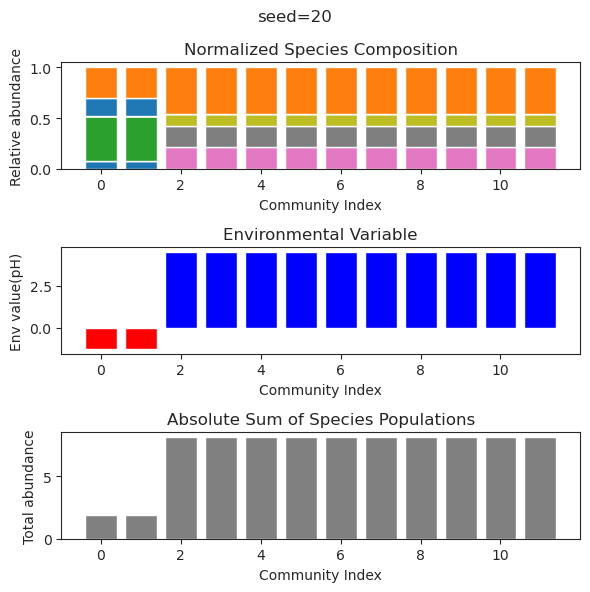

{'species': array([ 9.50010818e-002,  1.15833504e-193,  3.96548460e-001,
        1.78332143e-174,  3.13004570e-165,  2.80802831e-001,
        2.88868261e-001, -3.64102336e-002,  7.44004767e-089,
        0.00000000e+000,  1.55381839e-126,  4.60253403e-001]), 'env': array([-0.7123752])}
{'species': array([-1.39253015e-031,  2.93001070e-109,  4.61112064e-002,
        1.81727051e-138,  5.91639585e-001, -1.47647621e-026,
        1.57975810e-001,  3.54027399e-001,  1.59481192e-001,
        1.30691182e-129,  1.94216406e-083,  6.57886225e-001]), 'env': array([0.0666682])}
{'species': array([-1.42428895e-19,  4.30419317e-52,  4.61112064e-02,  2.87400427e-54,
        5.91639585e-01, -1.44175251e-18,  1.57975810e-01,  3.54027399e-01,
        1.59481192e-01,  4.35124497e-44, -2.13441642e-32,  6.57886225e-01]), 'env': array([0.0666682])}
{'species': array([-5.10001602e-25, -1.48842635e-79,  4.61112064e-02,  4.30371855e-93,
        5.91639585e-01, -4.72810023e-22,  1.57975810e-01,  3.54027399e-01,
 

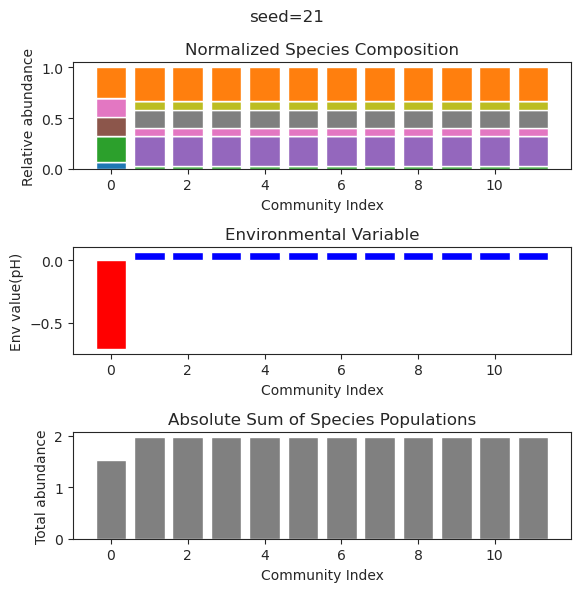

{'species': array([ 5.01830708e-02,  1.47158511e-01,  3.06395067e-51,  7.80500479e-88,
        1.28358894e-43, -3.53910725e-45,  4.12590072e-01,  6.22474388e-01,
       -2.14971709e-28, -7.85619266e-27, -8.13381714e-48,  3.84917051e-20]), 'env': array([-1.68579379])}
{'species': array([ 5.01830708e-02,  1.47158511e-01, -5.53832924e-45,  6.16522872e-68,
        7.21342817e-41,  3.72804476e-38,  4.12590072e-01,  6.22474388e-01,
       -5.06476154e-26, -2.84145347e-26,  1.55654935e-38,  2.67772726e-20]), 'env': array([-1.68579379])}
{'species': array([ 5.01830708e-02,  1.47158511e-01,  2.18163573e-54, -5.42940696e-91,
        3.91431539e-44,  6.60139192e-48,  4.12590072e-01,  6.22474388e-01,
       -3.64916252e-28, -5.31823063e-27,  2.80183262e-49,  2.01262199e-20]), 'env': array([-1.68579379])}
{'species': array([ 5.01830708e-02,  1.47158511e-01,  1.24097412e-45, -2.20720457e-69,
       -2.70939041e-42,  3.47188934e-39,  4.12590072e-01,  6.22474388e-01,
       -1.66594832e-25, -1.6843784

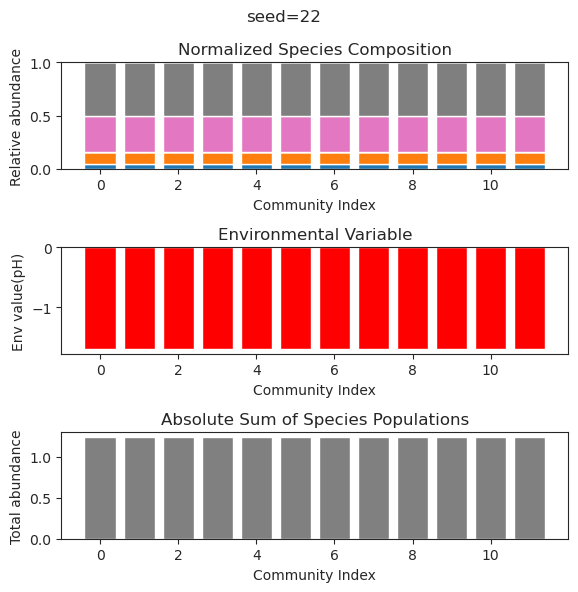

{'species': array([ 1.15069057e-01, -8.42879865e-38, -1.85837434e-56,  5.89464740e-23,
        4.62308461e-01,  2.16325239e-76,  5.44918965e-07,  5.73883555e-01,
        4.06734135e-01, -2.21293174e-73,  7.25002360e-25,  2.14525039e-01]), 'env': array([-0.58246701])}
{'species': array([ 1.15774090e-01,  3.16225419e-28,  3.18294242e-27,  6.58282113e-32,
        4.59688841e-01, -6.01024946e-27,  2.86361706e-03,  5.73321274e-01,
        4.10135744e-01,  5.04568768e-27, -7.64404703e-30,  2.11140442e-01]), 'env': array([-0.58499569])}
{'species': array([ 1.15777224e-01,  2.09815847e-39,  3.48563278e-34,  1.94958414e-29,
        4.59676872e-01,  4.26916227e-30,  2.87580178e-03,  5.73319390e-01,
        4.10151497e-01, -3.44956511e-35,  9.69752037e-31,  2.11124985e-01]), 'env': array([-0.58500712])}
{'species': array([ 1.15777178e-01, -7.18080917e-35,  1.74416894e-32,  5.47954661e-30,
        4.59677047e-01,  1.01086035e-33,  2.87562370e-03,  5.73319417e-01,
        4.10151267e-01,  3.5367287

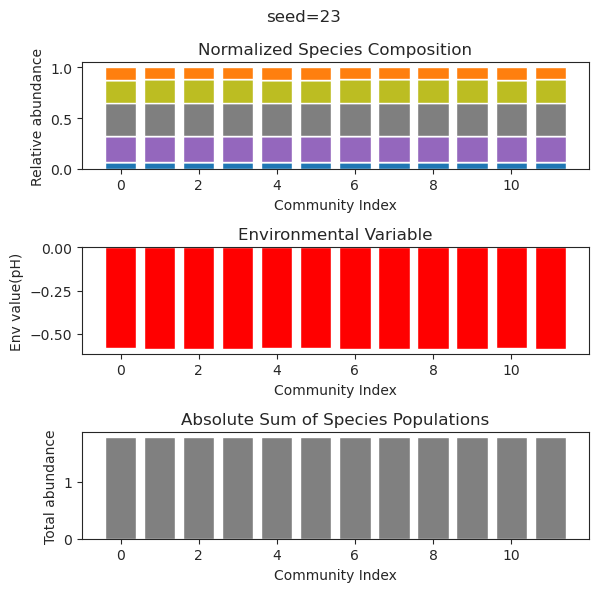

{'species': array([ 1.07390889e-01, -6.30186492e-49, -3.89855582e-73,  3.35934365e-01,
       -9.51502121e-64,  6.42241030e-01, -2.36131424e-68,  5.66868868e-01,
       -3.10840167e-41,  2.79565145e-01, -3.96760372e-31,  5.02373337e-95]), 'env': array([-0.28425011])}
{'species': array([ 1.07390889e-01,  2.71076342e-48,  1.22852953e-73,  3.35934365e-01,
        1.75928030e-64,  6.42241030e-01,  2.45324125e-67,  5.66868868e-01,
       -1.01706965e-40,  2.79565145e-01, -8.90508579e-29,  2.58700436e-98]), 'env': array([-0.28425011])}
{'species': array([ 1.07390889e-01,  7.27038722e-57,  1.34257974e-81,  3.35934365e-01,
        2.84906301e-67,  6.42241030e-01,  2.48591322e-85,  5.66868868e-01,
        2.28703147e-47,  2.79565145e-01, -4.99292025e-38,  3.41369661e-99]), 'env': array([-0.28425011])}
{'species': array([ 1.07390889e-01, -6.86569983e-46,  7.75596258e-69,  3.35934365e-01,
       -9.41920588e-61,  6.42241030e-01,  8.11660693e-64,  5.66868868e-01,
       -2.38875029e-38,  2.7956514

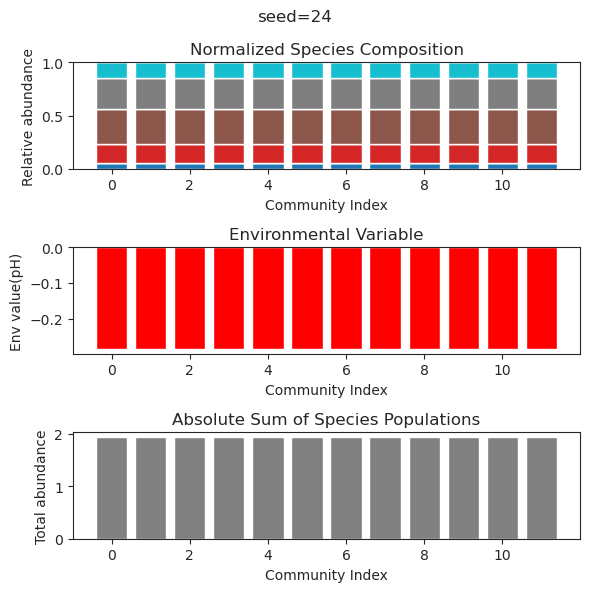

{'species': array([ 3.01207281e-01,  9.08418093e-31,  2.34070212e-24,  5.12947085e-30,
        3.57190002e-55,  1.64209143e-56,  1.01468199e-56, -4.97499719e-54,
        6.05779664e-59,  7.30655263e-01,  4.04116822e-61,  3.49376986e-01]), 'env': array([-1.95544865])}
{'species': array([ 3.01207281e-01, -6.30405686e-31, -4.22927216e-26, -1.67166634e-31,
        5.42528795e-52,  3.75717232e-52,  4.20946650e-54,  4.76251234e-55,
        1.32165391e-56,  7.30655263e-01,  9.63485902e-59,  3.49376986e-01]), 'env': array([-1.95544865])}
{'species': array([ 3.01207281e-01, -3.85240772e-29, -7.80569306e-24, -1.94123961e-32,
        1.29058276e-51,  1.61673752e-53,  1.03451293e-54, -4.09144393e-51,
        8.22849609e-54,  7.30655263e-01, -3.96495313e-54,  3.49376986e-01]), 'env': array([-1.95544865])}
{'species': array([ 3.01207281e-01, -2.85181592e-31,  8.71119113e-26, -8.09977416e-33,
        4.61965915e-53,  3.75599974e-53, -2.94156929e-56, -1.90148384e-57,
       -1.90826885e-57,  7.3065526

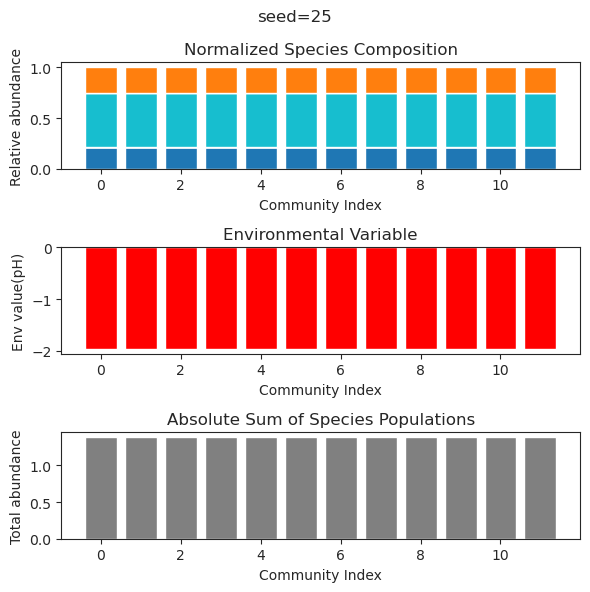

{'species': array([ 3.34311920e-01,  7.34711765e-19,  5.87411822e-35, -2.09714508e-27,
       -6.12900656e-42, -5.25653994e-54, -6.39874486e-57, -1.27345544e-53,
       -9.13339430e-51,  1.07667827e+00, -4.59405702e-44, -3.29929739e-46]), 'env': array([-2.27893754])}
{'species': array([ 3.34311920e-01, -5.21229232e-20, -7.86969594e-41, -2.61524817e-31,
        2.77469012e-47, -2.16555133e-61, -2.27403152e-62, -2.16318095e-62,
        8.97277808e-58,  1.07667827e+00,  6.51588748e-45,  2.67965621e-48]), 'env': array([-2.27893754])}
{'species': array([-5.11001636e-26, -4.19412095e-54,  7.66522086e-53,  6.14882071e-51,
        2.34077578e-01,  3.18016187e-57,  3.74777942e-01, -9.77259273e-27,
        6.14278325e-01, -1.77375685e-50,  6.54477501e-01,  5.28473558e-01]), 'env': array([0.04071568])}
{'species': array([ 3.34311920e-01,  1.70083379e-23,  7.88726489e-38,  2.31276273e-33,
       -1.10121989e-43,  1.80177569e-58,  1.56046352e-58,  1.91571849e-58,
       -4.57133692e-54,  1.07667827

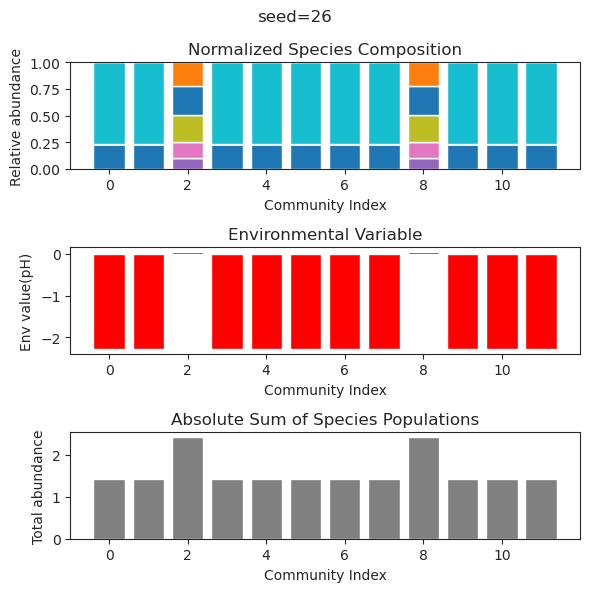

{'species': array([ 1.49354600e-01,  2.01971725e-01,  5.75945073e-62,  4.86892159e-54,
        1.32859101e-62, -5.52721247e-38,  1.45713371e-58, -1.49803775e-50,
        1.44025010e-51,  9.28410553e-25, -4.70951620e-27, -3.86618602e-48]), 'env': array([-3.43061259])}
{'species': array([ 1.49354600e-001,  2.01971725e-001,  8.30991838e-102,
        1.72678733e-089, -2.96886184e-106, -1.21697674e-041,
        3.10453751e-094,  9.00998935e-072,  7.51067016e-085,
        1.84697844e-026,  8.93933531e-029, -8.13996285e-070]), 'env': array([-3.43061259])}
{'species': array([ 1.49354600e-001,  2.01971725e-001,  1.79521489e-138,
        5.54551261e-116, -2.63363215e-150,  1.89921031e-044,
       -5.16875863e-126, -1.09698313e-091,  7.83847868e-112,
       -5.24330195e-026, -6.77226231e-029, -8.92044256e-090]), 'env': array([-3.43061259])}
{'species': array([ 1.49354600e-001,  2.01971725e-001, -1.82151461e-117,
       -1.08175340e-096,  1.46328128e-110, -1.03593255e-035,
        2.35318345e-110,

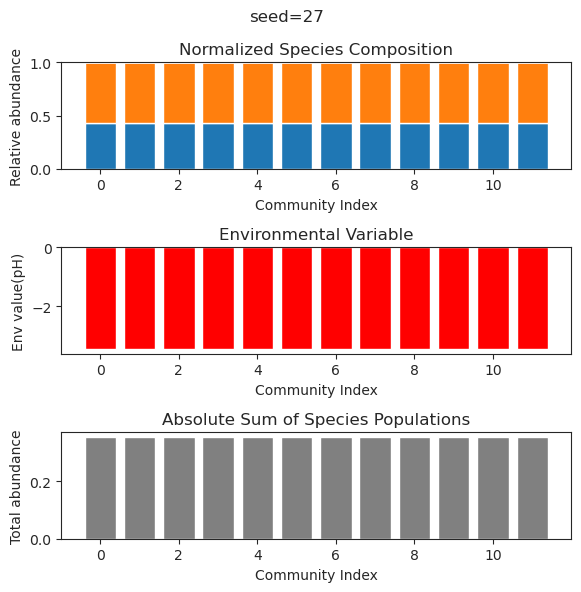

{'species': array([-3.50543397e-66,  1.91057934e-01, -1.15845289e-37, -7.25555002e-57,
        6.43860919e-01,  2.18244141e-01,  7.64760241e-57, -1.87387853e-72,
        7.90518815e-66,  5.36002735e-01,  8.08733987e-78,  3.14442530e-01]), 'env': array([-0.88141885])}
{'species': array([-1.53796020e-64,  1.91057934e-01,  1.29622831e-40, -2.07853565e-58,
        6.43860919e-01,  2.18244141e-01,  4.87941415e-51,  2.61034383e-70,
        3.53671104e-66,  5.36002735e-01,  1.24354150e-73,  3.14442530e-01]), 'env': array([-0.88141885])}
{'species': array([ 6.86089924e-002,  4.24199516e-146,  2.01095189e-001,
        1.13181104e+000,  1.36776569e-054,  8.34520086e-003,
        1.40225744e+000, -1.48219694e-323,  4.65927019e-136,
        2.53448419e-001,  2.33598676e-045,  2.72855453e-002]), 'env': array([0.93397648])}
{'species': array([ 1.58227814e-41, -8.49667427e-68,  1.59339906e-54,  4.50819279e+00,
       -3.33236829e-49,  5.10494433e-67,  5.48702255e+00,  2.33847290e-62,
       -1.313292

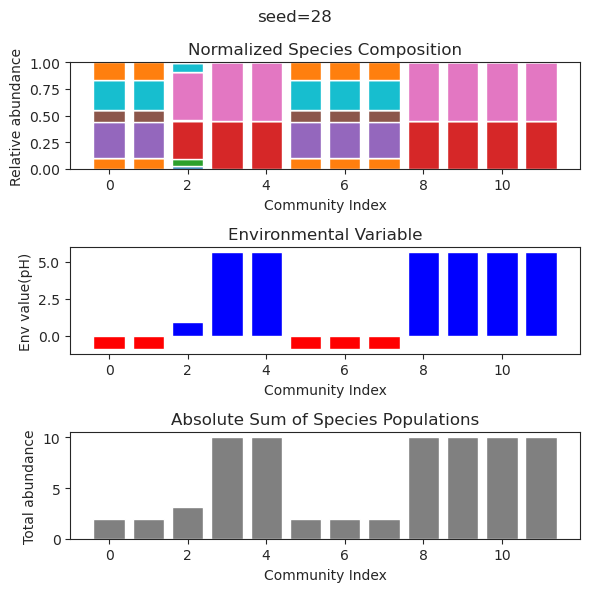

{'species': array([ 3.60112865e-074,  1.53754096e-116,  2.34787430e+000,
       -2.93709360e-077, -3.29688434e-109, -8.14443733e-058,
        1.95815651e+000,  3.44691820e-084,  9.45623716e-001,
       -1.55142394e-028,  3.99329241e-109,  2.59192770e-109]), 'env': array([2.09025217])}
{'species': array([-4.71412593e-70,  1.04815367e-98,  2.34787430e+00, -2.48869385e-69,
       -1.62570578e-98, -3.29650826e-60,  1.95815651e+00, -3.48271936e-76,
        9.45623716e-01,  2.70670635e-25, -7.68711876e-89, -1.20548685e-94]), 'env': array([2.09025217])}
{'species': array([-2.49995882e-080,  8.63909443e-116,  2.34787430e+000,
        1.14696626e-059,  2.64913975e-111,  4.35661727e-050,
        1.95815651e+000,  1.95095209e-085,  9.45623716e-001,
        7.04400916e-026,  2.07277981e-109, -9.39877063e-105]), 'env': array([2.09025217])}
{'species': array([-4.02893534e-72, -1.32594437e-98,  2.34787430e+00,  3.00305230e-46,
        8.80031373e-92,  2.43339486e-43,  1.95815651e+00,  4.57299424e-75,

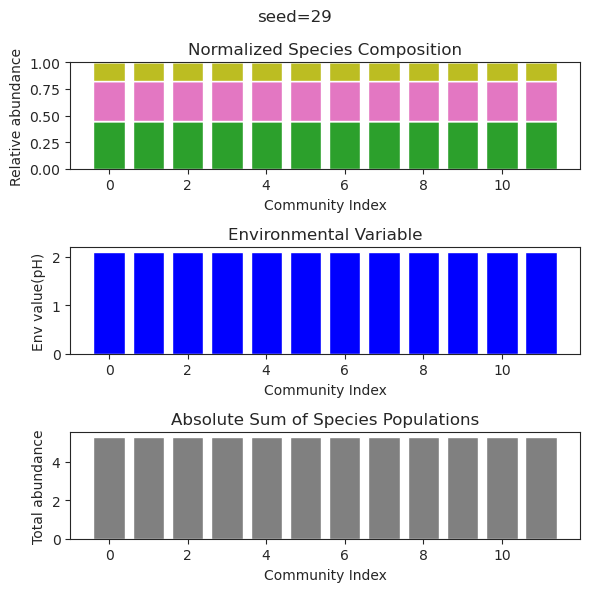

{'species': array([ 5.92400638e-81,  2.99794304e-01, -2.36731465e-86,  8.36479729e-63,
        2.50379792e-01, -1.91999094e-29,  8.02908786e-01,  1.51587248e-01,
       -7.12372423e-20,  1.29412677e-45, -1.41992188e-64, -1.38468741e-68]), 'env': array([-2.13066378])}
{'species': array([ 1.06301668e-57,  2.99794304e-01,  2.02101105e-59, -3.70287239e-46,
        2.50379792e-01,  1.30385429e-27,  8.02908786e-01,  1.51587248e-01,
       -2.65111859e-18,  4.20653718e-37,  1.50816448e-51,  1.44402031e-54]), 'env': array([-2.13066378])}
{'species': array([ 1.33862153e-77,  2.99794304e-01,  2.17265033e-81,  5.07812918e-62,
        2.50379792e-01,  2.75749704e-28,  8.02908786e-01,  1.51587248e-01,
       -1.03767837e-17,  4.60789805e-40,  1.07714159e-61,  1.66845032e-66]), 'env': array([-2.13066378])}
{'species': array([ 1.37669994e-48,  2.99794304e-01, -7.75381414e-48, -9.55448944e-39,
        2.50379792e-01, -2.12936601e-29,  8.02908786e-01,  1.51587248e-01,
       -6.35672604e-18, -1.2580576

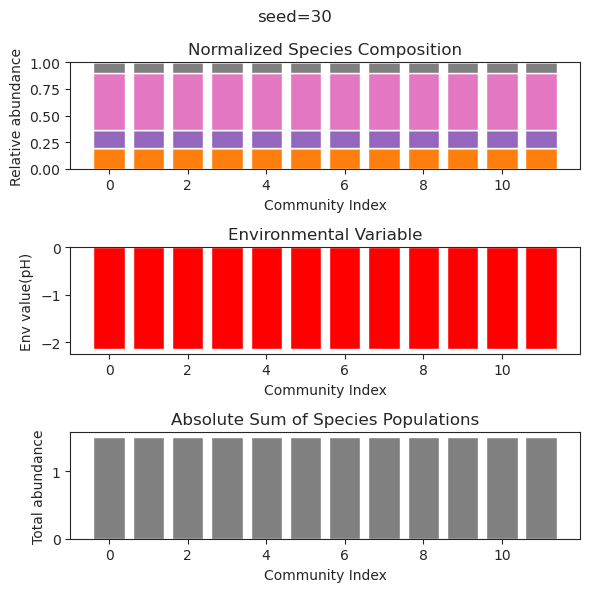

{'species': array([ 4.02541203e-50,  2.16641032e-01, -2.02253285e-28,  8.58459614e-01,
        6.73306924e-01,  2.89262159e-39,  9.66201801e-40,  1.81067446e-49,
        2.00067882e-41,  1.31601348e-01, -4.93821417e-48, -2.15632088e-47]), 'env': array([-1.40302269])}
{'species': array([-4.15551166e-52,  2.16641032e-01, -4.57666194e-31,  8.58459614e-01,
        6.73306924e-01, -9.36584910e-38,  2.40983420e-42, -7.10771593e-50,
        4.39169677e-41,  1.31601348e-01,  1.77257069e-47,  3.68776732e-50]), 'env': array([-1.40302269])}
{'species': array([ 5.69665601e-51,  2.16641032e-01,  7.98145584e-29,  8.58459614e-01,
        6.73306924e-01, -1.13818426e-40,  1.16458261e-38, -4.82037282e-47,
       -6.52093753e-45,  1.31601348e-01, -4.18121881e-45, -3.10714672e-46]), 'env': array([-1.40302269])}
{'species': array([-4.03765182e-52,  2.16641032e-01, -7.83696666e-29,  8.58459614e-01,
        6.73306924e-01,  8.93858478e-37,  3.12510118e-38, -2.83603861e-47,
        9.72077912e-40,  1.3160134

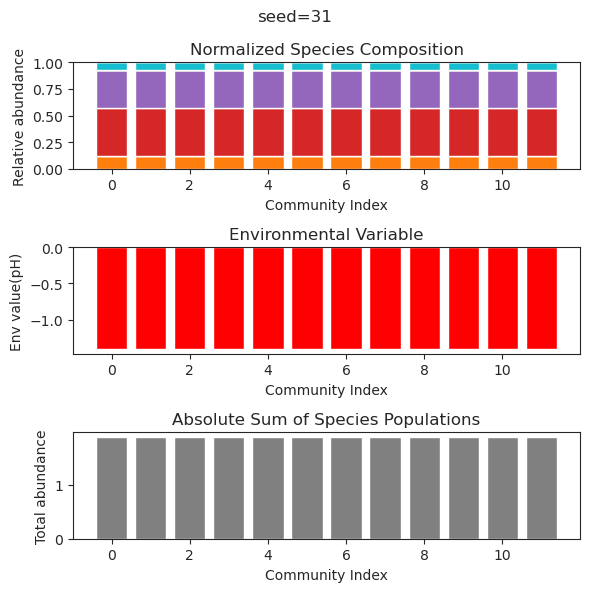

{'species': array([ 6.88979071e-084,  2.05939255e-001, -2.25410928e-131,
       -4.75179375e-132, -4.15559013e-027,  3.05588032e-070,
       -4.56316036e-072, -1.03882271e-035,  2.83786070e-001,
        1.11542333e+000, -7.87469280e-046,  8.40846343e-002]), 'env': array([-1.96582021])}
{'species': array([ 1.99633676e-083,  2.05939255e-001,  5.45626113e-132,
        7.77574987e-131, -4.15996626e-025, -1.72957768e-074,
       -2.44622451e-073, -6.16827181e-036,  2.83786070e-001,
        1.11542333e+000,  1.12421385e-044,  8.40846343e-002]), 'env': array([-1.96582021])}
{'species': array([-3.09634138e-023, -8.59450179e-098,  6.32792263e-083,
        1.04017502e-092,  8.00432138e-001,  1.90484560e+000,
       -2.83591981e-097,  2.23363159e+000,  1.39915674e-077,
       -5.00951154e-104,  1.44682028e-047,  1.37165608e-034]), 'env': array([2.27421335])}
{'species': array([ 9.12587671e-23,  3.05933222e-35,  1.01737646e-44, -2.69111730e-43,
        8.00432138e-01,  1.90484560e+00, -1.43180919e

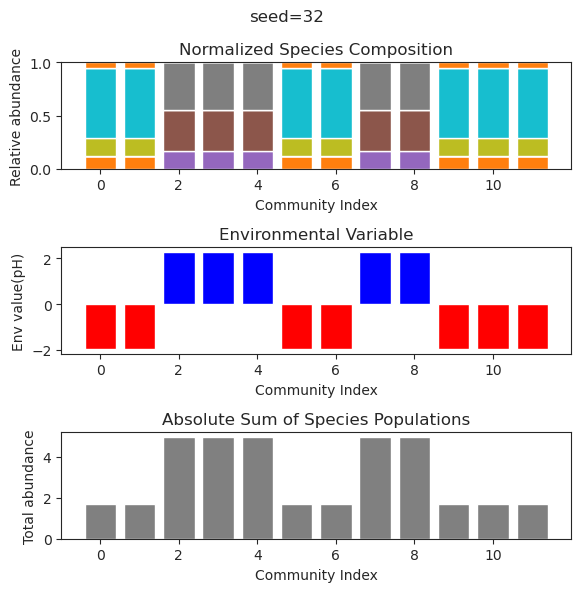

{'species': array([ 2.44050380e-002, -6.82280621e-067,  4.41729884e-001,
        4.99371022e-001,  4.82350812e-001,  2.19557203e-001,
        3.78664638e-121, -8.06418907e-112, -8.45223649e-099,
       -3.35787164e-041, -8.90573793e-122,  4.14571777e-001]), 'env': array([-0.20264538])}
{'species': array([ 2.44050380e-002, -1.30658094e-062,  4.41729884e-001,
        4.99371022e-001,  4.82350812e-001,  2.19557203e-001,
       -7.10542857e-111, -9.13928927e-099, -5.06931605e-091,
        2.23248109e-038, -2.52734998e-108,  4.14571777e-001]), 'env': array([-0.20264538])}
{'species': array([ 2.44050380e-02, -4.44243636e-53,  4.41729884e-01,  4.99371022e-01,
        4.82350812e-01,  2.19557203e-01, -6.19796053e-92,  8.09357822e-89,
       -3.54273289e-75,  4.00998842e-37, -1.11116191e-94,  4.14571777e-01]), 'env': array([-0.20264538])}
{'species': array([ 2.44050380e-002, -2.37175867e-057,  4.41729884e-001,
        4.99371022e-001,  4.82350812e-001,  2.19557203e-001,
        1.23494232e-106,

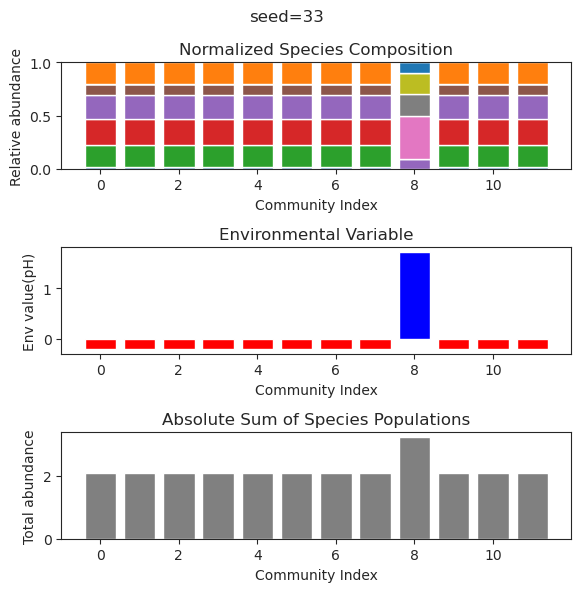

{'species': array([ 3.77933406e-01,  6.17508158e-44, -1.22190316e-39, -1.10744243e-83,
        9.27063194e-01, -1.54904686e-95, -4.62727828e-42,  3.66617330e-59,
        5.88798321e-02, -3.72687199e-51,  1.02125435e+00, -4.37619173e-21]), 'env': array([-2.92148959])}
{'species': array([ 3.77933406e-01,  1.32448444e-63, -1.29305349e-35,  4.96661034e-84,
        9.27063194e-01, -3.78563324e-90, -2.86762719e-38,  7.89222816e-60,
        5.88798321e-02, -2.35688767e-51,  1.02125435e+00, -8.02635910e-26]), 'env': array([-2.92148959])}
{'species': array([ 3.77933406e-01,  1.35609742e-49, -1.55177116e-39, -6.34562076e-60,
        9.27063194e-01, -2.18171707e-65, -8.80591314e-41, -6.12615511e-46,
        5.88798321e-02, -5.30619693e-44,  1.02125435e+00,  5.72040584e-29]), 'env': array([-2.92148959])}
{'species': array([ 3.77933406e-01,  1.91448052e-45, -7.29446200e-34, -2.33574679e-68,
        9.27063194e-01,  3.90909019e-68, -3.75765267e-36, -1.49854775e-58,
        5.88798321e-02,  6.1241519

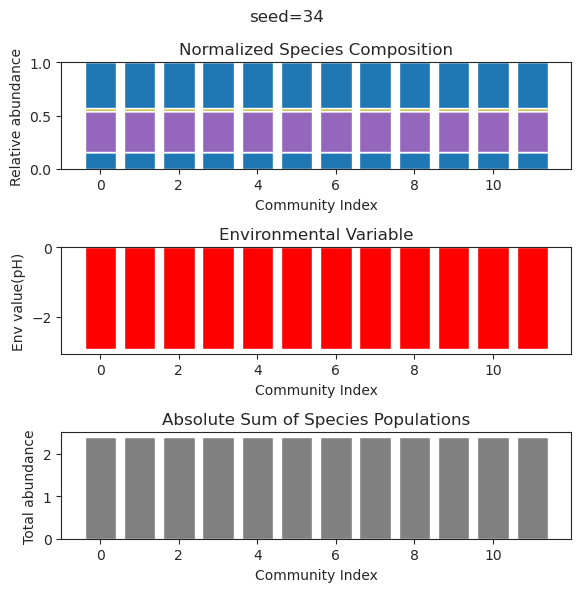

{'species': array([ 3.32868792e-01, -1.06120879e-50, -6.93529838e-94, -1.12700734e-58,
       -5.11862535e-82,  5.20201144e-01, -5.25705917e-83,  1.85427959e-01,
        1.38131241e-95,  2.72731939e-95, -1.82505458e-26,  1.51633671e-50]), 'env': array([-2.78942174])}
{'species': array([ 3.32868792e-01, -2.21360364e-50, -9.51015108e-99, -2.54465956e-58,
       -2.30328753e-85,  5.20201144e-01, -4.94720262e-85,  1.85427959e-01,
       -7.74084953e-99, -2.04144771e-99,  3.21300341e-25, -5.61488388e-58]), 'env': array([-2.78942174])}
{'species': array([ 3.32868792e-01,  6.67248389e-45,  7.73719462e-86,  5.11343240e-55,
       -9.02343019e-74,  5.20201144e-01, -1.75502346e-74,  1.85427959e-01,
        9.99717559e-83,  1.70989680e-83,  9.82891213e-24, -1.00610588e-44]), 'env': array([-2.78942174])}
{'species': array([ 3.32868792e-01,  3.56475270e-39, -5.44928462e-59,  2.83356613e-41,
        9.33560827e-57,  5.20201144e-01,  1.06863669e-55,  1.85427959e-01,
        8.28260817e-60,  5.9758479

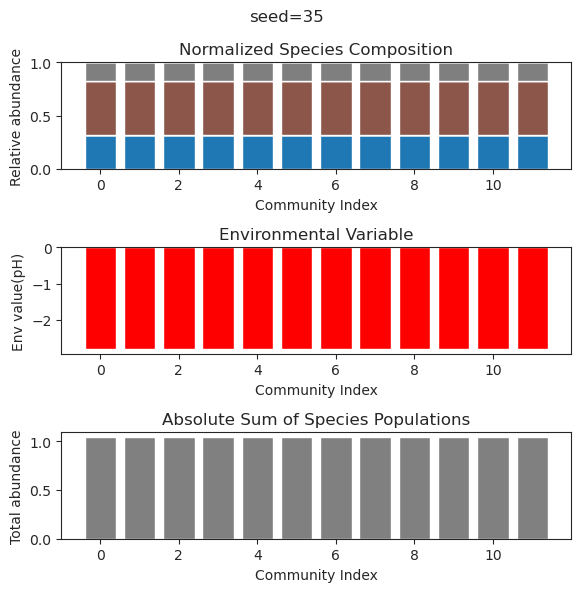

{'species': array([-6.38490710e-52,  1.84982773e-01,  7.85174612e-01,  2.47562990e-02,
        1.73303269e-38,  6.57032478e-01,  1.39106358e-29,  1.73592621e-63,
       -2.24764791e-53, -6.20176817e-49, -6.82102137e-61,  2.24024103e-60]), 'env': array([-1.93079834])}
{'species': array([ 9.16193383e-46,  1.84982773e-01,  7.85174612e-01,  2.47562990e-02,
       -1.52593927e-40,  6.57032478e-01, -7.44943640e-26, -1.12990862e-96,
       -8.99371821e-76,  1.80651348e-64, -1.24203199e-94, -3.34292740e-89]), 'env': array([-1.93079834])}
{'species': array([ 3.96257410e-62,  1.84982773e-01,  7.85174612e-01,  2.47562990e-02,
       -9.16896629e-37,  6.57032478e-01,  1.17257420e-27, -4.11152084e-73,
        3.05096893e-63, -1.00334376e-51,  4.77269995e-78, -3.59995770e-71]), 'env': array([-1.93079834])}
{'species': array([-1.13126266e-48,  1.84982773e-01,  7.85174612e-01,  2.47562990e-02,
       -2.85102356e-35,  6.57032478e-01,  1.35710602e-27, -4.89602752e-60,
       -2.58737414e-49,  3.9797403

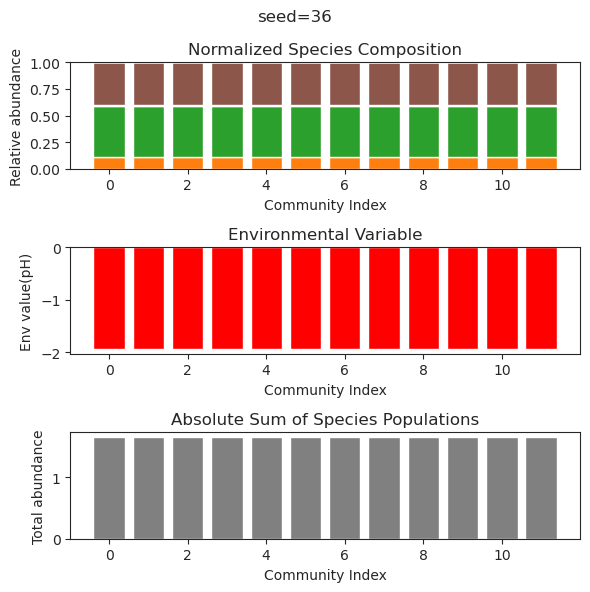

{'species': array([ 4.23181113e-02,  1.75804303e-01, -4.05664371e-52, -4.73306986e-38,
        4.12899143e-18,  6.37485000e-01,  1.87919567e-53, -3.53211028e-75,
       -1.43932315e-24,  1.08015108e-58, -1.60194766e-75,  4.64763158e-73]), 'env': array([-2.19954443])}
{'species': array([ 4.23181113e-02,  1.75804303e-01, -5.51094388e-63, -1.80933935e-40,
        3.10803321e-20,  6.37485000e-01, -2.16230606e-63,  9.30897994e-83,
        2.55354520e-28,  3.09742649e-64,  1.69810675e-80,  7.13799467e-79]), 'env': array([-2.19954443])}
{'species': array([ 4.23181113e-002,  1.75804303e-001, -1.86615350e-071,
        1.16990936e-038,  1.86271964e-019,  6.37485000e-001,
       -5.85789826e-075, -2.28522968e-099, -3.05787045e-025,
       -1.06552207e-081, -1.55873673e-099, -5.77139037e-101]), 'env': array([-2.19954443])}
{'species': array([ 4.23181113e-02,  1.75804303e-01,  2.70163653e-57, -7.68390113e-36,
        7.29615319e-20,  6.37485000e-01, -4.21681654e-58, -1.73288786e-77,
       -2.80091

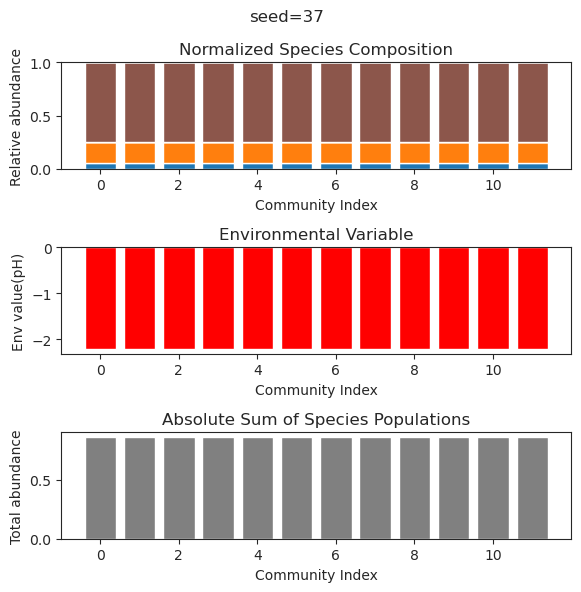

{'species': array([ 1.25842686e-001,  8.83420310e-044,  2.58308511e-001,
        5.25090936e-131,  1.27318268e-122,  2.07115644e-001,
       -3.40294616e-088,  2.17663830e-001,  1.62377018e-080,
        1.48206226e-001,  1.90919652e-003,  5.53587755e-001]), 'env': array([-0.83066344])}
{'species': array([ 1.25842456e-001,  1.62566885e-060,  2.58307540e-001,
        3.97973787e-126, -3.18028503e-122,  2.07117247e-001,
       -2.13526637e-087,  2.17666127e-001,  6.37792524e-078,
        1.48203791e-001,  1.90842835e-003,  5.53587868e-001]), 'env': array([-0.83066158])}
{'species': array([ 1.25471867e-001,  4.35492733e-027,  2.56640782e-001,
       -3.76597461e-131,  2.35854956e-027,  2.09794022e-001,
        1.71212495e-027,  2.21506617e-001, -1.12422673e-027,
        1.44196490e-001,  4.59996959e-004,  5.53862851e-001]), 'env': array([-0.82775213])}
{'species': array([ 1.25841111e-001, -1.45777036e-047,  2.58301856e-001,
       -5.94207313e-121,  4.73402387e-128,  2.07126633e-001,
     

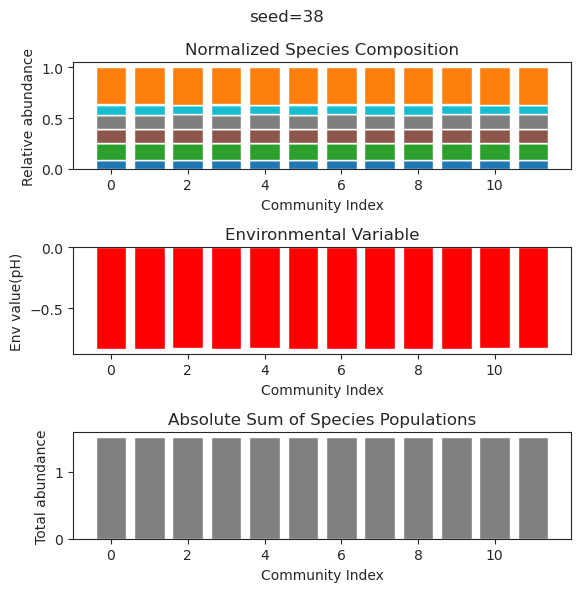

{'species': array([-1.15400924e-091, -4.84094085e-114,  7.86808840e-040,
        1.47479141e-061,  2.53191406e-116,  1.33810718e-088,
        5.23449859e+000,  1.12326453e-101,  1.84364010e-106,
        2.54281343e+000,  1.36756594e-121, -3.19151050e-070]), 'env': array([6.41922629])}
{'species': array([-1.34376583e-087, -9.08951542e-106, -4.53117455e-038,
       -7.15100167e-058,  3.21197873e-108, -4.99089241e-085,
        5.23449859e+000, -3.61171140e-096, -1.82899266e-099,
        2.54281343e+000,  9.80528705e-113,  3.39480077e-067]), 'env': array([6.41922629])}
{'species': array([-3.10513643e-42,  3.52869187e-95,  1.95871713e-35, -1.23116752e-59,
       -3.11170350e-92,  5.11916433e-78,  5.23449859e+00,  3.69172193e-83,
       -5.31199833e-89,  2.54281343e+00,  2.73393646e-94,  1.97858240e-58]), 'env': array([6.41922629])}
{'species': array([ 1.30440737e-080, -1.89386183e-099,  4.45841549e-032,
        4.00865551e-059,  3.25542984e-096, -1.06537054e-067,
        5.23449859e+000,  1

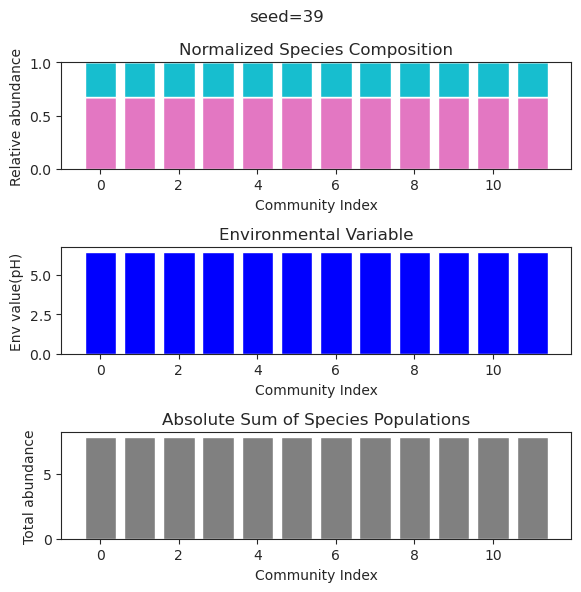

{'species': array([-4.38394115e-028,  3.18502689e-003,  5.39521332e-006,
        4.47739319e-001,  1.69363795e-001,  8.13372496e-001,
       -2.29588521e-101,  9.21251344e-075,  1.54973975e-097,
        2.48148274e-033,  6.69574968e-001,  6.54305350e-002]), 'env': array([0.46054571])}
{'species': array([-2.40717400e-28,  3.18483496e-03,  3.10965138e-06,  4.47740275e-01,
        1.69364775e-01,  8.13374564e-01, -2.25620692e-80, -1.62033140e-61,
       -1.16074675e-28, -2.05672434e-30,  6.69576107e-01,  6.54283127e-02]), 'env': array([0.46054666])}
{'species': array([ 2.09141849e-28,  3.18592777e-03,  1.61238894e-05,  4.47734835e-01,
        1.69359197e-01,  8.13362787e-01, -3.75179621e-35,  3.97308453e-42,
       -1.41717407e-30, -3.23239434e-33,  6.69569624e-01,  6.54409666e-02]), 'env': array([0.46054125])}
{'species': array([-1.18096613e-027,  3.18629309e-003,  2.04746018e-005,
        4.47733016e-001,  1.69357332e-001,  8.13358850e-001,
       -6.13866992e-033, -5.87526667e-070, -3.

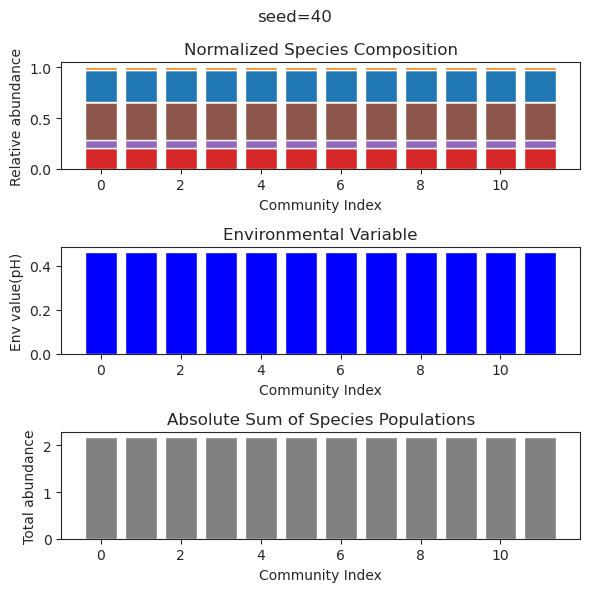

{'species': array([ 6.07914789e-002,  1.90923932e-002,  3.69041555e-001,
        1.68659802e-166, -1.78430582e-089, -1.49486473e-094,
        8.68825636e-036,  2.12693296e-001,  1.62965287e-001,
        4.55587429e-001, -5.36749699e-137,  6.33654466e-001]), 'env': array([-0.13358845])}
{'species': array([ 6.07914789e-002,  1.90923932e-002,  3.69041555e-001,
        3.25607662e-162,  5.99583936e-089,  2.05831234e-090,
       -5.12276880e-037,  2.12693296e-001,  1.62965287e-001,
        4.55587429e-001, -1.21563076e-132,  6.33654466e-001]), 'env': array([-0.13358845])}
{'species': array([ 6.07914789e-002,  1.90923932e-002,  3.69041555e-001,
       -4.65427624e-159,  1.89973884e-088,  3.03485141e-093,
        3.53125078e-035,  2.12693296e-001,  1.62965287e-001,
        4.55587429e-001, -3.25494747e-127,  6.33654466e-001]), 'env': array([-0.13358845])}
{'species': array([ 6.07914789e-002,  1.90923932e-002,  3.69041555e-001,
        2.26062960e-152,  8.69426407e-090,  1.51384677e-090,
     

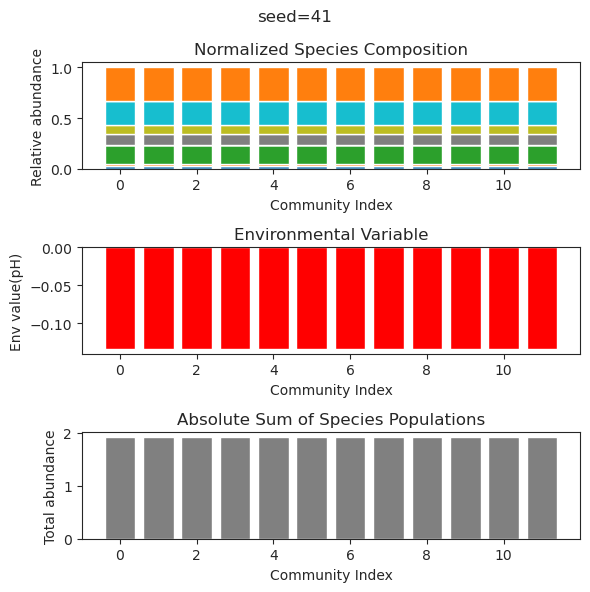

{'species': array([ 1.70219176e-01,  5.84291134e-47,  2.25332336e-16, -3.35532234e-65,
        5.03126153e-01, -8.99580062e-68,  6.83390083e-86, -1.21638839e-78,
        8.05585772e-01, -3.38909086e-32,  5.04967960e-01, -1.88960729e-64]), 'env': array([-1.28319777])}
{'species': array([ 1.70219176e-01,  2.72315667e-36,  3.96842763e-17,  1.00718809e-53,
        5.03126153e-01, -1.48085434e-58,  3.89856694e-94, -2.39752175e-79,
        8.05585772e-01, -1.30742056e-24,  5.04967960e-01,  2.02433831e-58]), 'env': array([-1.28319777])}
{'species': array([ 1.70219176e-001, -5.86548385e-047,  2.56247994e-017,
        1.54603760e-068,  5.03126153e-001,  7.44927152e-075,
        5.53238021e-111, -2.63863872e-102,  8.05585772e-001,
        1.36232737e-028,  5.04967960e-001,  4.54147125e-075]), 'env': array([-1.28319777])}
{'species': array([ 1.70219176e-01, -2.33280091e-35, -8.58162250e-17,  7.24901190e-46,
        5.03126153e-01,  3.72365161e-49,  3.51771870e-79,  6.67171213e-74,
        8.05585

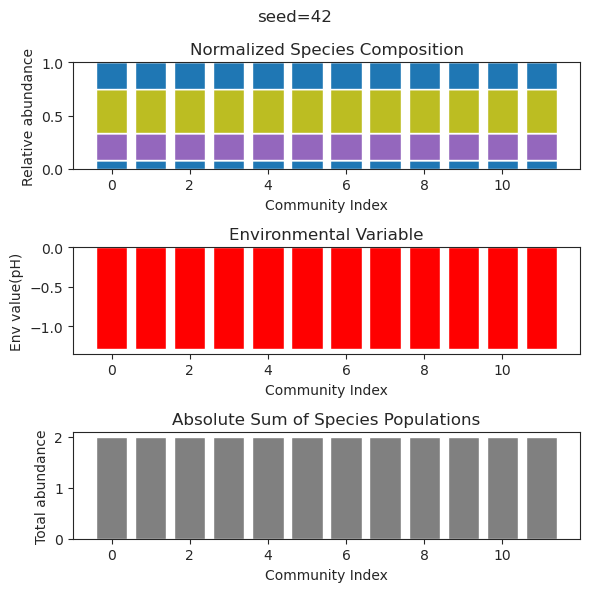

{'species': array([ 3.70637451e-002,  9.47019991e-002,  4.36769081e-052,
        3.21102669e-001, -3.47260257e-107,  7.31744777e-001,
        5.27867436e-011,  7.97500132e-040,  4.80848808e-001,
       -1.20367212e-043, -4.67233044e-103,  7.19333502e-007]), 'env': array([-0.92690604])}
{'species': array([ 2.59826346e-05,  1.16611760e-01, -3.07418721e-36,  2.75291989e-01,
       -3.85807584e-33,  7.28077791e-01,  7.35974985e-02,  1.57517932e-54,
        4.69280327e-01, -2.61426375e-72, -1.45923704e-62,  5.30774229e-02]), 'env': array([-0.68848081])}
{'species': array([ 3.70639361e-02,  9.47018694e-02,  2.59731518e-52,  3.21102434e-01,
        6.82575136e-83,  7.31744814e-01,  3.11975190e-10, -8.06052674e-25,
        4.80849085e-01, -7.06313791e-33,  4.92146743e-88,  4.47016598e-07]), 'env': array([-0.92690674])}
{'species': array([ 3.70560885e-02,  9.47071982e-02, -2.80073942e-42,  3.21112054e-01,
        1.78018624e-76,  7.31743328e-01,  7.61806206e-09, -4.73237036e-37,
        4.80837

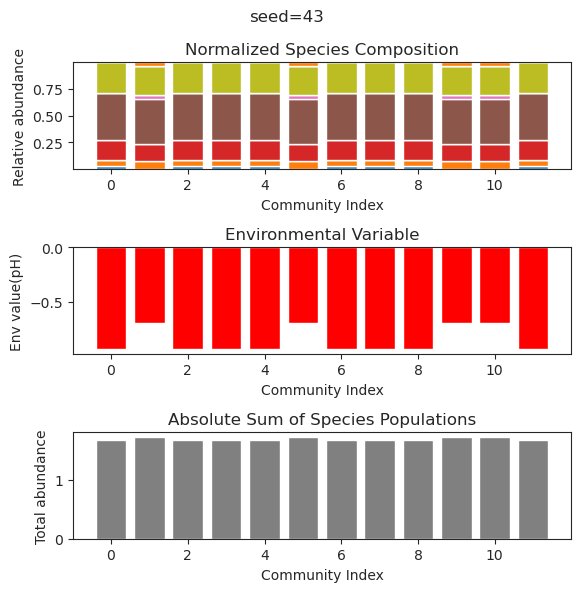

{'species': array([ 1.93721028e-01,  1.49296772e-21,  1.09751873e-24, -4.38828737e-52,
        5.52653737e-53, -1.23747289e-39,  1.07911411e+00, -2.66098236e-47,
       -5.61897820e-53, -5.15398754e-37, -6.62308507e-53,  1.65806917e-28]), 'env': array([-1.90672951])}
{'species': array([ 1.93721028e-01,  1.08639328e-21, -4.93944522e-27,  2.72888951e-57,
       -2.09826542e-53, -8.53533526e-42,  1.07911411e+00,  6.60466529e-51,
       -7.96304666e-59, -1.17091795e-37, -1.18110839e-58, -1.15907688e-30]), 'env': array([-1.90672951])}
{'species': array([ 1.93721028e-01, -2.97360861e-21, -2.09379099e-24, -5.94090541e-50,
        6.20699766e-47, -4.84241676e-37,  1.07911411e+00,  5.65432946e-44,
       -1.07112786e-49, -3.08783737e-33, -8.74128358e-50, -1.39512195e-28]), 'env': array([-1.90672951])}
{'species': array([ 1.97637350e-81, -6.45182690e-75, -2.06397594e-48,  1.93892134e-77,
        5.24859784e-01,  1.49082343e-01, -8.62367998e-82,  7.21941954e-02,
        8.02072037e-01,  1.1140900

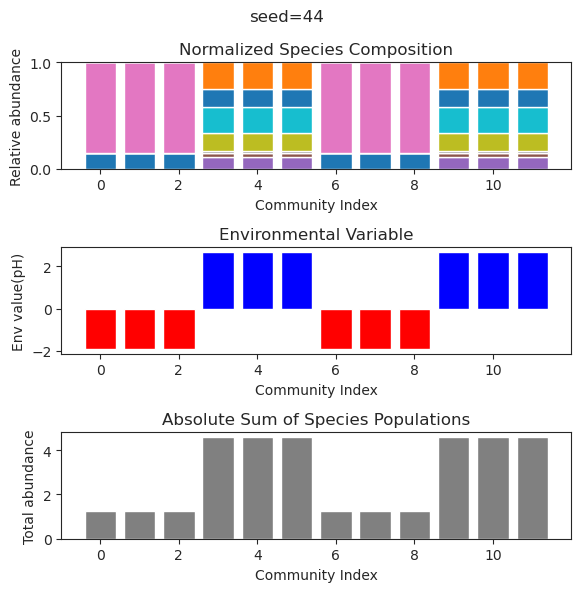

{'species': array([ 1.65415388e-001, -2.61444512e-030,  4.74858776e-100,
        1.36321722e-038,  1.43132933e-026,  4.23041579e-001,
        2.75380819e-019,  9.18862801e-056,  4.97670645e-001,
        3.32591798e-103,  3.57163847e-001,  6.74400436e-059]), 'env': array([-1.35532321])}
{'species': array([ 1.65415388e-001, -1.74342253e-027, -2.15084556e-132,
       -1.98478715e-044, -5.32947971e-029,  4.23041579e-001,
       -6.39398755e-017, -2.36245795e-075,  4.97670645e-001,
       -1.53987253e-136,  3.57163847e-001,  9.47724967e-070]), 'env': array([-1.35532321])}
{'species': array([ 1.65415388e-001,  2.15166058e-043, -1.37899161e-119,
        1.40935721e-051,  2.93640736e-040,  4.23041579e-001,
        2.22985612e-024,  8.97293939e-079,  4.97670645e-001,
       -1.28687072e-123,  3.57163847e-001, -1.63102655e-069]), 'env': array([-1.35532321])}
{'species': array([ 1.65415388e-001, -2.28701841e-026,  1.73139017e-129,
       -1.04292145e-039, -6.50175027e-023,  4.23041579e-001,
     

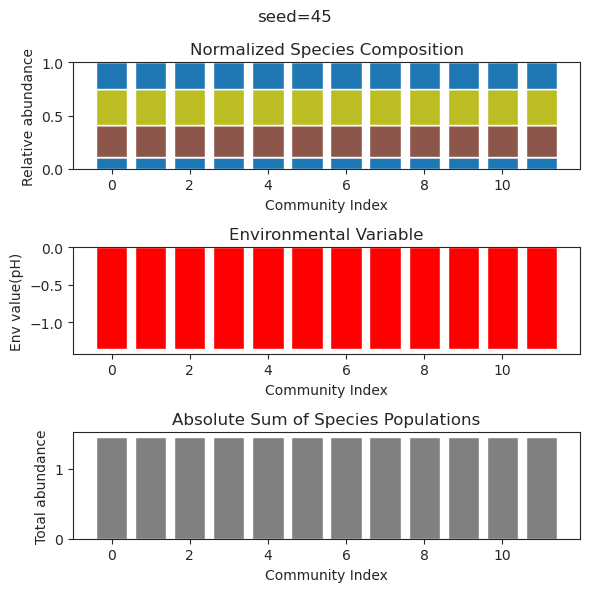

{'species': array([ 1.42735984e-01,  2.24228053e-01, -1.52584418e-24,  6.58798994e-59,
        3.71925201e-57,  2.11329452e-89, -8.05692881e-87, -5.01073246e-93,
        7.84352179e-44,  1.53395552e-62,  4.07810065e-62, -2.33842937e-81]), 'env': array([-3.57458245])}
{'species': array([ 1.42735984e-01,  2.24228053e-01,  3.92949282e-28, -1.34822244e-43,
       -1.55277063e-41,  8.28722865e-57,  2.38301635e-54,  1.51384606e-52,
        3.29362330e-37, -2.61053590e-43, -3.11514331e-45,  4.43825342e-51]), 'env': array([-3.57458245])}
{'species': array([ 1.42735984e-01,  2.24228053e-01, -4.67856504e-28,  5.99783275e-61,
       -4.41818236e-53, -9.40090028e-87, -1.63604229e-82, -1.06382214e-88,
        3.79367539e-42, -1.40118820e-59,  1.18042414e-64, -6.78113866e-78]), 'env': array([-3.57458245])}
{'species': array([ 1.42735984e-01,  2.24228053e-01,  2.36328576e-26, -1.28738910e-46,
        4.61473801e-44, -1.39814890e-60,  2.66283755e-61, -9.53754667e-55,
        3.80651654e-37, -2.7522696

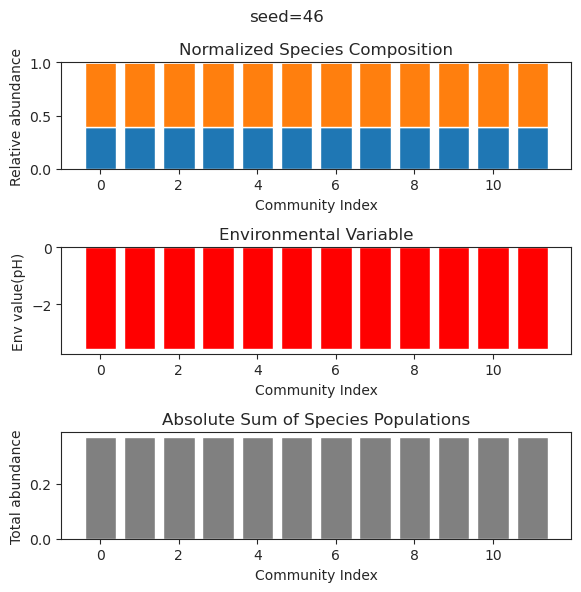

{'species': array([-2.70921514e-49,  2.66745012e-01,  8.56702059e-41,  1.24644904e-45,
        1.25604242e+00, -8.29023172e-51, -3.58830578e-20, -2.02981626e-30,
        2.98131620e-49,  2.10506749e-01,  8.91713419e-44,  1.37274074e-37]), 'env': array([-2.36754003])}
{'species': array([-1.83645196e-54,  2.66745012e-01, -1.28518465e-39,  7.65653129e-42,
        1.25604242e+00, -3.91782353e-51,  5.18162893e-20,  7.06547665e-27,
       -2.60425463e-49,  2.10506749e-01,  4.70852770e-46,  4.81039748e-36]), 'env': array([-2.36754003])}
{'species': array([ 3.65323377e-47,  2.66745012e-01,  2.65049927e-38, -8.15619284e-43,
        1.25604242e+00,  1.38054541e-49, -3.19820233e-19,  9.96187593e-28,
        1.93354164e-46,  2.10506749e-01, -8.47396445e-42,  3.13640898e-35]), 'env': array([-2.36754003])}
{'species': array([ 2.96907414e-48,  2.66745012e-01,  6.18547371e-41, -1.38742584e-39,
        1.25604242e+00, -4.80519190e-51, -1.37162309e-20, -1.21412898e-28,
        1.46903786e-48,  2.1050674

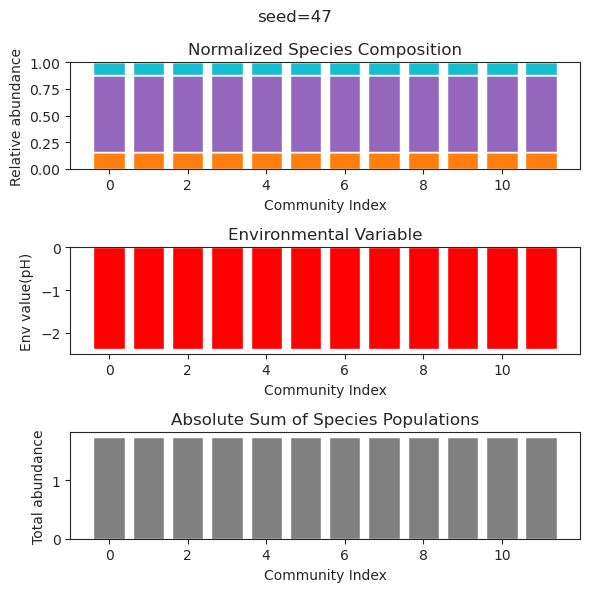

{'species': array([ 7.38946471e-22,  2.18727783e-01, -1.23591662e-45,  1.90655241e-35,
       -3.79960599e-42,  6.28043919e-01,  3.60472631e-01,  3.72134139e-01,
        3.06768169e-21,  9.79936038e-44, -4.25586613e-28,  3.88747026e-28]), 'env': array([-1.38137804])}
{'species': array([ 7.99762140e-22,  2.18727783e-01,  9.89333825e-51,  3.69184577e-38,
       -1.37052354e-45,  6.28043919e-01,  3.60472631e-01,  3.72134139e-01,
        2.60408540e-22,  8.42202109e-47, -6.43641190e-28, -1.14790721e-25]), 'env': array([-1.38137804])}
{'species': array([ 4.43359351e-19,  2.18727783e-01, -4.41475350e-48,  6.65971007e-36,
       -7.72741415e-42,  6.28043919e-01,  3.60472631e-01,  3.72134139e-01,
        8.92376809e-20, -2.76055913e-46, -7.52149694e-27,  2.69601920e-24]), 'env': array([-1.38137804])}
{'species': array([ 5.52469468e-20,  2.18727783e-01, -1.66520964e-48,  4.16804122e-38,
        1.88629535e-45,  6.28043919e-01,  3.60472631e-01,  3.72134139e-01,
        2.96418814e-21,  6.8420812

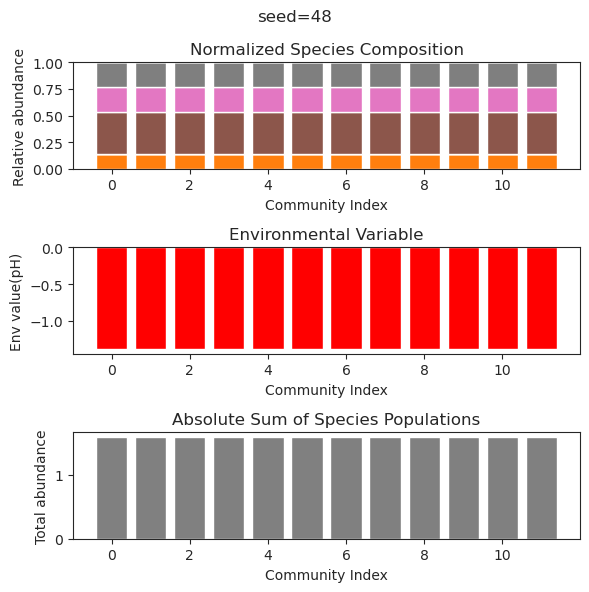

{'species': array([-5.70125622e-43, -3.91067811e-43,  6.94517771e-01,  8.46874185e-48,
        3.42961470e-01,  1.86898927e-01,  6.69659608e-01,  4.98834597e-01,
        5.53739002e-30,  2.65940084e-60,  8.40903658e-54, -1.81321960e-16]), 'env': array([0.4773813])}
{'species': array([ 2.05233327e-36,  1.20252187e-36,  6.94517771e-01,  5.74488921e-41,
        3.42961470e-01,  1.86898927e-01,  6.69659608e-01,  4.98834597e-01,
       -1.37998158e-23,  2.84532090e-55,  2.25875153e-42, -1.66686074e-13]), 'env': array([0.4773813])}
{'species': array([ 4.73729226e-40,  2.94800596e-37,  6.94517771e-01, -7.70534143e-37,
        3.42961470e-01,  1.86898927e-01,  6.69659608e-01,  4.98834597e-01,
       -2.98884285e-22, -4.80277575e-65, -4.53978283e-41,  9.98084826e-17]), 'env': array([0.4773813])}
{'species': array([ 2.51606185e-41,  9.43074933e-44,  6.94517771e-01,  4.04794977e-53,
        3.42961470e-01,  1.86898927e-01,  6.69659608e-01,  4.98834597e-01,
        3.39328130e-37, -1.18782677e-56,

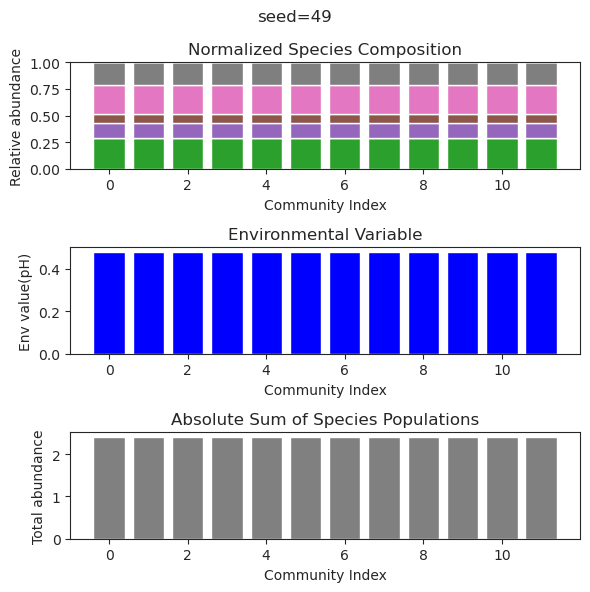

{'species': array([ 1.83611694e-01,  3.93639132e-32, -1.49797773e-72,  2.61670418e-33,
        1.22255632e-01,  1.56963311e-01,  3.75898622e-01, -9.05628398e-34,
        1.44716854e-02,  2.78487981e-01, -1.15001798e-56,  4.29274722e-01]), 'env': array([-1.06024593])}
{'species': array([ 1.83611694e-01,  2.40160802e-35,  8.28832719e-97, -1.01846748e-22,
        1.22255632e-01,  1.56963311e-01,  3.75898622e-01, -6.32662358e-41,
        1.44716854e-02,  2.78487981e-01,  2.35006241e-82,  4.29274722e-01]), 'env': array([-1.06024593])}
{'species': array([ 1.83611694e-01,  9.64224303e-34, -2.42598680e-78,  3.05819723e-24,
        1.22255632e-01,  1.56963311e-01,  3.75898622e-01, -2.96774367e-37,
        1.44716854e-02,  2.78487981e-01,  7.19992855e-61,  4.29274722e-01]), 'env': array([-1.06024593])}
{'species': array([ 1.83611694e-01, -4.03212473e-27,  1.93484639e-59, -1.06989729e-27,
        1.22255632e-01,  1.56963311e-01,  3.75898622e-01, -1.54160992e-30,
        1.44716854e-02,  2.7848798

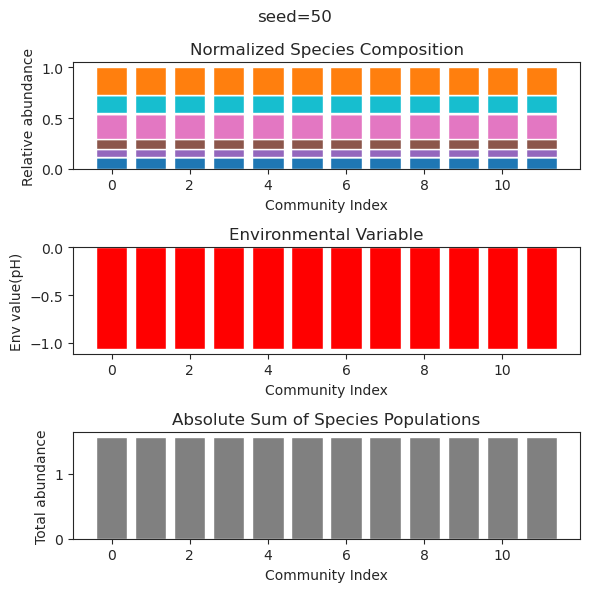

{'species': array([ 2.71522970e-01,  1.00406074e-01, -1.20131957e-92,  2.86437778e-30,
       -5.96755551e-46,  1.59066134e-59,  1.03971369e-59,  2.99520524e-56,
        1.98930571e-32,  7.02917821e-62, -2.16923882e-46,  1.43663179e-94]), 'env': array([-3.61993828])}
{'species': array([ 2.71522970e-01,  1.00406074e-01,  2.68420528e-59,  5.47457723e-27,
        1.37306325e-33,  6.31401556e-38,  2.51744039e-37,  4.77680182e-37,
       -2.21302420e-28,  7.21508350e-40,  7.85702427e-34,  2.91460767e-58]), 'env': array([-3.61993828])}
{'species': array([ 2.71522970e-01,  1.00406074e-01,  4.45034679e-78,  1.55562521e-28,
       -3.30937434e-39,  3.76963882e-51,  5.56683419e-51, -1.63534586e-47,
        2.04614554e-29,  8.32429168e-55, -1.22214676e-41,  2.04517031e-79]), 'env': array([-3.61993828])}
{'species': array([ 2.71522970e-01,  1.00406074e-01, -3.68916990e-75,  1.56515442e-29,
        1.94637222e-39,  3.50752235e-50,  1.30470712e-50,  1.41767261e-48,
       -5.14268265e-32,  9.1491389

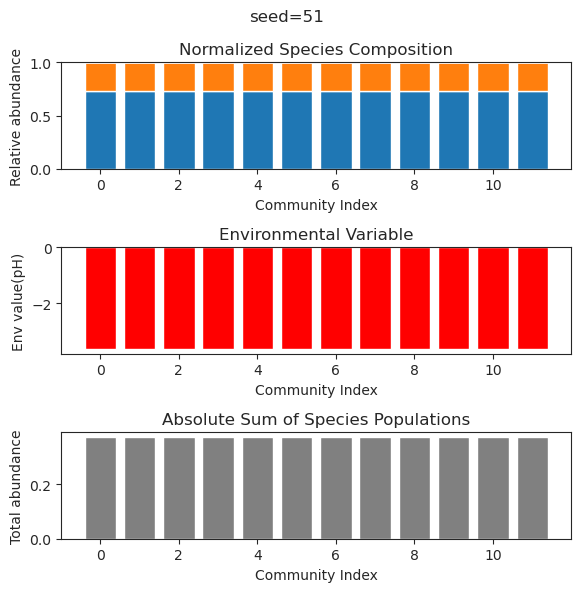

{'species': array([ 3.24313946e-01, -8.28550999e-39,  5.66663239e-54,  1.82702900e-01,
        8.12363503e-01, -7.25456882e-50,  3.26778020e-01, -1.09061561e-53,
        7.61363273e-27, -4.89325206e-36, -1.44341791e-44, -4.28030411e-43]), 'env': array([-2.32622876])}
{'species': array([ 3.24313946e-01, -4.23618028e-56, -3.74957531e-72,  1.82702900e-01,
        8.12363503e-01, -1.55505931e-73,  3.26778020e-01, -5.56714266e-76,
       -4.38135129e-29,  4.49435077e-51, -1.43207885e-52,  2.28860127e-66]), 'env': array([-2.32622876])}
{'species': array([ 3.24313946e-01, -1.77275301e-64,  2.84030422e-80,  1.82702900e-01,
        8.12363503e-01, -1.69248353e-81,  3.26778020e-01,  8.75243456e-84,
       -6.83687400e-30, -6.77330987e-57,  1.13292784e-53, -6.03192401e-73]), 'env': array([-2.32622876])}
{'species': array([ 3.24313946e-01,  1.10220887e-43,  4.70912431e-61,  1.82702900e-01,
        8.12363503e-01, -2.60784166e-59,  3.26778020e-01, -6.10225229e-57,
        4.55304300e-24,  1.1092327

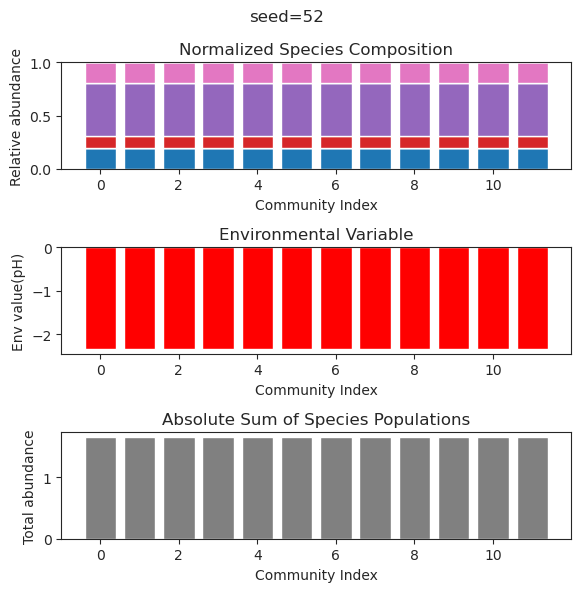

{'species': array([ 1.49434133e-01, -3.66561250e-46, -7.68725264e-47,  6.73742042e-01,
       -7.16715929e-22,  5.51643297e-73, -6.89139553e-22, -6.73507391e-78,
        6.78509122e-01,  7.94296740e-46,  5.90605525e-01, -7.04458552e-23]), 'env': array([-1.04641312])}
{'species': array([ 1.49434133e-01, -9.98072931e-39, -1.23140922e-40,  6.73742042e-01,
        1.67426735e-20,  4.09188209e-57, -8.18975089e-23, -2.99366616e-62,
        6.78509122e-01, -2.45714447e-42,  5.90605525e-01,  3.74301965e-29]), 'env': array([-1.04641312])}
{'species': array([ 1.49434133e-01,  4.51930422e-48,  2.00569617e-49,  6.73742042e-01,
        2.48470507e-19,  1.32576398e-68, -3.95714625e-26,  2.17926086e-76,
        6.78509122e-01, -1.45462442e-43,  5.90605525e-01,  2.59733045e-28]), 'env': array([-1.04641312])}
{'species': array([ 1.49434133e-01, -8.59254314e-42, -1.38162286e-44,  6.73742042e-01,
       -3.75005451e-18,  4.76400977e-62, -2.58383140e-20, -1.04074583e-64,
        6.78509122e-01,  6.5751347

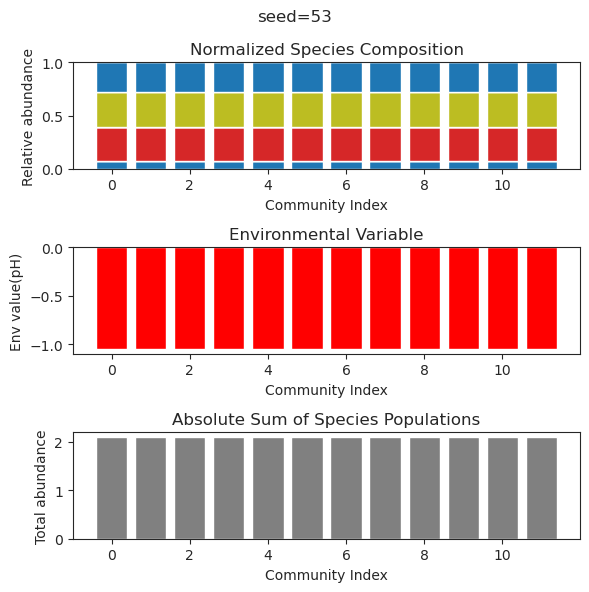

{'species': array([-4.68409762e-43,  2.79648916e-01, -8.99092628e-59, -3.55016982e-15,
       -1.69811967e-37,  4.55161611e-01, -1.24621300e-70, -1.03097112e-40,
       -8.04503656e-67,  1.29529608e-64,  1.15012755e-23,  3.85113997e-01]), 'env': array([-2.71016514])}
{'species': array([ 3.40865870e-54,  2.79648916e-01, -2.36212755e-67, -2.49237713e-16,
        1.36354163e-44,  4.55161611e-01, -3.70698114e-87, -1.97294638e-50,
       -3.79086286e-81,  3.87523761e-80,  5.74291805e-29,  3.85113997e-01]), 'env': array([-2.71016514])}
{'species': array([ 3.38824489e-41,  2.79648916e-01, -3.86105028e-53, -2.07066540e-14,
        6.52554066e-40,  4.55161611e-01,  1.27999720e-30, -2.85920644e-39,
       -4.82277419e-63,  2.79259819e-56, -2.15045946e-20,  3.85113997e-01]), 'env': array([-2.71016514])}
{'species': array([ 1.80534954e-37, -5.07383336e-39, -8.58983747e-85,  7.05570052e-11,
        4.91105759e-01,  1.85633435e-01,  4.21680989e-01,  8.12678826e-01,
        4.98987686e-01,  1.0325476

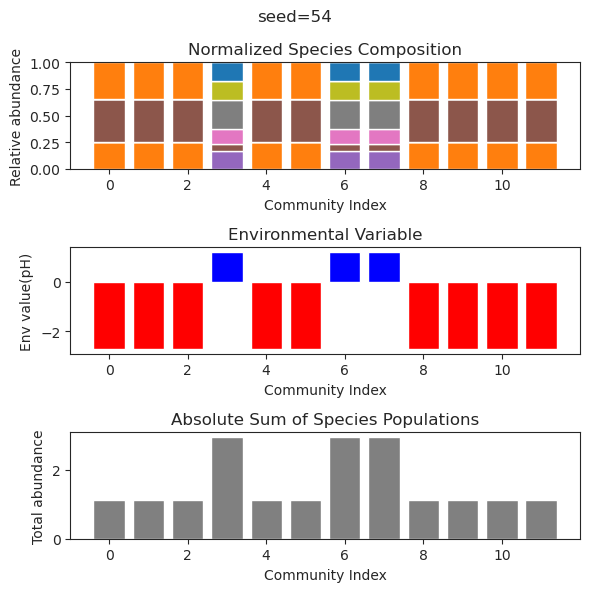

{'species': array([ 1.89845510e-01,  5.66280472e-56,  7.85624941e-01,  5.19391996e-01,
        6.60558185e-53,  3.60965262e-60,  6.36073784e-55, -5.19518826e-42,
        2.35601374e-01,  7.21281663e-32,  1.17624347e-59,  9.10761368e-49]), 'env': array([-1.39265398])}
{'species': array([ 1.89845510e-01, -1.12298625e-58,  7.85624941e-01,  5.19391996e-01,
       -3.98600321e-54,  4.11600551e-60, -2.41136592e-57, -4.41496974e-43,
        2.35601374e-01,  1.57457504e-32, -1.43058204e-58,  2.08255839e-52]), 'env': array([-1.39265398])}
{'species': array([ 1.89845510e-01,  1.02652681e-56,  7.85624941e-01,  5.19391996e-01,
       -1.23043749e-53,  2.40262451e-57, -3.25827571e-54, -3.24273919e-40,
        2.35601374e-01, -6.76721973e-32,  2.62481354e-58,  2.81859437e-44]), 'env': array([-1.39265398])}
{'species': array([ 1.89845510e-01, -1.82869818e-54,  7.85624941e-01,  5.19391996e-01,
        5.76861904e-50,  1.49878242e-56,  1.42184263e-53,  5.38147349e-42,
        2.35601374e-01,  4.7312796

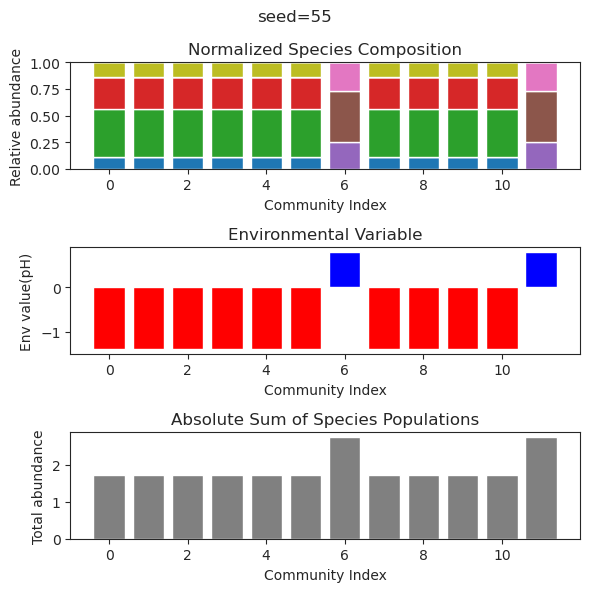

{'species': array([ 2.05647123e-01, -7.67229426e-44, -3.14572735e-24,  2.28088839e-19,
        6.17838615e-01, -4.43888333e-59,  8.37945295e-01,  8.86994899e-19,
        3.21417343e-24,  2.42727266e-44,  1.59225779e-50, -2.12798400e-30]), 'env': array([-1.83838899])}
{'species': array([ 2.05647123e-01, -1.30097092e-42, -6.98128978e-30, -2.80788785e-20,
        6.17838615e-01,  5.30339108e-61,  8.37945295e-01, -4.15954182e-20,
       -1.57178012e-23, -4.03834602e-48,  4.52997563e-52, -4.04587444e-30]), 'env': array([-1.83838899])}
{'species': array([ 2.05647123e-01,  1.97209948e-38,  2.92880186e-24, -8.51501981e-21,
        6.17838615e-01,  1.32464416e-53,  8.37945295e-01, -1.29850634e-19,
       -6.34097851e-21,  5.47681226e-36, -1.53500905e-42,  2.25168949e-27]), 'env': array([-1.83838899])}
{'species': array([ 2.05647123e-01,  6.62323705e-46,  1.31392120e-30, -1.60558008e-21,
        6.17838615e-01, -1.28637391e-64,  8.37945295e-01, -1.11330520e-20,
       -3.50151303e-24, -1.1565225

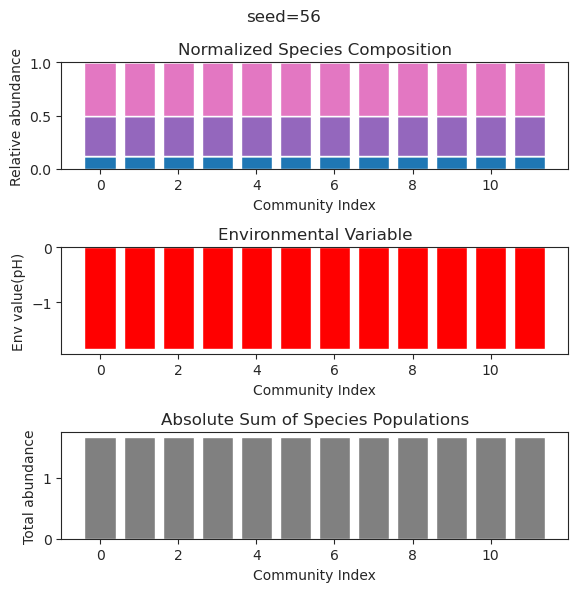

{'species': array([-2.40318279e-021,  3.63361845e-001, -3.11139587e-110,
        1.16150293e-001,  4.73166312e-036, -5.71365966e-115,
        1.60005646e-026, -7.12610855e-106,  1.26608549e-059,
        1.00710839e+000, -5.28235187e-068, -3.41613644e-112]), 'env': array([-2.66065866])}
{'species': array([-5.02975817e-29,  3.63361845e-01,  4.08834918e-67,  1.16150293e-01,
       -1.83899633e-38, -9.34789036e-71, -9.03837427e-32,  2.17921286e-71,
        1.95362015e-47,  1.00710839e+00, -7.83286995e-52,  1.14376972e-67]), 'env': array([-2.66065866])}
{'species': array([ 2.12252842e-23,  3.63361845e-01,  2.27122595e-74,  1.16150293e-01,
       -3.27389882e-35,  9.61080294e-73,  1.85137097e-22,  3.03706153e-83,
        3.49446441e-45,  1.00710839e+00,  3.31713431e-54,  2.00458483e-71]), 'env': array([-2.66065866])}
{'species': array([ 6.64377368e-21,  3.63361845e-01,  2.41226115e-85,  1.16150293e-01,
        3.31874958e-41,  1.01775370e-83, -1.18011889e-28, -1.45435794e-89,
       -6.94132

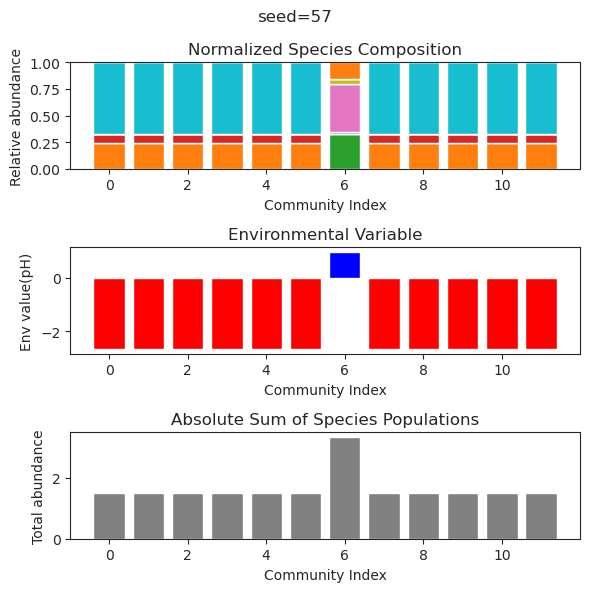

{'species': array([ 1.08581536e-25,  2.59634563e-01, -1.44356620e-47,  3.44924637e-35,
       -2.22887877e-45,  7.01260954e-27, -1.80178574e-43, -1.87358944e-40,
        7.86565487e-01,  8.49587982e-27,  1.64764166e-45,  4.03153186e-01]), 'env': array([-1.98461469])}
{'species': array([-3.83544010e-31,  2.59634563e-01, -6.45013780e-53,  2.15274137e-46,
        5.14836360e-56,  1.35637438e-24, -1.54017001e-54, -5.16788944e-48,
        7.86565487e-01, -2.86353832e-26, -2.56145393e-53,  4.03153186e-01]), 'env': array([-1.98461469])}
{'species': array([ 2.25981924e-85, -9.85731465e-85,  4.60259863e+00,  2.91146366e-68,
        4.91263588e-85,  2.95812250e+00,  6.60069441e-60, -1.92738986e-59,
        1.54742018e-58,  3.08589618e+00,  2.38901811e-01,  2.15993198e-82]), 'env': array([6.86816846])}
{'species': array([-4.82099234e-23,  2.59634563e-01,  1.53854243e-38, -2.58858669e-32,
       -1.89039205e-40,  2.90121833e-28, -7.22691266e-36,  4.17382380e-31,
        7.86565487e-01, -4.98798914

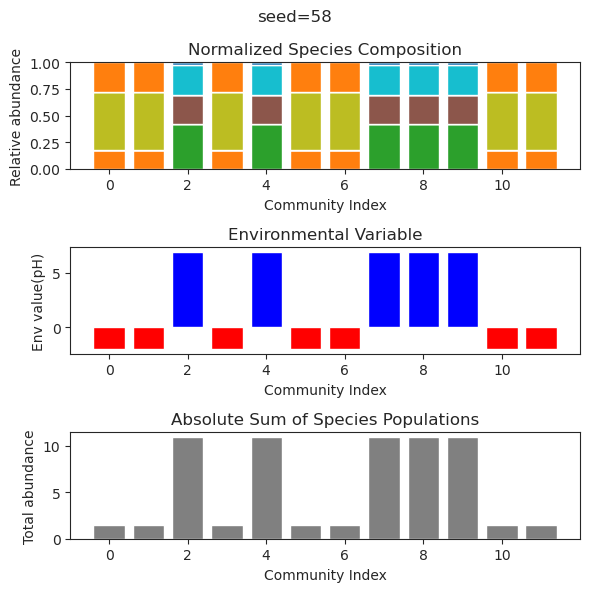

{'species': array([-1.55487565e-32,  2.50610839e-01,  6.88994671e-02,  8.09344565e-51,
        3.69640607e-48, -1.20323357e-56,  2.21425479e-45,  3.97678472e-01,
        5.00151071e-26,  6.76860949e-01, -3.13208392e-43, -2.34317834e-62]), 'env': array([-2.03466633])}
{'species': array([ 5.26031026e-32,  2.50610839e-01,  6.88994671e-02, -6.37049511e-48,
       -6.42347095e-38, -2.15124745e-54,  3.17074550e-43,  3.97678472e-01,
       -5.71317148e-24,  6.76860949e-01, -1.61235624e-35, -1.12889685e-58]), 'env': array([-2.03466633])}
{'species': array([-6.87513160e-036,  2.50610839e-001,  6.88994671e-002,
        4.15294878e-083, -1.52205944e-057, -1.49319353e-102,
       -3.39306023e-072,  3.97678472e-001, -4.77884722e-027,
        6.76860949e-001,  1.05816908e-054, -3.18647008e-089]), 'env': array([-2.03466633])}
{'species': array([-1.35305198e-29,  2.50610839e-01,  6.88994671e-02, -2.39135848e-47,
        4.50224794e-42, -6.80504320e-56,  1.57921437e-45,  3.97678472e-01,
        1.67081

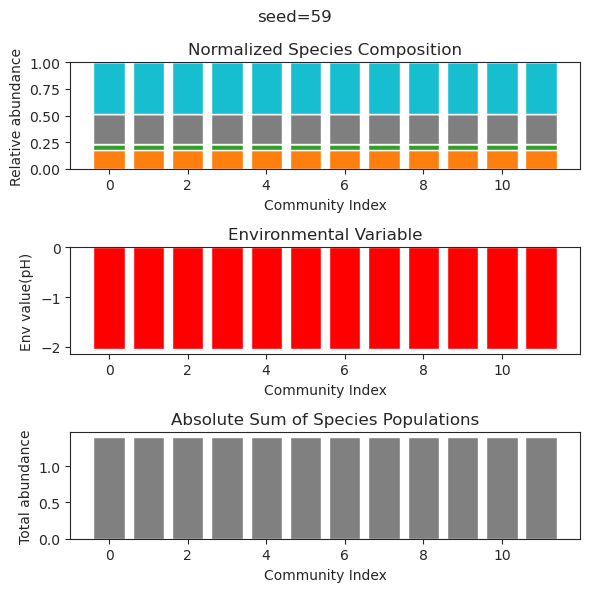

{'species': array([ 1.24652952e-01,  2.58714867e-01,  5.53900284e-01,  1.27314955e-28,
        3.91401255e-48, -2.09694400e-19,  4.26182769e-42,  6.08912939e-46,
       -1.84177942e-35,  5.02857012e-01,  3.05428950e-51,  4.06941544e-49]), 'env': array([-2.92960594])}
{'species': array([ 1.24652952e-01,  2.58714867e-01,  5.53900284e-01,  1.22277228e-27,
       -1.66061771e-44,  5.74636238e-19,  8.42396260e-39,  2.55279985e-43,
        3.35182461e-31,  5.02857012e-01, -1.05772914e-49, -3.38366971e-47]), 'env': array([-2.92960594])}
{'species': array([ 1.24652952e-01,  2.58714867e-01,  5.53900284e-01,  8.82152037e-28,
       -2.60137675e-44,  2.83799406e-19, -1.55427576e-37,  1.86504830e-42,
       -6.34730296e-32,  5.02857012e-01,  1.14764973e-50, -5.54212473e-46]), 'env': array([-2.92960594])}
{'species': array([ 1.24652952e-01,  2.58714867e-01,  5.53900284e-01, -4.61787209e-30,
        1.29747658e-47,  2.72111573e-22, -9.84174792e-42,  9.93150068e-45,
        5.29076049e-33,  5.0285701

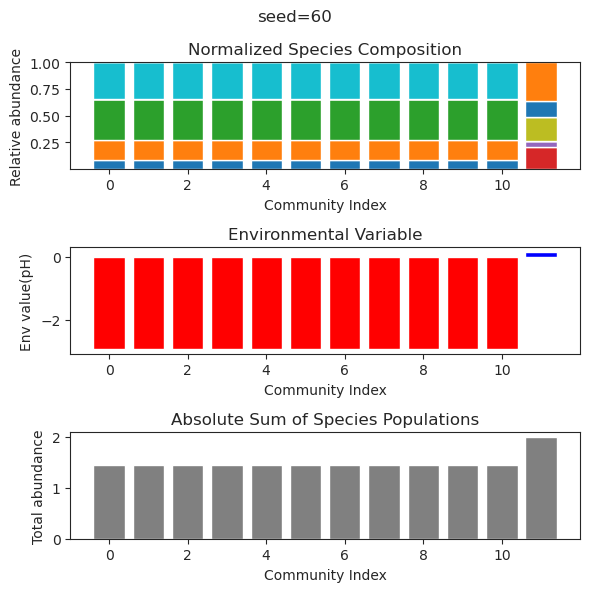

{'species': array([ 7.31579985e-02, -1.07240505e-59, -1.03488136e-25,  4.17369582e-01,
        4.34891241e-01,  7.58058592e-02, -4.82183120e-17, -4.81713997e-72,
        4.57216927e-01,  1.32902744e-01, -6.46391390e-60,  1.15002850e-01]), 'env': array([-0.28995595])}
{'species': array([ 7.31579985e-02,  5.71451025e-52,  4.18424627e-32,  4.17369582e-01,
        4.34891241e-01,  7.58058592e-02,  3.91541435e-22, -3.71471727e-67,
        4.57216927e-01,  1.32902744e-01,  4.18953954e-55,  1.15002850e-01]), 'env': array([-0.28995595])}
{'species': array([ 1.33907715e-089,  6.28210147e-033,  5.42264459e-001,
        1.11194987e-016,  7.93225033e-001,  4.99930126e-002,
        4.60080434e-062,  1.27853706e-001,  4.18937496e-001,
        1.55359911e-026, -5.19199123e-073, -1.36945949e-115]), 'env': array([0.46452164])}
{'species': array([ 7.31579985e-02, -1.47543560e-56, -2.44464743e-24,  4.17369582e-01,
        4.34891241e-01,  7.58058592e-02,  3.00470983e-17, -1.07928393e-66,
        4.572169

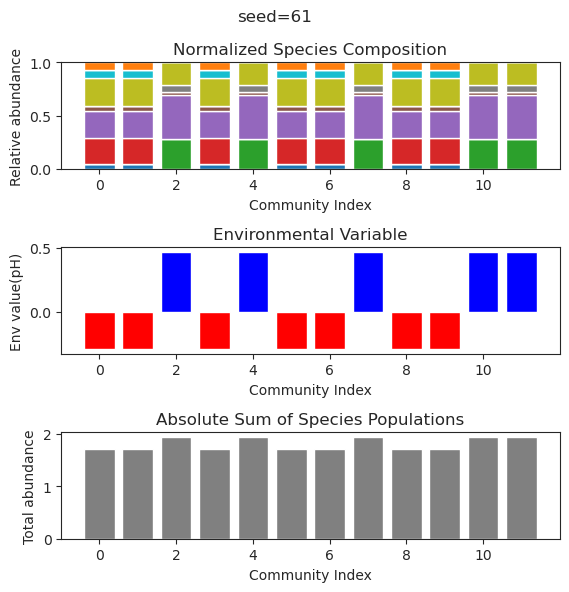

{'species': array([ 9.17053020e-32,  2.00656323e-01,  5.06644839e-01, -2.04866865e-41,
        5.11725003e-01,  6.23498393e-60,  2.19647967e-01, -8.67559025e-58,
       -2.26185341e-40, -4.87169905e-29,  9.09122633e-56,  1.39561452e-51]), 'env': array([-1.39995615])}
{'species': array([ 5.33310334e-34,  2.00656323e-01,  5.06644839e-01,  1.08572278e-39,
        5.11725003e-01, -1.05519829e-58,  2.19647967e-01,  5.21684230e-61,
       -4.44736745e-39, -1.25791817e-32, -5.35893018e-55, -3.34709638e-54]), 'env': array([-1.39995615])}
{'species': array([ 1.43898133e-64, -8.60800694e-31,  3.40237724e-77,  1.20463001e+00,
       -2.73052874e-44,  7.51650002e-01, -1.13876843e-54,  7.11307186e-49,
        1.48038319e+00, -7.92693502e-31,  2.40720931e+00,  7.21773591e-01]), 'env': array([2.90109328])}
{'species': array([-9.15045668e-30,  2.00656323e-01,  5.06644839e-01,  2.42452713e-34,
        5.11725003e-01,  5.74046502e-44,  2.19647967e-01, -1.19407739e-45,
       -1.19392929e-37,  2.26113811

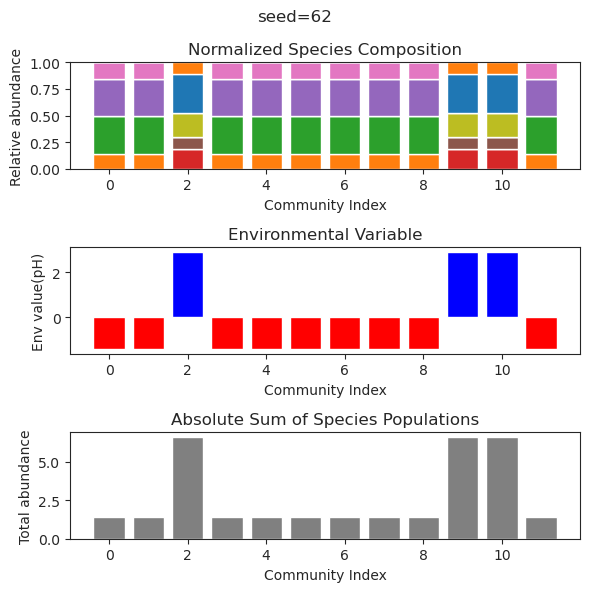

{'species': array([ 1.42025653e-01, -8.10862894e-70,  1.41481884e-63,  8.04843223e-01,
        2.40129056e-71,  1.63126232e-83,  3.24575655e-01, -2.65728430e-59,
       -3.44405534e-34,  3.19902540e-01, -1.76703139e-68,  1.84272450e-01]), 'env': array([-0.98136654])}
{'species': array([ 1.42025653e-01,  2.23826661e-61,  5.62615543e-58,  8.04843223e-01,
       -3.88041143e-61, -1.07888187e-72,  3.24575655e-01,  1.33416733e-54,
       -2.42791102e-29,  3.19902540e-01,  1.90420660e-60,  1.84272450e-01]), 'env': array([-0.98136654])}
{'species': array([ 1.42025653e-01, -2.51344453e-69,  4.20678332e-62,  8.04843223e-01,
        2.23944296e-67, -3.81843579e-94,  3.24575655e-01,  1.46036818e-61,
        2.62451786e-33,  3.19902540e-01,  1.25009077e-71,  1.84272450e-01]), 'env': array([-0.98136654])}
{'species': array([ 1.42025653e-01,  5.82992155e-35, -6.77012170e-31,  8.04843223e-01,
       -1.96174756e-35,  2.03136714e-39,  3.24575655e-01,  6.70878619e-27,
       -2.07460808e-19,  3.1990254

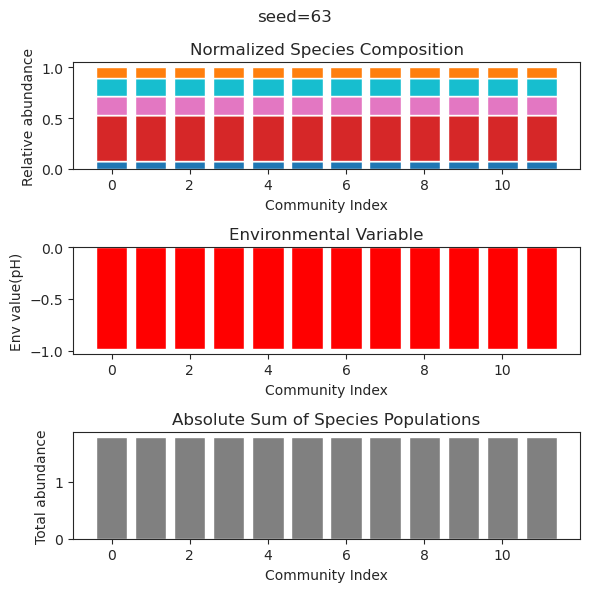

{'species': array([ 1.91595882e-01, -1.00743989e-24, -1.10240324e-70,  6.31565176e-21,
       -4.04052580e-47,  4.75372120e-01,  5.79578592e-01,  2.58930094e-72,
        3.20120327e-01,  2.21743661e-60,  2.47603972e-27, -1.46394378e-18]), 'env': array([-1.54369621])}
{'species': array([ 1.91595882e-01, -2.23044193e-23, -8.76156723e-71, -9.98744011e-19,
       -3.92366359e-68,  4.75372120e-01,  5.79578592e-01, -2.90590603e-66,
        3.20120327e-01, -1.24277087e-66, -2.36627803e-28, -1.16699442e-16]), 'env': array([-1.54369621])}
{'species': array([ 1.91595882e-01,  4.05927667e-19,  8.38018037e-63, -2.39790490e-16,
       -1.82028335e-63,  4.75372120e-01,  5.79578592e-01,  3.17660286e-59,
        3.20120327e-01,  5.33878165e-58, -1.30281270e-23, -1.01807194e-14]), 'env': array([-1.54369621])}
{'species': array([ 1.91595882e-001, -9.78201045e-021,  1.39917164e-106,
       -6.46785908e-017, -4.00035789e-109,  4.75372120e-001,
        5.79578592e-001, -7.76879569e-095,  3.20120327e-001,
 

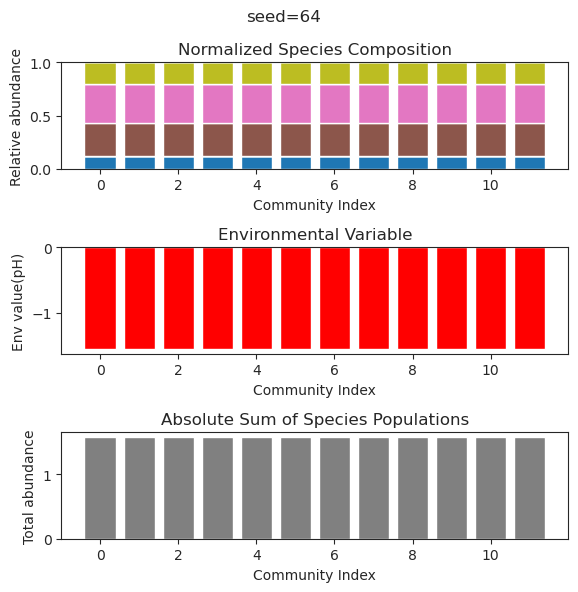

{'species': array([-1.34224116e-36,  2.16196025e-01, -1.81210804e-21,  3.50017936e-01,
       -5.82028759e-35,  7.46499102e-32,  1.21686783e+00,  3.97612131e-41,
        2.49494925e-33, -2.27004295e-52, -1.68320959e-53,  1.74670254e-40]), 'env': array([-2.11688393])}
{'species': array([ 6.95701205e-36,  2.16196025e-01, -1.13330931e-19,  3.50017936e-01,
       -3.27490819e-28,  8.43560146e-28,  1.21686783e+00,  1.56561470e-32,
       -2.58194091e-28,  7.64763792e-46,  8.60373009e-50, -7.47669919e-33]), 'env': array([-2.11688393])}
{'species': array([-3.70465243e-34,  2.16196025e-01, -2.93757538e-20,  3.50017936e-01,
        9.07509131e-27,  3.50058944e-25,  1.21686783e+00,  1.14397736e-31,
        2.10180520e-27, -1.94637442e-45, -4.92426770e-48, -3.61510749e-33]), 'env': array([-2.11688393])}
{'species': array([-6.01125956e-33,  2.16196025e-01,  2.03207741e-20,  3.50017936e-01,
        3.70238038e-36,  2.89159177e-30,  1.21686783e+00, -8.59492757e-35,
        5.34900789e-34,  2.2620443

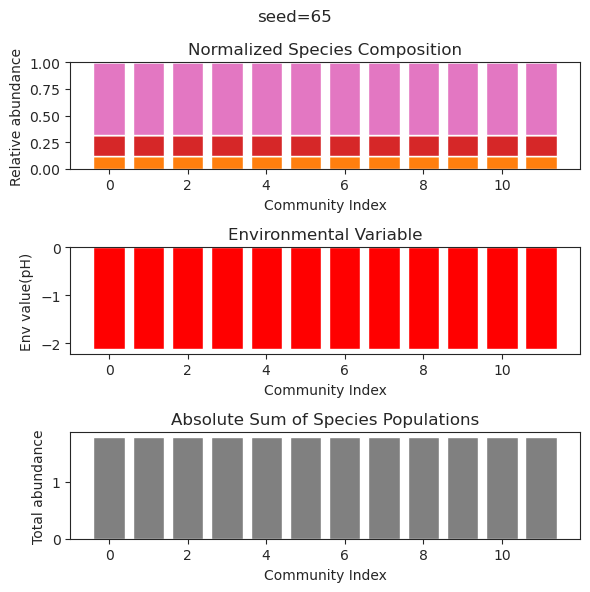

{'species': array([-2.70560417e-039,  0.00000000e+000,  3.31323314e+000,
        4.90107730e-076,  2.69957716e+000, -1.35991906e-281,
        5.75724079e-279, -5.90470986e-104,  2.82127590e-001,
        0.00000000e+000, -1.86329270e-059, -2.42913886e-089]), 'env': array([2.56084017])}
{'species': array([-2.70560417e-039,  0.00000000e+000,  3.31323314e+000,
        4.90107730e-076,  2.69957716e+000, -1.35991906e-281,
        5.75724079e-279, -5.90470986e-104,  2.82127590e-001,
        0.00000000e+000, -1.86329270e-059, -2.42913886e-089]), 'env': array([2.56084017])}
{'species': array([-2.70560417e-039,  0.00000000e+000,  3.31323314e+000,
        4.90107730e-076,  2.69957716e+000, -1.35991906e-281,
        5.75724079e-279, -5.90470986e-104,  2.82127590e-001,
        0.00000000e+000, -1.86329270e-059, -2.42913886e-089]), 'env': array([2.56084017])}
{'species': array([-2.70560417e-039,  0.00000000e+000,  3.31323314e+000,
        4.90107730e-076,  2.69957716e+000, -1.35991906e-281,
        

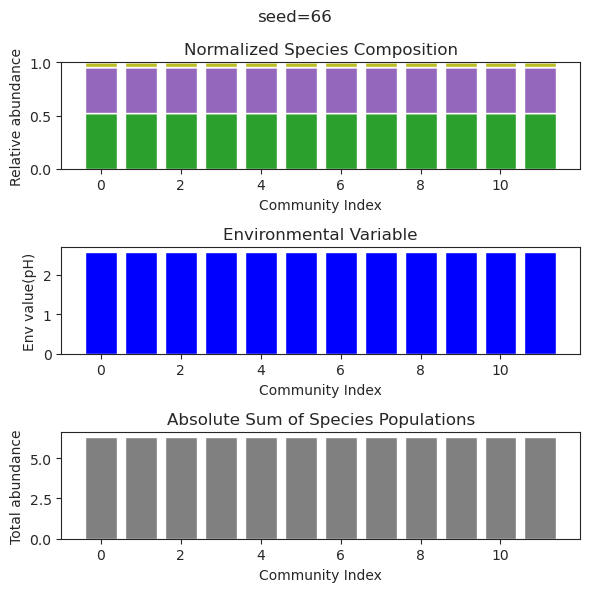

{'species': array([ 1.31416750e-056,  1.49881745e-001,  9.64459817e-058,
       -1.49632156e-196,  2.54420824e-003, -2.10426379e-098,
       -6.92073554e-059,  5.95152641e-001, -2.71822500e-047,
        7.63113429e-047,  1.65298345e-001,  7.37796168e-001]), 'env': array([-0.73797057])}
{'species': array([-4.23910290e-062,  1.49881899e-001, -7.93671912e-197,
       -5.64246851e-190,  2.53087983e-003,  3.07503515e-103,
        5.76468236e-078,  5.95154090e-001, -2.44723946e-067,
       -1.72423278e-104,  1.65301447e-001,  7.37797727e-001]), 'env': array([-0.73797367])}
{'species': array([-3.50017965e-047,  1.49881811e-001, -1.12565018e-181,
       -2.02166744e-171,  2.53851012e-003, -8.24233531e-061,
        4.78313325e-061,  5.95153260e-001,  6.58703858e-105,
       -6.09902637e-050,  1.65299671e-001,  7.37796834e-001]), 'env': array([-0.73797189])}
{'species': array([ 2.87883702e-070,  1.49881742e-001,  2.10312851e-181,
       -2.74148602e-176,  2.54453968e-003,  1.38161796e-069,
     

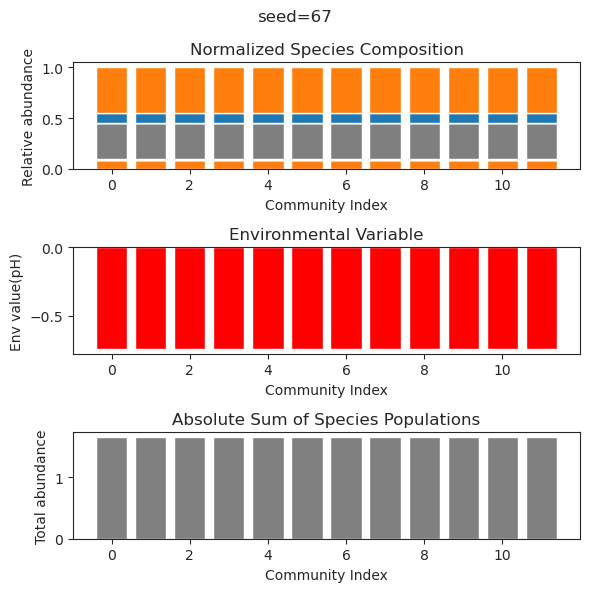

{'species': array([ 3.45451819e-062,  1.81557171e-001,  7.11007781e-002,
        3.82782940e-001, -5.53891234e-122,  2.70175013e-084,
        3.37615909e-001,  5.27482209e-023, -1.97509197e-051,
        7.02635036e-001,  4.35343086e-023, -1.64207912e-122]), 'env': array([-0.99263947])}
{'species': array([-2.27078707e-061,  1.81557171e-001,  7.11007781e-002,
        3.82782940e-001, -2.50315539e-126,  6.37982329e-086,
        3.37615909e-001,  2.50758729e-023, -1.96328044e-051,
        7.02635036e-001,  1.79874626e-024, -2.02493301e-126]), 'env': array([-0.99263947])}
{'species': array([-2.17085261e-060,  1.81557171e-001,  7.11007781e-002,
        3.82782940e-001,  4.93297101e-114, -6.68175020e-081,
        3.37615909e-001,  1.39373971e-021,  1.71401614e-049,
        7.02635036e-001,  1.50698408e-022,  4.91014238e-115]), 'env': array([-0.99263947])}
{'species': array([-9.31398169e-059,  1.81557171e-001,  7.11007781e-002,
        3.82782940e-001,  1.40061557e-110,  1.11102308e-081,
     

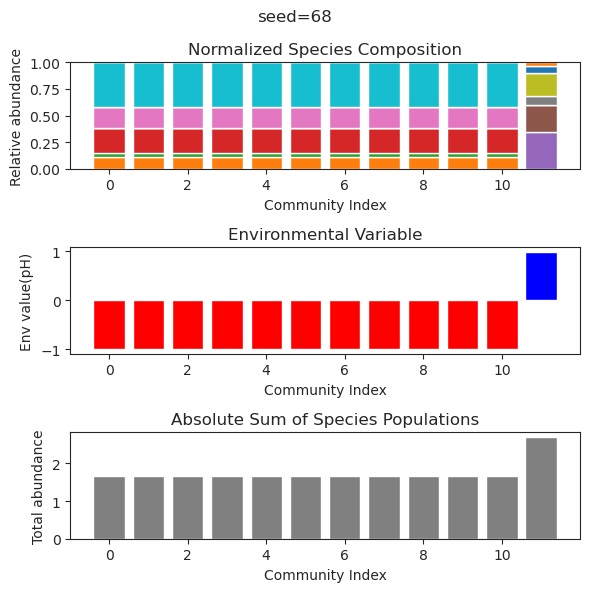

{'species': array([4.63205229e-002, 9.55941928e-002, 6.13410095e-001, 3.65329781e-001,
       6.10003514e-002, 1.71127145e-033, 7.16431768e-109, 2.02014306e-001,
       2.25753074e-002, 3.34802033e-152, 2.59027890e-001, 4.31955963e-166]), 'env': array([-0.61015344])}
{'species': array([ 4.63205251e-002,  9.55941859e-002,  6.13410111e-001,
        3.65329794e-001,  6.10003356e-002,  1.90966628e-029,
       -2.63778705e-084,  2.02014261e-001,  2.25753322e-002,
        7.18503037e-123,  2.59027875e-001,  5.86705626e-176]), 'env': array([-0.61015345])}
{'species': array([ 1.92132499e-01,  2.03027226e-29,  8.64779268e-01,  4.06395184e-32,
        1.62219476e-01,  5.22619559e-02,  5.84052938e-29,  7.16233935e-62,
        9.58090549e-04,  8.47282266e-30,  1.51182592e-01, -6.08732759e-27]), 'env': array([-1.44615817])}
{'species': array([-7.93571950e-42, -2.51760820e-62,  4.54103188e-82,  1.12386289e+00,
        4.43386655e-73, -9.67528822e-56,  1.06646459e+00,  1.71755071e+00,
        4.96234

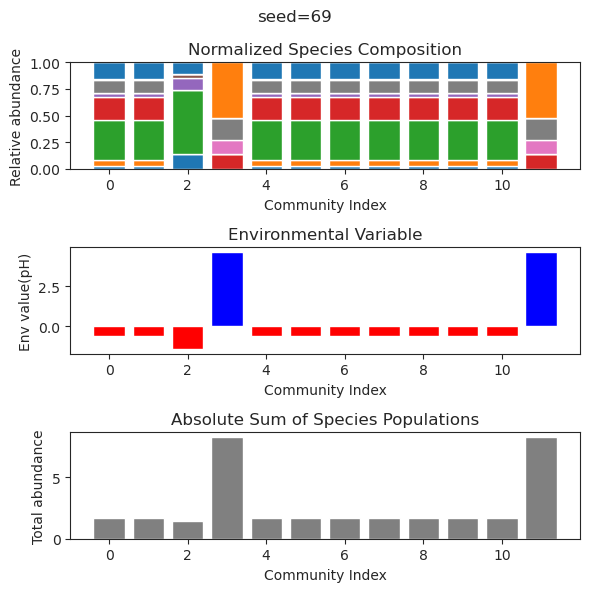

{'species': array([ 1.10512569e-39,  2.75404114e-01,  4.64327713e-59,  8.45639651e-42,
       -1.26982948e-31,  1.15084901e-01,  5.16109152e-64,  1.41815249e+00,
        3.22745341e-57,  3.57615832e-64, -8.57427250e-67, -5.14823683e-29]), 'env': array([-2.62018265])}
{'species': array([ 8.03007862e-35,  2.75404114e-01, -5.01086097e-45,  1.02208295e-34,
        6.51438601e-28,  1.15084901e-01, -8.30895764e-44,  1.41815249e+00,
       -1.05510113e-44, -1.74119710e-45, -1.85109085e-47,  1.65072895e-28]), 'env': array([-2.62018265])}
{'species': array([-3.59271309e-29,  2.75404114e-01, -1.13859831e-38, -6.79115118e-28,
       -6.15610826e-25,  1.15084901e-01,  1.53706094e-38,  1.41815249e+00,
       -4.32653340e-39, -3.65900869e-38, -6.26715089e-40, -5.37711703e-23]), 'env': array([-2.62018265])}
{'species': array([-9.43385454e-37,  2.75404114e-01, -2.17967476e-55, -1.88612745e-35,
       -7.43974554e-27,  1.15084901e-01, -1.03395392e-51,  1.41815249e+00,
       -8.10051597e-51, -5.3535299

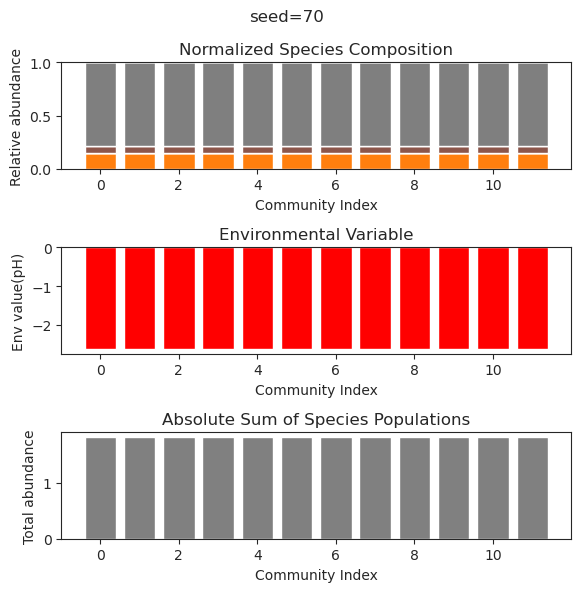

{'species': array([-8.76438681e-132,  1.36719415e-001,  2.28990281e-001,
        2.22530238e-133,  7.68295385e-043, -3.74069297e-110,
        3.96797926e-001,  3.99785176e-001, -1.48374659e-108,
       -5.99103994e-063, -3.76824622e-130,  5.18140256e-001]), 'env': array([-0.98371936])}
{'species': array([ 4.22006666e-134,  1.36719415e-001,  2.28990281e-001,
        6.28756571e-133,  6.94877219e-043, -7.07775823e-112,
        3.96797926e-001,  3.99785176e-001,  9.20492887e-107,
       -4.69384605e-064, -3.10645777e-130,  5.18140256e-001]), 'env': array([-0.98371936])}
{'species': array([-5.20176358e-135,  1.36719415e-001,  2.28990281e-001,
        6.45333293e-130, -1.07242033e-042, -2.69526772e-106,
        3.96797926e-001,  3.99785176e-001,  8.87401095e-105,
        1.61603836e-063, -2.71564479e-131,  5.18140256e-001]), 'env': array([-0.98371936])}
{'species': array([-2.69001497e-125,  1.36719415e-001,  2.28990281e-001,
       -3.46325207e-116,  1.73638039e-039, -6.11973083e-100,
     

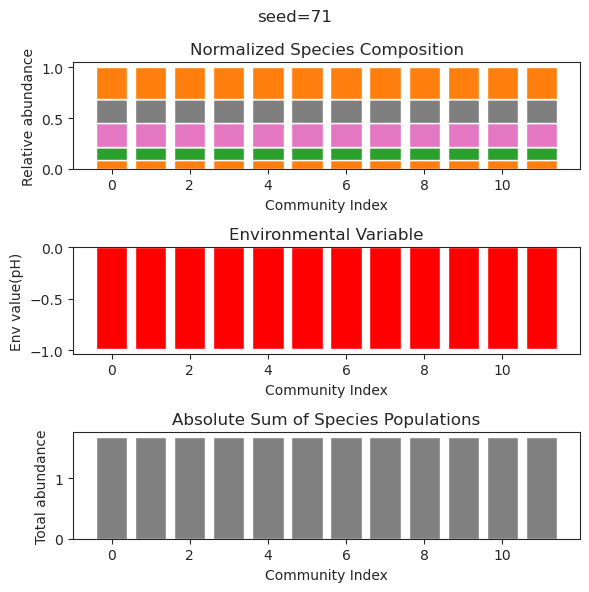

{'species': array([ 1.19652153e-01,  1.70921313e-03, -1.03888261e-22,  8.56776706e-38,
       -1.74913404e-83, -6.11870062e-28,  7.44855630e-01,  2.07150388e-46,
        6.47288546e-01,  1.59519968e-01, -3.17769852e-77, -2.00627358e-64]), 'env': array([-1.11368369])}
{'species': array([ 1.19652332e-01,  1.70893753e-03, -3.77504237e-15, -7.81396593e-30,
       -7.77385457e-26, -1.02141116e-34,  7.44855560e-01,  9.36254575e-39,
        6.47287992e-01,  1.59520606e-01,  1.09865118e-50,  1.13335227e-33]), 'env': array([-1.1136826])}
{'species': array([ 1.19652951e-01,  1.70798861e-03, -5.62316067e-26,  5.13427054e-80,
        1.09665231e-74, -8.82325555e-61,  7.44855318e-01,  5.16151894e-35,
        6.47286084e-01,  1.59522800e-01, -2.10309408e-64,  5.41566182e-53]), 'env': array([-1.11367886])}
{'species': array([ 1.19652932e-01,  1.70801680e-03,  4.26727306e-28,  3.25225448e-56,
        8.51620245e-57, -1.40764441e-45,  7.44855325e-01,  2.45282103e-34,
        6.47286140e-01,  1.59522735

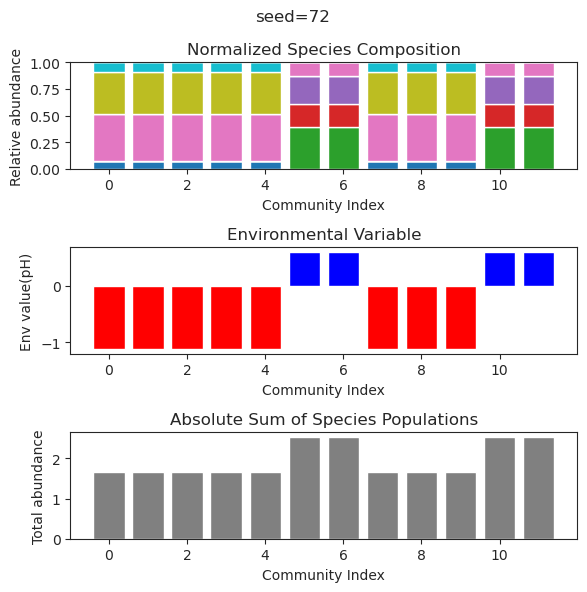

{'species': array([ 7.06399578e-002, -6.42243013e-092, -1.85637969e-057,
        6.21699179e-001, -6.28383225e-176,  5.46204639e-001,
       -1.44200616e-069,  3.30922000e-126,  2.42184216e-001,
        2.87528502e-001,  2.35954298e-001,  7.30238245e-100]), 'env': array([-0.30522734])}
{'species': array([ 7.06399578e-002, -6.09951096e-076, -2.10751686e-041,
        6.21699179e-001,  9.29642394e-155,  5.46204639e-001,
        4.58276919e-051, -3.78960575e-112,  2.42184216e-001,
        2.87528502e-001,  2.35954298e-001, -9.79139162e-086]), 'env': array([-0.30522734])}
{'species': array([ 7.06399578e-002,  1.01930179e-072, -2.53478869e-041,
        6.21699179e-001, -1.30227915e-149,  5.46204639e-001,
       -3.05826922e-051, -2.20529281e-109,  2.42184216e-001,
        2.87528502e-001,  2.35954298e-001,  2.17527339e-087]), 'env': array([-0.30522734])}
{'species': array([ 7.06399578e-002,  1.12686381e-075, -6.03134629e-039,
        6.21699179e-001,  1.59617478e-156,  5.46204639e-001,
     

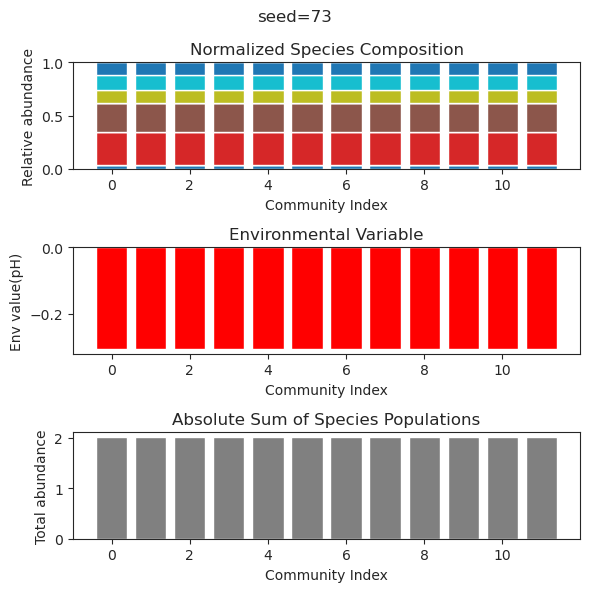

{'species': array([ 2.25448675e-22,  2.52574786e-01,  1.83807389e-01,  8.65403599e-01,
        2.68806484e-39, -3.68828684e-51,  2.13369031e-01, -6.96105686e-30,
       -4.12231981e-45,  5.64725350e-01,  7.71535432e-34, -2.43837556e-38]), 'env': array([-1.47334525])}
{'species': array([-1.70606531e-27,  2.52574786e-01,  1.83807389e-01,  8.65403599e-01,
        1.69079229e-40,  8.32606043e-48,  2.13369031e-01, -2.52180116e-29,
        5.28457758e-43,  5.64725350e-01,  2.64582372e-32,  1.42094543e-35]), 'env': array([-1.47334525])}
{'species': array([ 8.19111750e-25,  2.52574786e-01,  1.83807389e-01,  8.65403599e-01,
        3.41850637e-43, -2.10061056e-45,  2.13369031e-01,  7.07857074e-30,
        1.03333956e-43,  5.64725350e-01, -7.63804646e-35, -6.09865234e-35]), 'env': array([-1.47334525])}
{'species': array([ 3.83770207e-22,  2.52574786e-01,  1.83807389e-01,  8.65403599e-01,
        1.19236766e-40, -3.89682419e-50,  2.13369031e-01, -2.59567375e-29,
       -1.78163982e-46,  5.6472535

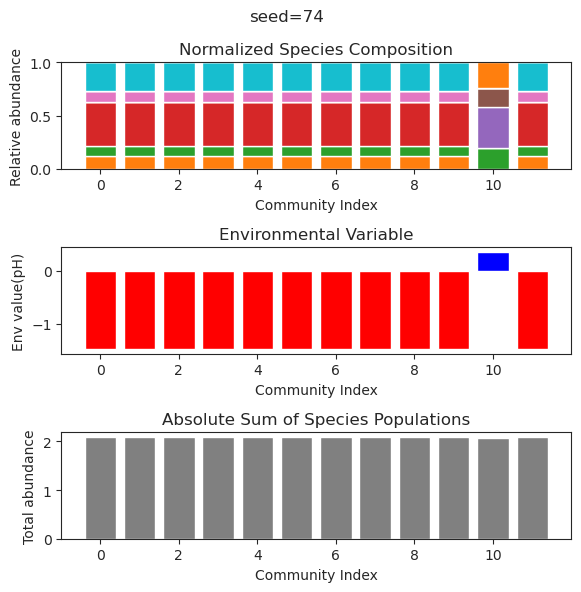

{'species': array([ 1.13742427e-51,  2.72406099e-01, -1.03549990e-27,  4.08552220e-01,
       -1.54027239e-19, -1.67912202e-69, -2.60064316e-68,  8.14840768e-62,
        1.29478366e-70,  6.50402058e-52,  7.91495737e-01, -2.63759727e-58]), 'env': array([-2.24186042])}
{'species': array([-2.94603304e-39,  2.72406099e-01, -2.69721799e-24,  4.08552220e-01,
        1.20514310e-18, -1.09121547e-50, -1.01998066e-50, -2.41609808e-47,
        5.39081173e-60,  1.14398602e-45,  7.91495737e-01,  1.24375217e-50]), 'env': array([-2.24186042])}
{'species': array([ 6.44511670e-40,  2.72406099e-01,  9.94443688e-27,  4.08552220e-01,
       -4.39721370e-18,  1.61158110e-52,  4.94484809e-50, -1.19816674e-47,
       -1.41293567e-58,  1.12609156e-46,  7.91495737e-01,  1.15138294e-52]), 'env': array([-2.24186042])}
{'species': array([ 1.16093454e-39,  2.72406099e-01, -2.46985812e-31,  4.08552220e-01,
        9.16284767e-17,  5.21664865e-46,  2.10247760e-42,  4.46343660e-42,
       -2.29746320e-45,  9.8234693

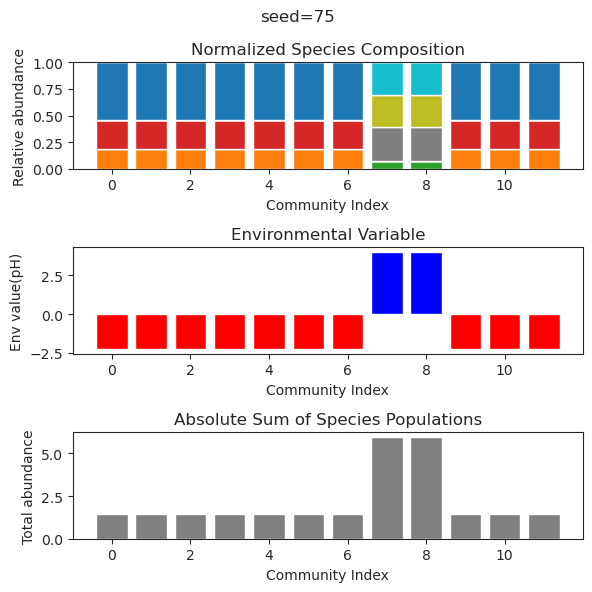

{'species': array([ 2.26038731e-70, -1.06552277e-55,  1.90282872e-35,  5.40681540e-01,
        5.01723933e-43,  2.09913884e-53,  7.24834386e-01,  1.74801117e+00,
        1.02633949e+00,  1.54382885e-59, -1.68663523e-66, -1.78949397e-63]), 'env': array([1.79631142])}
{'species': array([ 2.40096217e-38,  1.85097735e-54, -6.10954861e-37,  5.40681540e-01,
       -1.28165599e-44, -1.24733620e-53,  7.24834386e-01,  1.74801117e+00,
        1.02633949e+00, -8.52498207e-68,  4.42098719e-71, -3.46769489e-69]), 'env': array([1.79631142])}
{'species': array([ 1.49290406e-53, -1.05201149e-40,  9.32570223e-37,  5.40681540e-01,
        8.43206067e-41,  3.54904447e-44,  7.24834386e-01,  1.74801117e+00,
        1.02633949e+00,  3.33888822e-46,  4.12763250e-52,  2.35049972e-50]), 'env': array([1.79631142])}
{'species': array([ 3.11895292e-63,  3.91363693e-48, -6.30062503e-39,  5.40681540e-01,
       -2.99395334e-38, -2.40834706e-41,  7.24834386e-01,  1.74801117e+00,
        1.02633949e+00, -7.58582281e-

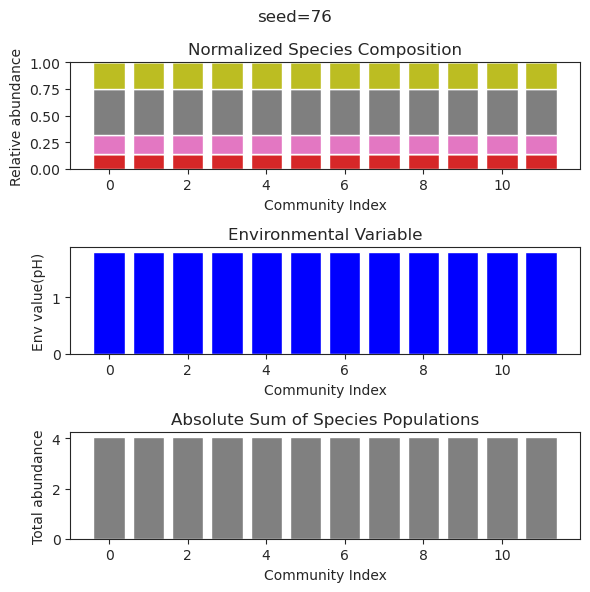

{'species': array([ 4.68997232e-20,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
        1.97909915e-51, -5.64596347e-25,  3.64542721e-39,  1.29757920e-01,
       -2.38658588e-48,  1.54274597e-58, -1.48349484e-58,  4.48744115e-59]), 'env': array([-1.3936028])}
{'species': array([ 2.46764198e-25,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
       -3.85266420e-63, -2.75103022e-32, -2.12263299e-38,  1.29757920e-01,
       -6.04869681e-54,  4.33154617e-69, -9.52749250e-63, -6.32871199e-65]), 'env': array([-1.3936028])}
{'species': array([-2.37130583e-23,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
        1.70594375e-45,  1.70991900e-24, -5.75840731e-27,  1.29757920e-01,
       -4.76296347e-36, -2.49246356e-51, -1.63663127e-44, -3.22171983e-49]), 'env': array([-1.3936028])}
{'species': array([-5.19264776e-26,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
       -1.20334206e-63, -4.55342950e-31, -1.54446434e-36,  1.29757920e-01,
       -6.78598990e-53, -2.30835035e-

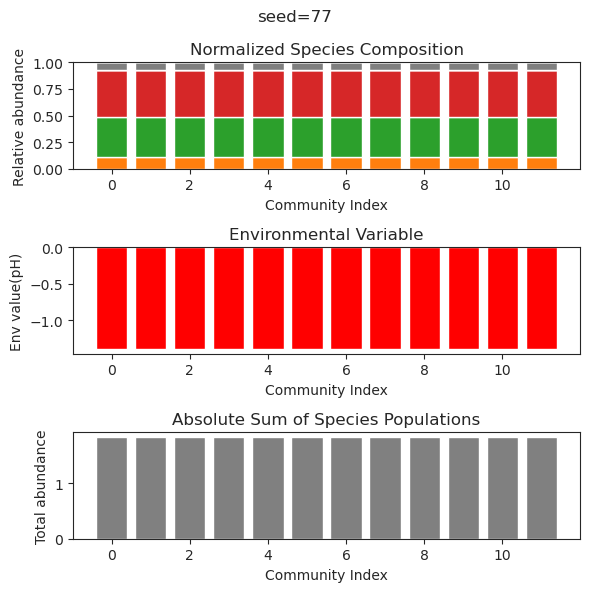

{'species': array([ 4.50975116e-25,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
       -5.63154558e-62, -8.52872449e-29,  1.82448615e-34,  1.29757920e-01,
        3.63114858e-47,  1.55704214e-64,  1.44631370e-57,  3.43940610e-59]), 'env': array([-1.3936028])}
{'species': array([ 4.50975116e-25,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
       -5.63154558e-62, -8.52872449e-29,  1.82448615e-34,  1.29757920e-01,
        3.63114858e-47,  1.55704214e-64,  1.44631370e-57,  3.43940610e-59]), 'env': array([-1.3936028])}
{'species': array([ 5.47896340e-47,  5.80676259e-37, -1.19573778e-70,  7.76812680e-77,
        6.22951076e-75,  4.90369765e+00,  3.67834960e-42, -2.24089001e-54,
       -5.57007846e-72,  6.50060265e+00, -1.70705729e-78,  2.77681450e-73]), 'env': array([6.96083421])}
{'species': array([-2.93735204e-79, -2.05857076e-33, -2.52690923e-79,  2.13266992e-85,
       -3.89938903e-85,  4.90369765e+00, -1.00614269e-46, -3.10803335e-58,
       -1.02422009e-76,  6.50060265e+

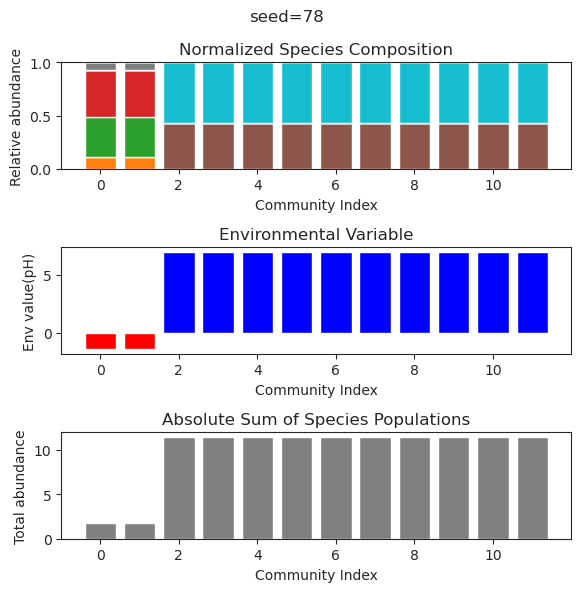

{'species': array([-1.37544366e-34,  2.41782295e-01, -9.88486892e-53,  6.34984580e-01,
       -2.17537228e-28,  1.27330215e-29,  1.56381723e-01,  2.28008734e-01,
        7.70505337e-40, -2.71763653e-30, -1.18566308e-42,  5.66015337e-01]), 'env': array([-1.56206125])}
{'species': array([-2.55376423e-36,  2.41782295e-01, -1.17089132e-56,  6.34984580e-01,
        1.47490417e-28,  3.60774017e-28,  1.56381723e-01,  2.28008734e-01,
       -1.69480785e-43,  9.60068611e-32, -2.18677702e-48,  5.66015337e-01]), 'env': array([-1.56206125])}
{'species': array([-4.07460327e-35,  2.41782295e-01,  2.00241290e-56,  6.34984580e-01,
       -9.26849997e-29,  8.17098872e-31,  1.56381723e-01,  2.28008734e-01,
        2.27464738e-44,  6.67090717e-34,  5.29860711e-49,  5.66015337e-01]), 'env': array([-1.56206125])}
{'species': array([-9.84420450e-34,  2.41782295e-01, -8.35871048e-50,  6.34984580e-01,
       -3.66173594e-27,  2.34135024e-30,  1.56381723e-01,  2.28008734e-01,
       -1.22435244e-40,  2.6981426

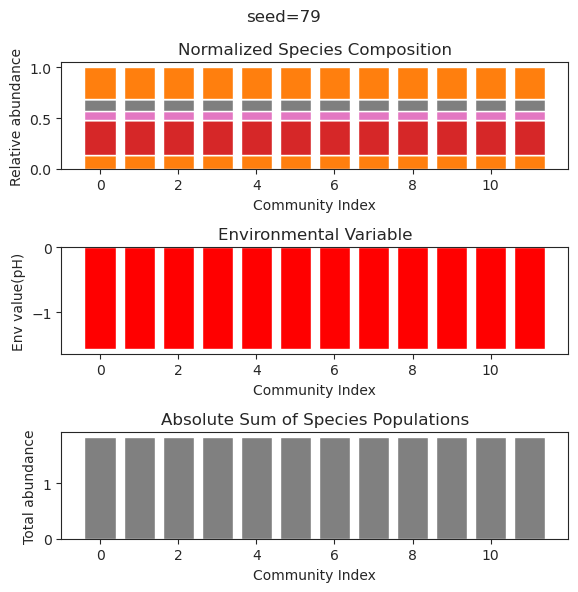

{'species': array([ 2.99685080e-01, -1.34434774e-33, -3.08765998e-35, -5.23703592e-49,
        2.77171412e-19,  2.33158665e-40,  3.01928058e-01,  2.21565009e-26,
        6.20341597e-01,  5.96300235e-26, -8.77329204e-44,  2.89302153e-01]), 'env': array([-2.23661261])}
{'species': array([ 2.99685080e-01, -1.82980978e-32,  1.28976077e-41, -3.39189792e-53,
       -7.07630073e-20, -1.16410504e-38,  3.01928058e-01, -5.08125162e-26,
        6.20341597e-01,  8.28073302e-30,  3.60195136e-46,  2.89302153e-01]), 'env': array([-2.23661261])}
{'species': array([ 2.99685080e-01, -1.29989498e-34,  3.52218670e-43,  8.08073020e-63,
       -3.26006959e-19, -8.70032850e-45,  3.01928058e-01,  7.37561075e-25,
        6.20341597e-01, -1.54383592e-29,  3.13098806e-53,  2.89302153e-01]), 'env': array([-2.23661261])}
{'species': array([ 2.99685080e-01, -1.97138103e-36,  6.49170876e-46,  4.26321489e-66,
        6.12854982e-21,  1.31791110e-45,  3.01928058e-01, -7.07927205e-26,
        6.20341597e-01,  5.2698100

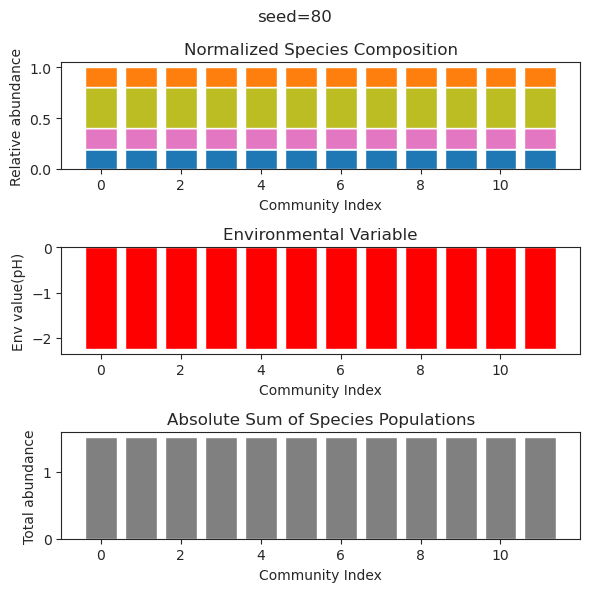

{'species': array([5.42490649e-002, 1.82622185e-063, 5.90776000e-090, 3.07921479e-092,
       2.20541251e-001, 6.69765962e-001, 1.20367293e-003, 4.02379873e-127,
       5.59638804e-006, 9.64276584e-028, 1.14958376e-001, 1.12677334e+000]), 'env': array([1.26421143])}
{'species': array([1.46785051e-001, 1.07607355e-061, 1.14522077e-089, 1.05690685e-089,
       1.49010790e-001, 6.28834689e-003, 1.59969134e-003, 4.85983372e-128,
       3.31487670e-001, 1.67035910e-025, 1.08132364e+000, 2.02786896e-002]), 'env': array([-1.68466702])}
{'species': array([-1.01683704e-62,  1.16779824e-70,  9.24580178e-01,  2.80892219e-02,
        9.62746083e-66,  1.29894928e+00,  5.29925295e-53,  2.65368857e+00,
       -1.31868846e-56,  6.66511117e-01, -2.71253070e-67, -5.08190597e-55]), 'env': array([3.71775164])}
{'species': array([-3.18537321e-42, -2.32409547e-45,  9.24580178e-01,  2.80892219e-02,
       -5.77290402e-62,  1.29894928e+00, -1.70087349e-42,  2.65368857e+00,
       -5.68533967e-57,  6.66511117e

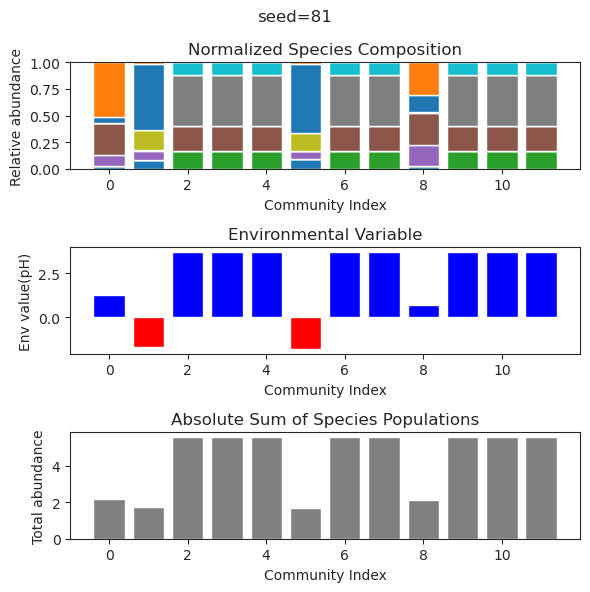

{'species': array([ 4.41758128e-27,  1.54246125e-01,  4.89807687e-01,  1.06880414e-02,
        1.37242256e-57,  7.61775605e-01,  1.55959799e-02,  3.99568889e-80,
       -1.17971294e-38,  1.10667262e-01,  3.10957583e-02,  4.83987012e-03]), 'env': array([-0.96400528])}
{'species': array([-3.38969240e-028,  1.53242644e-001,  4.91427105e-001,
        1.67955790e-002,  2.42586043e-074,  7.46229804e-001,
        1.60961399e-002,  9.39156531e-186,  1.66343950e-031,
        1.22677399e-001,  2.81753402e-002,  2.33259078e-003]), 'env': array([-0.95335834])}
{'species': array([-5.62785064e-028,  1.54261586e-001,  4.89797759e-001,
        1.06076021e-002,  9.05931003e-067,  7.61965190e-001,
        1.54937981e-002,  2.71559473e-122, -1.31761433e-031,
        1.10589443e-001,  3.11961240e-002,  4.72242428e-003]), 'env': array([-0.96419249])}
{'species': array([-3.61615927e-30,  1.54322726e-01,  4.89671748e-01,  1.02559921e-02,
       -1.00013711e-61,  7.63021583e-01,  1.57631092e-02,  2.91965174e-

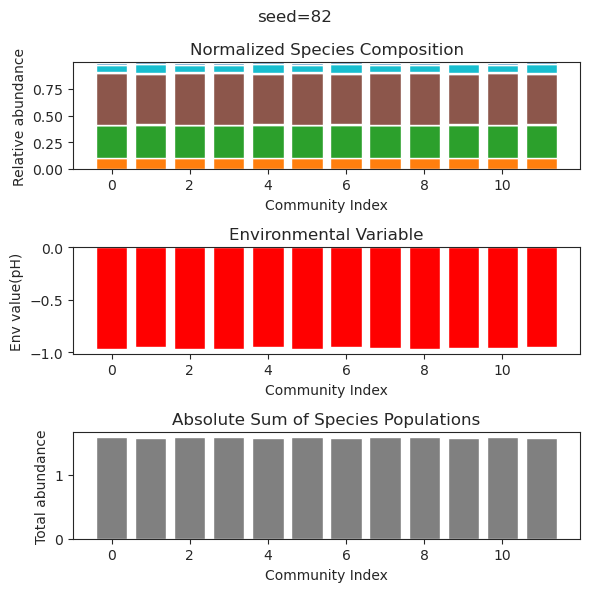

{'species': array([ 1.94432063e-65,  1.98466753e-01,  7.76387244e-01,  8.12678708e-01,
        2.04159902e-36,  2.59706190e-33,  1.60864293e-61,  5.14586840e-23,
       -1.35907525e-69,  3.08783621e-22, -8.15244237e-54, -6.35643629e-59]), 'env': array([-1.46673504])}
{'species': array([ 2.10212475e-61,  1.98466753e-01,  7.76387244e-01,  8.12678708e-01,
        4.05031956e-34, -4.64292712e-32, -1.64680733e-59, -2.00738876e-25,
        8.58535235e-65, -1.39283217e-24, -6.93804626e-57, -1.68534001e-60]), 'env': array([-1.46673504])}
{'species': array([7.26254522e-002, 3.92707256e-003, 5.66479155e-001, 5.39200696e-132,
       5.48551226e-208, 4.42358094e-005, 8.73426437e-002, 4.67337289e-001,
       1.52023614e-298, 3.54104448e-001, 0.00000000e+000, 2.10317976e-001]), 'env': array([-0.26745161])}
{'species': array([-1.89355974e-59,  1.98466753e-01,  7.76387244e-01,  8.12678708e-01,
        1.27726894e-32,  3.10214473e-30,  8.32920212e-56,  2.48293978e-23,
        8.58982271e-60,  2.1586938

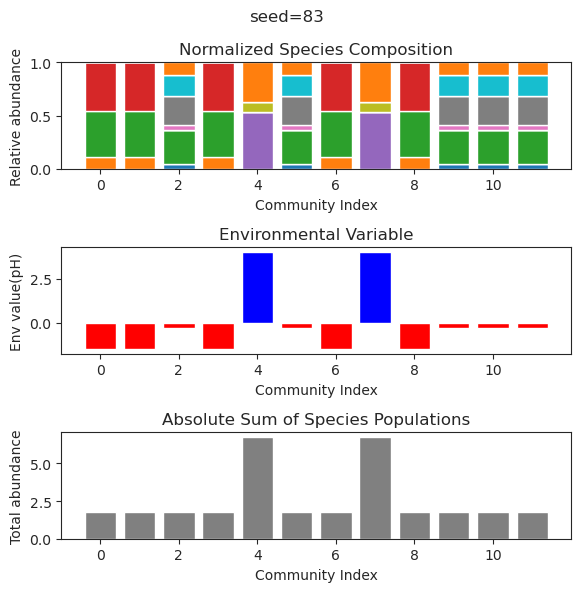

{'species': array([ 2.22294234e-01, -4.37890198e-43, -2.42955414e-49,  1.60210131e-68,
       -1.42239331e-57, -3.48801086e-56,  1.81205366e-01, -1.55835910e-21,
        4.60487053e-01,  1.35930699e-78,  5.29079559e-09,  3.68853353e-01]), 'env': array([-1.85443928])}
{'species': array([ 2.22294234e-01, -9.27520289e-38,  4.02034519e-41,  1.18833652e-57,
       -3.79725835e-49,  3.29336851e-48,  1.81205366e-01, -4.40584058e-21,
        4.60487053e-01, -2.78299399e-61,  6.01134720e-09,  3.68853353e-01]), 'env': array([-1.85443928])}
{'species': array([ 2.22294234e-01, -8.69235037e-45, -7.97384021e-55,  5.35166360e-69,
        1.41627830e-47, -2.64916735e-58,  1.81205366e-01,  8.34281464e-28,
        4.60487050e-01,  3.59513626e-78,  1.28511550e-08,  3.68853353e-01]), 'env': array([-1.85443927])}
{'species': array([ 2.22294234e-01,  4.00302887e-38, -9.12521785e-45,  1.73131256e-55,
       -2.91002079e-45, -5.07954875e-48,  1.81205366e-01, -6.61937356e-16,
        4.60487053e-01, -1.0761082

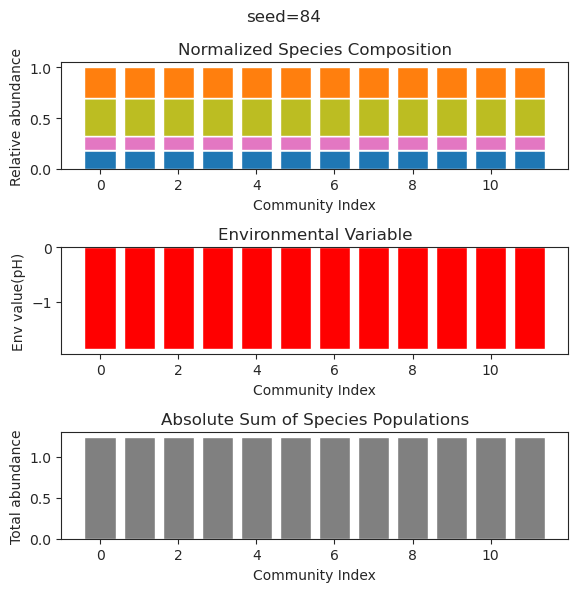

{'species': array([ 3.91155747e-08,  2.28258496e-01,  5.35453233e-01, -3.05801115e-30,
        4.44292942e-40, -3.41211629e-22,  1.81809639e-01,  3.38275377e-43,
        3.09721377e-01,  1.66507234e-61, -6.77959608e-47,  4.56679579e-01]), 'env': array([-1.65676946])}
{'species': array([ 1.49677557e-08,  2.28258512e-01,  5.35453227e-01,  3.76330300e-20,
        1.93456700e-35,  2.83299789e-17,  1.81809628e-01,  3.47049646e-39,
        3.09721406e-01,  2.75338635e-32, -1.31492968e-35,  4.56679595e-01]), 'env': array([-1.65676938])}
{'species': array([ 3.26806481e-08,  2.28258500e-01,  5.35453231e-01,  2.21069362e-15,
       -2.56355402e-37, -2.90239973e-15,  1.81809636e-01, -5.93662407e-41,
        3.09721385e-01,  1.94363063e-51,  1.02730112e-40,  4.56679584e-01]), 'env': array([-1.65676944])}
{'species': array([ 2.22049277e-08,  2.28258507e-01,  5.35453229e-01,  4.69266427e-19,
       -8.08875850e-36,  1.95626906e-19,  1.81809631e-01, -2.83897729e-41,
        3.09721397e-01, -4.1164384

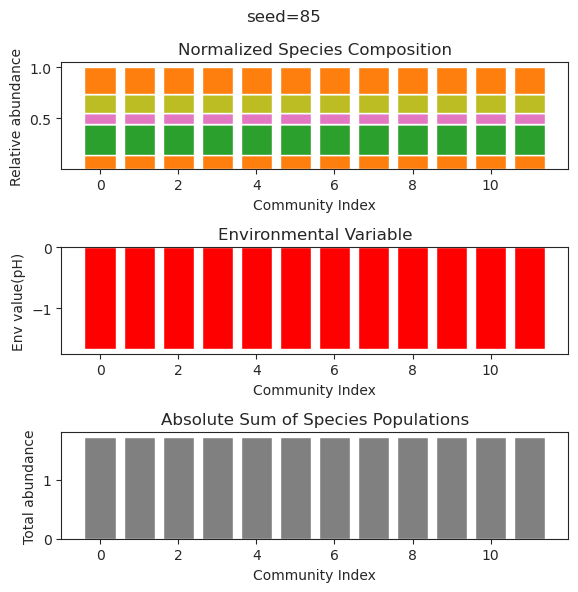

{'species': array([ 2.32487188e-01, -1.38060721e-31,  1.91919401e-01,  6.17616568e-32,
       -1.45136411e-39, -4.05365487e-45,  5.70420216e-57,  2.71370510e-74,
        5.00311009e-75,  6.92333258e-01,  1.13580757e-20,  7.83664183e-50]), 'env': array([-2.00611793])}
{'species': array([ 2.32487188e-01, -3.09257226e-31,  1.91919401e-01, -4.09699509e-31,
        3.66461964e-42,  8.82489723e-47,  1.75284010e-60, -2.70268546e-81,
        1.13482491e-78,  6.92333258e-01, -1.26770571e-20,  2.33110274e-48]), 'env': array([-2.00611793])}
{'species': array([ 2.32487188e-01, -1.18182708e-33,  1.91919401e-01, -7.11761462e-28,
       -1.98468914e-42, -3.60147132e-50, -4.43539008e-56,  1.25450051e-74,
       -1.18750451e-70,  6.92333258e-01,  2.02940664e-22,  4.52660142e-40]), 'env': array([-2.00611793])}
{'species': array([ 2.32487188e-01, -4.43472034e-33,  1.91919401e-01,  3.49724975e-32,
        1.68450439e-41,  8.40812090e-47, -1.83137538e-53,  3.06524962e-76,
        3.82663150e-75,  6.9233325

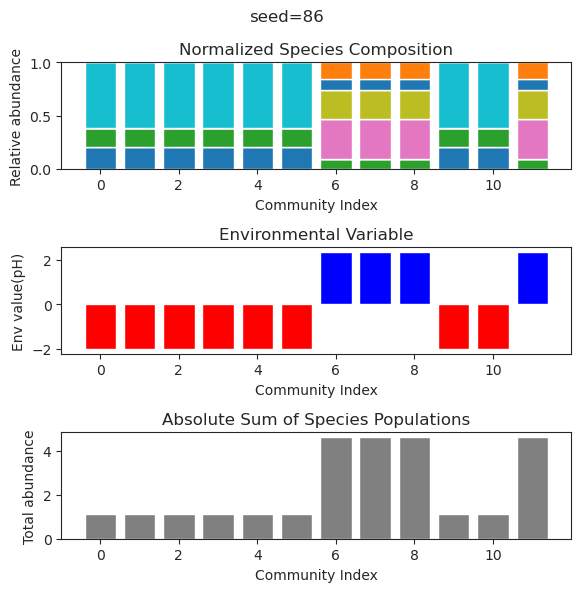

{'species': array([ 1.47227533e-02,  1.14621697e-01,  1.63181590e-89,  6.41465733e-01,
       -1.60939189e-90,  4.48713977e-01,  2.33778546e-02,  8.71704353e-02,
        2.01310788e-01, -1.08430357e-38,  1.44592988e-79, -1.64935555e-64]), 'env': array([-0.80729879])}
{'species': array([ 1.47227411e-02,  1.14621709e-01,  4.99851826e-36,  6.41465743e-01,
        1.93534590e-78,  4.48713980e-01,  2.33778384e-02,  8.71704451e-02,
        2.01310780e-01, -1.27254942e-37, -3.13627127e-70,  1.16387562e-60]), 'env': array([-0.8072988])}
{'species': array([ 1.47080719e-02,  1.14636032e-01,  8.87971165e-32,  6.41477899e-01,
        1.13582435e-31,  4.48717478e-01,  2.33583642e-02,  8.71822108e-02,
        2.01300579e-01,  1.27196172e-51, -3.63264961e-80, -7.33659881e-72]), 'env': array([-0.80730666])}
{'species': array([ 1.47227521e-02,  1.14621698e-01,  6.87588428e-95,  6.41465734e-01,
        2.11245081e-93,  4.48713977e-01,  2.33778529e-02,  8.71704363e-02,
        2.01310788e-01,  1.20716397

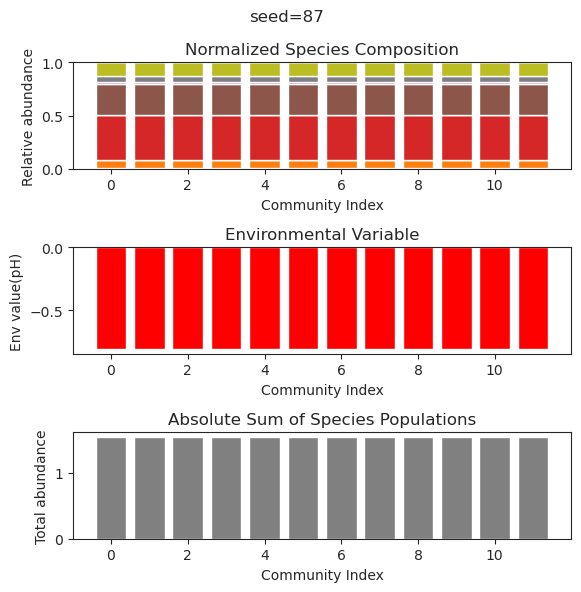

{'species': array([-4.25936744e-63,  8.24906829e-46, -9.20347199e-78,  6.35667479e-01,
        1.24933748e+00,  1.27752650e+00,  1.17151216e-54,  6.77402097e-45,
        3.37344512e-01,  3.50902662e-64,  2.01248078e-48, -1.12623592e-33]), 'env': array([0.71784227])}
{'species': array([-4.25936744e-63,  8.24906829e-46, -9.20347199e-78,  6.35667479e-01,
        1.24933748e+00,  1.27752650e+00,  1.17151216e-54,  6.77402097e-45,
        3.37344512e-01,  3.50902662e-64,  2.01248078e-48, -1.12623592e-33]), 'env': array([0.71784227])}
{'species': array([-2.02076347e-165, -8.35003654e-073,  2.34344572e-118,
        3.90169469e-001,  8.97712110e-001,  1.11015609e+000,
        1.72186240e-001,  3.64531887e-001,  1.95189408e-001,
       -4.27537260e-160, -1.02476121e-127,  4.36392963e-051]), 'env': array([0.59845328])}
{'species': array([-1.97194209e-87,  1.48791240e-41,  4.68588474e-72,  3.90169469e-01,
        8.97712110e-01,  1.11015609e+00,  1.72186240e-01,  3.64531887e-01,
        1.95189408

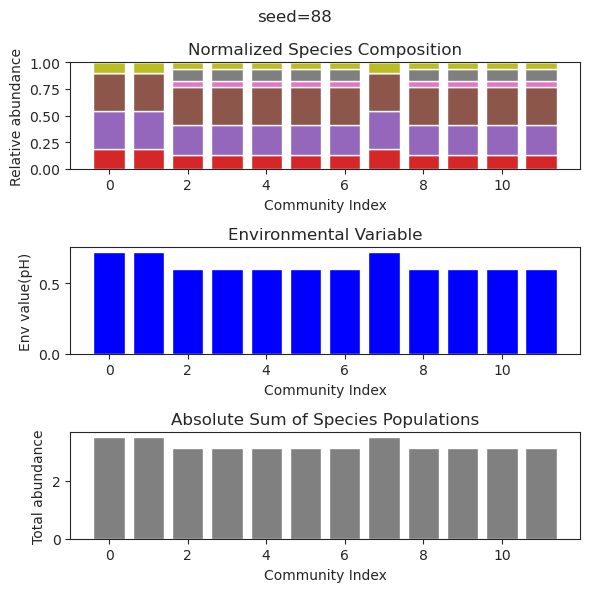

{'species': array([ 1.43445336e-01,  1.94395665e-13,  2.89765013e-01,  3.70880334e-96,
       -2.85890442e-48,  9.81561464e-64,  7.18910433e-01,  4.12768509e-01,
        1.74925856e-52, -1.45626689e-85,  3.78788243e-01, -6.20881235e-83]), 'env': array([-0.63876252])}
{'species': array([ 1.43445336e-001,  5.41008212e-012,  2.89765013e-001,
       -1.87044714e-120,  2.53328055e-053, -3.22942878e-071,
        7.18910433e-001,  4.12768509e-001,  2.70870821e-060,
        7.46786781e-093,  3.78788243e-001,  5.92213111e-101]), 'env': array([-0.63876252])}
{'species': array([ 1.43445336e-001,  1.57782297e-011,  2.89765013e-001,
       -2.59002112e-106, -7.88111915e-055, -3.86835386e-070,
        7.18910433e-001,  4.12768509e-001,  2.96777977e-047,
       -1.59912900e-085,  3.78788243e-001, -3.99308731e-092]), 'env': array([-0.63876252])}
{'species': array([ 1.43445336e-01, -7.01249187e-15,  2.89765013e-01,  4.29583555e-92,
        4.27458259e-46, -9.84176177e-60,  7.18910433e-01,  4.12768509e-

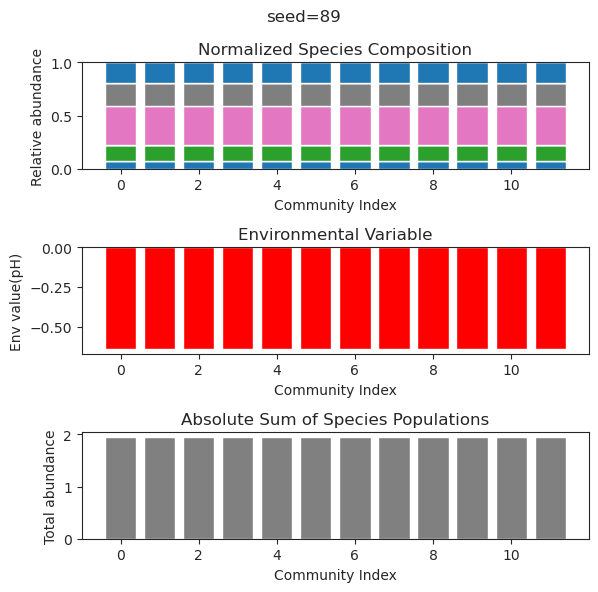

{'species': array([ 1.20237958e-01,  7.95641238e-30, -9.40002255e-34, -1.90574565e-37,
       -1.60710110e-23,  5.38545960e-40, -8.57556660e-40,  8.02038778e-01,
        8.39767469e-01,  1.04966534e-06,  2.22605863e-56,  1.28660326e-43]), 'env': array([-0.75825038])}
{'species': array([ 1.20237959e-01, -3.25753873e-35,  1.28971319e-33, -2.01097928e-39,
       -3.68156216e-41, -4.56382677e-42,  1.65657612e-37,  8.02038187e-01,
        8.39767349e-01,  1.75370901e-06, -3.71010008e-73,  2.97881395e-48]), 'env': array([-0.7582502])}
{'species': array([2.68064561e-065, 3.13813714e-001, 6.42783094e-124, 8.31601272e-003,
       4.44304767e-296, 2.78295315e-001, 1.76440299e-278, 3.11660977e-181,
       3.04393533e-067, 3.95893282e-001, 5.68468321e-001, 2.20702073e-001]), 'env': array([-0.1288903])}
{'species': array([ 2.82032277e-065,  4.26943555e-002,  4.07829782e-117,
        4.54437223e-001,  6.70121500e-308,  1.27814202e-002,
       -8.66595924e-302,  1.73661811e-177,  1.73356162e-063,
   

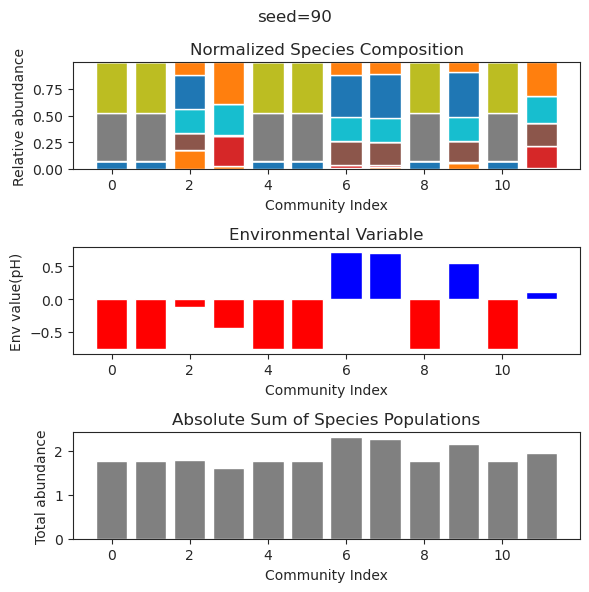

{'species': array([ 2.16655653e-01, -3.03299629e-21, -3.90290564e-35,  4.69260871e-01,
        2.48677395e-48,  5.54885970e-53,  1.22339070e-01, -7.23395331e-38,
       -6.32584535e-39,  6.28287996e-01,  2.83488368e-47,  1.62940163e-33]), 'env': array([-1.32774088])}
{'species': array([ 2.16655653e-01,  2.18890137e-20,  5.48579093e-35,  4.69260871e-01,
        5.85305043e-50,  7.47774286e-56,  1.22339070e-01, -1.20789546e-39,
       -2.42057543e-38,  6.28287996e-01,  1.15730204e-49, -6.37612562e-32]), 'env': array([-1.32774088])}
{'species': array([ 2.16655653e-01, -3.93378172e-20, -1.53826822e-33,  4.69260871e-01,
       -3.69531107e-47,  9.11348873e-54,  1.22339070e-01,  1.13906780e-38,
       -7.59297529e-37,  6.28287996e-01,  1.85419461e-48,  1.63088991e-32]), 'env': array([-1.32774088])}
{'species': array([ 2.16655653e-01, -4.81519869e-20,  1.01763771e-29,  4.69260871e-01,
        1.48490288e-44, -1.20411151e-50,  1.22339070e-01,  2.13654026e-33,
       -1.31695025e-30,  6.2828799

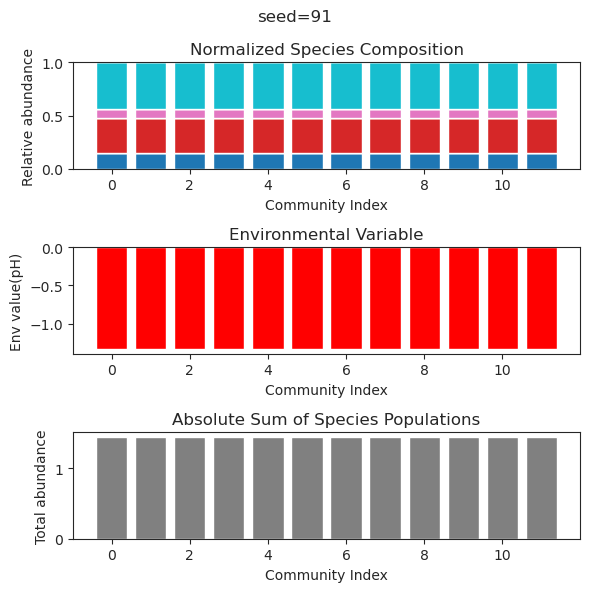

{'species': array([ 1.65574050e-01,  5.10121351e-34,  2.79638660e-55,  1.07561026e-60,
       -4.79022512e-27, -1.09663103e-33, -1.73159944e-60, -5.95411300e-18,
        1.11874149e+00,  1.28486090e-62,  1.83127727e-42, -8.78670906e-62]), 'env': array([-1.70377709])}
{'species': array([ 1.65574050e-01,  7.13959227e-43,  3.60596885e-75, -2.42817675e-73,
       -5.29534106e-27, -1.64632440e-37, -2.44437621e-70, -8.86607244e-19,
        1.11874149e+00, -1.01555982e-80,  6.62441221e-55, -4.81275575e-78]), 'env': array([-1.70377709])}
{'species': array([ 1.65574050e-01, -8.82707903e-42, -9.12153295e-71, -1.26965062e-63,
        1.83799315e-25, -7.76551511e-36, -9.08716077e-59, -8.99680399e-18,
        1.11874149e+00, -2.08656000e-66, -7.21278132e-52,  4.35010034e-66]), 'env': array([-1.70377709])}
{'species': array([ 1.65574050e-01,  8.66697780e-33,  5.14465219e-49,  4.06386256e-54,
       -3.98071959e-26,  9.89230239e-35,  2.42640419e-51, -8.92409047e-19,
        1.11874149e+00,  1.0215873

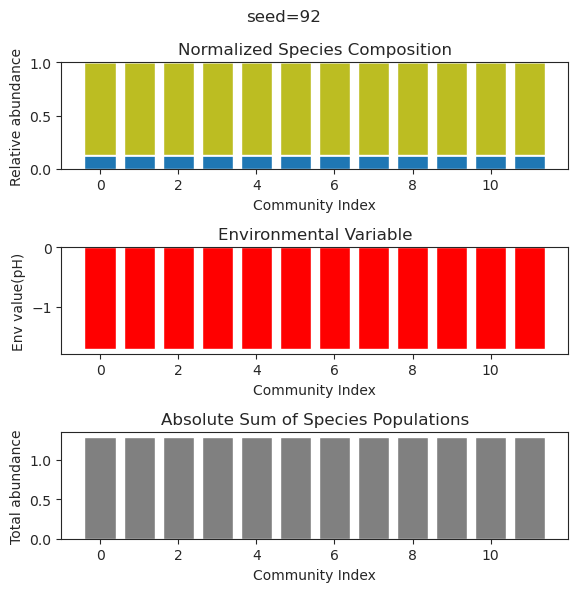

{'species': array([-2.88151043e-43,  3.75517669e-57, -2.15653421e-87,  1.18554075e-46,
        4.75207673e-67,  1.49012672e+00, -3.78992061e-17,  7.13665743e-88,
        2.36551071e+00,  1.28594482e+00, -1.15511779e-81,  6.02437439e-78]), 'env': array([2.73999692])}
{'species': array([ 1.46307112e-001,  3.94815494e-025,  2.37258553e-001,
        1.69149284e-001,  2.25798851e-001,  4.39178126e-137,
        1.05801885e-063,  1.85439741e-001,  2.84107027e-213,
       -4.94065646e-324,  4.91152683e-001,  1.82858230e-001]), 'env': array([-0.82977596])}
{'species': array([ 1.46307113e-001,  2.32233321e-024,  2.37258553e-001,
        1.69149284e-001,  2.25798851e-001, -9.23269450e-140,
        1.42323649e-059,  1.85439741e-001, -2.09021041e-211,
        4.94065646e-324,  4.91152683e-001,  1.82858230e-001]), 'env': array([-0.82977596])}
{'species': array([ 1.09699521e-81, -6.30216184e-57,  1.48337919e-76,  1.47198059e-56,
       -5.62645588e-63,  1.49012672e+00,  2.94687025e-21,  2.39583234e-7

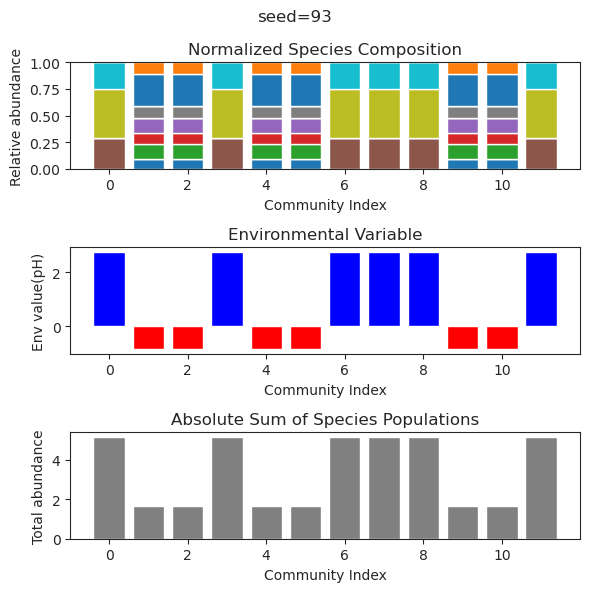

{'species': array([ 2.49671157e-031,  3.12730398e-001,  5.11702573e-001,
       -2.80068787e-032,  1.73624455e-074,  8.61918754e-041,
        7.21205170e-002,  1.75657475e-006,  3.94321790e-038,
        6.11871345e-024,  7.50548044e-001,  5.20661816e-120]), 'env': array([-2.42379038])}
{'species': array([-3.59031806e-42,  3.12731490e-01,  5.11697190e-01,  1.01402021e-50,
        3.67403434e-32, -8.45343568e-31,  7.21260907e-02,  3.45415871e-12,
        1.74387187e-29, -3.53636362e-16,  7.50550920e-01,  5.83148324e-48]), 'env': array([-2.42379619])}
{'species': array([ 1.41319223e-49,  2.92286457e-01,  5.75170367e-01,  1.37291706e-49,
        4.43563808e-40, -1.96830947e-62, -2.74288292e-14,  6.30336631e-02,
       -1.34850020e-40, -6.86986344e-23,  7.09902688e-01, -4.04083915e-63]), 'env': array([-2.28720231])}
{'species': array([-3.01095210e-32, -1.42117913e-21,  6.49814328e-01,  3.27502187e-01,
       -3.82826581e-38, -4.71338070e-17,  2.27876437e-65,  3.79145853e-01,
        4.28542

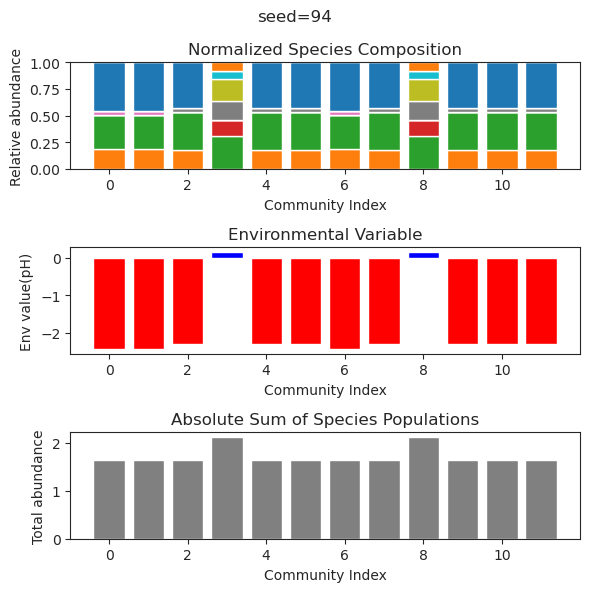

{'species': array([ 5.22326210e-34,  3.65173942e-01,  8.08292263e-32,  5.06558677e-40,
        2.85981726e-38,  1.16955550e-39,  2.74785063e-43,  9.15092389e-20,
       -4.27771840e-28,  1.09200265e-25,  4.99276595e-28,  1.00497743e+00]), 'env': array([-2.92173375])}
{'species': array([-7.71374064e-42,  3.65173942e-01,  1.63557447e-36,  4.46183049e-46,
        1.96067016e-46,  2.54155291e-46,  1.77248922e-49, -7.86329550e-21,
       -9.76518359e-31, -1.36255740e-28, -3.96387855e-32,  1.00497743e+00]), 'env': array([-2.92173375])}
{'species': array([ 7.05404272e-40,  3.65173942e-01, -2.79279597e-36,  1.49501306e-41,
        1.47877316e-42, -1.94593809e-44, -7.95876596e-45, -3.96646596e-22,
       -1.52569766e-31, -1.05127996e-28, -7.06312294e-30,  1.00497743e+00]), 'env': array([-2.92173375])}
{'species': array([ 9.68417803e-41,  3.65173942e-01,  5.77557599e-34,  5.10101045e-41,
        1.47692652e-40, -6.41229479e-42, -5.63066883e-43,  3.46500781e-21,
        1.86140017e-30,  1.1132482

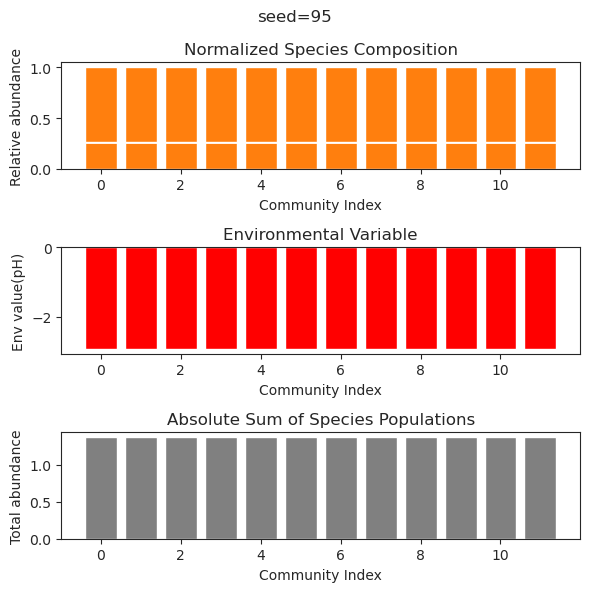

{'species': array([ 3.06206029e-01,  4.48969995e-18,  1.62680380e-38, -1.02539615e-46,
       -9.24094523e-53, -2.90948421e-51,  6.08377125e-29, -1.27438530e-40,
        2.19202924e-55,  7.90575606e-39,  5.81659185e-25,  5.65680693e-01]), 'env': array([-2.6464187])}
{'species': array([ 3.06206029e-01, -1.97489887e-20, -9.63813634e-56,  3.70452296e-77,
       -2.87723008e-84,  1.74754730e-80,  1.27352615e-40,  2.67424801e-58,
       -3.68086367e-92,  1.31438524e-53, -2.39689214e-29,  5.65680693e-01]), 'env': array([-2.6464187])}
{'species': array([ 3.06206029e-01,  1.13507811e-18,  7.54180536e-39,  4.23415796e-52,
       -1.89895931e-59,  7.32306707e-58, -1.05138575e-29,  9.82999184e-45,
        1.14686909e-59,  3.97230744e-40, -2.48331801e-28,  5.65680693e-01]), 'env': array([-2.6464187])}
{'species': array([ 3.06206029e-01, -2.23779237e-19,  5.75946988e-56,  4.10838674e-74,
        4.14952933e-75,  5.38387367e-72, -6.78950957e-38, -3.77517588e-57,
       -5.44970669e-83,  7.86456132e-

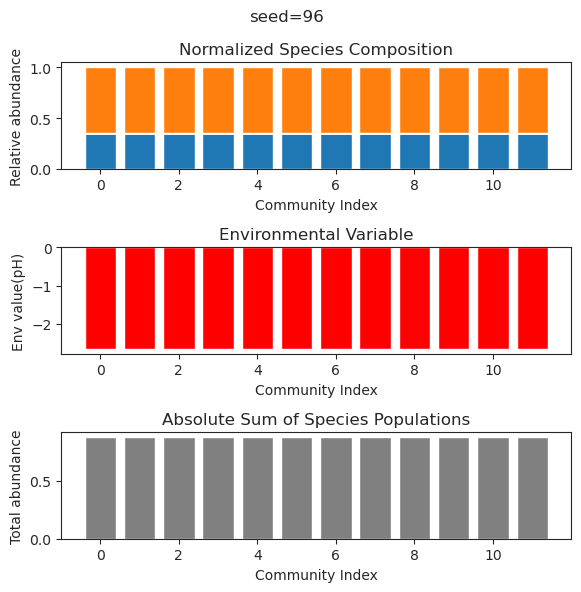

{'species': array([ 2.83758091e-43,  2.95137958e-01,  3.76034645e-59,  6.96242257e-01,
        2.27640624e-01,  2.21587543e-14,  6.53060285e-25, -3.48480743e-50,
        1.29288666e-54,  1.83673079e-59, -3.68898956e-20, -2.01676622e-50]), 'env': array([-2.66309159])}
{'species': array([-5.01984578e-47,  2.95137958e-01, -4.77873976e-73,  6.96242257e-01,
        2.27640624e-01, -8.33359172e-14,  2.24449599e-23, -3.51133821e-53,
        3.98543538e-58, -5.70405134e-74, -6.43100594e-19,  6.62178589e-59]), 'env': array([-2.66309159])}
{'species': array([-7.35049345e-47,  2.95137958e-01,  5.06283921e-58,  6.96242257e-01,
        2.27640624e-01,  2.99756971e-14,  2.51179444e-22,  4.09591841e-46,
        1.67940037e-51, -7.86444916e-61,  1.99711116e-19,  4.03848846e-48]), 'env': array([-2.66309159])}
{'species': array([ 1.90473032e-48,  2.95137958e-01,  1.21647371e-75,  6.96242257e-01,
        2.27640624e-01,  2.66267816e-14, -2.38994991e-24,  4.09064556e-56,
       -9.38585902e-64,  1.0805564

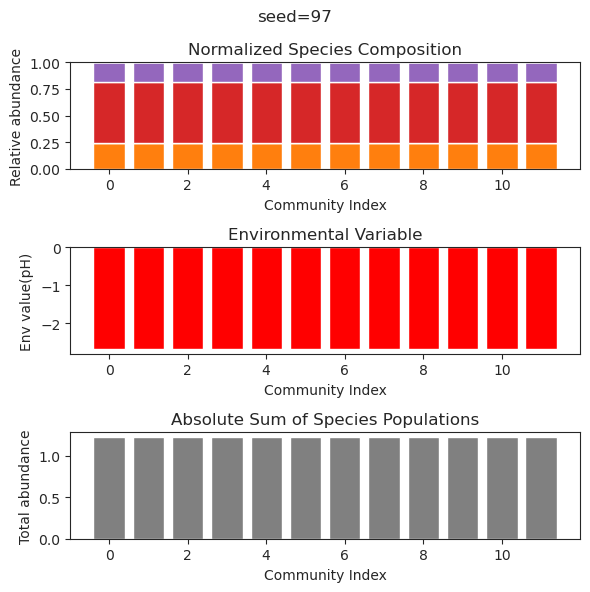

{'species': array([ 1.74438963e-001, -9.88131292e-324,  9.88131292e-324,
        1.58161700e-001,  5.40978511e-001,  5.15933485e-001,
        9.88131292e-324,  8.57578567e-222,  3.43193670e-001,
        3.38285268e-168,  7.60861095e-322,  1.49416971e-001]), 'env': array([0.04680571])}
{'species': array([ 1.49653958e-002, -9.88131292e-324, -1.48219694e-323,
        8.60828325e-001,  1.52885608e-002,  5.45866693e-002,
        2.02566915e-322,  1.07353533e-220,  5.13300321e-001,
        4.48654152e-168,  1.20057952e-321,  4.12905898e-001]), 'env': array([-0.06143089])}
{'species': array([ 1.41980341e-002,  7.90505033e-323, -1.67982320e-322,
        8.33609811e-001,  1.91308776e-002,  7.83080930e-002,
        2.86558075e-322,  1.06811835e-222,  5.36002551e-001,
        1.21487264e-167,  2.47032823e-323,  3.94526214e-001]), 'env': array([0.05454416])}
{'species': array([ 3.02027012e-001, -9.88131292e-324,  4.94065646e-324,
        1.93600951e-001,  3.64148737e-001,  2.68634553e-001,
       

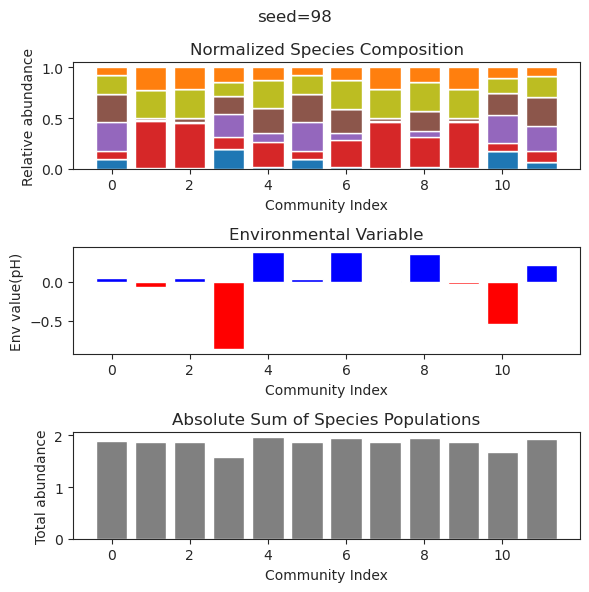

{'species': array([ 1.19675197e-001, -9.88131292e-324,  9.88131292e-324,
        2.10818191e-001,  4.85495835e-001,  5.58120752e-001,
       -6.91691904e-323,  2.37752812e-217,  4.05547644e-001,
        2.29479305e-168, -1.53654416e-321,  1.58297556e-001]), 'env': array([0.21728699])}
{'species': array([ 1.19675197e-001, -9.88131292e-324,  9.88131292e-324,
        2.10818191e-001,  4.85495835e-001,  5.58120752e-001,
       -6.91691904e-323,  2.37752812e-217,  4.05547644e-001,
        2.29479305e-168, -1.53654416e-321,  1.58297556e-001]), 'env': array([0.21728699])}
{'species': array([-1.25433292e-89, -8.32443699e-33,  1.07772932e+00, -5.46639327e-22,
       -8.37608218e-31,  9.56910470e-01, -1.39574892e-92,  7.44185743e-01,
       -2.50085257e-81,  1.43735074e-61, -5.77503677e-63,  1.58403814e+00]), 'env': array([1.85416692])}
{'species': array([-3.36523103e-035, -1.24540557e-039,  1.07772932e+000,
        5.77280484e-026,  1.54104710e-026,  9.56910470e-001,
       -1.53784134e-101,  7

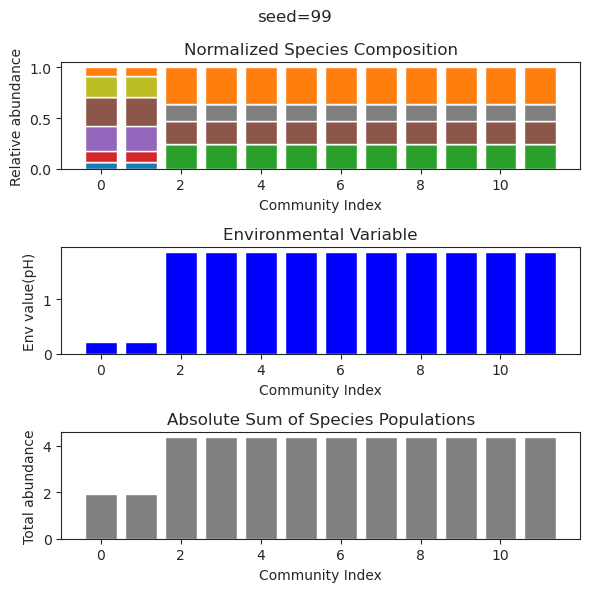

In [ ]:
    session_path='Results_ptailed/Session_Test4'
    to_save={}
    description=''
    simulated_result={}
    
    for seed_num in range(100):
        if not os.path.isdir(session_path):
            os.mkdir(session_path)
        # functions for uniform 

        f_I = lambda : uniform_distribution(0.5,0.5)
        f_g = lambda : np.ones(1)
        f_k = lambda : np.ones(1)
        f_p = lambda : custom_distribution(-2,1)
        f_q = lambda : uniform_distribution(0.5,0.5)
        f_beta = lambda : np.ones(1)
        seed_num=seed_num
        to_plot=True

        np.random.seed(seed_num)

        N=12
        N_env=1


        I = np.zeros((N, N))
        for i in range(N):
            for j in range(N):
                I[i,j] = f_I()
        for i in range(N):
            I[i,i] =1

        g = np.zeros((N))
        for i in range(N):
            g[i] = f_g()

        k = np.zeros((N))
        for i in range(N):
            k[i] = f_k()   

        p = np.zeros((N_env, N))
        for i in range(N_env):
            for j in range(N):
                p[i,j] = f_p()

        p[0,0]=-10
        p[0,1]=-10
        #p[0,2]=-10

        q = np.zeros((N, N_env))
        for i in range(N):
            for j in range(N_env):
                q[i,j] = f_q()

        q[0,0]=0.2
        q[1,0]=0.2
        #q[2,0]=0.2



        beta = np.zeros(N_env)
        for i in range(N_env):
            beta[i]=f_beta()

        delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
        migration_rate=0#1e-7
        system_config = {
            'I': I,
            'g': g,
            'k': k,
            'p': p,
            'q': q,
            'beta': beta,
            'delta': delta,
            'migration_rate' : migration_rate,
            'N': N,
            'N_env': N_env,
            'seed_num':seed_num,
        } 

        file_path = f'{session_path}/system_config.json'

        label="test"
        sys
        ##

        y_out_list=[]
        system_config['beta'] = np.array([0.99])*delta

        for i in range(N):

            species_index=np.arange(0,N)
            env_index=np.array([0])
            y0_species=one_hot_vector(N,i)
            y0_env=[0]
            t=np.linspace(0, 2000, 10000)

            y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False)

            y_out_list.append(y_out)

        num_datasets = len(y_out_list)

        # Prepare subplots
        fig, axs = plt.subplots(3, 1, figsize=(6, 6))

        # Data for plots
        species_matrix = np.array([y_out['species'] for y_out in y_out_list])
        env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

        # Normalize species data
        species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
        species_sums = np.sum(species_matrix, axis=1, keepdims=True)
        normalized_species = species_matrix / species_sums

        # Absolute sums of species data (sum across all species for each dataset)
        absolute_sums = np.sum(species_matrix, axis=1)
        simulated_result[seed_num]={'species':species_matrix, 'env' : env_data}

        if to_plot:
            plt.suptitle(f'seed={seed_num}')

            # Plotting species composition as stacked bars
            bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
            for i in range(normalized_species.shape[1]):  # Loop through each species
                axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
                bottom_values += normalized_species[:, i]  # Update bottom values for stacking

            axs[0].set_title('Normalized Species Composition')
            axs[0].set_xlabel('Community Index')
            axs[0].set_ylabel('Relative abundance')
            #axs[0].legend()

            # Plotting environmental factors
            colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
            axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
            axs[1].set_title('Environmental Variable')
            axs[1].set_xlabel('Community Index')
            axs[1].set_ylabel('Env value(pH)')

            # Plotting absolute sums of species data
            axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
            axs[2].set_title('Absolute Sum of Species Populations')
            axs[2].set_xlabel('Community Index')
            axs[2].set_ylabel('Total abundance')

            plt.tight_layout()
            plt.savefig(session_path+f'/diagram_{seed_num}.png')

            #if to_plot:
            #    plt.savefig()


            plt.show()
    #simulated_result = {'a': 1, 'b': 2, 'c': 3}  # Your existing dictionary
    #description = "This is a description of the simulated result."

    # Combine both into a new dictionary
    data_to_save = {
        'result': simulated_result,
        'description': description
    }
    # Serialize the combined data to a pickle file
    with open(session_path+'/result_and_description.pkl', 'wb') as file:
        pickle.dump(data_to_save, file)